In [1485]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix

In [1486]:
#1
def InitializeWeights(input_neurons, output_neurons):
    theta= 0 + 1.0 * np.random.randn(input_neurons,output_neurons)
    return theta
InitializeWeights(4,5)

array([[ 1.63588396,  1.24918122, -1.20349376,  0.49333281,  1.47033309],
       [-0.7274011 , -0.00334079, -1.58850814, -0.13512052, -0.97691415],
       [-0.65695483,  0.62358112, -0.45663299, -0.78238868, -0.05576539],
       [ 0.25205934, -0.2866524 , -0.34794548, -0.35023201,  0.94882772]])

In [1487]:
#2
def logistic_sigmoid(z):
    return 1.0/(1.0 + np.exp(-z))
def logistic_gradient(z):
    return logistic_sigmoid(z) * (1.0 - logistic_sigmoid(z))

In [1488]:
#3 
def relu(z):
    return np.maximum(0,z)
def relu_gradient(z):
    return np.greater(z,0).astype(int)

In [1489]:
#4
def tanh(z):
    return (np.exp(z)-np.exp(-z))/(np.exp(z)+np.exp(-z))
def tanh_gradient(z):
    return 1.0 - tanh(z)*tanh(z)

In [1490]:
def activate(activation,z):
    if activation=='logistic':
        return logistic_sigmoid(z)
    elif activation=='relu':
        return relu(z)
    elif activation=='tanh':
        return tanh(z)
    
def activate_gradient(activation_gradient,z):
    if activation_gradient=='logistic_gradient':
        return logistic_gradient(z)
    elif activation_gradient=='relu_gradient':
        return relu_gradient(z)
    elif activation_gradient=='tanh_gradient':
        return tanh_gradient(z)

In [1491]:
def timeBasedDecay(learning_rate,iterations,decay):
    learning_rate_new=learning_rate*(1/(1+decay*iterations))
    return learning_rate_new
def exponentialDecay(learning_rate,iterations,decay):
    learning_rate_new=learning_rate*np.exp(-decay*iterations)
    return learning_rate_new
def reduceLearningRateonPlateau(learning_rate,lambd):
    learning_rate_new=learning_rate*lambd
    return learning_rate_new
    

In [1594]:
def ForwardPropagation(activation,w1,w2,X):
    X_bias=np.insert(X,0,1,axis=1)
        
    a1=X_bias
   
    z2=np.dot(a1,w1)
    a2=activate(activation, z2)
    #print('a2.shape no bias',a2.shape)
    a2=np.insert(a2,0,1,axis=1)
    #print('a2.shape',a2.shape)

    z3=np.dot(a2,w2)
    a3=softmax(z3)
    
    return a3,a2,a1,z3,z2
    

In [1657]:
def BackPropagation(activation,a3,a2,a1,z3,z2,w1,w2,y_one_hot,n,learning_rate_init,learning_rate,
                        learning_rate_scheduler,iterations,momentum,new_m1,new_m2,beta):
    if activation=='logistic':
        activation_gradient='logistic_gradient'
    elif activation=='relu':
        activation_gradient='relu_gradient'
    elif activation=='tanh':
        activation_gradient='tanh_gradient'
    w2_no_bias=np.delete(w2,0,axis=0)
    if learning_rate=='constant':
        delta3=(a3-y_one_hot)*activate_gradient(activation_gradient,z3)
        #print('delta3.shape',delta3.shape)
        #print('y_one_hot',y_one_hot.shape)
        #print('a2.shape in backprop',a2.shape)
        grad_L_for_w2=np.dot(a2.T,delta3)
        #print('grad_L_for_w2.shape',grad_L_for_w2.shape)
        delta2=delta3.dot(w2_no_bias.T)*activate_gradient(activation_gradient,z2)
        #print('delta2.shape',delta2.shape)
        grad_L_for_w1=np.dot(a1.T,delta2)
        #print('grad_L_for_w1.shape',grad_L_for_w1.shape)
        if momentum==True:
            previous_m1=new_m1
            new_m1=beta*previous_m1-learning_rate_init*grad_L_for_w2
            w2=w2+new_m1
            previous_m2=new_m2
            new_m2=beta*previous_m2-learning_rate_init*grad_L_for_w1
            w1=w1+new_m2
            return w1,w2,learning_rate_init,new_m1,new_m2
        elif momentum==False:
            w2=w2-((learning_rate_init/n)*grad_L_for_w2)
            #print('w2.shape',w2.shape)
            w1=w1-((learning_rate_init/n)*grad_L_for_w1)
            #print('w1.shape',w1.shape)
            return w1,w2,learning_rate_init,new_m1,new_m2
    elif learning_rate=='adaptive':
        delta3=(a3-y_one_hot)*activate_gradient(activation_gradient,z3)
        grad_L_for_w2=np.dot(a2.T,delta3)
        delta2=delta3.dot(w2_no_bias.T)*activate_gradient(activation_gradient,z2)
        grad_L_for_w1=np.dot(a1.T,delta2)
        if learning_rate_scheduler=='timeBasedDecay':
            learning_rate_new=timeBasedDecay(learning_rate_init,iterations,0.2)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
        elif learning_rate_scheduler=='exponentialDecay':
            learning_rate_new=exponentialDecay(learning_rate_init,iterations,0.2)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
        elif learning_rate_scheduler=='reduceLearningRateonPlateau':
            learning_rate_new=reduceLearningRateonPlateau(learning_rate_init,0.1)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
            
        
        
    
    

In [1658]:
#5
class MLPClassifier_Multiclass:
    
    def __init__(self, hidden_layer_neurons=2, activation='logistic', regularizer=None, alpha=0.0001, learning_rate='constant',
                  learning_rate_init=0.001, tol=0.0001, early_stopping=False, n_iter_no_change=10, 
                  momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=True,**kwargs):
        self.hidden_layer_neurons=hidden_layer_neurons
        self.activation=activation
        self.regularizer=regularizer
        self.alpha=alpha
        self.learning_rate=learning_rate
        self.learning_rate_init=learning_rate_init
        self.tol=tol
        self.early_stopping=early_stopping
        self.n_iter_no_change=n_iter_no_change
        self.momentum=momentum
        self.beta=beta
        self.learning_rate_scheduler=learning_rate_scheduler
        self.plotLearningCurve=plotLearningCurve
        
            
    def fit(self, X, y, validation_fraction=0.1, max_iter=1000,verbose=False,W1=0,W2=0, **kwargs):
        self.validation_fraction=validation_fraction
        self.verbose=verbose
        self.X=X
        self.y=y
        self.W1=W1
        self.W2=W2
        n=X.shape
        self.max_iter=max_iter
        
        if self.early_stopping==True:
            X_train,X_valid,y_train,y_valid=train_test_split(X, y, test_size=self.validation_fraction)
            n_train=X_train.shape[0]
            n_valid=X_valid.shape[0]
            #print('n_train',n_train,'X_train.shape',X_train.shape)
            class_label1=np.unique(y_train)
            y_one_hot_train=one_hot_labels(y_train,class_label1)
            y_one_hot_valid=one_hot_labels(y_valid,class_label1)
            input_neurons=len(X_train[0])
            output_neurons=len(np.unique(y_train))
            train_loss,valid_loss=[],[]
            train_acc,valid_acc=[],[]
            eta=[]
            newJ_train=0
            newJ_valid=0
            new_acc_train=0
            new_acc_valid=0
            new_m1=0
            new_m2=0
            w1=InitializeWeights(input_neurons+1,self.hidden_layer_neurons)
            #w1=np.insert(w1,0,0.0)#W1 with bias
            #print('w1.shape',w1.shape)
            w2=InitializeWeights(self.hidden_layer_neurons+1,output_neurons)
            #w2=np.insert(w2,0,0.0)#W2 with bias
            #print('w2.shape',w2.shape)
            for i in range(self.max_iter):
                if self.regularizer=='l2':
                    random_index=np.random.randint(n_train)
                    #print('random_index',set(random_index))
                    X_traini=X_train[random_index:random_index+1]
                    #print('X_traini.shape',X_traini.shape)
                    y_one_hot_traini=y_one_hot_train[random_index:random_index+1]
                    #print('y_one_hot_traini.shape',y_one_hot_traini.shape)
                    a3_train,a2_train,a1_train,z3_train,z2_train=ForwardPropagation(self.activation,w1,w2,X_train)
                    #print('a3_train',a3_train.shape)#'\n a2_train',a2_train.shape,'\n a1_train.shape',a1_train.shape,'\n z3_train',z3_train,'\n z2_train',z2_train)
                    a3_valid,a2_valid,a1_valid,z3_valid,z2_valid=ForwardPropagation(self.activation,w1,w2,X_valid)
                    #print('\n a3_valid',a3_valid,'\n a2_valid',a2_valid.shape,'\n z3_valid',z3_valid,'\n z2_valid',z2_valid)
                    previousJ_train=newJ_train
                    previousJ_valid=newJ_valid
                    previous_acc_train=new_acc_train
                    previous_acc_valid=new_acc_valid
                    #print('a3_train',a3_train.shape)
                    #print('\n \n \n a3_valid',a3_valid.shape)
                    #print('\n \n \n y_one_hot_train',y_one_hot_train.shape)
                    #print('\n \n \n y_one_hot_valid',y_one_hot_valid.shape)
                    
                    newJ_train=cross_entropy_loss_l2(y_one_hot_train,a3_train,w2,self.alpha)
                    newJ_valid=cross_entropy_loss_l2(y_one_hot_valid,a3_valid,w2,self.alpha)
                    y_predicted_train=np.argmax(a3_train,axis=1)
                    y_predicted_valid=np.argmax(a3_valid,axis=1)
                    new_acc_train=np.mean(y_train==y_predicted_train)
                    new_acc_valid=np.mean(y_valid==y_predicted_valid)
                    train_loss.append(newJ_train)
                    valid_loss.append(newJ_valid)
                    train_acc.append(new_acc_train)
                    valid_acc.append(new_acc_valid)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation(self.activation,a3_train,a2_train,a1_train,z3_train,z2_train,w1,w2,
                                                                            y_one_hot_train,n_train,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    #print('w1_updated',w1.shape)
                    #print('w2_updated',w2.shape)
                    #print('a2_train',a2_train.shape)
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],'| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if i>self.n_iter_no_change:
                        if valid_loss[i]<valid_loss[i-self.n_iter_no_change]:
                            self.n_iter_no_change=i
                        elif valid_loss[i]>=valid_loss[i-self.n_iter_no_change]:
                            break
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
                
                if self.regularizer==None:
                    random_index=np.random.randint(n_train)
                    #print('ranodm_index',random_index)
                    X_traini=X_train[random_index:random_index+1]
                    X_validi=X_valid[random_index:random_index+1]
                    y_one_hot_traini=y_one_hot_train[random_index:random_index+1]
                    y_one_hot_validi=y_one_hot_valid[random_index:random_index+1]
                    a3_train,a2_train,a1_train,z3_train,z2_train=ForwardPropagation(self.activation,w1,w2,X_train)
                    #print(a3_train)
                    a3_valid,a2_valid,a1_valid,z3_valid,z2_valid=ForwardPropagation(self.activation,w1,w2,X_valid)
                    #print('a3_valid',a3_valid)
                    previousJ_train=newJ_train
                    previousJ_valid=newJ_valid
                    previous_acc_train=new_acc_train
                    previous_acc_valid=new_acc_valid
                    newJ_train=cross_entropy_loss(y_one_hot_train,a3_train)
                    newJ_valid=cross_entropy_loss(y_one_hot_valid,a3_valid)
                    y_predicted_train=np.argmax(a3_train,axis=1)
                    y_predicted_valid=np.argmax(a3_valid,axis=1)
                    new_acc_train=np.mean(y_train==y_predicted_train)
                    new_acc_valid=np.mean(y_valid==y_predicted_valid)
                    train_loss.append(newJ_train)
                    valid_loss.append(newJ_valid)
                    train_acc.append(new_acc_train)
                    valid_acc.append(new_acc_valid)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation(self.activation,a3_train,a2_train,a1_train,z3_train,z2_train,w1,w2,
                                                                            y_one_hot_train,n_train,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if i>self.n_iter_no_change:
                        if valid_loss[i]<valid_loss[i-self.n_iter_no_change]:
                            self.n_iter_no_change=i
                        elif valid_loss[i]>=valid_loss[i-self.n_iter_no_change]:
                            break
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
            if self.verbose==True:
                print('\nEarly stopping because the validation accuracy change between two consecutive epochs is less than ',self.tol,' over the last ', self.n_iter_no_change,' epochs')    
            if self.plotLearningCurve==True:
                print("\nnumber of iterations used: ", self.n_iter_no_change)
                plt.plot(train_loss,label="training loss")
                plt.plot(valid_loss,label="valid loss")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("loss")
                plt.show()
                    
                plt.plot(train_acc,label="training accuracy")
                plt.plot(valid_acc,label="valid accuracy")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("accuracy")
                plt.show()
        
        elif self.early_stopping==False:
            class_label=np.unique(y)
            y_one_hot=one_hot_labels(y,class_label)
            input_neurons=len(self.X[0])
            output_neurons=len(np.unique(self.y))
            train_loss=[]
            train_acc=[]
            eta=[]
            newJ=0
            new_acc=0
            new_m1=0
            new_m2=0
            w1_array=[]
            w2_array=[]
            w1=InitializeWeights(input_neurons+1,self.hidden_layer_neurons)  #W1 with bias
            w2=InitializeWeights(self.hidden_layer_neurons+1,output_neurons) #W2 with bias
            for i in range(max_iter):
                if regularizer=='l2':
                    random_index=random.randint(n)
                    Xi=X[random_index]
                    y_one_hoti=y_one_hot[random_index]
                    a3,a2,a1,z3,z2=ForwardPropagation(self.activation,w1,w2,X)
                    previousJ=newJ
                    previous_acc=new_acc
                    newJ=cros_entropy_loss_l2(y_one_hot,a3,w2,self.alpha)
                    y_predicted=np.argmax(a3,axis=1)
                    new_acc=np.mean(y_one_hot==a3)
                    train_loss.append(newJ)
                    train_acc.append(new_acc)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation(self.activation,a3,a2,a1,z3,z2,w1,w2,
                                                                            y_one_hot,n,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
                
                
                if regularizer==None:
                    random_index=random.randint(n)
                    Xi=X[random_index]
                    y_one_hoti=y_one_hot[random_index]
                    a3,a2,a1,z3,z2=ForwardPropagation(self.activation,w1,w2,X)
                    previousJ=newJ
                    previous_acc=new_acc
                    newJ=cross_entropy_loss(y_one_hoti,a3)
                    new_acc=accuracy_score(y_one_hoti,a3)
                    train_loss.append(newJ)
                    train_acc.append(new_acc)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation(self.activation,a3,a2,a1,z3,z2,w1,w2,
                                                                            y_one_hot,n,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
            if self.plotLearningCurve==True:
                print("number of iterations used: ", self.n_iter_no_change)
                plt.plot(train_loss,label="training loss")
                    #plt.plot(valid_loss,label="valid loss")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("loss")
                plt.show()
                    
                plt.plot(train_acc,label="training accuracy")
                    #plt.plot(valid_acc,label="valid accuracy")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("accuracy")
                plt.show()
                    
    def predict(self,X):
        A3,A2,A1,Z3,Z2=ForwardPropagation(self.activation,self.W1,self.W2,X)
        y_predicted=np.argmax(A3,axis=1)
        return y_predicted
        
        
                    
                
            
            
            
        

In [1625]:
def one_hot_labels(y,class_label):
    y_one_hot = np.zeros((len(y), len(class_label)))
    for i in range(len(y)):
        for j in range(len(class_label)):
            if y[i] == class_label[j]:
                y_one_hot[i][j] = 1
    return y_one_hot
#class_label=np.unique(y_train)
#a=one_hot_labels(y_train,class_label)
#y_train,y_train.shape,len(class_label),a,a.shape

In [1598]:
def softmax(score):
    return np.exp(score) / np.sum(np.exp(score), axis=1,keepdims=True)


test=np.array([[1,2,4],[3,4,5]])

softmax(test)

array([[0.04201007, 0.1141952 , 0.84379473],
       [0.09003057, 0.24472847, 0.66524096]])

In [1599]:
def cross_entropy_loss(y_one_hot,y_proba):
    n=y_one_hot.shape[0]
    return (-1/n)*np.sum(y_one_hot*np.log(y_proba))

def cross_entropy_loss_l2(y_one_hot,y_proba,theta,lambd):
    n=y_one_hot.shape[0]
    theta_reg=theta.copy()
    theta_reg[0,:]=0
    return (-1/n)*np.sum(y_one_hot*np.log(y_proba))+(lambd/2)*np.sum(np.square(theta_reg))



def binary_cross_entropy_loss(y,y_proba):
    n=y.shape[0]
    return (-1/n)*np.sum(y*(np.log(y_proba))+(1-y)*(np.log(1-y_proba)))    

def binary_cross_entropy_loss_l2(y,y_proba,theta,lambd):
    n=y.shape[0]
    theta_reg=theta.copy()
    theta_reg[0]=0
    return (-1/n)*np.sum(y*(np.log(y_proba))+(1-y)*(np.log(1-y_proba)))+(lambd/2)*np.sum(np.square(theta_reg))

def MSE(Y_true,Y_pred):
    return (Y_true-Y_pred).T.dot(Y_true-Y_pred)/Y_true.shape[0]

In [1642]:
#6
digits=load_digits()
X=digits['data']
y=digits['target']
#len(X[0]),y.shape

In [1643]:
#7
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=2)
#X_train,X_test,y_train,y_train.shape,y_test,y_test.shape

In [1644]:
#8
scaler=StandardScaler()
scaler.fit(X_train)
X_train_standard=scaler.transform(X_train)
X_test_standard=scaler.transform(X_test)
#X_train_standard,X_test_standard

In [1501]:
#9
import tabulate
def mydictionary(hidden_layer_neurons, activation, alpha, learning_rate, learning_rate_init, max_iter, tol, n_iter_no_change):
    mydict={'hidden_layer_neurons':[],'activation':[],'alpha':[],'learning_rate':[],'learning_rate_init':[],
            'max_iter':[],'tolerance':[],'n_iter_no_change':[],'accuracy':[]}
    mylist=[]
    for h in hidden_layer_neurons:
        for a in activation:
            for al in alpha:
                for l in learning_rate:
                    for lr in learning_rate_init:
                        for m in max_iter:
                            for t in tol:
                                for n in n_iter_no_change:
                                    mlp_classifier=MLPClassifier_Multiclass(hidden_layer_neurons=h, activation=a, regularizer='l2', alpha=al, learning_rate=l,
                                                                            learning_rate_init=lr, tol=t, early_stopping=True, n_iter_no_change=n, 
                                                                            momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=False)
                                    mlp_classifier.fit(X_train_standard,y_train,validation_fraction=0.1,max_iter=m,verbose=True)
                                    y_predicted_train=mlp_classifier.predict(X_train_standard)
                                    accuracy=np.mean(y_train==y_predicted_train)
                                    mydict={'hidden_layer_neurons':h,'activation':a,'alpha':al,'learning_rate':l,
                                            'learning_rate_init':lr,'max_iter':m,'tolerance':t,'n_iter_no_change':n,'accuracy':accuracy}
                                    mydict_copy=mydict.copy()
                                    mylist.append(mydict_copy)
    header=mylist[0].keys()
    rows= [x.values() for x in mylist]
    print(tabulate.tabulate(rows,header,tablefmt='grid'))
hidden_layer_neurons=[7]
activation=['logistic']
alpha=[0.0001]
learning_rate=['constant']
learning_rate_init=[0.9]
max_iter=[1000000]
tol=[1e-07]
n_iter_no_change=[10]
mydictionary(hidden_layer_neurons, activation, alpha, learning_rate, learning_rate_init, max_iter, tol, n_iter_no_change)


Epoch  0 of 1000000 : Training Loss  4.527429182271318 | Valid Loss  4.289428161209547 | Training accuracy  0.1345707656612529 | Valid accuracy  0.1111111111111111 | ETA  0.9
Epoch  1 of 1000000 : Training Loss  4.486531314567927 | Valid Loss  4.249408379640252 | Training accuracy  0.1345707656612529 | Valid accuracy  0.1111111111111111 | ETA  0.9
Epoch  2 of 1000000 : Training Loss  4.445565152384287 | Valid Loss  4.209441351609157 | Training accuracy  0.13611755607115236 | Valid accuracy  0.1111111111111111 | ETA  0.9
Epoch  3 of 1000000 : Training Loss  4.404563225584093 | Valid Loss  4.1695599895022655 | Training accuracy  0.13611755607115236 | Valid accuracy  0.1111111111111111 | ETA  0.9
Epoch  4 of 1000000 : Training Loss  4.363561301194899 | Valid Loss  4.129799975203639 | Training accuracy  0.13611755607115236 | Valid accuracy  0.11805555555555555 | ETA  0.9
Epoch  5 of 1000000 : Training Loss  4.322598140490118 | Valid Loss  4.090199496464623 | Training accuracy  0.1361175560

Epoch  86 of 1000000 : Training Loss  2.4305137995221116 | Valid Loss  2.372062783723982 | Training accuracy  0.1477184841453983 | Valid accuracy  0.13194444444444445 | ETA  0.9
Epoch  87 of 1000000 : Training Loss  2.4210739007543887 | Valid Loss  2.3640845664005052 | Training accuracy  0.14694508894044858 | Valid accuracy  0.13194444444444445 | ETA  0.9
Epoch  88 of 1000000 : Training Loss  2.4118576782107146 | Valid Loss  2.356309905323596 | Training accuracy  0.1500386697602475 | Valid accuracy  0.13194444444444445 | ETA  0.9
Epoch  89 of 1000000 : Training Loss  2.40285979404654 | Valid Loss  2.348733392599999 | Training accuracy  0.15158546017014696 | Valid accuracy  0.13194444444444445 | ETA  0.9
Epoch  90 of 1000000 : Training Loss  2.3940748178773434 | Valid Loss  2.3413495563576245 | Training accuracy  0.15158546017014696 | Valid accuracy  0.125 | ETA  0.9
Epoch  91 of 1000000 : Training Loss  2.3854972659256646 | Valid Loss  2.3341528946786108 | Training accuracy  0.14926527

Epoch  186 of 1000000 : Training Loss  2.0113340263675012 | Valid Loss  2.017852918833145 | Training accuracy  0.23201856148491878 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  187 of 1000000 : Training Loss  2.0092562819451203 | Valid Loss  2.0159497157140787 | Training accuracy  0.23433874709976799 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  188 of 1000000 : Training Loss  2.0071917923335167 | Valid Loss  2.0140562990502873 | Training accuracy  0.23433874709976799 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  189 of 1000000 : Training Loss  2.005140285787879 | Valid Loss  2.0121724778824466 | Training accuracy  0.23665893271461716 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  190 of 1000000 : Training Loss  2.0031014986613425 | Valid Loss  2.010298067003339 | Training accuracy  0.2374323279195669 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  191 of 1000000 : Training Loss  2.001075175094514 | Valid Loss  2.0084328867262102 | Training acc

Epoch  284 of 1000000 : Training Loss  1.846190524725945 | Valid Loss  1.860567743656544 | Training accuracy  0.32791956689868523 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  285 of 1000000 : Training Loss  1.8447493454896997 | Valid Loss  1.8591555058668143 | Training accuracy  0.3294663573085847 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  286 of 1000000 : Training Loss  1.8433111108948947 | Valid Loss  1.857745721077529 | Training accuracy  0.33101314771848417 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  287 of 1000000 : Training Loss  1.841875781875093 | Valid Loss  1.8563383607749597 | Training accuracy  0.33101314771848417 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  288 of 1000000 : Training Loss  1.8404433196466632 | Valid Loss  1.8549333967363109 | Training accuracy  0.33101314771848417 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  289 of 1000000 : Training Loss  1.8390136856883634 | Valid Loss  1.8535308010216336 | Training acc

Epoch  386 of 1000000 : Training Loss  1.7090795850845373 | Valid Loss  1.7252385240680195 | Training accuracy  0.37354988399071926 | Valid accuracy  0.3611111111111111 | ETA  0.9
Epoch  387 of 1000000 : Training Loss  1.7078046864392442 | Valid Loss  1.7239667363440543 | Training accuracy  0.3727764887857695 | Valid accuracy  0.3611111111111111 | ETA  0.9
Epoch  388 of 1000000 : Training Loss  1.7065305284322154 | Valid Loss  1.7226954003579331 | Training accuracy  0.3727764887857695 | Valid accuracy  0.3611111111111111 | ETA  0.9
Epoch  389 of 1000000 : Training Loss  1.7052570792008577 | Valid Loss  1.7214244973273845 | Training accuracy  0.37354988399071926 | Valid accuracy  0.3611111111111111 | ETA  0.9
Epoch  390 of 1000000 : Training Loss  1.7039843072956884 | Valid Loss  1.7201540086054117 | Training accuracy  0.374323279195669 | Valid accuracy  0.3611111111111111 | ETA  0.9
Epoch  391 of 1000000 : Training Loss  1.7027121816998372 | Valid Loss  1.718883915683439 | Training acc

Epoch  482 of 1000000 : Training Loss  1.5867714590399467 | Valid Loss  1.6029497725217337 | Training accuracy  0.42304717710750195 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  483 of 1000000 : Training Loss  1.585471817311465 | Valid Loss  1.6016528092552134 | Training accuracy  0.4222737819025522 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  484 of 1000000 : Training Loss  1.5841712017731882 | Valid Loss  1.6003549692799899 | Training accuracy  0.4222737819025522 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  485 of 1000000 : Training Loss  1.582869600563829 | Valid Loss  1.599056240907072 | Training accuracy  0.4215003866976025 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  486 of 1000000 : Training Loss  1.5815670018699692 | Valid Loss  1.5977566124607918 | Training accuracy  0.4215003866976025 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  487 of 1000000 : Training Loss  1.5802633939260309 | Valid Loss  1.5964560722795482 | Training accur

Epoch  568 of 1000000 : Training Loss  1.4703328709255465 | Valid Loss  1.4870757618484913 | Training accuracy  0.4709976798143852 | Valid accuracy  0.4722222222222222 | ETA  0.9
Epoch  569 of 1000000 : Training Loss  1.468911282163176 | Valid Loss  1.485664414138098 | Training accuracy  0.4709976798143852 | Valid accuracy  0.4722222222222222 | ETA  0.9
Epoch  570 of 1000000 : Training Loss  1.4674878983249482 | Valid Loss  1.4842513552806074 | Training accuracy  0.4733178654292343 | Valid accuracy  0.4722222222222222 | ETA  0.9
Epoch  571 of 1000000 : Training Loss  1.4660627134046567 | Valid Loss  1.4828365795893357 | Training accuracy  0.4733178654292343 | Valid accuracy  0.4791666666666667 | ETA  0.9
Epoch  572 of 1000000 : Training Loss  1.464635721540361 | Valid Loss  1.4814200815322665 | Training accuracy  0.4756380510440835 | Valid accuracy  0.4791666666666667 | ETA  0.9
Epoch  573 of 1000000 : Training Loss  1.4632069170182591 | Valid Loss  1.4800018557349677 | Training accura

Epoch  663 of 1000000 : Training Loss  1.327215817169636 | Valid Loss  1.3454400401552458 | Training accuracy  0.5375096674400619 | Valid accuracy  0.5486111111111112 | ETA  0.9
Epoch  664 of 1000000 : Training Loss  1.3256362743354737 | Valid Loss  1.3438887684045884 | Training accuracy  0.5375096674400619 | Valid accuracy  0.5486111111111112 | ETA  0.9
Epoch  665 of 1000000 : Training Loss  1.324056000561843 | Valid Loss  1.3423375155836075 | Training accuracy  0.5382830626450116 | Valid accuracy  0.5486111111111112 | ETA  0.9
Epoch  666 of 1000000 : Training Loss  1.3224750433540453 | Valid Loss  1.3407863570639593 | Training accuracy  0.5390564578499614 | Valid accuracy  0.5486111111111112 | ETA  0.9
Epoch  667 of 1000000 : Training Loss  1.320893450971415 | Valid Loss  1.3392353685309508 | Training accuracy  0.539829853054911 | Valid accuracy  0.5555555555555556 | ETA  0.9
Epoch  668 of 1000000 : Training Loss  1.3193112723143743 | Valid Loss  1.3376846257364434 | Training accurac

Epoch  763 of 1000000 : Training Loss  1.1712009952838252 | Valid Loss  1.1974190219047565 | Training accuracy  0.6310904872389791 | Valid accuracy  0.6180555555555556 | ETA  0.9
Epoch  764 of 1000000 : Training Loss  1.1696930846574807 | Valid Loss  1.196044641544902 | Training accuracy  0.6310904872389791 | Valid accuracy  0.625 | ETA  0.9
Epoch  765 of 1000000 : Training Loss  1.1681865836574588 | Valid Loss  1.194672666783428 | Training accuracy  0.6334106728538283 | Valid accuracy  0.625 | ETA  0.9
Epoch  766 of 1000000 : Training Loss  1.1666814976491884 | Valid Loss  1.1933030989755786 | Training accuracy  0.6349574632637278 | Valid accuracy  0.625 | ETA  0.9
Epoch  767 of 1000000 : Training Loss  1.1651778316952477 | Valid Loss  1.1919359391250277 | Training accuracy  0.6357308584686775 | Valid accuracy  0.625 | ETA  0.9
Epoch  768 of 1000000 : Training Loss  1.1636755905545442 | Valid Loss  1.1905711878862895 | Training accuracy  0.6357308584686775 | Valid accuracy  0.625 | ET

Epoch  853 of 1000000 : Training Loss  1.0413016705938551 | Valid Loss  1.0829019303242076 | Training accuracy  0.7022428460943542 | Valid accuracy  0.6805555555555556 | ETA  0.9
Epoch  854 of 1000000 : Training Loss  1.039925520922849 | Valid Loss  1.0817251293464973 | Training accuracy  0.7045630317092034 | Valid accuracy  0.6805555555555556 | ETA  0.9
Epoch  855 of 1000000 : Training Loss  1.0385509464157683 | Valid Loss  1.0805502444418489 | Training accuracy  0.7053364269141531 | Valid accuracy  0.6805555555555556 | ETA  0.9
Epoch  856 of 1000000 : Training Loss  1.03717795464932 | Valid Loss  1.0793772722530495 | Training accuracy  0.7045630317092034 | Valid accuracy  0.6805555555555556 | ETA  0.9
Epoch  857 of 1000000 : Training Loss  1.0358065534038823 | Valid Loss  1.0782062096160345 | Training accuracy  0.7045630317092034 | Valid accuracy  0.6805555555555556 | ETA  0.9
Epoch  858 of 1000000 : Training Loss  1.034436750659831 | Valid Loss  1.0770370535620246 | Training accurac

Epoch  943 of 1000000 : Training Loss  0.9248576678269381 | Valid Loss  0.9846933058587508 | Training accuracy  0.7548337200309359 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  944 of 1000000 : Training Loss  0.9236589188460692 | Valid Loss  0.9836925610380417 | Training accuracy  0.7548337200309359 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  945 of 1000000 : Training Loss  0.9224623737502651 | Valid Loss  0.982693860396664 | Training accuracy  0.7548337200309359 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  946 of 1000000 : Training Loss  0.921268030365611 | Valid Loss  0.9816972036172507 | Training accuracy  0.7556071152358855 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  947 of 1000000 : Training Loss  0.9200758862775169 | Valid Loss  0.9807025902677101 | Training accuracy  0.7556071152358855 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  948 of 1000000 : Training Loss  0.9188859388366029 | Valid Loss  0.9797100198034296 | Training accur

Epoch  1041 of 1000000 : Training Loss  0.8173580925310201 | Valid Loss  0.8961157332273214 | Training accuracy  0.7981438515081206 | Valid accuracy  0.7361111111111112 | ETA  0.9
Epoch  1042 of 1000000 : Training Loss  0.816364331078044 | Valid Loss  0.8953081636853346 | Training accuracy  0.7989172467130704 | Valid accuracy  0.7361111111111112 | ETA  0.9
Epoch  1043 of 1000000 : Training Loss  0.8153727010323556 | Valid Loss  0.8945024431781176 | Training accuracy  0.7996906419180201 | Valid accuracy  0.7361111111111112 | ETA  0.9
Epoch  1044 of 1000000 : Training Loss  0.8143831985949477 | Valid Loss  0.8936985648547667 | Training accuracy  0.7989172467130704 | Valid accuracy  0.7361111111111112 | ETA  0.9
Epoch  1045 of 1000000 : Training Loss  0.813395819558407 | Valid Loss  0.8928965216893197 | Training accuracy  0.7996906419180201 | Valid accuracy  0.7361111111111112 | ETA  0.9
Epoch  1046 of 1000000 : Training Loss  0.8124105593200269 | Valid Loss  0.8920963064886381 | Training

Epoch  1137 of 1000000 : Training Loss  0.7304148242504526 | Valid Loss  0.8258138211708443 | Training accuracy  0.8290796597061099 | Valid accuracy  0.7708333333333334 | ETA  0.9
Epoch  1138 of 1000000 : Training Loss  0.7295825510381146 | Valid Loss  0.8251452773546892 | Training accuracy  0.8290796597061099 | Valid accuracy  0.7708333333333334 | ETA  0.9
Epoch  1139 of 1000000 : Training Loss  0.7287514662680544 | Valid Loss  0.8244778046039137 | Training accuracy  0.8298530549110595 | Valid accuracy  0.7777777777777778 | ETA  0.9
Epoch  1140 of 1000000 : Training Loss  0.7279215631715371 | Valid Loss  0.8238113968624043 | Training accuracy  0.8298530549110595 | Valid accuracy  0.7777777777777778 | ETA  0.9
Epoch  1141 of 1000000 : Training Loss  0.727092835206336 | Valid Loss  0.8231460481391073 | Training accuracy  0.8298530549110595 | Valid accuracy  0.7777777777777778 | ETA  0.9
Epoch  1142 of 1000000 : Training Loss  0.7262652760622359 | Valid Loss  0.8224817525088555 | Trainin

Epoch  1210 of 1000000 : Training Loss  0.6726819612238868 | Valid Loss  0.7795418363172946 | Training accuracy  0.8476411446249034 | Valid accuracy  0.7916666666666666 | ETA  0.9
Epoch  1211 of 1000000 : Training Loss  0.6719372872160239 | Valid Loss  0.7789413055995441 | Training accuracy  0.8476411446249034 | Valid accuracy  0.7916666666666666 | ETA  0.9
Epoch  1212 of 1000000 : Training Loss  0.671194067869312 | Valid Loss  0.7783416701743818 | Training accuracy  0.848414539829853 | Valid accuracy  0.7916666666666666 | ETA  0.9
Epoch  1213 of 1000000 : Training Loss  0.670452311831803 | Valid Loss  0.7777429321783599 | Training accuracy  0.848414539829853 | Valid accuracy  0.7916666666666666 | ETA  0.9
Epoch  1214 of 1000000 : Training Loss  0.6697120275007252 | Valid Loss  0.7771450938410334 | Training accuracy  0.848414539829853 | Valid accuracy  0.7916666666666666 | ETA  0.9
Epoch  1215 of 1000000 : Training Loss  0.6689732230105929 | Valid Loss  0.7765481574808726 | Training ac

Epoch  1311 of 1000000 : Training Loss  0.6051786791518918 | Valid Loss  0.7237831698641077 | Training accuracy  0.8662026295436969 | Valid accuracy  0.8194444444444444 | ETA  0.9
Epoch  1312 of 1000000 : Training Loss  0.6045839705626855 | Valid Loss  0.7232816089960643 | Training accuracy  0.8662026295436969 | Valid accuracy  0.8194444444444444 | ETA  0.9
Epoch  1313 of 1000000 : Training Loss  0.6039905389555038 | Valid Loss  0.7227809692708741 | Training accuracy  0.8662026295436969 | Valid accuracy  0.8194444444444444 | ETA  0.9
Epoch  1314 of 1000000 : Training Loss  0.6033983786714147 | Valid Loss  0.7222812454605699 | Training accuracy  0.8662026295436969 | Valid accuracy  0.8194444444444444 | ETA  0.9
Epoch  1315 of 1000000 : Training Loss  0.6028074840519294 | Valid Loss  0.7217824321914329 | Training accuracy  0.8677494199535963 | Valid accuracy  0.8194444444444444 | ETA  0.9
Epoch  1316 of 1000000 : Training Loss  0.6022178494395948 | Valid Loss  0.7212845239425065 | Traini

Epoch  1410 of 1000000 : Training Loss  0.5517069770102617 | Valid Loss  0.6773366025541214 | Training accuracy  0.880123743232792 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1411 of 1000000 : Training Loss  0.5512168772844126 | Valid Loss  0.6768873225860955 | Training accuracy  0.880123743232792 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1412 of 1000000 : Training Loss  0.550727735853852 | Valid Loss  0.6764383281273647 | Training accuracy  0.8808971384377416 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1413 of 1000000 : Training Loss  0.5502395526350928 | Valid Loss  0.6759896240848613 | Training accuracy  0.8808971384377416 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1414 of 1000000 : Training Loss  0.5497523274761872 | Valid Loss  0.6755412156196997 | Training accuracy  0.8808971384377416 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1415 of 1000000 : Training Loss  0.5492660601528753 | Valid Loss  0.6750931081326469 | Training 

Epoch  1511 of 1000000 : Training Loss  0.5068091136810631 | Valid Loss  0.6345486092518324 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1512 of 1000000 : Training Loss  0.506407777163038 | Valid Loss  0.6341625776289557 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1513 of 1000000 : Training Loss  0.5060072253362807 | Valid Loss  0.6337774636784119 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1514 of 1000000 : Training Loss  0.5056074566085977 | Valid Loss  0.6333932702969315 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1515 of 1000000 : Training Loss  0.505208469389126 | Valid Loss  0.6330100002628335 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1516 of 1000000 : Training Loss  0.5048102620878989 | Valid Loss  0.6326276562353845 | Training

Epoch  1595 of 1000000 : Training Loss  0.47567496767704365 | Valid Loss  0.6053778030670964 | Training accuracy  0.9048723897911833 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1596 of 1000000 : Training Loss  0.475333636820094 | Valid Loss  0.6050685952165193 | Training accuracy  0.905645784996133 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1597 of 1000000 : Training Loss  0.47499293883682886 | Valid Loss  0.6047602039848833 | Training accuracy  0.905645784996133 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1598 of 1000000 : Training Loss  0.474652871472098 | Valid Loss  0.6044526259628124 | Training accuracy  0.905645784996133 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1599 of 1000000 : Training Loss  0.4743134324577894 | Valid Loss  0.6041458577450751 | Training accuracy  0.905645784996133 | Valid accuracy  0.8333333333333334 | ETA  0.9
Epoch  1600 of 1000000 : Training Loss  0.4739746195130122 | Valid Loss  0.603839895932057 | Training ac

Epoch  1683 of 1000000 : Training Loss  0.44778713349849686 | Valid Loss  0.5809630205862685 | Training accuracy  0.9126063418406806 | Valid accuracy  0.8472222222222222 | ETA  0.9
Epoch  1684 of 1000000 : Training Loss  0.4474916002763739 | Valid Loss  0.5807148661304762 | Training accuracy  0.9126063418406806 | Valid accuracy  0.8472222222222222 | ETA  0.9
Epoch  1685 of 1000000 : Training Loss  0.4471964513008631 | Valid Loss  0.5804673137487861 | Training accuracy  0.9126063418406806 | Valid accuracy  0.8472222222222222 | ETA  0.9
Epoch  1686 of 1000000 : Training Loss  0.4469016825864712 | Valid Loss  0.5802203621451729 | Training accuracy  0.9126063418406806 | Valid accuracy  0.8472222222222222 | ETA  0.9
Epoch  1687 of 1000000 : Training Loss  0.4466072900859103 | Valid Loss  0.5799740100474279 | Training accuracy  0.9133797370456304 | Valid accuracy  0.8472222222222222 | ETA  0.9
Epoch  1688 of 1000000 : Training Loss  0.44631326968752294 | Valid Loss  0.5797282562072612 | Trai

Epoch  1782 of 1000000 : Training Loss  0.4195885299488149 | Valid Loss  0.5592821359057918 | Training accuracy  0.9203402938901779 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1783 of 1000000 : Training Loss  0.41931522771446594 | Valid Loss  0.5590950924394084 | Training accuracy  0.9203402938901779 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1784 of 1000000 : Training Loss  0.4190425161242349 | Valid Loss  0.5589087120252286 | Training accuracy  0.9203402938901779 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1785 of 1000000 : Training Loss  0.4187703921122081 | Valid Loss  0.5587229895942676 | Training accuracy  0.9203402938901779 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1786 of 1000000 : Training Loss  0.41849885140009835 | Valid Loss  0.5585379199957246 | Training accuracy  0.9203402938901779 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1787 of 1000000 : Training Loss  0.41822788867421157 | Valid Loss  0.5583534980290136 | Tra

Epoch  1866 of 1000000 : Training Loss  0.3981633084779725 | Valid Loss  0.5454954146745793 | Training accuracy  0.9265274555297757 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1867 of 1000000 : Training Loss  0.39792338052883375 | Valid Loss  0.5453508622910723 | Training accuracy  0.9265274555297757 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1868 of 1000000 : Training Loss  0.3976837712430355 | Valid Loss  0.5452066748410316 | Training accuracy  0.9265274555297757 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1869 of 1000000 : Training Loss  0.397444479262583 | Valid Loss  0.5450628483586373 | Training accuracy  0.9265274555297757 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1870 of 1000000 : Training Loss  0.39720550317927233 | Valid Loss  0.5449193788500132 | Training accuracy  0.9265274555297757 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  1871 of 1000000 : Training Loss  0.3969668415327133 | Valid Loss  0.5447762622947622 | Train

Epoch  1951 of 1000000 : Training Loss  0.37857550195588974 | Valid Loss  0.5341251828153871 | Training accuracy  0.9288476411446249 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  1952 of 1000000 : Training Loss  0.37834764368502527 | Valid Loss  0.5339986287434751 | Training accuracy  0.9288476411446249 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  1953 of 1000000 : Training Loss  0.378119743161794 | Valid Loss  0.5338722038685061 | Training accuracy  0.9288476411446249 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  1954 of 1000000 : Training Loss  0.37789182217484657 | Valid Loss  0.5337459104643789 | Training accuracy  0.9288476411446249 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  1955 of 1000000 : Training Loss  0.37766390564428065 | Valid Loss  0.5336197509944398 | Training accuracy  0.9288476411446249 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  1956 of 1000000 : Training Loss  0.3774360215064621 | Valid Loss  0.5334937280796112 | Tra

Epoch  2049 of 1000000 : Training Loss  0.35823741038814927 | Valid Loss  0.5222325605118712 | Training accuracy  0.9319412219644239 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2050 of 1000000 : Training Loss  0.3580503157523479 | Valid Loss  0.5221138237079572 | Training accuracy  0.9327146171693735 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2051 of 1000000 : Training Loss  0.3578635513221296 | Valid Loss  0.5219951231915393 | Training accuracy  0.9327146171693735 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2052 of 1000000 : Training Loss  0.35767711625776666 | Valid Loss  0.5218764595582409 | Training accuracy  0.9327146171693735 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2053 of 1000000 : Training Loss  0.35749100972564235 | Valid Loss  0.5217578334162405 | Training accuracy  0.9334880123743233 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2054 of 1000000 : Training Loss  0.35730523089525557 | Valid Loss  0.5216392453851274 | Tr

Epoch  2143 of 1000000 : Training Loss  0.3419516729831362 | Valid Loss  0.5113125224781697 | Training accuracy  0.9350348027842227 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2144 of 1000000 : Training Loss  0.34179081577983017 | Valid Loss  0.5111998052956707 | Training accuracy  0.9350348027842227 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2145 of 1000000 : Training Loss  0.3416301858213437 | Valid Loss  0.5110871780050358 | Training accuracy  0.9350348027842227 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2146 of 1000000 : Training Loss  0.3414697823132424 | Valid Loss  0.5109746411836484 | Training accuracy  0.9350348027842227 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2147 of 1000000 : Training Loss  0.3413096044715178 | Valid Loss  0.5108621954116775 | Training accuracy  0.9350348027842227 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2148 of 1000000 : Training Loss  0.34114965152238286 | Valid Loss  0.510749841272021 | Train

Epoch  2231 of 1000000 : Training Loss  0.3285948363433125 | Valid Loss  0.5018029856935813 | Training accuracy  0.9365815931941222 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2232 of 1000000 : Training Loss  0.3284515856962505 | Valid Loss  0.5017004193802361 | Training accuracy  0.9365815931941222 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2233 of 1000000 : Training Loss  0.3283085098584131 | Valid Loss  0.5015979908032157 | Training accuracy  0.9365815931941222 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2234 of 1000000 : Training Loss  0.32816560823674173 | Valid Loss  0.5014957002993986 | Training accuracy  0.9365815931941222 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2235 of 1000000 : Training Loss  0.3280228802363594 | Valid Loss  0.5013935481986166 | Training accuracy  0.9373549883990719 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2236 of 1000000 : Training Loss  0.32788032526062477 | Valid Loss  0.5012915348236667 | Trai

Epoch  2321 of 1000000 : Training Loss  0.31633268607238174 | Valid Loss  0.4931469692679481 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2322 of 1000000 : Training Loss  0.31620285968769557 | Valid Loss  0.49305741243642404 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2323 of 1000000 : Training Loss  0.3160731608160711 | Valid Loss  0.4929679983738985 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2324 of 1000000 : Training Loss  0.31594358916416015 | Valid Loss  0.4928787267643553 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2325 of 1000000 : Training Loss  0.3158141444472119 | Valid Loss  0.4927895972765211 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2326 of 1000000 : Training Loss  0.3156848263892459 | Valid Loss  0.4927006095634598 | Tr

Epoch  2405 of 1000000 : Training Loss  0.305864721088748 | Valid Loss  0.48605473561164825 | Training accuracy  0.9389017788089714 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2406 of 1000000 : Training Loss  0.3057455986824429 | Valid Loss  0.48597427045377944 | Training accuracy  0.9389017788089714 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2407 of 1000000 : Training Loss  0.3056266125391393 | Valid Loss  0.48589386163003156 | Training accuracy  0.9389017788089714 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2408 of 1000000 : Training Loss  0.3055077628084051 | Valid Loss  0.48581350793571887 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2409 of 1000000 : Training Loss  0.3053890496259375 | Valid Loss  0.48573320818588744 | Training accuracy  0.9396751740139211 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2410 of 1000000 : Training Loss  0.3052704731133122 | Valid Loss  0.4856529612159325 | Tr

Epoch  2492 of 1000000 : Training Loss  0.29599869626110925 | Valid Loss  0.47918663237884607 | Training accuracy  0.9419953596287703 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2493 of 1000000 : Training Loss  0.29589076546226745 | Valid Loss  0.47910882786107595 | Training accuracy  0.9419953596287703 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2494 of 1000000 : Training Loss  0.2957829473740254 | Valid Loss  0.47903104828340726 | Training accuracy  0.9419953596287703 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2495 of 1000000 : Training Loss  0.29567524157379443 | Valid Loss  0.4789532937750628 | Training accuracy  0.9419953596287703 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2496 of 1000000 : Training Loss  0.29556764763853727 | Valid Loss  0.47887556446712976 | Training accuracy  0.9419953596287703 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2497 of 1000000 : Training Loss  0.29546016514470336 | Valid Loss  0.4787978604923554

Epoch  2580 of 1000000 : Training Loss  0.2868786077384466 | Valid Loss  0.4724473163329077 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2581 of 1000000 : Training Loss  0.2867784815539783 | Valid Loss  0.4723720198343435 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2582 of 1000000 : Training Loss  0.28667840084330976 | Valid Loss  0.472296748182956 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2583 of 1000000 : Training Loss  0.2865783634956924 | Valid Loss  0.47222150093842236 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2584 of 1000000 : Training Loss  0.2864783673028455 | Valid Loss  0.47214627763566125 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2585 of 1000000 : Training Loss  0.28637840995238806 | Valid Loss  0.47207107778362145 | Training acc

Epoch  2674 of 1000000 : Training Loss  0.27670470640523803 | Valid Loss  0.4652890761442005 | Training accuracy  0.9466357308584686 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2675 of 1000000 : Training Loss  0.27659678493128326 | Valid Loss  0.46521215421920825 | Training accuracy  0.9466357308584686 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2676 of 1000000 : Training Loss  0.27648902444475515 | Valid Loss  0.4651352829163987 | Training accuracy  0.9466357308584686 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2677 of 1000000 : Training Loss  0.27638140246018844 | Valid Loss  0.4650584626056223 | Training accuracy  0.9466357308584686 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2678 of 1000000 : Training Loss  0.2762738992867054 | Valid Loss  0.4649816939740138 | Training accuracy  0.9466357308584686 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2679 of 1000000 : Training Loss  0.2761664977414273 | Valid Loss  0.4649049780114175 | T

Epoch  2761 of 1000000 : Training Loss  0.2676297771322072 | Valid Loss  0.4590445712715494 | Training accuracy  0.951276102088167 | Valid accuracy  0.875 | ETA  0.9
Epoch  2762 of 1000000 : Training Loss  0.26753626782066553 | Valid Loss  0.4589796435853507 | Training accuracy  0.951276102088167 | Valid accuracy  0.875 | ETA  0.9
Epoch  2763 of 1000000 : Training Loss  0.2674432085119207 | Valid Loss  0.4589148374145201 | Training accuracy  0.951276102088167 | Valid accuracy  0.875 | ETA  0.9
Epoch  2764 of 1000000 : Training Loss  0.26735057881676527 | Valid Loss  0.4588501509623751 | Training accuracy  0.951276102088167 | Valid accuracy  0.875 | ETA  0.9
Epoch  2765 of 1000000 : Training Loss  0.26725835814786714 | Valid Loss  0.45878558253902474 | Training accuracy  0.951276102088167 | Valid accuracy  0.875 | ETA  0.9
Epoch  2766 of 1000000 : Training Loss  0.2671665260538255 | Valid Loss  0.45872113055101355 | Training accuracy  0.951276102088167 | Valid accuracy  0.875 | ETA  0.9

Epoch  2856 of 1000000 : Training Loss  0.25951073963967564 | Valid Loss  0.4532748060177767 | Training accuracy  0.9520494972931168 | Valid accuracy  0.875 | ETA  0.9
Epoch  2857 of 1000000 : Training Loss  0.25942879821015224 | Valid Loss  0.45321725749200176 | Training accuracy  0.9520494972931168 | Valid accuracy  0.875 | ETA  0.9
Epoch  2858 of 1000000 : Training Loss  0.25934688965950503 | Valid Loss  0.45315975880189435 | Training accuracy  0.9520494972931168 | Valid accuracy  0.875 | ETA  0.9
Epoch  2859 of 1000000 : Training Loss  0.2592650132633443 | Valid Loss  0.4531023095793101 | Training accuracy  0.9520494972931168 | Valid accuracy  0.875 | ETA  0.9
Epoch  2860 of 1000000 : Training Loss  0.2591831683153805 | Valid Loss  0.45304490945984904 | Training accuracy  0.9520494972931168 | Valid accuracy  0.875 | ETA  0.9
Epoch  2861 of 1000000 : Training Loss  0.2591013541281784 | Valid Loss  0.4529875580828283 | Training accuracy  0.9520494972931168 | Valid accuracy  0.875 | E

Epoch  2953 of 1000000 : Training Loss  0.25171866308373303 | Valid Loss  0.4478847160696295 | Training accuracy  0.954369682907966 | Valid accuracy  0.875 | ETA  0.9
Epoch  2954 of 1000000 : Training Loss  0.25164132800212563 | Valid Loss  0.44783092168516153 | Training accuracy  0.954369682907966 | Valid accuracy  0.875 | ETA  0.9
Epoch  2955 of 1000000 : Training Loss  0.2515640978830275 | Valid Loss  0.4477771621881618 | Training accuracy  0.954369682907966 | Valid accuracy  0.875 | ETA  0.9
Epoch  2956 of 1000000 : Training Loss  0.25148697376039186 | Valid Loss  0.4477234376283512 | Training accuracy  0.954369682907966 | Valid accuracy  0.875 | ETA  0.9
Epoch  2957 of 1000000 : Training Loss  0.2514099566238722 | Valid Loss  0.44766974805627574 | Training accuracy  0.954369682907966 | Valid accuracy  0.875 | ETA  0.9
Epoch  2958 of 1000000 : Training Loss  0.25133304741824025 | Valid Loss  0.4476160935231175 | Training accuracy  0.954369682907966 | Valid accuracy  0.875 | ETA  0.

Epoch  3051 of 1000000 : Training Loss  0.24466403857304336 | Valid Loss  0.442781029919681 | Training accuracy  0.9559164733178654 | Valid accuracy  0.875 | ETA  0.9
Epoch  3052 of 1000000 : Training Loss  0.24459694530705595 | Valid Loss  0.4427306415172715 | Training accuracy  0.9559164733178654 | Valid accuracy  0.875 | ETA  0.9
Epoch  3053 of 1000000 : Training Loss  0.24452993328869957 | Valid Loss  0.4426802845312056 | Training accuracy  0.9566898685228151 | Valid accuracy  0.875 | ETA  0.9
Epoch  3054 of 1000000 : Training Loss  0.24446300203510704 | Valid Loss  0.4426299588599821 | Training accuracy  0.9566898685228151 | Valid accuracy  0.875 | ETA  0.9
Epoch  3055 of 1000000 : Training Loss  0.24439615106860557 | Valid Loss  0.44257966440230195 | Training accuracy  0.9566898685228151 | Valid accuracy  0.875 | ETA  0.9
Epoch  3056 of 1000000 : Training Loss  0.24432937991670192 | Valid Loss  0.4425294010570983 | Training accuracy  0.9566898685228151 | Valid accuracy  0.875 | E

Epoch  3144 of 1000000 : Training Loss  0.23872228831199405 | Valid Loss  0.43821766926651523 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3145 of 1000000 : Training Loss  0.23866123334035863 | Valid Loss  0.4381698419186013 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3146 of 1000000 : Training Loss  0.23860023115885465 | Valid Loss  0.43812203918209675 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3147 of 1000000 : Training Loss  0.23853928157642365 | Valid Loss  0.4380742610172431 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3148 of 1000000 : Training Loss  0.23847838440334967 | Valid Loss  0.4380265073849066 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3149 of 1000000 : Training Loss  0.2384175394512362 | Valid Loss  0.43797877824657266 

Epoch  3237 of 1000000 : Training Loss  0.23324819609613354 | Valid Loss  0.43387137096287615 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3238 of 1000000 : Training Loss  0.23319135690481044 | Valid Loss  0.4338257259904562 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3239 of 1000000 : Training Loss  0.2331345563807406 | Valid Loss  0.4337801038167229 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3240 of 1000000 : Training Loss  0.23307779439603915 | Valid Loss  0.43373450443357325 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3241 of 1000000 : Training Loss  0.23302107082310547 | Valid Loss  0.4336889278329433 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3242 of 1000000 : Training Loss  0.2329643855346189 | Valid Loss  0.43364337400680286 |

Epoch  3311 of 1000000 : Training Loss  0.2291385253712823 | Valid Loss  0.4305546517743474 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3312 of 1000000 : Training Loss  0.22908421743996957 | Valid Loss  0.4305106682537214 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3313 of 1000000 : Training Loss  0.22902993932952484 | Valid Loss  0.43046670669603865 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3314 of 1000000 : Training Loss  0.22897569092866846 | Valid Loss  0.4304227670828616 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3315 of 1000000 : Training Loss  0.22892147212639416 | Valid Loss  0.43037884939549337 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3316 of 1000000 : Training Loss  0.22886728281197394 | Valid Loss  0.4303349536149755 |

Epoch  3383 of 1000000 : Training Loss  0.22529833012426118 | Valid Loss  0.42744261404193357 | Training accuracy  0.9621036349574633 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3384 of 1000000 : Training Loss  0.22524590988197232 | Valid Loss  0.42740014995653935 | Training accuracy  0.9621036349574633 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3385 of 1000000 : Training Loss  0.22519351271440338 | Valid Loss  0.4273577059137351 | Training accuracy  0.9621036349574633 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3386 of 1000000 : Training Loss  0.22514113855889784 | Valid Loss  0.4273152818815648 | Training accuracy  0.9621036349574633 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3387 of 1000000 : Training Loss  0.22508878735415894 | Valid Loss  0.4272728778280826 | Training accuracy  0.9621036349574633 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3388 of 1000000 : Training Loss  0.2250364590402758 | Valid Loss  0.42723049372136107 

Epoch  3473 of 1000000 : Training Loss  0.22067015009557164 | Valid Loss  0.4236978279768377 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3474 of 1000000 : Training Loss  0.22061977671435187 | Valid Loss  0.42365706647821283 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3475 of 1000000 : Training Loss  0.22056942871305033 | Valid Loss  0.4236163233422875 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3476 of 1000000 : Training Loss  0.22051910621160897 | Valid Loss  0.42357559857470795 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3477 of 1000000 : Training Loss  0.22046880933114563 | Valid Loss  0.4235348921817203 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3478 of 1000000 : Training Loss  0.2204185381938844 | Valid Loss  0.42349420417016287 | Tra

Epoch  3563 of 1000000 : Training Loss  0.21625193987201752 | Valid Loss  0.42010447742191426 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3564 of 1000000 : Training Loss  0.21620427928823413 | Valid Loss  0.42006542789564316 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3565 of 1000000 : Training Loss  0.2161566513454656 | Valid Loss  0.42002639802301 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3566 of 1000000 : Training Loss  0.21610905602644676 | Valid Loss  0.41998738780745837 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3567 of 1000000 : Training Loss  0.2160614933117679 | Valid Loss  0.41994839725189814 | Training accuracy  0.962877030162413 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3568 of 1000000 : Training Loss  0.21601396317991348 | Valid Loss  0.4199094263587055 | Train

Epoch  3641 of 1000000 : Training Loss  0.21262892470106556 | Valid Loss  0.41711719163620853 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3642 of 1000000 : Training Loss  0.21258365257860506 | Valid Loss  0.4170796494690072 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3643 of 1000000 : Training Loss  0.21253840828603254 | Valid Loss  0.41704212592480666 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3644 of 1000000 : Training Loss  0.21249319174855785 | Valid Loss  0.41700462098037927 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3645 of 1000000 : Training Loss  0.21244800289160387 | Valid Loss  0.4169671346124564 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  3646 of 1000000 : Training Loss  0.2124028416408154 | Valid Loss  0.41692966679773463

Epoch  3725 of 1000000 : Training Loss  0.2089165180398036 | Valid Loss  0.41402647318558616 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3726 of 1000000 : Training Loss  0.20887335143856098 | Valid Loss  0.4139904222522264 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3727 of 1000000 : Training Loss  0.20883020745124733 | Valid Loss  0.4139543883932935 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3728 of 1000000 : Training Loss  0.20878708602861634 | Valid Loss  0.41391837159982925 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3729 of 1000000 : Training Loss  0.20874398712166967 | Valid Loss  0.4138823718631531 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3730 of 1000000 : Training Loss  0.208700910681655 | Valid Loss  0.41384638917486144 | 

Epoch  3811 of 1000000 : Training Loss  0.20528226347944747 | Valid Loss  0.41098813967821196 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3812 of 1000000 : Training Loss  0.20524088317652853 | Valid Loss  0.4109535503961945 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3813 of 1000000 : Training Loss  0.20519952198963687 | Valid Loss  0.41091897828787716 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3814 of 1000000 : Training Loss  0.20515817988597004 | Valid Loss  0.4108844233613727 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3815 of 1000000 : Training Loss  0.20511685683291786 | Valid Loss  0.41084988562483926 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3816 of 1000000 : Training Loss  0.20507555279806391 | Valid Loss  0.4108153650864761

Epoch  3901 of 1000000 : Training Loss  0.20163133608657482 | Valid Loss  0.40794471759024703 | Training accuracy  0.9651972157772621 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3902 of 1000000 : Training Loss  0.20159157371927305 | Valid Loss  0.40791169781643905 | Training accuracy  0.9651972157772621 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3903 of 1000000 : Training Loss  0.20155182859372292 | Valid Loss  0.4078786954754325 | Training accuracy  0.9651972157772621 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3904 of 1000000 : Training Loss  0.20151210070576098 | Valid Loss  0.4078457105567231 | Training accuracy  0.9651972157772621 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3905 of 1000000 : Training Loss  0.20147239005168846 | Valid Loss  0.40781274304933696 | Training accuracy  0.9651972157772621 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3906 of 1000000 : Training Loss  0.20143269662827304 | Valid Loss  0.4077797929418266

Epoch  3985 of 1000000 : Training Loss  0.19835192111328898 | Valid Loss  0.4052298137237126 | Training accuracy  0.9659706109822119 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3986 of 1000000 : Training Loss  0.19831363723292808 | Valid Loss  0.405198170947699 | Training accuracy  0.9659706109822119 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3987 of 1000000 : Training Loss  0.1982753718245444 | Valid Loss  0.40516654284154974 | Training accuracy  0.9659706109822119 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3988 of 1000000 : Training Loss  0.19823712491773354 | Valid Loss  0.4051349293497883 | Training accuracy  0.9659706109822119 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3989 of 1000000 : Training Loss  0.1981988965422434 | Valid Loss  0.40510333041650687 | Training accuracy  0.9659706109822119 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  3990 of 1000000 : Training Loss  0.19816068672796425 | Valid Loss  0.40507174598537216 | 

Epoch  4067 of 1000000 : Training Loss  0.1952766026338684 | Valid Loss  0.402678360083816 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4068 of 1000000 : Training Loss  0.1952399279304814 | Valid Loss  0.40264771091015417 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4069 of 1000000 : Training Loss  0.1952032737782028 | Valid Loss  0.40261707109091915 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4070 of 1000000 : Training Loss  0.19516664018905922 | Valid Loss  0.4025864405598872 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4071 of 1000000 : Training Loss  0.19513002717461858 | Valid Loss  0.4025558192509598 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4072 of 1000000 : Training Loss  0.19509343474598856 | Valid Loss  0.4025252070981668 | Tr

Epoch  4150 of 1000000 : Training Loss  0.19230282617731176 | Valid Loss  0.4001605031539625 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4151 of 1000000 : Training Loss  0.19226785830717963 | Valid Loss  0.4001304189111099 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4152 of 1000000 : Training Loss  0.19223291058388922 | Valid Loss  0.40010033903338654 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4153 of 1000000 : Training Loss  0.19219798298948956 | Valid Loss  0.40007026346597674 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4154 of 1000000 : Training Loss  0.1921630755058464 | Valid Loss  0.4000401921541411 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4155 of 1000000 : Training Loss  0.19212818811464716 | Valid Loss  0.4000101250432138 |

Epoch  4243 of 1000000 : Training Loss  0.1891343324180505 | Valid Loss  0.39737438318546725 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4244 of 1000000 : Training Loss  0.1891011480400164 | Valid Loss  0.3973444768663852 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4245 of 1000000 : Training Loss  0.18906798178390363 | Valid Loss  0.39731457001796516 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4246 of 1000000 : Training Loss  0.18903483362699203 | Valid Loss  0.3972846625900445 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4247 of 1000000 : Training Loss  0.1890017035465677 | Valid Loss  0.3972547545325517 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4248 of 1000000 : Training Loss  0.18896859151992323 | Valid Loss  0.3972248457955081 | T

Epoch  4333 of 1000000 : Training Loss  0.18621764337274602 | Valid Loss  0.3946751396358907 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4334 of 1000000 : Training Loss  0.18618599841161182 | Valid Loss  0.39464500176350353 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4335 of 1000000 : Training Loss  0.18615436948559688 | Valid Loss  0.39461485951124003 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4336 of 1000000 : Training Loss  0.18612275656992658 | Valid Loss  0.39458471284791524 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4337 of 1000000 : Training Loss  0.18609115963976408 | Valid Loss  0.3945545617427056 | Training accuracy  0.9690641918020109 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4338 of 1000000 : Training Loss  0.18605957867020953 | Valid Loss  0.3945244061651514

Epoch  4422 of 1000000 : Training Loss  0.18346104078639486 | Valid Loss  0.3919732544190903 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4423 of 1000000 : Training Loss  0.18343071722822293 | Valid Loss  0.3919426576538433 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4424 of 1000000 : Training Loss  0.1834004071859499 | Valid Loss  0.39191205573975785 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4425 of 1000000 : Training Loss  0.18337011062718014 | Valid Loss  0.3918814487002436 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4426 of 1000000 : Training Loss  0.1833398275194263 | Valid Loss  0.391850836559683 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4427 of 1000000 : Training Loss  0.18330955783011013 | Valid Loss  0.3918202193434414 | Tr

Epoch  4519 of 1000000 : Training Loss  0.18057754804752377 | Valid Loss  0.3889889834855572 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4520 of 1000000 : Training Loss  0.18054837462840612 | Valid Loss  0.38895818146423505 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4521 of 1000000 : Training Loss  0.1805192113313947 | Valid Loss  0.38892738289465717 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4522 of 1000000 : Training Loss  0.18049005812242797 | Valid Loss  0.38889658795161625 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4523 of 1000000 : Training Loss  0.18046091496758507 | Valid Loss  0.38886579681198963 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4524 of 1000000 : Training Loss  0.18043178183309128 | Valid Loss  0.388835009654743 | Training

Epoch  4600 of 1000000 : Training Loss  0.17824479358028136 | Valid Loss  0.3865234816667112 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4601 of 1000000 : Training Loss  0.17821635301846858 | Valid Loss  0.3864936932947235 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4602 of 1000000 : Training Loss  0.17818792088108243 | Valid Loss  0.386463928488231 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4603 of 1000000 : Training Loss  0.17815949716975227 | Valid Loss  0.38643418754163655 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4604 of 1000000 : Training Loss  0.178131081886894 | Valid Loss  0.3864044707491784 | Training accuracy  0.97138437741686 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4605 of 1000000 : Training Loss  0.17810267503571714 | Valid Loss  0.3863747784048632 | Training acc

Epoch  4690 of 1000000 : Training Loss  0.17572122374663166 | Valid Loss  0.38396785291343455 | Training accuracy  0.9721577726218097 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4691 of 1000000 : Training Loss  0.1756936455637184 | Valid Loss  0.383941158774485 | Training accuracy  0.9721577726218097 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4692 of 1000000 : Training Loss  0.17566607913393525 | Valid Loss  0.3839145056375088 | Training accuracy  0.9721577726218097 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4693 of 1000000 : Training Loss  0.175638524518294 | Valid Loss  0.38388789351408426 | Training accuracy  0.9721577726218097 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4694 of 1000000 : Training Loss  0.1756109817777681 | Valid Loss  0.383861322410982 | Training accuracy  0.9721577726218097 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4695 of 1000000 : Training Loss  0.17558345097326739 | Valid Loss  0.3838347923301848 | Trai

Epoch  4779 of 1000000 : Training Loss  0.1733186579689493 | Valid Loss  0.3817440501160798 | Training accuracy  0.9737045630317092 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4780 of 1000000 : Training Loss  0.1732923059915694 | Valid Loss  0.38172062087239267 | Training accuracy  0.9737045630317092 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4781 of 1000000 : Training Loss  0.1732659687174065 | Valid Loss  0.3816972207181511 | Training accuracy  0.9737045630317092 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4782 of 1000000 : Training Loss  0.17323964613654955 | Valid Loss  0.38167384945819127 | Training accuracy  0.974477958236659 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4783 of 1000000 : Training Loss  0.1732133382381454 | Valid Loss  0.38165050689783575 | Training accuracy  0.9752513534416086 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4784 of 1000000 : Training Loss  0.17318704501040957 | Valid Loss  0.38162719284293434 | T

Epoch  4871 of 1000000 : Training Loss  0.17095255991630603 | Valid Loss  0.3796885077230256 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4872 of 1000000 : Training Loss  0.1709274358642392 | Valid Loss  0.3796670668924537 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4873 of 1000000 : Training Loss  0.17090232323059354 | Valid Loss  0.3796456418263665 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4874 of 1000000 : Training Loss  0.1708772219699109 | Valid Loss  0.3796242324380027 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4875 of 1000000 : Training Loss  0.17085213203680982 | Valid Loss  0.3796028386416764 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4876 of 1000000 : Training Loss  0.17082705338599224 | Valid Loss  0.3795814603527657 | Tr

Epoch  4959 of 1000000 : Training Loss  0.168780733807679 | Valid Loss  0.37785464321786444 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4960 of 1000000 : Training Loss  0.16875645981484247 | Valid Loss  0.37783435175347035 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4961 of 1000000 : Training Loss  0.16873219401242662 | Valid Loss  0.3778140714387814 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4962 of 1000000 : Training Loss  0.16870793637687023 | Valid Loss  0.377793802244943 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4963 of 1000000 : Training Loss  0.16868368688498164 | Valid Loss  0.37777354414340797 | Training accuracy  0.9767981438515081 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4964 of 1000000 : Training Loss  0.1686594455139405 | Valid Loss  0.3777532971059302 | T

Epoch  5045 of 1000000 : Training Loss  0.1667215502992322 | Valid Loss  0.37614783935085516 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5046 of 1000000 : Training Loss  0.16669793659875418 | Valid Loss  0.3761284214088991 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5047 of 1000000 : Training Loss  0.16667433060901485 | Valid Loss  0.3761090127278058 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5048 of 1000000 : Training Loss  0.16665073234467664 | Valid Loss  0.37608961328709867 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5049 of 1000000 : Training Loss  0.16662714182088742 | Valid Loss  0.37607022306622395 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5050 of 1000000 : Training Loss  0.16660355905327928 | Valid Loss  0.3760508420445467 

Epoch  5136 of 1000000 : Training Loss  0.1646072721588791 | Valid Loss  0.3744159167631132 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5137 of 1000000 : Training Loss  0.16458447346057867 | Valid Loss  0.37439724188695694 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5138 of 1000000 : Training Loss  0.16456168548310884 | Valid Loss  0.3743785738282973 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5139 of 1000000 : Training Loss  0.1645389082717974 | Valid Loss  0.37435991255246626 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5140 of 1000000 : Training Loss  0.16451614187202981 | Valid Loss  0.3743412580246422 | Training accuracy  0.9775715390564579 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5141 of 1000000 : Training Loss  0.16449338632924054 | Valid Loss  0.37432261020985286 |

Epoch  5227 of 1000000 : Training Loss  0.1625817717619681 | Valid Loss  0.37273994081054856 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5228 of 1000000 : Training Loss  0.16256011970339476 | Valid Loss  0.3727217342737871 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5229 of 1000000 : Training Loss  0.16253848177514502 | Valid Loss  0.372703531184508 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5230 of 1000000 : Training Loss  0.1625168579978151 | Valid Loss  0.3726853315091233 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5231 of 1000000 : Training Loss  0.16249524839151136 | Valid Loss  0.3726671352142581 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5232 of 1000000 : Training Loss  0.16247365297584937 | Valid Loss  0.3726489422667544 | Tr

Epoch  5321 of 1000000 : Training Loss  0.1606095444492986 | Valid Loss  0.3710399237186944 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5322 of 1000000 : Training Loss  0.16058924786779724 | Valid Loss  0.3710219324730845 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5323 of 1000000 : Training Loss  0.1605689653906787 | Valid Loss  0.37100394282726296 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5324 of 1000000 : Training Loss  0.16054869700083618 | Valid Loss  0.37098595477788526 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5325 of 1000000 : Training Loss  0.16052844268093425 | Valid Loss  0.37096796832194906 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5326 of 1000000 : Training Loss  0.16050820241341315 | Valid Loss  0.37094998345679286 

Epoch  5394 of 1000000 : Training Loss  0.1591637047981358 | Valid Loss  0.36973090529711367 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5395 of 1000000 : Training Loss  0.15914438272518688 | Valid Loss  0.3697130413606329 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5396 of 1000000 : Training Loss  0.1591250731316264 | Valid Loss  0.3696951795608762 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5397 of 1000000 : Training Loss  0.15910577599259537 | Valid Loss  0.3696773199141374 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5398 of 1000000 : Training Loss  0.15908649128322308 | Valid Loss  0.3696594624368886 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5399 of 1000000 : Training Loss  0.15906721897862838 | Valid Loss  0.36964160714577826 | 

Epoch  5483 of 1000000 : Training Loss  0.15749010918018297 | Valid Loss  0.3681515655153189 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5484 of 1000000 : Training Loss  0.15747180193355384 | Valid Loss  0.3681339698222613 | Training accuracy  0.9783449342614076 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5485 of 1000000 : Training Loss  0.15745350502818706 | Valid Loss  0.3681163781405159 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5486 of 1000000 : Training Loss  0.15743521844169317 | Valid Loss  0.3680987904930866 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5487 of 1000000 : Training Loss  0.15741694215172586 | Valid Loss  0.36808120690296225 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5488 of 1000000 : Training Loss  0.15739867613598146 | Valid Loss  0.36806362739311377 

Epoch  5578 of 1000000 : Training Loss  0.1557941248924826 | Valid Loss  0.3665009300713309 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5579 of 1000000 : Training Loss  0.15577670561794998 | Valid Loss  0.36648381116326856 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5580 of 1000000 : Training Loss  0.15575929472980868 | Valid Loss  0.36646669817623867 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5581 of 1000000 : Training Loss  0.15574189220907317 | Valid Loss  0.3664495911253318 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5582 of 1000000 : Training Loss  0.15572449803678617 | Valid Loss  0.3664324900254928 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5583 of 1000000 : Training Loss  0.15570711219401834 | Valid Loss  0.3664153948915202 |

Epoch  5667 of 1000000 : Training Loss  0.15427456072481294 | Valid Loss  0.36500184108082323 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5668 of 1000000 : Training Loss  0.15425781656520562 | Valid Loss  0.36498528867305635 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5669 of 1000000 : Training Loss  0.15424107920840935 | Valid Loss  0.3649687428169844 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5670 of 1000000 : Training Loss  0.15422434863789364 | Valid Loss  0.36495220350977614 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5671 of 1000000 : Training Loss  0.15420762483715886 | Valid Loss  0.36493567074833955 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5672 of 1000000 : Training Loss  0.1541909077897365 | Valid Loss  0.3649191445293214

Epoch  5761 of 1000000 : Training Loss  0.15272823104066754 | Valid Loss  0.3634733111919517 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5762 of 1000000 : Training Loss  0.15271205866049223 | Valid Loss  0.36345732370280587 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5763 of 1000000 : Training Loss  0.15269589168249875 | Valid Loss  0.36344134120658284 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5764 of 1000000 : Training Loss  0.1526797300936017 | Valid Loss  0.36342536367135814 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5765 of 1000000 : Training Loss  0.15266357388075474 | Valid Loss  0.3634093910648709 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5766 of 1000000 : Training Loss  0.15264742303095072 | Valid Loss  0.36339342335452357 | Tr

Epoch  5855 of 1000000 : Training Loss  0.15122999671986698 | Valid Loss  0.36198704523031056 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5856 of 1000000 : Training Loss  0.15121427964105705 | Valid Loss  0.3619713450203599 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5857 of 1000000 : Training Loss  0.15119856687709465 | Valid Loss  0.3619556454724182 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5858 of 1000000 : Training Loss  0.15118285841743173 | Valid Loss  0.36193994652900136 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5859 of 1000000 : Training Loss  0.1511671542515259 | Valid Loss  0.36192424813248336 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5860 of 1000000 : Training Loss  0.1511514543688398 | Valid Loss  0.36190855022509993 | Tra

Epoch  5945 of 1000000 : Training Loss  0.1498314874386578 | Valid Loss  0.3605697560634469 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5946 of 1000000 : Training Loss  0.14981611545403334 | Valid Loss  0.3605538799485361 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5947 of 1000000 : Training Loss  0.1498007467807306 | Valid Loss  0.36053799928427427 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5948 of 1000000 : Training Loss  0.14978538140607844 | Valid Loss  0.3605221140186582 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5949 of 1000000 : Training Loss  0.14977001931735245 | Valid Loss  0.36050622409994826 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  5950 of 1000000 : Training Loss  0.14975466050177444 | Valid Loss  0.36049032947667264 | Trai

Epoch  6031 of 1000000 : Training Loss  0.1485201694210386 | Valid Loss  0.35918312376807426 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6032 of 1000000 : Training Loss  0.1485050292105123 | Valid Loss  0.3591666992717608 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6033 of 1000000 : Training Loss  0.14848989096769427 | Valid Loss  0.35915026697745167 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6034 of 1000000 : Training Loss  0.1484747546732325 | Valid Loss  0.3591338268634663 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6035 of 1000000 : Training Loss  0.14845962030767285 | Valid Loss  0.35911737890848816 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6036 of 1000000 : Training Loss  0.14844448785145806 | Valid Loss  0.35910092309156466 | Trai

Epoch  6119 of 1000000 : Training Loss  0.1471929799679268 | Valid Loss  0.3577062927643749 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6120 of 1000000 : Training Loss  0.14717792638916022 | Valid Loss  0.35768913295217847 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6121 of 1000000 : Training Loss  0.1471628726295235 | Valid Loss  0.3576719645131706 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6122 of 1000000 : Training Loss  0.14714781865905616 | Valid Loss  0.35765478744501095 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6123 of 1000000 : Training Loss  0.14713276444767778 | Valid Loss  0.3576376017453511 | Training accuracy  0.979891724671307 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6124 of 1000000 : Training Loss  0.1471177099651887 | Valid Loss  0.357620407411827 | Trainin

Epoch  6215 of 1000000 : Training Loss  0.14574245943186928 | Valid Loss  0.3560187297438277 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6216 of 1000000 : Training Loss  0.14572724276095606 | Valid Loss  0.35600070047840865 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6217 of 1000000 : Training Loss  0.14571202291139232 | Valid Loss  0.3559826609846029 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6218 of 1000000 : Training Loss  0.14569679986009168 | Valid Loss  0.35596461121255774 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6219 of 1000000 : Training Loss  0.145681573584472 | Valid Loss  0.3559465511112643 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6220 of 1000000 : Training Loss  0.14566634406247062 | Valid Loss  0.35592848062854104 | Trai

Epoch  6303 of 1000000 : Training Loss  0.14439055408924625 | Valid Loss  0.3543842786554163 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6304 of 1000000 : Training Loss  0.14437506578526857 | Valid Loss  0.3543650008255844 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6305 of 1000000 : Training Loss  0.14435957612297345 | Valid Loss  0.3543457027039857 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6306 of 1000000 : Training Loss  0.14434408518714031 | Valid Loss  0.3543263841099751 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6307 of 1000000 : Training Loss  0.14432859306413723 | Valid Loss  0.35430704486197234 | Training accuracy  0.979891724671307 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6308 of 1000000 : Training Loss  0.1443130998419069 | Valid Loss  0.35428768477750616 | Trai

Epoch  6392 of 1000000 : Training Loss  0.14301908684139222 | Valid Loss  0.35256871302114245 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6393 of 1000000 : Training Loss  0.14300391376670912 | Valid Loss  0.3525469618716315 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6394 of 1000000 : Training Loss  0.14298874921373242 | Valid Loss  0.3525251776462111 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6395 of 1000000 : Training Loss  0.14297359326195752 | Valid Loss  0.35250336032036933 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6396 of 1000000 : Training Loss  0.14295844598904595 | Valid Loss  0.35248150987345367 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6397 of 1000000 : Training Loss  0.14294330747081035 | Valid Loss  0.3524596262886722

Epoch  6484 of 1000000 : Training Loss  0.14166376699086292 | Valid Loss  0.350435723688785 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6485 of 1000000 : Training Loss  0.1416494917014509 | Valid Loss  0.35041123723041534 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6486 of 1000000 : Training Loss  0.14163522549442445 | Valid Loss  0.3503867276912222 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6487 of 1000000 : Training Loss  0.14162096832907484 | Valid Loss  0.35036219524864115 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6488 of 1000000 : Training Loss  0.14160672016438425 | Valid Loss  0.35033764008009505 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6489 of 1000000 : Training Loss  0.14159248095904292 | Valid Loss  0.35031306236295673 

Epoch  6571 of 1000000 : Training Loss  0.14045126464923993 | Valid Loss  0.34823684896840534 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6572 of 1000000 : Training Loss  0.1404376211534626 | Valid Loss  0.3482109615509913 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6573 of 1000000 : Training Loss  0.1404239831889047 | Valid Loss  0.3481850640795211 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6574 of 1000000 : Training Loss  0.14041035072185984 | Valid Loss  0.3481591566617155 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6575 of 1000000 : Training Loss  0.1403967237188415 | Valid Loss  0.3481332394042796 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6576 of 1000000 : Training Loss  0.14038310214658306 | Valid Loss  0.34810731241290904 | T

Epoch  6663 of 1000000 : Training Loss  0.13921556074404273 | Valid Loss  0.34582406571924074 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6664 of 1000000 : Training Loss  0.13920231035667352 | Valid Loss  0.34579759164088697 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6665 of 1000000 : Training Loss  0.139189063209623 | Valid Loss  0.34577111386110837 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6666 of 1000000 : Training Loss  0.13917581928545456 | Valid Loss  0.34574463241819325 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6667 of 1000000 : Training Loss  0.13916257856686018 | Valid Loss  0.34571814734995965 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  6668 of 1000000 : Training Loss  0.1391493410366594 | Valid Loss  0.3456916586937608 

Epoch  6750 of 1000000 : Training Loss  0.1380733115795541 | Valid Loss  0.34351017787676474 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6751 of 1000000 : Training Loss  0.13806029003362544 | Valid Loss  0.34348348656802186 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6752 of 1000000 : Training Loss  0.1380472706272526 | Valid Loss  0.3434567936594275 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6753 of 1000000 : Training Loss  0.13803425335217775 | Valid Loss  0.3434300991662931 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6754 of 1000000 : Training Loss  0.13802123820023712 | Valid Loss  0.3434034031038426 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6755 of 1000000 : Training Loss  0.13800822516336095 | Valid Loss  0.3433767054872171 | 

Epoch  6838 of 1000000 : Training Loss  0.1369349211345927 | Valid Loss  0.3411568171785655 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6839 of 1000000 : Training Loss  0.13692206674178117 | Valid Loss  0.3411300412625232 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6840 of 1000000 : Training Loss  0.13690921413138202 | Valid Loss  0.34110326508826594 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6841 of 1000000 : Training Loss  0.13689636330383992 | Valid Loss  0.34107648867444207 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6842 of 1000000 : Training Loss  0.13688351425970652 | Valid Loss  0.3410497120398466 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6843 of 1000000 : Training Loss  0.13687066699964076 | Valid Loss  0.3410229352034242 |

Epoch  6923 of 1000000 : Training Loss  0.13584892599760348 | Valid Loss  0.33888214373465236 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6924 of 1000000 : Training Loss  0.13583623550834995 | Valid Loss  0.33885543068471574 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6925 of 1000000 : Training Loss  0.13582354723048998 | Valid Loss  0.33882871966131256 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6926 of 1000000 : Training Loss  0.13581086117371746 | Valid Loss  0.3388020107014881 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6927 of 1000000 : Training Loss  0.13579817734782695 | Valid Loss  0.3387753038425536 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  6928 of 1000000 : Training Loss  0.13578549576271334 | Valid Loss  0.3387485991220871

Epoch  7015 of 1000000 : Training Loss  0.1346921222520072 | Valid Loss  0.33643842806887136 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7016 of 1000000 : Training Loss  0.13467968635644195 | Valid Loss  0.3364120900284353 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7017 of 1000000 : Training Loss  0.134667253883772 | Valid Loss  0.33638575852134917 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7018 of 1000000 : Training Loss  0.13465482484910393 | Valid Loss  0.336359433607547 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7019 of 1000000 : Training Loss  0.1346423992675417 | Valid Loss  0.33633311534714383 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7020 of 1000000 : Training Loss  0.13462997715418443 | Valid Loss  0.33630680380043354 | T

Epoch  7103 of 1000000 : Training Loss  0.13361245127254254 | Valid Loss  0.334152568003078 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7104 of 1000000 : Training Loss  0.13360037018836102 | Valid Loss  0.3341270467558893 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7105 of 1000000 : Training Loss  0.13358829366297287 | Valid Loss  0.3341015376451081 | Training accuracy  0.9806651198762568 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7106 of 1000000 : Training Loss  0.13357622170502972 | Valid Loss  0.33407604073316327 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7107 of 1000000 : Training Loss  0.13356415432304924 | Valid Loss  0.334050556082329 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7108 of 1000000 : Training Loss  0.13355209152541428 | Valid Loss  0.3340250837547204 | T

Epoch  7191 of 1000000 : Training Loss  0.1325673819970068 | Valid Loss  0.3319594897240706 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7192 of 1000000 : Training Loss  0.1325557193615277 | Valid Loss  0.331935249362758 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7193 of 1000000 : Training Loss  0.1325440614909895 | Valid Loss  0.3319110256261231 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7194 of 1000000 : Training Loss  0.1325324083814266 | Valid Loss  0.3318868185495944 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7195 of 1000000 : Training Loss  0.1325207600287489 | Valid Loss  0.33186262816819223 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7196 of 1000000 : Training Loss  0.13250911642874283 | Valid Loss  0.33183845451652716 | Trai

Epoch  7286 of 1000000 : Training Loss  0.13147982542996656 | Valid Loss  0.3297344903260109 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7287 of 1000000 : Training Loss  0.13146858406770393 | Valid Loss  0.3297119315915781 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7288 of 1000000 : Training Loss  0.1314573466941902 | Valid Loss  0.32968939108294537 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7289 of 1000000 : Training Loss  0.13144611329875072 | Valid Loss  0.32966686880024715 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7290 of 1000000 : Training Loss  0.13143488387069505 | Valid Loss  0.3296443647433451 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7291 of 1000000 : Training Loss  0.13142365839931794 | Valid Loss  0.3296218789118304 |

Epoch  7372 of 1000000 : Training Loss  0.13052655187302203 | Valid Loss  0.3278605944127668 | Training accuracy  0.982985305491106 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7373 of 1000000 : Training Loss  0.13051561473518444 | Valid Loss  0.32783958211778724 | Training accuracy  0.982985305491106 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7374 of 1000000 : Training Loss  0.13050468069483911 | Valid Loss  0.32781858737399355 | Training accuracy  0.982985305491106 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7375 of 1000000 : Training Loss  0.1304937497427719 | Valid Loss  0.32779761016910647 | Training accuracy  0.982985305491106 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7376 of 1000000 : Training Loss  0.1304828218698102 | Valid Loss  0.3277766504908266 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7377 of 1000000 : Training Loss  0.13047189706682352 | Valid Loss  0.3277557083268375 | Tra

Epoch  7466 of 1000000 : Training Loss  0.129510910572478 | Valid Loss  0.32596056871837253 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7467 of 1000000 : Training Loss  0.12950023091328963 | Valid Loss  0.32594115637868104 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7468 of 1000000 : Training Loss  0.129489553710091 | Valid Loss  0.3259217606201165 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7469 of 1000000 : Training Loss  0.1294788789588897 | Valid Loss  0.3259023814366092 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7470 of 1000000 : Training Loss  0.1294682066557603 | Valid Loss  0.3258830188222102 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7471 of 1000000 : Training Loss  0.1294575367968442 | Valid Loss  0.3258636727710908 | Train

Epoch  7553 of 1000000 : Training Loss  0.12859069944135468 | Valid Loss  0.3243333535763419 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7554 of 1000000 : Training Loss  0.12858022593608376 | Valid Loss  0.32431537393078835 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7555 of 1000000 : Training Loss  0.12856975480429778 | Valid Loss  0.32429741078231233 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7556 of 1000000 : Training Loss  0.1285592860482642 | Valid Loss  0.32427946413450504 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7557 of 1000000 : Training Loss  0.12854881967032322 | Valid Loss  0.32426153399103286 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7558 of 1000000 : Training Loss  0.12853835567288785 | Valid Loss  0.3242436203556361

Epoch  7647 of 1000000 : Training Loss  0.127617078054416 | Valid Loss  0.32271600322750504 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7648 of 1000000 : Training Loss  0.12760684657143945 | Valid Loss  0.32269959538752413 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7649 of 1000000 : Training Loss  0.12759661795554827 | Valid Loss  0.3226832044999971 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7650 of 1000000 : Training Loss  0.1275863922143755 | Valid Loss  0.32266683056853324 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7651 of 1000000 : Training Loss  0.1275761693555849 | Valid Loss  0.32265047359666205 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7652 of 1000000 : Training Loss  0.12756594938687021 | Valid Loss  0.32263413358783244 |

Epoch  7742 of 1000000 : Training Loss  0.1266589978696323 | Valid Loss  0.32123312407004273 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7743 of 1000000 : Training Loss  0.12664907460651836 | Valid Loss  0.32121832797150207 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7744 of 1000000 : Training Loss  0.12663915496475092 | Valid Loss  0.3212035486584745 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7745 of 1000000 : Training Loss  0.12662923895143238 | Valid Loss  0.32118878612272733 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7746 of 1000000 : Training Loss  0.12661932657362612 | Valid Loss  0.3211740403558878 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7747 of 1000000 : Training Loss  0.12660941783835591 | Valid Loss  0.3211593113494438 

Epoch  7830 of 1000000 : Training Loss  0.12580028494233172 | Valid Loss  0.3199941161046503 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7831 of 1000000 : Training Loss  0.12579070233065684 | Valid Loss  0.3199807517485187 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7832 of 1000000 : Training Loss  0.125781123776194 | Valid Loss  0.31996740299369253 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7833 of 1000000 : Training Loss  0.12577154928145756 | Valid Loss  0.3199540698225827 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7834 of 1000000 : Training Loss  0.1257619788489065 | Valid Loss  0.31994075221753987 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7835 of 1000000 : Training Loss  0.12575241248094465 | Valid Loss  0.319927450160855 | Tr

Epoch  7913 of 1000000 : Training Loss  0.12501886967995648 | Valid Loss  0.31893627065590274 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7914 of 1000000 : Training Loss  0.1250096276531028 | Valid Loss  0.3189241378019922 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7915 of 1000000 : Training Loss  0.12500038972324518 | Valid Loss  0.31891201898195476 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7916 of 1000000 : Training Loss  0.1249911558890872 | Valid Loss  0.3188999141766849 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7917 of 1000000 : Training Loss  0.12498192614929866 | Valid Loss  0.31888782336709415 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7918 of 1000000 : Training Loss  0.12497270050251583 | Valid Loss  0.3188757465341127 |

Epoch  7998 of 1000000 : Training Loss  0.12424773664076058 | Valid Loss  0.3179532454453098 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  7999 of 1000000 : Training Loss  0.12423883546888648 | Valid Loss  0.3179422400645827 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8000 of 1000000 : Training Loss  0.12422993819073423 | Valid Loss  0.3179312472055364 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8001 of 1000000 : Training Loss  0.1242210448030931 | Valid Loss  0.31792026685216423 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8002 of 1000000 : Training Loss  0.12421215530273913 | Valid Loss  0.31790929898850767 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8003 of 1000000 : Training Loss  0.12420326968643557 | Valid Loss  0.3178983435986571 |

Epoch  8089 of 1000000 : Training Loss  0.12345325577346486 | Valid Loss  0.317001221414036 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8090 of 1000000 : Training Loss  0.12344469452040874 | Valid Loss  0.31699129608214666 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8091 of 1000000 : Training Loss  0.12343613682902362 | Valid Loss  0.31698138202348725 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8092 of 1000000 : Training Loss  0.12342758269530485 | Valid Loss  0.3169714792267384 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8093 of 1000000 : Training Loss  0.12341903211524095 | Valid Loss  0.31696158768063315 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8094 of 1000000 : Training Loss  0.12341048508481312 | Valid Loss  0.316951707373958 |

Epoch  8182 of 1000000 : Training Loss  0.12267175349896906 | Valid Loss  0.31612507946916185 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8183 of 1000000 : Training Loss  0.12266350529022102 | Valid Loss  0.31611616107971735 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8184 of 1000000 : Training Loss  0.1226552602331952 | Valid Loss  0.316107253141864 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8185 of 1000000 : Training Loss  0.12264701832293709 | Valid Loss  0.31609835564939903 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8186 of 1000000 : Training Loss  0.12263877955447638 | Valid Loss  0.31608946859617976 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8187 of 1000000 : Training Loss  0.12263054392282685 | Valid Loss  0.3160805919761225 

Epoch  8283 of 1000000 : Training Loss  0.12185369452737216 | Valid Loss  0.31527632563271357 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8284 of 1000000 : Training Loss  0.12184573613087826 | Valid Loss  0.3152684422044456 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8285 of 1000000 : Training Loss  0.12183778026844061 | Valid Loss  0.3152605689357908 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8286 of 1000000 : Training Loss  0.12182982693224156 | Valid Loss  0.31525270582774073 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8287 of 1000000 : Training Loss  0.12182187611441642 | Valid Loss  0.315244852881377 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8288 of 1000000 : Training Loss  0.12181392780705283 | Valid Loss  0.3152370100978703 |

Epoch  8379 of 1000000 : Training Loss  0.12109993044026646 | Valid Loss  0.31456632043820865 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8380 of 1000000 : Training Loss  0.12109217066851913 | Valid Loss  0.31455943172175604 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8381 of 1000000 : Training Loss  0.1210844123612734 | Valid Loss  0.3145525537619861 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8382 of 1000000 : Training Loss  0.12107665550247448 | Valid Loss  0.3145456865717147 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8383 of 1000000 : Training Loss  0.12106890007592462 | Valid Loss  0.31453883016392625 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8384 of 1000000 : Training Loss  0.12106114606528154 | Valid Loss  0.31453198455177406

Epoch  8470 of 1000000 : Training Loss  0.12039738337573716 | Valid Loss  0.313985563632246 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8471 of 1000000 : Training Loss  0.12038966981721737 | Valid Loss  0.31397973034791754 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8472 of 1000000 : Training Loss  0.12038195552098202 | Valid Loss  0.3139739098535658 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8473 of 1000000 : Training Loss  0.12037424045488773 | Valid Loss  0.31396810218428806 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8474 of 1000000 : Training Loss  0.12036652458675294 | Valid Loss  0.31396230737557873 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8475 of 1000000 : Training Loss  0.1203588078843707 | Valid Loss  0.3139565254633354 |

Epoch  8554 of 1000000 : Training Loss  0.11974446686003161 | Valid Loss  0.3135447593696387 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8555 of 1000000 : Training Loss  0.1197366255248094 | Valid Loss  0.31354019721614945 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8556 of 1000000 : Training Loss  0.11972878333091358 | Valid Loss  0.3135356544730078 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8557 of 1000000 : Training Loss  0.11972094034879252 | Valid Loss  0.31353113132698973 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8558 of 1000000 : Training Loss  0.1197130966507904 | Valid Loss  0.3135266279700984 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  8559 of 1000000 : Training Loss  0.11970525231107126 | Valid Loss  0.3135221445997017 | 

Epoch  8641 of 1000000 : Training Loss  0.11906619222975001 | Valid Loss  0.3132560244130908 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  8642 of 1000000 : Training Loss  0.11905847191402147 | Valid Loss  0.3132546285031415 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  8643 of 1000000 : Training Loss  0.11905075217553199 | Valid Loss  0.31325329662148743 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  8644 of 1000000 : Training Loss  0.11904303293127116 | Valid Loss  0.313252029598568 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  8645 of 1000000 : Training Loss  0.11903531409856143 | Valid Loss  0.3132508282682879 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  8646 of 1000000 : Training Loss  0.11902759559521497 | Valid Loss  0.31324969346776455 |

Epoch  8732 of 1000000 : Training Loss  0.1183619591101082 | Valid Loss  0.3134838547319034 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8733 of 1000000 : Training Loss  0.11835425568983382 | Valid Loss  0.3134910376671109 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8734 of 1000000 : Training Loss  0.11834655643973692 | Valid Loss  0.31349832217530876 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8735 of 1000000 : Training Loss  0.11833886151332762 | Valid Loss  0.3135057075268222 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8736 of 1000000 : Training Loss  0.11833117106388284 | Valid Loss  0.31351319295648306 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8737 of 1000000 : Training Loss  0.11832348524431527 | Valid Loss  0.31352077766382846 

Epoch  8820 of 1000000 : Training Loss  0.11771264716097687 | Valid Loss  0.3143657585191876 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8821 of 1000000 : Training Loss  0.11770567746890323 | Valid Loss  0.31437672306745457 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8822 of 1000000 : Training Loss  0.11769871700268036 | Valid Loss  0.3143876665657512 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8823 of 1000000 : Training Loss  0.11769176571953258 | Valid Loss  0.3143985879783873 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8824 of 1000000 : Training Loss  0.11768482357570745 | Valid Loss  0.3144094862926357 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8825 of 1000000 : Training Loss  0.11767789052652611 | Valid Loss  0.3144203605187389 |

Epoch  8910 of 1000000 : Training Loss  0.11711638628519658 | Valid Loss  0.31519838474766393 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  8911 of 1000000 : Training Loss  0.11711004590755816 | Valid Loss  0.31520555972780495 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  8912 of 1000000 : Training Loss  0.11710371045849416 | Valid Loss  0.3152126896806748 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  8913 of 1000000 : Training Loss  0.11709737990298494 | Valid Loss  0.31521977478700863 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  8914 of 1000000 : Training Loss  0.11709105420636845 | Valid Loss  0.3152268152308259 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  8915 of 1000000 : Training Loss  0.11708473333433764 | Valid Loss  0.3152338111992916

Epoch  8996 of 1000000 : Training Loss  0.1165862024067364 | Valid Loss  0.31567279550787514 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8997 of 1000000 : Training Loss  0.1165801883449824 | Valid Loss  0.3156768929806685 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8998 of 1000000 : Training Loss  0.11657417721365372 | Valid Loss  0.3156809641530449 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8999 of 1000000 : Training Loss  0.11656816899828462 | Valid Loss  0.31568500922131126 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9000 of 1000000 : Training Loss  0.11656216368454667 | Valid Loss  0.3156890283806652 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9001 of 1000000 : Training Loss  0.11655616125824708 | Valid Loss  0.31569302182519093 |

Epoch  9082 of 1000000 : Training Loss  0.11607846490763639 | Valid Loss  0.3159467726930999 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9083 of 1000000 : Training Loss  0.11607266108701969 | Valid Loss  0.31594921278565324 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9084 of 1000000 : Training Loss  0.11606685931886933 | Valid Loss  0.31595163950478966 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9085 of 1000000 : Training Loss  0.11606105959604912 | Valid Loss  0.3159540529586716 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9086 of 1000000 : Training Loss  0.11605526191147063 | Valid Loss  0.31595645325464966 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9087 of 1000000 : Training Loss  0.11604946625809241 | Valid Loss  0.3159588404992678

Epoch  9174 of 1000000 : Training Loss  0.11555231724946384 | Valid Loss  0.3161268582754453 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9175 of 1000000 : Training Loss  0.11554667700759243 | Valid Loss  0.3161284335857368 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9176 of 1000000 : Training Loss  0.11554103830300477 | Valid Loss  0.31613000272298475 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9177 of 1000000 : Training Loss  0.11553540113116673 | Valid Loss  0.31613156574137635 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9178 of 1000000 : Training Loss  0.11552976548755899 | Valid Loss  0.31613312269470334 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9179 of 1000000 : Training Loss  0.11552413136767667 | Valid Loss  0.3161346736363646

Epoch  9263 of 1000000 : Training Loss  0.11505587055939981 | Valid Loss  0.3162481971087517 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9264 of 1000000 : Training Loss  0.1150503507068047 | Valid Loss  0.3162493973332251 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9265 of 1000000 : Training Loss  0.11504483203087469 | Valid Loss  0.3162505949765202 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9266 of 1000000 : Training Loss  0.11503931452795246 | Valid Loss  0.3162517900680839 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9267 of 1000000 : Training Loss  0.11503379819438889 | Valid Loss  0.3162529826371838 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9268 of 1000000 : Training Loss  0.11502828302654308 | Valid Loss  0.31625417271291045 | 

Epoch  9354 of 1000000 : Training Loss  0.11455796364454439 | Valid Loss  0.31635002400202517 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9355 of 1000000 : Training Loss  0.11455253711926575 | Valid Loss  0.31635109257244953 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9356 of 1000000 : Training Loss  0.11454711148353686 | Valid Loss  0.3163521607042103 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9357 of 1000000 : Training Loss  0.11454168673494712 | Valid Loss  0.31635322841685365 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9358 of 1000000 : Training Loss  0.11453626287110935 | Valid Loss  0.3163542957298794 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9359 of 1000000 : Training Loss  0.11453083988966017 | Valid Loss  0.3163553626627422

Epoch  9442 of 1000000 : Training Loss  0.11408363829408028 | Valid Loss  0.3164444584176077 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9443 of 1000000 : Training Loss  0.11407828421233229 | Valid Loss  0.31644556059762574 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9444 of 1000000 : Training Loss  0.11407293093702242 | Valid Loss  0.31644666399378946 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9445 of 1000000 : Training Loss  0.1140675784692068 | Valid Loss  0.3164477686252124 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9446 of 1000000 : Training Loss  0.11406222680999813 | Valid Loss  0.31644887451103243 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  9447 of 1000000 : Training Loss  0.11405687596056557 | Valid Loss  0.3164499816704113 

Epoch  9522 of 1000000 : Training Loss  0.11365804179817285 | Valid Loss  0.3165380840945372 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9523 of 1000000 : Training Loss  0.11365276054471234 | Valid Loss  0.31653934584785665 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9524 of 1000000 : Training Loss  0.11364748037521036 | Valid Loss  0.31654061041087866 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9525 of 1000000 : Training Loss  0.11364220129559388 | Valid Loss  0.31654187780375587 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9526 of 1000000 : Training Loss  0.11363692331184339 | Valid Loss  0.31654314804662004 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9527 of 1000000 : Training Loss  0.1136316464299922 | Valid Loss  0.3165444211595801

Epoch  9589 of 1000000 : Training Loss  0.11330691252963514 | Valid Loss  0.31662976775300056 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9590 of 1000000 : Training Loss  0.11330171900254214 | Valid Loss  0.31663126006897097 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9591 of 1000000 : Training Loss  0.11329652703741841 | Valid Loss  0.31663275641948535 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9592 of 1000000 : Training Loss  0.11329133664190774 | Valid Loss  0.31663425681955104 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9593 of 1000000 : Training Loss  0.1132861478236434 | Valid Loss  0.3166357612840383 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9594 of 1000000 : Training Loss  0.113280960590247 | Valid Loss  0.31663726982767787 

Epoch  9677 of 1000000 : Training Loss  0.11285663231496752 | Valid Loss  0.31677780708590875 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9678 of 1000000 : Training Loss  0.11285160183179593 | Valid Loss  0.31677969370602105 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9679 of 1000000 : Training Loss  0.11284657342963529 | Valid Loss  0.3167815850221991 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9680 of 1000000 : Training Loss  0.11284154711158405 | Valid Loss  0.31678348103350723 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9681 of 1000000 : Training Loss  0.11283652288066465 | Valid Loss  0.316785381738822 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9682 of 1000000 : Training Loss  0.11283150073982343 | Valid Loss  0.3167872871368327 

Epoch  9766 of 1000000 : Training Loss  0.11241724093564834 | Valid Loss  0.31696358568594674 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9767 of 1000000 : Training Loss  0.11241239960979177 | Valid Loss  0.31696586799833754 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9768 of 1000000 : Training Loss  0.11240756036935298 | Valid Loss  0.3169681543227859 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9769 of 1000000 : Training Loss  0.11240272321185174 | Valid Loss  0.31697044464664476 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9770 of 1000000 : Training Loss  0.11239788813476864 | Valid Loss  0.31697273895720396 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9771 of 1000000 : Training Loss  0.1123930551355459 | Valid Loss  0.3169750372416922

Epoch  9854 of 1000000 : Training Loss  0.1119988461676848 | Valid Loss  0.3171783073490465 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9855 of 1000000 : Training Loss  0.11199417587394361 | Valid Loss  0.31718089057605947 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9856 of 1000000 : Training Loss  0.1119895073569831 | Valid Loss  0.31718347660500545 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9857 of 1000000 : Training Loss  0.11198484061283472 | Valid Loss  0.3171860654223843 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9858 of 1000000 : Training Loss  0.11198017563753 | Valid Loss  0.3171886570147253 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9859 of 1000000 : Training Loss  0.11197551242710095 | Valid Loss  0.31719125136858756 | Tr

Epoch  9945 of 1000000 : Training Loss  0.11158065273826764 | Valid Loss  0.3174233123748326 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9946 of 1000000 : Training Loss  0.1115761283940503 | Valid Loss  0.3174260998854904 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9947 of 1000000 : Training Loss  0.11157160548682347 | Valid Loss  0.31742888913183176 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9948 of 1000000 : Training Loss  0.11156708401323792 | Valid Loss  0.31743168010421247 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9949 of 1000000 : Training Loss  0.11156256396995438 | Valid Loss  0.3174344727930345 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  9950 of 1000000 : Training Loss  0.11155804535364358 | Valid Loss  0.31743726718874676 

Epoch  10034 of 1000000 : Training Loss  0.11118325704068764 | Valid Loss  0.3176772126670224 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10035 of 1000000 : Training Loss  0.11117884858262861 | Valid Loss  0.31768012195356626 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10036 of 1000000 : Training Loss  0.11117444130115695 | Valid Loss  0.31768303228872014 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10037 of 1000000 : Training Loss  0.11117003519374698 | Valid Loss  0.3176859436665622 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10038 of 1000000 : Training Loss  0.11116563025788091 | Valid Loss  0.317688856081206 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10039 of 1000000 : Training Loss  0.11116122649104884 | Valid Loss  0.317691769526

Epoch  10124 of 1000000 : Training Loss  0.11079092971036103 | Valid Loss  0.31794263677992485 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10125 of 1000000 : Training Loss  0.11078661785372937 | Valid Loss  0.31794562052559494 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10126 of 1000000 : Training Loss  0.11078230697327057 | Valid Loss  0.3179486049122329 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10127 of 1000000 : Training Loss  0.11077799706701058 | Valid Loss  0.3179515899365479 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10128 of 1000000 : Training Loss  0.11077368813297969 | Valid Loss  0.317954575595272 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10129 of 1000000 : Training Loss  0.1107693801692127 | Valid Loss  0.3179575618851

Epoch  10215 of 1000000 : Training Loss  0.11040231862945564 | Valid Loss  0.3182164404219997 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10216 of 1000000 : Training Loss  0.1103980879696186 | Valid Loss  0.31821947159621705 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10217 of 1000000 : Training Loss  0.11039385812047134 | Valid Loss  0.318222503196008 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10218 of 1000000 : Training Loss  0.1103896290803124 | Valid Loss  0.31822553521983366 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10219 of 1000000 : Training Loss  0.1103854008474421 | Valid Loss  0.3182285676661714 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10220 of 1000000 : Training Loss  0.11038117342016235 | Valid Loss  0.318231600533514

Epoch  10303 of 1000000 : Training Loss  0.11003294013795092 | Valid Loss  0.31848467891701604 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10304 of 1000000 : Training Loss  0.11002877443348007 | Valid Loss  0.31848774327298396 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10305 of 1000000 : Training Loss  0.1100246093937629 | Valid Loss  0.3184908079744872 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10306 of 1000000 : Training Loss  0.11002044501715516 | Valid Loss  0.3184938730212101 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10307 of 1000000 : Training Loss  0.11001628130201213 | Valid Loss  0.31849693841284943 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10308 of 1000000 : Training Loss  0.1100121182466889 | Valid Loss  0.318500004149

Epoch  10393 of 1000000 : Training Loss  0.10966049411868861 | Valid Loss  0.3187618488813195 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10394 of 1000000 : Training Loss  0.10965638156363396 | Valid Loss  0.31876494449704784 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10395 of 1000000 : Training Loss  0.10965226952155119 | Valid Loss  0.31876804047821905 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10396 of 1000000 : Training Loss  0.10964815799068273 | Valid Loss  0.3187711368255938 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10397 of 1000000 : Training Loss  0.10964404696926873 | Valid Loss  0.31877423353994466 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10398 of 1000000 : Training Loss  0.10963993645554729 | Valid Loss  0.3187773306

Epoch  10480 of 1000000 : Training Loss  0.10930442889412878 | Valid Loss  0.3190326418484577 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10481 of 1000000 : Training Loss  0.10930035411259678 | Valid Loss  0.3190357733779192 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10482 of 1000000 : Training Loss  0.10929627968065178 | Valid Loss  0.31903890538434243 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10483 of 1000000 : Training Loss  0.1092922055962644 | Valid Loss  0.3190420378695615 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10484 of 1000000 : Training Loss  0.10928813185740127 | Valid Loss  0.3190451708354235 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10485 of 1000000 : Training Loss  0.1092840584620247 | Valid Loss  0.31904830428378

Epoch  10569 of 1000000 : Training Loss  0.1089429007780365 | Valid Loss  0.31931345714227194 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10570 of 1000000 : Training Loss  0.10893884863438989 | Valid Loss  0.31931663985765546 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10571 of 1000000 : Training Loss  0.10893479664073966 | Valid Loss  0.3193198232676695 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10572 of 1000000 : Training Loss  0.10893074479459011 | Valid Loss  0.3193230073754254 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10573 of 1000000 : Training Loss  0.10892669309343901 | Valid Loss  0.31932619218405 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10574 of 1000000 : Training Loss  0.10892264153477775 | Valid Loss  0.31932937769668

Epoch  10662 of 1000000 : Training Loss  0.10856634887573635 | Valid Loss  0.3196128728691385 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10663 of 1000000 : Training Loss  0.10856229908183818 | Valid Loss  0.31961613564147706 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10664 of 1000000 : Training Loss  0.10855824917440852 | Valid Loss  0.31961939946965745 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10665 of 1000000 : Training Loss  0.10855419915022547 | Valid Loss  0.3196226643583994 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10666 of 1000000 : Training Loss  0.10855014900605792 | Valid Loss  0.31962593031244113 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10667 of 1000000 : Training Loss  0.10854609873866553 | Valid Loss  0.3196291973

Epoch  10749 of 1000000 : Training Loss  0.10821322917816542 | Valid Loss  0.31990122615260275 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10750 of 1000000 : Training Loss  0.10820915642407836 | Valid Loss  0.31990460043634117 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10751 of 1000000 : Training Loss  0.108205083239222 | Valid Loss  0.31990797625688777 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10752 of 1000000 : Training Loss  0.10820100961949167 | Valid Loss  0.31991135362058076 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10753 of 1000000 : Training Loss  0.10819693556077217 | Valid Loss  0.3199147325337757 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10754 of 1000000 : Training Loss  0.10819286105893741 | Valid Loss  0.31991811300

Epoch  10837 of 1000000 : Training Loss  0.1078527028870902 | Valid Loss  0.3202047774040855 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10838 of 1000000 : Training Loss  0.10784857537180444 | Valid Loss  0.3202083128031646 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10839 of 1000000 : Training Loss  0.1078444470257012 | Valid Loss  0.3202118503482468 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10840 of 1000000 : Training Loss  0.10784031784384293 | Valid Loss  0.3202153900465859 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10841 of 1000000 : Training Loss  0.1078361878212856 | Valid Loss  0.3202189319054342 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10842 of 1000000 : Training Loss  0.10783205695307894 | Valid Loss  0.3202224759320420

Epoch  10924 of 1000000 : Training Loss  0.107489969314124 | Valid Loss  0.32052113185338016 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10925 of 1000000 : Training Loss  0.10748575074721947 | Valid Loss  0.3205248797334443 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10926 of 1000000 : Training Loss  0.10748153091561286 | Valid Loss  0.3205286303238445 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10927 of 1000000 : Training Loss  0.10747730981460024 | Valid Loss  0.3205323836292939 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10928 of 1000000 : Training Loss  0.10747308743949462 | Valid Loss  0.3205361396544354 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  10929 of 1000000 : Training Loss  0.10746886378562645 | Valid Loss  0.32053989840383

Epoch  11017 of 1000000 : Training Loss  0.10709169995185018 | Valid Loss  0.32088160743164307 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11018 of 1000000 : Training Loss  0.10708734751103516 | Valid Loss  0.32088561386809894 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11019 of 1000000 : Training Loss  0.10708299351842135 | Valid Loss  0.3208896229412037 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11020 of 1000000 : Training Loss  0.10707863797365284 | Valid Loss  0.32089363464166354 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11021 of 1000000 : Training Loss  0.10707428087645955 | Valid Loss  0.3208976489599315 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11022 of 1000000 : Training Loss  0.10706992222665826 | Valid Loss  0.3209016658

Epoch  11103 of 1000000 : Training Loss  0.10671189865832927 | Valid Loss  0.3212342188108959 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11104 of 1000000 : Training Loss  0.10670742233933658 | Valid Loss  0.3212383866789695 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11105 of 1000000 : Training Loss  0.10670294485080899 | Valid Loss  0.32124255520287665 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11106 of 1000000 : Training Loss  0.1066984662031609 | Valid Loss  0.32124672434287965 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11107 of 1000000 : Training Loss  0.10669398640696132 | Valid Loss  0.3212508940588164 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11108 of 1000000 : Training Loss  0.10668950547293406 | Valid Loss  0.321255064310

Epoch  11191 of 1000000 : Training Loss  0.10631499925234719 | Valid Loss  0.3215981915513228 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11192 of 1000000 : Training Loss  0.10631047603408382 | Valid Loss  0.3216022215457949 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11193 of 1000000 : Training Loss  0.10630595309950619 | Valid Loss  0.32160624727200426 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11194 of 1000000 : Training Loss  0.10630143046971913 | Valid Loss  0.3216102686628236 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11195 of 1000000 : Training Loss  0.1062969081658697 | Valid Loss  0.3216142856510734 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11196 of 1000000 : Training Loss  0.10629238620914433 | Valid Loss  0.3216182981695

Epoch  11280 of 1000000 : Training Loss  0.10591592570228202 | Valid Loss  0.3219327979674145 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11281 of 1000000 : Training Loss  0.10591150826358164 | Valid Loss  0.3219362030101582 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11282 of 1000000 : Training Loss  0.10590709283462543 | Valid Loss  0.32193959870696653 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11283 of 1000000 : Training Loss  0.10590267942970505 | Valid Loss  0.3219429850233287 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11284 of 1000000 : Training Loss  0.10589826806294195 | Valid Loss  0.32194636192545767 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11285 of 1000000 : Training Loss  0.10589385874828652 | Valid Loss  0.32194972938

Epoch  11366 of 1000000 : Training Loss  0.10554446083421283 | Valid Loss  0.3221895442060826 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11367 of 1000000 : Training Loss  0.10554025057219535 | Valid Loss  0.322192096456507 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11368 of 1000000 : Training Loss  0.10553604292081989 | Valid Loss  0.32219463911062585 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11369 of 1000000 : Training Loss  0.10553183788044558 | Valid Loss  0.32219717219460453 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11370 of 1000000 : Training Loss  0.10552763545131458 | Valid Loss  0.3221996957351202 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11371 of 1000000 : Training Loss  0.10552343563355371 | Valid Loss  0.322202209759

Epoch  11453 of 1000000 : Training Loss  0.10518776627579665 | Valid Loss  0.32237933030662325 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11454 of 1000000 : Training Loss  0.10518377529725956 | Valid Loss  0.32238118348833716 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11455 of 1000000 : Training Loss  0.10517978667219093 | Valid Loss  0.322383030497219 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11456 of 1000000 : Training Loss  0.10517580039578756 | Valid Loss  0.3223848713776698 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11457 of 1000000 : Training Loss  0.10517181646323281 | Valid Loss  0.32238670617404175 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11458 of 1000000 : Training Loss  0.10516783486969719 | Valid Loss  0.3223885349306341

Epoch  11545 of 1000000 : Training Loss  0.10482983360920947 | Valid Loss  0.32252926557667705 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11546 of 1000000 : Training Loss  0.10482603878432226 | Valid Loss  0.32253072214894274 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11547 of 1000000 : Training Loss  0.10482224587407409 | Valid Loss  0.3225321760822195 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11548 of 1000000 : Training Loss  0.10481845487415109 | Valid Loss  0.32253362740656777 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11549 of 1000000 : Training Loss  0.10481466578025411 | Valid Loss  0.32253507615185 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11550 of 1000000 : Training Loss  0.10481087858809868 | Valid Loss  0.3225365223477317 

Epoch  11634 of 1000000 : Training Loss  0.10449913874513136 | Valid Loss  0.32265151605359393 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11635 of 1000000 : Training Loss  0.10449549913528831 | Valid Loss  0.3226528342143411 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11636 of 1000000 : Training Loss  0.10449186111455136 | Valid Loss  0.3226541516985218 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11637 of 1000000 : Training Loss  0.1044882246799018 | Valid Loss  0.32265546852099536 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11638 of 1000000 : Training Loss  0.10448458982833396 | Valid Loss  0.3226567846964879 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11639 of 1000000 : Training Loss  0.10448095655685481 | Valid Loss  0.32265810023959235

Epoch  11720 of 1000000 : Training Loss  0.10419165692547214 | Valid Loss  0.3227636726622384 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11721 of 1000000 : Training Loss  0.1041881441435574 | Valid Loss  0.3227649751226638 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11722 of 1000000 : Training Loss  0.10418463273246666 | Valid Loss  0.322766277783512 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11723 of 1000000 : Training Loss  0.10418112269008596 | Valid Loss  0.3227675806511784 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11724 of 1000000 : Training Loss  0.10417761401430964 | Valid Loss  0.3227688837319914 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11725 of 1000000 : Training Loss  0.10417410670304014 | Valid Loss  0.3227701870322131 | T

Epoch  11805 of 1000000 : Training Loss  0.10389777079017447 | Valid Loss  0.3228756111581404 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11806 of 1000000 : Training Loss  0.10389436770959068 | Valid Loss  0.3228769479488004 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11807 of 1000000 : Training Loss  0.1038909658454518 | Valid Loss  0.3228782852954769 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11808 of 1000000 : Training Loss  0.10388756519620057 | Valid Loss  0.3228796232006287 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11809 of 1000000 : Training Loss  0.10388416576028486 | Valid Loss  0.32288096166668534 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11810 of 1000000 : Training Loss  0.10388076753615753 | Valid Loss  0.32288230069604795 

Epoch  11894 of 1000000 : Training Loss  0.10359949464095969 | Valid Loss  0.3229969817322891 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11895 of 1000000 : Training Loss  0.10359619423773758 | Valid Loss  0.3229983749494169 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11896 of 1000000 : Training Loss  0.10359289492933796 | Valid Loss  0.32299976885531406 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11897 of 1000000 : Training Loss  0.10358959671456017 | Valid Loss  0.32300116345075935 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11898 of 1000000 : Training Loss  0.10358629959220661 | Valid Loss  0.3230025587365211 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11899 of 1000000 : Training Loss  0.10358300356108285 | Valid Loss  0.3230039547133566

Epoch  11988 of 1000000 : Training Loss  0.10329388997035352 | Valid Loss  0.32313103251419634 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11989 of 1000000 : Training Loss  0.1032906876066152 | Valid Loss  0.3231324927710831 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11990 of 1000000 : Training Loss  0.10328748623660466 | Valid Loss  0.3231339537569588 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11991 of 1000000 : Training Loss  0.10328428585935664 | Valid Loss  0.3231354154720168 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11992 of 1000000 : Training Loss  0.10328108647390788 | Valid Loss  0.32313687791644713 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  11993 of 1000000 : Training Loss  0.10327788807929703 | Valid Loss  0.3231383410904375 

Epoch  12078 of 1000000 : Training Loss  0.10300954846416799 | Valid Loss  0.32326539237524443 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12079 of 1000000 : Training Loss  0.10300643188458164 | Valid Loss  0.323266918778191 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12080 of 1000000 : Training Loss  0.10300331621895206 | Valid Loss  0.32326844592044 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12081 of 1000000 : Training Loss  0.10300020146646466 | Valid Loss  0.3232699738020657 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12082 of 1000000 : Training Loss  0.10299708762630619 | Valid Loss  0.32327150242314245 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12083 of 1000000 : Training Loss  0.1029939746976648 | Valid Loss  0.3232730317837443 | T

Epoch  12163 of 1000000 : Training Loss  0.10274782424781873 | Valid Loss  0.3233977833129826 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12164 of 1000000 : Training Loss  0.102744782575436 | Valid Loss  0.32339937282826736 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12165 of 1000000 : Training Loss  0.10274174175232721 | Valid Loss  0.3234009630896528 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12166 of 1000000 : Training Loss  0.10273870177778148 | Valid Loss  0.3234025540972358 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12167 of 1000000 : Training Loss  0.10273566265108908 | Valid Loss  0.32340414585111316 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12168 of 1000000 : Training Loss  0.10273262437154122 | Valid Loss  0.3234057383513824 |

Epoch  12252 of 1000000 : Training Loss  0.1024803629114861 | Valid Loss  0.3235421843574385 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12253 of 1000000 : Training Loss  0.10247739415457302 | Valid Loss  0.32354384072411 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12254 of 1000000 : Training Loss  0.10247442618751423 | Valid Loss  0.3235454978479512 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12255 of 1000000 : Training Loss  0.10247145900968294 | Valid Loss  0.3235471557291167 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12256 of 1000000 : Training Loss  0.10246849262045317 | Valid Loss  0.32354881436776134 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12257 of 1000000 : Training Loss  0.10246552701919975 | Valid Loss  0.32355047376404117 | 

Epoch  12337 of 1000000 : Training Loss  0.10223077807724165 | Valid Loss  0.3236856952158205 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12338 of 1000000 : Training Loss  0.10222787429914734 | Valid Loss  0.32368741655817934 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12339 of 1000000 : Training Loss  0.10222497126043546 | Valid Loss  0.32368913867314875 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12340 of 1000000 : Training Loss  0.10222206896054388 | Valid Loss  0.3236908615609364 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12341 of 1000000 : Training Loss  0.10221916739891124 | Valid Loss  0.3236925852217508 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12342 of 1000000 : Training Loss  0.10221626657497683 | Valid Loss  0.3236943096558010

Epoch  12420 of 1000000 : Training Loss  0.10199223020155608 | Valid Loss  0.323831215903253 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12421 of 1000000 : Training Loss  0.10198938594053888 | Valid Loss  0.32383300212791083 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12422 of 1000000 : Training Loss  0.1019865423744831 | Valid Loss  0.32383478914417535 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12423 of 1000000 : Training Loss  0.10198369950287958 | Valid Loss  0.323836576952295 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12424 of 1000000 : Training Loss  0.1019808573252199 | Valid Loss  0.3238383655525181 | Training accuracy  0.988399071925754 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12425 of 1000000 : Training Loss  0.10197801584099603 | Valid Loss  0.32384015494509377 | 

Epoch  12513 of 1000000 : Training Loss  0.10173062256840336 | Valid Loss  0.32400075458877425 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12514 of 1000000 : Training Loss  0.10172784083407994 | Valid Loss  0.32400261554199694 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12515 of 1000000 : Training Loss  0.1017250597497533 | Valid Loss  0.3240044773114081 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12516 of 1000000 : Training Loss  0.10172227931496475 | Valid Loss  0.3240063398972851 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12517 of 1000000 : Training Loss  0.1017194995292561 | Valid Loss  0.32400820329990687 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12518 of 1000000 : Training Loss  0.10171672039216967 | Valid Loss  0.324010067519

Epoch  12598 of 1000000 : Training Loss  0.10149645131974853 | Valid Loss  0.3241618773046757 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12599 of 1000000 : Training Loss  0.10149372324535613 | Valid Loss  0.32416380864706085 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12600 of 1000000 : Training Loss  0.10149099578367748 | Valid Loss  0.3241657408299653 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12601 of 1000000 : Training Loss  0.10148826893429358 | Valid Loss  0.32416767385368184 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12602 of 1000000 : Training Loss  0.10148554269678584 | Valid Loss  0.32416960771850306 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12603 of 1000000 : Training Loss  0.10148281707073621 | Valid Loss  0.3241715424

Epoch  12693 of 1000000 : Training Loss  0.10123996337484817 | Valid Loss  0.32434914849575547 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12694 of 1000000 : Training Loss  0.10123729169575023 | Valid Loss  0.3243511610036209 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12695 of 1000000 : Training Loss  0.10123462059141979 | Valid Loss  0.3243531743800629 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12696 of 1000000 : Training Loss  0.10123195006147648 | Valid Loss  0.32435518862537777 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12697 of 1000000 : Training Loss  0.10122928010554026 | Valid Loss  0.324357203739861 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12698 of 1000000 : Training Loss  0.10122661072323151 | Valid Loss  0.324359219723

Epoch  12778 of 1000000 : Training Loss  0.10101488574865083 | Valid Loss  0.3245233416074415 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12779 of 1000000 : Training Loss  0.1010122616030756 | Valid Loss  0.324525428995084 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12780 of 1000000 : Training Loss  0.10100963800123268 | Valid Loss  0.3245275172762154 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12781 of 1000000 : Training Loss  0.10100701494277203 | Valid Loss  0.3245296064511245 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12782 of 1000000 : Training Loss  0.10100439242734387 | Valid Loss  0.32453169652009967 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12783 of 1000000 : Training Loss  0.10100177045459878 | Valid Loss  0.32453378748342

Epoch  12870 of 1000000 : Training Loss  0.10077569736879584 | Valid Loss  0.3247191571909104 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12871 of 1000000 : Training Loss  0.1007731218219535 | Valid Loss  0.324721327965987 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12872 of 1000000 : Training Loss  0.10077054678798321 | Valid Loss  0.3247234996603453 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12873 of 1000000 : Training Loss  0.1007679722665639 | Valid Loss  0.32472567227425575 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12874 of 1000000 : Training Loss  0.10076539825737481 | Valid Loss  0.32472784580798825 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12875 of 1000000 : Training Loss  0.10076282476009554 | Valid Loss  0.32473002026181

Epoch  12957 of 1000000 : Training Loss  0.10055351006801204 | Valid Loss  0.3249114816932097 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12958 of 1000000 : Training Loss  0.1005509779707697 | Valid Loss  0.32491373342734237 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12959 of 1000000 : Training Loss  0.100548446359545 | Valid Loss  0.32491598610319816 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12960 of 1000000 : Training Loss  0.10054591523404152 | Valid Loss  0.32491823972102085 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12961 of 1000000 : Training Loss  0.10054338459396309 | Valid Loss  0.3249204942810542 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12962 of 1000000 : Training Loss  0.10054085443901387 | Valid Loss  0.3249227497835

Epoch  13046 of 1000000 : Training Loss  0.10033002364276257 | Valid Loss  0.3251156006304968 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13047 of 1000000 : Training Loss  0.10032753367027611 | Valid Loss  0.3251179370913085 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13048 of 1000000 : Training Loss  0.10032504415845235 | Valid Loss  0.3251202745140794 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13049 of 1000000 : Training Loss  0.10032255510701799 | Valid Loss  0.3251226128990185 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13050 of 1000000 : Training Loss  0.10032006651569977 | Valid Loss  0.32512495224633486 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13051 of 1000000 : Training Loss  0.1003175783842249 | Valid Loss  0.3251272925562

Epoch  13134 of 1000000 : Training Loss  0.10011264005470712 | Valid Loss  0.32532491348500703 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13135 of 1000000 : Training Loss  0.10011018960097146 | Valid Loss  0.32532733535007113 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13136 of 1000000 : Training Loss  0.10010773958477696 | Valid Loss  0.32532975819377613 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13137 of 1000000 : Training Loss  0.10010529000587168 | Valid Loss  0.32533218201629055 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13138 of 1000000 : Training Loss  0.10010284086400376 | Valid Loss  0.32533460681778253 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13139 of 1000000 : Training Loss  0.10010039215892169 | Valid Loss  0.32533703

Epoch  13220 of 1000000 : Training Loss  0.09990347495643544 | Valid Loss  0.3255367870101904 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13221 of 1000000 : Training Loss  0.09990106123426654 | Valid Loss  0.3255392936034479 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13222 of 1000000 : Training Loss  0.09989864792882674 | Valid Loss  0.3255418011880071 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13223 of 1000000 : Training Loss  0.09989623503988426 | Valid Loss  0.32554430976399273 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13224 of 1000000 : Training Loss  0.0998938225672075 | Valid Loss  0.3255468193315294 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13225 of 1000000 : Training Loss  0.09989141051056516 | Valid Loss  0.3255493298907

Epoch  13305 of 1000000 : Training Loss  0.09969977387464654 | Valid Loss  0.3257533976387576 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13306 of 1000000 : Training Loss  0.09969739477007711 | Valid Loss  0.32575598888579865 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13307 of 1000000 : Training Loss  0.09969501606337104 | Valid Loss  0.3257585811328496 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13308 of 1000000 : Training Loss  0.09969263775431644 | Valid Loss  0.32576117437999 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13309 of 1000000 : Training Loss  0.09969025984270173 | Valid Loss  0.3257637686272983 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13310 of 1000000 : Training Loss  0.09968788232831557 | Valid Loss  0.32576636387485

Epoch  13385 of 1000000 : Training Loss  0.09951068572874575 | Valid Loss  0.325963863093218 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13386 of 1000000 : Training Loss  0.09950833780339449 | Valid Loss  0.32596653454715047 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13387 of 1000000 : Training Loss  0.09950599025971327 | Valid Loss  0.3259692070057238 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13388 of 1000000 : Training Loss  0.09950364309750939 | Valid Loss  0.3259718804689737 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13389 of 1000000 : Training Loss  0.09950129631659047 | Valid Loss  0.3259745549369356 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13390 of 1000000 : Training Loss  0.09949894991676425 | Valid Loss  0.3259772304096

Epoch  13465 of 1000000 : Training Loss  0.09932404233419045 | Valid Loss  0.32618075616360176 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13466 of 1000000 : Training Loss  0.0993217243536941 | Valid Loss  0.32618350805767893 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13467 of 1000000 : Training Loss  0.09931940674022913 | Valid Loss  0.3261862609575571 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13468 of 1000000 : Training Loss  0.09931708949362257 | Valid Loss  0.3261890148632291 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13469 of 1000000 : Training Loss  0.0993147726137017 | Valid Loss  0.3261917697746871 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13470 of 1000000 : Training Loss  0.09931245610029413 | Valid Loss  0.3261945256919

Epoch  13543 of 1000000 : Training Loss  0.09914432925312755 | Valid Loss  0.3263984230012709 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13544 of 1000000 : Training Loss  0.09914203940091801 | Valid Loss  0.3264012532851318 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13545 of 1000000 : Training Loss  0.09913974990300943 | Valid Loss  0.3264040845726177 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13546 of 1000000 : Training Loss  0.09913746075924863 | Valid Loss  0.32640691686367956 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13547 of 1000000 : Training Loss  0.09913517196948278 | Valid Loss  0.32640975015826806 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13548 of 1000000 : Training Loss  0.09913288353355919 | Valid Loss  0.32641258445

Epoch  13616 of 1000000 : Training Loss  0.09897809190040652 | Valid Loss  0.3266076676318958 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13617 of 1000000 : Training Loss  0.09897582752574871 | Valid Loss  0.3266105710189654 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13618 of 1000000 : Training Loss  0.09897356349489092 | Valid Loss  0.3266134754047011 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13619 of 1000000 : Training Loss  0.09897129980769888 | Valid Loss  0.3266163807890155 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13620 of 1000000 : Training Loss  0.09896903646403866 | Valid Loss  0.32661928717182076 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13621 of 1000000 : Training Loss  0.09896677346377641 | Valid Loss  0.326622194553

Epoch  13691 of 1000000 : Training Loss  0.09880920909581557 | Valid Loss  0.3268281864163027 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13692 of 1000000 : Training Loss  0.09880697015111832 | Valid Loss  0.3268311644251208 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13693 of 1000000 : Training Loss  0.09880473154087176 | Valid Loss  0.32683414342458467 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13694 of 1000000 : Training Loss  0.09880249326496104 | Valid Loss  0.3268371234145671 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13695 of 1000000 : Training Loss  0.09880025532327161 | Valid Loss  0.3268401043949408 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13696 of 1000000 : Training Loss  0.09879801771568916 | Valid Loss  0.326843086365

Epoch  13766 of 1000000 : Training Loss  0.09864220890275839 | Valid Loss  0.327054276897571 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13767 of 1000000 : Training Loss  0.09863999474053596 | Valid Loss  0.32705732881646304 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13768 of 1000000 : Training Loss  0.09863778090486187 | Valid Loss  0.32706038171499735 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13769 of 1000000 : Training Loss  0.09863556739564036 | Valid Loss  0.32706343559300644 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13770 of 1000000 : Training Loss  0.09863335421277589 | Valid Loss  0.3270664904503233 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13771 of 1000000 : Training Loss  0.09863114135617324 | Valid Loss  0.32706954628

Epoch  13839 of 1000000 : Training Loss  0.09848142754249106 | Valid Loss  0.3272796304938392 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13840 of 1000000 : Training Loss  0.0984792369819573 | Valid Loss  0.32728275345372115 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13841 of 1000000 : Training Loss  0.09847704674162543 | Valid Loss  0.32728587737961695 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13842 of 1000000 : Training Loss  0.09847485682141734 | Valid Loss  0.3272890022713195 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13843 of 1000000 : Training Loss  0.09847266722125525 | Valid Loss  0.3272921281286214 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13844 of 1000000 : Training Loss  0.09847047794106155 | Valid Loss  0.327295254951

Epoch  13911 of 1000000 : Training Loss  0.09832452120208454 | Valid Loss  0.3275069398149169 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13912 of 1000000 : Training Loss  0.09832235351027 | Valid Loss  0.3275101317652679 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13913 of 1000000 : Training Loss  0.09832018613361977 | Valid Loss  0.32751332466529326 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13914 of 1000000 : Training Loss  0.09831801907207194 | Valid Loss  0.3275165185147453 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13915 of 1000000 : Training Loss  0.09831585232556486 | Valid Loss  0.3275197133133757 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13916 of 1000000 : Training Loss  0.098313685894037 | Valid Loss  0.32752290906093584

Epoch  13984 of 1000000 : Training Loss  0.09816710432733083 | Valid Loss  0.32774243190714536 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13985 of 1000000 : Training Loss  0.09816495949266422 | Valid Loss  0.3277456924971239 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13986 of 1000000 : Training Loss  0.09816281496917939 | Valid Loss  0.3277489540171821 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13987 of 1000000 : Training Loss  0.09816067075682901 | Valid Loss  0.32775221646702984 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13988 of 1000000 : Training Loss  0.09815852685556588 | Valid Loss  0.3277554798463767 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  13989 of 1000000 : Training Loss  0.0981563832653431 | Valid Loss  0.327758744154

Epoch  14062 of 1000000 : Training Loss  0.09800073835510995 | Valid Loss  0.3279995280505241 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14063 of 1000000 : Training Loss  0.097998617663893 | Valid Loss  0.32800286027088765 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14064 of 1000000 : Training Loss  0.0979964972806868 | Valid Loss  0.3280061933969332 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14065 of 1000000 : Training Loss  0.09799437720545703 | Valid Loss  0.32800952742832457 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14066 of 1000000 : Training Loss  0.09799225743816964 | Valid Loss  0.32801286236472493 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14067 of 1000000 : Training Loss  0.09799013797879061 | Valid Loss  0.3280161982057

Epoch  14137 of 1000000 : Training Loss  0.09784253910303603 | Valid Loss  0.3282519344094408 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14138 of 1000000 : Training Loss  0.09784044142702741 | Valid Loss  0.3282553335823123 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14139 of 1000000 : Training Loss  0.0978383440568406 | Valid Loss  0.3282587336339827 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14140 of 1000000 : Training Loss  0.0978362469924512 | Valid Loss  0.32826213456407083 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14141 of 1000000 : Training Loss  0.09783415023383484 | Valid Loss  0.3282655363721948 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14142 of 1000000 : Training Loss  0.09783205378096729 | Valid Loss  0.32826893905797

Epoch  14216 of 1000000 : Training Loss  0.09767776315716117 | Valid Loss  0.3285231456110684 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14217 of 1000000 : Training Loss  0.09767568957375178 | Valid Loss  0.3285266129877703 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14218 of 1000000 : Training Loss  0.09767361629453379 | Valid Loss  0.3285300812113353 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14219 of 1000000 : Training Loss  0.09767154331948992 | Valid Loss  0.3285335502813357 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14220 of 1000000 : Training Loss  0.09766947064860294 | Valid Loss  0.32853702019734327 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14221 of 1000000 : Training Loss  0.09766739828185576 | Valid Loss  0.328540490958

Epoch  14289 of 1000000 : Training Loss  0.09752718997609339 | Valid Loss  0.3287784624402318 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14290 of 1000000 : Training Loss  0.09752513855698702 | Valid Loss  0.32878199047832113 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14291 of 1000000 : Training Loss  0.09752308744096036 | Valid Loss  0.32878551933055283 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14292 of 1000000 : Training Loss  0.09752103662799984 | Valid Loss  0.3287890489964582 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14293 of 1000000 : Training Loss  0.09751898611809189 | Valid Loss  0.32879257947556784 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14294 of 1000000 : Training Loss  0.09751693591122298 | Valid Loss  0.3287961107

Epoch  14367 of 1000000 : Training Loss  0.09736808843468966 | Valid Loss  0.32905605783785136 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14368 of 1000000 : Training Loss  0.09736606061667143 | Valid Loss  0.3290596479300277 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14369 of 1000000 : Training Loss  0.09736403310072933 | Valid Loss  0.32906323879817034 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14370 of 1000000 : Training Loss  0.09736200588685077 | Valid Loss  0.32906683044176954 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14371 of 1000000 : Training Loss  0.0973599789750231 | Valid Loss  0.32907042286031524 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14372 of 1000000 : Training Loss  0.0973579523652337 | Valid Loss  0.32907401605

Epoch  14447 of 1000000 : Training Loss  0.09720681649462037 | Valid Loss  0.3293456746118356 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14448 of 1000000 : Training Loss  0.0972048128015141 | Valid Loss  0.3293493251307019 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14449 of 1000000 : Training Loss  0.09720280940941536 | Valid Loss  0.3293529763832437 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14450 of 1000000 : Training Loss  0.09720080631830956 | Valid Loss  0.32935662836891355 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14451 of 1000000 : Training Loss  0.0971988035281821 | Valid Loss  0.32936028108716464 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14452 of 1000000 : Training Loss  0.09719680103901829 | Valid Loss  0.3293639345374

Epoch  14520 of 1000000 : Training Loss  0.09706133698848682 | Valid Loss  0.3296140561115777 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14521 of 1000000 : Training Loss  0.09705935522764504 | Valid Loss  0.3296177587254731 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14522 of 1000000 : Training Loss  0.09705737376661477 | Valid Loss  0.32962146203204157 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14523 of 1000000 : Training Loss  0.09705539260537743 | Valid Loss  0.32962516603070735 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14524 of 1000000 : Training Loss  0.09705341174391438 | Valid Loss  0.32962887072089425 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14525 of 1000000 : Training Loss  0.09705143118220694 | Valid Loss  0.3296325761

Epoch  14600 of 1000000 : Training Loss  0.09690374188528508 | Valid Loss  0.3299124062218838 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14601 of 1000000 : Training Loss  0.09690178404463659 | Valid Loss  0.329916162402407 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14602 of 1000000 : Training Loss  0.09689982650207533 | Valid Loss  0.3299199192284988 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14603 of 1000000 : Training Loss  0.09689786925757637 | Valid Loss  0.329923676699558 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14604 of 1000000 : Training Loss  0.0968959123111147 | Valid Loss  0.32992743481498354 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14605 of 1000000 : Training Loss  0.09689395566266526 | Valid Loss  0.329931193574174

Epoch  14678 of 1000000 : Training Loss  0.09675192344193924 | Valid Loss  0.3302072808701294 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14679 of 1000000 : Training Loss  0.09674998877010482 | Valid Loss  0.3302110855816299 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14680 of 1000000 : Training Loss  0.09674805439412723 | Valid Loss  0.330214890891108 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14681 of 1000000 : Training Loss  0.09674612031397392 | Valid Loss  0.33021869679794535 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14682 of 1000000 : Training Loss  0.0967441865296122 | Valid Loss  0.3302225033015232 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14683 of 1000000 : Training Loss  0.09674225304100924 | Valid Loss  0.33022631040122

Epoch  14756 of 1000000 : Training Loss  0.09660190486580894 | Valid Loss  0.3305057968181131 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14757 of 1000000 : Training Loss  0.09659999316478504 | Valid Loss  0.33050964630287943 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14758 of 1000000 : Training Loss  0.09659808175675082 | Valid Loss  0.3305134963369403 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14759 of 1000000 : Training Loss  0.09659617064166512 | Valid Loss  0.330517346919667 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14760 of 1000000 : Training Loss  0.09659425981948663 | Valid Loss  0.33052119805043045 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14761 of 1000000 : Training Loss  0.09659234929017403 | Valid Loss  0.330525049728

Epoch  14827 of 1000000 : Training Loss  0.09646689970714699 | Valid Loss  0.33078043922074324 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14828 of 1000000 : Training Loss  0.0964650086994704 | Valid Loss  0.33078432613878694 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14829 of 1000000 : Training Loss  0.09646311798157223 | Valid Loss  0.3307882135613216 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14830 of 1000000 : Training Loss  0.09646122755340303 | Valid Loss  0.3307921014877148 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14831 of 1000000 : Training Loss  0.09645933741491321 | Valid Loss  0.3307959899173346 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  14832 of 1000000 : Training Loss  0.09645744756605311 | Valid Loss  0.330799878849

Epoch  14911 of 1000000 : Training Loss  0.09630906029098409 | Valid Loss  0.3311086387524284 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14912 of 1000000 : Training Loss  0.09630719344108887 | Valid Loss  0.3311125658444172 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14913 of 1000000 : Training Loss  0.09630532687640748 | Valid Loss  0.33111649338784416 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14914 of 1000000 : Training Loss  0.09630346059688055 | Valid Loss  0.3311204213820799 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14915 of 1000000 : Training Loss  0.09630159460244861 | Valid Loss  0.3311243498264951 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14916 of 1000000 : Training Loss  0.09629972889305208 | Valid Loss  0.331128278720

Epoch  14977 of 1000000 : Training Loss  0.09618645718181196 | Valid Loss  0.331368766412398 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14978 of 1000000 : Training Loss  0.09618460902340271 | Valid Loss  0.3313727219530126 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14979 of 1000000 : Training Loss  0.09618276114604127 | Valid Loss  0.33137667790371855 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14980 of 1000000 : Training Loss  0.09618091354966062 | Valid Loss  0.33138063426389325 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14981 of 1000000 : Training Loss  0.09617906623419373 | Valid Loss  0.3313845910329141 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  14982 of 1000000 : Training Loss  0.09617721919957337 | Valid Loss  0.331388548210

Epoch  15048 of 1000000 : Training Loss  0.09605593240120115 | Valid Loss  0.3316505934314164 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15049 of 1000000 : Training Loss  0.09605410402433356 | Valid Loss  0.33165457654994024 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15050 of 1000000 : Training Loss  0.09605227592348062 | Valid Loss  0.33165856003473604 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15051 of 1000000 : Training Loss  0.09605044809856741 | Valid Loss  0.33166254388519295 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15052 of 1000000 : Training Loss  0.09604862054951904 | Valid Loss  0.3316665281007003 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15053 of 1000000 : Training Loss  0.09604679327626041 | Valid Loss  0.3316705126

Epoch  15122 of 1000000 : Training Loss  0.09592137305407362 | Valid Loss  0.33194629413456167 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15123 of 1000000 : Training Loss  0.09591956489324809 | Valid Loss  0.33195030272046216 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15124 of 1000000 : Training Loss  0.09591775700261365 | Valid Loss  0.3319543116279941 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15125 of 1000000 : Training Loss  0.09591594938208774 | Valid Loss  0.33195832085656246 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15126 of 1000000 : Training Loss  0.09591414203158773 | Valid Loss  0.3319623304055727 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15127 of 1000000 : Training Loss  0.09591233495103084 | Valid Loss  0.3319663402

Epoch  15199 of 1000000 : Training Loss  0.09578292907731695 | Valid Loss  0.3322558531765198 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15200 of 1000000 : Training Loss  0.0957811414724695 | Valid Loss  0.33225988480636437 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15201 of 1000000 : Training Loss  0.09577935413117131 | Valid Loss  0.3322639167127985 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15202 of 1000000 : Training Loss  0.09577756705333251 | Valid Loss  0.33226794889524774 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15203 of 1000000 : Training Loss  0.09577578023886306 | Valid Loss  0.3322719813531383 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15204 of 1000000 : Training Loss  0.09577399368767278 | Valid Loss  0.332276014085

Epoch  15277 of 1000000 : Training Loss  0.09564428036740692 | Valid Loss  0.3325711076271158 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15278 of 1000000 : Training Loss  0.09564251304252043 | Valid Loss  0.3325751591286258 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15279 of 1000000 : Training Loss  0.09564074597390206 | Valid Loss  0.332579210862821 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15280 of 1000000 : Training Loss  0.09563897916145508 | Valid Loss  0.33258326282915085 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15281 of 1000000 : Training Loss  0.09563721260508276 | Valid Loss  0.332587315027065 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15282 of 1000000 : Training Loss  0.09563544630468815 | Valid Loss  0.33259136745601

Epoch  15347 of 1000000 : Training Loss  0.09552118114421726 | Valid Loss  0.3328552448226413 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15348 of 1000000 : Training Loss  0.09551943152011429 | Valid Loss  0.33285931130014 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15349 of 1000000 : Training Loss  0.09551768214531633 | Valid Loss  0.3328633779725709 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15350 of 1000000 : Training Loss  0.09551593301972122 | Valid Loss  0.33286744483940667 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15351 of 1000000 : Training Loss  0.09551418414322661 | Valid Loss  0.3328715119001203 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15352 of 1000000 : Training Loss  0.09551243551573022 | Valid Loss  0.33287557915418

Epoch  15427 of 1000000 : Training Loss  0.09538199050745866 | Valid Loss  0.33318113622853157 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15428 of 1000000 : Training Loss  0.0953802604988426 | Valid Loss  0.333185216662745 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15429 of 1000000 : Training Loss  0.09537853073112884 | Valid Loss  0.3331892972508085 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15430 of 1000000 : Training Loss  0.0953768012042096 | Valid Loss  0.33319337799222287 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15431 of 1000000 : Training Loss  0.09537507191797691 | Valid Loss  0.33319745888648955 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15432 of 1000000 : Training Loss  0.09537334287232288 | Valid Loss  0.3332015399331

Epoch  15507 of 1000000 : Training Loss  0.09524434210933688 | Valid Loss  0.3335080167107188 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15508 of 1000000 : Training Loss  0.09524263102694427 | Valid Loss  0.3335121079061692 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15509 of 1000000 : Training Loss  0.0952409201766284 | Valid Loss  0.3335161992167119 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15510 of 1000000 : Training Loss  0.09523920955827646 | Valid Loss  0.3335202906418777 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15511 of 1000000 : Training Loss  0.09523749917177564 | Valid Loss  0.3335243821811974 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15512 of 1000000 : Training Loss  0.09523578901701302 | Valid Loss  0.33352847383420

Epoch  15588 of 1000000 : Training Loss  0.0951064866465875 | Valid Loss  0.3338397370290707 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15589 of 1000000 : Training Loss  0.09510479399215542 | Valid Loss  0.3338438360587843 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15590 of 1000000 : Training Loss  0.09510310156048282 | Valid Loss  0.3338479351668084 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15591 of 1000000 : Training Loss  0.09510140935145237 | Valid Loss  0.33385203435270505 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15592 of 1000000 : Training Loss  0.09509971736494684 | Valid Loss  0.33385613361603594 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15593 of 1000000 : Training Loss  0.09509802560084887 | Valid Loss  0.333860232956

Epoch  15666 of 1000000 : Training Loss  0.09497511955592244 | Valid Loss  0.3341596637207501 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15667 of 1000000 : Training Loss  0.09497344392081442 | Valid Loss  0.33416376757194094 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15668 of 1000000 : Training Loss  0.09497176849917083 | Valid Loss  0.3341678714684209 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15669 of 1000000 : Training Loss  0.09497009329087065 | Valid Loss  0.33417197540978216 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15670 of 1000000 : Training Loss  0.09496841829579278 | Valid Loss  0.33417607939561733 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15671 of 1000000 : Training Loss  0.09496674351381601 | Valid Loss  0.3341801834

Epoch  15744 of 1000000 : Training Loss  0.0948450517752873 | Valid Loss  0.3344798696470034 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15745 of 1000000 : Training Loss  0.09484339242336133 | Valid Loss  0.33448397583578277 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15746 of 1000000 : Training Loss  0.09484173327532047 | Valid Loss  0.33448808203921865 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15747 of 1000000 : Training Loss  0.09484007433104016 | Valid Loss  0.3344921882569339 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15748 of 1000000 : Training Loss  0.09483841559039582 | Valid Loss  0.3344962944885519 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15749 of 1000000 : Training Loss  0.09483675705326282 | Valid Loss  0.334500400733

Epoch  15806 of 1000000 : Training Loss  0.0947425527690135 | Valid Loss  0.33473446702596144 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15807 of 1000000 : Training Loss  0.09474090582087313 | Valid Loss  0.334738573425348 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15808 of 1000000 : Training Loss  0.09473925906881761 | Valid Loss  0.33474267981676165 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15809 of 1000000 : Training Loss  0.09473761251271984 | Valid Loss  0.33474678619984966 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15810 of 1000000 : Training Loss  0.09473596615245271 | Valid Loss  0.33475089257426016 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15811 of 1000000 : Training Loss  0.094734319987889 | Valid Loss  0.3347549989396

Epoch  15881 of 1000000 : Training Loss  0.09461956716407323 | Valid Loss  0.3350424015398867 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15882 of 1000000 : Training Loss  0.0946179345669605 | Valid Loss  0.3350465063901715 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15883 of 1000000 : Training Loss  0.09461630215629219 | Valid Loss  0.33505061120715673 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15884 of 1000000 : Training Loss  0.09461466993193832 | Valid Loss  0.3350547159905203 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15885 of 1000000 : Training Loss  0.09461303789376883 | Valid Loss  0.33505882073994003 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15886 of 1000000 : Training Loss  0.09461140604165372 | Valid Loss  0.335062925455

Epoch  15949 of 1000000 : Training Loss  0.0945089687356827 | Valid Loss  0.3353214396687124 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15950 of 1000000 : Training Loss  0.09450734851880084 | Valid Loss  0.3353255415401475 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15951 of 1000000 : Training Loss  0.0945057284794394 | Valid Loss  0.3353296433572694 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15952 of 1000000 : Training Loss  0.09450410861746586 | Valid Loss  0.3353337451197829 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15953 of 1000000 : Training Loss  0.0945024889327477 | Valid Loss  0.33533784682739337 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  15954 of 1000000 : Training Loss  0.09450086942515235 | Valid Loss  0.335341948479806

Epoch  16021 of 1000000 : Training Loss  0.09439275892319651 | Valid Loss  0.33561661840032714 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16022 of 1000000 : Training Loss  0.0943911511469788 | Valid Loss  0.3356207156309067 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16023 of 1000000 : Training Loss  0.09438954353865014 | Valid Loss  0.33562481278695566 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16024 of 1000000 : Training Loss  0.09438793609807543 | Valid Loss  0.335628909868208 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16025 of 1000000 : Training Loss  0.09438632882511958 | Valid Loss  0.33563300687439807 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16026 of 1000000 : Training Loss  0.09438472171964746 | Valid Loss  0.335637103805

Epoch  16091 of 1000000 : Training Loss  0.09428061261424725 | Valid Loss  0.33590323036176534 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16092 of 1000000 : Training Loss  0.09427901626215515 | Valid Loss  0.3359073217551062 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16093 of 1000000 : Training Loss  0.09427742006841273 | Valid Loss  0.33591141305628114 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16094 of 1000000 : Training Loss  0.09427582403288248 | Valid Loss  0.3359155042650525 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16095 of 1000000 : Training Loss  0.09427422815542678 | Valid Loss  0.33591959538118366 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16096 of 1000000 : Training Loss  0.09427263243590812 | Valid Loss  0.3359236864

Epoch  16173 of 1000000 : Training Loss  0.09415022538217244 | Valid Loss  0.3362383982295066 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16174 of 1000000 : Training Loss  0.09414864155495947 | Valid Loss  0.3362424813133756 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16175 of 1000000 : Training Loss  0.09414705787470355 | Valid Loss  0.3362465642869843 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16176 of 1000000 : Training Loss  0.09414547434126434 | Valid Loss  0.33625064715012926 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16177 of 1000000 : Training Loss  0.09414389095450147 | Valid Loss  0.3362547299026073 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16178 of 1000000 : Training Loss  0.09414230771427443 | Valid Loss  0.336258812544

Epoch  16249 of 1000000 : Training Loss  0.09403026342751403 | Valid Loss  0.33654838460063596 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16250 of 1000000 : Training Loss  0.09402869036646863 | Valid Loss  0.33655245875456075 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16251 of 1000000 : Training Loss  0.09402711744161066 | Valid Loss  0.33655653278396647 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16252 of 1000000 : Training Loss  0.09402554465279703 | Valid Loss  0.3365606066886825 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16253 of 1000000 : Training Loss  0.09402397199988463 | Valid Loss  0.33656468046853755 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16254 of 1000000 : Training Loss  0.0940223994827303 | Valid Loss  0.3365687541

Epoch  16315 of 1000000 : Training Loss  0.09392672694786115 | Valid Loss  0.3368170041397555 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16316 of 1000000 : Training Loss  0.09392516256666211 | Valid Loss  0.3368210697277777 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16317 of 1000000 : Training Loss  0.09392359831213101 | Valid Loss  0.33682513518090296 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16318 of 1000000 : Training Loss  0.09392203418412236 | Valid Loss  0.33682920049898846 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16319 of 1000000 : Training Loss  0.0939204701824907 | Valid Loss  0.336833265681892 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16320 of 1000000 : Training Loss  0.09391890630709049 | Valid Loss  0.3368373307294

Epoch  16371 of 1000000 : Training Loss  0.09383931262420431 | Valid Loss  0.33704446553440787 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16372 of 1000000 : Training Loss  0.09383775511141323 | Valid Loss  0.33704852336070396 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16373 of 1000000 : Training Loss  0.09383619771708887 | Valid Loss  0.337052581044794 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16374 of 1000000 : Training Loss  0.09383464044108379 | Valid Loss  0.3370566385865602 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16375 of 1000000 : Training Loss  0.09383308328325045 | Valid Loss  0.33706069598588534 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16376 of 1000000 : Training Loss  0.09383152624344125 | Valid Loss  0.33706475324

Epoch  16436 of 1000000 : Training Loss  0.09373831423575607 | Valid Loss  0.33730792361562795 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16437 of 1000000 : Training Loss  0.09373676411488194 | Valid Loss  0.3373119719732922 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16438 of 1000000 : Training Loss  0.0937352141028096 | Valid Loss  0.33731602018203855 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16439 of 1000000 : Training Loss  0.09373366419938908 | Valid Loss  0.3373200682417789 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16440 of 1000000 : Training Loss  0.09373211440447043 | Valid Loss  0.3373241161524256 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16441 of 1000000 : Training Loss  0.09373056471790361 | Valid Loss  0.337328163913

Epoch  16508 of 1000000 : Training Loss  0.09362697464885729 | Valid Loss  0.3375990199626573 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16509 of 1000000 : Training Loss  0.09362543197620304 | Valid Loss  0.33760305740113317 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16510 of 1000000 : Training Loss  0.09362388940145754 | Valid Loss  0.33760709468555516 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16511 of 1000000 : Training Loss  0.09362234692446814 | Valid Loss  0.3376111318158697 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16512 of 1000000 : Training Loss  0.09362080454508206 | Valid Loss  0.33761516879202336 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16513 of 1000000 : Training Loss  0.09361926226314654 | Valid Loss  0.3376192056

Epoch  16584 of 1000000 : Training Loss  0.09350999978227348 | Valid Loss  0.3379054230783225 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16585 of 1000000 : Training Loss  0.09350846411274438 | Valid Loss  0.3379094486898679 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16586 of 1000000 : Training Loss  0.09350692852940724 | Valid Loss  0.3379134741446771 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16587 of 1000000 : Training Loss  0.0935053930321064 | Valid Loss  0.3379174994427339 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16588 of 1000000 : Training Loss  0.0935038576206861 | Valid Loss  0.33792152458402314 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16589 of 1000000 : Training Loss  0.09350232229499063 | Valid Loss  0.33792554956852

Epoch  16664 of 1000000 : Training Loss  0.0933874057322007 | Valid Loss  0.338226976229798 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16665 of 1000000 : Training Loss  0.09338587646277645 | Valid Loss  0.33823098929498724 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16666 of 1000000 : Training Loss  0.09338434726696287 | Valid Loss  0.33823500220382335 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16667 of 1000000 : Training Loss  0.093382818144601 | Valid Loss  0.33823901495633274 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16668 of 1000000 : Training Loss  0.09338128909553195 | Valid Loss  0.33824302755254254 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16669 of 1000000 : Training Loss  0.09337976011959673 | Valid Loss  0.3382470399924

Epoch  16741 of 1000000 : Training Loss  0.0932698556934732 | Valid Loss  0.33853552744732646 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16742 of 1000000 : Training Loss  0.09326833162418746 | Valid Loss  0.33853952859150865 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16743 of 1000000 : Training Loss  0.09326680761615921 | Valid Loss  0.33854352958301476 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  16744 of 1000000 : Training Loss  0.09326528366922646 | Valid Loss  0.33854753042191493 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16745 of 1000000 : Training Loss  0.09326375978322714 | Valid Loss  0.33855153110827985 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16746 of 1000000 : Training Loss  0.09326223595799916 | Valid Loss  0.338555531

Epoch  16815 of 1000000 : Training Loss  0.09315722947421197 | Valid Loss  0.3388312049690021 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16816 of 1000000 : Training Loss  0.09315570949777396 | Valid Loss  0.3388351950432813 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16817 of 1000000 : Training Loss  0.09315418957049566 | Valid Loss  0.33883918497169746 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16818 of 1000000 : Training Loss  0.09315266969221211 | Valid Loss  0.338843174754366 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16819 of 1000000 : Training Loss  0.09315114986275828 | Valid Loss  0.3388471643914026 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16820 of 1000000 : Training Loss  0.09314963008196905 | Valid Loss  0.3388511538829

Epoch  16890 of 1000000 : Training Loss  0.0930433564699911 | Valid Loss  0.33913006432982484 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16891 of 1000000 : Training Loss  0.09304183971998777 | Valid Loss  0.339134043827616 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16892 of 1000000 : Training Loss  0.09304032300665938 | Valid Loss  0.339138023189987 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16893 of 1000000 : Training Loss  0.09303880632983802 | Valid Loss  0.3391420024171018 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16894 of 1000000 : Training Loss  0.09303728968935562 | Valid Loss  0.33914598150912606 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16895 of 1000000 : Training Loss  0.09303577308504421 | Valid Loss  0.33914996046622

Epoch  16965 of 1000000 : Training Loss  0.09292969060426752 | Valid Loss  0.33942816283583005 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16966 of 1000000 : Training Loss  0.09292817613619299 | Valid Loss  0.3394321326812212 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16967 of 1000000 : Training Loss  0.09292666169208982 | Valid Loss  0.33943610240549804 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16968 of 1000000 : Training Loss  0.09292514727178725 | Valid Loss  0.33944007200887927 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16969 of 1000000 : Training Loss  0.0929236328751143 | Valid Loss  0.33944404149158397 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  16970 of 1000000 : Training Loss  0.09292211850190021 | Valid Loss  0.3394480108

Epoch  17040 of 1000000 : Training Loss  0.09281616044033668 | Valid Loss  0.33972558082500265 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17041 of 1000000 : Training Loss  0.09281464729363534 | Valid Loss  0.3397295422447494 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17042 of 1000000 : Training Loss  0.0928131341579935 | Valid Loss  0.33973350356190973 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17043 of 1000000 : Training Loss  0.09281162103323767 | Valid Loss  0.3397374647767613 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17044 of 1000000 : Training Loss  0.0928101079191943 | Valid Loss  0.33974142588958217 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17045 of 1000000 : Training Loss  0.09280859481568984 | Valid Loss  0.339745386900

Epoch  17119 of 1000000 : Training Loss  0.09269664215423175 | Valid Loss  0.34003824011633565 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17120 of 1000000 : Training Loss  0.09269512934401913 | Valid Loss  0.34004219435329724 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17121 of 1000000 : Training Loss  0.09269361653105695 | Valid Loss  0.3400461485122164 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17122 of 1000000 : Training Loss  0.09269210371516912 | Valid Loss  0.3400501025934394 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17123 of 1000000 : Training Loss  0.09269059089617955 | Valid Loss  0.3400540565973131 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17124 of 1000000 : Training Loss  0.09268907807391209 | Valid Loss  0.34005801052

Epoch  17197 of 1000000 : Training Loss  0.09257862126263981 | Valid Loss  0.3403464639025438 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17198 of 1000000 : Training Loss  0.0925771077069355 | Valid Loss  0.34035041316314574 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17199 of 1000000 : Training Loss  0.09257559413465925 | Valid Loss  0.3403543623755558 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17200 of 1000000 : Training Loss  0.09257408054563283 | Valid Loss  0.34035831154019563 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17201 of 1000000 : Training Loss  0.09257256693967782 | Valid Loss  0.3403622606574878 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17202 of 1000000 : Training Loss  0.09257105331661589 | Valid Loss  0.340366209727

Epoch  17277 of 1000000 : Training Loss  0.09245746974832653 | Valid Loss  0.34066228877105753 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17278 of 1000000 : Training Loss  0.09245595430131301 | Valid Loss  0.3406662355956466 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17279 of 1000000 : Training Loss  0.09245443882338344 | Valid Loss  0.3406701824091516 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17280 of 1000000 : Training Loss  0.09245292331435759 | Valid Loss  0.3406741292120815 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17281 of 1000000 : Training Loss  0.09245140777405517 | Valid Loss  0.34067807600494643 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17282 of 1000000 : Training Loss  0.09244989220229587 | Valid Loss  0.34068202278

Epoch  17354 of 1000000 : Training Loss  0.09234067665347812 | Valid Loss  0.34096620066028643 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17355 of 1000000 : Training Loss  0.09233915829695886 | Valid Loss  0.34097014820761296 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17356 of 1000000 : Training Loss  0.09233763989558302 | Valid Loss  0.340974095786566 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17357 of 1000000 : Training Loss  0.09233612144916883 | Valid Loss  0.34097804339774934 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17358 of 1000000 : Training Loss  0.09233460295753439 | Valid Loss  0.340981991041768 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17359 of 1000000 : Training Loss  0.09233308442049791 | Valid Loss  0.340985938719

Epoch  17431 of 1000000 : Training Loss  0.09222361862699265 | Valid Loss  0.34127030032416494 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17432 of 1000000 : Training Loss  0.09222209628321155 | Valid Loss  0.34127425217218677 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17433 of 1000000 : Training Loss  0.09222057388052182 | Valid Loss  0.3412782041023254 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17434 of 1000000 : Training Loss  0.09221905141874026 | Valid Loss  0.3412821561152925 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17435 of 1000000 : Training Loss  0.0922175288976837 | Valid Loss  0.3412861082118012 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17436 of 1000000 : Training Loss  0.09221600631716893 | Valid Loss  0.341290060392

Epoch  17504 of 1000000 : Training Loss  0.09211232130705127 | Valid Loss  0.3415590469566494 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17505 of 1000000 : Training Loss  0.09211079418045066 | Valid Loss  0.34156300676515977 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17506 of 1000000 : Training Loss  0.09210926698152254 | Valid Loss  0.3415669667118345 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17507 of 1000000 : Training Loss  0.09210773971008242 | Valid Loss  0.3415709267975016 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17508 of 1000000 : Training Loss  0.0921062123659457 | Valid Loss  0.34157488702299105 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17509 of 1000000 : Training Loss  0.09210468494892789 | Valid Loss  0.341578847389

Epoch  17583 of 1000000 : Training Loss  0.09199144084096636 | Valid Loss  0.3418723656548065 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17584 of 1000000 : Training Loss  0.0919899074302658 | Valid Loss  0.34187633907044923 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17585 of 1000000 : Training Loss  0.09198837393259099 | Valid Loss  0.3418803126952285 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17586 of 1000000 : Training Loss  0.09198684034775548 | Valid Loss  0.34188428653011876 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17587 of 1000000 : Training Loss  0.09198530667557275 | Valid Loss  0.341888260576096 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17588 of 1000000 : Training Loss  0.09198377291585637 | Valid Loss  0.3418922348341

Epoch  17664 of 1000000 : Training Loss  0.09186693681333076 | Valid Loss  0.34219497647522645 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17665 of 1000000 : Training Loss  0.09186539575063687 | Valid Loss  0.3421989701649258 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17666 of 1000000 : Training Loss  0.09186385458574717 | Valid Loss  0.3422029641495169 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17667 of 1000000 : Training Loss  0.091862313318472 | Valid Loss  0.34220695843015037 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17668 of 1000000 : Training Loss  0.09186077194862152 | Valid Loss  0.342210953007979 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17669 of 1000000 : Training Loss  0.0918592304760059 | Valid Loss  0.342214947884158

Epoch  17742 of 1000000 : Training Loss  0.09174641250934046 | Valid Loss  0.3425074608640908 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17743 of 1000000 : Training Loss  0.09174486290089896 | Valid Loss  0.34251148119906716 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17744 of 1000000 : Training Loss  0.09174331317526747 | Valid Loss  0.3425155019262421 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17745 of 1000000 : Training Loss  0.09174176333225069 | Valid Loss  0.34251952304696875 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17746 of 1000000 : Training Loss  0.09174021337165318 | Valid Loss  0.34252354456260337 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17747 of 1000000 : Training Loss  0.09173866329327948 | Valid Loss  0.3425275664

Epoch  17820 of 1000000 : Training Loss  0.09162517612364375 | Valid Loss  0.34282233193694706 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17821 of 1000000 : Training Loss  0.09162361677978703 | Valid Loss  0.3428263871546829 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17822 of 1000000 : Training Loss  0.09162205730317204 | Valid Loss  0.34283044287930187 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17823 of 1000000 : Training Loss  0.09162049769359398 | Valid Loss  0.34283449911240277 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17824 of 1000000 : Training Loss  0.09161893795084794 | Valid Loss  0.34283855585558765 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17825 of 1000000 : Training Loss  0.09161737807472872 | Valid Loss  0.342842613

Epoch  17899 of 1000000 : Training Loss  0.0915015624775499 | Valid Loss  0.3431443877071268 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17900 of 1000000 : Training Loss  0.09149999200089164 | Valid Loss  0.3431484881837777 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17901 of 1000000 : Training Loss  0.09149842137473117 | Valid Loss  0.34315258930510784 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17902 of 1000000 : Training Loss  0.0914968505988479 | Valid Loss  0.3431566910730225 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17903 of 1000000 : Training Loss  0.09149527967302117 | Valid Loss  0.3431607934894306 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17904 of 1000000 : Training Loss  0.09149370859702988 | Valid Loss  0.34316489655624

Epoch  17978 of 1000000 : Training Loss  0.09137701636254189 | Valid Loss  0.3434704690698616 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17979 of 1000000 : Training Loss  0.09137543337402333 | Valid Loss  0.3434746267080503 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17980 of 1000000 : Training Loss  0.0913738502177015 | Valid Loss  0.34347878515583147 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17981 of 1000000 : Training Loss  0.09137226689333161 | Valid Loss  0.34348294441549554 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17982 of 1000000 : Training Loss  0.09137068340066859 | Valid Loss  0.3434871044893382 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  17983 of 1000000 : Training Loss  0.09136909973946686 | Valid Loss  0.343491265379

Epoch  18054 of 1000000 : Training Loss  0.09125621327782021 | Valid Loss  0.3437889252911053 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18055 of 1000000 : Training Loss  0.09125461681016156 | Valid Loss  0.3437931513948559 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18056 of 1000000 : Training Loss  0.091253020154907 | Valid Loss  0.3437973784992072 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18057 of 1000000 : Training Loss  0.09125142331177816 | Valid Loss  0.3438016066069205 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18058 of 1000000 : Training Loss  0.09124982628049619 | Valid Loss  0.3438058357207647 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18059 of 1000000 : Training Loss  0.09124822906078167 | Valid Loss  0.343810065843515

Epoch  18120 of 1000000 : Training Loss  0.0911504308907859 | Valid Loss  0.34407012606514964 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18121 of 1000000 : Training Loss  0.09114882141962197 | Valid Loss  0.3440744244703874 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18122 of 1000000 : Training Loss  0.09114721174129103 | Valid Loss  0.3440787240746466 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18123 of 1000000 : Training Loss  0.09114560185547642 | Valid Loss  0.3440830248812053 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18124 of 1000000 : Training Loss  0.09114399176186079 | Valid Loss  0.34408732689334953 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18125 of 1000000 : Training Loss  0.09114238146012617 | Valid Loss  0.344091630114

Epoch  18195 of 1000000 : Training Loss  0.09102912346885206 | Valid Loss  0.34439606621065927 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18196 of 1000000 : Training Loss  0.09102749753584606 | Valid Loss  0.34440046426519033 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18197 of 1000000 : Training Loss  0.09102587137002491 | Valid Loss  0.34440486379090685 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18198 of 1000000 : Training Loss  0.09102424497101931 | Valid Loss  0.3444092647918299 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18199 of 1000000 : Training Loss  0.09102261833845932 | Valid Loss  0.3444136672719919 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18200 of 1000000 : Training Loss  0.09102099147197415 | Valid Loss  0.3444180712

Epoch  18272 of 1000000 : Training Loss  0.09090321738473593 | Valid Loss  0.3447393311936138 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18273 of 1000000 : Training Loss  0.09090157238972454 | Valid Loss  0.3447438551689101 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18274 of 1000000 : Training Loss  0.09089992713127984 | Valid Loss  0.3447483809607394 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18275 of 1000000 : Training Loss  0.09089828160897573 | Valid Loss  0.3447529085741041 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18276 of 1000000 : Training Loss  0.09089663582238541 | Valid Loss  0.34475743801402114 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18277 of 1000000 : Training Loss  0.09089498977108142 | Valid Loss  0.344761969285

Epoch  18353 of 1000000 : Training Loss  0.0907690818540649 | Valid Loss  0.3451121106853142 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18354 of 1000000 : Training Loss  0.09076741408786165 | Valid Loss  0.3451167993115749 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18355 of 1000000 : Training Loss  0.09076574602182996 | Valid Loss  0.34512149021008354 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18356 of 1000000 : Training Loss  0.09076407765550323 | Valid Loss  0.3451261833871552 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18357 of 1000000 : Training Loss  0.09076240898841476 | Valid Loss  0.3451308788491239 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18358 of 1000000 : Training Loss  0.09076074002009756 | Valid Loss  0.3451355766023

Epoch  18434 of 1000000 : Training Loss  0.090632981541239 | Valid Loss  0.34549982139794055 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18435 of 1000000 : Training Loss  0.09063128798256014 | Valid Loss  0.34550471614457323 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18436 of 1000000 : Training Loss  0.09062959408681831 | Valid Loss  0.34550961373678474 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18437 of 1000000 : Training Loss  0.09062789985358052 | Valid Loss  0.34551451418247087 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18438 of 1000000 : Training Loss  0.09062620528241515 | Valid Loss  0.34551941748954784 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18439 of 1000000 : Training Loss  0.09062451037289183 | Valid Loss  0.3455243236

Epoch  18511 of 1000000 : Training Loss  0.09050156194882815 | Valid Loss  0.345885648516238 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18512 of 1000000 : Training Loss  0.09049984130625482 | Valid Loss  0.34589078697969733 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18513 of 1000000 : Training Loss  0.090498120299466 | Valid Loss  0.34589592895654353 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18514 of 1000000 : Training Loss  0.09049639892823211 | Valid Loss  0.34590107445621926 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18515 of 1000000 : Training Loss  0.09049467719232804 | Valid Loss  0.3459062234881849 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18516 of 1000000 : Training Loss  0.09049295509153316 | Valid Loss  0.3459113760619

Epoch  18581 of 1000000 : Training Loss  0.09038022965207096 | Valid Loss  0.34625435800253723 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18582 of 1000000 : Training Loss  0.09037848326186548 | Valid Loss  0.3462597660936149 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18583 of 1000000 : Training Loss  0.09037673650572306 | Valid Loss  0.34626517839588383 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18584 of 1000000 : Training Loss  0.09037498938389324 | Valid Loss  0.3462705949197019 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18585 of 1000000 : Training Loss  0.0903732418966355 | Valid Loss  0.34627601567543204 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18586 of 1000000 : Training Loss  0.09037149404421918 | Valid Loss  0.34628144067

Epoch  18655 of 1000000 : Training Loss  0.09025003757875742 | Valid Loss  0.34666660239680486 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18656 of 1000000 : Training Loss  0.09024826554462931 | Valid Loss  0.34667234997308843 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18657 of 1000000 : Training Loss  0.09024649319674483 | Valid Loss  0.346678102514062 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18658 of 1000000 : Training Loss  0.09024472053639085 | Valid Loss  0.3466838600292438 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18659 of 1000000 : Training Loss  0.09024294756487322 | Valid Loss  0.34668962252811786 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18660 of 1000000 : Training Loss  0.0902411742835168 | Valid Loss  0.346695390020

Epoch  18738 of 1000000 : Training Loss  0.09010204840350435 | Valid Loss  0.34716133091858675 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18739 of 1000000 : Training Loss  0.09010025672210038 | Valid Loss  0.34716751806377977 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18740 of 1000000 : Training Loss  0.09009846491201094 | Valid Loss  0.34717371075607106 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18741 of 1000000 : Training Loss  0.09009667297660671 | Valid Loss  0.3471799089985211 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18742 of 1000000 : Training Loss  0.09009488091928963 | Valid Loss  0.3471861127940559 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18743 of 1000000 : Training Loss  0.09009308874349296 | Valid Loss  0.347192322145465

Epoch  18818 of 1000000 : Training Loss  0.08995863601347877 | Valid Loss  0.34767382719752304 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18819 of 1000000 : Training Loss  0.08995684740531677 | Valid Loss  0.3476804538731515 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18820 of 1000000 : Training Loss  0.08995505904382257 | Valid Loss  0.34768708576458063 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18821 of 1000000 : Training Loss  0.08995327093507591 | Valid Loss  0.3476937228581476 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18822 of 1000000 : Training Loss  0.08995148308518948 | Valid Loss  0.34770036513989766 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18823 of 1000000 : Training Loss  0.08994969550030905 | Valid Loss  0.347707012595582

Epoch  18898 of 1000000 : Training Loss  0.0898168736960778 | Valid Loss  0.34821881325989823 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18899 of 1000000 : Training Loss  0.08981512639796574 | Valid Loss  0.34822578709537555 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18900 of 1000000 : Training Loss  0.08981337991699503 | Valid Loss  0.34823276398375524 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18901 of 1000000 : Training Loss  0.0898116342609705 | Valid Loss  0.3482397438827874 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18902 of 1000000 : Training Loss  0.08980988943769991 | Valid Loss  0.34824672674982526 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18903 of 1000000 : Training Loss  0.08980814545499322 | Valid Loss  0.3482537125418256

Epoch  18980 of 1000000 : Training Loss  0.08967698659177245 | Valid Loss  0.34879639173154026 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18981 of 1000000 : Training Loss  0.08967533126684304 | Valid Loss  0.3488034420829838 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18982 of 1000000 : Training Loss  0.08967367734665257 | Valid Loss  0.3488104908097942 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18983 of 1000000 : Training Loss  0.0896720248368858 | Valid Loss  0.34881753784251807 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18984 of 1000000 : Training Loss  0.08967037374317208 | Valid Loss  0.3488245831115073 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18985 of 1000000 : Training Loss  0.0896687240710848 | Valid Loss  0.3488316265469235 |

Epoch  19056 of 1000000 : Training Loss  0.08955550447440033 | Valid Loss  0.34932255686489233 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19057 of 1000000 : Training Loss  0.08955396759017538 | Valid Loss  0.3493292792393917 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19058 of 1000000 : Training Loss  0.0895524323533067 | Valid Loss  0.3493359945541375 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19059 of 1000000 : Training Loss  0.0895508987641869 | Valid Loss  0.3493427027414325 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19060 of 1000000 : Training Loss  0.08954936682313536 | Valid Loss  0.34934940373383855 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19061 of 1000000 : Training Loss  0.08954783653039827 | Valid Loss  0.3493560974641817 |

Epoch  19132 of 1000000 : Training Loss  0.08944333604240531 | Valid Loss  0.3498090067159819 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19133 of 1000000 : Training Loss  0.08944192078524221 | Valid Loss  0.3498150243345782 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19134 of 1000000 : Training Loss  0.08944050702387638 | Valid Loss  0.349821030827355 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19135 of 1000000 : Training Loss  0.08943909475437849 | Valid Loss  0.3498270261589559 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19136 of 1000000 : Training Loss  0.08943768397278512 | Valid Loss  0.3498330102945549 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19137 of 1000000 : Training Loss  0.08943627467509943 | Valid Loss  0.34983898319985757 |

Epoch  19203 of 1000000 : Training Loss  0.08934632056143574 | Valid Loss  0.3502071052204741 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19204 of 1000000 : Training Loss  0.089345000415187 | Valid Loss  0.3502122752567141 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19205 of 1000000 : Training Loss  0.08934368143697946 | Valid Loss  0.35021743295572044 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19206 of 1000000 : Training Loss  0.0893423636219722 | Valid Loss  0.35022257831807235 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19207 of 1000000 : Training Loss  0.0893410469653298 | Valid Loss  0.35022771134478375 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19208 of 1000000 : Training Loss  0.08933973146222268 | Valid Loss  0.35023283203730093 |

Epoch  19280 of 1000000 : Training Loss  0.08924774649437195 | Valid Loss  0.35056966784517335 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19281 of 1000000 : Training Loss  0.08924650292966796 | Valid Loss  0.35057391711237207 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19282 of 1000000 : Training Loss  0.08924526019674714 | Valid Loss  0.35057815512394264 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19283 of 1000000 : Training Loss  0.08924401829191306 | Valid Loss  0.3505823819044243 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19284 of 1000000 : Training Loss  0.08924277721148915 | Valid Loss  0.35058659747853943 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19285 of 1000000 : Training Loss  0.08924153695181855 | Valid Loss  0.35059080187119

Epoch  19357 of 1000000 : Training Loss  0.08915418203119249 | Valid Loss  0.35086591384282195 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19358 of 1000000 : Training Loss  0.0891529931275224 | Valid Loss  0.35086937782388017 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19359 of 1000000 : Training Loss  0.08915180482741576 | Valid Loss  0.3508728327747792 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19360 of 1000000 : Training Loss  0.08915061712860858 | Valid Loss  0.3508762787265372 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19361 of 1000000 : Training Loss  0.08914943002885277 | Valid Loss  0.35087971571017407 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19362 of 1000000 : Training Loss  0.0891482435259162 | Valid Loss  0.3508831437567109 

Epoch  19438 of 1000000 : Training Loss  0.08905966750957012 | Valid Loss  0.35111985440490384 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19439 of 1000000 : Training Loss  0.08905852137394768 | Valid Loss  0.3511226854735442 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19440 of 1000000 : Training Loss  0.08905737570268563 | Valid Loss  0.35112550992654157 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19441 of 1000000 : Training Loss  0.08905623049452899 | Valid Loss  0.3511283277914389 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19442 of 1000000 : Training Loss  0.08905508574823179 | Valid Loss  0.3511311390957059 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19443 of 1000000 : Training Loss  0.08905394146255718 | Valid Loss  0.3511339438667391

Epoch  19511 of 1000000 : Training Loss  0.08897715075101492 | Valid Loss  0.3513107653948272 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19512 of 1000000 : Training Loss  0.08897603570731341 | Valid Loss  0.35131318104625997 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19513 of 1000000 : Training Loss  0.08897492105615182 | Valid Loss  0.35131559188457523 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19514 of 1000000 : Training Loss  0.0889738067967732 | Valid Loss  0.3513179979314216 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19515 of 1000000 : Training Loss  0.08897269292842547 | Valid Loss  0.35132039920836483 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19516 of 1000000 : Training Loss  0.08897157945036147 | Valid Loss  0.3513227957368879

Epoch  19586 of 1000000 : Training Loss  0.08889456592849648 | Valid Loss  0.3514799460209688 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19587 of 1000000 : Training Loss  0.08889347850859149 | Valid Loss  0.35148205531899807 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19588 of 1000000 : Training Loss  0.08889239143553433 | Valid Loss  0.35148416120648174 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19589 of 1000000 : Training Loss  0.08889130470883791 | Valid Loss  0.3514862636992517 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19590 of 1000000 : Training Loss  0.08889021832801766 | Valid Loss  0.35148836281306967 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19591 of 1000000 : Training Loss  0.08888913229259157 | Valid Loss  0.351490458563627

Epoch  19663 of 1000000 : Training Loss  0.08881181690064391 | Valid Loss  0.3516334499909456 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19664 of 1000000 : Training Loss  0.08881075492322973 | Valid Loss  0.3516353381565209 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19665 of 1000000 : Training Loss  0.088809693261263 | Valid Loss  0.35163722394116326 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19666 of 1000000 : Training Loss  0.08880863191440203 | Valid Loss  0.35163910735594783 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19667 of 1000000 : Training Loss  0.08880757088230645 | Valid Loss  0.3516409884118967 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19668 of 1000000 : Training Loss  0.08880651016463739 | Valid Loss  0.3516428671199796 |

Epoch  19744 of 1000000 : Training Loss  0.08872679165948348 | Valid Loss  0.35177953955717733 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19745 of 1000000 : Training Loss  0.08872575422762696 | Valid Loss  0.3517812665897083 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19746 of 1000000 : Training Loss  0.08872471708721982 | Valid Loss  0.35178299198490537 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19747 of 1000000 : Training Loss  0.0887236802380044 | Valid Loss  0.35178471575022735 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19748 of 1000000 : Training Loss  0.0887226436797238 | Valid Loss  0.35178643789309577 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19749 of 1000000 : Training Loss  0.08872160741212187 | Valid Loss  0.3517881584208961

Epoch  19827 of 1000000 : Training Loss  0.08864165424741623 | Valid Loss  0.35191793383688086 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19828 of 1000000 : Training Loss  0.08864064019276158 | Valid Loss  0.3519195472687989 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19829 of 1000000 : Training Loss  0.0886396264104436 | Valid Loss  0.3519211595718826 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19830 of 1000000 : Training Loss  0.08863861290025604 | Valid Loss  0.3519227707510649 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19831 of 1000000 : Training Loss  0.08863759966199325 | Valid Loss  0.35192438081125466 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19832 of 1000000 : Training Loss  0.08863658669545002 | Valid Loss  0.35192598975733624

Epoch  19906 of 1000000 : Training Loss  0.08856236738515372 | Valid Loss  0.3520422727995338 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19907 of 1000000 : Training Loss  0.08856137424559005 | Valid Loss  0.35204381048005084 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19908 of 1000000 : Training Loss  0.0885603813634283 | Valid Loss  0.3520453473545671 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19909 of 1000000 : Training Loss  0.08855938873849505 | Valid Loss  0.35204688342640805 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19910 of 1000000 : Training Loss  0.08855839637061735 | Valid Loss  0.3520484186988832 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19911 of 1000000 : Training Loss  0.08855740425962247 | Valid Loss  0.3520499531752851 

Epoch  19987 of 1000000 : Training Loss  0.08848274282144922 | Valid Loss  0.3521644717629165 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19988 of 1000000 : Training Loss  0.08848176999755059 | Valid Loss  0.3521659536526127 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19989 of 1000000 : Training Loss  0.08848079741804259 | Valid Loss  0.35216743495867286 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19990 of 1000000 : Training Loss  0.08847982508277646 | Valid Loss  0.3521689156833234 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19991 of 1000000 : Training Loss  0.08847885299160368 | Valid Loss  0.3521703958287804 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19992 of 1000000 : Training Loss  0.08847788114437602 | Valid Loss  0.35217187539724837

Epoch  20067 of 1000000 : Training Loss  0.0884056773572196 | Valid Loss  0.3522813455513779 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20068 of 1000000 : Training Loss  0.08840472363478931 | Valid Loss  0.35228278696951565 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20069 of 1000000 : Training Loss  0.08840377014561426 | Valid Loss  0.3522842279517461 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20070 of 1000000 : Training Loss  0.08840281688956432 | Valid Loss  0.35228566849957527 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20071 of 1000000 : Training Loss  0.0884018638665095 | Valid Loss  0.3522871086145024 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20072 of 1000000 : Training Loss  0.08840091107632012 | Valid Loss  0.3522885482980193 |

Epoch  20147 of 1000000 : Training Loss  0.08833010626788676 | Valid Loss  0.3523953945973268 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20148 of 1000000 : Training Loss  0.08832917081060332 | Valid Loss  0.35239680535796647 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20149 of 1000000 : Training Loss  0.08832823557676686 | Valid Loss  0.35239821578291947 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20150 of 1000000 : Training Loss  0.088327300566262 | Valid Loss  0.352399625873211 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20151 of 1000000 : Training Loss  0.08832636577897338 | Valid Loss  0.3524010356298617 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20152 of 1000000 : Training Loss  0.08832543121478598 | Valid Loss  0.35240244505388696 |

Epoch  20223 of 1000000 : Training Loss  0.08825964042516102 | Valid Loss  0.3525017219433343 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20224 of 1000000 : Training Loss  0.088258721631812 | Valid Loss  0.352503109799967 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20225 of 1000000 : Training Loss  0.0882578030535734 | Valid Loss  0.35250449738648876 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20226 of 1000000 : Training Loss  0.08825688469034101 | Valid Loss  0.3525058847036151 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20227 of 1000000 : Training Loss  0.08825596654201076 | Valid Loss  0.352507271752058 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20228 of 1000000 : Training Loss  0.08825504860847871 | Valid Loss  0.3525086585325266 | Tra

Epoch  20302 of 1000000 : Training Loss  0.08818771045860213 | Valid Loss  0.3526105822906702 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20303 of 1000000 : Training Loss  0.08818680834797132 | Valid Loss  0.3526119507703567 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20304 of 1000000 : Training Loss  0.08818590644460306 | Valid Loss  0.35261331902728893 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20305 of 1000000 : Training Loss  0.08818500474840257 | Valid Loss  0.35261468706196164 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20306 of 1000000 : Training Loss  0.08818410325927532 | Valid Loss  0.3526160548748669 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20307 of 1000000 : Training Loss  0.08818320197712677 | Valid Loss  0.3526174224664949

Epoch  20384 of 1000000 : Training Loss  0.0881144174997851 | Valid Loss  0.3527220979128345 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20385 of 1000000 : Training Loss  0.08811353207924039 | Valid Loss  0.3527234495830977 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20386 of 1000000 : Training Loss  0.08811264685852672 | Valid Loss  0.35272480106439963 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20387 of 1000000 : Training Loss  0.08811176183755731 | Valid Loss  0.35272615235707777 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20388 of 1000000 : Training Loss  0.08811087701624554 | Valid Loss  0.3527275034614684 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20389 of 1000000 : Training Loss  0.08810999239450484 | Valid Loss  0.35272885437790646

Epoch  20463 of 1000000 : Training Loss  0.08804507822286572 | Valid Loss  0.3528283221780342 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20464 of 1000000 : Training Loss  0.08804420832829289 | Valid Loss  0.35282965984694714 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20465 of 1000000 : Training Loss  0.08804333862695027 | Valid Loss  0.35283099734926643 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20466 of 1000000 : Training Loss  0.0880424691187573 | Valid Loss  0.3528323346852255 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20467 of 1000000 : Training Loss  0.08804159980363357 | Valid Loss  0.35283367185505676 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20468 of 1000000 : Training Loss  0.08804073068149873 | Valid Loss  0.3528350088589910

Epoch  20536 of 1000000 : Training Loss  0.08798207879624485 | Valid Loss  0.3529255475906006 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20537 of 1000000 : Training Loss  0.08798122280017259 | Valid Loss  0.3529268736481877 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20538 of 1000000 : Training Loss  0.08798036699163103 | Valid Loss  0.35292819955361127 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20539 of 1000000 : Training Loss  0.08797951137054444 | Valid Loss  0.3529295253070357 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20540 of 1000000 : Training Loss  0.08797865593683715 | Valid Loss  0.3529308509086251 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20541 of 1000000 : Training Loss  0.08797780069043354 | Valid Loss  0.3529321763585423 

Epoch  20614 of 1000000 : Training Loss  0.08791586857876577 | Valid Loss  0.353028534590674 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20615 of 1000000 : Training Loss  0.08791502698703843 | Valid Loss  0.35302984921777825 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20616 of 1000000 : Training Loss  0.08791418557710455 | Valid Loss  0.3530311637034033 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20617 of 1000000 : Training Loss  0.08791334434889267 | Valid Loss  0.3530324780476609 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20618 of 1000000 : Training Loss  0.08791250330233141 | Valid Loss  0.3530337922506622 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20619 of 1000000 : Training Loss  0.0879116624373494 | Valid Loss  0.3530351063125173 | 

Epoch  20694 of 1000000 : Training Loss  0.08784910991380096 | Valid Loss  0.35313326599675804 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20695 of 1000000 : Training Loss  0.08784828264369897 | Valid Loss  0.3531345696144131 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20696 of 1000000 : Training Loss  0.08784745554982368 | Valid Loss  0.35313587309787964 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20697 of 1000000 : Training Loss  0.08784662863210733 | Valid Loss  0.3531371764472301 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20698 of 1000000 : Training Loss  0.08784580189048219 | Valid Loss  0.3531384796625363 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20699 of 1000000 : Training Loss  0.08784497532488052 | Valid Loss  0.3531397827438701

Epoch  20774 of 1000000 : Training Loss  0.0877834796788175 | Valid Loss  0.35323713670418355 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20775 of 1000000 : Training Loss  0.08778266629604006 | Valid Loss  0.35323842978398157 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20776 of 1000000 : Training Loss  0.08778185308419467 | Valid Loss  0.3532397227342017 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20777 of 1000000 : Training Loss  0.08778104004321675 | Valid Loss  0.3532410155548876 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20778 of 1000000 : Training Loss  0.08778022717304165 | Valid Loss  0.3532423082460834 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20779 of 1000000 : Training Loss  0.08777941447360485 | Valid Loss  0.3532436008078323 

Epoch  20855 of 1000000 : Training Loss  0.08771814403807726 | Valid Loss  0.3533414596225942 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20856 of 1000000 : Training Loss  0.08771734429438244 | Valid Loss  0.35334274232552865 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20857 of 1000000 : Training Loss  0.08771654471649692 | Valid Loss  0.35334402490157407 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20858 of 1000000 : Training Loss  0.0877157453043588 | Valid Loss  0.3533453073507532 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20859 of 1000000 : Training Loss  0.08771494605790627 | Valid Loss  0.3533465896730895 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20860 of 1000000 : Training Loss  0.08771414697707747 | Valid Loss  0.35334787186860545

Epoch  20938 of 1000000 : Training Loss  0.08765232393153233 | Valid Loss  0.3534474939140125 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20939 of 1000000 : Training Loss  0.0876515377422513 | Valid Loss  0.353448766145415 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20940 of 1000000 : Training Loss  0.08765075171374699 | Valid Loss  0.3534500382511805 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20941 of 1000000 : Training Loss  0.08764996584596002 | Valid Loss  0.3534513102313167 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20942 of 1000000 : Training Loss  0.087649180138831 | Valid Loss  0.35345258208583086 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20943 of 1000000 : Training Loss  0.08764839459230062 | Valid Loss  0.3534538538147306 | Tr

Epoch  21014 of 1000000 : Training Loss  0.08759302761916449 | Valid Loss  0.35354382577804144 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21015 of 1000000 : Training Loss  0.08759225348154348 | Valid Loss  0.3535450884723257 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21016 of 1000000 : Training Loss  0.08759147950026208 | Valid Loss  0.35354635104113913 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21017 of 1000000 : Training Loss  0.08759070567526293 | Valid Loss  0.3535476134844787 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21018 of 1000000 : Training Loss  0.08758993200648862 | Valid Loss  0.3535488758023415 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21019 of 1000000 : Training Loss  0.08758915849388194 | Valid Loss  0.3535501379947243

Epoch  21095 of 1000000 : Training Loss  0.08753082415915059 | Valid Loss  0.3536456970551841 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21096 of 1000000 : Training Loss  0.08753006250128983 | Valid Loss  0.35364694956748316 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21097 of 1000000 : Training Loss  0.08752930099520195 | Valid Loss  0.35364820195372615 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21098 of 1000000 : Training Loss  0.08752853964083161 | Valid Loss  0.35364945421390176 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21099 of 1000000 : Training Loss  0.08752777843812337 | Valid Loss  0.35365070634799844 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21100 of 1000000 : Training Loss  0.08752701738702187 | Valid Loss  0.35365195835600

Epoch  21177 of 1000000 : Training Loss  0.08746886738655867 | Valid Loss  0.3537479832895873 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21178 of 1000000 : Training Loss  0.08746811799212542 | Valid Loss  0.3537492254206631 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21179 of 1000000 : Training Loss  0.08746736874499779 | Valid Loss  0.35375046742449456 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21180 of 1000000 : Training Loss  0.08746661964512226 | Valid Loss  0.3537517093010639 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21181 of 1000000 : Training Loss  0.08746587069244523 | Valid Loss  0.35375295105035387 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21182 of 1000000 : Training Loss  0.08746512188691322 | Valid Loss  0.3537541926723467

Epoch  21245 of 1000000 : Training Loss  0.08741824146003813 | Valid Loss  0.3538321574118906 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21246 of 1000000 : Training Loss  0.08741750196142056 | Valid Loss  0.3538333908473812 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21247 of 1000000 : Training Loss  0.08741676260651388 | Valid Loss  0.3538346241542995 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21248 of 1000000 : Training Loss  0.08741602339526588 | Valid Loss  0.3538358573326239 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21249 of 1000000 : Training Loss  0.08741528432762447 | Valid Loss  0.35383709038233313 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21250 of 1000000 : Training Loss  0.08741454540353752 | Valid Loss  0.35383832330340526

Epoch  21321 of 1000000 : Training Loss  0.08736244549970637 | Valid Loss  0.35392553050719844 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21322 of 1000000 : Training Loss  0.08736171677584775 | Valid Loss  0.3539267541066644 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21323 of 1000000 : Training Loss  0.08736098819179172 | Valid Loss  0.35392797757579336 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21324 of 1000000 : Training Loss  0.08736025974748758 | Valid Loss  0.35392920091456054 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21325 of 1000000 : Training Loss  0.08735953144288468 | Valid Loss  0.3539304241229409 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21326 of 1000000 : Training Loss  0.08735880327793236 | Valid Loss  0.353931647200909

Epoch  21402 of 1000000 : Training Loss  0.08730386753317654 | Valid Loss  0.3540242175873099 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21403 of 1000000 : Training Loss  0.08730314997064953 | Valid Loss  0.35402543054572816 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21404 of 1000000 : Training Loss  0.08730243254387796 | Valid Loss  0.3540266433716775 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21405 of 1000000 : Training Loss  0.08730171525281262 | Valid Loss  0.3540278560651303 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21406 of 1000000 : Training Loss  0.08730099809740421 | Valid Loss  0.3540290686260587 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21407 of 1000000 : Training Loss  0.0873002810776036 | Valid Loss  0.3540302810544352 |

Epoch  21487 of 1000000 : Training Loss  0.08724335453588408 | Valid Loss  0.35412684334789996 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21488 of 1000000 : Training Loss  0.08724264833843612 | Valid Loss  0.3541280449448935 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21489 of 1000000 : Training Loss  0.08724194227261753 | Valid Loss  0.3541292464069678 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21490 of 1000000 : Training Loss  0.08724123633838049 | Valid Loss  0.35413044773409313 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21491 of 1000000 : Training Loss  0.08724053053567721 | Valid Loss  0.3541316489262394 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21492 of 1000000 : Training Loss  0.0872398248644598 | Valid Loss  0.35413284998337674

Epoch  21571 of 1000000 : Training Loss  0.08718448828086703 | Valid Loss  0.3542273042755128 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21572 of 1000000 : Training Loss  0.08718379297494705 | Valid Loss  0.3542284944329936 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21573 of 1000000 : Training Loss  0.08718309779669002 | Valid Loss  0.3542296844529697 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21574 of 1000000 : Training Loss  0.08718240274604935 | Valid Loss  0.35423087433540945 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21575 of 1000000 : Training Loss  0.08718170782297843 | Valid Loss  0.3542320640802815 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21576 of 1000000 : Training Loss  0.08718101302743073 | Valid Loss  0.3542332536875538 

Epoch  21658 of 1000000 : Training Loss  0.08712446934414311 | Valid Loss  0.35433033018431614 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21659 of 1000000 : Training Loss  0.08712378497201556 | Valid Loss  0.3543315082589109 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21660 of 1000000 : Training Loss  0.08712310072354723 | Valid Loss  0.3543326861931911 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21661 of 1000000 : Training Loss  0.08712241659869267 | Valid Loss  0.3543338639871234 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21662 of 1000000 : Training Loss  0.08712173259740644 | Valid Loss  0.35433504164067536 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21663 of 1000000 : Training Loss  0.0871210487196431 | Valid Loss  0.35433621915381364

Epoch  21738 of 1000000 : Training Loss  0.08707010662155698 | Valid Loss  0.354424130030038 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21739 of 1000000 : Training Loss  0.08706943199950973 | Valid Loss  0.35442529677429635 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21740 of 1000000 : Training Loss  0.08706875749752244 | Valid Loss  0.35442646337556516 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21741 of 1000000 : Training Loss  0.08706808311555055 | Valid Loss  0.3544276298338103 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21742 of 1000000 : Training Loss  0.08706740885354955 | Valid Loss  0.35442879614899786 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21743 of 1000000 : Training Loss  0.08706673471147494 | Valid Loss  0.3544299623210939

Epoch  21824 of 1000000 : Training Loss  0.08701252340764959 | Valid Loss  0.354523943919953 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21825 of 1000000 : Training Loss  0.08701185894897875 | Valid Loss  0.35452509824226136 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21826 of 1000000 : Training Loss  0.08701119460657303 | Valid Loss  0.3545262524186321 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21827 of 1000000 : Training Loss  0.08701053038038872 | Valid Loss  0.35452740644903097 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21828 of 1000000 : Training Loss  0.08700986627038204 | Valid Loss  0.354528560333423 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21829 of 1000000 : Training Loss  0.08700920227650932 | Valid Loss  0.35452971407177386 

Epoch  21901 of 1000000 : Training Loss  0.08696169709329685 | Valid Loss  0.35461239718445964 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21902 of 1000000 : Training Loss  0.08696104145964427 | Valid Loss  0.3546135401678734 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21903 of 1000000 : Training Loss  0.0869603859389115 | Valid Loss  0.35461468300266813 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21904 of 1000000 : Training Loss  0.08695973053105538 | Valid Loss  0.35461582568880895 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21905 of 1000000 : Training Loss  0.08695907523603272 | Valid Loss  0.35461696822626065 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21906 of 1000000 : Training Loss  0.08695842005380036 | Valid Loss  0.354618110614988

Epoch  21967 of 1000000 : Training Loss  0.08691866551337338 | Valid Loss  0.3546875136988106 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21968 of 1000000 : Training Loss  0.08691801724006033 | Valid Loss  0.35468864679819834 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21969 of 1000000 : Training Loss  0.08691736907682865 | Valid Loss  0.354689779746653 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21970 of 1000000 : Training Loss  0.0869167210236355 | Valid Loss  0.3546909125441394 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21971 of 1000000 : Training Loss  0.08691607308043804 | Valid Loss  0.35469204519062275 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21972 of 1000000 : Training Loss  0.08691542524719345 | Valid Loss  0.35469317768606756 

Epoch  22042 of 1000000 : Training Loss  0.08687034760117938 | Valid Loss  0.3547720749455522 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22043 of 1000000 : Training Loss  0.08686970746526965 | Valid Loss  0.35477319662767937 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22044 of 1000000 : Training Loss  0.08686906743623557 | Valid Loss  0.35477431815624677 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22045 of 1000000 : Training Loss  0.08686842751403437 | Valid Loss  0.35477543953121937 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22046 of 1000000 : Training Loss  0.08686778769862347 | Valid Loss  0.3547765607525626 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22047 of 1000000 : Training Loss  0.08686714798996016 | Valid Loss  0.354777681820241

Epoch  22129 of 1000000 : Training Loss  0.08681505107653353 | Valid Loss  0.3548690831395944 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22130 of 1000000 : Training Loss  0.08681442007918264 | Valid Loss  0.354870191332215 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22131 of 1000000 : Training Loss  0.0868137891849941 | Valid Loss  0.3548712993682679 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22132 of 1000000 : Training Loss  0.0868131583939252 | Valid Loss  0.35487240724771907 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22133 of 1000000 : Training Loss  0.08681252770593316 | Valid Loss  0.3548735149705344 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22134 of 1000000 : Training Loss  0.08681189712097523 | Valid Loss  0.3548746225366798 | T

Epoch  22202 of 1000000 : Training Loss  0.08676925671760194 | Valid Loss  0.35494956763260166 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22203 of 1000000 : Training Loss  0.0867686331385088 | Valid Loss  0.35495066430693767 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22204 of 1000000 : Training Loss  0.0867680096594459 | Valid Loss  0.3549517608222526 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22205 of 1000000 : Training Loss  0.08676738628037023 | Valid Loss  0.35495285717851316 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22206 of 1000000 : Training Loss  0.08676676300123858 | Valid Loss  0.3549539533756867 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22207 of 1000000 : Training Loss  0.0867661398220079 | Valid Loss  0.35495504941374006 

Epoch  22262 of 1000000 : Training Loss  0.08673201754652084 | Valid Loss  0.35501508550754945 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22263 of 1000000 : Training Loss  0.08673139989266312 | Valid Loss  0.35501617258300894 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22264 of 1000000 : Training Loss  0.08673078233623431 | Valid Loss  0.3550172594975092 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22265 of 1000000 : Training Loss  0.08673016487719065 | Valid Loss  0.3550183462510185 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22266 of 1000000 : Training Loss  0.08672954751548859 | Valid Loss  0.3550194328435053 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22267 of 1000000 : Training Loss  0.08672893025108439 | Valid Loss  0.3550205192749383

Epoch  22335 of 1000000 : Training Loss  0.08668718213006152 | Valid Loss  0.3550940170861895 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22336 of 1000000 : Training Loss  0.0866865714730356 | Valid Loss  0.3550950923306433 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22337 of 1000000 : Training Loss  0.08668596091021862 | Valid Loss  0.3550961674119187 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22338 of 1000000 : Training Loss  0.08668535044156589 | Valid Loss  0.35509724232998646 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22339 of 1000000 : Training Loss  0.08668474006703275 | Valid Loss  0.3550983170848176 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22340 of 1000000 : Training Loss  0.08668412978657453 | Valid Loss  0.35509939167638305 

Epoch  22411 of 1000000 : Training Loss  0.08664103752935734 | Valid Loss  0.35517526861527166 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22412 of 1000000 : Training Loss  0.08664043390365865 | Valid Loss  0.3551763313782815 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22413 of 1000000 : Training Loss  0.08663983036872117 | Valid Loss  0.35517739397602827 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22414 of 1000000 : Training Loss  0.08663922692449871 | Valid Loss  0.3551784564084864 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22415 of 1000000 : Training Loss  0.08663862357094504 | Valid Loss  0.35517951867563047 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22416 of 1000000 : Training Loss  0.08663802030801397 | Valid Loss  0.355180580777435

Epoch  22482 of 1000000 : Training Loss  0.08659840298130014 | Valid Loss  0.35525031270721474 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22483 of 1000000 : Training Loss  0.08659780568336756 | Valid Loss  0.3552513636764556 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22484 of 1000000 : Training Loss  0.08659720847284982 | Valid Loss  0.3552524144787699 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22485 of 1000000 : Training Loss  0.08659661134969879 | Valid Loss  0.35525346511413675 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22486 of 1000000 : Training Loss  0.08659601431386618 | Valid Loss  0.3552545155825351 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22487 of 1000000 : Training Loss  0.08659541736530374 | Valid Loss  0.3552555658839441

Epoch  22553 of 1000000 : Training Loss  0.08655620926511934 | Valid Loss  0.35532451558132544 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22554 of 1000000 : Training Loss  0.08655561805183459 | Valid Loss  0.3553255546508576 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22555 of 1000000 : Training Loss  0.08655502692245205 | Valid Loss  0.35532659355216367 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22556 of 1000000 : Training Loss  0.0865544358769208 | Valid Loss  0.35532763228522846 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22557 of 1000000 : Training Loss  0.08655384491518991 | Valid Loss  0.3553286708500367 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22558 of 1000000 : Training Loss  0.08655325403720836 | Valid Loss  0.3553297092465736

Epoch  22629 of 1000000 : Training Loss  0.08651151253761842 | Valid Loss  0.3554030044771816 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22630 of 1000000 : Training Loss  0.08651092755246187 | Valid Loss  0.355404030725139 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22631 of 1000000 : Training Loss  0.08651034264719926 | Valid Loss  0.3554050568040036 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22632 of 1000000 : Training Loss  0.08650975782177577 | Valid Loss  0.3554060827137676 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22633 of 1000000 : Training Loss  0.08650917307613655 | Valid Loss  0.3554071084544244 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22634 of 1000000 : Training Loss  0.08650858841022667 | Valid Loss  0.355408134025967 | T

Epoch  22704 of 1000000 : Training Loss  0.08646785657885656 | Valid Loss  0.35547950351223767 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22705 of 1000000 : Training Loss  0.08646727742932542 | Valid Loss  0.35548051706704986 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22706 of 1000000 : Training Loss  0.08646669835539533 | Valid Loss  0.3554815304525964 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22707 of 1000000 : Training Loss  0.08646611935700635 | Valid Loss  0.3554825436688807 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22708 of 1000000 : Training Loss  0.08646554043409838 | Valid Loss  0.355483556715906 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22709 of 1000000 : Training Loss  0.08646496158661127 | Valid Loss  0.35548456959367536

Epoch  22777 of 1000000 : Training Loss  0.08642577352019293 | Valid Loss  0.35555304855085823 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22778 of 1000000 : Training Loss  0.08642519972658226 | Valid Loss  0.3555540497675174 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22779 of 1000000 : Training Loss  0.08642462600396343 | Valid Loss  0.35555505081557204 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22780 of 1000000 : Training Loss  0.08642405235226974 | Valid Loss  0.3555560516950379 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22781 of 1000000 : Training Loss  0.08642347877143439 | Valid Loss  0.35555705240593066 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  22782 of 1000000 : Training Loss  0.08642290526139042 | Valid Loss  0.355558052948266

Epoch  22842 of 1000000 : Training Loss  0.08638862160925853 | Valid Loss  0.3556177777553715 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22843 of 1000000 : Training Loss  0.08638805228642954 | Valid Loss  0.35561876805411174 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22844 of 1000000 : Training Loss  0.08638748303001598 | Valid Loss  0.35561975818569164 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22845 of 1000000 : Training Loss  0.08638691383994329 | Valid Loss  0.3556207481501406 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22846 of 1000000 : Training Loss  0.08638634471613676 | Valid Loss  0.3556217379474885 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22847 of 1000000 : Training Loss  0.08638577565852157 | Valid Loss  0.3556227275777649

Epoch  22924 of 1000000 : Training Loss  0.08634215084273014 | Valid Loss  0.3556984301463767 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22925 of 1000000 : Training Loss  0.08634158670510775 | Valid Loss  0.355699406857614 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22926 of 1000000 : Training Loss  0.08634102262727565 | Valid Loss  0.3557003834049427 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22927 of 1000000 : Training Loss  0.08634045860914591 | Valid Loss  0.3557013597884136 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22928 of 1000000 : Training Loss  0.08633989465063041 | Valid Loss  0.3557023360080782 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22929 of 1000000 : Training Loss  0.0863393307516408 | Valid Loss  0.355703312063988 | Tr

Epoch  22994 of 1000000 : Training Loss  0.08630280060230458 | Valid Loss  0.35576640716569496 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22995 of 1000000 : Training Loss  0.08630224042630971 | Valid Loss  0.35576737254341734 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22996 of 1000000 : Training Loss  0.08630168030343668 | Valid Loss  0.3557683377615613 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22997 of 1000000 : Training Loss  0.08630112023358197 | Valid Loss  0.35576930282020075 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22998 of 1000000 : Training Loss  0.08630056021664165 | Valid Loss  0.35577026771940956 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22999 of 1000000 : Training Loss  0.08630000025251164 | Valid Loss  0.35577123245926

Epoch  23068 of 1000000 : Training Loss  0.08626148402777693 | Valid Loss  0.35583741931130125 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23069 of 1000000 : Training Loss  0.08626092748478406 | Valid Loss  0.3558383731041136 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23070 of 1000000 : Training Loss  0.08626037098646627 | Valid Loss  0.35583932674385 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23071 of 1000000 : Training Loss  0.0862598145326974 | Valid Loss  0.3558402802306141 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23072 of 1000000 : Training Loss  0.08625925812335077 | Valid Loss  0.3558412335645093 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23073 of 1000000 : Training Loss  0.08625870175829946 | Valid Loss  0.35584218674564005 | 

Epoch  23152 of 1000000 : Training Loss  0.08621487737510897 | Valid Loss  0.3559170150265079 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23153 of 1000000 : Training Loss  0.08621432410694774 | Valid Loss  0.3559179563659124 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23154 of 1000000 : Training Loss  0.0862137708714261 | Valid Loss  0.3559188975625912 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23155 of 1000000 : Training Loss  0.08621321766838086 | Valid Loss  0.3559198386166893 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23156 of 1000000 : Training Loss  0.08621266449764836 | Valid Loss  0.35592077952835294 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23157 of 1000000 : Training Loss  0.08621211135906433 | Valid Loss  0.35592172029772806 

Epoch  23230 of 1000000 : Training Loss  0.08617180724161921 | Valid Loss  0.3559900227801177 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23231 of 1000000 : Training Loss  0.08617125598470379 | Valid Loss  0.35599095346819326 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23232 of 1000000 : Training Loss  0.08617070474587776 | Valid Loss  0.3559918840266883 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23233 of 1000000 : Training Loss  0.08617015352492728 | Valid Loss  0.3559928144557972 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23234 of 1000000 : Training Loss  0.08616960232163776 | Valid Loss  0.35599374475571505 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23235 of 1000000 : Training Loss  0.08616905113579373 | Valid Loss  0.3559946749266374

Epoch  23308 of 1000000 : Training Loss  0.08612884604263285 | Valid Loss  0.35606224315623275 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23309 of 1000000 : Training Loss  0.08612829548835554 | Valid Loss  0.35606316437745744 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23310 of 1000000 : Training Loss  0.08612774493277907 | Valid Loss  0.35606408548655144 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23311 of 1000000 : Training Loss  0.08612719437561395 | Valid Loss  0.3560650064837714 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23312 of 1000000 : Training Loss  0.08612664381656948 | Valid Loss  0.3560659273693743 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23313 of 1000000 : Training Loss  0.08612609325535386 | Valid Loss  0.356066848143618

Epoch  23383 of 1000000 : Training Loss  0.08608752974988132 | Valid Loss  0.356131042047094 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23384 of 1000000 : Training Loss  0.08608697820569602 | Valid Loss  0.35613195563462674 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23385 of 1000000 : Training Loss  0.08608642663469698 | Valid Loss  0.3561328691319712 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23386 of 1000000 : Training Loss  0.0860858750364839 | Valid Loss  0.35613378253946004 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23387 of 1000000 : Training Loss  0.08608532341065478 | Valid Loss  0.3561346958574277 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23388 of 1000000 : Training Loss  0.08608477175680573 | Valid Loss  0.3561356090862092 |

Epoch  23453 of 1000000 : Training Loss  0.08604883318037132 | Valid Loss  0.35619479471209176 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23454 of 1000000 : Training Loss  0.08604827868199032 | Valid Loss  0.3561957028580862 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23455 of 1000000 : Training Loss  0.08604772412370976 | Valid Loss  0.35619661094024735 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23456 of 1000000 : Training Loss  0.08604716950497099 | Valid Loss  0.35619751895900065 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23457 of 1000000 : Training Loss  0.08604661482521266 | Valid Loss  0.35619842691477277 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23458 of 1000000 : Training Loss  0.08604606008387053 | Valid Loss  0.35619933480799

Epoch  23506 of 1000000 : Training Loss  0.08601934826585492 | Valid Loss  0.356242848911569 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23507 of 1000000 : Training Loss  0.0860187897519353 | Valid Loss  0.3562437542977095 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23508 of 1000000 : Training Loss  0.08601823114419885 | Valid Loss  0.35624465964478735 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23509 of 1000000 : Training Loss  0.0860176724419107 | Valid Loss  0.3562455649533171 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23510 of 1000000 : Training Loss  0.08601711364433226 | Valid Loss  0.35624647022381456 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23511 of 1000000 : Training Loss  0.08601655475072077 | Valid Loss  0.3562473754567977 | 

Epoch  23565 of 1000000 : Training Loss  0.08598620959664585 | Valid Loss  0.35629621746937773 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23566 of 1000000 : Training Loss  0.08598564414869286 | Valid Loss  0.356297121495426 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23567 of 1000000 : Training Loss  0.08598507855584214 | Valid Loss  0.356298025516237 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23568 of 1000000 : Training Loss  0.08598451281707255 | Valid Loss  0.35629892953245107 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23569 of 1000000 : Training Loss  0.08598394693135694 | Valid Loss  0.35629983354470984 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23570 of 1000000 : Training Loss  0.08598338089766219 | Valid Loss  0.35630073755365926

Epoch  23630 of 1000000 : Training Loss  0.08594910506938075 | Valid Loss  0.356354997972815 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23631 of 1000000 : Training Loss  0.08594852778658105 | Valid Loss  0.3563559031043081 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23632 of 1000000 : Training Loss  0.08594795027796875 | Valid Loss  0.35635680827777605 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23633 of 1000000 : Training Loss  0.08594737254202778 | Valid Loss  0.35635771349404416 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23634 of 1000000 : Training Loss  0.08594679457723223 | Valid Loss  0.3563586187539409 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23635 of 1000000 : Training Loss  0.08594621638204655 | Valid Loss  0.3563595240582985 

Epoch  23695 of 1000000 : Training Loss  0.08591103852390622 | Valid Loss  0.3564139572900866 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23696 of 1000000 : Training Loss  0.08591044292880334 | Valid Loss  0.35641486702509734 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23697 of 1000000 : Training Loss  0.08590984698533705 | Valid Loss  0.356415776863507 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23698 of 1000000 : Training Loss  0.08590925069116767 | Valid Loss  0.3564166868063991 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23699 of 1000000 : Training Loss  0.08590865404393905 | Valid Loss  0.35641759685486146 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23700 of 1000000 : Training Loss  0.08590805704127855 | Valid Loss  0.35641850700998756

Epoch  23770 of 1000000 : Training Loss  0.08586522146774572 | Valid Loss  0.35648255372986415 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23771 of 1000000 : Training Loss  0.08586459194393437 | Valid Loss  0.35648347457983837 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23772 of 1000000 : Training Loss  0.08586396183915432 | Valid Loss  0.35648439562954953 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23773 of 1000000 : Training Loss  0.08586333114932566 | Valid Loss  0.3564853168805204 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23774 of 1000000 : Training Loss  0.08586269987033637 | Valid Loss  0.3564862383342802 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23775 of 1000000 : Training Loss  0.08586206799804189 | Valid Loss  0.356487159992366

Epoch  23840 of 1000000 : Training Loss  0.085819494740543 | Valid Loss  0.35654758609193915 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23841 of 1000000 : Training Loss  0.08581881260855449 | Valid Loss  0.3565485250369517 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23842 of 1000000 : Training Loss  0.08581812951198368 | Valid Loss  0.35654946430823986 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23843 of 1000000 : Training Loss  0.08581744544353564 | Valid Loss  0.3565504039079467 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23844 of 1000000 : Training Loss  0.08581676039585116 | Valid Loss  0.3565513438382268 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23845 of 1000000 : Training Loss  0.08581607436150601 | Valid Loss  0.3565522841012449 |

Epoch  23913 of 1000000 : Training Loss  0.08576662888183692 | Valid Loss  0.35661713251401167 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23914 of 1000000 : Training Loss  0.08576585229747813 | Valid Loss  0.3566181016488468 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23915 of 1000000 : Training Loss  0.0857650739950152 | Valid Loss  0.35661907129867954 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23916 of 1000000 : Training Loss  0.08576429396007809 | Valid Loss  0.35662004146660664 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23917 of 1000000 : Training Loss  0.08576351217815505 | Valid Loss  0.3566210121557396 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23918 of 1000000 : Training Loss  0.085762728634591 | Valid Loss  0.35662198336920636 

Epoch  23977 of 1000000 : Training Loss  0.08571276123450351 | Valid Loss  0.3566803344833363 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23978 of 1000000 : Training Loss  0.08571183863503508 | Valid Loss  0.3566813434862599 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23979 of 1000000 : Training Loss  0.08571091303127659 | Valid Loss  0.35668235323479397 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23980 of 1000000 : Training Loss  0.08570998439560068 | Valid Loss  0.3566833637330684 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23981 of 1000000 : Training Loss  0.0857090527000865 | Valid Loss  0.3566843749852293 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23982 of 1000000 : Training Loss  0.0857081179165165 | Valid Loss  0.3566853869954376 | 

Epoch  24049 of 1000000 : Training Loss  0.0856366535058261 | Valid Loss  0.35675514797835306 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24050 of 1000000 : Training Loss  0.08563542257473739 | Valid Loss  0.35675622192126827 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24051 of 1000000 : Training Loss  0.08563418566697287 | Valid Loss  0.3567572969315723 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24052 of 1000000 : Training Loss  0.08563294272335427 | Valid Loss  0.35675837301367797 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24053 of 1000000 : Training Loss  0.08563169368409818 | Valid Loss  0.35675945017197813 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24054 of 1000000 : Training Loss  0.08563043848881152 | Valid Loss  0.356760528410843

Epoch  24127 of 1000000 : Training Loss  0.08551726475354582 | Valid Loss  0.35684239141406604 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24128 of 1000000 : Training Loss  0.08551534044756673 | Valid Loss  0.3568435576858957 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24129 of 1000000 : Training Loss  0.08551340362609791 | Valid Loss  0.3568447251515241 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24130 of 1000000 : Training Loss  0.08551145418512915 | Valid Loss  0.3568458938063875 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24131 of 1000000 : Training Loss  0.08550949202057298 | Valid Loss  0.35684706364563623 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24132 of 1000000 : Training Loss  0.08550751702829898 | Valid Loss  0.3568482346641288

Epoch  24204 of 1000000 : Training Loss  0.08532578724415472 | Valid Loss  0.35693479806193945 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24205 of 1000000 : Training Loss  0.08532266489311094 | Valid Loss  0.3569360099477019 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24206 of 1000000 : Training Loss  0.08531952628454992 | Valid Loss  0.3569372211502742 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24207 of 1000000 : Training Loss  0.08531637151155148 | Valid Loss  0.3569384316132481 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24208 of 1000000 : Training Loss  0.0853132006732258 | Valid Loss  0.3569396412790602 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24209 of 1000000 : Training Loss  0.08531001387477552 | Valid Loss  0.3569408500889823 |

Epoch  24285 of 1000000 : Training Loss  0.08503795512539553 | Valid Loss  0.35702398318229955 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24286 of 1000000 : Training Loss  0.08503429048652689 | Valid Loss  0.3570248613164503 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24287 of 1000000 : Training Loss  0.08503063256626682 | Valid Loss  0.35702573099934376 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24288 of 1000000 : Training Loss  0.08502698168155995 | Valid Loss  0.35702659212754856 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24289 of 1000000 : Training Loss  0.08502333814501309 | Valid Loss  0.35702744459887065 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24290 of 1000000 : Training Loss  0.08501970226475819 | Valid Loss  0.35702828831241

Epoch  24365 of 1000000 : Training Loss  0.08478368100885551 | Valid Loss  0.3570619595490808 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24366 of 1000000 : Training Loss  0.0847811204654088 | Valid Loss  0.35706199313668663 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24367 of 1000000 : Training Loss  0.084778575677698 | Valid Loss  0.35706201629973194 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24368 of 1000000 : Training Loss  0.08477604659392651 | Valid Loss  0.35706202909199797 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24369 of 1000000 : Training Loss  0.08477353316025102 | Valid Loss  0.357062031568502 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24370 of 1000000 : Training Loss  0.08477103532085323 | Valid Loss  0.35706202378546126 |

Epoch  24438 of 1000000 : Training Loss  0.0846335944588812 | Valid Loss  0.35704121753764057 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24439 of 1000000 : Training Loss  0.08463198113228802 | Valid Loss  0.35704067405824186 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24440 of 1000000 : Training Loss  0.08463037760646135 | Valid Loss  0.3570401254676674 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24441 of 1000000 : Training Loss  0.08462878379905023 | Valid Loss  0.3570395718383845 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24442 of 1000000 : Training Loss  0.08462719962813477 | Valid Loss  0.357039013242501 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24443 of 1000000 : Training Loss  0.08462562501223311 | Valid Loss  0.35703844975175875 

Epoch  24519 of 1000000 : Training Loss  0.08452844902632425 | Valid Loss  0.35698611768093425 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24520 of 1000000 : Training Loss  0.08452740437439459 | Valid Loss  0.3569853584386664 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24521 of 1000000 : Training Loss  0.08452636443689919 | Valid Loss  0.3569845985437852 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24522 of 1000000 : Training Loss  0.0845253291702532 | Valid Loss  0.35698383803331596 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24523 of 1000000 : Training Loss  0.08452429853127491 | Valid Loss  0.3569830769438884 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24524 of 1000000 : Training Loss  0.08452327247718297 | Valid Loss  0.35698231531173946

Epoch  24594 of 1000000 : Training Loss  0.08446067873971158 | Valid Loss  0.35692942774795366 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24595 of 1000000 : Training Loss  0.08445989039210249 | Valid Loss  0.35692869875417027 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24596 of 1000000 : Training Loss  0.08445910441432765 | Valid Loss  0.3569279709619367 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24597 of 1000000 : Training Loss  0.08445832078527239 | Valid Loss  0.35692724438572304 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24598 of 1000000 : Training Loss  0.08445753948402904 | Valid Loss  0.3569265190397896 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24599 of 1000000 : Training Loss  0.084456760489895 | Valid Loss  0.3569257949381882 

Epoch  24676 of 1000000 : Training Loss  0.08440234775853317 | Valid Loss  0.3568746060079424 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24677 of 1000000 : Training Loss  0.084401698888394 | Valid Loss  0.3568740082172706 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24678 of 1000000 : Training Loss  0.08440105119456265 | Valid Loss  0.3568734122752635 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24679 of 1000000 : Training Loss  0.08440040466761053 | Valid Loss  0.3568728181847878 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24680 of 1000000 : Training Loss  0.0843997592982004 | Valid Loss  0.35687222594862494 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24681 of 1000000 : Training Loss  0.08439911507708549 | Valid Loss  0.35687163556947116 | 

Epoch  24755 of 1000000 : Training Loss  0.08435408450802664 | Valid Loss  0.3568331941248759 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24756 of 1000000 : Training Loss  0.08435350554593911 | Valid Loss  0.35683274573290297 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24757 of 1000000 : Training Loss  0.08435292723614363 | Valid Loss  0.35683229921809423 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24758 of 1000000 : Training Loss  0.08435234957420792 | Valid Loss  0.35683185457897193 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24759 of 1000000 : Training Loss  0.08435177255574068 | Valid Loss  0.3568314118140277 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24760 of 1000000 : Training Loss  0.08435119617639138 | Valid Loss  0.356830970921722

Epoch  24835 of 1000000 : Training Loss  0.08430952092145215 | Valid Loss  0.3568030938229864 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24836 of 1000000 : Training Loss  0.08430898295456518 | Valid Loss  0.35680278900149626 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24837 of 1000000 : Training Loss  0.08430844538729086 | Valid Loss  0.3568024858713958 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24838 of 1000000 : Training Loss  0.08430790821747403 | Valid Loss  0.3568021844298118 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24839 of 1000000 : Training Loss  0.08430737144297823 | Valid Loss  0.3568018846738634 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24840 of 1000000 : Training Loss  0.0843068350616854 | Valid Loss  0.3568015866006624 |

Epoch  24915 of 1000000 : Training Loss  0.0842675948106954 | Valid Loss  0.35678380886512373 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24916 of 1000000 : Training Loss  0.08426708328180388 | Valid Loss  0.3567836299052926 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24917 of 1000000 : Training Loss  0.08426657202645668 | Valid Loss  0.35678345239537546 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24918 of 1000000 : Training Loss  0.08426606104353834 | Valid Loss  0.3567832763323245 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24919 of 1000000 : Training Loss  0.084265550331942 | Valid Loss  0.35678310171309346 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24920 of 1000000 : Training Loss  0.0842650398905694 | Valid Loss  0.3567829285346385 | 

Epoch  24988 of 1000000 : Training Loss  0.08423091100687582 | Valid Loss  0.35677436814432323 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24989 of 1000000 : Training Loss  0.08423041697524244 | Valid Loss  0.35677428717352677 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24990 of 1000000 : Training Loss  0.08422992315416634 | Valid Loss  0.35677420743736854 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24991 of 1000000 : Training Loss  0.08422942954299298 | Valid Loss  0.356774128933034 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24992 of 1000000 : Training Loss  0.08422893614107223 | Valid Loss  0.35677405165771353 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24993 of 1000000 : Training Loss  0.08422844294775841 | Valid Loss  0.356773975608601

Epoch  25069 of 1000000 : Training Loss  0.08419152731488626 | Valid Loss  0.35677157717416297 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25070 of 1000000 : Training Loss  0.08419104854084347 | Valid Loss  0.3567715874815688 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25071 of 1000000 : Training Loss  0.08419056993596871 | Valid Loss  0.356771598810691 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25072 of 1000000 : Training Loss  0.08419009149986835 | Valid Loss  0.35677161115909917 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25073 of 1000000 : Training Loss  0.08418961323215096 | Valid Loss  0.3567716245243672 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25074 of 1000000 : Training Loss  0.08418913513242743 | Valid Loss  0.3567716389040743 

Epoch  25147 of 1000000 : Training Loss  0.08415466387454465 | Valid Loss  0.356775271391441 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25148 of 1000000 : Training Loss  0.08415419726225265 | Valid Loss  0.3567753544625982 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25149 of 1000000 : Training Loss  0.08415373079402484 | Valid Loss  0.35677543838037584 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25150 of 1000000 : Training Loss  0.0841532644695999 | Valid Loss  0.3567755231427151 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25151 of 1000000 : Training Loss  0.08415279828871777 | Valid Loss  0.356775608747562 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25152 of 1000000 : Training Loss  0.08415233225111954 | Valid Loss  0.35677569519286645 | 

Epoch  25232 of 1000000 : Training Loss  0.08411549258910324 | Valid Loss  0.3567851605022274 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25233 of 1000000 : Training Loss  0.08411503739664627 | Valid Loss  0.3567853086207353 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25234 of 1000000 : Training Loss  0.08411458232974682 | Valid Loss  0.3567854574263716 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25235 of 1000000 : Training Loss  0.08411412738822407 | Valid Loss  0.3567856069174367 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25236 of 1000000 : Training Loss  0.08411367257189797 | Valid Loss  0.35678575709223576 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25237 of 1000000 : Training Loss  0.08411321788058918 | Valid Loss  0.3567859079490766 

Epoch  25311 of 1000000 : Training Loss  0.08407990590371338 | Valid Loss  0.35679885017609825 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25312 of 1000000 : Training Loss  0.08407946012331513 | Valid Loss  0.3567990476368758 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25313 of 1000000 : Training Loss  0.0840790144560688 | Valid Loss  0.3567992456618501 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25314 of 1000000 : Training Loss  0.08407856890183824 | Valid Loss  0.3567994442496034 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25315 of 1000000 : Training Loss  0.08407812346048772 | Valid Loss  0.356799643398721 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25316 of 1000000 : Training Loss  0.08407767813188202 | Valid Loss  0.3567998431077919 | 

Epoch  25394 of 1000000 : Training Loss  0.08404327943141121 | Valid Loss  0.3568170348646265 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25395 of 1000000 : Training Loss  0.08404284261623873 | Valid Loss  0.35681727461363155 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25396 of 1000000 : Training Loss  0.08404240590423909 | Valid Loss  0.3568175148195241 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25397 of 1000000 : Training Loss  0.08404196929530615 | Valid Loss  0.3568177554811307 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25398 of 1000000 : Training Loss  0.08404153278933416 | Valid Loss  0.3568179965972807 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25399 of 1000000 : Training Loss  0.08404109638621761 | Valid Loss  0.35681823816680613

Epoch  25471 of 1000000 : Training Loss  0.08400993915598265 | Valid Loss  0.3568367500292413 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25472 of 1000000 : Training Loss  0.08400950999432208 | Valid Loss  0.35683702171104936 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25473 of 1000000 : Training Loss  0.08400908092842754 | Valid Loss  0.35683729376670575 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25474 of 1000000 : Training Loss  0.08400865195821189 | Valid Loss  0.35683756619522317 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25475 of 1000000 : Training Loss  0.08400822308358816 | Valid Loss  0.3568378389956168 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25476 of 1000000 : Training Loss  0.08400779430446957 | Valid Loss  0.356838112166903

Epoch  25551 of 1000000 : Training Loss  0.0839759019867489 | Valid Loss  0.3568595881699348 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25552 of 1000000 : Training Loss  0.08397548022648749 | Valid Loss  0.35685988681194525 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25553 of 1000000 : Training Loss  0.08397505855560133 | Valid Loss  0.356860185755327 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25554 of 1000000 : Training Loss  0.08397463697401719 | Valid Loss  0.35686048499925194 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25555 of 1000000 : Training Loss  0.08397421548166203 | Valid Loss  0.3568607845428935 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25556 of 1000000 : Training Loss  0.08397379407846298 | Valid Loss  0.3568610843854276 |

Epoch  25629 of 1000000 : Training Loss  0.08394326771033431 | Valid Loss  0.35688372672685975 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25630 of 1000000 : Training Loss  0.0839428527119726 | Valid Loss  0.35688404651906 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25631 of 1000000 : Training Loss  0.08394243779767903 | Valid Loss  0.3568843665530913 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25632 of 1000000 : Training Loss  0.08394202296739034 | Valid Loss  0.3568846868282525 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25633 of 1000000 : Training Loss  0.0839416082210434 | Valid Loss  0.3568850073438441 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25634 of 1000000 : Training Loss  0.0839411935585752 | Valid Loss  0.3568853280991681 | Tra

Epoch  25702 of 1000000 : Training Loss  0.08391318994088962 | Valid Loss  0.35690766503731786 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25703 of 1000000 : Training Loss  0.08391278091969659 | Valid Loss  0.35690800072861 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25704 of 1000000 : Training Loss  0.08391237197821966 | Valid Loss  0.3569083366142096 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25705 of 1000000 : Training Loss  0.08391196311640256 | Valid Loss  0.3569086726935142 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25706 of 1000000 : Training Loss  0.08391155433418926 | Valid Loss  0.35690900896592254 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25707 of 1000000 : Training Loss  0.08391114563152371 | Valid Loss  0.3569093454308342 |

Epoch  25788 of 1000000 : Training Loss  0.08387829989911716 | Valid Loss  0.3569371855132693 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25789 of 1000000 : Training Loss  0.08387789753617172 | Valid Loss  0.3569375358317699 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25790 of 1000000 : Training Loss  0.08387749524839064 | Valid Loss  0.35693788629693973 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25791 of 1000000 : Training Loss  0.08387709303572405 | Valid Loss  0.3569382369082709 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25792 of 1000000 : Training Loss  0.08387669089812212 | Valid Loss  0.35693858766525705 | Training accuracy  0.991492652745553 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  25793 of 1000000 : Training Loss  0.0838762888355351 | Valid Loss  0.35693893856739234

Epoch  25863 of 1000000 : Training Loss  0.08384832796398534 | Valid Loss  0.3569638332945525 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25864 of 1000000 : Training Loss  0.08384793110395289 | Valid Loss  0.3569641932686052 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25865 of 1000000 : Training Loss  0.08384753431550523 | Valid Loss  0.35696455335384353 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25866 of 1000000 : Training Loss  0.08384713759859677 | Valid Loss  0.3569649135498275 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25867 of 1000000 : Training Loss  0.08384674095318181 | Valid Loss  0.35696527385611787 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25868 of 1000000 : Training Loss  0.08384634437921479 | Valid Loss  0.3569656342722766

Epoch  25942 of 1000000 : Training Loss  0.08381719303257382 | Valid Loss  0.3569925802043417 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25943 of 1000000 : Training Loss  0.08381680169067492 | Valid Loss  0.35699294766840556 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25944 of 1000000 : Training Loss  0.08381641041689228 | Valid Loss  0.3569933152112665 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25945 of 1000000 : Training Loss  0.08381601921118365 | Valid Loss  0.35699368283254285 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25946 of 1000000 : Training Loss  0.0838156280735069 | Valid Loss  0.35699405053185423 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25947 of 1000000 : Training Loss  0.08381523700381979 | Valid Loss  0.3569944183088206

Epoch  26017 of 1000000 : Training Loss  0.083788028605326 | Valid Loss  0.3570203337048506 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26018 of 1000000 : Training Loss  0.08378764225738274 | Valid Loss  0.35702070606358194 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26019 of 1000000 : Training Loss  0.08378725597448622 | Valid Loss  0.3570210784742518 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26020 of 1000000 : Training Loss  0.08378686975659674 | Valid Loss  0.35702145093652426 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26021 of 1000000 : Training Loss  0.08378648360367463 | Valid Loss  0.3570218234500641 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26022 of 1000000 : Training Loss  0.08378609751568025 | Valid Loss  0.3570221960145365 |

Epoch  26094 of 1000000 : Training Loss  0.08375846727513814 | Valid Loss  0.357049133445383 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26095 of 1000000 : Training Loss  0.08375808582169134 | Valid Loss  0.35704950885882375 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26096 of 1000000 : Training Loss  0.08375770443031469 | Valid Loss  0.35704988429984036 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26097 of 1000000 : Training Loss  0.08375732310097048 | Valid Loss  0.357050259768135 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26098 of 1000000 : Training Loss  0.08375694183362108 | Valid Loss  0.3570506352634104 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26099 of 1000000 : Training Loss  0.08375656062822881 | Valid Loss  0.3570510107853697 |

Epoch  26173 of 1000000 : Training Loss  0.0837285207425403 | Valid Loss  0.3570788531495071 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26174 of 1000000 : Training Loss  0.08372814407817145 | Valid Loss  0.35707922985676976 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26175 of 1000000 : Training Loss  0.08372776747295813 | Valid Loss  0.3570796065693383 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26176 of 1000000 : Training Loss  0.08372739092686415 | Valid Loss  0.35707998328694635 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26177 of 1000000 : Training Loss  0.08372701443985336 | Valid Loss  0.3570803600093274 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26178 of 1000000 : Training Loss  0.08372663801188968 | Valid Loss  0.35708073673621504

Epoch  26253 of 1000000 : Training Loss  0.08369857157690594 | Valid Loss  0.3571089850982039 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26254 of 1000000 : Training Loss  0.08369819953190658 | Valid Loss  0.3571093614135557 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26255 of 1000000 : Training Loss  0.0836978275432145 | Valid Loss  0.3571097377138731 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26256 of 1000000 : Training Loss  0.08369745561079461 | Valid Loss  0.3571101139989139 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26257 of 1000000 : Training Loss  0.08369708373461181 | Valid Loss  0.3571104902684356 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26258 of 1000000 : Training Loss  0.08369671191463102 | Valid Loss  0.35711086652219626 |

Epoch  26328 of 1000000 : Training Loss  0.08367082209570516 | Valid Loss  0.3571371509528455 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26329 of 1000000 : Training Loss  0.08367045417695693 | Valid Loss  0.35713752548403427 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26330 of 1000000 : Training Loss  0.0836700863119074 | Valid Loss  0.3571378999826575 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26331 of 1000000 : Training Loss  0.0836697185005221 | Valid Loss  0.3571382744484888 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26332 of 1000000 : Training Loss  0.08366935074276652 | Valid Loss  0.35713864888130337 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26333 of 1000000 : Training Loss  0.08366898303860615 | Valid Loss  0.3571390232808755 |

Epoch  26407 of 1000000 : Training Loss  0.08364191923783768 | Valid Loss  0.35716662099953983 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26408 of 1000000 : Training Loss  0.08364155545528562 | Valid Loss  0.3571669922763273 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26409 of 1000000 : Training Loss  0.0836411917237173 | Valid Loss  0.3571673635032315 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26410 of 1000000 : Training Loss  0.08364082804309836 | Valid Loss  0.3571677346800386 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26411 of 1000000 : Training Loss  0.08364046441339462 | Valid Loss  0.3571681058065353 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26412 of 1000000 : Training Loss  0.08364010083457168 | Valid Loss  0.3571684768825081 |

Epoch  26486 of 1000000 : Training Loss  0.08361333478449123 | Valid Loss  0.3571957814438385 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26487 of 1000000 : Training Loss  0.08361297492393273 | Valid Loss  0.35719614812983647 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26488 of 1000000 : Training Loss  0.08361261511164479 | Valid Loss  0.3571965147493724 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26489 of 1000000 : Training Loss  0.08361225534759292 | Valid Loss  0.35719688130223926 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26490 of 1000000 : Training Loss  0.08361189563174265 | Valid Loss  0.35719724778823 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26491 of 1000000 : Training Loss  0.08361153596405949 | Valid Loss  0.35719761420713786 

Epoch  26569 of 1000000 : Training Loss  0.08358362744454134 | Valid Loss  0.35722597125564287 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26570 of 1000000 : Training Loss  0.08358327147255468 | Valid Loss  0.3572263317237092 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26571 of 1000000 : Training Loss  0.0835829155459544 | Valid Loss  0.35722669210821634 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26572 of 1000000 : Training Loss  0.08358255966470535 | Valid Loss  0.35722705240895847 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26573 of 1000000 : Training Loss  0.0835822038287724 | Valid Loss  0.3572274126257295 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26574 of 1000000 : Training Loss  0.08358184803812051 | Valid Loss  0.3572277727583234 

Epoch  26646 of 1000000 : Training Loss  0.08355634781752411 | Valid Loss  0.35725346768345745 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26647 of 1000000 : Training Loss  0.08355599523666102 | Valid Loss  0.35725382111171433 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26648 of 1000000 : Training Loss  0.08355564269844384 | Valid Loss  0.3572541744404118 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26649 of 1000000 : Training Loss  0.08355529020283638 | Valid Loss  0.35725452766933946 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26650 of 1000000 : Training Loss  0.08355493774980248 | Valid Loss  0.35725488079828704 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26651 of 1000000 : Training Loss  0.08355458533930596 | Valid Loss  0.35725523382704

Epoch  26727 of 1000000 : Training Loss  0.08352792382622182 | Valid Loss  0.357281754651246 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26728 of 1000000 : Training Loss  0.08352757458099978 | Valid Loss  0.3572820993232123 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26729 of 1000000 : Training Loss  0.08352722537543499 | Valid Loss  0.3572824438781714 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26730 of 1000000 : Training Loss  0.08352687620948968 | Valid Loss  0.35728278831590143 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26731 of 1000000 : Training Loss  0.08352652708312605 | Valid Loss  0.35728313263618106 | Training accuracy  0.991492652745553 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26732 of 1000000 : Training Loss  0.08352617799630631 | Valid Loss  0.3572834768387883 

Epoch  26808 of 1000000 : Training Loss  0.08349976019085456 | Valid Loss  0.35730927476175184 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26809 of 1000000 : Training Loss  0.08349941403342559 | Valid Loss  0.35730960922181537 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26810 of 1000000 : Training Loss  0.0834990679125131 | Valid Loss  0.3573099435462723 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26811 of 1000000 : Training Loss  0.08349872182807716 | Valid Loss  0.3573102777348837 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26812 of 1000000 : Training Loss  0.0834983757800778 | Valid Loss  0.35731061178741 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26813 of 1000000 : Training Loss  0.08349802976847503 | Valid Loss  0.357310945703611

Epoch  26874 of 1000000 : Training Loss  0.08347699027805797 | Valid Loss  0.357331047103228 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26875 of 1000000 : Training Loss  0.08347664644358123 | Valid Loss  0.35733137208722 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26876 of 1000000 : Training Loss  0.08347630264291467 | Valid Loss  0.3573316969191961 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26877 of 1000000 : Training Loss  0.08347595887601608 | Valid Loss  0.3573320215988962 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26878 of 1000000 : Training Loss  0.08347561514284321 | Valid Loss  0.35733234612606135 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26879 of 1000000 : Training Loss  0.08347527144335384 | Valid Loss  0.357332670500431

Epoch  26946 of 1000000 : Training Loss  0.08345231805735558 | Valid Loss  0.3573540415579457 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26947 of 1000000 : Training Loss  0.08345197654697595 | Valid Loss  0.3573543549119683 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26948 of 1000000 : Training Loss  0.0834516350672643 | Valid Loss  0.3573546680943389 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26949 of 1000000 : Training Loss  0.08345129361817541 | Valid Loss  0.35735498110476926 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26950 of 1000000 : Training Loss  0.08345095219966395 | Valid Loss  0.3573552939429714 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26951 of 1000000 : Training Loss  0.08345061081168462 | Valid Loss  0.3573556066086

Epoch  27029 of 1000000 : Training Loss  0.0834240728120619 | Valid Loss  0.3573794384974264 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27030 of 1000000 : Training Loss  0.08342373368860652 | Valid Loss  0.35737973658086447 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27031 of 1000000 : Training Loss  0.0834233945918916 | Valid Loss  0.3573800344670913 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27032 of 1000000 : Training Loss  0.08342305552186756 | Valid Loss  0.35738033215577614 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27033 of 1000000 : Training Loss  0.08342271647848473 | Valid Loss  0.357380629646588 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27034 of 1000000 : Training Loss  0.08342237746169334 | Valid Loss  0.35738092693919

Epoch  27109 of 1000000 : Training Loss  0.08339702326137009 | Valid Loss  0.3574026338547493 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27110 of 1000000 : Training Loss  0.08339668611523615 | Valid Loss  0.3574029150655796 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27111 of 1000000 : Training Loss  0.08339634899167249 | Valid Loss  0.3574031960507438 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27112 of 1000000 : Training Loss  0.08339601189062427 | Valid Loss  0.3574034768098582 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27113 of 1000000 : Training Loss  0.08339567481203655 | Valid Loss  0.3574037573425383 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27114 of 1000000 : Training Loss  0.08339533775585428 | Valid Loss  0.3574040376483

Epoch  27191 of 1000000 : Training Loss  0.08336944724007289 | Valid Loss  0.3574249083588245 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27192 of 1000000 : Training Loss  0.0833691117555887 | Valid Loss  0.35742516972065763 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27193 of 1000000 : Training Loss  0.08336877628891298 | Valid Loss  0.35742543082267514 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27194 of 1000000 : Training Loss  0.08336844083998415 | Valid Loss  0.35742569166442406 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27195 of 1000000 : Training Loss  0.08336810540874054 | Valid Loss  0.3574259522454506 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27196 of 1000000 : Training Loss  0.08336776999512038 | Valid Loss  0.35742621256

Epoch  27259 of 1000000 : Training Loss  0.08334667170058181 | Valid Loss  0.35744206560589936 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27260 of 1000000 : Training Loss  0.08334633728206389 | Valid Loss  0.35744230821880113 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27261 of 1000000 : Training Loss  0.08334600287694852 | Valid Loss  0.35744255053878854 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27262 of 1000000 : Training Loss  0.08334566848516742 | Valid Loss  0.3574427925653375 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27263 of 1000000 : Training Loss  0.08334533410665215 | Valid Loss  0.35744303429792307 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27264 of 1000000 : Training Loss  0.08334499974133423 | Valid Loss  0.357443275

Epoch  27337 of 1000000 : Training Loss  0.08332062194754333 | Valid Loss  0.3574600682157614 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27338 of 1000000 : Training Loss  0.08332028836067516 | Valid Loss  0.35746028631545246 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27339 of 1000000 : Training Loss  0.0833199547815352 | Valid Loss  0.3574605040776419 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27340 of 1000000 : Training Loss  0.08331962121004585 | Valid Loss  0.3574607215017061 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27341 of 1000000 : Training Loss  0.08331928764612936 | Valid Loss  0.3574609385870189 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27342 of 1000000 : Training Loss  0.08331895408970785 | Valid Loss  0.3574611553329

Epoch  27421 of 1000000 : Training Loss  0.08329261993032186 | Valid Loss  0.3574771496891271 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27422 of 1000000 : Training Loss  0.08329228670881109 | Valid Loss  0.3574773371180823 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27423 of 1000000 : Training Loss  0.08329195348801535 | Valid Loss  0.3574775241517039 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27424 of 1000000 : Training Loss  0.08329162026784481 | Valid Loss  0.3574777107892323 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27425 of 1000000 : Training Loss  0.08329128704820928 | Valid Loss  0.3574778970299063 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27426 of 1000000 : Training Loss  0.08329095382901852 | Valid Loss  0.3574780828729

Epoch  27498 of 1000000 : Training Loss  0.0832669571579191 | Valid Loss  0.35749036685566515 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27499 of 1000000 : Training Loss  0.08326662371579077 | Valid Loss  0.35749052148186744 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27500 of 1000000 : Training Loss  0.08326629026694332 | Valid Loss  0.3574906756485647 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27501 of 1000000 : Training Loss  0.08326595681127301 | Valid Loss  0.3574908293548423 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27502 of 1000000 : Training Loss  0.08326562334867585 | Valid Loss  0.35749098259978324 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27503 of 1000000 : Training Loss  0.08326528987904766 | Valid Loss  0.35749113538

Epoch  27582 of 1000000 : Training Loss  0.0832389143113551 | Valid Loss  0.3575016619505119 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27583 of 1000000 : Training Loss  0.08323857992325205 | Valid Loss  0.35750177456396814 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27584 of 1000000 : Training Loss  0.08323824551897502 | Valid Loss  0.3575018866326615 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27585 of 1000000 : Training Loss  0.08323791109840184 | Valid Loss  0.3575019981554661 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27586 of 1000000 : Training Loss  0.08323757666141007 | Valid Loss  0.3575021091312532 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27587 of 1000000 : Training Loss  0.08323724220787705 | Valid Loss  0.3575022195588

Epoch  27664 of 1000000 : Training Loss  0.08321142951159655 | Valid Loss  0.3575089822485028 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27665 of 1000000 : Training Loss  0.08321109336891064 | Valid Loss  0.35750904618909 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27666 of 1000000 : Training Loss  0.0832107571991724 | Valid Loss  0.3575091094825295 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27667 of 1000000 : Training Loss  0.08321042100223769 | Valid Loss  0.3575091721274374 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27668 of 1000000 : Training Loss  0.08321008477796213 | Valid Loss  0.357509234122426 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27669 of 1000000 : Training Loss  0.08320974852620105 | Valid Loss  0.3575092954661046 

Epoch  27745 of 1000000 : Training Loss  0.08318410150443062 | Valid Loss  0.35751194052611734 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27746 of 1000000 : Training Loss  0.08318376267746946 | Valid Loss  0.3575119472488869 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27747 of 1000000 : Training Loss  0.08318342381077592 | Valid Loss  0.3575119532002341 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27748 of 1000000 : Training Loss  0.08318308490417993 | Valid Loss  0.3575119583784596 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27749 of 1000000 : Training Loss  0.08318274595751107 | Valid Loss  0.3575119627818598 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27750 of 1000000 : Training Loss  0.0831824069705987 | Valid Loss  0.3575119664087

Epoch  27828 of 1000000 : Training Loss  0.08315582737418756 | Valid Loss  0.3575097089983117 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27829 of 1000000 : Training Loss  0.08315548463756062 | Valid Loss  0.3575096454944772 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27830 of 1000000 : Training Loss  0.08315514184584194 | Valid Loss  0.35750958106252057 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27831 of 1000000 : Training Loss  0.08315479899883035 | Valid Loss  0.3575095157003476 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27832 of 1000000 : Training Loss  0.08315445609632433 | Valid Loss  0.3575094494058596 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27833 of 1000000 : Training Loss  0.08315411313812186 | Valid Loss  0.357509382176

Epoch  27907 of 1000000 : Training Loss  0.08312856492131755 | Valid Loss  0.35750165899966235 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27908 of 1000000 : Training Loss  0.08312821718020799 | Valid Loss  0.35750151529486246 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27909 of 1000000 : Training Loss  0.08312786936684177 | Valid Loss  0.3575013704796312 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27910 of 1000000 : Training Loss  0.0831275214809847 | Valid Loss  0.3575012245514306 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27911 of 1000000 : Training Loss  0.08312717352240215 | Valid Loss  0.35750107750771715 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27912 of 1000000 : Training Loss  0.08312682549085898 | Valid Loss  0.35750092934

Epoch  27982 of 1000000 : Training Loss  0.08310226748727209 | Valid Loss  0.3574876208986253 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27983 of 1000000 : Training Loss  0.08310191364792051 | Valid Loss  0.35748738645459227 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27984 of 1000000 : Training Loss  0.08310155971755528 | Valid Loss  0.3574871506926483 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27985 of 1000000 : Training Loss  0.0831012056959102 | Valid Loss  0.35748691360978724 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27986 of 1000000 : Training Loss  0.08310085158271878 | Valid Loss  0.3574866752029963 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  27987 of 1000000 : Training Loss  0.083100497377714 | Valid Loss  0.35748643546925

Epoch  28065 of 1000000 : Training Loss  0.08307256392782782 | Valid Loss  0.3574633892691114 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28066 of 1000000 : Training Loss  0.08307220159319516 | Valid Loss  0.3574630346248504 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28067 of 1000000 : Training Loss  0.08307183914418276 | Valid Loss  0.3574626783917073 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28068 of 1000000 : Training Loss  0.08307147658049541 | Valid Loss  0.35746232056616284 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28069 of 1000000 : Training Loss  0.08307111390183768 | Valid Loss  0.35746196114469164 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28070 of 1000000 : Training Loss  0.08307075110791384 | Valid Loss  0.35746160012

Epoch  28147 of 1000000 : Training Loss  0.08304244613667676 | Valid Loss  0.35742871095874756 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28148 of 1000000 : Training Loss  0.08304207342620812 | Valid Loss  0.3574282138890041 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28149 of 1000000 : Training Loss  0.08304170057664369 | Valid Loss  0.35742771492581465 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28150 of 1000000 : Training Loss  0.08304132758768129 | Valid Loss  0.3574272140653142 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28151 of 1000000 : Training Loss  0.08304095445901885 | Valid Loss  0.35742671130363574 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  28152 of 1000000 : Training Loss  0.0830405811903545 | Valid Loss  0.35742620663

Epoch  28225 of 1000000 : Training Loss  0.08301293441315377 | Valid Loss  0.3573839583078705 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28226 of 1000000 : Training Loss  0.08301254996915677 | Valid Loss  0.3573833019100818 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28227 of 1000000 : Training Loss  0.08301216536360842 | Valid Loss  0.35738264331812314 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28228 of 1000000 : Training Loss  0.08301178059624603 | Valid Loss  0.35738198252826414 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28229 of 1000000 : Training Loss  0.08301139566680794 | Valid Loss  0.35738131953678154 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28230 of 1000000 : Training Loss  0.08301101057503346 | Valid Loss  0.3573806543

Epoch  28304 of 1000000 : Training Loss  0.08298204661050383 | Valid Loss  0.3573250621083384 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28305 of 1000000 : Training Loss  0.0829816486937468 | Valid Loss  0.3573242217046214 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28306 of 1000000 : Training Loss  0.08298125059889513 | Valid Loss  0.3573233788487377 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28307 of 1000000 : Training Loss  0.08298085232581283 | Valid Loss  0.35732253353814464 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28308 of 1000000 : Training Loss  0.0829804538743661 | Valid Loss  0.357321685770326 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28309 of 1000000 : Training Loss  0.0829800552444237 | Valid Loss  0.3573208355427907

Epoch  28384 of 1000000 : Training Loss  0.08294964360425391 | Valid Loss  0.3572499208817652 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28385 of 1000000 : Training Loss  0.082949231240803 | Valid Loss  0.3572488789323994 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28386 of 1000000 : Training Loss  0.08294881869775994 | Valid Loss  0.3572478344382478 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28387 of 1000000 : Training Loss  0.08294840597525252 | Valid Loss  0.3572467874000194 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28388 of 1000000 : Training Loss  0.08294799307341263 | Valid Loss  0.35724573781848196 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28389 of 1000000 : Training Loss  0.08294757999237665 | Valid Loss  0.35724468569446

Epoch  28462 of 1000000 : Training Loss  0.08291695625302692 | Valid Loss  0.35716115578350977 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28463 of 1000000 : Training Loss  0.0829165306230849 | Valid Loss  0.35715992270251706 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28464 of 1000000 : Training Loss  0.0829161048380452 | Valid Loss  0.3571586873495947 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28465 of 1000000 : Training Loss  0.08291567889843156 | Valid Loss  0.3571574497316815 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28466 of 1000000 : Training Loss  0.08291525280477342 | Valid Loss  0.357156209855818 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28467 of 1000000 : Training Loss  0.0829148265576059 | Valid Loss  0.357154967729148

Epoch  28546 of 1000000 : Training Loss  0.08288072343367259 | Valid Loss  0.3570505320587186 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28547 of 1000000 : Training Loss  0.08288028713390273 | Valid Loss  0.35704914308147173 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28548 of 1000000 : Training Loss  0.08287985074219431 | Valid Loss  0.35704775281995943 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28549 of 1000000 : Training Loss  0.08287941425951055 | Valid Loss  0.35704636129136075 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28550 of 1000000 : Training Loss  0.08287897768681869 | Valid Loss  0.35704496851299006 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28551 of 1000000 : Training Loss  0.0828785410250899 | Valid Loss  0.3570435745

Epoch  28621 of 1000000 : Training Loss  0.08284781470215904 | Valid Loss  0.3569441185931116 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28622 of 1000000 : Training Loss  0.08284737437570863 | Valid Loss  0.3569426900080295 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28623 of 1000000 : Training Loss  0.0828469340363462 | Valid Loss  0.3569412617938731 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28624 of 1000000 : Training Loss  0.0828464936851456 | Valid Loss  0.3569398339773743 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28625 of 1000000 : Training Loss  0.08284605332317904 | Valid Loss  0.35693840658537024 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28626 of 1000000 : Training Loss  0.0828456129515168 | Valid Loss  0.356936979644803

Epoch  28696 of 1000000 : Training Loss  0.08281482319022218 | Valid Loss  0.35683991816495797 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28697 of 1000000 : Training Loss  0.08281438464545443 | Valid Loss  0.3568385973039446 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28698 of 1000000 : Training Loss  0.08281394615727225 | Valid Loss  0.35683727902977497 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28699 of 1000000 : Training Loss  0.08281350772636839 | Valid Loss  0.35683596337348417 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28700 of 1000000 : Training Loss  0.08281306935342753 | Valid Loss  0.3568346503661024 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28701 of 1000000 : Training Loss  0.0828126310391262 | Valid Loss  0.35683334003

Epoch  28776 of 1000000 : Training Loss  0.08277996156095499 | Valid Loss  0.3567449212637715 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28777 of 1000000 : Training Loss  0.08277952900871481 | Valid Loss  0.3567439020764573 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28778 of 1000000 : Training Loss  0.08277909654032081 | Valid Loss  0.35674288779026464 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28779 of 1000000 : Training Loss  0.08277866415574846 | Valid Loss  0.3567418784299866 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28780 of 1000000 : Training Loss  0.08277823185496502 | Valid Loss  0.3567408740202682 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28781 of 1000000 : Training Loss  0.08277779963792942 | Valid Loss  0.356739874585

Epoch  28860 of 1000000 : Training Loss  0.08274390308817141 | Valid Loss  0.35667843370638147 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28861 of 1000000 : Training Loss  0.0827434768315154 | Valid Loss  0.3566778962701653 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28862 of 1000000 : Training Loss  0.08274305063440696 | Valid Loss  0.3566773651973133 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28863 of 1000000 : Training Loss  0.08274262449638588 | Valid Loss  0.3566768404968363 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28864 of 1000000 : Training Loss  0.08274219841699054 | Valid Loss  0.3566763221775402 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28865 of 1000000 : Training Loss  0.08274177239575797 | Valid Loss  0.3566758102480

Epoch  28940 of 1000000 : Training Loss  0.08270995263803729 | Valid Loss  0.3566559701341189 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28941 of 1000000 : Training Loss  0.0827095297014091 | Valid Loss  0.3566559539373594 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28942 of 1000000 : Training Loss  0.08270910678942625 | Valid Loss  0.3566559442105647 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28943 of 1000000 : Training Loss  0.08270868390174688 | Valid Loss  0.3566559409479502 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28944 of 1000000 : Training Loss  0.08270826103803268 | Valid Loss  0.35665594414358065 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  28945 of 1000000 : Training Loss  0.08270783819794916 | Valid Loss  0.3566559537913

Epoch  29008 of 1000000 : Training Loss  0.08268123517087014 | Valid Loss  0.35666920622389703 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29009 of 1000000 : Training Loss  0.08268081333172142 | Valid Loss  0.35666961015921694 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29010 of 1000000 : Training Loss  0.08268039150322878 | Valid Loss  0.3566700198838017 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29011 of 1000000 : Training Loss  0.08267996968533195 | Valid Loss  0.35667043538417553 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29012 of 1000000 : Training Loss  0.0826795478779748 | Valid Loss  0.356670856646788 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29013 of 1000000 : Training Loss  0.08267912608110532 | Valid Loss  0.356671283658

Epoch  29076 of 1000000 : Training Loss  0.08265257454522283 | Valid Loss  0.3567091366100198 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29077 of 1000000 : Training Loss  0.08265215348574242 | Valid Loss  0.356709900621971 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29078 of 1000000 : Training Loss  0.08265173244128486 | Valid Loss  0.35671066938774804 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29079 of 1000000 : Training Loss  0.08265131141202486 | Valid Loss  0.35671144289103895 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29080 of 1000000 : Training Loss  0.08265089039813983 | Valid Loss  0.35671222111551976 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29081 of 1000000 : Training Loss  0.08265046939980969 | Valid Loss  0.35671300404

Epoch  29155 of 1000000 : Training Loss  0.08261937427962673 | Valid Loss  0.3567828464499462 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29156 of 1000000 : Training Loss  0.08261895511239509 | Valid Loss  0.3567839357442397 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29157 of 1000000 : Training Loss  0.08261853597997806 | Valid Loss  0.35678502851445526 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29158 of 1000000 : Training Loss  0.08261811688267795 | Valid Loss  0.35678612474508675 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29159 of 1000000 : Training Loss  0.08261769782079773 | Valid Loss  0.35678722442065547 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29160 of 1000000 : Training Loss  0.08261727879464104 | Valid Loss  0.3567883275

Epoch  29233 of 1000000 : Training Loss  0.08258680737586514 | Valid Loss  0.35687711453291615 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29234 of 1000000 : Training Loss  0.08258639185876981 | Valid Loss  0.3568784308230851 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29235 of 1000000 : Training Loss  0.08258597640081801 | Valid Loss  0.3568797494796407 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29236 of 1000000 : Training Loss  0.08258556100231662 | Valid Loss  0.3568810704898366 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29237 of 1000000 : Training Loss  0.08258514566357206 | Valid Loss  0.3568823938409662 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29238 of 1000000 : Training Loss  0.08258473038489039 | Valid Loss  0.356883719520

Epoch  29320 of 1000000 : Training Loss  0.0825509099054825 | Valid Loss  0.3569992232128222 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29321 of 1000000 : Training Loss  0.08255050061860923 | Valid Loss  0.3570007019697654 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29322 of 1000000 : Training Loss  0.08255009141518395 | Valid Loss  0.35700218213465984 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29323 of 1000000 : Training Loss  0.0825496822954514 | Valid Loss  0.35700366369822484 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29324 of 1000000 : Training Loss  0.08254927325965547 | Valid Loss  0.35700514665121796 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29325 of 1000000 : Training Loss  0.08254886430803918 | Valid Loss  0.357006630984

Epoch  29391 of 1000000 : Training Loss  0.08252207102231532 | Valid Loss  0.35710721901610865 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29392 of 1000000 : Training Loss  0.08252166821700377 | Valid Loss  0.3571087767593669 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29393 of 1000000 : Training Loss  0.08252126551027311 | Valid Loss  0.3571103353409391 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29394 of 1000000 : Training Loss  0.0825208629023039 | Valid Loss  0.3571118947540177 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29395 of 1000000 : Training Loss  0.08252046039327565 | Valid Loss  0.35711345499182673 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29396 of 1000000 : Training Loss  0.08252005798336709 | Valid Loss  0.357115016047

Epoch  29471 of 1000000 : Training Loss  0.08249017155298445 | Valid Loss  0.35723397553666736 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29472 of 1000000 : Training Loss  0.08248977713284675 | Valid Loss  0.35723558125679317 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29473 of 1000000 : Training Loss  0.0824893828230076 | Valid Loss  0.35723718736171817 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29474 of 1000000 : Training Loss  0.08248898862358042 | Valid Loss  0.3572387938468341 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29475 of 1000000 : Training Loss  0.08248859453467783 | Valid Loss  0.3572404007075563 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29476 of 1000000 : Training Loss  0.08248820055641173 | Valid Loss  0.35724200793

Epoch  29548 of 1000000 : Training Loss  0.08246013123777296 | Valid Loss  0.3573584348784168 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29549 of 1000000 : Training Loss  0.08245974558933158 | Valid Loss  0.35736005834423956 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29550 of 1000000 : Training Loss  0.08245936005783663 | Valid Loss  0.35736168190236756 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29551 of 1000000 : Training Loss  0.0824589746433487 | Valid Loss  0.35736330554974777 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29552 of 1000000 : Training Loss  0.08245858934592792 | Valid Loss  0.3573649292833443 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29553 of 1000000 : Training Loss  0.08245820416563376 | Valid Loss  0.35736655310

Epoch  29627 of 1000000 : Training Loss  0.08243002926353385 | Valid Loss  0.3574867555330428 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29628 of 1000000 : Training Loss  0.08242965299631287 | Valid Loss  0.357488378120045 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29629 of 1000000 : Training Loss  0.08242927684913959 | Valid Loss  0.3574900006048926 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29630 of 1000000 : Training Loss  0.08242890082203339 | Valid Loss  0.3574916229856607 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29631 of 1000000 : Training Loss  0.08242852491501318 | Valid Loss  0.3574932452604363 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29632 of 1000000 : Training Loss  0.08242814912809746 | Valid Loss  0.35749486742731

Epoch  29712 of 1000000 : Training Loss  0.08239847618872115 | Valid Loss  0.35762414265349474 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29713 of 1000000 : Training Loss  0.08239811015422818 | Valid Loss  0.3576257507387771 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29714 of 1000000 : Training Loss  0.0823977442400089 | Valid Loss  0.35762735859508127 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29715 of 1000000 : Training Loss  0.0823973784460509 | Valid Loss  0.35762896622129914 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29716 of 1000000 : Training Loss  0.08239701277234135 | Valid Loss  0.35763057361633116 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29717 of 1000000 : Training Loss  0.08239664721886723 | Valid Loss  0.35763218077

Epoch  29790 of 1000000 : Training Loss  0.08237028532246374 | Valid Loss  0.35774881157145433 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29791 of 1000000 : Training Loss  0.08236992861044705 | Valid Loss  0.3577503990008693 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29792 of 1000000 : Training Loss  0.08236957201691118 | Valid Loss  0.3577519861351668 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29793 of 1000000 : Training Loss  0.08236921554182361 | Valid Loss  0.357753572973731 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29794 of 1000000 : Training Loss  0.08236885918515169 | Valid Loss  0.3577551595159506 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29795 of 1000000 : Training Loss  0.08236850294686252 | Valid Loss  0.3577567457612

Epoch  29869 of 1000000 : Training Loss  0.08234246725389768 | Valid Loss  0.3578732675226148 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29870 of 1000000 : Training Loss  0.08234211978684287 | Valid Loss  0.3578748301003506 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29871 of 1000000 : Training Loss  0.08234177243514071 | Valid Loss  0.3578763923478573 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29872 of 1000000 : Training Loss  0.08234142519874532 | Valid Loss  0.3578779542648419 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29873 of 1000000 : Training Loss  0.0823410780776107 | Valid Loss  0.3578795158510148 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29874 of 1000000 : Training Loss  0.08234073107169064 | Valid Loss  0.35788107710608

Epoch  29951 of 1000000 : Training Loss  0.08231435376597279 | Valid Loss  0.358000281415244 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29952 of 1000000 : Training Loss  0.08231401559499077 | Valid Loss  0.35800181619599974 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29953 of 1000000 : Training Loss  0.08231367753522328 | Valid Loss  0.35800335063168004 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29954 of 1000000 : Training Loss  0.08231333958661598 | Valid Loss  0.3580048847222001 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29955 of 1000000 : Training Loss  0.08231300174911443 | Valid Loss  0.35800641846747794 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  29956 of 1000000 : Training Loss  0.0823126640226641 | Valid Loss  0.358007951867

Epoch  30028 of 1000000 : Training Loss  0.08228863594617705 | Valid Loss  0.35811744608292395 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30029 of 1000000 : Training Loss  0.0822883061748637 | Valid Loss  0.35811895417302064 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30030 of 1000000 : Training Loss  0.08228797651039735 | Valid Loss  0.35812046191641317 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30031 of 1000000 : Training Loss  0.08228764695271933 | Valid Loss  0.3581219693131347 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30032 of 1000000 : Training Loss  0.08228731750177097 | Valid Loss  0.35812347636321956 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30033 of 1000000 : Training Loss  0.08228698815749358 | Valid Loss  0.3581249830

Epoch  30107 of 1000000 : Training Loss  0.08226290852415122 | Valid Loss  0.3582355211770748 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30108 of 1000000 : Training Loss  0.08226258701074551 | Valid Loss  0.35823700205896 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30109 of 1000000 : Training Loss  0.08226226559947093 | Valid Loss  0.35823848259970276 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30110 of 1000000 : Training Loss  0.08226194429026701 | Valid Loss  0.3582399627994044 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30111 of 1000000 : Training Loss  0.08226162308307339 | Valid Loss  0.3582414426581671 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30112 of 1000000 : Training Loss  0.08226130197782963 | Valid Loss  0.35824292217609

Epoch  30190 of 1000000 : Training Loss  0.08223656490553569 | Valid Loss  0.35835728376937326 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30191 of 1000000 : Training Loss  0.08223625166314852 | Valid Loss  0.35835873672900176 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30192 of 1000000 : Training Loss  0.08223593851787338 | Valid Loss  0.35836018935755454 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30193 of 1000000 : Training Loss  0.08223562546965002 | Valid Loss  0.3583616416551686 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30194 of 1000000 : Training Loss  0.08223531251841817 | Valid Loss  0.35836309362198054 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30195 of 1000000 : Training Loss  0.08223499966411765 | Valid Loss  0.358364545

Epoch  30267 of 1000000 : Training Loss  0.08221272500201729 | Valid Loss  0.3584682032220141 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30268 of 1000000 : Training Loss  0.08221241906198576 | Valid Loss  0.3584696311036529 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30269 of 1000000 : Training Loss  0.08221211321447139 | Valid Loss  0.35847105866528534 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30270 of 1000000 : Training Loss  0.08221180745941534 | Valid Loss  0.35847248590706016 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30271 of 1000000 : Training Loss  0.08221150179675862 | Valid Loss  0.35847391282912594 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30272 of 1000000 : Training Loss  0.08221119622644246 | Valid Loss  0.3584753394

Epoch  30347 of 1000000 : Training Loss  0.0821885373531819 | Valid Loss  0.3585814347815853 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30348 of 1000000 : Training Loss  0.0821882386304548 | Valid Loss  0.358582837533946 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30349 of 1000000 : Training Loss  0.08218793999561455 | Valid Loss  0.35858423997822364 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30350 of 1000000 : Training Loss  0.08218764144860444 | Valid Loss  0.35858564211456634 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30351 of 1000000 : Training Loss  0.08218734298936778 | Valid Loss  0.35858704394312213 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30352 of 1000000 : Training Loss  0.08218704461784793 | Valid Loss  0.3585884454640

Epoch  30417 of 1000000 : Training Loss  0.08216783593385518 | Valid Loss  0.35867889146079934 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30418 of 1000000 : Training Loss  0.0821675432280079 | Valid Loss  0.3586802730005727 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30419 of 1000000 : Training Loss  0.08216725060615623 | Valid Loss  0.3586816542424249 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30420 of 1000000 : Training Loss  0.08216695806824578 | Valid Loss  0.35868303518649736 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30421 of 1000000 : Training Loss  0.08216666561422217 | Valid Loss  0.3586844158329313 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30422 of 1000000 : Training Loss  0.08216637324403112 | Valid Loss  0.358685796181

Epoch  30494 of 1000000 : Training Loss  0.08214553942484079 | Valid Loss  0.3587844084894934 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30495 of 1000000 : Training Loss  0.08214525303014734 | Valid Loss  0.35878576749415114 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30496 of 1000000 : Training Loss  0.08214496671536738 | Valid Loss  0.3587871262114045 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30497 of 1000000 : Training Loss  0.08214468048044932 | Valid Loss  0.35878848464138496 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30498 of 1000000 : Training Loss  0.08214439432534157 | Valid Loss  0.35878984278422293 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30499 of 1000000 : Training Loss  0.08214410824999263 | Valid Loss  0.3587912006

Epoch  30577 of 1000000 : Training Loss  0.08212203594067316 | Valid Loss  0.35889623960668127 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30578 of 1000000 : Training Loss  0.08212175600672991 | Valid Loss  0.3588975751889565 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30579 of 1000000 : Training Loss  0.08212147614854735 | Valid Loss  0.3588989104941893 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30580 of 1000000 : Training Loss  0.08212119636607704 | Valid Loss  0.3589002455224976 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30581 of 1000000 : Training Loss  0.0821209166592706 | Valid Loss  0.35890158027399993 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30582 of 1000000 : Training Loss  0.08212063702807965 | Valid Loss  0.358902914748

Epoch  30662 of 1000000 : Training Loss  0.08209850731374527 | Valid Loss  0.35900878643090206 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30663 of 1000000 : Training Loss  0.0820982336502829 | Valid Loss  0.3590100988716879 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30664 of 1000000 : Training Loss  0.08209796005859933 | Valid Loss  0.3590114110449381 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30665 of 1000000 : Training Loss  0.08209768653864927 | Valid Loss  0.3590127229507583 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30666 of 1000000 : Training Loss  0.08209741309038757 | Valid Loss  0.35901403458925346 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30667 of 1000000 : Training Loss  0.08209713971376909 | Valid Loss  0.359015345960

Epoch  30744 of 1000000 : Training Loss  0.08207630134727704 | Valid Loss  0.35911552716422807 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30745 of 1000000 : Training Loss  0.08207603342278003 | Valid Loss  0.35911681800411854 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30746 of 1000000 : Training Loss  0.08207576556647664 | Valid Loss  0.359118108584635 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30747 of 1000000 : Training Loss  0.08207549777832462 | Valid Loss  0.3591193989058716 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30748 of 1000000 : Training Loss  0.08207523005828188 | Valid Loss  0.35912068896792176 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30749 of 1000000 : Training Loss  0.08207496240630624 | Valid Loss  0.35912197877

Epoch  30826 of 1000000 : Training Loss  0.08205455433498493 | Valid Loss  0.3592205227367087 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30827 of 1000000 : Training Loss  0.08205429186538608 | Valid Loss  0.3592217926081393 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30828 of 1000000 : Training Loss  0.0820540294606388 | Valid Loss  0.35922306222746825 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30829 of 1000000 : Training Loss  0.08205376712070375 | Valid Loss  0.35922433159477934 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30830 of 1000000 : Training Loss  0.08205350484554172 | Valid Loss  0.35922560071015597 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30831 of 1000000 : Training Loss  0.08205324263511345 | Valid Loss  0.35922686957

Epoch  30909 of 1000000 : Training Loss  0.08203298649982352 | Valid Loss  0.35932507165175576 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30910 of 1000000 : Training Loss  0.08203272928228882 | Valid Loss  0.3593263208735593 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30911 of 1000000 : Training Loss  0.0820324721264589 | Valid Loss  0.35932756984984277 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30912 of 1000000 : Training Loss  0.0820322150322973 | Valid Loss  0.359328818580681 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30913 of 1000000 : Training Loss  0.08203195799976745 | Valid Loss  0.3593300670661492 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30914 of 1000000 : Training Loss  0.08203170102883298 | Valid Loss  0.35933131530632

Epoch  30990 of 1000000 : Training Loss  0.08201234874095635 | Valid Loss  0.3594254693849569 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30991 of 1000000 : Training Loss  0.08201209640593221 | Valid Loss  0.3594266989551238 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30992 of 1000000 : Training Loss  0.08201184412975841 | Valid Loss  0.35942792828556325 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30993 of 1000000 : Training Loss  0.08201159191240101 | Valid Loss  0.35942915737634307 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30994 of 1000000 : Training Loss  0.08201133975382605 | Valid Loss  0.3594303862275316 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30995 of 1000000 : Training Loss  0.08201108765399967 | Valid Loss  0.35943161483

Epoch  31067 of 1000000 : Training Loss  0.0819930886972216 | Valid Loss  0.35951944972817335 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31068 of 1000000 : Training Loss  0.081992840796524 | Valid Loss  0.3595206610333006 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31069 of 1000000 : Training Loss  0.08199259295214996 | Valid Loss  0.35952187210373576 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31070 of 1000000 : Training Loss  0.08199234516406778 | Valid Loss  0.35952308293954166 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31071 of 1000000 : Training Loss  0.08199209743224586 | Valid Loss  0.35952429354078075 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31072 of 1000000 : Training Loss  0.08199184975665255 | Valid Loss  0.359525503907

Epoch  31152 of 1000000 : Training Loss  0.08197221514286804 | Valid Loss  0.3596215788957865 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31153 of 1000000 : Training Loss  0.08197197191942246 | Valid Loss  0.35962277047050145 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31154 of 1000000 : Training Loss  0.0819717287497094 | Valid Loss  0.3596239618156581 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31155 of 1000000 : Training Loss  0.08197148563369958 | Valid Loss  0.35962515293131453 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31156 of 1000000 : Training Loss  0.08197124257136376 | Valid Loss  0.35962634381752884 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31157 of 1000000 : Training Loss  0.08197099956267268 | Valid Loss  0.35962753447

Epoch  31230 of 1000000 : Training Loss  0.0819534028821581 | Valid Loss  0.35971383671835894 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31231 of 1000000 : Training Loss  0.0819531637638925 | Valid Loss  0.3597150105587111 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31232 of 1000000 : Training Loss  0.08195292469715355 | Valid Loss  0.3597161841739078 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31233 of 1000000 : Training Loss  0.08195268568191406 | Valid Loss  0.3597173575640041 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31234 of 1000000 : Training Loss  0.08195244671814676 | Valid Loss  0.3597185307290546 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31235 of 1000000 : Training Loss  0.08195220780582443 | Valid Loss  0.35971970366911

Epoch  31314 of 1000000 : Training Loss  0.08193349402076144 | Valid Loss  0.35981165957417066 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31315 of 1000000 : Training Loss  0.08193325913808602 | Valid Loss  0.35981281468934995 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31316 of 1000000 : Training Loss  0.08193302430473387 | Valid Loss  0.3598139695838625 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31317 of 1000000 : Training Loss  0.08193278952067976 | Valid Loss  0.3598151242577603 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31318 of 1000000 : Training Loss  0.08193255478589856 | Valid Loss  0.35981627871109567 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31319 of 1000000 : Training Loss  0.08193232010036511 | Valid Loss  0.3598174329

Epoch  31397 of 1000000 : Training Loss  0.08191416433317501 | Valid Loss  0.359906787945022 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31398 of 1000000 : Training Loss  0.08191393346071033 | Valid Loss  0.3599079249198147 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31399 of 1000000 : Training Loss  0.081913702635556 | Valid Loss  0.3599090616781793 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31400 of 1000000 : Training Loss  0.0819134718576888 | Valid Loss  0.3599101982201662 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31401 of 1000000 : Training Loss  0.08191324112708542 | Valid Loss  0.359911334545825 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31402 of 1000000 : Training Loss  0.08191301044372261 | Valid Loss  0.35991247065520615 

Epoch  31484 of 1000000 : Training Loss  0.08189425299620971 | Valid Loss  0.36000490035907523 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31485 of 1000000 : Training Loss  0.08189402615490532 | Valid Loss  0.36000601868990756 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31486 of 1000000 : Training Loss  0.0818937993589656 | Valid Loss  0.36000713680859686 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31487 of 1000000 : Training Loss  0.08189357260836916 | Valid Loss  0.3600082547151919 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31488 of 1000000 : Training Loss  0.08189334590309455 | Valid Loss  0.36000937240974107 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31489 of 1000000 : Training Loss  0.08189311924312041 | Valid Loss  0.3600104898

Epoch  31567 of 1000000 : Training Loss  0.08187557761273681 | Valid Loss  0.36009700432209324 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31568 of 1000000 : Training Loss  0.08187535446565719 | Valid Loss  0.3600981052086484 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31569 of 1000000 : Training Loss  0.08187513136223287 | Valid Loss  0.36009920588703404 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31570 of 1000000 : Training Loss  0.08187490830244415 | Valid Loss  0.36010030635729706 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31571 of 1000000 : Training Loss  0.08187468528627123 | Valid Loss  0.3601014066194849 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31572 of 1000000 : Training Loss  0.08187446231369441 | Valid Loss  0.3601025066

Epoch  31649 of 1000000 : Training Loss  0.08185742281561781 | Valid Loss  0.36018658985469937 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31650 of 1000000 : Training Loss  0.08185720318436632 | Valid Loss  0.3601876738273171 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31651 of 1000000 : Training Loss  0.08185698359521368 | Valid Loss  0.36018875759560354 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31652 of 1000000 : Training Loss  0.08185676404814173 | Valid Loss  0.36018984115960456 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31653 of 1000000 : Training Loss  0.08185654454313224 | Valid Loss  0.36019092451936674 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31654 of 1000000 : Training Loss  0.08185632508016705 | Valid Loss  0.360192007

Epoch  31730 of 1000000 : Training Loss  0.0818397675618534 | Valid Loss  0.36027373353861203 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31731 of 1000000 : Training Loss  0.08183955128318382 | Valid Loss  0.3602748011096207 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31732 of 1000000 : Training Loss  0.08183933504519723 | Valid Loss  0.3602758684800176 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31733 of 1000000 : Training Loss  0.08183911884787691 | Valid Loss  0.3602769356498487 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31734 of 1000000 : Training Loss  0.08183890269120611 | Valid Loss  0.36027800261915915 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31735 of 1000000 : Training Loss  0.08183868657516813 | Valid Loss  0.360279069387

Epoch  31808 of 1000000 : Training Loss  0.08182301874668715 | Valid Loss  0.3603564050899583 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31809 of 1000000 : Training Loss  0.08182280559228537 | Valid Loss  0.36035745714923 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31810 of 1000000 : Training Loss  0.08182259247731104 | Valid Loss  0.3603585090114119 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31811 of 1000000 : Training Loss  0.08182237940174872 | Valid Loss  0.3603595606765488 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31812 of 1000000 : Training Loss  0.081822166365583 | Valid Loss  0.36036061214468557 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31813 of 1000000 : Training Loss  0.08182195336879848 | Valid Loss  0.3603616634158669

Epoch  31884 of 1000000 : Training Loss  0.08180693031611362 | Valid Loss  0.3604358030248488 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31885 of 1000000 : Training Loss  0.08180672011534604 | Valid Loss  0.3604368402322628 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31886 of 1000000 : Training Loss  0.08180650995287875 | Valid Loss  0.36043787724596343 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31887 of 1000000 : Training Loss  0.08180629982869758 | Valid Loss  0.360438914065995 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31888 of 1000000 : Training Loss  0.08180608974278833 | Valid Loss  0.3604399506924013 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31889 of 1000000 : Training Loss  0.08180587969513678 | Valid Loss  0.3604409871252

Epoch  31965 of 1000000 : Training Loss  0.08179002695931986 | Valid Loss  0.3605191929375208 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31966 of 1000000 : Training Loss  0.08178981981611377 | Valid Loss  0.3605202145960879 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31967 of 1000000 : Training Loss  0.0817896127101056 | Valid Loss  0.360521236064479 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31968 of 1000000 : Training Loss  0.0817894056412824 | Valid Loss  0.36052225734273746 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31969 of 1000000 : Training Loss  0.08178919860963116 | Valid Loss  0.3605232784309064 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31970 of 1000000 : Training Loss  0.08178899161513892 | Valid Loss  0.360524299329029

Epoch  32047 of 1000000 : Training Loss  0.08177316362522964 | Valid Loss  0.3606023411785873 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32048 of 1000000 : Training Loss  0.08177295949037588 | Valid Loss  0.36060334738546834 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32049 of 1000000 : Training Loss  0.08177275539170219 | Valid Loss  0.36060435340568586 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32050 of 1000000 : Training Loss  0.0817725513291967 | Valid Loss  0.3606053592392823 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32051 of 1000000 : Training Loss  0.08177234730284764 | Valid Loss  0.3606063648863 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32052 of 1000000 : Training Loss  0.08177214331264321 | Valid Loss  0.360607370346781

Epoch  32132 of 1000000 : Training Loss  0.08175594018485269 | Valid Loss  0.36068720653798797 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32133 of 1000000 : Training Loss  0.08175573908442145 | Valid Loss  0.3606881970286533 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32134 of 1000000 : Training Loss  0.08175553801921319 | Valid Loss  0.3606891873362166 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32135 of 1000000 : Training Loss  0.08175533698921719 | Valid Loss  0.36069017746071935 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32136 of 1000000 : Training Loss  0.0817551359944228 | Valid Loss  0.36069116740220275 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32137 of 1000000 : Training Loss  0.08175493503481933 | Valid Loss  0.36069215716

Epoch  32213 of 1000000 : Training Loss  0.08173976428148269 | Valid Loss  0.36076684654172825 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32214 of 1000000 : Training Loss  0.08173956600056131 | Valid Loss  0.3607678223341519 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32215 of 1000000 : Training Loss  0.08173936775403806 | Valid Loss  0.360768797946785 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32216 of 1000000 : Training Loss  0.08173916954190316 | Valid Loss  0.36076977337966754 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32217 of 1000000 : Training Loss  0.08173897136414708 | Valid Loss  0.36077074863284 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32218 of 1000000 : Training Loss  0.08173877322076006 | Valid Loss  0.36077172370634

Epoch  32291 of 1000000 : Training Loss  0.08172440094811159 | Valid Loss  0.36084242148852064 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32292 of 1000000 : Training Loss  0.08172420532209486 | Valid Loss  0.36084338337736044 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32293 of 1000000 : Training Loss  0.08172400972975724 | Valid Loss  0.3608443450895146 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32294 of 1000000 : Training Loss  0.08172381417108995 | Valid Loss  0.36084530662502207 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32295 of 1000000 : Training Loss  0.08172361864608421 | Valid Loss  0.3608462679839221 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32296 of 1000000 : Training Loss  0.08172342315473133 | Valid Loss  0.3608472291

Epoch  32369 of 1000000 : Training Loss  0.08170924260673351 | Valid Loss  0.3609169211946605 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32370 of 1000000 : Training Loss  0.08170904958223166 | Valid Loss  0.3609178694187142 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32371 of 1000000 : Training Loss  0.081708856590759 | Valid Loss  0.360918817469098 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32372 of 1000000 : Training Loss  0.0817086636323077 | Valid Loss  0.36091976534584963 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32373 of 1000000 : Training Loss  0.08170847070686979 | Valid Loss  0.3609207130490073 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32374 of 1000000 : Training Loss  0.08170827781443742 | Valid Loss  0.3609216605786091

Epoch  32446 of 1000000 : Training Loss  0.0816944757996108 | Valid Loss  0.36098942905026965 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32447 of 1000000 : Training Loss  0.0816942852959955 | Valid Loss  0.3609903640119036 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32448 of 1000000 : Training Loss  0.08169409482483114 | Valid Loss  0.3609912988027503 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32449 of 1000000 : Training Loss  0.08169390438611057 | Valid Loss  0.3609922334228467 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32450 of 1000000 : Training Loss  0.08169371397982672 | Valid Loss  0.3609931678722298 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32451 of 1000000 : Training Loss  0.08169352360597248 | Valid Loss  0.36099410215093

Epoch  32521 of 1000000 : Training Loss  0.08168027761101446 | Valid Loss  0.36105907970293694 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32522 of 1000000 : Training Loss  0.08168008952212161 | Valid Loss  0.36106000195650806 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32523 of 1000000 : Training Loss  0.08167990146517254 | Valid Loss  0.3610609240420045 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32524 of 1000000 : Training Loss  0.08167971344016084 | Valid Loss  0.36106184595946184 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32525 of 1000000 : Training Loss  0.08167952544708013 | Valid Loss  0.36106276770891554 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32526 of 1000000 : Training Loss  0.08167933748592399 | Valid Loss  0.361063689

Epoch  32589 of 1000000 : Training Loss  0.08166756002043964 | Valid Loss  0.36112141183639 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32590 of 1000000 : Training Loss  0.08166737408957633 | Valid Loss  0.36112232274086115 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32591 of 1000000 : Training Loss  0.08166718819024135 | Valid Loss  0.36112323347963105 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32592 of 1000000 : Training Loss  0.08166700232242888 | Valid Loss  0.3611241440527335 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32593 of 1000000 : Training Loss  0.08166681648613311 | Valid Loss  0.36112505446020315 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32594 of 1000000 : Training Loss  0.08166663068134825 | Valid Loss  0.361125964702

Epoch  32658 of 1000000 : Training Loss  0.08165480445902942 | Valid Loss  0.3611838772888428 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32659 of 1000000 : Training Loss  0.08165462069042073 | Valid Loss  0.3611847768393386 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32660 of 1000000 : Training Loss  0.08165443695295867 | Valid Loss  0.36118567622645387 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32661 of 1000000 : Training Loss  0.08165425324663794 | Valid Loss  0.3611865754502214 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32662 of 1000000 : Training Loss  0.08165406957145335 | Valid Loss  0.3611874745106745 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32663 of 1000000 : Training Loss  0.08165388592739965 | Valid Loss  0.361188373407

Epoch  32737 of 1000000 : Training Loss  0.0816403822977184 | Valid Loss  0.3612544409812311 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32738 of 1000000 : Training Loss  0.08164020097410728 | Valid Loss  0.3612553277247353 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32739 of 1000000 : Training Loss  0.0816400196812509 | Valid Loss  0.3612562143074043 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32740 of 1000000 : Training Loss  0.08163983841914463 | Valid Loss  0.3612571007292698 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32741 of 1000000 : Training Loss  0.08163965718778377 | Valid Loss  0.361257986990363 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32742 of 1000000 : Training Loss  0.0816394759871637 | Valid Loss  0.3612588730907155 

Epoch  32818 of 1000000 : Training Loss  0.0816257943435593 | Valid Loss  0.3613257487492554 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32819 of 1000000 : Training Loss  0.08162561549653208 | Valid Loss  0.3613266225653035 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32820 of 1000000 : Training Loss  0.08162543667990314 | Valid Loss  0.3613274962229992 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32821 of 1000000 : Training Loss  0.08162525789366833 | Valid Loss  0.3613283697223721 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32822 of 1000000 : Training Loss  0.08162507913782352 | Valid Loss  0.36132924306345204 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32823 of 1000000 : Training Loss  0.08162490041236459 | Valid Loss  0.3613301162462

Epoch  32887 of 1000000 : Training Loss  0.08161352500156215 | Valid Loss  0.3613856721069554 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32888 of 1000000 : Training Loss  0.08161334824262864 | Valid Loss  0.36138653506560003 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32889 of 1000000 : Training Loss  0.08161317151382205 | Valid Loss  0.36138739786790275 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32890 of 1000000 : Training Loss  0.08161299481513865 | Valid Loss  0.3613882605138924 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32891 of 1000000 : Training Loss  0.08161281814657473 | Valid Loss  0.36138912300359705 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32892 of 1000000 : Training Loss  0.08161264150812653 | Valid Loss  0.3613899853

Epoch  32970 of 1000000 : Training Loss  0.08159895619911375 | Valid Loss  0.3614567682184916 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32971 of 1000000 : Training Loss  0.08159878192851072 | Valid Loss  0.36145761829565487 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32972 of 1000000 : Training Loss  0.08159860768774292 | Valid Loss  0.3614584682187669 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32973 of 1000000 : Training Loss  0.08159843347680709 | Valid Loss  0.36145931798785447 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32974 of 1000000 : Training Loss  0.08159825929569994 | Valid Loss  0.3614601676029443 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32975 of 1000000 : Training Loss  0.08159808514441813 | Valid Loss  0.36146101706

Epoch  33047 of 1000000 : Training Loss  0.08158562442531736 | Valid Loss  0.3615217753343566 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33048 of 1000000 : Training Loss  0.08158545244270143 | Valid Loss  0.361522613626315 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33049 of 1000000 : Training Loss  0.0815852804896797 | Valid Loss  0.3615234517662209 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33050 of 1000000 : Training Loss  0.08158510856624922 | Valid Loss  0.36152428975409995 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33051 of 1000000 : Training Loss  0.08158493667240704 | Valid Loss  0.361525127589977 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33052 of 1000000 : Training Loss  0.08158476480815019 | Valid Loss  0.361525965273877

Epoch  33129 of 1000000 : Training Loss  0.08157161987765232 | Valid Loss  0.3615900125026862 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33130 of 1000000 : Training Loss  0.08157145031226598 | Valid Loss  0.3615908384081393 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33131 of 1000000 : Training Loss  0.08157128077624357 | Valid Loss  0.36159166416353644 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33132 of 1000000 : Training Loss  0.08157111126958244 | Valid Loss  0.3615924897689011 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33133 of 1000000 : Training Loss  0.08157094179227994 | Valid Loss  0.3615933152242566 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33134 of 1000000 : Training Loss  0.08157077234433344 | Valid Loss  0.361594140529

Epoch  33215 of 1000000 : Training Loss  0.08155714431426103 | Valid Loss  0.3616604942796493 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33216 of 1000000 : Training Loss  0.0815569772647766 | Valid Loss  0.36166130736414065 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33217 of 1000000 : Training Loss  0.08155681024443871 | Valid Loss  0.36166212030052436 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33218 of 1000000 : Training Loss  0.08155664325324496 | Valid Loss  0.3616629330888221 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33219 of 1000000 : Training Loss  0.08155647629119292 | Valid Loss  0.3616637457290555 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33220 of 1000000 : Training Loss  0.08155630935828023 | Valid Loss  0.361664558221

Epoch  33292 of 1000000 : Training Loss  0.08154436661423453 | Valid Loss  0.3617226699898318 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33293 of 1000000 : Training Loss  0.0815442018021787 | Valid Loss  0.36172347173236097 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33294 of 1000000 : Training Loss  0.08154403701909133 | Valid Loss  0.36172427332840335 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33295 of 1000000 : Training Loss  0.08154387226497017 | Valid Loss  0.3617250747779793 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33296 of 1000000 : Training Loss  0.081543707539813 | Valid Loss  0.3617258760811089 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33297 of 1000000 : Training Loss  0.08154354284361762 | Valid Loss  0.36172667723781

Epoch  33361 of 1000000 : Training Loss  0.08153306242730622 | Valid Loss  0.36177764761343834 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33362 of 1000000 : Training Loss  0.08153289960894583 | Valid Loss  0.3617784392950062 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33363 of 1000000 : Training Loss  0.08153273681940448 | Valid Loss  0.36177923083144353 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33364 of 1000000 : Training Loss  0.08153257405868006 | Valid Loss  0.3617800222227693 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33365 of 1000000 : Training Loss  0.08153241132677044 | Valid Loss  0.3617808134690025 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33366 of 1000000 : Training Loss  0.08153224862367353 | Valid Loss  0.36178160457

Epoch  33439 of 1000000 : Training Loss  0.08152044898027865 | Valid Loss  0.3618389643681876 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33440 of 1000000 : Training Loss  0.08152028840357206 | Valid Loss  0.3618397447852457 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33441 of 1000000 : Training Loss  0.0815201278555239 | Valid Loss  0.361840525058601 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33442 of 1000000 : Training Loss  0.08151996733613213 | Valid Loss  0.3618413051882707 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33443 of 1000000 : Training Loss  0.08151980684539475 | Valid Loss  0.3618420851742724 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33444 of 1000000 : Training Loss  0.08151964638330975 | Valid Loss  0.361842865016623

Epoch  33517 of 1000000 : Training Loss  0.08150800990616869 | Valid Loss  0.3618994066719166 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33518 of 1000000 : Training Loss  0.0815078515588237 | Valid Loss  0.3619001759316428 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33519 of 1000000 : Training Loss  0.08150769323998208 | Valid Loss  0.3619009450489862 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33520 of 1000000 : Training Loss  0.08150753494964187 | Valid Loss  0.3619017140239629 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33521 of 1000000 : Training Loss  0.08150737668780111 | Valid Loss  0.3619024828565892 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33522 of 1000000 : Training Loss  0.08150721845445782 | Valid Loss  0.36190325154688

Epoch  33599 of 1000000 : Training Loss  0.0814951199100223 | Valid Loss  0.3619620145266863 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33600 of 1000000 : Training Loss  0.08149496389345001 | Valid Loss  0.36196277216354605 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33601 of 1000000 : Training Loss  0.08149480790522068 | Valid Loss  0.36196352965930156 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33602 of 1000000 : Training Loss  0.08149465194533234 | Valid Loss  0.36196428701396777 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33603 of 1000000 : Training Loss  0.08149449601378307 | Valid Loss  0.3619650442275599 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33604 of 1000000 : Training Loss  0.08149434011057087 | Valid Loss  0.36196580130

Epoch  33683 of 1000000 : Training Loss  0.08148211313496148 | Valid Loss  0.3620251655270967 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33684 of 1000000 : Training Loss  0.08148195949236645 | Valid Loss  0.36202591136180995 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33685 of 1000000 : Training Loss  0.08148180587794938 | Valid Loss  0.3620266570566206 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33686 of 1000000 : Training Loss  0.08148165229170831 | Valid Loss  0.36202740261154237 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33687 of 1000000 : Training Loss  0.08148149873364124 | Valid Loss  0.3620281480265889 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33688 of 1000000 : Training Loss  0.0814813452037462 | Valid Loss  0.362028893301

Epoch  33761 of 1000000 : Training Loss  0.08147021347941208 | Valid Loss  0.36208292152802934 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33762 of 1000000 : Training Loss  0.08147006202870147 | Valid Loss  0.36208365649036073 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33763 of 1000000 : Training Loss  0.08146991060601233 | Valid Loss  0.36208439131381515 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33764 of 1000000 : Training Loss  0.08146975921134261 | Valid Loss  0.3620851259984049 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33765 of 1000000 : Training Loss  0.08146960784469023 | Valid Loss  0.36208586054414277 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33766 of 1000000 : Training Loss  0.08146945650605325 | Valid Loss  0.362086594

Epoch  33842 of 1000000 : Training Loss  0.08145803658583906 | Valid Loss  0.36214200457003387 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33843 of 1000000 : Training Loss  0.08145788739817789 | Valid Loss  0.362142728323108 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33844 of 1000000 : Training Loss  0.08145773823836977 | Valid Loss  0.3621434519382862 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33845 of 1000000 : Training Loss  0.08145758910641261 | Valid Loss  0.36214417541557997 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33846 of 1000000 : Training Loss  0.08145744000230426 | Valid Loss  0.362144898755001 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33847 of 1000000 : Training Loss  0.08145729092604259 | Valid Loss  0.3621456219565

Epoch  33923 of 1000000 : Training Loss  0.08144604244572953 | Valid Loss  0.3622001827582504 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33924 of 1000000 : Training Loss  0.08144589550716912 | Valid Loss  0.3622008953784241 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33925 of 1000000 : Training Loss  0.0814457485962853 | Valid Loss  0.3622016078616066 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33926 of 1000000 : Training Loss  0.08144560171307584 | Valid Loss  0.3622023202078086 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33927 of 1000000 : Training Loss  0.08144545485753849 | Valid Loss  0.3622030324170409 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33928 of 1000000 : Training Loss  0.08144530802967109 | Valid Loss  0.36220374448931

Epoch  34000 of 1000000 : Training Loss  0.08143480899259883 | Valid Loss  0.3622546544469368 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34001 of 1000000 : Training Loss  0.08143466417847756 | Valid Loss  0.36225535654946717 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34002 of 1000000 : Training Loss  0.08143451939185604 | Valid Loss  0.36225605851580417 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34003 of 1000000 : Training Loss  0.08143437463273188 | Valid Loss  0.3622567603459577 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34004 of 1000000 : Training Loss  0.08143422990110274 | Valid Loss  0.3622574620399378 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34005 of 1000000 : Training Loss  0.08143408519696621 | Valid Loss  0.36225816359

Epoch  34081 of 1000000 : Training Loss  0.08142316794348273 | Valid Loss  0.3623110843242704 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34082 of 1000000 : Training Loss  0.08142302534903686 | Valid Loss  0.3623117754268124 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34083 of 1000000 : Training Loss  0.08142288278189366 | Valid Loss  0.362312466393944 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34084 of 1000000 : Training Loss  0.0814227402420506 | Valid Loss  0.3623131572256743 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34085 of 1000000 : Training Loss  0.08142259772950516 | Valid Loss  0.3623138479220131 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34086 of 1000000 : Training Loss  0.08142245524425482 | Valid Loss  0.362314538482969

Epoch  34157 of 1000000 : Training Loss  0.08141240839929353 | Valid Loss  0.362363222845472 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34158 of 1000000 : Training Loss  0.08141226787256248 | Valid Loss  0.3623639036829572 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34159 of 1000000 : Training Loss  0.08141212737293786 | Valid Loss  0.3623645843857226 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34160 of 1000000 : Training Loss  0.08141198690041701 | Valid Loss  0.36236526495377686 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34161 of 1000000 : Training Loss  0.08141184645499727 | Valid Loss  0.36236594538712874 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34162 of 1000000 : Training Loss  0.08141170603667597 | Valid Loss  0.362366625685

Epoch  34226 of 1000000 : Training Loss  0.0814027755054717 | Valid Loss  0.3624098850370522 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34227 of 1000000 : Training Loss  0.08140263684273999 | Valid Loss  0.3624105565992978 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34228 of 1000000 : Training Loss  0.08140249820692647 | Valid Loss  0.3624112280274202 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34229 of 1000000 : Training Loss  0.08140235959802827 | Valid Loss  0.36241189932142776 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34230 of 1000000 : Training Loss  0.08140222101604266 | Valid Loss  0.36241257048132913 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34231 of 1000000 : Training Loss  0.08140208246096686 | Valid Loss  0.362413241507

Epoch  34301 of 1000000 : Training Loss  0.08139245030679321 | Valid Loss  0.3624598805800532 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34302 of 1000000 : Training Loss  0.08139231365500772 | Valid Loss  0.3624605421062634 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34303 of 1000000 : Training Loss  0.08139217702992443 | Valid Loss  0.3624612034989737 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34304 of 1000000 : Training Loss  0.08139204043154036 | Valid Loss  0.3624618647581921 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34305 of 1000000 : Training Loss  0.08139190385985254 | Valid Loss  0.3624625258839269 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34306 of 1000000 : Training Loss  0.08139176731485803 | Valid Loss  0.3624631868761

Epoch  34378 of 1000000 : Training Loss  0.08138200603032339 | Valid Loss  0.3625104280703152 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34379 of 1000000 : Training Loss  0.0813818714257818 | Valid Loss  0.36251107934069116 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34380 of 1000000 : Training Loss  0.081381736847708 | Valid Loss  0.3625117304781872 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34381 of 1000000 : Training Loss  0.08138160229609888 | Valid Loss  0.362512381482811 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34382 of 1000000 : Training Loss  0.08138146777095127 | Valid Loss  0.3625130323545707 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34383 of 1000000 : Training Loss  0.08138133327226207 | Valid Loss  0.3625136830934743

Epoch  34458 of 1000000 : Training Loss  0.08137132104469035 | Valid Loss  0.3625621104499549 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34459 of 1000000 : Training Loss  0.08137118854750511 | Valid Loss  0.3625627511149128 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34460 of 1000000 : Training Loss  0.08137105607653043 | Valid Loss  0.36256339164762164 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34461 of 1000000 : Training Loss  0.08137092363176304 | Valid Loss  0.3625640320480892 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34462 of 1000000 : Training Loss  0.0813707912131996 | Valid Loss  0.3625646723163233 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34463 of 1000000 : Training Loss  0.08137065882083683 | Valid Loss  0.3625653124523

Epoch  34536 of 1000000 : Training Loss  0.08136106472014973 | Valid Loss  0.36261168576831787 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34537 of 1000000 : Training Loss  0.08136093425730262 | Valid Loss  0.36261231614135325 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34538 of 1000000 : Training Loss  0.0813608038204019 | Valid Loss  0.36261294638274977 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34539 of 1000000 : Training Loss  0.08136067340944403 | Valid Loss  0.3626135764925155 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34540 of 1000000 : Training Loss  0.0813605430244256 | Valid Loss  0.36261420647065806 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34541 of 1000000 : Training Loss  0.08136041266534311 | Valid Loss  0.36261483631

Epoch  34617 of 1000000 : Training Loss  0.08135058099591765 | Valid Loss  0.3626623201437309 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34618 of 1000000 : Training Loss  0.08135045262329282 | Valid Loss  0.36266293987945614 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34619 of 1000000 : Training Loss  0.08135032427632614 | Valid Loss  0.3626635594841794 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34620 of 1000000 : Training Loss  0.081350195955014 | Valid Loss  0.3626641789579087 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34621 of 1000000 : Training Loss  0.08135006765935276 | Valid Loss  0.3626647983006521 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34622 of 1000000 : Training Loss  0.0813499393893388 | Valid Loss  0.362665417512417

Epoch  34694 of 1000000 : Training Loss  0.08134077111026629 | Valid Loss  0.36270965706460734 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34695 of 1000000 : Training Loss  0.08134064470250692 | Valid Loss  0.36271026673648926 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34696 of 1000000 : Training Loss  0.0813405183201191 | Valid Loss  0.3627108762779847 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34697 of 1000000 : Training Loss  0.08134039196309897 | Valid Loss  0.36271148568910183 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34698 of 1000000 : Training Loss  0.08134026563144281 | Valid Loss  0.36271209496984863 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34699 of 1000000 : Training Loss  0.08134013932514673 | Valid Loss  0.3627127041

Epoch  34767 of 1000000 : Training Loss  0.08133160978152755 | Valid Loss  0.3627538209625247 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34768 of 1000000 : Training Loss  0.08133148521577244 | Valid Loss  0.36275442113763273 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34769 of 1000000 : Training Loss  0.08133136067510603 | Valid Loss  0.3627550211829528 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34770 of 1000000 : Training Loss  0.0813312361595244 | Valid Loss  0.3627556210984931 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34771 of 1000000 : Training Loss  0.08133111166902357 | Valid Loss  0.36275622088426207 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34772 of 1000000 : Training Loss  0.0813309872035996 | Valid Loss  0.3627568205402

Epoch  34840 of 1000000 : Training Loss  0.0813225821669703 | Valid Loss  0.3627972931843878 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34841 of 1000000 : Training Loss  0.08132245942219975 | Valid Loss  0.36279788390708906 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34842 of 1000000 : Training Loss  0.08132233670222475 | Valid Loss  0.3627984745006205 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34843 of 1000000 : Training Loss  0.08132221400704126 | Valid Loss  0.36279906496499087 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34844 of 1000000 : Training Loss  0.0813220913366452 | Valid Loss  0.36279965530020863 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34845 of 1000000 : Training Loss  0.08132196869103242 | Valid Loss  0.362800245506

Epoch  34913 of 1000000 : Training Loss  0.0813136867054618 | Valid Loss  0.3628400770251823 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34914 of 1000000 : Training Loss  0.0813135657599206 | Valid Loss  0.3628406583414637 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34915 of 1000000 : Training Loss  0.08131344483887201 | Valid Loss  0.3628412395292183 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34916 of 1000000 : Training Loss  0.08131332394231187 | Valid Loss  0.3628418205884547 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34917 of 1000000 : Training Loss  0.08131320307023589 | Valid Loss  0.3628424015191821 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34918 of 1000000 : Training Loss  0.0813130822226399 | Valid Loss  0.3628429823214096

Epoch  34995 of 1000000 : Training Loss  0.08130385013474391 | Valid Loss  0.3628873189286715 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34996 of 1000000 : Training Loss  0.08130373118344578 | Valid Loss  0.3628878897361197 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34997 of 1000000 : Training Loss  0.08130361225628888 | Valid Loss  0.3628884604157976 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34998 of 1000000 : Training Loss  0.08130349335326893 | Valid Loss  0.362889030967715 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34999 of 1000000 : Training Loss  0.08130337447438155 | Valid Loss  0.3628896013918811 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35000 of 1000000 : Training Loss  0.08130325561962234 | Valid Loss  0.36289017168830

Epoch  35070 of 1000000 : Training Loss  0.08129499548346072 | Valid Loss  0.3629297755730993 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35071 of 1000000 : Training Loss  0.08129487833056775 | Valid Loss  0.362930336824532 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35072 of 1000000 : Training Loss  0.08129476120148513 | Valid Loss  0.3629308979489237 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35073 of 1000000 : Training Loss  0.08129464409620833 | Valid Loss  0.36293145894628437 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35074 of 1000000 : Training Loss  0.08129452701473291 | Valid Loss  0.3629320198166242 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35075 of 1000000 : Training Loss  0.08129440995705439 | Valid Loss  0.3629325805599

Epoch  35152 of 1000000 : Training Loss  0.08128546762167554 | Valid Loss  0.36297537718402506 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35153 of 1000000 : Training Loss  0.08128535240624651 | Valid Loss  0.3629759280518842 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35154 of 1000000 : Training Loss  0.08128523721425623 | Valid Loss  0.3629764787935449 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35155 of 1000000 : Training Loss  0.08128512204570007 | Valid Loss  0.3629770294090177 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35156 of 1000000 : Training Loss  0.0812850069005735 | Valid Loss  0.36297757989831325 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35157 of 1000000 : Training Loss  0.08128489177887185 | Valid Loss  0.362978130261

Epoch  35230 of 1000000 : Training Loss  0.0812765508535489 | Valid Loss  0.36301796671974496 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35231 of 1000000 : Training Loss  0.0812764374524518 | Valid Loss  0.36301850777651706 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35232 of 1000000 : Training Loss  0.0812763240744313 | Valid Loss  0.3630190487079403 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35233 of 1000000 : Training Loss  0.08127621071948272 | Valid Loss  0.36301958951402563 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35234 of 1000000 : Training Loss  0.08127609738760133 | Valid Loss  0.3630201301947846 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35235 of 1000000 : Training Loss  0.08127598407878246 | Valid Loss  0.3630206707502

Epoch  35308 of 1000000 : Training Loss  0.08126777450803827 | Valid Loss  0.3630597935901755 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35309 of 1000000 : Training Loss  0.0812676628927221 | Valid Loss  0.36306032490404516 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35310 of 1000000 : Training Loss  0.0812675513001126 | Valid Loss  0.36306085609346583 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35311 of 1000000 : Training Loss  0.08126743973020498 | Valid Loss  0.3630613871584498 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35312 of 1000000 : Training Loss  0.08126732818299445 | Valid Loss  0.3630619180990086 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35313 of 1000000 : Training Loss  0.08126721665847625 | Valid Loss  0.3630624489151

Epoch  35387 of 1000000 : Training Loss  0.08125902647684499 | Valid Loss  0.36310138491195676 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35388 of 1000000 : Training Loss  0.08125891664050905 | Valid Loss  0.3631019064316824 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35389 of 1000000 : Training Loss  0.08125880682649789 | Valid Loss  0.36310242782792557 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35390 of 1000000 : Training Loss  0.08125869703480665 | Valid Loss  0.3631029491006989 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35391 of 1000000 : Training Loss  0.08125858726543048 | Valid Loss  0.363103470250015 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35392 of 1000000 : Training Loss  0.08125847751836449 | Valid Loss  0.363103991275

Epoch  35464 of 1000000 : Training Loss  0.08125063404318368 | Valid Loss  0.36314118155545233 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35465 of 1000000 : Training Loss  0.08125052591151147 | Valid Loss  0.3631416936045812 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35466 of 1000000 : Training Loss  0.08125041780178553 | Valid Loss  0.3631422055312255 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35467 of 1000000 : Training Loss  0.0812503097140009 | Valid Loss  0.3631427173353983 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35468 of 1000000 : Training Loss  0.08125020164815261 | Valid Loss  0.36314322901711316 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35469 of 1000000 : Training Loss  0.08125009360423574 | Valid Loss  0.363143740576

Epoch  35540 of 1000000 : Training Loss  0.0812424782334549 | Valid Loss  0.3631797491576531 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35541 of 1000000 : Training Loss  0.08124237175551331 | Valid Loss  0.36318025193662995 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35542 of 1000000 : Training Loss  0.08124226529913882 | Valid Loss  0.3631807545941634 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35543 of 1000000 : Training Loss  0.0812421588643264 | Valid Loss  0.3631812571302673 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35544 of 1000000 : Training Loss  0.08124205245107105 | Valid Loss  0.36318175954495596 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35545 of 1000000 : Training Loss  0.0812419460593677 | Valid Loss  0.36318226183824

Epoch  35620 of 1000000 : Training Loss  0.0812340277361327 | Valid Loss  0.36321958888748535 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35621 of 1000000 : Training Loss  0.0812339229676173 | Valid Loss  0.3632200819963188 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35622 of 1000000 : Training Loss  0.08123381822026451 | Valid Loss  0.3632205749848673 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35623 of 1000000 : Training Loss  0.0812337134940693 | Valid Loss  0.3632210678531461 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35624 of 1000000 : Training Loss  0.08123360878902657 | Valid Loss  0.36322156060116984 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35625 of 1000000 : Training Loss  0.08123350410513117 | Valid Loss  0.36322205322895

Epoch  35702 of 1000000 : Training Loss  0.08122550654706737 | Valid Loss  0.3632596256837854 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35703 of 1000000 : Training Loss  0.08122540349692453 | Valid Loss  0.3632601089796703 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35704 of 1000000 : Training Loss  0.0812253004675247 | Valid Loss  0.3632605921565268 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35705 of 1000000 : Training Loss  0.08122519745886267 | Valid Loss  0.3632610752143708 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35706 of 1000000 : Training Loss  0.08122509447093332 | Valid Loss  0.36326155815321765 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35707 of 1000000 : Training Loss  0.0812249915037315 | Valid Loss  0.36326204097308

Epoch  35780 of 1000000 : Training Loss  0.0812175305345228 | Valid Loss  0.36329696653452354 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35781 of 1000000 : Training Loss  0.08121742908682376 | Valid Loss  0.3632974405943251 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35782 of 1000000 : Training Loss  0.08121732765946427 | Valid Loss  0.3632979145363594 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35783 of 1000000 : Training Loss  0.08121722625243905 | Valid Loss  0.36329838836064304 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35784 of 1000000 : Training Loss  0.08121712486574298 | Valid Loss  0.3632988620671924 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35785 of 1000000 : Training Loss  0.08121702349937082 | Valid Loss  0.363299335656

+------------------------+--------------+---------+-----------------+----------------------+------------+-------------+--------------------+------------+
|   hidden_layer_neurons | activation   |   alpha | learning_rate   |   learning_rate_init |   max_iter |   tolerance |   n_iter_no_change |   accuracy |
+========================+==============+=========+=================+======================+============+=============+====================+============+
|                      7 | logistic     |  0.0001 | constant        |                  0.9 |    1000000 |       1e-07 |                 10 |   0.986778 |
+------------------------+--------------+---------+-----------------+----------------------+------------+-------------+--------------------+------------+


Best Hyper parameters for Multiclass are 
hidden_layer neurons: 7, 
activation: 'Logistic',
alpha: 0.0001,
learining_rate: 'constant',
learning_rate_init: 0.9,
max_iter: 1000000,
tolerance: 1e-07,
n_iter_no_change: 10,
with accuracy of 98.6%

In [1502]:
def precision(cm):
    tp=np.diagonal(cm)
    fp=np.sum(cm,axis=0)-tp
    return tp/(tp+fp)
def recall(cm):
    tp=np.diagonal(cm)
    fn=np.sum(cm,axis=1)-tp
    return tp/(tp+fn)
def f1(cm):
    return 2*((precision(cm)*recall(cm))/(precision(cm)+recall(cm)))

Epoch  0 of 1000000 : Training Loss  4.209250372644264 | Valid Loss  4.29108181663171 | Training accuracy  0.03944315545243619 | Valid accuracy  0.027777777777777776 | ETA  0.9
Epoch  1 of 1000000 : Training Loss  4.181029107073756 | Valid Loss  4.263532523806771 | Training accuracy  0.04021655065738593 | Valid accuracy  0.027777777777777776 | ETA  0.9
Epoch  2 of 1000000 : Training Loss  4.153045085826597 | Valid Loss  4.236081079182683 | Training accuracy  0.040989945862335654 | Valid accuracy  0.027777777777777776 | ETA  0.9
Epoch  3 of 1000000 : Training Loss  4.125307669156218 | Valid Loss  4.2087322403766905 | Training accuracy  0.040989945862335654 | Valid accuracy  0.027777777777777776 | ETA  0.9
Epoch  4 of 1000000 : Training Loss  4.097823581886216 | Valid Loss  4.181489039373084 | Training accuracy  0.042536736272235115 | Valid accuracy  0.027777777777777776 | ETA  0.9
Epoch  5 of 1000000 : Training Loss  4.070596829135579 | Valid Loss  4.15435262098732 | Training accuracy  

Epoch  94 of 1000000 : Training Loss  2.541500321109334 | Valid Loss  2.4625984084755115 | Training accuracy  0.12296983758700696 | Valid accuracy  0.125 | ETA  0.9
Epoch  95 of 1000000 : Training Loss  2.533010317098963 | Valid Loss  2.453453315743163 | Training accuracy  0.12374323279195669 | Valid accuracy  0.125 | ETA  0.9
Epoch  96 of 1000000 : Training Loss  2.5247210012381482 | Valid Loss  2.444545527708044 | Training accuracy  0.12529002320185614 | Valid accuracy  0.125 | ETA  0.9
Epoch  97 of 1000000 : Training Loss  2.51662749975311 | Valid Loss  2.435868930196289 | Training accuracy  0.1268368136117556 | Valid accuracy  0.13194444444444445 | ETA  0.9
Epoch  98 of 1000000 : Training Loss  2.508724643755061 | Valid Loss  2.427417100612309 | Training accuracy  0.12838360402165508 | Valid accuracy  0.1388888888888889 | ETA  0.9
Epoch  99 of 1000000 : Training Loss  2.501007045001162 | Valid Loss  2.4191833950946955 | Training accuracy  0.12993039443155452 | Valid accuracy  0.138

Epoch  203 of 1000000 : Training Loss  2.1028687241439052 | Valid Loss  2.0303555825204973 | Training accuracy  0.22583139984532097 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  204 of 1000000 : Training Loss  2.1005204581083565 | Valid Loss  2.0282660230461143 | Training accuracy  0.22583139984532097 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  205 of 1000000 : Training Loss  2.098183578966011 | Valid Loss  2.026188112578083 | Training accuracy  0.22583139984532097 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  206 of 1000000 : Training Loss  2.0958579115659965 | Valid Loss  2.024121647455847 | Training accuracy  0.22583139984532097 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  207 of 1000000 : Training Loss  2.093543284631228 | Valid Loss  2.02206642857202 | Training accuracy  0.2266047950502707 | Valid accuracy  0.2638888888888889 | ETA  0.9
Epoch  208 of 1000000 : Training Loss  2.09123953064265 | Valid Loss  2.02002226123577 | Training accuracy 

Epoch  309 of 1000000 : Training Loss  1.8954798282720469 | Valid Loss  1.84850179293943 | Training accuracy  0.26063418406805877 | Valid accuracy  0.2986111111111111 | ETA  0.9
Epoch  310 of 1000000 : Training Loss  1.89378273573239 | Valid Loss  1.8470085243572736 | Training accuracy  0.26218097447795824 | Valid accuracy  0.2986111111111111 | ETA  0.9
Epoch  311 of 1000000 : Training Loss  1.8920887344122894 | Valid Loss  1.8455174678115964 | Training accuracy  0.26218097447795824 | Valid accuracy  0.2986111111111111 | ETA  0.9
Epoch  312 of 1000000 : Training Loss  1.8903977920287858 | Valid Loss  1.8440285891391701 | Training accuracy  0.26218097447795824 | Valid accuracy  0.2986111111111111 | ETA  0.9
Epoch  313 of 1000000 : Training Loss  1.8887098767146453 | Valid Loss  1.8425418546801926 | Training accuracy  0.262954369682908 | Valid accuracy  0.2986111111111111 | ETA  0.9
Epoch  314 of 1000000 : Training Loss  1.8870249570143605 | Valid Loss  1.8410572312735771 | Training accu

Epoch  410 of 1000000 : Training Loss  1.735859184105044 | Valid Loss  1.7050439607486076 | Training accuracy  0.31322505800464034 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  411 of 1000000 : Training Loss  1.7343733263485912 | Valid Loss  1.703677047296007 | Training accuracy  0.3139984532095901 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  412 of 1000000 : Training Loss  1.732889067189155 | Valid Loss  1.7023110664230725 | Training accuracy  0.3139984532095901 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  413 of 1000000 : Training Loss  1.731406402318324 | Valid Loss  1.700946019376714 | Training accuracy  0.3139984532095901 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  414 of 1000000 : Training Loss  1.7299253273844981 | Valid Loss  1.6995819073583034 | Training accuracy  0.3139984532095901 | Valid accuracy  0.3263888888888889 | ETA  0.9
Epoch  415 of 1000000 : Training Loss  1.7284458379900935 | Valid Loss  1.6982187315158213 | Training accurac

Epoch  484 of 1000000 : Training Loss  1.6299128040296977 | Valid Loss  1.6063863078607452 | Training accuracy  0.36040216550657383 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  485 of 1000000 : Training Loss  1.6285324855194154 | Valid Loss  1.6050858186724253 | Training accuracy  0.36040216550657383 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  486 of 1000000 : Training Loss  1.6271534405631491 | Valid Loss  1.6037861217694636 | Training accuracy  0.36117556071152357 | Valid accuracy  0.4027777777777778 | ETA  0.9
Epoch  487 of 1000000 : Training Loss  1.6257756660792217 | Valid Loss  1.6024872138182777 | Training accuracy  0.3619489559164733 | Valid accuracy  0.3888888888888889 | ETA  0.9
Epoch  488 of 1000000 : Training Loss  1.6243991589840021 | Valid Loss  1.601189091532938 | Training accuracy  0.36272235112142304 | Valid accuracy  0.3888888888888889 | ETA  0.9
Epoch  489 of 1000000 : Training Loss  1.6230239161880784 | Valid Loss  1.5998917516779936 | Training 

Epoch  585 of 1000000 : Training Loss  1.4963017060771147 | Valid Loss  1.4787370247720057 | Training accuracy  0.43387470997679817 | Valid accuracy  0.4097222222222222 | ETA  0.9
Epoch  586 of 1000000 : Training Loss  1.4950300997126786 | Valid Loss  1.4775098531764168 | Training accuracy  0.43387470997679817 | Valid accuracy  0.4166666666666667 | ETA  0.9
Epoch  587 of 1000000 : Training Loss  1.4937593570626377 | Valid Loss  1.4762834326853693 | Training accuracy  0.43464810518174785 | Valid accuracy  0.4166666666666667 | ETA  0.9
Epoch  588 of 1000000 : Training Loss  1.49248947465438 | Valid Loss  1.4750577659526236 | Training accuracy  0.4354215003866976 | Valid accuracy  0.4166666666666667 | ETA  0.9
Epoch  589 of 1000000 : Training Loss  1.4912204490479462 | Valid Loss  1.473832855736167 | Training accuracy  0.4377416860015468 | Valid accuracy  0.4236111111111111 | ETA  0.9
Epoch  590 of 1000000 : Training Loss  1.4899522768357791 | Valid Loss  1.4726087049005783 | Training acc

Epoch  690 of 1000000 : Training Loss  1.3669530355771695 | Valid Loss  1.3549936729067344 | Training accuracy  0.51430781129157 | Valid accuracy  0.5 | ETA  0.9
Epoch  691 of 1000000 : Training Loss  1.3657566888350259 | Valid Loss  1.3538772234440946 | Training accuracy  0.51430781129157 | Valid accuracy  0.5 | ETA  0.9
Epoch  692 of 1000000 : Training Loss  1.364560920158257 | Valid Loss  1.3527621386471165 | Training accuracy  0.5150812064965197 | Valid accuracy  0.5 | ETA  0.9
Epoch  693 of 1000000 : Training Loss  1.3633657271576847 | Valid Loss  1.3516484198416578 | Training accuracy  0.5181747873163186 | Valid accuracy  0.5069444444444444 | ETA  0.9
Epoch  694 of 1000000 : Training Loss  1.3621711074757346 | Valid Loss  1.3505360681437752 | Training accuracy  0.5189481825212684 | Valid accuracy  0.5069444444444444 | ETA  0.9
Epoch  695 of 1000000 : Training Loss  1.3609770587883083 | Valid Loss  1.3494250844605968 | Training accuracy  0.5212683681361175 | Valid accuracy  0.5138

Epoch  795 of 1000000 : Training Loss  1.2442734311108308 | Valid Loss  1.244669833480223 | Training accuracy  0.588553750966744 | Valid accuracy  0.5902777777777778 | ETA  0.9
Epoch  796 of 1000000 : Training Loss  1.243132945098279 | Valid Loss  1.243675162868248 | Training accuracy  0.5893271461716937 | Valid accuracy  0.5902777777777778 | ETA  0.9
Epoch  797 of 1000000 : Training Loss  1.2419929680531336 | Valid Loss  1.2426812752511829 | Training accuracy  0.5901005413766435 | Valid accuracy  0.5902777777777778 | ETA  0.9
Epoch  798 of 1000000 : Training Loss  1.2408534983219741 | Valid Loss  1.2416881622159246 | Training accuracy  0.5924207269914926 | Valid accuracy  0.5902777777777778 | ETA  0.9
Epoch  799 of 1000000 : Training Loss  1.2397145341904563 | Valid Loss  1.2406958153531071 | Training accuracy  0.5924207269914926 | Valid accuracy  0.5833333333333334 | ETA  0.9
Epoch  800 of 1000000 : Training Loss  1.238576073883508 | Valid Loss  1.2397042262581717 | Training accuracy

Epoch  899 of 1000000 : Training Loss  1.1278548246311093 | Valid Loss  1.1439883411607767 | Training accuracy  0.6736272235112142 | Valid accuracy  0.6388888888888888 | ETA  0.9
Epoch  900 of 1000000 : Training Loss  1.126750087510406 | Valid Loss  1.1430348311794893 | Training accuracy  0.674400618716164 | Valid accuracy  0.6388888888888888 | ETA  0.9
Epoch  901 of 1000000 : Training Loss  1.1256454953421153 | Valid Loss  1.1420814032919049 | Training accuracy  0.6751740139211136 | Valid accuracy  0.6458333333333334 | ETA  0.9
Epoch  902 of 1000000 : Training Loss  1.124541045140943 | Valid Loss  1.1411280537099988 | Training accuracy  0.6751740139211136 | Valid accuracy  0.6458333333333334 | ETA  0.9
Epoch  903 of 1000000 : Training Loss  1.123436733970244 | Valid Loss  1.1401747787340126 | Training accuracy  0.6751740139211136 | Valid accuracy  0.6458333333333334 | ETA  0.9
Epoch  904 of 1000000 : Training Loss  1.1223325589402449 | Valid Loss  1.1392215747543657 | Training accurac

Epoch  1004 of 1000000 : Training Loss  1.01177978617648 | Valid Loss  1.0442532257457922 | Training accuracy  0.728538283062645 | Valid accuracy  0.6597222222222222 | ETA  0.9
Epoch  1005 of 1000000 : Training Loss  1.0106705899839412 | Valid Loss  1.043311734113677 | Training accuracy  0.728538283062645 | Valid accuracy  0.6666666666666666 | ETA  0.9
Epoch  1006 of 1000000 : Training Loss  1.0095624039174405 | Valid Loss  1.0423703853820978 | Training accuracy  0.7300850734725445 | Valid accuracy  0.6666666666666666 | ETA  0.9
Epoch  1007 of 1000000 : Training Loss  1.0084552803210078 | Valid Loss  1.0414291741729753 | Training accuracy  0.7293116782675947 | Valid accuracy  0.6736111111111112 | ETA  0.9
Epoch  1008 of 1000000 : Training Loss  1.007349263703638 | Valid Loss  1.040488096166169 | Training accuracy  0.7300850734725445 | Valid accuracy  0.6805555555555556 | ETA  0.9
Epoch  1009 of 1000000 : Training Loss  1.0062443908276562 | Valid Loss  1.0395471481353291 | Training accu

Epoch  1108 of 1000000 : Training Loss  0.9015213186307054 | Valid Loss  0.9484926112421518 | Training accuracy  0.7602474864655839 | Valid accuracy  0.7013888888888888 | ETA  0.9
Epoch  1109 of 1000000 : Training Loss  0.9005074450949293 | Valid Loss  0.9476128723969884 | Training accuracy  0.7610208816705336 | Valid accuracy  0.7013888888888888 | ETA  0.9
Epoch  1110 of 1000000 : Training Loss  0.8994945749846941 | Valid Loss  0.9467342925411376 | Training accuracy  0.7617942768754834 | Valid accuracy  0.7013888888888888 | ETA  0.9
Epoch  1111 of 1000000 : Training Loss  0.8984827131262758 | Valid Loss  0.9458568816559029 | Training accuracy  0.7617942768754834 | Valid accuracy  0.7013888888888888 | ETA  0.9
Epoch  1112 of 1000000 : Training Loss  0.8974718643906668 | Valid Loss  0.9449806497252417 | Training accuracy  0.7625676720804331 | Valid accuracy  0.7013888888888888 | ETA  0.9
Epoch  1113 of 1000000 : Training Loss  0.8964620337044654 | Valid Loss  0.9441056067372947 | Traini

Epoch  1211 of 1000000 : Training Loss  0.8033653141252272 | Valid Loss  0.8654548678662208 | Training accuracy  0.7927300850734725 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  1212 of 1000000 : Training Loss  0.8024816534650395 | Valid Loss  0.8647311919089733 | Training accuracy  0.7935034802784223 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  1213 of 1000000 : Training Loss  0.801599451984634 | Valid Loss  0.8640090421351507 | Training accuracy  0.7935034802784223 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  1214 of 1000000 : Training Loss  0.8007187166721433 | Valid Loss  0.8632884110019479 | Training accuracy  0.7935034802784223 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  1215 of 1000000 : Training Loss  0.7998394545560499 | Valid Loss  0.8625692908771564 | Training accuracy  0.794276875483372 | Valid accuracy  0.7083333333333334 | ETA  0.9
Epoch  1216 of 1000000 : Training Loss  0.7989616726775142 | Valid Loss  0.8618516740534613 | Training

Epoch  1315 of 1000000 : Training Loss  0.7195453153267773 | Valid Loss  0.7972105061049048 | Training accuracy  0.8236658932714617 | Valid accuracy  0.75 | ETA  0.9
Epoch  1316 of 1000000 : Training Loss  0.7188252476528605 | Valid Loss  0.7966202650986725 | Training accuracy  0.8244392884764115 | Valid accuracy  0.75 | ETA  0.9
Epoch  1317 of 1000000 : Training Loss  0.7181068512262188 | Valid Loss  0.7960312839567739 | Training accuracy  0.8244392884764115 | Valid accuracy  0.75 | ETA  0.9
Epoch  1318 of 1000000 : Training Loss  0.7173901082466333 | Valid Loss  0.7954435538888776 | Training accuracy  0.8244392884764115 | Valid accuracy  0.75 | ETA  0.9
Epoch  1319 of 1000000 : Training Loss  0.7166750019406257 | Valid Loss  0.794857066447432 | Training accuracy  0.8252126836813611 | Valid accuracy  0.75 | ETA  0.9
Epoch  1320 of 1000000 : Training Loss  0.7159615164837771 | Valid Loss  0.7942718135226218 | Training accuracy  0.8252126836813611 | Valid accuracy  0.75 | ETA  0.9
Epoch

Epoch  1418 of 1000000 : Training Loss  0.6526010104324107 | Valid Loss  0.7422429752232299 | Training accuracy  0.8460943542150039 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1419 of 1000000 : Training Loss  0.652012339852583 | Valid Loss  0.7417621611187398 | Training accuracy  0.8460943542150039 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1420 of 1000000 : Training Loss  0.6514246934105257 | Valid Loss  0.7412822862148984 | Training accuracy  0.8460943542150039 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1421 of 1000000 : Training Loss  0.6508380676834781 | Valid Loss  0.7408033482859323 | Training accuracy  0.8468677494199536 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1422 of 1000000 : Training Loss  0.6502524592864085 | Valid Loss  0.7403253451012156 | Training accuracy  0.8468677494199536 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1423 of 1000000 : Training Loss  0.6496678648720726 | Valid Loss  0.7398482744255166 | Trainin

Epoch  1522 of 1000000 : Training Loss  0.5963861761228377 | Valid Loss  0.6968693551488719 | Training accuracy  0.8615622583139985 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1523 of 1000000 : Training Loss  0.5958906714863897 | Valid Loss  0.6964747714683653 | Training accuracy  0.8615622583139985 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1524 of 1000000 : Training Loss  0.5953959371444755 | Valid Loss  0.6960809180932881 | Training accuracy  0.8615622583139985 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1525 of 1000000 : Training Loss  0.5949019696577562 | Valid Loss  0.6956877933689531 | Training accuracy  0.8615622583139985 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1526 of 1000000 : Training Loss  0.5944087655320621 | Valid Loss  0.6952953956395828 | Training accuracy  0.8615622583139985 | Valid accuracy  0.7638888888888888 | ETA  0.9
Epoch  1527 of 1000000 : Training Loss  0.5939163212184756 | Valid Loss  0.6949037232478411 | Traini

Epoch  1626 of 1000000 : Training Loss  0.5482392475207815 | Valid Loss  0.6593972951721503 | Training accuracy  0.8723897911832946 | Valid accuracy  0.7847222222222222 | ETA  0.9
Epoch  1627 of 1000000 : Training Loss  0.5478035212432146 | Valid Loss  0.6590676831570628 | Training accuracy  0.8723897911832946 | Valid accuracy  0.7847222222222222 | ETA  0.9
Epoch  1628 of 1000000 : Training Loss  0.5473682736693288 | Valid Loss  0.6587385584088663 | Training accuracy  0.8723897911832946 | Valid accuracy  0.7847222222222222 | ETA  0.9
Epoch  1629 of 1000000 : Training Loss  0.5469335058886875 | Valid Loss  0.6584099182300465 | Training accuracy  0.8723897911832946 | Valid accuracy  0.7847222222222222 | ETA  0.9
Epoch  1630 of 1000000 : Training Loss  0.5464992190458963 | Valid Loss  0.6580817599744094 | Training accuracy  0.8723897911832946 | Valid accuracy  0.7847222222222222 | ETA  0.9
Epoch  1631 of 1000000 : Training Loss  0.5460654143468971 | Valid Loss  0.6577540810503967 | Traini

Epoch  1722 of 1000000 : Training Loss  0.5091950999516989 | Valid Loss  0.629814342356775 | Training accuracy  0.8816705336426914 | Valid accuracy  0.7986111111111112 | ETA  0.9
Epoch  1723 of 1000000 : Training Loss  0.5088255857747029 | Valid Loss  0.629527970506699 | Training accuracy  0.8816705336426914 | Valid accuracy  0.7986111111111112 | ETA  0.9
Epoch  1724 of 1000000 : Training Loss  0.5084569016413238 | Valid Loss  0.6292420511879704 | Training accuracy  0.8816705336426914 | Valid accuracy  0.7986111111111112 | ETA  0.9
Epoch  1725 of 1000000 : Training Loss  0.5080890457140083 | Valid Loss  0.6289565843536271 | Training accuracy  0.8816705336426914 | Valid accuracy  0.8055555555555556 | ETA  0.9
Epoch  1726 of 1000000 : Training Loss  0.5077220160274281 | Valid Loss  0.6286715699887282 | Training accuracy  0.8816705336426914 | Valid accuracy  0.8055555555555556 | ETA  0.9
Epoch  1727 of 1000000 : Training Loss  0.5073558104890499 | Valid Loss  0.6283870081134506 | Training

Epoch  1828 of 1000000 : Training Loss  0.47403948329343615 | Valid Loss  0.6021077338955593 | Training accuracy  0.8894044856921887 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1829 of 1000000 : Training Loss  0.47374093844783055 | Valid Loss  0.6018730885860987 | Training accuracy  0.8894044856921887 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1830 of 1000000 : Training Loss  0.47344293694513423 | Valid Loss  0.6016389457093362 | Training accuracy  0.8894044856921887 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1831 of 1000000 : Training Loss  0.4731454773148321 | Valid Loss  0.6014053045363926 | Training accuracy  0.8894044856921887 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1832 of 1000000 : Training Loss  0.47284855809590937 | Valid Loss  0.6011721643135343 | Training accuracy  0.8894044856921887 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1833 of 1000000 : Training Loss  0.4725521778364272 | Valid Loss  0.6009395242625982 | Tr

Epoch  1934 of 1000000 : Training Loss  0.44515685566556046 | Valid Loss  0.5798064349195585 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1935 of 1000000 : Training Loss  0.44490850735440896 | Valid Loss  0.5796180520404566 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1936 of 1000000 : Training Loss  0.4446605654346109 | Valid Loss  0.5794300242228475 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1937 of 1000000 : Training Loss  0.4444130287248411 | Valid Loss  0.579242349880153 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1938 of 1000000 : Training Loss  0.444165896046606 | Valid Loss  0.5790550274276255 | Training accuracy  0.8963650425367363 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  1939 of 1000000 : Training Loss  0.44391916622427396 | Valid Loss  0.5788680552824218 | Train

Epoch  2032 of 1000000 : Training Loss  0.4225821945982017 | Valid Loss  0.5628013678071648 | Training accuracy  0.9002320185614849 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2033 of 1000000 : Training Loss  0.4223685513670054 | Valid Loss  0.5626406963883779 | Training accuracy  0.9002320185614849 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2034 of 1000000 : Training Loss  0.42215521433676817 | Valid Loss  0.5624802401535787 | Training accuracy  0.9002320185614849 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2035 of 1000000 : Training Loss  0.42194218264349653 | Valid Loss  0.5623199978860975 | Training accuracy  0.9002320185614849 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2036 of 1000000 : Training Loss  0.42172945542585544 | Valid Loss  0.5621599683742472 | Training accuracy  0.9002320185614849 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2037 of 1000000 : Training Loss  0.42151703182514433 | Valid Loss  0.5620001504113414 | Tr

Epoch  2134 of 1000000 : Training Loss  0.402228888344096 | Valid Loss  0.5473348972381511 | Training accuracy  0.905645784996133 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2135 of 1000000 : Training Loss  0.40204239190158675 | Valid Loss  0.5471908280214943 | Training accuracy  0.905645784996133 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2136 of 1000000 : Training Loss  0.40185612383768554 | Valid Loss  0.5470468779809113 | Training accuracy  0.9064191802010828 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2137 of 1000000 : Training Loss  0.4016700834762489 | Valid Loss  0.546903046468787 | Training accuracy  0.9064191802010828 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2138 of 1000000 : Training Loss  0.40148427014298677 | Valid Loss  0.54675933284308 | Training accuracy  0.9064191802010828 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2139 of 1000000 : Training Loss  0.4012986831654854 | Valid Loss  0.5466157364673023 | Training 

Epoch  2240 of 1000000 : Training Loss  0.3836138593048493 | Valid Loss  0.5326259830401184 | Training accuracy  0.9133797370456304 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2241 of 1000000 : Training Loss  0.38344837613645916 | Valid Loss  0.532491831452074 | Training accuracy  0.9133797370456304 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2242 of 1000000 : Training Loss  0.383283069123633 | Valid Loss  0.532357753587004 | Training accuracy  0.9133797370456304 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2243 of 1000000 : Training Loss  0.3831179380773042 | Valid Loss  0.5322237491475601 | Training accuracy  0.91415313225058 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2244 of 1000000 : Training Loss  0.38295298281489754 | Valid Loss  0.5320898178378071 | Training accuracy  0.91415313225058 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2245 of 1000000 : Training Loss  0.3827882031602032 | Valid Loss  0.5319559593632529 | Training ac

Epoch  2344 of 1000000 : Training Loss  0.36732172976492544 | Valid Loss  0.5190271702943917 | Training accuracy  0.9180201082753287 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2345 of 1000000 : Training Loss  0.367173697813134 | Valid Loss  0.5188996382663349 | Training accuracy  0.9180201082753287 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2346 of 1000000 : Training Loss  0.36702581778331783 | Valid Loss  0.5187721674537232 | Training accuracy  0.9180201082753287 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2347 of 1000000 : Training Loss  0.3668780891783846 | Valid Loss  0.5186447579683389 | Training accuracy  0.9180201082753287 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2348 of 1000000 : Training Loss  0.3667305114977923 | Valid Loss  0.5185174099252641 | Training accuracy  0.9180201082753287 | Valid accuracy  0.8263888888888888 | ETA  0.9
Epoch  2349 of 1000000 : Training Loss  0.3665830842376805 | Valid Loss  0.5183901234428063 | Train

Epoch  2448 of 1000000 : Training Loss  0.35264291896288147 | Valid Loss  0.5061208279720286 | Training accuracy  0.922660479505027 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2449 of 1000000 : Training Loss  0.35250783221323745 | Valid Loss  0.5060005451365829 | Training accuracy  0.922660479505027 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2450 of 1000000 : Training Loss  0.3523728432700093 | Valid Loss  0.5058803404074139 | Training accuracy  0.922660479505027 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2451 of 1000000 : Training Loss  0.35223795170599426 | Valid Loss  0.505760213875219 | Training accuracy  0.922660479505027 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2452 of 1000000 : Training Loss  0.3521031570979706 | Valid Loss  0.5056401656265858 | Training accuracy  0.922660479505027 | Valid accuracy  0.8402777777777778 | ETA  0.9
Epoch  2453 of 1000000 : Training Loss  0.3519684590267701 | Valid Loss  0.5055201957438973 | Training 

Epoch  2553 of 1000000 : Training Loss  0.33893607637166967 | Valid Loss  0.4939083281955942 | Training accuracy  0.9280742459396751 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2554 of 1000000 : Training Loss  0.3388098304046717 | Valid Loss  0.49379571938305966 | Training accuracy  0.9280742459396751 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2555 of 1000000 : Training Loss  0.3386836618443945 | Valid Loss  0.4936831715339586 | Training accuracy  0.9280742459396751 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2556 of 1000000 : Training Loss  0.3385575706038489 | Valid Loss  0.49357068453419856 | Training accuracy  0.9280742459396751 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2557 of 1000000 : Training Loss  0.3384315565952535 | Valid Loss  0.493458258286646 | Training accuracy  0.9280742459396751 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2558 of 1000000 : Training Loss  0.3383056197301756 | Valid Loss  0.4933458927118264 | Trai

Epoch  2660 of 1000000 : Training Loss  0.3258836469379532 | Valid Loss  0.4823083660543718 | Training accuracy  0.9334880123743233 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2661 of 1000000 : Training Loss  0.32576682430951986 | Valid Loss  0.48220623313554545 | Training accuracy  0.9334880123743233 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2662 of 1000000 : Training Loss  0.3256501238549535 | Valid Loss  0.48210425535789786 | Training accuracy  0.9334880123743233 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2663 of 1000000 : Training Loss  0.3255335462727654 | Valid Loss  0.48200243313656 | Training accuracy  0.9334880123743233 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2664 of 1000000 : Training Loss  0.32541709224184573 | Valid Loss  0.48190076684554706 | Training accuracy  0.9334880123743233 | Valid accuracy  0.8541666666666666 | ETA  0.9
Epoch  2665 of 1000000 : Training Loss  0.32530076242094197 | Valid Loss  0.4817992568179891 | Tr

Epoch  2765 of 1000000 : Training Loss  0.31432215961180093 | Valid Loss  0.4723774634559049 | Training accuracy  0.9373549883990719 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2766 of 1000000 : Training Loss  0.3142185963985473 | Valid Loss  0.47228941784589573 | Training accuracy  0.9381283836040216 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2767 of 1000000 : Training Loss  0.314115144283718 | Valid Loss  0.47220147124575274 | Training accuracy  0.9381283836040216 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2768 of 1000000 : Training Loss  0.3140118028747899 | Valid Loss  0.47211362308749133 | Training accuracy  0.9381283836040216 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2769 of 1000000 : Training Loss  0.31390857178084924 | Valid Loss  0.47202587280938163 | Training accuracy  0.9381283836040216 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2770 of 1000000 : Training Loss  0.31380545061264736 | Valid Loss  0.4719382198559255 | 

Epoch  2871 of 1000000 : Training Loss  0.30389728744632616 | Valid Loss  0.463512931494826 | Training accuracy  0.9412219644238206 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2872 of 1000000 : Training Loss  0.3038037179382719 | Valid Loss  0.4634332161627944 | Training accuracy  0.9412219644238206 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2873 of 1000000 : Training Loss  0.30371022936999337 | Valid Loss  0.46335356610236783 | Training accuracy  0.9412219644238206 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2874 of 1000000 : Training Loss  0.303616821552193 | Valid Loss  0.4632739811684573 | Training accuracy  0.9412219644238206 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2875 of 1000000 : Training Loss  0.3035234942968066 | Valid Loss  0.4631944612179798 | Training accuracy  0.9412219644238206 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  2876 of 1000000 : Training Loss  0.3034302474169888 | Valid Loss  0.4631150061098345 | Train

Epoch  2973 of 1000000 : Training Loss  0.29474174320182056 | Valid Loss  0.45570012342681426 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2974 of 1000000 : Training Loss  0.2946556112031196 | Valid Loss  0.45562658045663523 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2975 of 1000000 : Training Loss  0.29456954507386673 | Valid Loss  0.4555530951230502 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2976 of 1000000 : Training Loss  0.29448354469251603 | Valid Loss  0.4554796673979026 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2977 of 1000000 : Training Loss  0.2943976099378126 | Valid Loss  0.4554062972535651 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  2978 of 1000000 : Training Loss  0.29431174068878924 | Valid Loss  0.4553329846629319 | Training a

Epoch  3078 of 1000000 : Training Loss  0.2860358845814127 | Valid Loss  0.44828945804637 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3079 of 1000000 : Training Loss  0.2859560480193153 | Valid Loss  0.4482218844274526 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3080 of 1000000 : Training Loss  0.2858762657266313 | Valid Loss  0.44815436738681513 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3081 of 1000000 : Training Loss  0.28579653760116125 | Valid Loss  0.44808690692809866 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3082 of 1000000 : Training Loss  0.28571686354080095 | Valid Loss  0.44801950305521077 | Training accuracy  0.94276875483372 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3083 of 1000000 : Training Loss  0.2856372434435382 | Valid Loss  0.4479521557723281 | Training accu

Epoch  3183 of 1000000 : Training Loss  0.2779303254641058 | Valid Loss  0.4415054896669406 | Training accuracy  0.9450889404485692 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3184 of 1000000 : Training Loss  0.27785563030812327 | Valid Loss  0.44144394660614444 | Training accuracy  0.9450889404485692 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3185 of 1000000 : Training Loss  0.2777809785406679 | Valid Loss  0.4413824627821907 | Training accuracy  0.9450889404485692 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3186 of 1000000 : Training Loss  0.27770637005065996 | Valid Loss  0.4413210382515582 | Training accuracy  0.9450889404485692 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3187 of 1000000 : Training Loss  0.277631804726879 | Valid Loss  0.4412596730714463 | Training accuracy  0.9450889404485692 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3188 of 1000000 : Training Loss  0.27755728245797223 | Valid Loss  0.44119836729977396 | Tr

Epoch  3289 of 1000000 : Training Loss  0.270234220731116 | Valid Loss  0.4353252406616511 | Training accuracy  0.9474091260634184 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3290 of 1000000 : Training Loss  0.27016360718937715 | Valid Loss  0.4352703789119233 | Training accuracy  0.9474091260634184 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3291 of 1000000 : Training Loss  0.27009303042374444 | Valid Loss  0.4352155837059715 | Training accuracy  0.9474091260634184 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3292 of 1000000 : Training Loss  0.270022490521715 | Valid Loss  0.43516085506302427 | Training accuracy  0.9474091260634184 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3293 of 1000000 : Training Loss  0.26995198757566385 | Valid Loss  0.4351061929994937 | Training accuracy  0.9474091260634184 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3294 of 1000000 : Training Loss  0.26988152168286217 | Valid Loss  0.435051597528914 | Trai

Epoch  3394 of 1000000 : Training Loss  0.26305484508233523 | Valid Loss  0.42991500770467966 | Training accuracy  0.9505027068832174 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3395 of 1000000 : Training Loss  0.26298915538505474 | Valid Loss  0.42986658806780503 | Training accuracy  0.9505027068832174 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3396 of 1000000 : Training Loss  0.2629235226532251 | Valid Loss  0.4298182190098186 | Training accuracy  0.9505027068832174 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3397 of 1000000 : Training Loss  0.2628579469568763 | Valid Loss  0.42976990027632084 | Training accuracy  0.9505027068832174 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3398 of 1000000 : Training Loss  0.262792428361063 | Valid Loss  0.4297216316134467 | Training accuracy  0.9505027068832174 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3399 of 1000000 : Training Loss  0.262726966925898 | Valid Loss  0.42967341276792453 | Tr

Epoch  3500 of 1000000 : Training Loss  0.25640366335753667 | Valid Loss  0.42502090168203704 | Training accuracy  0.9535962877030162 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3501 of 1000000 : Training Loss  0.2563437470092578 | Valid Loss  0.42497667226153507 | Training accuracy  0.9535962877030162 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3502 of 1000000 : Training Loss  0.25628387922196805 | Valid Loss  0.4249324738054012 | Training accuracy  0.9535962877030162 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3503 of 1000000 : Training Loss  0.25622405986628416 | Valid Loss  0.42488830619782314 | Training accuracy  0.9535962877030162 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3504 of 1000000 : Training Loss  0.2561642888130391 | Valid Loss  0.4248441693238815 | Training accuracy  0.9535962877030162 | Valid accuracy  0.8611111111111112 | ETA  0.9
Epoch  3505 of 1000000 : Training Loss  0.2561045659332911 | Valid Loss  0.4248000630695375 | 

Epoch  3606 of 1000000 : Training Loss  0.2502993961353362 | Valid Loss  0.4204860311992401 | Training accuracy  0.9551430781129157 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3607 of 1000000 : Training Loss  0.2502439703080563 | Valid Loss  0.42044456689242066 | Training accuracy  0.9551430781129157 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3608 of 1000000 : Training Loss  0.2501885811775548 | Valid Loss  0.4204031246237283 | Training accuracy  0.9551430781129157 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3609 of 1000000 : Training Loss  0.25013322864903215 | Valid Loss  0.42036170433062886 | Training accuracy  0.9551430781129157 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3610 of 1000000 : Training Loss  0.2500779126279417 | Valid Loss  0.42032030595086317 | Training accuracy  0.9551430781129157 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3611 of 1000000 : Training Loss  0.2500226330199883 | Valid Loss  0.420278929422445 | Tra

Epoch  3710 of 1000000 : Training Loss  0.2447153891053308 | Valid Loss  0.41628145880832407 | Training accuracy  0.9559164733178654 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3711 of 1000000 : Training Loss  0.24466330990741916 | Valid Loss  0.4162419919842092 | Training accuracy  0.9566898685228151 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3712 of 1000000 : Training Loss  0.24461125859654367 | Valid Loss  0.4162025418008599 | Training accuracy  0.9566898685228151 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3713 of 1000000 : Training Loss  0.2445592350961393 | Valid Loss  0.4161631082142989 | Training accuracy  0.9566898685228151 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3714 of 1000000 : Training Loss  0.24450723932977597 | Valid Loss  0.4161236911806608 | Training accuracy  0.9566898685228151 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3715 of 1000000 : Training Loss  0.24445527122115876 | Valid Loss  0.41608429065619157 | 

Epoch  3810 of 1000000 : Training Loss  0.23963374038120297 | Valid Loss  0.41241051735359474 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3811 of 1000000 : Training Loss  0.2395840980201756 | Valid Loss  0.4123725182598012 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3812 of 1000000 : Training Loss  0.23953447685094256 | Valid Loss  0.4123345321731779 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3813 of 1000000 : Training Loss  0.23948487682389077 | Valid Loss  0.4122965590719818 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3814 of 1000000 : Training Loss  0.239435297890038 | Valid Loss  0.41225859893503786 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8680555555555556 | ETA  0.9
Epoch  3815 of 1000000 : Training Loss  0.23938574000104632 | Valid Loss  0.41222065174175276 | 

Epoch  3912 of 1000000 : Training Loss  0.23467459032199672 | Valid Loss  0.40860155446162705 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3913 of 1000000 : Training Loss  0.23462700940545353 | Valid Loss  0.40856492855824095 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3914 of 1000000 : Training Loss  0.2345794492611689 | Valid Loss  0.40852831848059223 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3915 of 1000000 : Training Loss  0.23453190991332815 | Valid Loss  0.4084917243014678 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3916 of 1000000 : Training Loss  0.2344843913855076 | Valid Loss  0.40845514609345385 | Training accuracy  0.9582366589327146 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  3917 of 1000000 : Training Loss  0.23443689370063642 | Valid Loss  0.40841858392887886

Epoch  4015 of 1000000 : Training Loss  0.22988365425003524 | Valid Loss  0.40492091975944855 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  4016 of 1000000 : Training Loss  0.2298382110749623 | Valid Loss  0.40488612842251 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  4017 of 1000000 : Training Loss  0.22979278802911507 | Valid Loss  0.4048513549881351 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  4018 of 1000000 : Training Loss  0.22974738510459441 | Valid Loss  0.4048165994354309 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  4019 of 1000000 : Training Loss  0.22970200229383514 | Valid Loss  0.404781861743434 | Training accuracy  0.9590100541376644 | Valid accuracy  0.8819444444444444 | ETA  0.9
Epoch  4020 of 1000000 : Training Loss  0.22965663958960267 | Valid Loss  0.40474714189112543 | Tr

Epoch  4122 of 1000000 : Training Loss  0.22513489202347192 | Valid Loss  0.40129606646886934 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4123 of 1000000 : Training Loss  0.22509159198710535 | Valid Loss  0.4012630919485568 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4124 of 1000000 : Training Loss  0.2250483118818638 | Valid Loss  0.4012301337254856 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4125 of 1000000 : Training Loss  0.22500505170076385 | Valid Loss  0.4011971917904612 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4126 of 1000000 : Training Loss  0.22496181143657645 | Valid Loss  0.40116426613431666 | Training accuracy  0.9597834493426141 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4127 of 1000000 : Training Loss  0.22491859108182516 | Valid Loss  0.4011313567479107 |

Epoch  4223 of 1000000 : Training Loss  0.22085997983898656 | Valid Loss  0.3980463808105103 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4224 of 1000000 : Training Loss  0.22081861247562037 | Valid Loss  0.39801500368046605 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4225 of 1000000 : Training Loss  0.2207772629667006 | Valid Loss  0.3979836418081622 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4226 of 1000000 : Training Loss  0.22073593127830043 | Valid Loss  0.3979522951809579 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4227 of 1000000 : Training Loss  0.22069461737626922 | Valid Loss  0.39792096378616637 | Training accuracy  0.9636504253673627 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4228 of 1000000 : Training Loss  0.22065332122623385 | Valid Loss  0.39788964761105633 

Epoch  4325 of 1000000 : Training Loss  0.21672585438589942 | Valid Loss  0.3949222279699446 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4326 of 1000000 : Training Loss  0.2166861029507938 | Valid Loss  0.3948923388295557 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4327 of 1000000 : Training Loss  0.21664636508497964 | Valid Loss  0.3948624636251573 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4328 of 1000000 : Training Loss  0.21660664074185784 | Valid Loss  0.39483260234623785 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4329 of 1000000 : Training Loss  0.2165669298748191 | Valid Loss  0.3948027549823997 | Training accuracy  0.9644238205723125 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4330 of 1000000 : Training Loss  0.21652723243724617 | Valid Loss  0.39477292152336113 | 

Epoch  4427 of 1000000 : Training Loss  0.21273329781150574 | Valid Loss  0.39194418251579827 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4428 of 1000000 : Training Loss  0.21269470122536788 | Valid Loss  0.39191568960618045 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4429 of 1000000 : Training Loss  0.21265611393461684 | Valid Loss  0.3918872105230303 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4430 of 1000000 : Training Loss  0.2126175359088254 | Valid Loss  0.39185874527855147 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4431 of 1000000 : Training Loss  0.21257896711794885 | Valid Loss  0.3918302938852679 | Training accuracy  0.9667440061871616 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4432 of 1000000 : Training Loss  0.21254040753232994 | Valid Loss  0.3918018563560254 

Epoch  4529 of 1000000 : Training Loss  0.208841159184937 | Valid Loss  0.3891126328842714 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4530 of 1000000 : Training Loss  0.2088034412042991 | Valid Loss  0.38908566996907773 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4531 of 1000000 : Training Loss  0.20876573221619704 | Valid Loss  0.3890587238017655 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4532 of 1000000 : Training Loss  0.20872803225143247 | Valid Loss  0.38903179442546804 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4533 of 1000000 : Training Loss  0.20869034134147874 | Valid Loss  0.38900488188349536 | Training accuracy  0.9675174013921114 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4534 of 1000000 : Training Loss  0.20865265951847764 | Valid Loss  0.3889779862193301 | 

Epoch  4631 of 1000000 : Training Loss  0.20504784868605375 | Valid Loss  0.3864563861001015 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4632 of 1000000 : Training Loss  0.20501129228016257 | Valid Loss  0.3864313605219488 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4633 of 1000000 : Training Loss  0.20497475015887168 | Valid Loss  0.3864063560456188 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4634 of 1000000 : Training Loss  0.20493822237783899 | Valid Loss  0.3863813727037968 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4635 of 1000000 : Training Loss  0.20490170899243454 | Valid Loss  0.38635641052882325 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4636 of 1000000 : Training Loss  0.20486521005773234 | Valid Loss  0.38633146955269027 

Epoch  4730 of 1000000 : Training Loss  0.20150531927885207 | Valid Loss  0.3840849674260504 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4731 of 1000000 : Training Loss  0.2014703837103178 | Valid Loss  0.38406213211454554 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4732 of 1000000 : Training Loss  0.20143546590929406 | Valid Loss  0.3840393193833585 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4733 of 1000000 : Training Loss  0.20140056588938923 | Valid Loss  0.3840165292307094 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4734 of 1000000 : Training Loss  0.2013656836638488 | Valid Loss  0.3839937616545352 | Training accuracy  0.9682907965970611 | Valid accuracy  0.8888888888888888 | ETA  0.9
Epoch  4735 of 1000000 : Training Loss  0.2013308192455587 | Valid Loss  0.38397101665249134 | T

Epoch  4828 of 1000000 : Training Loss  0.1981670205821564 | Valid Loss  0.3819532114792832 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4829 of 1000000 : Training Loss  0.19813384485873958 | Valid Loss  0.38193254116444175 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4830 of 1000000 : Training Loss  0.19810068687346516 | Valid Loss  0.38191189204790854 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4831 of 1000000 : Training Loss  0.19806754661460643 | Valid Loss  0.3818912641038332 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4832 of 1000000 : Training Loss  0.19803442407025043 | Valid Loss  0.38187065730614345 | Training accuracy  0.9698375870069605 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4833 of 1000000 : Training Loss  0.19800131922829922 | Valid Loss  0.381850071628545 |

Epoch  4927 of 1000000 : Training Loss  0.194966246196058 | Valid Loss  0.38000487848738623 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4928 of 1000000 : Training Loss  0.1949347466702075 | Valid Loss  0.37998615141370434 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4929 of 1000000 : Training Loss  0.1949032630865282 | Valid Loss  0.379967442122492 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4930 of 1000000 : Training Loss  0.19487179542352243 | Valid Loss  0.37994875057359173 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4931 of 1000000 : Training Loss  0.19484034365969075 | Valid Loss  0.37993007672680706 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  4932 of 1000000 : Training Loss  0.1948089077735334 | Valid Loss  0.37991142054190535 | T

Epoch  5029 of 1000000 : Training Loss  0.19183183080233956 | Valid Loss  0.37817941867034793 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5030 of 1000000 : Training Loss  0.19180185202610203 | Valid Loss  0.37816230000539564 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5031 of 1000000 : Training Loss  0.19177188720346766 | Valid Loss  0.3781451951384016 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5032 of 1000000 : Training Loss  0.19174193631834896 | Valid Loss  0.37812810403376923 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5033 of 1000000 : Training Loss  0.19171199935473687 | Valid Loss  0.3781110266559994 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5034 of 1000000 : Training Loss  0.19168207629670067 | Valid Loss  0.3780939629696906

Epoch  5129 of 1000000 : Training Loss  0.18890071749593954 | Valid Loss  0.3765304973143689 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5130 of 1000000 : Training Loss  0.1888720664020342 | Valid Loss  0.37651459887895616 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5131 of 1000000 : Training Loss  0.18884342800600476 | Valid Loss  0.37649871119386147 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5132 of 1000000 : Training Loss  0.18881480229829195 | Valid Loss  0.37648283423383944 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5133 of 1000000 : Training Loss  0.18878618926938043 | Valid Loss  0.3764669679737441 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5134 of 1000000 : Training Loss  0.18875758890979832 | Valid Loss  0.3764511123885291 

Epoch  5228 of 1000000 : Training Loss  0.18612448856391778 | Valid Loss  0.37500510308299956 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5229 of 1000000 : Training Loss  0.18609705330046825 | Valid Loss  0.3749901613392224 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5230 of 1000000 : Training Loss  0.18606962992869483 | Valid Loss  0.3749752282984378 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5231 of 1000000 : Training Loss  0.18604221844120486 | Valid Loss  0.37496030394429697 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5232 of 1000000 : Training Loss  0.18601481883060855 | Valid Loss  0.37494538826053136 | Training accuracy  0.9729311678267595 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5233 of 1000000 : Training Loss  0.18598743108951912 | Valid Loss  0.3749304812309526

Epoch  5332 of 1000000 : Training Loss  0.18333356065347986 | Valid Loss  0.37349515082991713 | Training accuracy  0.9737045630317092 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5333 of 1000000 : Training Loss  0.1833073221290361 | Valid Loss  0.3734810404569945 | Training accuracy  0.9737045630317092 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5334 of 1000000 : Training Loss  0.18328109470886622 | Valid Loss  0.3734669374856972 | Training accuracy  0.9737045630317092 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  5335 of 1000000 : Training Loss  0.1832548783850085 | Valid Loss  0.37345284190712924 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5336 of 1000000 : Training Loss  0.18322867314949237 | Valid Loss  0.37343875371245777 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5337 of 1000000 : Training Loss  0.1832024789943382 | Valid Loss  0.37342467289291337 |

Epoch  5436 of 1000000 : Training Loss  0.1806627413099029 | Valid Loss  0.37206597278603193 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5437 of 1000000 : Training Loss  0.18063761356643315 | Valid Loss  0.37205259538807844 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5438 of 1000000 : Training Loss  0.180612496060832 | Valid Loss  0.37203922477882023 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5439 of 1000000 : Training Loss  0.1805873887845429 | Valid Loss  0.3720258609551572 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5440 of 1000000 : Training Loss  0.18056229172900878 | Valid Loss  0.3720125039140371 | Training accuracy  0.9737045630317092 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5441 of 1000000 : Training Loss  0.18053720488567204 | Valid Loss  0.3719991536524559 | T

Epoch  5541 of 1000000 : Training Loss  0.17807863208111152 | Valid Loss  0.37069804861577144 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5542 of 1000000 : Training Loss  0.17805453307679492 | Valid Loss  0.37068537551005903 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5543 of 1000000 : Training Loss  0.178030443432049 | Valid Loss  0.3706727091065381 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5544 of 1000000 : Training Loss  0.17800636313893936 | Valid Loss  0.37066004940649006 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5545 of 1000000 : Training Loss  0.17798229218954426 | Valid Loss  0.37064739641123245 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5546 of 1000000 : Training Loss  0.17795823057595453 | Valid Loss  0.3706347501221189 

Epoch  5646 of 1000000 : Training Loss  0.1755979230834593 | Valid Loss  0.36940437161705364 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5647 of 1000000 : Training Loss  0.17557476637695027 | Valid Loss  0.36939241563815195 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5648 of 1000000 : Training Loss  0.1755516182847487 | Valid Loss  0.3693804666793371 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5649 of 1000000 : Training Loss  0.1755284788007609 | Valid Loss  0.3693685247453099 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5650 of 1000000 : Training Loss  0.17550534791891398 | Valid Loss  0.36935658984080144 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5651 of 1000000 : Training Loss  0.1754822256331561 | Valid Loss  0.3693446619705725 | T

Epoch  5749 of 1000000 : Training Loss  0.1732570470512987 | Valid Loss  0.36821074480579447 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5750 of 1000000 : Training Loss  0.173234749230385 | Valid Loss  0.3681995418241446 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5751 of 1000000 : Training Loss  0.1732124595013099 | Valid Loss  0.36818834650184457 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5752 of 1000000 : Training Loss  0.1731901778599109 | Valid Loss  0.36817715884662783 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5753 of 1000000 : Training Loss  0.1731679043020386 | Valid Loss  0.36816597886625774 | Training accuracy  0.9752513534416086 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5754 of 1000000 : Training Loss  0.17314563882355655 | Valid Loss  0.36815480656852734 | T

Epoch  5855 of 1000000 : Training Loss  0.170937750035845 | Valid Loss  0.36706749468979083 | Training accuracy  0.9760247486465584 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5856 of 1000000 : Training Loss  0.1709162882501243 | Valid Loss  0.36705715248298776 | Training accuracy  0.9760247486465584 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5857 of 1000000 : Training Loss  0.17089483414520634 | Valid Loss  0.3670468189256712 | Training accuracy  0.9760247486465584 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5858 of 1000000 : Training Loss  0.1708733877170246 | Valid Loss  0.3670364940288936 | Training accuracy  0.9760247486465584 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5859 of 1000000 : Training Loss  0.1708519489614993 | Valid Loss  0.36702617780374147 | Training accuracy  0.9760247486465584 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5860 of 1000000 : Training Loss  0.17083051787453732 | Valid Loss  0.367015870261335 | Tra

Epoch  5961 of 1000000 : Training Loss  0.16870466966609188 | Valid Loss  0.36602166053392127 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5962 of 1000000 : Training Loss  0.16868399570363016 | Valid Loss  0.36601230345281394 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5963 of 1000000 : Training Loss  0.16866332887498955 | Valid Loss  0.3660029563902748 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5964 of 1000000 : Training Loss  0.16864266917362877 | Valid Loss  0.3659936193611811 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5965 of 1000000 : Training Loss  0.16862201659297946 | Valid Loss  0.3659842923804468 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  5966 of 1000000 : Training Loss  0.16860137112644633 | Valid Loss  0.36597497546302216

Epoch  6065 of 1000000 : Training Loss  0.1665914914872649 | Valid Loss  0.36510504835134006 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6066 of 1000000 : Training Loss  0.16657152064006706 | Valid Loss  0.36509681881985284 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6067 of 1000000 : Training Loss  0.16655155615489095 | Valid Loss  0.36508860101520607 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6068 of 1000000 : Training Loss  0.16653159802433365 | Valid Loss  0.36508039495471656 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6069 of 1000000 : Training Loss  0.16651164624101863 | Valid Loss  0.36507220065569557 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6070 of 1000000 : Training Loss  0.16649170079759673 | Valid Loss  0.365064018135448

Epoch  6169 of 1000000 : Training Loss  0.1645474766101141 | Valid Loss  0.3643149979154381 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6170 of 1000000 : Training Loss  0.1645281379387576 | Valid Loss  0.3643080735849594 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6171 of 1000000 : Training Loss  0.16450880521997477 | Valid Loss  0.3643011624902109 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6172 of 1000000 : Training Loss  0.16448947845581027 | Valid Loss  0.36429426463924025 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6173 of 1000000 : Training Loss  0.16447015764847103 | Valid Loss  0.3642873800398833 | Training accuracy  0.9767981438515081 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6174 of 1000000 : Training Loss  0.16445084280032757 | Valid Loss  0.3642805086997605 | T

Epoch  6271 of 1000000 : Training Loss  0.16260670400686114 | Valid Loss  0.36367711669562086 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6272 of 1000000 : Training Loss  0.16258801394623185 | Valid Loss  0.3636715344860431 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6273 of 1000000 : Training Loss  0.1625693309733559 | Valid Loss  0.3636659647316707 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6274 of 1000000 : Training Loss  0.16255065510773065 | Valid Loss  0.36366040740476185 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6275 of 1000000 : Training Loss  0.16253198636895103 | Valid Loss  0.36365486247715134 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6276 of 1000000 : Training Loss  0.16251332477670594 | Valid Loss  0.3636493299202504 

Epoch  6374 of 1000000 : Training Loss  0.16072236283622185 | Valid Loss  0.36316107931088176 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6375 of 1000000 : Training Loss  0.1607045029635069 | Valid Loss  0.3631565755466146 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6376 of 1000000 : Training Loss  0.16068665189433087 | Valid Loss  0.363152079916636 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6377 of 1000000 : Training Loss  0.16066880963365832 | Valid Loss  0.3631475923774571 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6378 of 1000000 : Training Loss  0.1606509761860745 | Valid Loss  0.36314311288588796 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6379 of 1000000 : Training Loss  0.16063315155578284 | Valid Loss  0.3631386413990487 | T

Epoch  6480 of 1000000 : Training Loss  0.15887714973698655 | Valid Loss  0.36272292055582533 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6481 of 1000000 : Training Loss  0.15886017267836397 | Valid Loss  0.3627191353566964 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6482 of 1000000 : Training Loss  0.15884320274529729 | Valid Loss  0.362715356778217 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6483 of 1000000 : Training Loss  0.1588262399041343 | Valid Loss  0.36271158484228766 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6484 of 1000000 : Training Loss  0.15880928412102197 | Valid Loss  0.36270781957143716 | Training accuracy  0.9775715390564579 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6485 of 1000000 : Training Loss  0.15879233536191134 | Valid Loss  0.36270406098881613 

Epoch  6584 of 1000000 : Training Loss  0.15714316149903207 | Valid Loss  0.36237079947932443 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6585 of 1000000 : Training Loss  0.15712673484490997 | Valid Loss  0.3623678925299883 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6586 of 1000000 : Training Loss  0.1571103118080066 | Valid Loss  0.3623649960577418 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6587 of 1000000 : Training Loss  0.15709389236675783 | Valid Loss  0.3623621100915357 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6588 of 1000000 : Training Loss  0.15707747650010348 | Valid Loss  0.36235923465960873 | Training accuracy  0.9783449342614076 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6589 of 1000000 : Training Loss  0.15706106418749596 | Valid Loss  0.3623563697894691 |

Epoch  6689 of 1000000 : Training Loss  0.15543725570116923 | Valid Loss  0.3621230628388055 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6690 of 1000000 : Training Loss  0.15542122230422867 | Valid Loss  0.36212119641128254 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6691 of 1000000 : Training Loss  0.15540519432201003 | Valid Loss  0.3621193364578222 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6692 of 1000000 : Training Loss  0.15538917181567866 | Valid Loss  0.3621174828509718 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6693 of 1000000 : Training Loss  0.1553731548470389 | Valid Loss  0.36211563546159076 | Training accuracy  0.9791183294663574 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6694 of 1000000 : Training Loss  0.15535714347851828 | Valid Loss  0.36211379415886774 

Epoch  6794 of 1000000 : Training Loss  0.1537958319282167 | Valid Loss  0.3619333694679039 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6795 of 1000000 : Training Loss  0.1537807204672996 | Valid Loss  0.3619313228264224 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6796 of 1000000 : Training Loss  0.15376562040078082 | Valid Loss  0.36192926645697315 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6797 of 1000000 : Training Loss  0.15375053174758974 | Valid Loss  0.36192720025375363 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6798 of 1000000 : Training Loss  0.1537354545256419 | Valid Loss  0.36192512411310274 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  6799 of 1000000 : Training Loss  0.15372038875184504 | Valid Loss  0.3619230379335158 | 

Epoch  6897 of 1000000 : Training Loss  0.15229894990253606 | Valid Loss  0.3616622286753882 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6898 of 1000000 : Training Loss  0.15228497839199928 | Valid Loss  0.3616589926358062 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6899 of 1000000 : Training Loss  0.1522710168147765 | Valid Loss  0.3616557462375125 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6900 of 1000000 : Training Loss  0.15225706514306608 | Valid Loss  0.36165248954326235 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6901 of 1000000 : Training Loss  0.15224312334910012 | Valid Loss  0.36164922261633414 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  6902 of 1000000 : Training Loss  0.15222919140514865 | Valid Loss  0.3616459455205094 |

Epoch  7001 of 1000000 : Training Loss  0.1508944260097452 | Valid Loss  0.3612825725671802 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7002 of 1000000 : Training Loss  0.15088135441267259 | Valid Loss  0.3612786217240951 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7003 of 1000000 : Training Loss  0.15086829035122262 | Valid Loss  0.36127466735805364 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7004 of 1000000 : Training Loss  0.150855233807555 | Valid Loss  0.3612707095236627 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7005 of 1000000 : Training Loss  0.1508421847639101 | Valid Loss  0.36126674827520633 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7006 of 1000000 : Training Loss  0.15082914320260782 | Valid Loss  0.3612627836666465 | Tr

Epoch  7105 of 1000000 : Training Loss  0.14957240247430745 | Valid Loss  0.36086135394791286 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7106 of 1000000 : Training Loss  0.14956003081354843 | Valid Loss  0.36085727474024787 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7107 of 1000000 : Training Loss  0.14954766515651996 | Valid Loss  0.36085319615228817 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7108 of 1000000 : Training Loss  0.1495353054908877 | Valid Loss  0.3608491182114887 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7109 of 1000000 : Training Loss  0.14952295180435327 | Valid Loss  0.3608450409451224 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7110 of 1000000 : Training Loss  0.14951060408465422 | Valid Loss  0.36084096438028157

Epoch  7208 of 1000000 : Training Loss  0.1483276289653997 | Valid Loss  0.36044859826003006 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7209 of 1000000 : Training Loss  0.14831581689976842 | Valid Loss  0.3604446996051429 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7210 of 1000000 : Training Loss  0.14830400974386343 | Valid Loss  0.3604408036181028 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7211 of 1000000 : Training Loss  0.14829220748876107 | Valid Loss  0.3604369103123197 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7212 of 1000000 : Training Loss  0.14828041012557003 | Valid Loss  0.36043301970109476 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7213 of 1000000 : Training Loss  0.14826861764543176 | Valid Loss  0.36042913179761954 

Epoch  7312 of 1000000 : Training Loss  0.14712399374013593 | Valid Loss  0.3600593813662871 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7313 of 1000000 : Training Loss  0.14711265032721066 | Valid Loss  0.3600558127940344 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7314 of 1000000 : Training Loss  0.14710131106571353 | Valid Loss  0.3600522477253505 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7315 of 1000000 : Training Loss  0.1470899759499205 | Valid Loss  0.36004868616301444 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7316 of 1000000 : Training Loss  0.1470786449741344 | Valid Loss  0.36004512810970984 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7317 of 1000000 : Training Loss  0.14706731813268478 | Valid Loss  0.36004157356802546 |

Epoch  7415 of 1000000 : Training Loss  0.14597652502411837 | Valid Loss  0.3597103160029072 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7416 of 1000000 : Training Loss  0.1459655833226984 | Valid Loss  0.359707107253967 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7417 of 1000000 : Training Loss  0.14595464530116226 | Valid Loss  0.3597039018451591 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7418 of 1000000 : Training Loss  0.14594371095585434 | Valid Loss  0.35970069977108315 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7419 of 1000000 : Training Loss  0.14593278028313175 | Valid Loss  0.3596975010262805 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7420 of 1000000 : Training Loss  0.14592185327936472 | Valid Loss  0.35969430560523435 | 

Epoch  7519 of 1000000 : Training Loss  0.14485768036232222 | Valid Loss  0.35939328645981694 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7520 of 1000000 : Training Loss  0.14484710360870123 | Valid Loss  0.3593903876576368 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7521 of 1000000 : Training Loss  0.14483653020349235 | Valid Loss  0.3593874914055269 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7522 of 1000000 : Training Loss  0.14482596014381324 | Valid Loss  0.35938459769447273 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7523 of 1000000 : Training Loss  0.14481539342678462 | Valid Loss  0.3593817065154479 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7524 of 1000000 : Training Loss  0.1448048300495303 | Valid Loss  0.35937881785941406 

Epoch  7620 of 1000000 : Training Loss  0.1438058662604847 | Valid Loss  0.35911185914233956 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7621 of 1000000 : Training Loss  0.14379561346884137 | Valid Loss  0.3591091716465475 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7622 of 1000000 : Training Loss  0.14378536374285297 | Valid Loss  0.35910648578012383 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7623 of 1000000 : Training Loss  0.14377511707974855 | Valid Loss  0.3591038015342804 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7624 of 1000000 : Training Loss  0.1437648734767568 | Valid Loss  0.359101118900242 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7625 of 1000000 : Training Loss  0.1437546329311064 | Valid Loss  0.3590984378692465 | Tr

Epoch  7723 of 1000000 : Training Loss  0.1427654405529281 | Valid Loss  0.358842118909944 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7724 of 1000000 : Training Loss  0.1427554888791215 | Valid Loss  0.35883955582593297 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7725 of 1000000 : Training Loss  0.14274553998253572 | Valid Loss  0.3588369935509561 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7726 of 1000000 : Training Loss  0.14273559386032694 | Valid Loss  0.3588344320779853 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7727 of 1000000 : Training Loss  0.1427256505096501 | Valid Loss  0.35883187140001205 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7728 of 1000000 : Training Loss  0.14271570992765933 | Valid Loss  0.35882931151004605 | T

Epoch  7826 of 1000000 : Training Loss  0.14175449880115315 | Valid Loss  0.35858120988900155 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7827 of 1000000 : Training Loss  0.14174481802986202 | Valid Loss  0.35857869646176416 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7828 of 1000000 : Training Loss  0.14173513973622082 | Valid Loss  0.3585761832147882 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7829 of 1000000 : Training Loss  0.14172546391723997 | Valid Loss  0.358573670142855 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7830 of 1000000 : Training Loss  0.14171579056992792 | Valid Loss  0.3585711572407624 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7831 of 1000000 : Training Loss  0.14170611969129118 | Valid Loss  0.35856864450332304 

Epoch  7929 of 1000000 : Training Loss  0.14076985543521783 | Valid Loss  0.35832241689389044 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7930 of 1000000 : Training Loss  0.14076041372431 | Valid Loss  0.3583198972247572 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7931 of 1000000 : Training Loss  0.14075097416912558 | Valid Loss  0.3583173772740071 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7932 of 1000000 : Training Loss  0.1407415367663504 | Valid Loss  0.3583148570378406 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7933 of 1000000 : Training Loss  0.14073210151266535 | Valid Loss  0.35831233651247013 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  7934 of 1000000 : Training Loss  0.1407226684047464 | Valid Loss  0.3583098156941205 | Tra

Epoch  8032 of 1000000 : Training Loss  0.13980807024113984 | Valid Loss  0.3580607916797947 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8033 of 1000000 : Training Loss  0.1397988320208913 | Valid Loss  0.35805822511401764 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8034 of 1000000 : Training Loss  0.13978959557768683 | Valid Loss  0.35805565793630995 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8035 of 1000000 : Training Loss  0.13978036090732693 | Valid Loss  0.35805309014406017 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8036 of 1000000 : Training Loss  0.13977112800559782 | Valid Loss  0.3580505217346685 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8037 of 1000000 : Training Loss  0.13976189686827178 | Valid Loss  0.35804795270554685

Epoch  8139 of 1000000 : Training Loss  0.13882873269659224 | Valid Loss  0.3577822433439919 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8140 of 1000000 : Training Loss  0.13881965701951962 | Valid Loss  0.3577795989434626 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8141 of 1000000 : Training Loss  0.13881058254919865 | Valid Loss  0.35777695372352264 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8142 of 1000000 : Training Loss  0.13880150927859194 | Valid Loss  0.3577743076830004 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8143 of 1000000 : Training Loss  0.13879243720061624 | Valid Loss  0.35777166082074063 | Training accuracy  0.9814385150812065 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8144 of 1000000 : Training Loss  0.13878336630814145 | Valid Loss  0.35776901313560444

Epoch  8243 of 1000000 : Training Loss  0.13788976859059343 | Valid Loss  0.357502705518421 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8244 of 1000000 : Training Loss  0.13788076897023646 | Valid Loss  0.35749997295012925 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8245 of 1000000 : Training Loss  0.1378717694332035 | Valid Loss  0.3574972395424612 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8246 of 1000000 : Training Loss  0.13786276996277205 | Valid Loss  0.35749450529638616 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8247 of 1000000 : Training Loss  0.13785377054204936 | Valid Loss  0.3574917702128982 | Training accuracy  0.9822119102861562 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8248 of 1000000 : Training Loss  0.13784477115397026 | Valid Loss  0.3574890342930172 | 

Epoch  8347 of 1000000 : Training Loss  0.1369501597034987 | Valid Loss  0.35721432389509455 | Training accuracy  0.982985305491106 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8348 of 1000000 : Training Loss  0.13694103420037507 | Valid Loss  0.35721151424827796 | Training accuracy  0.982985305491106 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8349 of 1000000 : Training Loss  0.13693190553838203 | Valid Loss  0.35720870401567073 | Training accuracy  0.982985305491106 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8350 of 1000000 : Training Loss  0.13692277366406239 | Valid Loss  0.35720589320148316 | Training accuracy  0.982985305491106 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8351 of 1000000 : Training Loss  0.13691363852338137 | Valid Loss  0.3572030818099728 | Training accuracy  0.982985305491106 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8352 of 1000000 : Training Loss  0.13690450006172453 | Valid Loss  0.3572002698454456 | Tr

Epoch  8451 of 1000000 : Training Loss  0.1359728909900299 | Valid Loss  0.35692032222890335 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8452 of 1000000 : Training Loss  0.1359631308967849 | Valid Loss  0.3569175064852078 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8453 of 1000000 : Training Loss  0.1359533647441138 | Valid Loss  0.35691469224326 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8454 of 1000000 : Training Loss  0.13594359274406184 | Valid Loss  0.3569118795841551 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8455 of 1000000 : Training Loss  0.1359338151226222 | Valid Loss  0.3569090685921231 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8456 of 1000000 : Training Loss  0.13592403212012655 | Valid Loss  0.35690625935462006 | Trai

Epoch  8554 of 1000000 : Training Loss  0.1350142896344113 | Valid Loss  0.35666028442878406 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8555 of 1000000 : Training Loss  0.13500595844234115 | Valid Loss  0.3566581244273396 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8556 of 1000000 : Training Loss  0.13499764026165398 | Valid Loss  0.3566559649644214 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8557 of 1000000 : Training Loss  0.13498933465375668 | Valid Loss  0.35665380565644117 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8558 of 1000000 : Training Loss  0.13498104118957657 | Valid Loss  0.3566516461218627 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8559 of 1000000 : Training Loss  0.13497275944997286 | Valid Loss  0.35664948598172064 

Epoch  8656 of 1000000 : Training Loss  0.13419318373319267 | Valid Loss  0.35640173278772963 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8657 of 1000000 : Training Loss  0.134185267257017 | Valid Loss  0.3563986526300185 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8658 of 1000000 : Training Loss  0.13417735257341695 | Valid Loss  0.35639556220206337 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8659 of 1000000 : Training Loss  0.13416943968076903 | Valid Loss  0.3563924615640509 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8660 of 1000000 : Training Loss  0.13416152857757 | Valid Loss  0.35638935077657596 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8661 of 1000000 : Training Loss  0.13415361926242925 | Valid Loss  0.3563862299006014 | Tr

Epoch  8760 of 1000000 : Training Loss  0.133379389789466 | Valid Loss  0.3560371428563985 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8761 of 1000000 : Training Loss  0.1333716580175852 | Valid Loss  0.3560332980174009 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8762 of 1000000 : Training Loss  0.13336392801959168 | Valid Loss  0.35602944822201954 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8763 of 1000000 : Training Loss  0.1333561997954249 | Valid Loss  0.35602559350328594 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8764 of 1000000 : Training Loss  0.13334847334502228 | Valid Loss  0.35602173389392344 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8765 of 1000000 : Training Loss  0.13334074866831946 | Valid Loss  0.3560178694263492 | T

Epoch  8863 of 1000000 : Training Loss  0.13259231701226593 | Valid Loss  0.35561980494475 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8864 of 1000000 : Training Loss  0.13258476732331045 | Valid Loss  0.3556155803348888 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8865 of 1000000 : Training Loss  0.1325772193928631 | Valid Loss  0.35561135300417507 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8866 of 1000000 : Training Loss  0.1325696732206825 | Valid Loss  0.35560712296644986 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8867 of 1000000 : Training Loss  0.13256212880652546 | Valid Loss  0.35560289023545755 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8868 of 1000000 : Training Loss  0.13255458615014673 | Valid Loss  0.35559865482484615 | 

Epoch  8967 of 1000000 : Training Loss  0.13181651480528164 | Valid Loss  0.35516802725883523 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8968 of 1000000 : Training Loss  0.13180914634203145 | Valid Loss  0.35516358000117676 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8969 of 1000000 : Training Loss  0.13180177960127554 | Valid Loss  0.35515913108642594 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8970 of 1000000 : Training Loss  0.13179441458255642 | Valid Loss  0.3551546805221683 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8971 of 1000000 : Training Loss  0.13178705128541449 | Valid Loss  0.35515022831595344 | Training accuracy  0.9837587006960556 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  8972 of 1000000 : Training Loss  0.13177968970938797 | Valid Loss  0.355145774475294

Epoch  9070 of 1000000 : Training Loss  0.13106652101416658 | Valid Loss  0.35470245578479065 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9071 of 1000000 : Training Loss  0.1310593271884995 | Valid Loss  0.35469787223171634 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9072 of 1000000 : Training Loss  0.13105213502709684 | Valid Loss  0.3546932876483133 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9073 of 1000000 : Training Loss  0.13104494452928628 | Valid Loss  0.3546887020394045 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9074 of 1000000 : Training Loss  0.13103775569439347 | Valid Loss  0.3546841154097929 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9075 of 1000000 : Training Loss  0.13103056852174208 | Valid Loss  0.35467952776426076 

Epoch  9171 of 1000000 : Training Loss  0.13034822922357692 | Valid Loss  0.35423503975930143 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9172 of 1000000 : Training Loss  0.13034119977374864 | Valid Loss  0.35423037337697266 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9173 of 1000000 : Training Loss  0.1303341719107183 | Valid Loss  0.35422570635931216 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9174 of 1000000 : Training Loss  0.13032714563362727 | Valid Loss  0.3542210387093932 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9175 of 1000000 : Training Loss  0.13032012094161538 | Valid Loss  0.35421637043027443 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9176 of 1000000 : Training Loss  0.13031309783382078 | Valid Loss  0.3542117015249997

Epoch  9272 of 1000000 : Training Loss  0.12964611841392526 | Valid Loss  0.3537609814133903 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9273 of 1000000 : Training Loss  0.12963924462729107 | Valid Loss  0.35375626406946575 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9274 of 1000000 : Training Loss  0.12963237233277586 | Valid Loss  0.35375154633215455 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9275 of 1000000 : Training Loss  0.12962550152936775 | Valid Loss  0.3537468282032264 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9276 of 1000000 : Training Loss  0.12961863221605358 | Valid Loss  0.3537421096844401 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9277 of 1000000 : Training Loss  0.1296117643918189 | Valid Loss  0.35373739077754385 

Epoch  9375 of 1000000 : Training Loss  0.1289457720170311 | Valid Loss  0.3532732968698777 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9376 of 1000000 : Training Loss  0.12893904638609732 | Valid Loss  0.35326854655814904 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9377 of 1000000 : Training Loss  0.12893232213679942 | Valid Loss  0.35326379598550434 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9378 of 1000000 : Training Loss  0.12892559926801053 | Valid Loss  0.3532590451528192 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9379 of 1000000 : Training Loss  0.12891887777860278 | Valid Loss  0.3532542940609623 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9380 of 1000000 : Training Loss  0.12891215766744754 | Valid Loss  0.3532495427107969 |

Epoch  9474 of 1000000 : Training Loss  0.1282864571238217 | Valid Loss  0.3528018683879542 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9475 of 1000000 : Training Loss  0.1282798626873268 | Valid Loss  0.3527970957371787 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9476 of 1000000 : Training Loss  0.12827326951735907 | Valid Loss  0.352792322891212 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9477 of 1000000 : Training Loss  0.12826667761272703 | Valid Loss  0.35278754985060257 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9478 of 1000000 : Training Loss  0.12826008697223884 | Valid Loss  0.3527827766158992 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9479 of 1000000 : Training Loss  0.1282534975947022 | Valid Loss  0.3527780031876503 | Tra

Epoch  9578 of 1000000 : Training Loss  0.12760720067693138 | Valid Loss  0.3523045730125065 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9579 of 1000000 : Training Loss  0.12760073151717516 | Valid Loss  0.35229978330018885 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9580 of 1000000 : Training Loss  0.1275942634983717 | Valid Loss  0.35229499346195076 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9581 of 1000000 : Training Loss  0.1275877966193009 | Valid Loss  0.35229020349871154 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9582 of 1000000 : Training Loss  0.12758133087874238 | Valid Loss  0.35228541341139835 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9583 of 1000000 : Training Loss  0.12757486627547543 | Valid Loss  0.3522806232009454 

Epoch  9682 of 1000000 : Training Loss  0.1269402953602538 | Valid Loss  0.35180597763657573 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9683 of 1000000 : Training Loss  0.1269339382606621 | Valid Loss  0.35180118148106365 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9684 of 1000000 : Training Loss  0.12692758217288447 | Valid Loss  0.35179638534985136 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9685 of 1000000 : Training Loss  0.12692122709563955 | Valid Loss  0.35179158924506687 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9686 of 1000000 : Training Loss  0.12691487302764456 | Valid Loss  0.35178679316885414 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9687 of 1000000 : Training Loss  0.12690851996761549 | Valid Loss  0.3517819971233731

Epoch  9783 of 1000000 : Training Loss  0.12630311700727884 | Valid Loss  0.35132211598132906 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9784 of 1000000 : Training Loss  0.12629685529905854 | Valid Loss  0.35131733607818777 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9785 of 1000000 : Training Loss  0.12629059446163976 | Valid Loss  0.3513125565111232 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9786 of 1000000 : Training Loss  0.12628433449343762 | Valid Loss  0.35130777728438367 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9787 of 1000000 : Training Loss  0.12627807539286168 | Valid Loss  0.35130299840224466 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9788 of 1000000 : Training Loss  0.12627181715831587 | Valid Loss  0.351298219869008

Epoch  9885 of 1000000 : Training Loss  0.12566860447772632 | Valid Loss  0.35083715385486286 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9886 of 1000000 : Training Loss  0.12566242204456732 | Valid Loss  0.3508324354178026 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9887 of 1000000 : Training Loss  0.1256562402733321 | Valid Loss  0.3508277179173831 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9888 of 1000000 : Training Loss  0.12565005916123614 | Valid Loss  0.3508230013615127 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9889 of 1000000 : Training Loss  0.12564387870547328 | Valid Loss  0.350818285758147 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9890 of 1000000 : Training Loss  0.1256376989032152 | Valid Loss  0.3508135711152894 | Tr

Epoch  9986 of 1000000 : Training Loss  0.12504693598532307 | Valid Loss  0.35036685980351046 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9987 of 1000000 : Training Loss  0.12504080091527997 | Valid Loss  0.3503622852139237 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9988 of 1000000 : Training Loss  0.1250346660339306 | Valid Loss  0.35035771265937526 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9989 of 1000000 : Training Loss  0.1250285313332988 | Valid Loss  0.35035314215454666 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9990 of 1000000 : Training Loss  0.12502239680530094 | Valid Loss  0.35034857371421385 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  9991 of 1000000 : Training Loss  0.12501626244174407 | Valid Loss  0.3503440073532489 

Epoch  10090 of 1000000 : Training Loss  0.12440767098424181 | Valid Loss  0.349905208774446 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10091 of 1000000 : Training Loss  0.12440147751441545 | Valid Loss  0.34990094696602847 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10092 of 1000000 : Training Loss  0.12439528208823213 | Valid Loss  0.34989668946137303 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10093 of 1000000 : Training Loss  0.12438908465741977 | Valid Loss  0.3498924362935344 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10094 of 1000000 : Training Loss  0.12438288517262008 | Valid Loss  0.34988818749591466 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10095 of 1000000 : Training Loss  0.12437668358335767 | Valid Loss  0.34988394310

Epoch  10192 of 1000000 : Training Loss  0.1237475267922042 | Valid Loss  0.34950082926987874 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10193 of 1000000 : Training Loss  0.12374035588021466 | Valid Loss  0.3494972964860736 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10194 of 1000000 : Training Loss  0.12373315312214189 | Valid Loss  0.3494937762900665 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10195 of 1000000 : Training Loss  0.12372591734225566 | Valid Loss  0.34949026889346624 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10196 of 1000000 : Training Loss  0.12371864731056861 | Valid Loss  0.3494867745143195 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10197 of 1000000 : Training Loss  0.12371134173982853 | Valid Loss  0.349483293377

Epoch  10293 of 1000000 : Training Loss  0.12221739253107641 | Valid Loss  0.34926157430666005 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10294 of 1000000 : Training Loss  0.12219888031738464 | Valid Loss  0.34925955307685297 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10295 of 1000000 : Training Loss  0.12218093259123952 | Valid Loss  0.3492574756871899 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10296 of 1000000 : Training Loss  0.1221635308146116 | Valid Loss  0.34925534319695284 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10297 of 1000000 : Training Loss  0.12214665514921974 | Valid Loss  0.34925315682020264 | Training accuracy  0.9845320959010054 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10298 of 1000000 : Training Loss  0.12213028488946831 | Valid Loss  0.3492509178

Epoch  10395 of 1000000 : Training Loss  0.12130561422140132 | Valid Loss  0.34894413401470564 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10396 of 1000000 : Training Loss  0.12129919182228811 | Valid Loss  0.34894085094709304 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10397 of 1000000 : Training Loss  0.1212927793253884 | Valid Loss  0.3489375724565952 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10398 of 1000000 : Training Loss  0.12128637650627752 | Valid Loss  0.34893429863390185 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10399 of 1000000 : Training Loss  0.12127998314791286 | Valid Loss  0.348931029567685 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10400 of 1000000 : Training Loss  0.12127359904033952 | Valid Loss  0.348927765344

Epoch  10497 of 1000000 : Training Loss  0.12068045335432492 | Valid Loss  0.3486427808850685 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10498 of 1000000 : Training Loss  0.1206745075837122 | Valid Loss  0.34864022427310526 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10499 of 1000000 : Training Loss  0.1206685641448855 | Valid Loss  0.3486376761070591 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10500 of 1000000 : Training Loss  0.120662623018827 | Valid Loss  0.3486351363974875 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10501 of 1000000 : Training Loss  0.12065668418683337 | Valid Loss  0.348632605154686 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10502 of 1000000 : Training Loss  0.12065074763050808 | Valid Loss  0.348630082388694 |

Epoch  10599 of 1000000 : Training Loss  0.12008362977698823 | Valid Loss  0.34842648694855355 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10600 of 1000000 : Training Loss  0.12007785702789806 | Valid Loss  0.34842481470137315 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10601 of 1000000 : Training Loss  0.12007208552582013 | Valid Loss  0.3484231511391174 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10602 of 1000000 : Training Loss  0.12006631526418246 | Valid Loss  0.34842149625952673 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10603 of 1000000 : Training Loss  0.12006054623644197 | Valid Loss  0.34841985006030735 | Training accuracy  0.9853054911059551 | Valid accuracy  0.8958333333333334 | ETA  0.9
Epoch  10604 of 1000000 : Training Loss  0.1200547784360837 | Valid Loss  0.3484182125

Epoch  10701 of 1000000 : Training Loss  0.1195001732126776 | Valid Loss  0.34830021338981954 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10702 of 1000000 : Training Loss  0.11949449611633693 | Valid Loss  0.3482994141231373 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10703 of 1000000 : Training Loss  0.11948881964371791 | Valid Loss  0.3482986233158437 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10704 of 1000000 : Training Loss  0.11948314378836915 | Valid Loss  0.34829784096736943 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10705 of 1000000 : Training Loss  0.11947746854381905 | Valid Loss  0.34829706707720554 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  10706 of 1000000 : Training Loss  0.11947179390357542 | Valid Loss  0.34829630164

Epoch  10799 of 1000000 : Training Loss  0.11894570142910776 | Valid Loss  0.3482622770976265 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10800 of 1000000 : Training Loss  0.1189400502771785 | Valid Loss  0.3482623161639431 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10801 of 1000000 : Training Loss  0.11893439895809313 | Valid Loss  0.34826236404199173 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10802 of 1000000 : Training Loss  0.11892874746135135 | Valid Loss  0.3482624207410186 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10803 of 1000000 : Training Loss  0.11892309577638425 | Valid Loss  0.34826248627041695 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10804 of 1000000 : Training Loss  0.11891744389255354 | Valid Loss  0.348262560639

Epoch  10897 of 1000000 : Training Loss  0.11838918948892563 | Valid Loss  0.3483100142476983 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10898 of 1000000 : Training Loss  0.11838345830085352 | Valid Loss  0.3483109880846467 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10899 of 1000000 : Training Loss  0.11837772544164496 | Valid Loss  0.3483119725566378 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10900 of 1000000 : Training Loss  0.11837199088887847 | Valid Loss  0.3483129676948076 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10901 of 1000000 : Training Loss  0.11836625461993038 | Valid Loss  0.348313973530624 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10902 of 1000000 : Training Loss  0.11836051661197253 | Valid Loss  0.34831499009589

Epoch  10992 of 1000000 : Training Loss  0.11783334257095235 | Valid Loss  0.348455599801646 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10993 of 1000000 : Training Loss  0.11782731436400339 | Valid Loss  0.34845778151112555 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10994 of 1000000 : Training Loss  0.11782128097339599 | Valid Loss  0.34845997888046376 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10995 of 1000000 : Training Loss  0.1178152423397292 | Valid Loss  0.3484621919934806 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10996 of 1000000 : Training Loss  0.11780919840290446 | Valid Loss  0.348464420934892 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  10997 of 1000000 : Training Loss  0.11780314910211566 | Valid Loss  0.34846666579031

Epoch  11071 of 1000000 : Training Loss  0.11733510973391079 | Valid Loss  0.34868446451112955 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11072 of 1000000 : Training Loss  0.1173284135587066 | Valid Loss  0.3486882324346884 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11073 of 1000000 : Training Loss  0.1173217041986285 | Valid Loss  0.3486920265234504 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11074 of 1000000 : Training Loss  0.11731498148729293 | Valid Loss  0.34869584698083467 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11075 of 1000000 : Training Loss  0.11730824525587963 | Valid Loss  0.34869969401270356 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11076 of 1000000 : Training Loss  0.1173014953330894 | Valid Loss  0.3487035678273

Epoch  11152 of 1000000 : Training Loss  0.11673032488893995 | Valid Loss  0.34909689185283427 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11153 of 1000000 : Training Loss  0.11672171528203942 | Valid Loss  0.3491037161560606 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11154 of 1000000 : Training Loss  0.11671306558039263 | Valid Loss  0.34911059477691225 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11155 of 1000000 : Training Loss  0.11670437517599916 | Valid Loss  0.34911752827117476 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11156 of 1000000 : Training Loss  0.11669564345040319 | Valid Loss  0.3491245172013963 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  11157 of 1000000 : Training Loss  0.11668686977451377 | Valid Loss  0.3491315621

Epoch  11233 of 1000000 : Training Loss  0.11582943238696389 | Valid Loss  0.34988399306875545 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11234 of 1000000 : Training Loss  0.11581446293035488 | Valid Loss  0.349897521777042 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11235 of 1000000 : Training Loss  0.11579936130595252 | Valid Loss  0.3499111627504298 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11236 of 1000000 : Training Loss  0.11578412613634002 | Valid Loss  0.3499249162834799 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11237 of 1000000 : Training Loss  0.11576875607430905 | Valid Loss  0.34993878262089784 | Training accuracy  0.9853054911059551 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11238 of 1000000 : Training Loss  0.11575324980638887 | Valid Loss  0.349952761954

Epoch  11313 of 1000000 : Training Loss  0.1142682714903617 | Valid Loss  0.3511773610304188 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11314 of 1000000 : Training Loss  0.11424819936000988 | Valid Loss  0.35119136674825197 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11315 of 1000000 : Training Loss  0.1142282827608205 | Valid Loss  0.3512051407623037 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11316 of 1000000 : Training Loss  0.1142085265880022 | Valid Loss  0.3512186775915784 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11317 of 1000000 : Training Loss  0.11418893541946021 | Valid Loss  0.35123197203277495 | Training accuracy  0.9860788863109049 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11318 of 1000000 : Training Loss  0.11416951350980983 | Valid Loss  0.35124501916948

Epoch  11390 of 1000000 : Training Loss  0.11321040502660952 | Valid Loss  0.3515254062957803 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11391 of 1000000 : Training Loss  0.11320141233055576 | Valid Loss  0.35152249945899844 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11392 of 1000000 : Training Loss  0.11319248619166478 | Valid Loss  0.3515194897475216 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11393 of 1000000 : Training Loss  0.11318362511619724 | Valid Loss  0.3515163800595693 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11394 of 1000000 : Training Loss  0.11317482764737566 | Valid Loss  0.3515131732415517 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11395 of 1000000 : Training Loss  0.11316609236466196 | Valid Loss  0.351509872088

Epoch  11450 of 1000000 : Training Loss  0.1127517751100307 | Valid Loss  0.3512451199907042 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11451 of 1000000 : Training Loss  0.11274506780141148 | Valid Loss  0.3512396192404673 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11452 of 1000000 : Training Loss  0.11273838076294362 | Valid Loss  0.35123411462751236 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11453 of 1000000 : Training Loss  0.11273171366734856 | Valid Loss  0.3512286068765562 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11454 of 1000000 : Training Loss  0.11272506619490975 | Valid Loss  0.3512230966932721 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11455 of 1000000 : Training Loss  0.11271843803326696 | Valid Loss  0.3512175847647

Epoch  11519 of 1000000 : Training Loss  0.11232416731997225 | Valid Loss  0.3508819244057535 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11520 of 1000000 : Training Loss  0.11231836000530028 | Valid Loss  0.35087714763768596 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11521 of 1000000 : Training Loss  0.11231256102933321 | Valid Loss  0.35087238870510046 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11522 of 1000000 : Training Loss  0.11230677030931331 | Valid Loss  0.3508676476767081 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11523 of 1000000 : Training Loss  0.11230098776384334 | Valid Loss  0.3508629246176589 | Training accuracy  0.9868522815158546 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11524 of 1000000 : Training Loss  0.11229521331285724 | Valid Loss  0.35085821958

Epoch  11598 of 1000000 : Training Loss  0.1118860819534786 | Valid Loss  0.3505611782831767 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11599 of 1000000 : Training Loss  0.11188075448853418 | Valid Loss  0.35055784076833896 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11600 of 1000000 : Training Loss  0.11187543148235785 | Valid Loss  0.3505545204185972 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11601 of 1000000 : Training Loss  0.1118701129070714 | Valid Loss  0.3505512171880668 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11602 of 1000000 : Training Loss  0.11186479873511204 | Valid Loss  0.35054793103057585 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11603 of 1000000 : Training Loss  0.11185948893922751 | Valid Loss  0.3505446618996

Epoch  11678 of 1000000 : Training Loss  0.11147208776512482 | Valid Loss  0.3503444306209786 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11679 of 1000000 : Training Loss  0.111467048826984 | Valid Loss  0.35034231234082225 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11680 of 1000000 : Training Loss  0.11146201282160653 | Valid Loss  0.3503402073420324 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11681 of 1000000 : Training Loss  0.111456979736194 | Valid Loss  0.35033811557876265 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11682 of 1000000 : Training Loss  0.11145194955805394 | Valid Loss  0.350336037005304 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11683 of 1000000 : Training Loss  0.11144692227459854 | Valid Loss  0.3503339715760877

Epoch  11761 of 1000000 : Training Loss  0.11106282463814862 | Valid Loss  0.35020986756634764 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11762 of 1000000 : Training Loss  0.11105799345528625 | Valid Loss  0.3502087092000804 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11763 of 1000000 : Training Loss  0.1110531644158792 | Valid Loss  0.3502075608143283 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11764 of 1000000 : Training Loss  0.11104833751294534 | Valid Loss  0.3502064223754576 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11765 of 1000000 : Training Loss  0.11104351273954738 | Valid Loss  0.35020529384997123 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11766 of 1000000 : Training Loss  0.11103869008879244 | Valid Loss  0.350204175204

Epoch  11827 of 1000000 : Training Loss  0.1107482738061315 | Valid Loss  0.3501533779636516 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11828 of 1000000 : Training Loss  0.11074357090830657 | Valid Loss  0.35015281201872295 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11829 of 1000000 : Training Loss  0.11073886977352226 | Valid Loss  0.35015225410243705 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11830 of 1000000 : Training Loss  0.11073417039706039 | Valid Loss  0.35015170418901653 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11831 of 1000000 : Training Loss  0.11072947277422868 | Valid Loss  0.3501511622527863 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11832 of 1000000 : Training Loss  0.11072477690036048 | Valid Loss  0.35015062826

Epoch  11901 of 1000000 : Training Loss  0.11040474241417077 | Valid Loss  0.35013162196903785 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11902 of 1000000 : Training Loss  0.11040015871640732 | Valid Loss  0.3501315865838522 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11903 of 1000000 : Training Loss  0.1103955764916334 | Valid Loss  0.3501315575652102 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11904 of 1000000 : Training Loss  0.11039099573662065 | Valid Loss  0.3501315348936749 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11905 of 1000000 : Training Loss  0.11038641644815622 | Valid Loss  0.35013151854987995 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11906 of 1000000 : Training Loss  0.11038183862304271 | Valid Loss  0.350131508514

Epoch  11979 of 1000000 : Training Loss  0.11005141196967831 | Valid Loss  0.35014659672469367 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11980 of 1000000 : Training Loss  0.11004693452321394 | Valid Loss  0.3501470045262353 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11981 of 1000000 : Training Loss  0.11004245833796522 | Valid Loss  0.3501474173686131 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11982 of 1000000 : Training Loss  0.11003798341166937 | Valid Loss  0.35014783523705545 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11983 of 1000000 : Training Loss  0.11003350974207343 | Valid Loss  0.35014825811683997 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  11984 of 1000000 : Training Loss  0.11002903732693428 | Valid Loss  0.3501486859

Epoch  12053 of 1000000 : Training Loss  0.1097233512918668 | Valid Loss  0.35018948584246173 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12054 of 1000000 : Training Loss  0.10971896164421324 | Valid Loss  0.35019022976771563 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12055 of 1000000 : Training Loss  0.10971457311379154 | Valid Loss  0.35019097776261 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12056 of 1000000 : Training Loss  0.10971018569894375 | Valid Loss  0.3501917298155501 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12057 of 1000000 : Training Loss  0.10970579939801858 | Valid Loss  0.3501924859149775 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12058 of 1000000 : Training Loss  0.10970141420937154 | Valid Loss  0.35019324604937

Epoch  12120 of 1000000 : Training Loss  0.109431640567901 | Valid Loss  0.350247798217864 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12121 of 1000000 : Training Loss  0.10942732241039613 | Valid Loss  0.3502487908306253 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12122 of 1000000 : Training Loss  0.10942300527261187 | Valid Loss  0.3502497868111141 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12123 of 1000000 : Training Loss  0.10941868915328185 | Valid Loss  0.35025078614991456 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12124 of 1000000 : Training Loss  0.1094143740511448 | Valid Loss  0.35025178883763897 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12125 of 1000000 : Training Loss  0.10941005996494446 | Valid Loss  0.350252794864928

Epoch  12197 of 1000000 : Training Loss  0.10910203992216932 | Valid Loss  0.35033343143491114 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12198 of 1000000 : Training Loss  0.10909779691918751 | Valid Loss  0.35033465777705347 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12199 of 1000000 : Training Loss  0.1090935548517308 | Valid Loss  0.35033588683882355 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12200 of 1000000 : Training Loss  0.109089313718866 | Valid Loss  0.3503371186127438 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12201 of 1000000 : Training Loss  0.10908507351966364 | Valid Loss  0.3503383530913591 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12202 of 1000000 : Training Loss  0.10908083425319787 | Valid Loss  0.3503395902672

Epoch  12277 of 1000000 : Training Loss  0.1087654848066145 | Valid Loss  0.35043955169354785 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12278 of 1000000 : Training Loss  0.10876131398016263 | Valid Loss  0.35044097368080945 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12279 of 1000000 : Training Loss  0.10875714402522312 | Valid Loss  0.35044239785367626 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12280 of 1000000 : Training Loss  0.1087529749411196 | Valid Loss  0.3504438242062294 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12281 of 1000000 : Training Loss  0.10874880672717847 | Valid Loss  0.35044525273256677 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12282 of 1000000 : Training Loss  0.10874463938272892 | Valid Loss  0.35044668342

Epoch  12360 of 1000000 : Training Loss  0.10842221462999889 | Valid Loss  0.35056450047468446 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12361 of 1000000 : Training Loss  0.10841811407434329 | Valid Loss  0.3505660852099416 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12362 of 1000000 : Training Loss  0.10841401434262964 | Valid Loss  0.3505676716934295 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12363 of 1000000 : Training Loss  0.10840991543438067 | Valid Loss  0.35056925992049176 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12364 of 1000000 : Training Loss  0.1084058173491212 | Valid Loss  0.35057084988648557 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12365 of 1000000 : Training Loss  0.10840172008637816 | Valid Loss  0.35057244158

Epoch  12437 of 1000000 : Training Loss  0.10810885043540487 | Valid Loss  0.35069131723473573 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12438 of 1000000 : Training Loss  0.10810481206798683 | Valid Loss  0.3506930238915444 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12439 of 1000000 : Training Loss  0.10810077449327879 | Valid Loss  0.3506947319746711 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12440 of 1000000 : Training Loss  0.10809673771094194 | Valid Loss  0.3506964414803897 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12441 of 1000000 : Training Loss  0.1080927017206392 | Valid Loss  0.3506981524049837 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12442 of 1000000 : Training Loss  0.1080886665220348 | Valid Loss  0.35069986474474

Epoch  12513 of 1000000 : Training Loss  0.10780417179977395 | Valid Loss  0.3508248394932318 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12514 of 1000000 : Training Loss  0.10780019281427741 | Valid Loss  0.350826644651357 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12515 of 1000000 : Training Loss  0.10779621459975341 | Valid Loss  0.3508284509813404 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12516 of 1000000 : Training Loss  0.10779223715596467 | Valid Loss  0.35083025848019606 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12517 of 1000000 : Training Loss  0.10778826048267501 | Valid Loss  0.35083206714494647 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  12518 of 1000000 : Training Loss  0.10778428457964936 | Valid Loss  0.350833876972

Epoch  12580 of 1000000 : Training Loss  0.10753927384011726 | Valid Loss  0.3509482394860483 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12581 of 1000000 : Training Loss  0.10753534603531865 | Valid Loss  0.35095011695694095 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12582 of 1000000 : Training Loss  0.10753141898784975 | Valid Loss  0.3509519954178225 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12583 of 1000000 : Training Loss  0.10752749269753796 | Valid Loss  0.3509538748662415 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12584 of 1000000 : Training Loss  0.10752356716421152 | Valid Loss  0.35095575529975365 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12585 of 1000000 : Training Loss  0.10751964238769951 | Valid Loss  0.35095763671

Epoch  12654 of 1000000 : Training Loss  0.10725065150415179 | Valid Loss  0.35108969537105855 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12655 of 1000000 : Training Loss  0.10724677932296148 | Valid Loss  0.35109163992545356 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12656 of 1000000 : Training Loss  0.10724290788823147 | Valid Loss  0.3510935853066833 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12657 of 1000000 : Training Loss  0.10723903719983748 | Valid Loss  0.3510955315127794 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12658 of 1000000 : Training Loss  0.10723516725765561 | Valid Loss  0.35109747854177914 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  12659 of 1000000 : Training Loss  0.10723129806156256 | Valid Loss  0.3510994263

Epoch  12734 of 1000000 : Training Loss  0.10694322631314522 | Valid Loss  0.3512477196093426 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12735 of 1000000 : Training Loss  0.10693941349130144 | Valid Loss  0.35124972454296916 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12736 of 1000000 : Training Loss  0.1069356014072578 | Valid Loss  0.35125173016303046 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12737 of 1000000 : Training Loss  0.10693179006091882 | Valid Loss  0.35125373646797325 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12738 of 1000000 : Training Loss  0.1069279794521892 | Valid Loss  0.35125574345624916 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12739 of 1000000 : Training Loss  0.1069241695809739 | Valid Loss  0.351257751126

Epoch  12816 of 1000000 : Training Loss  0.106633017012753 | Valid Loss  0.3514142738802444 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12817 of 1000000 : Training Loss  0.10662926438821936 | Valid Loss  0.35141633032378405 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12818 of 1000000 : Training Loss  0.10662551249414777 | Valid Loss  0.35141838734034786 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12819 of 1000000 : Training Loss  0.1066217613304518 | Valid Loss  0.3514204449287116 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12820 of 1000000 : Training Loss  0.10661801089704508 | Valid Loss  0.3514225030876554 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12821 of 1000000 : Training Loss  0.10661426119384117 | Valid Loss  0.35142456181596

Epoch  12899 of 1000000 : Training Loss  0.10632402694094852 | Valid Loss  0.35158680229279465 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12900 of 1000000 : Training Loss  0.10632033464697266 | Valid Loss  0.35158890243052443 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12901 of 1000000 : Training Loss  0.10631664307609896 | Valid Loss  0.35159100305046653 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12902 of 1000000 : Training Loss  0.10631295222823416 | Valid Loss  0.3515931041516466 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12903 of 1000000 : Training Loss  0.10630926210328473 | Valid Loss  0.35159520573309355 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12904 of 1000000 : Training Loss  0.10630557270115704 | Valid Loss  0.351597307

Epoch  12982 of 1000000 : Training Loss  0.10602001833914657 | Valid Loss  0.35176266961142344 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12983 of 1000000 : Training Loss  0.10601638572729753 | Valid Loss  0.3517648066752138 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12984 of 1000000 : Training Loss  0.10601275383011172 | Valid Loss  0.35176694414819015 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12985 of 1000000 : Training Loss  0.1060091226474773 | Valid Loss  0.3517690820295586 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12986 of 1000000 : Training Loss  0.10600549217928212 | Valid Loss  0.3517712203185272 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  12987 of 1000000 : Training Loss  0.10600186242541376 | Valid Loss  0.351773359014

Epoch  13060 of 1000000 : Training Loss  0.10573881181898956 | Valid Loss  0.35193053136749997 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13061 of 1000000 : Training Loss  0.10573523459225317 | Valid Loss  0.3519326980889701 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13062 of 1000000 : Training Loss  0.10573165807053848 | Valid Loss  0.35193486516249595 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13063 of 1000000 : Training Loss  0.10572808225370875 | Valid Loss  0.35193703258740067 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13064 of 1000000 : Training Loss  0.10572450714162693 | Valid Loss  0.3519392003630082 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13065 of 1000000 : Training Loss  0.1057209327341557 | Valid Loss  0.35194136848

Epoch  13143 of 1000000 : Training Loss  0.10544428795252261 | Valid Loss  0.3521115071209532 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13144 of 1000000 : Training Loss  0.1054407687432613 | Valid Loss  0.35211370085829835 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13145 of 1000000 : Training Loss  0.10543725022639129 | Valid Loss  0.35211589489503153 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13146 of 1000000 : Training Loss  0.10543373240174354 | Valid Loss  0.35211808923055465 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13147 of 1000000 : Training Loss  0.10543021526914871 | Valid Loss  0.3521202838642703 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13148 of 1000000 : Training Loss  0.10542669882843697 | Valid Loss  0.35212247879

Epoch  13218 of 1000000 : Training Loss  0.1051822567052968 | Valid Loss  0.35227682860255616 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13219 of 1000000 : Training Loss  0.10517878892690807 | Valid Loss  0.35227904317549796 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13220 of 1000000 : Training Loss  0.10517532182700745 | Valid Loss  0.3522812580045759 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13221 of 1000000 : Training Loss  0.10517185540539192 | Valid Loss  0.3522834730892305 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13222 of 1000000 : Training Loss  0.105168389661858 | Valid Loss  0.3522856884289029 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13223 of 1000000 : Training Loss  0.1051649245962016 | Valid Loss  0.352287904023034

Epoch  13283 of 1000000 : Training Loss  0.10495825315660297 | Valid Loss  0.35242128436541714 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13284 of 1000000 : Training Loss  0.10495482903553305 | Valid Loss  0.35242351443549835 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13285 of 1000000 : Training Loss  0.10495140557868932 | Valid Loss  0.35242574472587074 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13286 of 1000000 : Training Loss  0.10494798278583456 | Valid Loss  0.3524279752359885 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13287 of 1000000 : Training Loss  0.10494456065673119 | Valid Loss  0.35243020596530544 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13288 of 1000000 : Training Loss  0.10494113919114094 | Valid Loss  0.352432436

Epoch  13353 of 1000000 : Training Loss  0.1047201552720753 | Valid Loss  0.3525778914030623 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13354 of 1000000 : Training Loss  0.10471677704190221 | Valid Loss  0.3525801355753963 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13355 of 1000000 : Training Loss  0.10471339945790967 | Valid Loss  0.352582379929779 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13356 of 1000000 : Training Loss  0.10471002251981726 | Valid Loss  0.35258462446566113 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13357 of 1000000 : Training Loss  0.10470664622734377 | Valid Loss  0.3525868691824932 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13358 of 1000000 : Training Loss  0.10470327058020748 | Valid Loss  0.35258911407972

Epoch  13433 of 1000000 : Training Loss  0.10445191461509688 | Valid Loss  0.3527579550163097 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13434 of 1000000 : Training Loss  0.10444858713354715 | Valid Loss  0.3527602119992909 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13435 of 1000000 : Training Loss  0.1044452602733969 | Valid Loss  0.35276246911964326 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13436 of 1000000 : Training Loss  0.10444193403430346 | Valid Loss  0.3527647263767954 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13437 of 1000000 : Training Loss  0.10443860841592333 | Valid Loss  0.3527669837701768 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13438 of 1000000 : Training Loss  0.10443528341791214 | Valid Loss  0.3527692412992

Epoch  13531 of 1000000 : Training Loss  0.10412871935339274 | Valid Loss  0.35297970389395417 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13532 of 1000000 : Training Loss  0.10412545099135803 | Valid Loss  0.3529819715587821 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13533 of 1000000 : Training Loss  0.10412218321231903 | Valid Loss  0.3529842393028404 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13534 of 1000000 : Training Loss  0.10411891601582625 | Valid Loss  0.35298650712550855 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13535 of 1000000 : Training Loss  0.10411564940142895 | Valid Loss  0.35298877502616627 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13536 of 1000000 : Training Loss  0.10411238336867497 | Valid Loss  0.3529910430

Epoch  13603 of 1000000 : Training Loss  0.10389485914595016 | Valid Loss  0.3531431406016837 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13604 of 1000000 : Training Loss  0.10389163152385672 | Valid Loss  0.3531454123455819 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13605 of 1000000 : Training Loss  0.10388840444855504 | Valid Loss  0.35314768412228387 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13606 of 1000000 : Training Loss  0.10388517791948045 | Valid Loss  0.3531499559311168 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13607 of 1000000 : Training Loss  0.10388195193606636 | Valid Loss  0.35315222777140703 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13608 of 1000000 : Training Loss  0.10387872649774427 | Valid Loss  0.35315449964

Epoch  13674 of 1000000 : Training Loss  0.10366702247385645 | Valid Loss  0.35330447661587844 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13675 of 1000000 : Training Loss  0.10366383215019777 | Valid Loss  0.35330674896513303 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13676 of 1000000 : Training Loss  0.10366064232780868 | Valid Loss  0.35330902129710756 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13677 of 1000000 : Training Loss  0.10365745300595798 | Valid Loss  0.3533112936110593 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13678 of 1000000 : Training Loss  0.10365426418391158 | Valid Loss  0.35331356590624413 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13679 of 1000000 : Training Loss  0.10365107586093252 | Valid Loss  0.353315838

Epoch  13748 of 1000000 : Training Loss  0.10343224143361386 | Valid Loss  0.353472534223149 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13749 of 1000000 : Training Loss  0.10342908601984338 | Valid Loss  0.35347480320606617 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13750 of 1000000 : Training Loss  0.10342593104414535 | Valid Loss  0.3534770721132282 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13751 of 1000000 : Training Loss  0.1034227765055175 | Valid Loss  0.3534793409437892 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13752 of 1000000 : Training Loss  0.10341962240295295 | Valid Loss  0.3534816096969018 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13753 of 1000000 : Training Loss  0.10341646873544014 | Valid Loss  0.35348387837171

Epoch  13826 of 1000000 : Training Loss  0.10318735103137164 | Valid Loss  0.35364922041267804 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13827 of 1000000 : Training Loss  0.10318422636980074 | Valid Loss  0.35365148080225395 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13828 of 1000000 : Training Loss  0.10318110205117836 | Valid Loss  0.3536537410441451 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13829 of 1000000 : Training Loss  0.10317797807401408 | Valid Loss  0.35365600113733664 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13830 of 1000000 : Training Loss  0.10317485443680914 | Valid Loss  0.3536582610808115 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  13831 of 1000000 : Training Loss  0.10317173113805637 | Valid Loss  0.3536605208

Epoch  13904 of 1000000 : Training Loss  0.10294453038748838 | Valid Loss  0.35382500570052333 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13905 of 1000000 : Training Loss  0.10294142725227928 | Valid Loss  0.35382725128103915 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13906 of 1000000 : Training Loss  0.10293832431241234 | Valid Loss  0.353829496624637 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13907 of 1000000 : Training Loss  0.10293522156547899 | Valid Loss  0.35383174173001136 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13908 of 1000000 : Training Loss  0.10293211900905408 | Valid Loss  0.35383398659585147 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13909 of 1000000 : Training Loss  0.1029290166406961 | Valid Loss  0.35383623122

Epoch  13981 of 1000000 : Training Loss  0.10270595868844493 | Valid Loss  0.3539971190050413 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13982 of 1000000 : Training Loss  0.10270286210092727 | Valid Loss  0.3539993420929019 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13983 of 1000000 : Training Loss  0.1026997654612756 | Valid Loss  0.35400156482504425 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13984 of 1000000 : Training Loss  0.1026966687652069 | Valid Loss  0.3540037871996199 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13985 of 1000000 : Training Loss  0.1026935720084026 | Valid Loss  0.35400600921477066 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  13986 of 1000000 : Training Loss  0.10269047518650845 | Valid Loss  0.35400823086862

Epoch  14061 of 1000000 : Training Loss  0.10245764788391583 | Valid Loss  0.3541736719028201 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14062 of 1000000 : Training Loss  0.1024545299184135 | Valid Loss  0.3541758597037632 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14063 of 1000000 : Training Loss  0.10245141140409977 | Valid Loss  0.35417804696012145 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14064 of 1000000 : Training Loss  0.10244829233206221 | Valid Loss  0.3541802336688409 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14065 of 1000000 : Training Loss  0.10244517269329734 | Valid Loss  0.354182419826845 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14066 of 1000000 : Training Loss  0.10244205247870919 | Valid Loss  0.35418460543103

Epoch  14139 of 1000000 : Training Loss  0.10221195978548747 | Valid Loss  0.35434241386577003 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14140 of 1000000 : Training Loss  0.10220876314233637 | Valid Loss  0.35434454783598157 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14141 of 1000000 : Training Loss  0.10220556485700366 | Valid Loss  0.3543466809291341 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14142 of 1000000 : Training Loss  0.10220236490792062 | Valid Loss  0.35434881313924366 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14143 of 1000000 : Training Loss  0.10219916327324485 | Valid Loss  0.3543509444602666 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14144 of 1000000 : Training Loss  0.10219595993085594 | Valid Loss  0.3543530748

Epoch  14216 of 1000000 : Training Loss  0.10195895881931527 | Valid Loss  0.35450362231439164 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14217 of 1000000 : Training Loss  0.10195554490912602 | Valid Loss  0.354505665266011 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14218 of 1000000 : Training Loss  0.101952126443634 | Valid Loss  0.3545077066113913 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14219 of 1000000 : Training Loss  0.10194870335945919 | Valid Loss  0.3545097463356598 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14220 of 1000000 : Training Loss  0.10194527559223662 | Valid Loss  0.3545117844237346 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14221 of 1000000 : Training Loss  0.10194184307659891 | Valid Loss  0.354513820860321

Epoch  14297 of 1000000 : Training Loss  0.10166005973672881 | Valid Loss  0.35466214194983975 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14298 of 1000000 : Training Loss  0.10165594891867571 | Valid Loss  0.3546639790035717 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14299 of 1000000 : Training Loss  0.10165182311679977 | Valid Loss  0.35466581200068664 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14300 of 1000000 : Training Loss  0.1016476821011516 | Valid Loss  0.35466764088273206 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14301 of 1000000 : Training Loss  0.10164352563844886 | Valid Loss  0.35466946559005486 | Training accuracy  0.9876256767208044 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14302 of 1000000 : Training Loss  0.10163935349206099 | Valid Loss  0.3546712860

Epoch  14377 of 1000000 : Training Loss  0.10126105904477194 | Valid Loss  0.3547885888166673 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14378 of 1000000 : Training Loss  0.10125488315328589 | Valid Loss  0.35478974878619784 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14379 of 1000000 : Training Loss  0.1012486742310861 | Valid Loss  0.3547908924221011 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14380 of 1000000 : Training Loss  0.10124243248611611 | Valid Loss  0.35479201942024213 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14381 of 1000000 : Training Loss  0.10123615815560387 | Valid Loss  0.35479312947266645 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14382 of 1000000 : Training Loss  0.10122985150668358 | Valid Loss  0.3547942222677519

Epoch  14452 of 1000000 : Training Loss  0.10075001204156615 | Valid Loss  0.3548108495957722 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14453 of 1000000 : Training Loss  0.10074328942809951 | Valid Loss  0.3548101099875114 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14454 of 1000000 : Training Loss  0.10073658284483565 | Valid Loss  0.35480934482416715 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14455 of 1000000 : Training Loss  0.10072989231079178 | Valid Loss  0.3548085544169588 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14456 of 1000000 : Training Loss  0.10072321782148576 | Valid Loss  0.35480773908470464 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14457 of 1000000 : Training Loss  0.10071655934989718 | Valid Loss  0.354806899153254 

Epoch  14533 of 1000000 : Training Loss  0.1002379845288795 | Valid Loss  0.35469615882329825 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14534 of 1000000 : Training Loss  0.10023168263505376 | Valid Loss  0.35469434037613395 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14535 of 1000000 : Training Loss  0.10022536933750317 | Valid Loss  0.35469251652320954 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14536 of 1000000 : Training Loss  0.10021904413680605 | Valid Loss  0.35469068732035586 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14537 of 1000000 : Training Loss  0.10021270652964168 | Valid Loss  0.35468885281977486 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14538 of 1000000 : Training Loss  0.10020635600878139 | Valid Loss  0.35468701307016

Epoch  14613 of 1000000 : Training Loss  0.09965495068142009 | Valid Loss  0.35453644314413313 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14614 of 1000000 : Training Loss  0.09964621973267966 | Valid Loss  0.3545343508142353 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14615 of 1000000 : Training Loss  0.09963745230900793 | Valid Loss  0.35453226177112024 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14616 of 1000000 : Training Loss  0.09962864902725758 | Valid Loss  0.3545301764152627 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14617 of 1000000 : Training Loss  0.09961981053822846 | Valid Loss  0.3545280951557264 | Training accuracy  0.988399071925754 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14618 of 1000000 : Training Loss  0.09961093752510528 | Valid Loss  0.3545260184096500

Epoch  14693 of 1000000 : Training Loss  0.09888264705827844 | Valid Loss  0.3544087362912127 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14694 of 1000000 : Training Loss  0.09887178775727255 | Valid Loss  0.3544078133414535 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14695 of 1000000 : Training Loss  0.09886086879152683 | Valid Loss  0.3544069048770237 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14696 of 1000000 : Training Loss  0.0988498888788044 | Valid Loss  0.3544060107144643 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14697 of 1000000 : Training Loss  0.09883884680501268 | Valid Loss  0.354405130676374 | Training accuracy  0.9891724671307038 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14698 of 1000000 : Training Loss  0.09882774143181022 | Valid Loss  0.354404264592111

Epoch  14771 of 1000000 : Training Loss  0.09793529756364056 | Valid Loss  0.3543796411360938 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14772 of 1000000 : Training Loss  0.09792405981941503 | Valid Loss  0.3543798849836784 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14773 of 1000000 : Training Loss  0.09791286066872301 | Valid Loss  0.3543801411346554 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14774 of 1000000 : Training Loss  0.09790169754633844 | Valid Loss  0.35438040911763813 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14775 of 1000000 : Training Loss  0.09789056780263884 | Valid Loss  0.35438068844632414 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14776 of 1000000 : Training Loss  0.09787946871146887 | Valid Loss  0.35438097862

Epoch  14851 of 1000000 : Training Loss  0.0969537395700733 | Valid Loss  0.35438485819948007 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14852 of 1000000 : Training Loss  0.0969405346792279 | Valid Loss  0.3543840849655533 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14853 of 1000000 : Training Loss  0.09692748136294492 | Valid Loss  0.3543832933785516 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14854 of 1000000 : Training Loss  0.0969145923759924 | Valid Loss  0.3543824855678267 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14855 of 1000000 : Training Loss  0.09690187996810752 | Valid Loss  0.3543816638098 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14856 of 1000000 : Training Loss  0.0968893557681933 | Valid Loss  0.35438083051778646 |

Epoch  14932 of 1000000 : Training Loss  0.09641433859101724 | Valid Loss  0.35439525689049095 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14933 of 1000000 : Training Loss  0.09641060195655506 | Valid Loss  0.3543964461117905 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14934 of 1000000 : Training Loss  0.09640687838111853 | Valid Loss  0.3543976468407999 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14935 of 1000000 : Training Loss  0.09640316742188997 | Valid Loss  0.35439885867614546 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14936 of 1000000 : Training Loss  0.09639946866097299 | Valid Loss  0.3544000812297699 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  14937 of 1000000 : Training Loss  0.09639578170382207 | Valid Loss  0.35440131412

Epoch  15015 of 1000000 : Training Loss  0.09612993446180168 | Valid Loss  0.3545121726439097 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15016 of 1000000 : Training Loss  0.09612671735801548 | Valid Loss  0.35451366823399366 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15017 of 1000000 : Training Loss  0.09612350394872586 | Valid Loss  0.3545151643826587 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15018 of 1000000 : Training Loss  0.09612029420746464 | Valid Loss  0.3545166610728343 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15019 of 1000000 : Training Loss  0.09611708810811494 | Valid Loss  0.3545181582882852 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15020 of 1000000 : Training Loss  0.09611388562490132 | Valid Loss  0.354519656013

Epoch  15094 of 1000000 : Training Loss  0.09588545798897186 | Valid Loss  0.35463151150609146 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15095 of 1000000 : Training Loss  0.09588247020934215 | Valid Loss  0.3546330373074174 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15096 of 1000000 : Training Loss  0.09587948470409079 | Valid Loss  0.35463456358480683 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15097 of 1000000 : Training Loss  0.09587650146109694 | Valid Loss  0.3546360903437089 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15098 of 1000000 : Training Loss  0.09587352046834481 | Valid Loss  0.3546376175896005 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15099 of 1000000 : Training Loss  0.09587054171392241 | Valid Loss  0.35463914532

Epoch  15174 of 1000000 : Training Loss  0.09565277115822007 | Valid Loss  0.35475553276710836 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15175 of 1000000 : Training Loss  0.09564993425971466 | Valid Loss  0.354757113776166 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15176 of 1000000 : Training Loss  0.09564709892784327 | Valid Loss  0.3547586956738663 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15177 of 1000000 : Training Loss  0.09564426515635041 | Valid Loss  0.35476027846430097 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15178 of 1000000 : Training Loss  0.0956414329390284 | Valid Loss  0.3547618621515278 | Training accuracy  0.9899458623356535 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15179 of 1000000 : Training Loss  0.09563860226971721 | Valid Loss  0.3547634467395

Epoch  15253 of 1000000 : Training Loss  0.09543305084457143 | Valid Loss  0.35488344289663326 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15254 of 1000000 : Training Loss  0.0954303216115352 | Valid Loss  0.3548851040488171 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15255 of 1000000 : Training Loss  0.09542759356741068 | Valid Loss  0.35488676631067884 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15256 of 1000000 : Training Loss  0.09542486670858749 | Valid Loss  0.35488842968379275 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15257 of 1000000 : Training Loss  0.0954221410314775 | Valid Loss  0.3548900941697065 | Training accuracy  0.9907192575406032 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15258 of 1000000 : Training Loss  0.09541941653251462 | Valid Loss  0.354891759769

Epoch  15335 of 1000000 : Training Loss  0.09521291640734464 | Valid Loss  0.35502343856233953 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15336 of 1000000 : Training Loss  0.09521027434097427 | Valid Loss  0.3550251937867692 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15337 of 1000000 : Training Loss  0.09520763322656971 | Valid Loss  0.35502695017255126 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15338 of 1000000 : Training Loss  0.09520499306182763 | Valid Loss  0.35502870771950296 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15339 of 1000000 : Training Loss  0.09520235384445566 | Valid Loss  0.3550304664274257 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15340 of 1000000 : Training Loss  0.0951997155721726 | Valid Loss  0.3550322262961048

Epoch  15416 of 1000000 : Training Loss  0.09500181350204413 | Valid Loss  0.3551693352140096 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15417 of 1000000 : Training Loss  0.09499924191182196 | Valid Loss  0.355171182736671 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15418 of 1000000 : Training Loss  0.09499667111713883 | Valid Loss  0.35517303136338674 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15419 of 1000000 : Training Loss  0.09499410111638176 | Valid Loss  0.3551748810930216 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15420 of 1000000 : Training Loss  0.09499153190794427 | Valid Loss  0.355176731924432 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15421 of 1000000 : Training Loss  0.09498896349022626 | Valid Loss  0.35517858385646706 |

Epoch  15495 of 1000000 : Training Loss  0.09480099031981941 | Valid Loss  0.35531859100151036 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15496 of 1000000 : Training Loss  0.09479847706841901 | Valid Loss  0.35532052172542206 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15497 of 1000000 : Training Loss  0.09479596450247547 | Valid Loss  0.3553224534447594 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15498 of 1000000 : Training Loss  0.09479345262079106 | Valid Loss  0.3553243861579673 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15499 of 1000000 : Training Loss  0.09479094142217234 | Valid Loss  0.35532631986348867 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15500 of 1000000 : Training Loss  0.09478843090543004 | Valid Loss  0.355328254559763

Epoch  15576 of 1000000 : Training Loss  0.09459954224080808 | Valid Loss  0.3554780683445398 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15577 of 1000000 : Training Loss  0.0945970809629196 | Valid Loss  0.3554800744781536 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15578 of 1000000 : Training Loss  0.09459462028571711 | Valid Loss  0.35548208147516586 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15579 of 1000000 : Training Loss  0.09459216020829153 | Valid Loss  0.35548408933390935 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15580 of 1000000 : Training Loss  0.0945897007297368 | Valid Loss  0.35548609805271625 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15581 of 1000000 : Training Loss  0.09458724184914974 | Valid Loss  0.3554881076299188 

Epoch  15658 of 1000000 : Training Loss  0.09439963670839888 | Valid Loss  0.3556452914425061 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15659 of 1000000 : Training Loss  0.09439722191108878 | Valid Loss  0.35564736286819376 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15660 of 1000000 : Training Loss  0.09439480764880853 | Valid Loss  0.3556494350221503 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15661 of 1000000 : Training Loss  0.0943923939208573 | Valid Loss  0.3556515079027679 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15662 of 1000000 : Training Loss  0.09438998072653629 | Valid Loss  0.3556535815084395 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15663 of 1000000 : Training Loss  0.0943875680651489 | Valid Loss  0.3556556558375597 | 

Epoch  15739 of 1000000 : Training Loss  0.0942057152118524 | Valid Loss  0.3558153017768209 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15740 of 1000000 : Training Loss  0.09420334165234096 | Valid Loss  0.35581742711104947 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15741 of 1000000 : Training Loss  0.09420096857743518 | Valid Loss  0.3558195530483391 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15742 of 1000000 : Training Loss  0.09419859598658542 | Valid Loss  0.3558216795872143 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15743 of 1000000 : Training Loss  0.09419622387924353 | Valid Loss  0.3558238067262012 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15744 of 1000000 : Training Loss  0.09419385225486304 | Valid Loss  0.35582593446382854 

Epoch  15820 of 1000000 : Training Loss  0.09401498264132896 | Valid Loss  0.3559892849447354 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15821 of 1000000 : Training Loss  0.09401264668168716 | Valid Loss  0.355991454503566 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15822 of 1000000 : Training Loss  0.09401031116686819 | Valid Loss  0.35599362455190847 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15823 of 1000000 : Training Loss  0.09400797609643552 | Valid Loss  0.3559957950884363 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15824 of 1000000 : Training Loss  0.09400564146995372 | Valid Loss  0.3559979661118238 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15825 of 1000000 : Training Loss  0.09400330728698875 | Valid Loss  0.35600013762074784 

Epoch  15900 of 1000000 : Training Loss  0.09382947745220817 | Valid Loss  0.35616429021935364 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15901 of 1000000 : Training Loss  0.09382717579158982 | Valid Loss  0.3561664948868916 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15902 of 1000000 : Training Loss  0.09382487454435472 | Valid Loss  0.35616869994313294 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15903 of 1000000 : Training Loss  0.09382257371015049 | Valid Loss  0.35617090538688223 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15904 of 1000000 : Training Loss  0.0938202732886258 | Valid Loss  0.3561731112169454 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15905 of 1000000 : Training Loss  0.09381797327943006 | Valid Loss  0.3561753174321296

Epoch  15979 of 1000000 : Training Loss  0.09364889333178524 | Valid Loss  0.35633956411949974 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15980 of 1000000 : Training Loss  0.09364662331020107 | Valid Loss  0.35634179592073256 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15981 of 1000000 : Training Loss  0.09364435367672677 | Valid Loss  0.3563440280203889 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15982 of 1000000 : Training Loss  0.09364208443107261 | Valid Loss  0.3563462604173748 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15983 of 1000000 : Training Loss  0.09363981557294958 | Valid Loss  0.3563484931105972 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  15984 of 1000000 : Training Loss  0.09363754710206929 | Valid Loss  0.3563507260989647

Epoch  16060 of 1000000 : Training Loss  0.09346625541051548 | Valid Loss  0.3565212152396071 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16061 of 1000000 : Training Loss  0.09346401594116532 | Valid Loss  0.35652346775228005 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16062 of 1000000 : Training Loss  0.09346177683845683 | Valid Loss  0.35652572047782505 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16063 of 1000000 : Training Loss  0.09345953810214763 | Valid Loss  0.3565279734152188 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16064 of 1000000 : Training Loss  0.09345729973199596 | Valid Loss  0.35653022656343886 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16065 of 1000000 : Training Loss  0.09345506172776044 | Valid Loss  0.356532479921463

Epoch  16139 of 1000000 : Training Loss  0.09329044848792924 | Valid Loss  0.3566997395793141 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16140 of 1000000 : Training Loss  0.09328823727266254 | Valid Loss  0.3567020058018994 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16141 of 1000000 : Training Loss  0.09328602640625584 | Valid Loss  0.3567042721581997 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16142 of 1000000 : Training Loss  0.09328381588849975 | Valid Loss  0.35670653864722973 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16143 of 1000000 : Training Loss  0.09328160571918515 | Valid Loss  0.3567088052680047 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16144 of 1000000 : Training Loss  0.09327939589810329 | Valid Loss  0.35671107201954 | 

Epoch  16220 of 1000000 : Training Loss  0.09311245301462154 | Valid Loss  0.3568836531974038 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16221 of 1000000 : Training Loss  0.09311026940482589 | Valid Loss  0.3568859270784018 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16222 of 1000000 : Training Loss  0.0931080861278912 | Valid Loss  0.3568882010139682 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16223 of 1000000 : Training Loss  0.0931059031836304 | Valid Loss  0.3568904750031299 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16224 of 1000000 : Training Loss  0.09310372057185662 | Valid Loss  0.3568927490449142 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16225 of 1000000 : Training Loss  0.09310153829238316 | Valid Loss  0.3568950231383476 | T

Epoch  16300 of 1000000 : Training Loss  0.09293880100004498 | Valid Loss  0.3570656561073212 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16301 of 1000000 : Training Loss  0.0929366434430303 | Valid Loss  0.3570679312748464 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16302 of 1000000 : Training Loss  0.09293448620446103 | Valid Loss  0.3570702064188783 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16303 of 1000000 : Training Loss  0.09293232928416259 | Valid Loss  0.3570724815384354 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16304 of 1000000 : Training Loss  0.09293017268196054 | Valid Loss  0.35707475663253585 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16305 of 1000000 : Training Loss  0.09292801639768045 | Valid Loss  0.35707703170019794 

Epoch  16379 of 1000000 : Training Loss  0.09276932144645138 | Valid Loss  0.35724524399791335 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16380 of 1000000 : Training Loss  0.09276718851500317 | Valid Loss  0.35724751426670254 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16381 of 1000000 : Training Loss  0.09276505588842879 | Valid Loss  0.3572497844336926 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16382 of 1000000 : Training Loss  0.09276292356655813 | Valid Loss  0.3572520544978802 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16383 of 1000000 : Training Loss  0.09276079154922101 | Valid Loss  0.35725432445826244 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16384 of 1000000 : Training Loss  0.09275865983624736 | Valid Loss  0.357256594313835

Epoch  16459 of 1000000 : Training Loss  0.09259963634735838 | Valid Loss  0.3574264608801329 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16460 of 1000000 : Training Loss  0.09259752726753581 | Valid Loss  0.35742871980766416 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16461 of 1000000 : Training Loss  0.09259541847893024 | Valid Loss  0.3574309785520664 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16462 of 1000000 : Training Loss  0.09259330998136932 | Valid Loss  0.35743323711230823 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16463 of 1000000 : Training Loss  0.09259120177468064 | Valid Loss  0.35743549548735837 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16464 of 1000000 : Training Loss  0.09258909385869175 | Valid Loss  0.357437753676184

Epoch  16538 of 1000000 : Training Loss  0.09243390253565292 | Valid Loss  0.35760426981871696 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16539 of 1000000 : Training Loss  0.09243181592458717 | Valid Loss  0.3576065110721217 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16540 of 1000000 : Training Loss  0.09242972959085748 | Valid Loss  0.35760875205978004 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16541 of 1000000 : Training Loss  0.09242764353428379 | Valid Loss  0.3576109927806318 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16542 of 1000000 : Training Loss  0.09242555775468606 | Valid Loss  0.3576132332336162 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16543 of 1000000 : Training Loss  0.09242347225188398 | Valid Loss  0.3576154734176721

Epoch  16617 of 1000000 : Training Loss  0.09226990029426273 | Valid Loss  0.35778042570812807 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16618 of 1000000 : Training Loss  0.09226783502714384 | Valid Loss  0.35778264267385407 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16619 of 1000000 : Training Loss  0.09226577002269817 | Valid Loss  0.3577848592890401 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16620 of 1000000 : Training Loss  0.09226370528073374 | Valid Loss  0.3577870755526002 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16621 of 1000000 : Training Loss  0.09226164080105835 | Valid Loss  0.3577892914634486 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16622 of 1000000 : Training Loss  0.09225957658347962 | Valid Loss  0.3577915070204990

Epoch  16696 of 1000000 : Training Loss  0.09210753802768093 | Valid Loss  0.3579543997327822 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16697 of 1000000 : Training Loss  0.09210549290546394 | Valid Loss  0.35795658564028693 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16698 of 1000000 : Training Loss  0.09210344803016896 | Valid Loss  0.35795877111070906 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16699 of 1000000 : Training Loss  0.09210140340158855 | Valid Loss  0.35796095614294443 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16700 of 1000000 : Training Loss  0.09209935901951505 | Valid Loss  0.357963140735889 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16701 of 1000000 : Training Loss  0.09209731488374062 | Valid Loss  0.3579653248884381

Epoch  16778 of 1000000 : Training Loss  0.09194063928104917 | Valid Loss  0.35813209454939027 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16779 of 1000000 : Training Loss  0.09193861369805244 | Valid Loss  0.3581342409363638 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16780 of 1000000 : Training Loss  0.09193658834422908 | Valid Loss  0.35813638679526455 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16781 of 1000000 : Training Loss  0.0919345632193531 | Valid Loss  0.35813853212497876 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16782 of 1000000 : Training Loss  0.09193253832319814 | Valid Loss  0.35814067692439294 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16783 of 1000000 : Training Loss  0.0919305136555377 | Valid Loss  0.3581428211923932

Epoch  16857 of 1000000 : Training Loss  0.09178130606564645 | Valid Loss  0.3582999440311115 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16858 of 1000000 : Training Loss  0.09177929787155673 | Valid Loss  0.358302045267993 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16859 of 1000000 : Training Loss  0.09177728988802512 | Valid Loss  0.35830414588880677 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16860 of 1000000 : Training Loss  0.09177528211480604 | Valid Loss  0.35830624589244064 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16861 of 1000000 : Training Loss  0.09177327455165354 | Valid Loss  0.35830834527778255 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16862 of 1000000 : Training Loss  0.09177126719832145 | Valid Loss  0.3583104440437197

Epoch  16937 of 1000000 : Training Loss  0.09162129531154359 | Valid Loss  0.358466004975514 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16938 of 1000000 : Training Loss  0.0916193031646425 | Valid Loss  0.358468053420799 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16939 of 1000000 : Training Loss  0.09161731120783087 | Valid Loss  0.35847010116140615 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16940 of 1000000 : Training Loss  0.09161531944084225 | Valid Loss  0.3584721481962341 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16941 of 1000000 : Training Loss  0.09161332786341002 | Valid Loss  0.3584741945241822 | Training accuracy  0.991492652745553 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  16942 of 1000000 : Training Loss  0.09161133647526729 | Valid Loss  0.35847624014415 | Tra

Epoch  17014 of 1000000 : Training Loss  0.09146843636353678 | Valid Loss  0.3586215931495801 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17015 of 1000000 : Training Loss  0.09146645805505085 | Valid Loss  0.3586235841304758 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17016 of 1000000 : Training Loss  0.09146447991538256 | Valid Loss  0.3586255743226384 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17017 of 1000000 : Training Loss  0.09146250194424559 | Valid Loss  0.3586275637249877 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17018 of 1000000 : Training Loss  0.09146052414135333 | Valid Loss  0.35862955233644306 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17019 of 1000000 : Training Loss  0.09145854650641899 | Valid Loss  0.358631540155

Epoch  17097 of 1000000 : Training Loss  0.09130478447472594 | Valid Loss  0.35878406186735634 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17098 of 1000000 : Training Loss  0.09130281918066427 | Valid Loss  0.35878598373900383 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17099 of 1000000 : Training Loss  0.09130085403080582 | Valid Loss  0.3587879047334767 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17100 of 1000000 : Training Loss  0.09129888902484386 | Valid Loss  0.3587898248497263 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17101 of 1000000 : Training Loss  0.09129692416247145 | Valid Loss  0.3587917440867046 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17102 of 1000000 : Training Loss  0.09129495944338131 | Valid Loss  0.35879366244

Epoch  17179 of 1000000 : Training Loss  0.09114408169588537 | Valid Loss  0.3589386502051904 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17180 of 1000000 : Training Loss  0.09114212718774191 | Valid Loss  0.35894049670832034 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17181 of 1000000 : Training Loss  0.09114017279790801 | Valid Loss  0.35894234224990557 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17182 of 1000000 : Training Loss  0.09113821852605916 | Valid Loss  0.3589441868289387 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17183 of 1000000 : Training Loss  0.09113626437187072 | Valid Loss  0.35894603044441353 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17184 of 1000000 : Training Loss  0.09113431033501788 | Valid Loss  0.3589478730

Epoch  17260 of 1000000 : Training Loss  0.09098612187308096 | Valid Loss  0.3590850166174251 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17261 of 1000000 : Training Loss  0.09098417588147865 | Valid Loss  0.3590867820237177 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17262 of 1000000 : Training Loss  0.09098222998134176 | Valid Loss  0.3590885463888738 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17263 of 1000000 : Training Loss  0.09098028417233267 | Valid Loss  0.3590903097119378 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17264 of 1000000 : Training Loss  0.09097833845411363 | Valid Loss  0.3590920719919548 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17265 of 1000000 : Training Loss  0.09097639282634679 | Valid Loss  0.3590938332279

Epoch  17342 of 1000000 : Training Loss  0.09082682422967482 | Valid Loss  0.3592262389722348 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17343 of 1000000 : Training Loss  0.09082488460786126 | Valid Loss  0.3592279158974631 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17344 of 1000000 : Training Loss  0.09082294504951342 | Valid Loss  0.3592295917057079 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17345 of 1000000 : Training Loss  0.09082100555428743 | Valid Loss  0.3592312663960786 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17346 of 1000000 : Training Loss  0.09081906612183926 | Valid Loss  0.35923293996768485 | Training accuracy  0.9922660479505027 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17347 of 1000000 : Training Loss  0.09081712675182498 | Valid Loss  0.359234612419

Epoch  17424 of 1000000 : Training Loss  0.09066795555924803 | Valid Loss  0.35935996002549464 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17425 of 1000000 : Training Loss  0.09066602000044952 | Valid Loss  0.35936154248082586 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17426 of 1000000 : Training Loss  0.09066408447699432 | Valid Loss  0.3593631237492427 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17427 of 1000000 : Training Loss  0.09066214898854265 | Valid Loss  0.3593647038299349 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17428 of 1000000 : Training Loss  0.09066021353475473 | Valid Loss  0.35936628272209314 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17429 of 1000000 : Training Loss  0.09065827811529101 | Valid Loss  0.3593678604

Epoch  17505 of 1000000 : Training Loss  0.09051126109019755 | Valid Loss  0.35948422607246844 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17506 of 1000000 : Training Loss  0.09050932730814162 | Valid Loss  0.359485709861305 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17507 of 1000000 : Training Loss  0.09050739353452628 | Valid Loss  0.35948719240143373 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17508 of 1000000 : Training Loss  0.09050545976903007 | Valid Loss  0.35948867369214477 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17509 of 1000000 : Training Loss  0.09050352601133187 | Valid Loss  0.3594901537327292 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17510 of 1000000 : Training Loss  0.09050159226111089 | Valid Loss  0.35949163252

Epoch  17587 of 1000000 : Training Loss  0.09035269119112604 | Valid Loss  0.3596016894528087 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17588 of 1000000 : Training Loss  0.09035075706851411 | Valid Loss  0.3596030686196543 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17589 of 1000000 : Training Loss  0.09034882292936254 | Valid Loss  0.3596044464845523 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17590 of 1000000 : Training Loss  0.09034688877338751 | Valid Loss  0.35960582304692146 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17591 of 1000000 : Training Loss  0.09034495460030581 | Valid Loss  0.359607198306181 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17592 of 1000000 : Training Loss  0.09034302040983487 | Valid Loss  0.3596085722617

Epoch  17670 of 1000000 : Training Loss  0.09019207785302803 | Valid Loss  0.35971167969157847 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17671 of 1000000 : Training Loss  0.09019014145320542 | Valid Loss  0.3597129489875998 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17672 of 1000000 : Training Loss  0.09018820501564753 | Valid Loss  0.35971421693982875 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17673 of 1000000 : Training Loss  0.09018626854013241 | Valid Loss  0.3597154835478469 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17674 of 1000000 : Training Loss  0.09018433202643902 | Valid Loss  0.3597167488112377 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17675 of 1000000 : Training Loss  0.09018239547434731 | Valid Loss  0.35971801272

Epoch  17750 of 1000000 : Training Loss  0.09003702991353014 | Valid Loss  0.35980894619774134 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17751 of 1000000 : Training Loss  0.09003508987402328 | Valid Loss  0.35981010685640036 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17752 of 1000000 : Training Loss  0.09003314978220313 | Valid Loss  0.35981126614515524 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17753 of 1000000 : Training Loss  0.09003120963793233 | Valid Loss  0.35981242406378 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17754 of 1000000 : Training Loss  0.09002926944107477 | Valid Loss  0.3598135806120512 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17755 of 1000000 : Training Loss  0.09002732919149552 | Valid Loss  0.359814735789

Epoch  17832 of 1000000 : Training Loss  0.08987776299798764 | Valid Loss  0.35989955547346414 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17833 of 1000000 : Training Loss  0.08987581832634611 | Valid Loss  0.3599006032908708 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17834 of 1000000 : Training Loss  0.08987387359547101 | Valid Loss  0.3599016497290077 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17835 of 1000000 : Training Loss  0.08987192880533601 | Valid Loss  0.35990269478788084 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17836 of 1000000 : Training Loss  0.08986998395591626 | Valid Loss  0.3599037384674987 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17837 of 1000000 : Training Loss  0.08986803904718839 | Valid Loss  0.35990478076

Epoch  17915 of 1000000 : Training Loss  0.08971615406305095 | Valid Loss  0.3599818368275327 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17916 of 1000000 : Training Loss  0.08971420452641618 | Valid Loss  0.3599827704681309 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17917 of 1000000 : Training Loss  0.0897122549336353 | Valid Loss  0.3599837027404887 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17918 of 1000000 : Training Loss  0.08971030528481277 | Valid Loss  0.3599846336448724 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17919 of 1000000 : Training Loss  0.08970835558005483 | Valid Loss  0.35998556318155134 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17920 of 1000000 : Training Loss  0.08970640581946923 | Valid Loss  0.3599864913507

Epoch  17996 of 1000000 : Training Loss  0.08955807134499649 | Valid Loss  0.36005305670515386 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17997 of 1000000 : Training Loss  0.08955611773996848 | Valid Loss  0.3600538806563706 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17998 of 1000000 : Training Loss  0.08955416409260453 | Valid Loss  0.36005470327136346 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  17999 of 1000000 : Training Loss  0.0895522104031423 | Valid Loss  0.36005552455065887 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18000 of 1000000 : Training Loss  0.0895502566718211 | Valid Loss  0.36005634449478663 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18001 of 1000000 : Training Loss  0.08954830289888183 | Valid Loss  0.36005716310

Epoch  18080 of 1000000 : Training Loss  0.08939384662013307 | Valid Loss  0.3601176666390141 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18081 of 1000000 : Training Loss  0.08939189043611359 | Valid Loss  0.36011838047426226 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18082 of 1000000 : Training Loss  0.08938993423508891 | Valid Loss  0.3601190930280491 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18083 of 1000000 : Training Loss  0.08938797801742204 | Valid Loss  0.3601198043011487 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18084 of 1000000 : Training Loss  0.08938602178347739 | Valid Loss  0.36012051429433756 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18085 of 1000000 : Training Loss  0.0893840655336207 | Valid Loss  0.360121223008

Epoch  18161 of 1000000 : Training Loss  0.08923537367419601 | Valid Loss  0.36017140558302385 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18162 of 1000000 : Training Loss  0.08923341739378944 | Valid Loss  0.36017201833930457 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18163 of 1000000 : Training Loss  0.08923146112963447 | Valid Loss  0.36017262988464926 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18164 of 1000000 : Training Loss  0.08922950488218369 | Valid Loss  0.36017324022001673 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18165 of 1000000 : Training Loss  0.08922754865189064 | Valid Loss  0.3601738493463672 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18166 of 1000000 : Training Loss  0.08922559243920955 | Valid Loss  0.360174457

Epoch  18244 of 1000000 : Training Loss  0.08907310062865952 | Valid Loss  0.3602182346385688 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18245 of 1000000 : Training Loss  0.08907114730132062 | Valid Loss  0.36021875029521866 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18246 of 1000000 : Training Loss  0.08906919402998598 | Valid Loss  0.36021926482558264 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18247 of 1000000 : Training Loss  0.08906724081515248 | Valid Loss  0.36021977823072754 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18248 of 1000000 : Training Loss  0.08906528765731722 | Valid Loss  0.3602202905117213 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18249 of 1000000 : Training Loss  0.08906333455697757 | Valid Loss  0.3602208016

Epoch  18326 of 1000000 : Training Loss  0.08891315791613352 | Valid Loss  0.360256873478838 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18327 of 1000000 : Training Loss  0.08891121083515104 | Valid Loss  0.36025730036381814 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18328 of 1000000 : Training Loss  0.08890926385087697 | Valid Loss  0.360257726211196 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18329 of 1000000 : Training Loss  0.08890731696379812 | Valid Loss  0.36025815102205233 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18330 of 1000000 : Training Loss  0.08890537017440094 | Valid Loss  0.36025857479746703 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18331 of 1000000 : Training Loss  0.08890342348317133 | Valid Loss  0.360258997538

Epoch  18406 of 1000000 : Training Loss  0.08875773615632926 | Valid Loss  0.3602878333070965 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18407 of 1000000 : Training Loss  0.08875579830246869 | Valid Loss  0.3602881805462241 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18408 of 1000000 : Training Loss  0.08875386058227284 | Valid Loss  0.3602885268319267 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18409 of 1000000 : Training Loss  0.08875192299617093 | Valid Loss  0.36028887216521505 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18410 of 1000000 : Training Loss  0.08874998554459124 | Valid Loss  0.3602892165470981 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18411 of 1000000 : Training Loss  0.0887480482279611 | Valid Loss  0.3602895599785

Epoch  18488 of 1000000 : Training Loss  0.08859931220924923 | Valid Loss  0.36031322753589456 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18489 of 1000000 : Training Loss  0.08859738664622292 | Valid Loss  0.36031349981809935 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18490 of 1000000 : Training Loss  0.08859546124838281 | Valid Loss  0.36031377122460934 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18491 of 1000000 : Training Loss  0.0885935360160624 | Valid Loss  0.3603140417563003 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18492 of 1000000 : Training Loss  0.08859161094959388 | Valid Loss  0.36031431141404524 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18493 of 1000000 : Training Loss  0.08858968604930809 | Valid Loss  0.3603145801

Epoch  18572 of 1000000 : Training Loss  0.08843816988258557 | Valid Loss  0.36033312615553403 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18573 of 1000000 : Training Loss  0.08843625922607005 | Valid Loss  0.3603333277407572 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18574 of 1000000 : Training Loss  0.08843434875788493 | Valid Loss  0.3603335285167842 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18575 of 1000000 : Training Loss  0.08843243847824424 | Valid Loss  0.3603337284843174 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18576 of 1000000 : Training Loss  0.08843052838736046 | Valid Loss  0.36033392764405814 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18577 of 1000000 : Training Loss  0.08842861848544462 | Valid Loss  0.36033412599

Epoch  18657 of 1000000 : Training Loss  0.08827645454341174 | Valid Loss  0.36034743720383755 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18658 of 1000000 : Training Loss  0.088274560512065 | Valid Loss  0.36034757230788644 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18659 of 1000000 : Training Loss  0.08827266668193326 | Valid Loss  0.3603477066549698 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18660 of 1000000 : Training Loss  0.08827077305310457 | Valid Loss  0.36034784024561317 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18661 of 1000000 : Training Loss  0.08826887962566556 | Valid Loss  0.3603479730803405 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18662 of 1000000 : Training Loss  0.08826698639970142 | Valid Loss  0.360348105159

Epoch  18741 of 1000000 : Training Loss  0.08811806297459736 | Valid Loss  0.36035619354087106 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18742 of 1000000 : Training Loss  0.08811618601648386 | Valid Loss  0.3603562667103897 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18743 of 1000000 : Training Loss  0.0881143092620522 | Valid Loss  0.36035633916053006 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18744 of 1000000 : Training Loss  0.08811243271127356 | Valid Loss  0.36035641089166426 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18745 of 1000000 : Training Loss  0.08811055636411791 | Valid Loss  0.36035648190416203 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18746 of 1000000 : Training Loss  0.08810868022055385 | Valid Loss  0.3603565521

Epoch  18823 of 1000000 : Training Loss  0.08796482405255923 | Valid Loss  0.3603598345714665 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18824 of 1000000 : Training Loss  0.08796296358838579 | Valid Loss  0.3603598498494893 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18825 of 1000000 : Training Loss  0.08796110332136996 | Valid Loss  0.36035986443357926 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18826 of 1000000 : Training Loss  0.08795924325138264 | Valid Loss  0.3603598783239892 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18827 of 1000000 : Training Loss  0.0879573833782937 | Valid Loss  0.3603598915209698 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18828 of 1000000 : Training Loss  0.08795552370197178 | Valid Loss  0.3603599040247

Epoch  18905 of 1000000 : Training Loss  0.08781290741073108 | Valid Loss  0.36035880312190216 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18906 of 1000000 : Training Loss  0.08781106258898175 | Valid Loss  0.360358762233341 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18907 of 1000000 : Training Loss  0.08780921795026336 | Valid Loss  0.36035872066780195 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18908 of 1000000 : Training Loss  0.0878073734943619 | Valid Loss  0.3603586784254497 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18909 of 1000000 : Training Loss  0.08780552922106245 | Valid Loss  0.3603586355064484 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18910 of 1000000 : Training Loss  0.08780368513014906 | Valid Loss  0.3603585919109

Epoch  18987 of 1000000 : Training Loss  0.08766221932337889 | Valid Loss  0.3603532151555345 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18988 of 1000000 : Training Loss  0.08766038871930204 | Valid Loss  0.3603531192296945 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18989 of 1000000 : Training Loss  0.08765855827774638 | Valid Loss  0.36035302263775576 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18990 of 1000000 : Training Loss  0.08765672799842694 | Valid Loss  0.3603529253798219 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18991 of 1000000 : Training Loss  0.08765489788105799 | Valid Loss  0.3603528274559959 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  18992 of 1000000 : Training Loss  0.08765306792535288 | Valid Loss  0.360352728866

Epoch  19057 of 1000000 : Training Loss  0.08753445321943105 | Valid Loss  0.3603448968594385 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19058 of 1000000 : Training Loss  0.08753263326166574 | Valid Loss  0.3603447545257238 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19059 of 1000000 : Training Loss  0.08753081344464318 | Valid Loss  0.3603446115318223 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19060 of 1000000 : Training Loss  0.08752899376802648 | Valid Loss  0.36034446787780033 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19061 of 1000000 : Training Loss  0.08752717423147806 | Valid Loss  0.3603443235637243 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19062 of 1000000 : Training Loss  0.08752535483465967 | Valid Loss  0.360344178589

Epoch  19133 of 1000000 : Training Loss  0.08739651299045773 | Valid Loss  0.36033220210058997 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19134 of 1000000 : Training Loss  0.08739470272144494 | Valid Loss  0.36033200975291674 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19135 of 1000000 : Training Loss  0.0873928925656588 | Valid Loss  0.360331816748943 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19136 of 1000000 : Training Loss  0.08739108252271227 | Valid Loss  0.36033162308870553 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19137 of 1000000 : Training Loss  0.08738927259221763 | Valid Loss  0.36033142877224017 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19138 of 1000000 : Training Loss  0.08738746277378648 | Valid Loss  0.36033123379

Epoch  19216 of 1000000 : Training Loss  0.08724660925752216 | Valid Loss  0.36031400657519635 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19217 of 1000000 : Training Loss  0.08724480701173933 | Valid Loss  0.3603137598474333 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19218 of 1000000 : Training Loss  0.08724300484493916 | Valid Loss  0.3603135124652494 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19219 of 1000000 : Training Loss  0.0872412027566833 | Valid Loss  0.3603132644286539 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19220 of 1000000 : Training Loss  0.08723940074653277 | Valid Loss  0.36031301573765556 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19221 of 1000000 : Training Loss  0.08723759881404787 | Valid Loss  0.360312766392

Epoch  19300 of 1000000 : Training Loss  0.0870954529866777 | Valid Loss  0.36029100035701267 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19301 of 1000000 : Training Loss  0.0870936557884964 | Valid Loss  0.3602906986579905 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19302 of 1000000 : Training Loss  0.08709185863031801 | Valid Loss  0.3602903963041539 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19303 of 1000000 : Training Loss  0.08709006151165184 | Valid Loss  0.3602900932954836 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19304 of 1000000 : Training Loss  0.08708826443200651 | Valid Loss  0.3602897896319604 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19305 of 1000000 : Training Loss  0.08708646739089 | Valid Loss  0.3602894853135643 

Epoch  19386 of 1000000 : Training Loss  0.08694098854212569 | Valid Loss  0.36026265815785 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19387 of 1000000 : Training Loss  0.086939192923192 | Valid Loss  0.36026230003689147 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19388 of 1000000 : Training Loss  0.08693739729962804 | Valid Loss  0.36026194125809047 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19389 of 1000000 : Training Loss  0.0869356016708848 | Valid Loss  0.360261581821394 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19390 of 1000000 : Training Loss  0.08693380603641235 | Valid Loss  0.36026122172674874 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19391 of 1000000 : Training Loss  0.0869320103956602 | Valid Loss  0.3602608609741007 

Epoch  19472 of 1000000 : Training Loss  0.0867864906075022 | Valid Loss  0.3602294489336625 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19473 of 1000000 : Training Loss  0.08678469250623765 | Valid Loss  0.3602290339964413 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19474 of 1000000 : Training Loss  0.08678289435032446 | Valid Loss  0.3602286183950605 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19475 of 1000000 : Training Loss  0.08678109613914582 | Valid Loss  0.36022820212942325 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19476 of 1000000 : Training Loss  0.08677929787208401 | Valid Loss  0.3602277851994333 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19477 of 1000000 : Training Loss  0.08677749954852046 | Valid Loss  0.3602273676049

Epoch  19558 of 1000000 : Training Loss  0.08663158913164545 | Valid Loss  0.3601913256709653 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19559 of 1000000 : Training Loss  0.08662978398358662 | Valid Loss  0.3601908532004537 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19560 of 1000000 : Training Loss  0.08662797872447107 | Valid Loss  0.3601903800551783 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19561 of 1000000 : Training Loss  0.08662617335360012 | Valid Loss  0.36018990623498526 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19562 of 1000000 : Training Loss  0.086624367870274 | Valid Loss  0.3601894317397209 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19563 of 1000000 : Training Loss  0.08662256227379188 | Valid Loss  0.36018895656922

Epoch  19643 of 1000000 : Training Loss  0.0864776838370721 | Valid Loss  0.36014873997351887 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19644 of 1000000 : Training Loss  0.08647586664500304 | Valid Loss  0.3601482095191801 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19645 of 1000000 : Training Loss  0.08647404927844304 | Valid Loss  0.36014767837403616 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19646 of 1000000 : Training Loss  0.08647223173659348 | Valid Loss  0.3601471465378589 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19647 of 1000000 : Training Loss  0.08647041401865431 | Valid Loss  0.36014661401041903 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19648 of 1000000 : Training Loss  0.08646859612382427 | Valid Loss  0.36014608079

Epoch  19711 of 1000000 : Training Loss  0.08635367615454653 | Valid Loss  0.36011108312853335 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19712 of 1000000 : Training Loss  0.08635184520906945 | Valid Loss  0.36011050512613596 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19713 of 1000000 : Training Loss  0.0863500140316226 | Valid Loss  0.3601099264149396 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19714 of 1000000 : Training Loss  0.08634818262130967 | Valid Loss  0.36010934699463876 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19715 of 1000000 : Training Loss  0.08634635097723288 | Valid Loss  0.36010876686492743 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19716 of 1000000 : Training Loss  0.08634451909849285 | Valid Loss  0.3601081860

Epoch  19790 of 1000000 : Training Loss  0.08620824343187627 | Valid Loss  0.36006321101458494 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19791 of 1000000 : Training Loss  0.08620639126872491 | Valid Loss  0.36006257597089414 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19792 of 1000000 : Training Loss  0.08620453879761351 | Valid Loss  0.36006194019006577 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19793 of 1000000 : Training Loss  0.08620268601750794 | Valid Loss  0.36006130367168115 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19794 of 1000000 : Training Loss  0.08620083292737213 | Valid Loss  0.3600606664153197 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19795 of 1000000 : Training Loss  0.08619897952616801 | Valid Loss  0.360060028

Epoch  19877 of 1000000 : Training Loss  0.08604583903460686 | Valid Loss  0.36000515631532815 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19878 of 1000000 : Training Loss  0.08604395599284492 | Valid Loss  0.3600044553865979 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19879 of 1000000 : Training Loss  0.08604207254532803 | Valid Loss  0.360003753677514 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19880 of 1000000 : Training Loss  0.08604018869083284 | Valid Loss  0.3600030511874918 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19881 of 1000000 : Training Loss  0.08603830442813352 | Valid Loss  0.3600023479159446 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19882 of 1000000 : Training Loss  0.0860364197560019 | Valid Loss  0.36000164386228

Epoch  19967 of 1000000 : Training Loss  0.08587459000928478 | Valid Loss  0.3599388727535663 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19968 of 1000000 : Training Loss  0.08587266524778457 | Valid Loss  0.35993809897229934 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19969 of 1000000 : Training Loss  0.08587073995992373 | Valid Loss  0.3599373243482838 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19970 of 1000000 : Training Loss  0.08586881414423378 | Valid Loss  0.3599365488807031 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19971 of 1000000 : Training Loss  0.08586688779924317 | Valid Loss  0.35993577256873777 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  19972 of 1000000 : Training Loss  0.0858649609234774 | Valid Loss  0.359934995411

Epoch  20050 of 1000000 : Training Loss  0.08571290289978464 | Valid Loss  0.3598717002111156 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20051 of 1000000 : Training Loss  0.08571092916171186 | Valid Loss  0.3598708534085262 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20052 of 1000000 : Training Loss  0.08570895476443671 | Valid Loss  0.3598700056842281 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20053 of 1000000 : Training Loss  0.08570697970621546 | Valid Loss  0.3598691570371178 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20054 of 1000000 : Training Loss  0.08570500398530076 | Valid Loss  0.35986830746608817 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20055 of 1000000 : Training Loss  0.08570302759994167 | Valid Loss  0.359867456970

Epoch  20123 of 1000000 : Training Loss  0.0855669751727973 | Valid Loss  0.35980738822235 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20124 of 1000000 : Training Loss  0.08556494849993582 | Valid Loss  0.35980647097344576 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20125 of 1000000 : Training Loss  0.0855629210307515 | Valid Loss  0.35980555271097975 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20126 of 1000000 : Training Loss  0.08556089276322293 | Valid Loss  0.3598046334335208 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20127 of 1000000 : Training Loss  0.08555886369532471 | Valid Loss  0.3598037131396333 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20128 of 1000000 : Training Loss  0.08555683382502749 | Valid Loss  0.359802791827875

Epoch  20201 of 1000000 : Training Loss  0.08540634383616286 | Valid Loss  0.3597326826598444 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20202 of 1000000 : Training Loss  0.08540424867473544 | Valid Loss  0.35973168164757735 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20203 of 1000000 : Training Loss  0.08540215254726548 | Valid Loss  0.35973067949367227 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20204 of 1000000 : Training Loss  0.08540005545141925 | Valid Loss  0.3597296761962526 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20205 of 1000000 : Training Loss  0.08539795738485909 | Valid Loss  0.35972867175343554 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20206 of 1000000 : Training Loss  0.08539585834524345 | Valid Loss  0.3597276661

Epoch  20281 of 1000000 : Training Loss  0.08523548053059016 | Valid Loss  0.3596488293607782 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20282 of 1000000 : Training Loss  0.08523330040586798 | Valid Loss  0.35964773053272303 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20283 of 1000000 : Training Loss  0.08523111911696343 | Valid Loss  0.35964663039118394 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20284 of 1000000 : Training Loss  0.085228936661271 | Valid Loss  0.3596455289337154 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20285 of 1000000 : Training Loss  0.08522675303618268 | Valid Loss  0.3596444261578642 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20286 of 1000000 : Training Loss  0.08522456823908794 | Valid Loss  0.3596433220611

Epoch  20363 of 1000000 : Training Loss  0.08505260990163338 | Valid Loss  0.35955413283935156 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20364 of 1000000 : Training Loss  0.08505032550521319 | Valid Loss  0.35955291747275714 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20365 of 1000000 : Training Loss  0.08504803972624327 | Valid Loss  0.35955170056524305 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20366 of 1000000 : Training Loss  0.08504575256206395 | Valid Loss  0.3595504821136905 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20367 of 1000000 : Training Loss  0.08504346401001764 | Valid Loss  0.3595492621149724 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20368 of 1000000 : Training Loss  0.08504117406744888 | Valid Loss  0.3595480405

Epoch  20446 of 1000000 : Training Loss  0.08485806256337233 | Valid Loss  0.35944771201927556 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20447 of 1000000 : Training Loss  0.08485565474810233 | Valid Loss  0.359446357396141 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20448 of 1000000 : Training Loss  0.08485324534675183 | Valid Loss  0.35944500094610327 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20449 of 1000000 : Training Loss  0.08485083435724194 | Valid Loss  0.3594436426654155 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20450 of 1000000 : Training Loss  0.08484842177750751 | Valid Loss  0.359442282550325 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20451 of 1000000 : Training Loss  0.08484600760549718 | Valid Loss  0.3594409205970

Epoch  20521 of 1000000 : Training Loss  0.08467295525056914 | Valid Loss  0.3593407869090208 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20522 of 1000000 : Training Loss  0.08467042391890728 | Valid Loss  0.359339284578864 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20523 of 1000000 : Training Loss  0.08466789089956969 | Valid Loss  0.3593377801307024 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20524 of 1000000 : Training Loss  0.08466535619221366 | Valid Loss  0.35933627356063236 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20525 of 1000000 : Training Loss  0.08466281979653131 | Valid Loss  0.3593347648647528 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20526 of 1000000 : Training Loss  0.0846602817122503 | Valid Loss  0.35933325403916

Epoch  20593 of 1000000 : Training Loss  0.08448640681511393 | Valid Loss  0.3592269794180585 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20594 of 1000000 : Training Loss  0.08448375559831264 | Valid Loss  0.35922531505997046 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20595 of 1000000 : Training Loss  0.08448110278325557 | Valid Loss  0.3592236483262235 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20596 of 1000000 : Training Loss  0.08447844837321074 | Valid Loss  0.3592219792138343 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20597 of 1000000 : Training Loss  0.08447579237151386 | Valid Loss  0.35922030771984526 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20598 of 1000000 : Training Loss  0.0844731347815686 | Valid Loss  0.359218633841

Epoch  20672 of 1000000 : Training Loss  0.08427240809621175 | Valid Loss  0.3590879880931445 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20673 of 1000000 : Training Loss  0.08426964680571136 | Valid Loss  0.3590861295695346 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20674 of 1000000 : Training Loss  0.08426688442388539 | Valid Loss  0.35908426855080083 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20675 of 1000000 : Training Loss  0.08426412096089095 | Valid Loss  0.3590824050375285 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20676 of 1000000 : Training Loss  0.08426135642699022 | Valid Loss  0.3590805390303712 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20677 of 1000000 : Training Loss  0.0842585908325505 | Valid Loss  0.3590786705300

Epoch  20755 of 1000000 : Training Loss  0.0840406389558978 | Valid Loss  0.3589254405619127 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20756 of 1000000 : Training Loss  0.08403783159315731 | Valid Loss  0.35892338454988876 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20757 of 1000000 : Training Loss  0.08403502434971473 | Valid Loss  0.3589213263892793 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20758 of 1000000 : Training Loss  0.08403221724451924 | Valid Loss  0.358919266088686 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20759 of 1000000 : Training Loss  0.0840294102966105 | Valid Loss  0.3589172036568316 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20760 of 1000000 : Training Loss  0.08402660352511777 | Valid Loss  0.358915139102559

Epoch  20818 of 1000000 : Training Loss  0.08386480707576863 | Valid Loss  0.35879213150682604 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20819 of 1000000 : Training Loss  0.08386204717792943 | Valid Loss  0.35878996190901663 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20820 of 1000000 : Training Loss  0.08385928872403467 | Valid Loss  0.3587877909504018 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20821 of 1000000 : Training Loss  0.08385653173628395 | Valid Loss  0.35878561864752234 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20822 of 1000000 : Training Loss  0.08385377623687634 | Valid Loss  0.3587834450170396 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20823 of 1000000 : Training Loss  0.08385102224800844 | Valid Loss  0.3587812700

Epoch  20881 of 1000000 : Training Loss  0.0836946205024115 | Valid Loss  0.3586535128658825 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20882 of 1000000 : Training Loss  0.08369199369252667 | Valid Loss  0.3586512941801813 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20883 of 1000000 : Training Loss  0.08368936964280844 | Valid Loss  0.35864907537877744 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20884 of 1000000 : Training Loss  0.08368674837141997 | Valid Loss  0.3586468564840165 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20885 of 1000000 : Training Loss  0.08368412989639662 | Valid Loss  0.358644637518295 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20886 of 1000000 : Training Loss  0.08368151423564395 | Valid Loss  0.35864241850405

Epoch  20966 of 1000000 : Training Loss  0.0834826822864016 | Valid Loss  0.35846676559063834 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20967 of 1000000 : Training Loss  0.08348033947559577 | Valid Loss  0.35846461839030047 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20968 of 1000000 : Training Loss  0.08347800038570485 | Valid Loss  0.3584624729846999 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20969 of 1000000 : Training Loss  0.08347566502015194 | Valid Loss  0.35846032939434236 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20970 of 1000000 : Training Loss  0.08347333338217483 | Valid Loss  0.3584581876396412 | Training accuracy  0.9930394431554525 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  20971 of 1000000 : Training Loss  0.08347100547482653 | Valid Loss  0.35845604774

Epoch  21038 of 1000000 : Training Loss  0.08332353530696822 | Valid Loss  0.35831786647378555 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21039 of 1000000 : Training Loss  0.08332145897383027 | Valid Loss  0.3583158942669991 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21040 of 1000000 : Training Loss  0.08331938618899123 | Valid Loss  0.35831392503357645 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21041 of 1000000 : Training Loss  0.08331731694511807 | Valid Loss  0.3583119587850139 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21042 of 1000000 : Training Loss  0.08331525123477672 | Valid Loss  0.35830999553266496 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21043 of 1000000 : Training Loss  0.08331318905043347 | Valid Loss  0.3583080352

Epoch  21111 of 1000000 : Training Loss  0.08318074345041301 | Valid Loss  0.3581822713466458 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21112 of 1000000 : Training Loss  0.0831789021384316 | Valid Loss  0.35818053772910463 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21113 of 1000000 : Training Loss  0.08317706366116906 | Valid Loss  0.3581788075631219 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21114 of 1000000 : Training Loss  0.0831752280074941 | Valid Loss  0.3581770808505495 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21115 of 1000000 : Training Loss  0.08317339516626686 | Valid Loss  0.35817535759312763 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21116 of 1000000 : Training Loss  0.08317156512633953 | Valid Loss  0.3581736377924

Epoch  21188 of 1000000 : Training Loss  0.08304644642478362 | Valid Loss  0.358058880377504 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21189 of 1000000 : Training Loss  0.08304479121493163 | Valid Loss  0.3580574107505707 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21190 of 1000000 : Training Loss  0.0830431380103469 | Valid Loss  0.35805594444421407 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21191 of 1000000 : Training Loss  0.08304148680116782 | Valid Loss  0.3580544814538373 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21192 of 1000000 : Training Loss  0.0830398375775658 | Valid Loss  0.358053021774788 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21193 of 1000000 : Training Loss  0.0830381903297456 | Valid Loss  0.3580515654023598 

Epoch  21263 of 1000000 : Training Loss  0.08292724717039923 | Valid Loss  0.3579575065226997 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21264 of 1000000 : Training Loss  0.08292571738904175 | Valid Loss  0.3579562702222726 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21265 of 1000000 : Training Loss  0.08292418897313714 | Valid Loss  0.35795503678609014 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21266 of 1000000 : Training Loss  0.08292266191555753 | Valid Loss  0.35795380620705786 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21267 of 1000000 : Training Loss  0.08292113620921127 | Valid Loss  0.3579525784780666 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21268 of 1000000 : Training Loss  0.08291961184704293 | Valid Loss  0.35795135359

Epoch  21333 of 1000000 : Training Loss  0.08282310194496359 | Valid Loss  0.35787748537996467 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21334 of 1000000 : Training Loss  0.08282165242599862 | Valid Loss  0.3578764319742322 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21335 of 1000000 : Training Loss  0.08282020385552966 | Valid Loss  0.35787538091982407 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21336 of 1000000 : Training Loss  0.08281875622870899 | Valid Loss  0.3578743322094095 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21337 of 1000000 : Training Loss  0.0828173095407172 | Valid Loss  0.3578732858356632 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21338 of 1000000 : Training Loss  0.08281586378676281 | Valid Loss  0.357872241791

Epoch  21408 of 1000000 : Training Loss  0.08271672477109172 | Valid Loss  0.35780451925837137 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21409 of 1000000 : Training Loss  0.08271533468248504 | Valid Loss  0.35780362241517527 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21410 of 1000000 : Training Loss  0.08271394524829648 | Valid Loss  0.3578027273985239 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21411 of 1000000 : Training Loss  0.08271255646543814 | Valid Loss  0.3578018342018677 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21412 of 1000000 : Training Loss  0.082711168330841 | Valid Loss  0.35780094281867053 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21413 of 1000000 : Training Loss  0.08270978084145483 | Valid Loss  0.357800053242

Epoch  21489 of 1000000 : Training Loss  0.08260601320124203 | Valid Loss  0.35773725801711426 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21490 of 1000000 : Training Loss  0.08260466755578513 | Valid Loss  0.35773648913604733 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21491 of 1000000 : Training Loss  0.08260332236719345 | Valid Loss  0.3577357215982725 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21492 of 1000000 : Training Loss  0.08260197763359152 | Valid Loss  0.3577349553984372 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21493 of 1000000 : Training Loss  0.08260063335311539 | Valid Loss  0.35773419053120364 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21494 of 1000000 : Training Loss  0.08259928952391243 | Valid Loss  0.3577334269

Epoch  21572 of 1000000 : Training Loss  0.08249572611005168 | Valid Loss  0.3576775472273103 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21573 of 1000000 : Training Loss  0.08249441293233903 | Valid Loss  0.35767687296212936 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21574 of 1000000 : Training Loss  0.08249310008882668 | Valid Loss  0.3576761996449584 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21575 of 1000000 : Training Loss  0.08249178757837676 | Valid Loss  0.3576755272716101 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21576 of 1000000 : Training Loss  0.08249047539985806 | Valid Loss  0.3576748558379098 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9027777777777778 | ETA  0.9
Epoch  21577 of 1000000 : Training Loss  0.08248916355214593 | Valid Loss  0.357674185339

Epoch  21660 of 1000000 : Training Loss  0.0823813348609631 | Valid Loss  0.3576214100089498 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21661 of 1000000 : Training Loss  0.08238004737487306 | Valid Loss  0.35762080447059297 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21662 of 1000000 : Training Loss  0.08237876014408688 | Valid Loss  0.3576201995572264 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21663 of 1000000 : Training Loss  0.08237747316791091 | Valid Loss  0.3576195952656639 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21664 of 1000000 : Training Loss  0.08237618644565525 | Valid Loss  0.35761899159272825 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21665 of 1000000 : Training Loss  0.08237489997663365 | Valid Loss  0.357618388535

Epoch  21741 of 1000000 : Training Loss  0.08227782204213899 | Valid Loss  0.35757413005043226 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21742 of 1000000 : Training Loss  0.08227655326556997 | Valid Loss  0.3575735655986707 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21743 of 1000000 : Training Loss  0.08227528469820004 | Valid Loss  0.3575730015429793 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21744 of 1000000 : Training Loss  0.08227401633956624 | Valid Loss  0.3575724378808669 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21745 of 1000000 : Training Loss  0.08227274818920774 | Valid Loss  0.3575718746098505 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21746 of 1000000 : Training Loss  0.0822714802466658 | Valid Loss  0.3575713117274

Epoch  21821 of 1000000 : Training Loss  0.08217694599154285 | Valid Loss  0.35753003187186316 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21822 of 1000000 : Training Loss  0.08217569264191879 | Valid Loss  0.3575294917988752 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21823 of 1000000 : Training Loss  0.08217443947012608 | Valid Loss  0.35752895194384726 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21824 of 1000000 : Training Loss  0.08217318647583312 | Valid Loss  0.3575284123047973 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21825 of 1000000 : Training Loss  0.08217193365870956 | Valid Loss  0.35752787287974885 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21826 of 1000000 : Training Loss  0.08217068101842623 | Valid Loss  0.3575273336

Epoch  21899 of 1000000 : Training Loss  0.0820796951051245 | Valid Loss  0.3574884172123396 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21900 of 1000000 : Training Loss  0.08207845471281577 | Valid Loss  0.3574878885706784 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21901 of 1000000 : Training Loss  0.082077214475582 | Valid Loss  0.3574873600070904 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21902 of 1000000 : Training Loss  0.08207597439316555 | Valid Loss  0.35748683151995636 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21903 of 1000000 : Training Loss  0.08207473446530936 | Valid Loss  0.3574863031076608 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21904 of 1000000 : Training Loss  0.08207349469175715 | Valid Loss  0.357485774768592

Epoch  21980 of 1000000 : Training Loss  0.08197970484050665 | Valid Loss  0.35744571819524845 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21981 of 1000000 : Training Loss  0.08197847622699986 | Valid Loss  0.35744519094168925 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21982 of 1000000 : Training Loss  0.08197724774960319 | Valid Loss  0.3574446636465198 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21983 of 1000000 : Training Loss  0.08197601940810231 | Valid Loss  0.357444136308392 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21984 of 1000000 : Training Loss  0.0819747912022833 | Valid Loss  0.3574436089259613 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  21985 of 1000000 : Training Loss  0.08197356313193263 | Valid Loss  0.3574430814978

Epoch  22063 of 1000000 : Training Loss  0.08187817404673411 | Valid Loss  0.3574016955400902 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22064 of 1000000 : Training Loss  0.08187695603190046 | Valid Loss  0.35740116048350523 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22065 of 1000000 : Training Loss  0.08187573813647442 | Valid Loss  0.357400625281975 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22066 of 1000000 : Training Loss  0.0818745203602656 | Valid Loss  0.3574000899343479 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22067 of 1000000 : Training Loss  0.08187330270308374 | Valid Loss  0.35739955443947463 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22068 of 1000000 : Training Loss  0.08187208516473875 | Valid Loss  0.3573990187962

Epoch  22143 of 1000000 : Training Loss  0.0817810948221368 | Valid Loss  0.3573583412627684 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22144 of 1000000 : Training Loss  0.08177988577224674 | Valid Loss  0.3573577911191081 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22145 of 1000000 : Training Loss  0.08177867682704425 | Valid Loss  0.35735724074388625 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22146 of 1000000 : Training Loss  0.08177746798635055 | Valid Loss  0.35735669013608273 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22147 of 1000000 : Training Loss  0.08177625924998705 | Valid Loss  0.35735613929467896 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22148 of 1000000 : Training Loss  0.08177505061777517 | Valid Loss  0.35735558821

Epoch  22225 of 1000000 : Training Loss  0.08168228472062745 | Valid Loss  0.35731237232082164 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22226 of 1000000 : Training Loss  0.08168108366892265 | Valid Loss  0.35731179991039363 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22227 of 1000000 : Training Loss  0.08167988270751053 | Valid Loss  0.35731122718871616 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22228 of 1000000 : Training Loss  0.08167868183621807 | Valid Loss  0.3573106541548609 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22229 of 1000000 : Training Loss  0.0816774810548723 | Valid Loss  0.35731008080790017 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22230 of 1000000 : Training Loss  0.0816762803633003 | Valid Loss  0.35730950714

Epoch  22305 of 1000000 : Training Loss  0.08158647175924559 | Valid Loss  0.35726552096674646 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22306 of 1000000 : Training Loss  0.08158527738749788 | Valid Loss  0.3572649207891455 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22307 of 1000000 : Training Loss  0.08158408309232114 | Valid Loss  0.35726432022849713 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22308 of 1000000 : Training Loss  0.08158288887354508 | Valid Loss  0.35726371928393086 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22309 of 1000000 : Training Loss  0.08158169473099947 | Valid Loss  0.3572631179545777 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22310 of 1000000 : Training Loss  0.08158050066451411 | Valid Loss  0.3572625162

Epoch  22384 of 1000000 : Training Loss  0.08149233888079047 | Valid Loss  0.35721685875347803 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22385 of 1000000 : Training Loss  0.0814911500356075 | Valid Loss  0.357216225675049 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22386 of 1000000 : Training Loss  0.08148996125362457 | Valid Loss  0.3572155921463551 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22387 of 1000000 : Training Loss  0.08148877253467349 | Valid Loss  0.35721495816656246 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22388 of 1000000 : Training Loss  0.08148758387858615 | Valid Loss  0.35721432373483664 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22389 of 1000000 : Training Loss  0.08148639528519441 | Valid Loss  0.357213688850

Epoch  22464 of 1000000 : Training Loss  0.08139741721333865 | Valid Loss  0.3571647215788901 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22465 of 1000000 : Training Loss  0.08139623289551526 | Valid Loss  0.357164049867195 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22466 of 1000000 : Training Loss  0.08139504862755018 | Valid Loss  0.35716337763937867 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22467 of 1000000 : Training Loss  0.08139386440927837 | Valid Loss  0.3571627048946274 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22468 of 1000000 : Training Loss  0.08139268024053489 | Valid Loss  0.3571620316321269 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22469 of 1000000 : Training Loss  0.0813914961211547 | Valid Loss  0.35716135785106

Epoch  22548 of 1000000 : Training Loss  0.08129809270606056 | Valid Loss  0.3571064213121668 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22549 of 1000000 : Training Loss  0.08129691200659175 | Valid Loss  0.3571057034218049 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22550 of 1000000 : Training Loss  0.08129573134333318 | Valid Loss  0.35710498494739473 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22551 of 1000000 : Training Loss  0.08129455071612554 | Valid Loss  0.35710426588813216 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22552 of 1000000 : Training Loss  0.0812933701248096 | Valid Loss  0.3571035462432122 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22553 of 1000000 : Training Loss  0.08129218956922618 | Valid Loss  0.357102826011

Epoch  22628 of 1000000 : Training Loss  0.08120373823496174 | Valid Loss  0.3570470784538814 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22629 of 1000000 : Training Loss  0.08120255993692088 | Valid Loss  0.3570463113005115 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22630 of 1000000 : Training Loss  0.08120138166266602 | Valid Loss  0.3570455434988424 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22631 of 1000000 : Training Loss  0.08120020341204656 | Valid Loss  0.35704477504807175 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22632 of 1000000 : Training Loss  0.08119902518491204 | Valid Loss  0.3570440059473973 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22633 of 1000000 : Training Loss  0.08119784698111213 | Valid Loss  0.357043236196

Epoch  22707 of 1000000 : Training Loss  0.08111071427429356 | Valid Loss  0.3569844124863081 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22708 of 1000000 : Training Loss  0.08110953740252835 | Valid Loss  0.35698359164555 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22709 of 1000000 : Training Loss  0.08110836054309821 | Valid Loss  0.3569827700931136 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22710 of 1000000 : Training Loss  0.08110718369586456 | Valid Loss  0.35698194782819664 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22711 of 1000000 : Training Loss  0.08110600686068893 | Valid Loss  0.3569811248499968 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22712 of 1000000 : Training Loss  0.0811048300374331 | Valid Loss  0.356980301157711

Epoch  22787 of 1000000 : Training Loss  0.08101659240479708 | Valid Loss  0.3569164304131768 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22788 of 1000000 : Training Loss  0.08101541609654124 | Valid Loss  0.356915550103451 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22789 of 1000000 : Training Loss  0.08101423979010408 | Valid Loss  0.35691466901789476 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22790 of 1000000 : Training Loss  0.08101306348536177 | Valid Loss  0.3569137871557073 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22791 of 1000000 : Training Loss  0.08101188718219068 | Valid Loss  0.35691290451608754 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22792 of 1000000 : Training Loss  0.08101071088046738 | Valid Loss  0.356912021098

Epoch  22868 of 1000000 : Training Loss  0.08092130708325528 | Valid Loss  0.35684254339383575 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22869 of 1000000 : Training Loss  0.08092013053743108 | Valid Loss  0.3568415976520157 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22870 of 1000000 : Training Loss  0.08091895398400958 | Valid Loss  0.3568406510697098 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22871 of 1000000 : Training Loss  0.080917777422882 | Valid Loss  0.3568397036461238 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22872 of 1000000 : Training Loss  0.0809166008539396 | Valid Loss  0.3568387553804635 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22873 of 1000000 : Training Loss  0.08091542427707389 | Valid Loss  0.356837806271935

Epoch  22949 of 1000000 : Training Loss  0.08082597321513632 | Valid Loss  0.35676314763203065 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22950 of 1000000 : Training Loss  0.08082479571341404 | Valid Loss  0.35676213125161044 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22951 of 1000000 : Training Loss  0.08082361819570796 | Valid Loss  0.35676111396694227 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22952 of 1000000 : Training Loss  0.08082244066191822 | Valid Loss  0.35676009577724777 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22953 of 1000000 : Training Loss  0.08082126311194501 | Valid Loss  0.3567590766817492 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  22954 of 1000000 : Training Loss  0.08082008554568851 | Valid Loss  0.356758056

Epoch  23029 of 1000000 : Training Loss  0.08073171434543952 | Valid Loss  0.35667891633842164 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23030 of 1000000 : Training Loss  0.08073053524733888 | Valid Loss  0.3566778251856835 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23031 of 1000000 : Training Loss  0.08072935612510632 | Valid Loss  0.35667673306751024 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23032 of 1000000 : Training Loss  0.08072817697863363 | Valid Loss  0.35667563998315366 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23033 of 1000000 : Training Loss  0.08072699780781237 | Valid Loss  0.3566745459318652 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23034 of 1000000 : Training Loss  0.08072581861253372 | Valid Loss  0.3566734509

Epoch  23110 of 1000000 : Training Loss  0.08063611933151665 | Valid Loss  0.35658734193747654 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23111 of 1000000 : Training Loss  0.08063493789224117 | Valid Loss  0.3565861702037603 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23112 of 1000000 : Training Loss  0.08063375641852855 | Valid Loss  0.3565849974457395 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23113 of 1000000 : Training Loss  0.08063257491022242 | Valid Loss  0.3565838236627126 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23114 of 1000000 : Training Loss  0.08063139336716554 | Valid Loss  0.3565826488539799 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23115 of 1000000 : Training Loss  0.08063021178919957 | Valid Loss  0.356581473018

Epoch  23192 of 1000000 : Training Loss  0.08053911096162661 | Valid Loss  0.3564877973228032 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23193 of 1000000 : Training Loss  0.08053792606493644 | Valid Loss  0.3564865393375085 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23194 of 1000000 : Training Loss  0.08053674111629658 | Valid Loss  0.35648528027310833 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23195 of 1000000 : Training Loss  0.08053555611541308 | Valid Loss  0.3564840201289723 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23196 of 1000000 : Training Loss  0.08053437106198932 | Valid Loss  0.3564827589044701 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23197 of 1000000 : Training Loss  0.08053318595572612 | Valid Loss  0.356481496598

Epoch  23273 of 1000000 : Training Loss  0.08044293573656645 | Valid Loss  0.35638235211876135 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23274 of 1000000 : Training Loss  0.08044174539926321 | Valid Loss  0.35638100477181744 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23275 of 1000000 : Training Loss  0.080440554974619 | Valid Loss  0.3563796562981467 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23276 of 1000000 : Training Loss  0.08043936446199837 | Valid Loss  0.35637830669720805 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23277 of 1000000 : Training Loss  0.08043817386075931 | Valid Loss  0.35637695596846236 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23278 of 1000000 : Training Loss  0.08043698317025327 | Valid Loss  0.35637560411

Epoch  23355 of 1000000 : Training Loss  0.08034496785525135 | Valid Loss  0.35626808202628263 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23356 of 1000000 : Training Loss  0.08034376750158015 | Valid Loss  0.3562666405984591 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23357 of 1000000 : Training Loss  0.08034256697777098 | Valid Loss  0.3562651980035419 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23358 of 1000000 : Training Loss  0.08034136628227402 | Valid Loss  0.35626375424108636 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23359 of 1000000 : Training Loss  0.08034016541352113 | Valid Loss  0.3562623093106485 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23360 of 1000000 : Training Loss  0.0803389643699258 | Valid Loss  0.356260863211

Epoch  23437 of 1000000 : Training Loss  0.08024579602912249 | Valid Loss  0.35614597104670553 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23438 of 1000000 : Training Loss  0.08024457437591007 | Valid Loss  0.3561444325050895 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23439 of 1000000 : Training Loss  0.08024335233257729 | Valid Loss  0.356142892761882 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23440 of 1000000 : Training Loss  0.08024212989467813 | Valid Loss  0.3561413518166586 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23441 of 1000000 : Training Loss  0.08024090705770243 | Valid Loss  0.35613980966899417 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23442 of 1000000 : Training Loss  0.0802396838170748 | Valid Loss  0.3561382663184

Epoch  23516 of 1000000 : Training Loss  0.08014760146438593 | Valid Loss  0.35602068699852574 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23517 of 1000000 : Training Loss  0.08014632777998365 | Valid Loss  0.35601905199903866 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23518 of 1000000 : Training Loss  0.08014505301285005 | Valid Loss  0.3560174157530371 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23519 of 1000000 : Training Loss  0.08014377714669857 | Valid Loss  0.35601577825963654 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23520 of 1000000 : Training Loss  0.08014250016492752 | Valid Loss  0.35601413951793776 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23521 of 1000000 : Training Loss  0.08014122205061272 | Valid Loss  0.356012499

Epoch  23599 of 1000000 : Training Loss  0.08003577753910758 | Valid Loss  0.35588061337109306 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23600 of 1000000 : Training Loss  0.08003430477614731 | Valid Loss  0.3558788692440373 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23601 of 1000000 : Training Loss  0.08003282700935496 | Valid Loss  0.3558771236694493 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23602 of 1000000 : Training Loss  0.08003134412013682 | Valid Loss  0.35587537664136865 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23603 of 1000000 : Training Loss  0.08002985598621475 | Valid Loss  0.3558736281536561 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23604 of 1000000 : Training Loss  0.08002836248148383 | Valid Loss  0.35587187819

Epoch  23680 of 1000000 : Training Loss  0.07987549211207451 | Valid Loss  0.35573348432745566 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23681 of 1000000 : Training Loss  0.07987220330731232 | Valid Loss  0.3557315593591096 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23682 of 1000000 : Training Loss  0.07986883361457589 | Valid Loss  0.3557296297745394 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23683 of 1000000 : Training Loss  0.07986537863365137 | Valid Loss  0.355727695410622 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23684 of 1000000 : Training Loss  0.07986183365769821 | Valid Loss  0.35572575609437934 | Training accuracy  0.9938128383604021 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23685 of 1000000 : Training Loss  0.07985819364767234 | Valid Loss  0.355723811642

Epoch  23762 of 1000000 : Training Loss  0.07870552766883798 | Valid Loss  0.355576128666109 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23763 of 1000000 : Training Loss  0.0786993367986793 | Valid Loss  0.3555758958216227 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23764 of 1000000 : Training Loss  0.07869349163749387 | Valid Loss  0.3555757035967115 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23765 of 1000000 : Training Loss  0.07868796282908469 | Valid Loss  0.3555755491980149 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23766 of 1000000 : Training Loss  0.07868272384620005 | Valid Loss  0.35557543002288544 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23767 of 1000000 : Training Loss  0.0786777507115751 | Valid Loss  0.355575343647412

Epoch  23843 of 1000000 : Training Loss  0.07852168728996615 | Valid Loss  0.3555931107911706 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23844 of 1000000 : Training Loss  0.07852042454235869 | Valid Loss  0.35559330588791743 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23845 of 1000000 : Training Loss  0.07851916692878802 | Valid Loss  0.3555934964551781 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23846 of 1000000 : Training Loss  0.07851791429201427 | Valid Loss  0.35559368244217265 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23847 of 1000000 : Training Loss  0.07851666648077704 | Valid Loss  0.3555938637997859 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23848 of 1000000 : Training Loss  0.07851542334951792 | Valid Loss  0.35559404048

Epoch  23926 of 1000000 : Training Loss  0.07842620552850361 | Valid Loss  0.35559116927587364 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23927 of 1000000 : Training Loss  0.07842511333157134 | Valid Loss  0.35559090373356667 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23928 of 1000000 : Training Loss  0.07842402177078724 | Valid Loss  0.35559063223693316 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23929 of 1000000 : Training Loss  0.07842293083230384 | Valid Loss  0.3555903547853955 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23930 of 1000000 : Training Loss  0.07842184050258838 | Valid Loss  0.35559007137856397 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  23931 of 1000000 : Training Loss  0.07842075076841448 | Valid Loss  0.355589782

Epoch  24008 of 1000000 : Training Loss  0.07833792050425134 | Valid Loss  0.35554982652505135 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24009 of 1000000 : Training Loss  0.07833685263655384 | Valid Loss  0.35554908307508915 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24010 of 1000000 : Training Loss  0.07833578486633569 | Valid Loss  0.3555483340402635 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24011 of 1000000 : Training Loss  0.0783347171910896 | Valid Loss  0.35554757942842796 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24012 of 1000000 : Training Loss  0.07833364960835812 | Valid Loss  0.35554681924748444 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24013 of 1000000 : Training Loss  0.07833258211573255 | Valid Loss  0.3555460535

Epoch  24090 of 1000000 : Training Loss  0.07825052391071577 | Valid Loss  0.35547107664491456 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24091 of 1000000 : Training Loss  0.07824945888428397 | Valid Loss  0.35546990437534337 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24092 of 1000000 : Training Loss  0.07824839385682797 | Valid Loss  0.3554687272663238 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24093 of 1000000 : Training Loss  0.07824732882797622 | Valid Loss  0.3554675453276189 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24094 of 1000000 : Training Loss  0.07824626379736876 | Valid Loss  0.35546635856899594 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24095 of 1000000 : Training Loss  0.07824519876465713 | Valid Loss  0.3554651670

Epoch  24159 of 1000000 : Training Loss  0.07817702340804723 | Valid Loss  0.35537934917575137 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24160 of 1000000 : Training Loss  0.0781759579103129 | Valid Loss  0.3553778659013995 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24161 of 1000000 : Training Loss  0.0781748924052435 | Valid Loss  0.3553763784586751 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24162 of 1000000 : Training Loss  0.07817382689294268 | Valid Loss  0.35537488685709473 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24163 of 1000000 : Training Loss  0.07817276137351756 | Valid Loss  0.35537339110616467 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24164 of 1000000 : Training Loss  0.07817169584707867 | Valid Loss  0.355371891215

Epoch  24237 of 1000000 : Training Loss  0.0780939042917055 | Valid Loss  0.3552518434896544 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24238 of 1000000 : Training Loss  0.07809283872465217 | Valid Loss  0.3552500627448298 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24239 of 1000000 : Training Loss  0.07809177316506927 | Valid Loss  0.35524827853607954 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24240 of 1000000 : Training Loss  0.07809070761319584 | Valid Loss  0.3552464908718588 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24241 of 1000000 : Training Loss  0.07808964206927138 | Valid Loss  0.3552446997606067 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24242 of 1000000 : Training Loss  0.07808857653353582 | Valid Loss  0.3552429052107

Epoch  24310 of 1000000 : Training Loss  0.07801615264827066 | Valid Loss  0.3551132539555255 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24311 of 1000000 : Training Loss  0.0780150882656136 | Valid Loss  0.35511124154032125 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24312 of 1000000 : Training Loss  0.07801402390810191 | Valid Loss  0.35510922623488894 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24313 of 1000000 : Training Loss  0.07801295957596907 | Valid Loss  0.3551072080464637 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24314 of 1000000 : Training Loss  0.07801189526944816 | Valid Loss  0.3551051869822635 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24315 of 1000000 : Training Loss  0.07801083098877162 | Valid Loss  0.355103163049

Epoch  24377 of 1000000 : Training Loss  0.07794490535569326 | Valid Loss  0.3549723655341638 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24378 of 1000000 : Training Loss  0.0779438431458141 | Valid Loss  0.3549701746656344 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24379 of 1000000 : Training Loss  0.07794278097535437 | Valid Loss  0.35496798135463026 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24380 of 1000000 : Training Loss  0.07794171884450239 | Valid Loss  0.35496578560727576 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24381 of 1000000 : Training Loss  0.07794065675344555 | Valid Loss  0.3549635874296786 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24382 of 1000000 : Training Loss  0.0779395947023705 | Valid Loss  0.3549613868279

Epoch  24449 of 1000000 : Training Loss  0.07786853735208603 | Valid Loss  0.3548087290494166 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24450 of 1000000 : Training Loss  0.07786747841036007 | Valid Loss  0.3548063770399847 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24451 of 1000000 : Training Loss  0.07786641951938272 | Valid Loss  0.3548040229892466 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24452 of 1000000 : Training Loss  0.07786536067927803 | Valid Loss  0.35480166690222587 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24453 of 1000000 : Training Loss  0.07786430189016914 | Valid Loss  0.3547993087839321 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24454 of 1000000 : Training Loss  0.07786324315217824 | Valid Loss  0.354796948639

Epoch  24522 of 1000000 : Training Loss  0.07779137465340523 | Valid Loss  0.35463196491827675 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24523 of 1000000 : Training Loss  0.07779031968301633 | Valid Loss  0.3546294762245793 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24524 of 1000000 : Training Loss  0.07778926476991654 | Valid Loss  0.3546269858198895 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24525 of 1000000 : Training Loss  0.07778820991415969 | Valid Loss  0.3546244937082409 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24526 of 1000000 : Training Loss  0.07778715511579852 | Valid Loss  0.3546219998936549 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24527 of 1000000 : Training Loss  0.07778610037488493 | Valid Loss  0.354619504380

Epoch  24587 of 1000000 : Training Loss  0.07772292242861145 | Valid Loss  0.35446680878847986 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24588 of 1000000 : Training Loss  0.07772187125129144 | Valid Loss  0.35446421673366446 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24589 of 1000000 : Training Loss  0.07772082013272812 | Valid Loss  0.35446162320474206 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24590 of 1000000 : Training Loss  0.07771976907291189 | Valid Loss  0.35445902820497155 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24591 of 1000000 : Training Loss  0.0777187180718322 | Valid Loss  0.3544564317376004 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24592 of 1000000 : Training Loss  0.07771766712947745 | Valid Loss  0.3544538338

Epoch  24658 of 1000000 : Training Loss  0.07764843335606776 | Valid Loss  0.35427928539826214 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24659 of 1000000 : Training Loss  0.07764738627107352 | Valid Loss  0.35427659616068713 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24660 of 1000000 : Training Loss  0.07764633924174075 | Valid Loss  0.3542739056537561 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24661 of 1000000 : Training Loss  0.077645292267991 | Valid Loss  0.35427121387998434 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24662 of 1000000 : Training Loss  0.07764424534974476 | Valid Loss  0.35426852084187704 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24663 of 1000000 : Training Loss  0.07764319848692171 | Valid Loss  0.35426582654

Epoch  24726 of 1000000 : Training Loss  0.07757735365364787 | Valid Loss  0.35409364392499243 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24727 of 1000000 : Training Loss  0.07757631012646393 | Valid Loss  0.35409087362535263 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24728 of 1000000 : Training Loss  0.07757526664740584 | Valid Loss  0.35408810220600795 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24729 of 1000000 : Training Loss  0.07757422321632954 | Valid Loss  0.3540853296688489 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24730 of 1000000 : Training Loss  0.07757317983308998 | Valid Loss  0.3540825560157574 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24731 of 1000000 : Training Loss  0.07757213649754113 | Valid Loss  0.3540797812

Epoch  24787 of 1000000 : Training Loss  0.07751378087696689 | Valid Loss  0.35392267022024854 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24788 of 1000000 : Training Loss  0.07751273998707969 | Valid Loss  0.3539198347761316 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24789 of 1000000 : Training Loss  0.07751169913476413 | Valid Loss  0.3539169983124154 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24790 of 1000000 : Training Loss  0.07751065831981724 | Valid Loss  0.3539141608304929 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24791 of 1000000 : Training Loss  0.07750961754203506 | Valid Loss  0.35391132233174893 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  24792 of 1000000 : Training Loss  0.07750857680121276 | Valid Loss  0.35390848281

Epoch  24859 of 1000000 : Training Loss  0.07743891973757323 | Valid Loss  0.353715987484591 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24860 of 1000000 : Training Loss  0.07743788097630425 | Valid Loss  0.35371308174413585 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24861 of 1000000 : Training Loss  0.07743684223551572 | Valid Loss  0.35371017506549307 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24862 of 1000000 : Training Loss  0.07743580351493473 | Valid Loss  0.3537072674495354 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24863 of 1000000 : Training Loss  0.07743476481428746 | Valid Loss  0.3537043588971294 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24864 of 1000000 : Training Loss  0.07743372613329905 | Valid Loss  0.353701449409

Epoch  24937 of 1000000 : Training Loss  0.07735793570781667 | Valid Loss  0.35348657943556205 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24938 of 1000000 : Training Loss  0.07735689765019438 | Valid Loss  0.3534836026444482 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24939 of 1000000 : Training Loss  0.0773558595888308 | Valid Loss  0.3534806249640172 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24940 of 1000000 : Training Loss  0.07735482152337672 | Valid Loss  0.35347764639465606 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24941 of 1000000 : Training Loss  0.0773537834534819 | Valid Loss  0.3534746669367465 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  24942 of 1000000 : Training Loss  0.0773527453787952 | Valid Loss  0.35347168659066

Epoch  25015 of 1000000 : Training Loss  0.07727692801803762 | Valid Loss  0.3532517407660168 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25016 of 1000000 : Training Loss  0.07727588854568432 | Valid Loss  0.35324869535928993 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25017 of 1000000 : Training Loss  0.07727484903942791 | Valid Loss  0.35324564907749467 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25018 of 1000000 : Training Loss  0.07727380949884372 | Valid Loss  0.35324260192061996 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25019 of 1000000 : Training Loss  0.07727276992350604 | Valid Loss  0.3532395538886502 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25020 of 1000000 : Training Loss  0.07727173031298831 | Valid Loss  0.3532365049

Epoch  25095 of 1000000 : Training Loss  0.07719362672987717 | Valid Loss  0.35300533551043867 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25096 of 1000000 : Training Loss  0.07719258312718144 | Valid Loss  0.35300221972784296 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25097 of 1000000 : Training Loss  0.07719153945371367 | Valid Loss  0.3529991030568523 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25098 of 1000000 : Training Loss  0.07719049570897768 | Valid Loss  0.35299598549716515 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25099 of 1000000 : Training Loss  0.07718945189247653 | Valid Loss  0.3529928670484768 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25100 of 1000000 : Training Loss  0.07718840800371247 | Valid Loss  0.3529897477

Epoch  25175 of 1000000 : Training Loss  0.0771098729037612 | Valid Loss  0.35275323729963715 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25176 of 1000000 : Training Loss  0.07710882201000976 | Valid Loss  0.3527500493218997 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25177 of 1000000 : Training Loss  0.07710777100351596 | Valid Loss  0.35274686042581244 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25178 of 1000000 : Training Loss  0.07710671988373069 | Valid Loss  0.352743670610965 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25179 of 1000000 : Training Loss  0.07710566865010451 | Valid Loss  0.35274047987694757 | Training accuracy  0.9945862335653519 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25180 of 1000000 : Training Loss  0.07710461730208737 | Valid Loss  0.352737288223

Epoch  25256 of 1000000 : Training Loss  0.07702433781650345 | Valid Loss  0.3524920022735275 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25257 of 1000000 : Training Loss  0.07702327598586167 | Valid Loss  0.35248873868271574 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25258 of 1000000 : Training Loss  0.07702221399722597 | Valid Loss  0.3524854741454612 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25259 of 1000000 : Training Loss  0.07702115185003877 | Valid Loss  0.3524822086615479 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25260 of 1000000 : Training Loss  0.07702008954374284 | Valid Loss  0.3524789422307645 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25261 of 1000000 : Training Loss  0.07701902707778133 | Valid Loss  0.352475674852

Epoch  25335 of 1000000 : Training Loss  0.07693992320724011 | Valid Loss  0.35223125491197754 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25336 of 1000000 : Training Loss  0.07693884722916164 | Valid Loss  0.35222791640859574 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25337 of 1000000 : Training Loss  0.07693777105143801 | Valid Loss  0.35222457696390963 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25338 of 1000000 : Training Loss  0.07693669467359343 | Valid Loss  0.352221236578373 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25339 of 1000000 : Training Loss  0.07693561809515403 | Valid Loss  0.3522178952524516 | Training accuracy  0.9953596287703016 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25340 of 1000000 : Training Loss  0.07693454131564786 | Valid Loss  0.35221455298

Epoch  25415 of 1000000 : Training Loss  0.0768531786647681 | Valid Loss  0.3519612601864516 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25416 of 1000000 : Training Loss  0.07685208541257112 | Valid Loss  0.35195784904035404 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25417 of 1000000 : Training Loss  0.07685099193107181 | Valid Loss  0.35195443703935125 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25418 of 1000000 : Training Loss  0.07684989822004315 | Valid Loss  0.35195102418531576 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25419 of 1000000 : Training Loss  0.0768488042792628 | Valid Loss  0.3519476104801428 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  25420 of 1000000 : Training Loss  0.07684771010851298 | Valid Loss  0.351944195925

Epoch  25497 of 1000000 : Training Loss  0.07676275957913453 | Valid Loss  0.3516789186719114 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25498 of 1000000 : Training Loss  0.07676164725376039 | Valid Loss  0.3516754460218698 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25499 of 1000000 : Training Loss  0.07676053469969318 | Valid Loss  0.3516719727635838 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25500 of 1000000 : Training Loss  0.0767594219172361 | Valid Loss  0.3516684989014175 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25501 of 1000000 : Training Loss  0.0767583089067009 | Valid Loss  0.35166502443977155 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25502 of 1000000 : Training Loss  0.07675719566840793 | Valid Loss  0.35166154938308

Epoch  25578 of 1000000 : Training Loss  0.07667196178650845 | Valid Loss  0.3513961017772197 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25579 of 1000000 : Training Loss  0.07667083274111564 | Valid Loss  0.3513925974404293 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25580 of 1000000 : Training Loss  0.07666970352396373 | Valid Loss  0.35138909298259025 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25581 of 1000000 : Training Loss  0.07666857413622222 | Valid Loss  0.3513855884115471 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25582 of 1000000 : Training Loss  0.07666744457907337 | Valid Loss  0.3513820837351912 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25583 of 1000000 : Training Loss  0.07666631485371209 | Valid Loss  0.351378578961

Epoch  25653 of 1000000 : Training Loss  0.07658690171063401 | Valid Loss  0.3511335278089186 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25654 of 1000000 : Training Loss  0.07658576392339614 | Valid Loss  0.35113003934982356 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25655 of 1000000 : Training Loss  0.07658462608925096 | Valid Loss  0.3511265514882416 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25656 of 1000000 : Training Loss  0.0765834882103856 | Valid Loss  0.35112306423546696 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25657 of 1000000 : Training Loss  0.07658235028900093 | Valid Loss  0.35111957760283463 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25658 of 1000000 : Training Loss  0.07658121232731144 | Valid Loss  0.35111609160

Epoch  25736 of 1000000 : Training Loss  0.07649253065225729 | Valid Loss  0.35084712374437815 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25737 of 1000000 : Training Loss  0.07649139758919085 | Valid Loss  0.35084372651935547 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25738 of 1000000 : Training Loss  0.07649026470264506 | Valid Loss  0.3508403309385068 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25739 of 1000000 : Training Loss  0.07648913199573593 | Valid Loss  0.3508369370152763 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25740 of 1000000 : Training Loss  0.07648799947158641 | Valid Loss  0.35083354476311224 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25741 of 1000000 : Training Loss  0.0764868671333263 | Valid Loss  0.35083015419

Epoch  25817 of 1000000 : Training Loss  0.07640159782896049 | Valid Loss  0.3505784120992064 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25818 of 1000000 : Training Loss  0.07640048948396277 | Valid Loss  0.3505751908126629 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25819 of 1000000 : Training Loss  0.07639938157623824 | Valid Loss  0.3505719722125459 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25820 of 1000000 : Training Loss  0.07639827410890693 | Valid Loss  0.3505687563102985 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25821 of 1000000 : Training Loss  0.07639716708508099 | Valid Loss  0.3505655431173075 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25822 of 1000000 : Training Loss  0.07639606050786447 | Valid Loss  0.3505623326449

Epoch  25898 of 1000000 : Training Loss  0.07631348668875879 | Valid Loss  0.3503270570152878 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25899 of 1000000 : Training Loss  0.07631242287541136 | Valid Loss  0.3503240844758058 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25900 of 1000000 : Training Loss  0.07631135971024516 | Valid Loss  0.3503211153109006 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25901 of 1000000 : Training Loss  0.0763102971951477 | Valid Loss  0.35031814952542417 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25902 of 1000000 : Training Loss  0.07630923533198514 | Valid Loss  0.35031518712412757 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25903 of 1000000 : Training Loss  0.07630817412260227 | Valid Loss  0.350312228111

Epoch  25977 of 1000000 : Training Loss  0.0762315580702316 | Valid Loss  0.3501028527339734 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25978 of 1000000 : Training Loss  0.07623054949230397 | Valid Loss  0.35010015359787655 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25979 of 1000000 : Training Loss  0.0762295416414117 | Valid Loss  0.35009745790298835 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25980 of 1000000 : Training Loss  0.07622853451762587 | Valid Loss  0.35009476564613395 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25981 of 1000000 : Training Loss  0.07622752812099524 | Valid Loss  0.35009207682404414 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  25982 of 1000000 : Training Loss  0.07622652245154621 | Valid Loss  0.35008939143

Epoch  26058 of 1000000 : Training Loss  0.07615219003109243 | Valid Loss  0.3498949581963508 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26059 of 1000000 : Training Loss  0.07615123882237593 | Valid Loss  0.34989252036381496 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26060 of 1000000 : Training Loss  0.07615028828250603 | Valid Loss  0.34989008545658074 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26061 of 1000000 : Training Loss  0.07614933841009137 | Valid Loss  0.349887653465669 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26062 of 1000000 : Training Loss  0.07614838920372799 | Valid Loss  0.34988522438205544 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26063 of 1000000 : Training Loss  0.07614744066199952 | Valid Loss  0.34988279819

Epoch  26137 of 1000000 : Training Loss  0.07607897963503396 | Valid Loss  0.3497106186622193 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26138 of 1000000 : Training Loss  0.0760780762026241 | Valid Loss  0.34970838164768364 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26139 of 1000000 : Training Loss  0.07607717330179462 | Valid Loss  0.349706146760084 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26140 of 1000000 : Training Loss  0.076076270930596 | Valid Loss  0.3497039139887994 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26141 of 1000000 : Training Loss  0.0760753690870769 | Valid Loss  0.3497016833232108 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26142 of 1000000 : Training Loss  0.07607446776928402 | Valid Loss  0.3496994547527014 

Epoch  26218 of 1000000 : Training Loss  0.07600735687325051 | Valid Loss  0.34953541981117997 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26219 of 1000000 : Training Loss  0.0760064901756117 | Valid Loss  0.34953332152798466 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26220 of 1000000 : Training Loss  0.07600562385320114 | Valid Loss  0.3495312245519705 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26221 of 1000000 : Training Loss  0.07600475790419146 | Valid Loss  0.3495291288738854 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26222 of 1000000 : Training Loss  0.07600389232675944 | Valid Loss  0.34952703448450495 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26223 of 1000000 : Training Loss  0.07600302711908594 | Valid Loss  0.34952494137

Epoch  26276 of 1000000 : Training Loss  0.07595765419111078 | Valid Loss  0.349415607111563 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26277 of 1000000 : Training Loss  0.07595680637801377 | Valid Loss  0.34941357026567965 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26278 of 1000000 : Training Loss  0.07595595884198784 | Valid Loss  0.34941153424014 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26279 of 1000000 : Training Loss  0.0759551115814942 | Valid Loss  0.34940949902748447 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26280 of 1000000 : Training Loss  0.07595426459499965 | Valid Loss  0.34940746462028643 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  26281 of 1000000 : Training Loss  0.07595341788097654 | Valid Loss  0.34940543101115

Epoch  26345 of 1000000 : Training Loss  0.07589972931183664 | Valid Loss  0.34927662639386575 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26346 of 1000000 : Training Loss  0.07589889730004845 | Valid Loss  0.3492746303398824 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26347 of 1000000 : Training Loss  0.07589806547228353 | Valid Loss  0.3492726346665826 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26348 of 1000000 : Training Loss  0.07589723382738714 | Valid Loss  0.3492706393686746 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26349 of 1000000 : Training Loss  0.07589640236420986 | Valid Loss  0.34926864444089545 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26350 of 1000000 : Training Loss  0.07589557108160772 | Valid Loss  0.34926664987

Epoch  26410 of 1000000 : Training Loss  0.07584598440855289 | Valid Loss  0.34914746252984247 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26411 of 1000000 : Training Loss  0.07584516218247606 | Valid Loss  0.34914548142288987 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26412 of 1000000 : Training Loss  0.07584434007597185 | Valid Loss  0.3491435004090959 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26413 of 1000000 : Training Loss  0.07584351808820683 | Valid Loss  0.34914151948485855 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26414 of 1000000 : Training Loss  0.07584269621835191 | Valid Loss  0.3491395386465982 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26415 of 1000000 : Training Loss  0.07584187446558242 | Valid Loss  0.3491375578

Epoch  26476 of 1000000 : Training Loss  0.075791938885887 | Valid Loss  0.34901675968908896 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26477 of 1000000 : Training Loss  0.07579112295526219 | Valid Loss  0.34901477795401487 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26478 of 1000000 : Training Loss  0.07579030709797996 | Valid Loss  0.3490127961175903 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26479 of 1000000 : Training Loss  0.07578949131346494 | Valid Loss  0.34901081417746405 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26480 of 1000000 : Training Loss  0.07578867560114513 | Valid Loss  0.34900883213130146 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26481 of 1000000 : Training Loss  0.07578785996045193 | Valid Loss  0.34900684997

Epoch  26551 of 1000000 : Training Loss  0.07573091260089687 | Valid Loss  0.3488677067152278 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26552 of 1000000 : Training Loss  0.0757301007837582 | Valid Loss  0.3488657117844115 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26553 of 1000000 : Training Loss  0.07572928900516224 | Valid Loss  0.34886371661254684 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26554 of 1000000 : Training Loss  0.07572847726474594 | Valid Loss  0.34886172119819014 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26555 of 1000000 : Training Loss  0.0757276655621486 | Valid Loss  0.3488597255399072 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26556 of 1000000 : Training Loss  0.07572685389701188 | Valid Loss  0.3488577296362

Epoch  26629 of 1000000 : Training Loss  0.07566768205103584 | Valid Loss  0.3487112798275175 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26630 of 1000000 : Training Loss  0.07566687230995711 | Valid Loss  0.3487092623489202 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26631 of 1000000 : Training Loss  0.07566606258520178 | Valid Loss  0.34870724453870316 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26632 of 1000000 : Training Loss  0.0756652528765544 | Valid Loss  0.3487052263959344 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26633 of 1000000 : Training Loss  0.07566444318380101 | Valid Loss  0.3487032079196861 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26634 of 1000000 : Training Loss  0.07566363350672918 | Valid Loss  0.3487011891090

Epoch  26708 of 1000000 : Training Loss  0.07560374783114117 | Valid Loss  0.3485508092786966 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26709 of 1000000 : Training Loss  0.07560293882233465 | Valid Loss  0.34854876301757 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26710 of 1000000 : Training Loss  0.07560212981682637 | Valid Loss  0.34854671636161455 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26711 of 1000000 : Training Loss  0.07560132081449569 | Valid Loss  0.3485446693101288 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26712 of 1000000 : Training Loss  0.0756005118152229 | Valid Loss  0.34854262186241264 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26713 of 1000000 : Training Loss  0.07559970281888917 | Valid Loss  0.34854057401776

Epoch  26788 of 1000000 : Training Loss  0.07553902897225273 | Valid Loss  0.3483858051563449 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26789 of 1000000 : Training Loss  0.07553821991370674 | Valid Loss  0.34838372519265776 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26790 of 1000000 : Training Loss  0.07553741085130089 | Valid Loss  0.3483816447814785 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26791 of 1000000 : Training Loss  0.07553660178497243 | Valid Loss  0.34837956392217384 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26792 of 1000000 : Training Loss  0.07553579271465918 | Valid Loss  0.3483774826141109 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26793 of 1000000 : Training Loss  0.0755349836402994 | Valid Loss  0.348375400856

Epoch  26869 of 1000000 : Training Loss  0.07547347817269212 | Valid Loss  0.3482158242950472 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26870 of 1000000 : Training Loss  0.07547266863814497 | Valid Loss  0.3482137060349342 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26871 of 1000000 : Training Loss  0.07547185909609877 | Valid Loss  0.34821158727594054 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26872 of 1000000 : Training Loss  0.07547104954652326 | Valid Loss  0.3482094680174232 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26873 of 1000000 : Training Loss  0.07547023998938848 | Valid Loss  0.34820734825873767 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26874 of 1000000 : Training Loss  0.07546943042466478 | Valid Loss  0.34820522799

Epoch  26947 of 1000000 : Training Loss  0.07541031000419571 | Valid Loss  0.34804905232750927 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26948 of 1000000 : Training Loss  0.07540949981167047 | Valid Loss  0.34804689319057963 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26949 of 1000000 : Training Loss  0.0754086896099431 | Valid Loss  0.348044733503298 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26950 of 1000000 : Training Loss  0.07540787939899811 | Valid Loss  0.3480425732649868 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26951 of 1000000 : Training Loss  0.07540706917882015 | Valid Loss  0.34804041247496786 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  26952 of 1000000 : Training Loss  0.07540625894939397 | Valid Loss  0.348038251132

Epoch  27030 of 1000000 : Training Loss  0.0753430314405522 | Valid Loss  0.347867908057624 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27031 of 1000000 : Training Loss  0.0753422204386035 | Valid Loss  0.3478657008965162 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27032 of 1000000 : Training Loss  0.07534140942639125 | Valid Loss  0.34786349312741993 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27033 of 1000000 : Training Loss  0.07534059840390371 | Valid Loss  0.34786128474962635 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27034 of 1000000 : Training Loss  0.07533978737112915 | Valid Loss  0.3478590757624264 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27035 of 1000000 : Training Loss  0.07533897632805574 | Valid Loss  0.34785686616511

Epoch  27115 of 1000000 : Training Loss  0.07527405841312176 | Valid Loss  0.3476780583992136 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27116 of 1000000 : Training Loss  0.07527324649344201 | Valid Loss  0.34767579700904394 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27117 of 1000000 : Training Loss  0.07527243456235237 | Valid Loss  0.3476735349500291 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27118 of 1000000 : Training Loss  0.0752716226198364 | Valid Loss  0.3476712722214507 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27119 of 1000000 : Training Loss  0.07527081066587762 | Valid Loss  0.3476690088225903 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27120 of 1000000 : Training Loss  0.07526999870045947 | Valid Loss  0.3476667447527

Epoch  27196 of 1000000 : Training Loss  0.0752082543809919 | Valid Loss  0.34749265764116544 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27197 of 1000000 : Training Loss  0.07520744147501865 | Valid Loss  0.34749033975868476 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27198 of 1000000 : Training Loss  0.07520662855595464 | Valid Loss  0.3474880211497148 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27199 of 1000000 : Training Loss  0.07520581562377404 | Valid Loss  0.3474857018135559 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27200 of 1000000 : Training Loss  0.07520500267845093 | Valid Loss  0.34748338174950855 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27201 of 1000000 : Training Loss  0.07520418971995921 | Valid Loss  0.34748106095

Epoch  27276 of 1000000 : Training Loss  0.07514317819333488 | Valid Loss  0.34730487458890935 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27277 of 1000000 : Training Loss  0.07514236414688612 | Valid Loss  0.3473024964162319 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27278 of 1000000 : Training Loss  0.07514155008482769 | Valid Loss  0.34730011746272427 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27279 of 1000000 : Training Loss  0.07514073600712204 | Valid Loss  0.3472977377277332 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27280 of 1000000 : Training Loss  0.0751399219137314 | Valid Loss  0.3472953572106053 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27281 of 1000000 : Training Loss  0.07513910780461794 | Valid Loss  0.347292975910

Epoch  27355 of 1000000 : Training Loss  0.07507881722620457 | Valid Loss  0.34711454273926984 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27356 of 1000000 : Training Loss  0.07507800181854984 | Valid Loss  0.3471121009324554 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27357 of 1000000 : Training Loss  0.07507718639183839 | Valid Loss  0.34710965829579443 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27358 of 1000000 : Training Loss  0.07507637094602033 | Valid Loss  0.34710721482870444 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27359 of 1000000 : Training Loss  0.07507555548104576 | Valid Loss  0.3471047705306039 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27360 of 1000000 : Training Loss  0.07507473999686445 | Valid Loss  0.3471023254

Epoch  27433 of 1000000 : Training Loss  0.07501515419575575 | Valid Loss  0.34692154702793104 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27434 of 1000000 : Training Loss  0.07501433714062684 | Valid Loss  0.34691903882818853 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27435 of 1000000 : Training Loss  0.07501352006210844 | Valid Loss  0.34691652975655574 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27436 of 1000000 : Training Loss  0.07501270296013937 | Valid Loss  0.34691401981254133 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27437 of 1000000 : Training Loss  0.07501188583465834 | Valid Loss  0.3469115089956552 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27438 of 1000000 : Training Loss  0.0750110686856039 | Valid Loss  0.3469089973

Epoch  27515 of 1000000 : Training Loss  0.07494807235416243 | Valid Loss  0.34671293789522606 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27516 of 1000000 : Training Loss  0.07494725316658231 | Valid Loss  0.34671035668627787 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27517 of 1000000 : Training Loss  0.07494643395017947 | Valid Loss  0.34670777456960156 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27518 of 1000000 : Training Loss  0.07494561470488288 | Valid Loss  0.3467051915448175 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27519 of 1000000 : Training Loss  0.07494479543062146 | Valid Loss  0.3467026076115482 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27520 of 1000000 : Training Loss  0.07494397612732398 | Valid Loss  0.3467000227

Epoch  27597 of 1000000 : Training Loss  0.074880796797627 | Valid Loss  0.3464982331217895 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27598 of 1000000 : Training Loss  0.07487997500254792 | Valid Loss  0.34649557634710876 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27599 of 1000000 : Training Loss  0.07487915317252766 | Valid Loss  0.34649291863839204 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27600 of 1000000 : Training Loss  0.07487833130748855 | Valid Loss  0.346490259995379 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27601 of 1000000 : Training Loss  0.07487750940735285 | Valid Loss  0.3464876004178103 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27602 of 1000000 : Training Loss  0.0748766874720427 | Valid Loss  0.346484939905427

Epoch  27678 of 1000000 : Training Loss  0.07481411147678185 | Valid Loss  0.34627998819445915 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27679 of 1000000 : Training Loss  0.07481328659579478 | Valid Loss  0.34627725503765083 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27680 of 1000000 : Training Loss  0.07481246167343758 | Valid Loss  0.34627452093018196 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27681 of 1000000 : Training Loss  0.0748116367096299 | Valid Loss  0.3462717858719016 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27682 of 1000000 : Training Loss  0.07481081170429132 | Valid Loss  0.3462690498626601 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27683 of 1000000 : Training Loss  0.07480998665734148 | Valid Loss  0.34626631290

Epoch  27760 of 1000000 : Training Loss  0.07474632673671927 | Valid Loss  0.34605270086745693 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27761 of 1000000 : Training Loss  0.07474549819717868 | Valid Loss  0.3460498893568252 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27762 of 1000000 : Training Loss  0.07474466960972093 | Valid Loss  0.3460470768868481 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27763 of 1000000 : Training Loss  0.0747438409742675 | Valid Loss  0.34604426345746003 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27764 of 1000000 : Training Loss  0.07474301229073999 | Valid Loss  0.3460414490685955 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27765 of 1000000 : Training Loss  0.0747421835590601 | Valid Loss  0.3460386337201

Epoch  27843 of 1000000 : Training Loss  0.0746773878060433 | Valid Loss  0.34581607596845637 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27844 of 1000000 : Training Loss  0.07467655502881052 | Valid Loss  0.3458131846642346 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27845 of 1000000 : Training Loss  0.07467572219740609 | Valid Loss  0.34581029239707695 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27846 of 1000000 : Training Loss  0.07467488931175882 | Valid Loss  0.3458073991669527 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27847 of 1000000 : Training Loss  0.07467405637179762 | Valid Loss  0.34580450497383125 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27848 of 1000000 : Training Loss  0.0746732233774515 | Valid Loss  0.345801609817

Epoch  27927 of 1000000 : Training Loss  0.074607239152819 | Valid Loss  0.34556984632831644 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27928 of 1000000 : Training Loss  0.07460640159023105 | Valid Loss  0.3455668740073497 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27929 of 1000000 : Training Loss  0.07460556396799892 | Valid Loss  0.3455639007197069 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27930 of 1000000 : Training Loss  0.07460472628606474 | Valid Loss  0.3455609264653132 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27931 of 1000000 : Training Loss  0.07460388854437086 | Valid Loss  0.34555795124409355 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  27932 of 1000000 : Training Loss  0.07460305074285986 | Valid Loss  0.3455549750559

Epoch  28010 of 1000000 : Training Loss  0.07453751356539864 | Valid Loss  0.345319844745247 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28011 of 1000000 : Training Loss  0.07453667087546176 | Valid Loss  0.345316791805352 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28012 of 1000000 : Training Loss  0.07453582812184321 | Valid Loss  0.34531373788733943 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28013 of 1000000 : Training Loss  0.07453498530450497 | Valid Loss  0.34531068299098716 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28014 of 1000000 : Training Loss  0.07453414242340926 | Valid Loss  0.3453076271160703 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28015 of 1000000 : Training Loss  0.07453329947851861 | Valid Loss  0.3453045702623

Epoch  28087 of 1000000 : Training Loss  0.07447243772785131 | Valid Loss  0.3450818863748937 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28088 of 1000000 : Training Loss  0.07447159004520157 | Valid Loss  0.3450787572606086 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28089 of 1000000 : Training Loss  0.07447074229684504 | Valid Loss  0.345075627142373 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28090 of 1000000 : Training Loss  0.07446989448276863 | Valid Loss  0.345072496019716 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28091 of 1000000 : Training Loss  0.07446904660295951 | Valid Loss  0.34506936389216275 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28092 of 1000000 : Training Loss  0.07446819865740525 | Valid Loss  0.34506623075923

Epoch  28163 of 1000000 : Training Loss  0.07440782614961908 | Valid Loss  0.3448411738476913 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28164 of 1000000 : Training Loss  0.0744069734630378 | Valid Loss  0.3448379667854091 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28165 of 1000000 : Training Loss  0.07440612071087638 | Valid Loss  0.3448347586706238 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28166 of 1000000 : Training Loss  0.07440526789315277 | Valid Loss  0.344831549502504 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28167 of 1000000 : Training Loss  0.07440441500988546 | Valid Loss  0.3448283392802135 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28168 of 1000000 : Training Loss  0.0744035620610933 | Valid Loss  0.3448251280029099

Epoch  28243 of 1000000 : Training Loss  0.07433940621137915 | Valid Loss  0.3445812054553568 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28244 of 1000000 : Training Loss  0.07433854837420961 | Valid Loss  0.3445779110809748 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28245 of 1000000 : Training Loss  0.07433769047442043 | Valid Loss  0.3445746155684919 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28246 of 1000000 : Training Loss  0.07433683251206921 | Valid Loss  0.34457131891657133 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28247 of 1000000 : Training Loss  0.07433597448721407 | Valid Loss  0.3445680211238694 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28248 of 1000000 : Training Loss  0.07433511639991369 | Valid Loss  0.344564722189

Epoch  28313 of 1000000 : Training Loss  0.07427921003504237 | Valid Loss  0.3443477707694461 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28314 of 1000000 : Training Loss  0.0742783479835219 | Valid Loss  0.34434439309040116 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28315 of 1000000 : Training Loss  0.07427748587474302 | Valid Loss  0.3443410141613379 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28316 of 1000000 : Training Loss  0.07427662370880224 | Valid Loss  0.34433763398037126 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28317 of 1000000 : Training Loss  0.07427576148579682 | Valid Loss  0.3443342525456079 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28318 of 1000000 : Training Loss  0.07427489920582442 | Valid Loss  0.344330869855

Epoch  28389 of 1000000 : Training Loss  0.07421353846210477 | Valid Loss  0.3440873607469397 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28390 of 1000000 : Training Loss  0.07421267237467237 | Valid Loss  0.3440838820669767 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28391 of 1000000 : Training Loss  0.07421180623895851 | Valid Loss  0.3440804019679296 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28392 of 1000000 : Training Loss  0.07421094005510308 | Valid Loss  0.34407692044720484 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28393 of 1000000 : Training Loss  0.0742100738232466 | Valid Loss  0.34407343750219904 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28394 of 1000000 : Training Loss  0.07420920754353011 | Valid Loss  0.344069953130

Epoch  28469 of 1000000 : Training Loss  0.07414411123800303 | Valid Loss  0.3438043523872683 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28470 of 1000000 : Training Loss  0.0741432417735635 | Valid Loss  0.3438007511162505 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28471 of 1000000 : Training Loss  0.07414237227367053 | Valid Loss  0.3437971481847428 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28472 of 1000000 : Training Loss  0.07414150273850348 | Valid Loss  0.34379354358926667 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28473 of 1000000 : Training Loss  0.07414063316824221 | Valid Loss  0.34378993732633156 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28474 of 1000000 : Training Loss  0.07413976356306695 | Valid Loss  0.343786329392

Epoch  28553 of 1000000 : Training Loss  0.0740709704321697 | Valid Loss  0.34349570149367015 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28554 of 1000000 : Training Loss  0.07407009864842654 | Valid Loss  0.3434919474075497 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28555 of 1000000 : Training Loss  0.07406922684543558 | Valid Loss  0.3434881913237959 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28556 of 1000000 : Training Loss  0.07406835502339917 | Valid Loss  0.3434844332378097 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28557 of 1000000 : Training Loss  0.07406748318251985 | Valid Loss  0.3434806731449764 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28558 of 1000000 : Training Loss  0.07406661132300021 | Valid Loss  0.3434769110406

Epoch  28634 of 1000000 : Training Loss  0.0740003109009766 | Valid Loss  0.34318473014378426 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28635 of 1000000 : Training Loss  0.07399943821446138 | Valid Loss  0.3431807980187763 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28636 of 1000000 : Training Loss  0.07399856552499376 | Valid Loss  0.3431768634721834 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28637 of 1000000 : Training Loss  0.07399769283276754 | Valid Loss  0.34317292649807196 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28638 of 1000000 : Training Loss  0.07399682013797619 | Valid Loss  0.3431689870904898 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28639 of 1000000 : Training Loss  0.0739959474408128 | Valid Loss  0.3431650452434

Epoch  28715 of 1000000 : Training Loss  0.07392962952513908 | Valid Loss  0.34285784378668316 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28716 of 1000000 : Training Loss  0.07392875718725214 | Valid Loss  0.3428536946250734 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28717 of 1000000 : Training Loss  0.07392788486043764 | Valid Loss  0.34284954249678484 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28718 of 1000000 : Training Loss  0.07392701254483999 | Valid Loss  0.34284538739420445 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28719 of 1000000 : Training Loss  0.07392614024060278 | Valid Loss  0.3428412293096963 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28720 of 1000000 : Training Loss  0.0739252679478686 | Valid Loss  0.34283706823

Epoch  28794 of 1000000 : Training Loss  0.07386075885892951 | Valid Loss  0.3425202809528286 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28795 of 1000000 : Training Loss  0.07385988775899308 | Valid Loss  0.3425158720124137 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28796 of 1000000 : Training Loss  0.07385901667819988 | Valid Loss  0.3425114594261364 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28797 of 1000000 : Training Loss  0.07385814561660078 | Valid Loss  0.3425070431843083 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28798 of 1000000 : Training Loss  0.07385727457424515 | Valid Loss  0.34250262327721154 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28799 of 1000000 : Training Loss  0.0738564035511809 | Valid Loss  0.3424981996950

Epoch  28874 of 1000000 : Training Loss  0.07379113298182745 | Valid Loss  0.3421552001707066 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28875 of 1000000 : Training Loss  0.07379026343862113 | Valid Loss  0.34215046639179003 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28876 of 1000000 : Training Loss  0.07378939391323534 | Valid Loss  0.342145728091895 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28877 of 1000000 : Training Loss  0.07378852440557504 | Valid Loss  0.34214098525870906 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28878 of 1000000 : Training Loss  0.07378765491554293 | Valid Loss  0.34213623787988384 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28879 of 1000000 : Training Loss  0.07378678544303952 | Valid Loss  0.34213148594

Epoch  28944 of 1000000 : Training Loss  0.07373030064719246 | Valid Loss  0.34181220945017005 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28945 of 1000000 : Training Loss  0.07372943199169038 | Valid Loss  0.34180712742196684 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28946 of 1000000 : Training Loss  0.07372856334144423 | Valid Loss  0.34180203991970187 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28947 of 1000000 : Training Loss  0.07372769469617742 | Valid Loss  0.34179694692836904 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28948 of 1000000 : Training Loss  0.07372682605561029 | Valid Loss  0.341791848432922 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  28949 of 1000000 : Training Loss  0.07372595741946009 | Valid Loss  0.3417867444

Epoch  29023 of 1000000 : Training Loss  0.07366166618446973 | Valid Loss  0.341392616384037 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  29024 of 1000000 : Training Loss  0.07366079682281823 | Valid Loss  0.3413870524890474 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  29025 of 1000000 : Training Loss  0.07365992743367042 | Valid Loss  0.3413814818112332 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  29026 of 1000000 : Training Loss  0.07365905801644748 | Valid Loss  0.3413759043324852 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  29027 of 1000000 : Training Loss  0.07365818857056575 | Valid Loss  0.3413703200346595 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9097222222222222 | ETA  0.9
Epoch  29028 of 1000000 : Training Loss  0.0736573190954368 | Valid Loss  0.341364728899576

Epoch  29111 of 1000000 : Training Loss  0.073584981075903 | Valid Loss  0.34087496974511294 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29112 of 1000000 : Training Loss  0.07358410647142657 | Valid Loss  0.34086873643032667 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29113 of 1000000 : Training Loss  0.07358323176618083 | Valid Loss  0.34086249463893364 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29114 of 1000000 : Training Loss  0.07358235695901641 | Valid Loss  0.34085624435116774 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29115 of 1000000 : Training Loss  0.07358148204877538 | Valid Loss  0.34084998554727186 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29116 of 1000000 : Training Loss  0.07358060703429098 | Valid Loss  0.3408437182

Epoch  29196 of 1000000 : Training Loss  0.07351014663559466 | Valid Loss  0.3403129851215113 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29197 of 1000000 : Training Loss  0.07350925836560765 | Valid Loss  0.3403059643578686 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29198 of 1000000 : Training Loss  0.07350836985916426 | Valid Loss  0.3402989336118296 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29199 of 1000000 : Training Loss  0.07350748111411305 | Valid Loss  0.3402918928701212 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29200 of 1000000 : Training Loss  0.07350659212828717 | Valid Loss  0.3402848421196483 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29201 of 1000000 : Training Loss  0.0735057028995042 | Valid Loss  0.34027778134749

Epoch  29283 of 1000000 : Training Loss  0.07343171690613626 | Valid Loss  0.3396639728671964 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29284 of 1000000 : Training Loss  0.07343079818938823 | Valid Loss  0.3396560621915247 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29285 of 1000000 : Training Loss  0.0734298789827068 | Valid Loss  0.33964814151664185 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29286 of 1000000 : Training Loss  0.073428959282335 | Valid Loss  0.3396402108630837 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29287 of 1000000 : Training Loss  0.07342803908449702 | Valid Loss  0.3396322702520719 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29288 of 1000000 : Training Loss  0.0734271183853982 | Valid Loss  0.3396243197055231

Epoch  29366 of 1000000 : Training Loss  0.07335342282039559 | Valid Loss  0.33897679120200397 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29367 of 1000000 : Training Loss  0.07335244939542049 | Valid Loss  0.33896820178004544 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29368 of 1000000 : Training Loss  0.07335147513330992 | Valid Loss  0.3389596073298485 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29369 of 1000000 : Training Loss  0.0733505000301604 | Valid Loss  0.3389510079642353 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29370 of 1000000 : Training Loss  0.07334952408210421 | Valid Loss  0.33894240379758916 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29371 of 1000000 : Training Loss  0.07334854728531096 | Valid Loss  0.33893379494

Epoch  29450 of 1000000 : Training Loss  0.07326849358649118 | Valid Loss  0.3382516646080809 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29451 of 1000000 : Training Loss  0.07326744350230358 | Valid Loss  0.3382432020512098 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29452 of 1000000 : Training Loss  0.07326639257687909 | Valid Loss  0.3382347495560177 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29453 of 1000000 : Training Loss  0.07326534081698408 | Valid Loss  0.3382263073599892 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29454 of 1000000 : Training Loss  0.0732642882296107 | Valid Loss  0.33821787570130113 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29455 of 1000000 : Training Loss  0.07326323482197852 | Valid Loss  0.3382094548187

Epoch  29531 of 1000000 : Training Loss  0.073181664559519 | Valid Loss  0.3376189554527915 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29532 of 1000000 : Training Loss  0.07318058695839733 | Valid Loss  0.33761205305669983 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29533 of 1000000 : Training Loss  0.07317950972064496 | Valid Loss  0.3376051778299297 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29534 of 1000000 : Training Loss  0.07317843286558812 | Valid Loss  0.33759832989779637 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29535 of 1000000 : Training Loss  0.07317735641250295 | Valid Loss  0.33759150938229765 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29536 of 1000000 : Training Loss  0.0731762803806088 | Valid Loss  0.3375847164020

Epoch  29610 of 1000000 : Training Loss  0.07309897567512917 | Valid Loss  0.3371621884520114 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29611 of 1000000 : Training Loss  0.07309797412227752 | Valid Loss  0.3371575540764391 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29612 of 1000000 : Training Loss  0.0730969739126032 | Valid Loss  0.337152946833685 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29613 of 1000000 : Training Loss  0.07309597504897236 | Valid Loss  0.3371483666211172 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29614 of 1000000 : Training Loss  0.07309497753402508 | Valid Loss  0.3371438133346143 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29615 of 1000000 : Training Loss  0.07309398137017811 | Valid Loss  0.337139286868609

Epoch  29692 of 1000000 : Training Loss  0.07302125103101598 | Valid Loss  0.3368616386900865 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29693 of 1000000 : Training Loss  0.073020354481767 | Valid Loss  0.3368588217770572 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29694 of 1000000 : Training Loss  0.07301945902971332 | Valid Loss  0.3368560217610676 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29695 of 1000000 : Training Loss  0.07301856466900125 | Valid Loss  0.3368532385231443 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29696 of 1000000 : Training Loss  0.0730176713937685 | Valid Loss  0.3368504719448799 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29697 of 1000000 : Training Loss  0.07301677919814567 | Valid Loss  0.3368477219084385

Epoch  29774 of 1000000 : Training Loss  0.07295087149648381 | Valid Loss  0.33667730954454755 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29775 of 1000000 : Training Loss  0.0729500463370564 | Valid Loss  0.33667553803327666 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29776 of 1000000 : Training Loss  0.0729492218399527 | Valid Loss  0.3366737757271848 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29777 of 1000000 : Training Loss  0.07294839800090698 | Valid Loss  0.33667202255735135 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29778 of 1000000 : Training Loss  0.0729475748156819 | Valid Loss  0.33667027845538317 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29779 of 1000000 : Training Loss  0.07294675228006867 | Valid Loss  0.336668543353

Epoch  29854 of 1000000 : Training Loss  0.072886643958901 | Valid Loss  0.33655976794209325 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29855 of 1000000 : Training Loss  0.07288586048474038 | Valid Loss  0.3365585531009774 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29856 of 1000000 : Training Loss  0.07288507741266526 | Valid Loss  0.33655734334592957 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29857 of 1000000 : Training Loss  0.07288429474031319 | Valid Loss  0.336556138639982 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29858 of 1000000 : Training Loss  0.07288351246533978 | Valid Loss  0.33655493894645006 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29859 of 1000000 : Training Loss  0.0728827305854186 | Valid Loss  0.33655374422892

Epoch  29936 of 1000000 : Training Loss  0.07282355334763407 | Valid Loss  0.33647420352561364 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29937 of 1000000 : Training Loss  0.07282279638218525 | Valid Loss  0.33647330431480826 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29938 of 1000000 : Training Loss  0.07282203967442147 | Valid Loss  0.3364724079165666 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29939 of 1000000 : Training Loss  0.07282128322307935 | Valid Loss  0.33647151431067884 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29940 of 1000000 : Training Loss  0.07282052702690493 | Valid Loss  0.3364706234770758 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  29941 of 1000000 : Training Loss  0.0728197710846537 | Valid Loss  0.33646973539

Epoch  30017 of 1000000 : Training Loss  0.07276298033633649 | Valid Loss  0.3364089639020394 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30018 of 1000000 : Training Loss  0.0727622408511036 | Valid Loss  0.3364082373740596 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30019 of 1000000 : Training Loss  0.07276150154656477 | Valid Loss  0.3364075123949504 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30020 of 1000000 : Training Loss  0.07276076242203003 | Valid Loss  0.33640678895292614 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30021 of 1000000 : Training Loss  0.07276002347681443 | Valid Loss  0.33640606703627546 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30022 of 1000000 : Training Loss  0.0727592847102381 | Valid Loss  0.3364053466333

Epoch  30100 of 1000000 : Training Loss  0.07270216282328043 | Valid Loss  0.336352972176325 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30101 of 1000000 : Training Loss  0.0727014363873888 | Valid Loss  0.33635234003628867 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30102 of 1000000 : Training Loss  0.0727007100889478 | Valid Loss  0.3363517086768409 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30103 of 1000000 : Training Loss  0.07269998392757315 | Valid Loss  0.33635107809086173 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30104 of 1000000 : Training Loss  0.07269925790288309 | Valid Loss  0.33635044827127336 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30105 of 1000000 : Training Loss  0.07269853201449823 | Valid Loss  0.3363498192110

Epoch  30181 of 1000000 : Training Loss  0.07264373755453768 | Valid Loss  0.3363037536805898 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30182 of 1000000 : Training Loss  0.07264302117789592 | Valid Loss  0.33630316486523637 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30183 of 1000000 : Training Loss  0.0726423049135756 | Valid Loss  0.3363025763693615 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30184 of 1000000 : Training Loss  0.0726415887613187 | Valid Loss  0.33630198818851986 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30185 of 1000000 : Training Loss  0.07264087272086803 | Valid Loss  0.3363014003182913 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30186 of 1000000 : Training Loss  0.07264015679196709 | Valid Loss  0.3363008127542

Epoch  30262 of 1000000 : Training Loss  0.07258605375386197 | Valid Loss  0.3362567551585241 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30263 of 1000000 : Training Loss  0.07258534567478833 | Valid Loss  0.33625617981255285 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30264 of 1000000 : Training Loss  0.07258463768814802 | Valid Loss  0.336255604499233 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30265 of 1000000 : Training Loss  0.07258392979369221 | Valid Loss  0.3362550292158315 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30266 of 1000000 : Training Loss  0.07258322199117181 | Valid Loss  0.33625445395963294 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30267 of 1000000 : Training Loss  0.07258251428033712 | Valid Loss  0.336253878727

Epoch  30342 of 1000000 : Training Loss  0.07252967815728657 | Valid Loss  0.33621063131086076 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30343 of 1000000 : Training Loss  0.07252897663593226 | Valid Loss  0.3362100512252588 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30344 of 1000000 : Training Loss  0.07252827518497194 | Valid Loss  0.3362094710015604 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30345 of 1000000 : Training Loss  0.07252757380409418 | Valid Loss  0.3362088906381713 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30346 of 1000000 : Training Loss  0.07252687249298641 | Valid Loss  0.33620831013350905 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30347 of 1000000 : Training Loss  0.07252617125133501 | Valid Loss  0.33620772948

Epoch  30423 of 1000000 : Training Loss  0.0724730545425703 | Valid Loss  0.33616307896388564 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30424 of 1000000 : Training Loss  0.0724723576158936 | Valid Loss  0.3361624834345365 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30425 of 1000000 : Training Loss  0.07247166073058028 | Valid Loss  0.3361618876713235 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30426 of 1000000 : Training Loss  0.0724709638862204 | Valid Loss  0.33616129167343406 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30427 of 1000000 : Training Loss  0.07247026708240267 | Valid Loss  0.33616069544006316 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9166666666666666 | ETA  0.9
Epoch  30428 of 1000000 : Training Loss  0.07246957031871448 | Valid Loss  0.3361600989704

Epoch  30504 of 1000000 : Training Loss  0.07241670028285303 | Valid Loss  0.3361140260670548 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30505 of 1000000 : Training Loss  0.07241600526313005 | Valid Loss  0.33611340956658725 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30506 of 1000000 : Training Loss  0.07241531024716316 | Valid Loss  0.3361127927886377 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30507 of 1000000 : Training Loss  0.0724146152344312 | Valid Loss  0.33611217573291163 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30508 of 1000000 : Training Loss  0.07241392022441154 | Valid Loss  0.33611155839912027 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30509 of 1000000 : Training Loss  0.0724132252165802 | Valid Loss  0.336110940786

Epoch  30586 of 1000000 : Training Loss  0.07235967247988344 | Valid Loss  0.3360625337119576 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30587 of 1000000 : Training Loss  0.07235897591012536 | Valid Loss  0.33606189389015406 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30588 of 1000000 : Training Loss  0.07235827929658992 | Valid Loss  0.33606125378155527 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30589 of 1000000 : Training Loss  0.07235758263863612 | Valid Loss  0.3360606133862075 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30590 of 1000000 : Training Loss  0.07235688593562141 | Valid Loss  0.33605997270416005 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30591 of 1000000 : Training Loss  0.07235618918690176 | Valid Loss  0.3360593317

Epoch  30667 of 1000000 : Training Loss  0.07230305123558461 | Valid Loss  0.3360097878729755 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30668 of 1000000 : Training Loss  0.07230234891096754 | Valid Loss  0.3360091252212682 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30669 of 1000000 : Training Loss  0.07230164648560583 | Valid Loss  0.3360084622956763 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30670 of 1000000 : Training Loss  0.0723009439587308 | Valid Loss  0.3360077990964576 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30671 of 1000000 : Training Loss  0.07230024132957222 | Valid Loss  0.33600713562387213 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30672 of 1000000 : Training Loss  0.07229953859735813 | Valid Loss  0.3360064718781

Epoch  30746 of 1000000 : Training Loss  0.07224719397995405 | Valid Loss  0.33595661758673523 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30747 of 1000000 : Training Loss  0.07224648120061397 | Valid Loss  0.33595593422700193 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30748 of 1000000 : Training Loss  0.07224576825486276 | Valid Loss  0.33595525061867115 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30749 of 1000000 : Training Loss  0.07224505514180739 | Valid Loss  0.3359545667621105 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30750 of 1000000 : Training Loss  0.07224434186055348 | Valid Loss  0.3359538826576871 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30751 of 1000000 : Training Loss  0.07224362841020524 | Valid Loss  0.3359531983

Epoch  30826 of 1000000 : Training Loss  0.07218957038846179 | Valid Loss  0.3359011940251353 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30827 of 1000000 : Training Loss  0.07218884137383572 | Valid Loss  0.33590049196242255 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30828 of 1000000 : Training Loss  0.07218811211779469 | Valid Loss  0.3358997896809235 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30829 of 1000000 : Training Loss  0.07218738261937327 | Valid Loss  0.3358990871809887 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30830 of 1000000 : Training Loss  0.07218665287760602 | Valid Loss  0.33589838446296777 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30831 of 1000000 : Training Loss  0.07218592289152745 | Valid Loss  0.33589768152

Epoch  30910 of 1000000 : Training Loss  0.07212740060752584 | Valid Loss  0.3358414877011142 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30911 of 1000000 : Training Loss  0.07212664801594537 | Valid Loss  0.3358407682787328 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30912 of 1000000 : Training Loss  0.072125895105463 | Valid Loss  0.3358400486584573 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30913 of 1000000 : Training Loss  0.07212514187526098 | Valid Loss  0.3358393288403757 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30914 of 1000000 : Training Loss  0.07212438832452589 | Valid Loss  0.33583860882457145 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30915 of 1000000 : Training Loss  0.0721236344524486 | Valid Loss  0.335837888611122

Epoch  30991 of 1000000 : Training Loss  0.07206534687261476 | Valid Loss  0.33578257042823917 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30992 of 1000000 : Training Loss  0.07206456630248924 | Valid Loss  0.3357818347059028 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30993 of 1000000 : Training Loss  0.0720637853682524 | Valid Loss  0.335781098770263 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30994 of 1000000 : Training Loss  0.0720630040697125 | Valid Loss  0.3357803626207732 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30995 of 1000000 : Training Loss  0.07206222240668927 | Valid Loss  0.3357796262568759 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  30996 of 1000000 : Training Loss  0.07206144037901405 | Valid Loss  0.335778889678003

Epoch  31075 of 1000000 : Training Loss  0.07199851597050623 | Valid Loss  0.33571995255628956 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31076 of 1000000 : Training Loss  0.07199770538325537 | Valid Loss  0.3357191959341104 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31077 of 1000000 : Training Loss  0.07199689446228077 | Valid Loss  0.33571843901266063 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31078 of 1000000 : Training Loss  0.0719960832085529 | Valid Loss  0.3357176817904095 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31079 of 1000000 : Training Loss  0.07199527162305613 | Valid Loss  0.3357169242658151 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31080 of 1000000 : Training Loss  0.07199445970678896 | Valid Loss  0.335716166437

Epoch  31157 of 1000000 : Training Loss  0.07193104727721131 | Valid Loss  0.3356567619948367 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31158 of 1000000 : Training Loss  0.07193021360052836 | Valid Loss  0.33565597486823634 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31159 of 1000000 : Training Loss  0.0719293797056202 | Valid Loss  0.33565518728629173 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31160 of 1000000 : Training Loss  0.07192854559414388 | Valid Loss  0.33565439924685486 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31161 of 1000000 : Training Loss  0.07192771126775624 | Valid Loss  0.33565361074777644 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31162 of 1000000 : Training Loss  0.07192687672811351 | Valid Loss  0.3356528217

Epoch  31241 of 1000000 : Training Loss  0.07186040729234591 | Valid Loss  0.33558885330533755 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31242 of 1000000 : Training Loss  0.07185956055394774 | Valid Loss  0.33558802060260434 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31243 of 1000000 : Training Loss  0.07185871371224935 | Valid Loss  0.33558718727377435 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31244 of 1000000 : Training Loss  0.07185786676806774 | Valid Loss  0.33558635331710296 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31245 of 1000000 : Training Loss  0.07185701972220221 | Valid Loss  0.3355855187308562 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31246 of 1000000 : Training Loss  0.0718561725754343 | Valid Loss  0.3355846835

Epoch  31312 of 1000000 : Training Loss  0.07180006084054161 | Valid Loss  0.3355280861077943 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31313 of 1000000 : Training Loss  0.0717992077323508 | Valid Loss  0.33552720522392876 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31314 of 1000000 : Training Loss  0.07179835453233055 | Valid Loss  0.33552632361660883 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31315 of 1000000 : Training Loss  0.07179750123997425 | Valid Loss  0.3355254412848423 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31316 of 1000000 : Training Loss  0.0717966478547579 | Valid Loss  0.3355245582276458 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31317 of 1000000 : Training Loss  0.07179579437614038 | Valid Loss  0.3355236744440

Epoch  31392 of 1000000 : Training Loss  0.07173145557275912 | Valid Loss  0.3354552609769572 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31393 of 1000000 : Training Loss  0.07173059226639647 | Valid Loss  0.3354543197398657 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31394 of 1000000 : Training Loss  0.07172972878202499 | Valid Loss  0.33545337772343004 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31395 of 1000000 : Training Loss  0.07172886511810851 | Valid Loss  0.335452434927157 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31396 of 1000000 : Training Loss  0.07172800127310269 | Valid Loss  0.3354514913505564 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31397 of 1000000 : Training Loss  0.07172713724545512 | Valid Loss  0.3354505469931

Epoch  31480 of 1000000 : Training Loss  0.07165461943051551 | Valid Loss  0.33536939789682535 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31481 of 1000000 : Training Loss  0.07165373390653246 | Valid Loss  0.33536838630885646 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31482 of 1000000 : Training Loss  0.0716528480482404 | Valid Loss  0.3353673739005182 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31483 of 1000000 : Training Loss  0.0716519618537162 | Valid Loss  0.3353663606712978 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31484 of 1000000 : Training Loss  0.07165107532103508 | Valid Loss  0.33536534662068046 | Training accuracy  0.9961330239752514 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31485 of 1000000 : Training Loss  0.07165018844827084 | Valid Loss  0.335364331748

Epoch  31571 of 1000000 : Training Loss  0.07157243164288414 | Valid Loss  0.33527391472947776 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31572 of 1000000 : Training Loss  0.07157150772521026 | Valid Loss  0.3352728260654121 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31573 of 1000000 : Training Loss  0.07157058329581553 | Valid Loss  0.3352717365231677 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31574 of 1000000 : Training Loss  0.0715696583527563 | Valid Loss  0.33527064610197804 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31575 of 1000000 : Training Loss  0.07156873289408955 | Valid Loss  0.33526955480107384 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31576 of 1000000 : Training Loss  0.0715678069178729 | Valid Loss  0.335268462619

Epoch  31657 of 1000000 : Training Loss  0.07149090726789153 | Valid Loss  0.33517699627798936 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31658 of 1000000 : Training Loss  0.07148993232997292 | Valid Loss  0.3351758290496487 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31659 of 1000000 : Training Loss  0.0714889567167667 | Valid Loss  0.3351746608692355 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31660 of 1000000 : Training Loss  0.07148798042642854 | Valid Loss  0.3351734917358249 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31661 of 1000000 : Training Loss  0.07148700345711591 | Valid Loss  0.3351723216484914 | Training accuracy  0.9969064191802011 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31662 of 1000000 : Training Loss  0.07148602580698796 | Valid Loss  0.3351711506063

Epoch  31735 of 1000000 : Training Loss  0.07141269674523038 | Valid Loss  0.3350830227899594 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31736 of 1000000 : Training Loss  0.07141166375354623 | Valid Loss  0.3350817785207364 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31737 of 1000000 : Training Loss  0.0714106299493466 | Valid Loss  0.33508053322798215 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31738 of 1000000 : Training Loss  0.0714095953309833 | Valid Loss  0.33507928691083055 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31739 of 1000000 : Training Loss  0.07140855989681175 | Valid Loss  0.33507803956841725 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31740 of 1000000 : Training Loss  0.07140752364519086 | Valid Loss  0.335076791199

Epoch  31814 of 1000000 : Training Loss  0.07132846289135354 | Valid Loss  0.3349815082997127 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31815 of 1000000 : Training Loss  0.07132736097141291 | Valid Loss  0.3349801807712859 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31816 of 1000000 : Training Loss  0.07132625812281526 | Valid Loss  0.3349788521624948 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31817 of 1000000 : Training Loss  0.07132515434432077 | Valid Loss  0.33497752247283086 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31818 of 1000000 : Training Loss  0.07132404963469671 | Valid Loss  0.33497619170179216 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31819 of 1000000 : Training Loss  0.07132294399271764 | Valid Loss  0.33497485984

Epoch  31893 of 1000000 : Training Loss  0.07123846416196711 | Valid Loss  0.33487327671494144 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31894 of 1000000 : Training Loss  0.07123728572080221 | Valid Loss  0.33487186292475574 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31895 of 1000000 : Training Loss  0.07123610628027595 | Valid Loss  0.33487044804104554 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31896 of 1000000 : Training Loss  0.07123492583992301 | Valid Loss  0.33486903206407603 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31897 of 1000000 : Training Loss  0.07123374439929091 | Valid Loss  0.3348676149941246 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31898 of 1000000 : Training Loss  0.07123256195794014 | Valid Loss  0.334866196

Epoch  31970 of 1000000 : Training Loss  0.07114478515535924 | Valid Loss  0.33476125389480194 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31971 of 1000000 : Training Loss  0.07114352946163228 | Valid Loss  0.334759757746923 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31972 of 1000000 : Training Loss  0.07114227277682622 | Valid Loss  0.33475826057036434 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31973 of 1000000 : Training Loss  0.07114101510172799 | Valid Loss  0.3347567623666507 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31974 of 1000000 : Training Loss  0.0711397564371444 | Valid Loss  0.334755263137327 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  31975 of 1000000 : Training Loss  0.07113849678390222 | Valid Loss  0.33475376288395

Epoch  32052 of 1000000 : Training Loss  0.07103863376311916 | Valid Loss  0.33463532579329225 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32053 of 1000000 : Training Loss  0.07103730132786815 | Valid Loss  0.3346337522738608 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32054 of 1000000 : Training Loss  0.07103596803971947 | Valid Loss  0.3346321779245458 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32055 of 1000000 : Training Loss  0.07103463390136741 | Valid Loss  0.3346306027487838 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32056 of 1000000 : Training Loss  0.07103329891553242 | Valid Loss  0.33462902675003725 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32057 of 1000000 : Training Loss  0.07103196308496112 | Valid Loss  0.33462744993

Epoch  32134 of 1000000 : Training Loss  0.07092682691023501 | Valid Loss  0.33450389279706677 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32135 of 1000000 : Training Loss  0.07092543585657746 | Valid Loss  0.3345022650471548 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32136 of 1000000 : Training Loss  0.07092404426012155 | Valid Loss  0.3345006368400438 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32137 of 1000000 : Training Loss  0.07092265212576107 | Valid Loss  0.3344990081814334 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32138 of 1000000 : Training Loss  0.07092125945841549 | Valid Loss  0.33449737907705135 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32139 of 1000000 : Training Loss  0.0709198662630302 | Valid Loss  0.334495749532

Epoch  32214 of 1000000 : Training Loss  0.07081426801602426 | Valid Loss  0.3343727385404577 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32215 of 1000000 : Training Loss  0.07081285096639858 | Valid Loss  0.3343710943907986 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32216 of 1000000 : Training Loss  0.07081143383820349 | Valid Loss  0.3343694503212652 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32217 of 1000000 : Training Loss  0.07081001663801503 | Valid Loss  0.3343678063395038 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32218 of 1000000 : Training Loss  0.07080859937242326 | Valid Loss  0.3343661624531803 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32219 of 1000000 : Training Loss  0.07080718204803191 | Valid Loss  0.3343645186699

Epoch  32279 of 1000000 : Training Loss  0.07072229109821696 | Valid Loss  0.33426638085314586 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32280 of 1000000 : Training Loss  0.0707208830662997 | Valid Loss  0.3342647585205683 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32281 of 1000000 : Training Loss  0.07071947540154257 | Valid Loss  0.33426313679621567 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32282 of 1000000 : Training Loss  0.07071806811090157 | Valid Loss  0.33426151568854545 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32283 of 1000000 : Training Loss  0.07071666120132933 | Valid Loss  0.3342598952060197 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32284 of 1000000 : Training Loss  0.07071525467977485 | Valid Loss  0.33425827535

Epoch  32352 of 1000000 : Training Loss  0.07062089421402792 | Valid Loss  0.3341500758957468 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32353 of 1000000 : Training Loss  0.07061953073588198 | Valid Loss  0.33414852017617114 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32354 of 1000000 : Training Loss  0.07061816810563279 | Valid Loss  0.33414696567709157 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32355 of 1000000 : Training Loss  0.07061680632922929 | Valid Loss  0.33414541240656914 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32356 of 1000000 : Training Loss  0.0706154454125967 | Valid Loss  0.3341438603726493 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32357 of 1000000 : Training Loss  0.07061408536163612 | Valid Loss  0.33414230958

Epoch  32433 of 1000000 : Training Loss  0.0705136620097675 | Valid Loss  0.3340286716668005 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32434 of 1000000 : Training Loss  0.07051238410088187 | Valid Loss  0.33402723913970783 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32435 of 1000000 : Training Loss  0.07051110742731326 | Valid Loss  0.3340258084129183 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32436 of 1000000 : Training Loss  0.07050983199247776 | Valid Loss  0.33402437949241176 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32437 of 1000000 : Training Loss  0.07050855779975518 | Valid Loss  0.33402295238413393 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32438 of 1000000 : Training Loss  0.07050728485248911 | Valid Loss  0.33402152709

Epoch  32513 of 1000000 : Training Loss  0.07041555579582916 | Valid Loss  0.333920192723514 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32514 of 1000000 : Training Loss  0.07041438450985138 | Valid Loss  0.3339189201207624 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32515 of 1000000 : Training Loss  0.07041321461770314 | Valid Loss  0.3339176496795926 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32516 of 1000000 : Training Loss  0.0704120461199397 | Valid Loss  0.33391638140294455 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32517 of 1000000 : Training Loss  0.0704108790170834 | Valid Loss  0.3339151152937187 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32518 of 1000000 : Training Loss  0.07040971330962374 | Valid Loss  0.333913851354775

Epoch  32596 of 1000000 : Training Loss  0.07032307667924385 | Valid Loss  0.33382212121755245 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32597 of 1000000 : Training Loss  0.07032202019809841 | Valid Loss  0.3338210344835817 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32598 of 1000000 : Training Loss  0.07032096505783164 | Valid Loss  0.3338199500256685 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32599 of 1000000 : Training Loss  0.07031991125676781 | Valid Loss  0.3338188678436986 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32600 of 1000000 : Training Loss  0.07031885879321124 | Valid Loss  0.3338177879375249 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32601 of 1000000 : Training Loss  0.07031780766544656 | Valid Loss  0.333816710306

Epoch  32680 of 1000000 : Training Loss  0.07023881373337135 | Valid Loss  0.33373870177312825 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32681 of 1000000 : Training Loss  0.07023786247399187 | Valid Loss  0.3337378030701648 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32682 of 1000000 : Training Loss  0.07023691236130747 | Valid Loss  0.3337369065368565 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32683 of 1000000 : Training Loss  0.07023596339254441 | Valid Loss  0.33373601217096066 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32684 of 1000000 : Training Loss  0.07023501556492222 | Valid Loss  0.33373511997021643 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32685 of 1000000 : Training Loss  0.07023406887565391 | Valid Loss  0.3337342299

Epoch  32751 of 1000000 : Training Loss  0.0701739604738786 | Valid Loss  0.3336801421972515 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32752 of 1000000 : Training Loss  0.07017308347591404 | Valid Loss  0.33367939111616135 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32753 of 1000000 : Training Loss  0.07017220741803495 | Valid Loss  0.3336786420111219 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32754 of 1000000 : Training Loss  0.07017133229728278 | Valid Loss  0.333677894879055 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32755 of 1000000 : Training Loss  0.07017045811069977 | Valid Loss  0.333677149716877 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32756 of 1000000 : Training Loss  0.07016958485532937 | Valid Loss  0.333676406521498

Epoch  32829 of 1000000 : Training Loss  0.07010815554373626 | Valid Loss  0.3336272528150435 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32830 of 1000000 : Training Loss  0.07010734316319775 | Valid Loss  0.33362664640091355 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32831 of 1000000 : Training Loss  0.07010653150016266 | Valid Loss  0.3336260417168053 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32832 of 1000000 : Training Loss  0.07010572055194642 | Valid Loss  0.3336254387596278 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32833 of 1000000 : Training Loss  0.07010491031587011 | Valid Loss  0.3336248375262948 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32834 of 1000000 : Training Loss  0.07010410078926047 | Valid Loss  0.333624238013

Epoch  32912 of 1000000 : Training Loss  0.07004293436417855 | Valid Loss  0.3335825359267463 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32913 of 1000000 : Training Loss  0.07004217298378498 | Valid Loss  0.3335820632354537 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32914 of 1000000 : Training Loss  0.07004141212042672 | Valid Loss  0.3335815920439849 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32915 of 1000000 : Training Loss  0.07004065177199914 | Valid Loss  0.3335811223499973 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32916 of 1000000 : Training Loss  0.07003989193640577 | Valid Loss  0.33358065415116145 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  32917 of 1000000 : Training Loss  0.07003913261155825 | Valid Loss  0.333580187445

Epoch  32999 of 1000000 : Training Loss  0.06997842425596305 | Valid Loss  0.33354680427994243 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33000 of 1000000 : Training Loss  0.06997770089003602 | Valid Loss  0.3335464547585447 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33001 of 1000000 : Training Loss  0.0699769778905139 | Valid Loss  0.33354610658551426 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33002 of 1000000 : Training Loss  0.06997625525606951 | Valid Loss  0.3335457597597751 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33003 of 1000000 : Training Loss  0.06997553298538534 | Valid Loss  0.33354541428026696 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33004 of 1000000 : Training Loss  0.06997481107715336 | Valid Loss  0.33354507014

Epoch  33087 of 1000000 : Training Loss  0.06991604789219778 | Valid Loss  0.33352112653351373 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33088 of 1000000 : Training Loss  0.06991535276991637 | Valid Loss  0.33352089326669027 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33089 of 1000000 : Training Loss  0.06991465793511956 | Valid Loss  0.3335206613128184 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33090 of 1000000 : Training Loss  0.06991396338735625 | Valid Loss  0.3335204306721447 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33091 of 1000000 : Training Loss  0.06991326912618526 | Valid Loss  0.333520201344929 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33092 of 1000000 : Training Loss  0.06991257515117529 | Valid Loss  0.333519973331

Epoch  33173 of 1000000 : Training Loss  0.06985729256329742 | Valid Loss  0.3335059142902956 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33174 of 1000000 : Training Loss  0.06985662149886522 | Valid Loss  0.33350579598038044 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33175 of 1000000 : Training Loss  0.06985595071757539 | Valid Loss  0.33350567904257 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33176 of 1000000 : Training Loss  0.06985528021975128 | Valid Loss  0.33350556347786114 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33177 of 1000000 : Training Loss  0.06985461000572357 | Valid Loss  0.3335054492872534 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33178 of 1000000 : Training Loss  0.06985394007583039 | Valid Loss  0.3335053364717

Epoch  33253 of 1000000 : Training Loss  0.06980453905517149 | Valid Loss  0.3335008685803444 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33254 of 1000000 : Training Loss  0.0698038921807729 | Valid Loss  0.33350086320633754 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33255 of 1000000 : Training Loss  0.06980324563388657 | Valid Loss  0.3335008592815264 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33256 of 1000000 : Training Loss  0.06980259941523162 | Valid Loss  0.3335008568066715 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33257 of 1000000 : Training Loss  0.06980195352552915 | Valid Loss  0.3335008557825249 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33258 of 1000000 : Training Loss  0.06980130796550232 | Valid Loss  0.3335008562098

Epoch  33333 of 1000000 : Training Loss  0.06975388457821873 | Valid Loss  0.3335050629170757 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33334 of 1000000 : Training Loss  0.06975326622826342 | Valid Loss  0.3335051749231903 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33335 of 1000000 : Training Loss  0.06975264826377231 | Valid Loss  0.33350528840004784 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33336 of 1000000 : Training Loss  0.06975203068539967 | Valid Loss  0.3335054033473031 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33337 of 1000000 : Training Loss  0.0697514134937963 | Valid Loss  0.3335055197645936 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33338 of 1000000 : Training Loss  0.06975079668960951 | Valid Loss  0.3335056376515

Epoch  33416 of 1000000 : Training Loss  0.06970392569284478 | Valid Loss  0.33351930021887616 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33417 of 1000000 : Training Loss  0.06970334116381734 | Valid Loss  0.3335195314984737 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33418 of 1000000 : Training Loss  0.06970275705895707 | Valid Loss  0.3335197641600942 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33419 of 1000000 : Training Loss  0.06970217337850385 | Valid Loss  0.33351999820194395 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33420 of 1000000 : Training Loss  0.06970159012269161 | Valid Loss  0.33352023362221334 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33421 of 1000000 : Training Loss  0.06970100729174855 | Valid Loss  0.3335204704

Epoch  33495 of 1000000 : Training Loss  0.06965906499292931 | Valid Loss  0.33354166508405436 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33496 of 1000000 : Training Loss  0.06965851425518713 | Valid Loss  0.3335419988658926 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33497 of 1000000 : Training Loss  0.06965796394298113 | Valid Loss  0.3335423338450386 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33498 of 1000000 : Training Loss  0.06965741405611511 | Valid Loss  0.33354267001869425 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33499 of 1000000 : Training Loss  0.06965686459438797 | Valid Loss  0.3335430073840527 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33500 of 1000000 : Training Loss  0.06965631555759394 | Valid Loss  0.33354334593

Epoch  33576 of 1000000 : Training Loss  0.06961580998750785 | Valid Loss  0.3335723300717912 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33577 of 1000000 : Training Loss  0.06961529272117115 | Valid Loss  0.33357275119613294 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33578 of 1000000 : Training Loss  0.06961477585140943 | Valid Loss  0.3335731732715964 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33579 of 1000000 : Training Loss  0.06961425937773266 | Valid Loss  0.3335735962950051 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33580 of 1000000 : Training Loss  0.0696137432996484 | Valid Loss  0.3335740202631809 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33581 of 1000000 : Training Loss  0.06961322761666172 | Valid Loss  0.3335744451729

Epoch  33656 of 1000000 : Training Loss  0.06957563845136172 | Valid Loss  0.33360876514103355 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33657 of 1000000 : Training Loss  0.06957515120792253 | Valid Loss  0.3336092523707156 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33658 of 1000000 : Training Loss  0.06957466431645787 | Valid Loss  0.3336097403009377 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33659 of 1000000 : Training Loss  0.06957417777636771 | Valid Loss  0.33361022892868325 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33660 of 1000000 : Training Loss  0.06957369158705148 | Valid Loss  0.33361071825094 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33661 of 1000000 : Training Loss  0.06957320574790832 | Valid Loss  0.3336112082647

Epoch  33736 of 1000000 : Training Loss  0.06953772162366734 | Valid Loss  0.3336497171763889 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33737 of 1000000 : Training Loss  0.06953726063210514 | Valid Loss  0.333650251332956 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33738 of 1000000 : Training Loss  0.06953679994445205 | Valid Loss  0.33365078596539954 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33739 of 1000000 : Training Loss  0.06953633956012159 | Valid Loss  0.33365132107115436 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33740 of 1000000 : Training Loss  0.06953587947852788 | Valid Loss  0.33365185664766267 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33741 of 1000000 : Training Loss  0.06953541969908572 | Valid Loss  0.33365239269

Epoch  33817 of 1000000 : Training Loss  0.0695013172378357 | Valid Loss  0.3336943179959111 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33818 of 1000000 : Training Loss  0.0695008790319184 | Valid Loss  0.3336948829612235 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33819 of 1000000 : Training Loss  0.06950044108517006 | Valid Loss  0.3336954482165128 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33820 of 1000000 : Training Loss  0.06950000339707937 | Valid Loss  0.3336960137597635 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33821 of 1000000 : Training Loss  0.06949956596713613 | Valid Loss  0.3336965795889661 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33822 of 1000000 : Training Loss  0.06949912879483118 | Valid Loss  0.333697145702119

Epoch  33896 of 1000000 : Training Loss  0.06946745873566199 | Valid Loss  0.3337396942686264 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33897 of 1000000 : Training Loss  0.06946703951856255 | Valid Loss  0.333740276454956 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33898 of 1000000 : Training Loss  0.06946662052375618 | Valid Loss  0.3337408587922152 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33899 of 1000000 : Training Loss  0.0694662017508223 | Valid Loss  0.33374144127889527 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33900 of 1000000 : Training Loss  0.06946578319934155 | Valid Loss  0.33374202391349367 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33901 of 1000000 : Training Loss  0.06946536486889561 | Valid Loss  0.3337426066945

Epoch  33975 of 1000000 : Training Loss  0.06943499391262614 | Valid Loss  0.3337860413538513 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33976 of 1000000 : Training Loss  0.06943459104995728 | Valid Loss  0.3337866312664002 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33977 of 1000000 : Training Loss  0.06943418837979354 | Valid Loss  0.33378722122796833 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33978 of 1000000 : Training Loss  0.06943378590180072 | Valid Loss  0.3337878112374744 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33979 of 1000000 : Training Loss  0.0694333836156456 | Valid Loss  0.3337884012938425 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  33980 of 1000000 : Training Loss  0.069432981520996 | Valid Loss  0.333788991396001

Epoch  34057 of 1000000 : Training Loss  0.06940257060226998 | Valid Loss  0.33383448926574627 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34058 of 1000000 : Training Loss  0.06940218250118652 | Valid Loss  0.3338350800088181 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34059 of 1000000 : Training Loss  0.06940179456837739 | Valid Loss  0.3338356707269711 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34060 of 1000000 : Training Loss  0.06940140680358414 | Valid Loss  0.33383626141947087 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34061 of 1000000 : Training Loss  0.06940101920654905 | Valid Loss  0.3338368520855868 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34062 of 1000000 : Training Loss  0.06940063177701525 | Valid Loss  0.33383744272

Epoch  34136 of 1000000 : Training Loss  0.06937240981065204 | Valid Loss  0.33388102830428074 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34137 of 1000000 : Training Loss  0.06937203426830747 | Valid Loss  0.33388161508485314 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34138 of 1000000 : Training Loss  0.06937165887616402 | Valid Loss  0.3338822017926959 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34139 of 1000000 : Training Loss  0.06937128363402101 | Valid Loss  0.33388278842732305 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34140 of 1000000 : Training Loss  0.06937090854167827 | Valid Loss  0.3338833749882515 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34141 of 1000000 : Training Loss  0.06937053359893641 | Valid Loss  0.3338839614

Epoch  34221 of 1000000 : Training Loss  0.06934100633003559 | Valid Loss  0.3339306020724897 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34222 of 1000000 : Training Loss  0.06934064289715278 | Valid Loss  0.33393118117869713 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34223 of 1000000 : Training Loss  0.06934027959948891 | Valid Loss  0.333931760179376 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34224 of 1000000 : Training Loss  0.06933991643689041 | Valid Loss  0.3339323390742306 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34225 of 1000000 : Training Loss  0.0693395534092041 | Valid Loss  0.3339329178629677 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34226 of 1000000 : Training Loss  0.06933919051627735 | Valid Loss  0.33393349654529

Epoch  34300 of 1000000 : Training Loss  0.06931270026626137 | Valid Loss  0.33397600557702467 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34301 of 1000000 : Training Loss  0.06931234707724648 | Valid Loss  0.3339765755710955 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34302 of 1000000 : Training Loss  0.06931199401264032 | Valid Loss  0.33397714544139545 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34303 of 1000000 : Training Loss  0.06931164107232152 | Valid Loss  0.3339777151877519 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34304 of 1000000 : Training Loss  0.06931128825616921 | Valid Loss  0.333978284809994 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34305 of 1000000 : Training Loss  0.06931093556406281 | Valid Loss  0.333978854307

Epoch  34382 of 1000000 : Training Loss  0.06928414176509037 | Valid Loss  0.33402232087363687 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34383 of 1000000 : Training Loss  0.06928379840358667 | Valid Loss  0.33402288024999566 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34384 of 1000000 : Training Loss  0.0692834551575974 | Valid Loss  0.3340234394922281 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34385 of 1000000 : Training Loss  0.06928311202702583 | Valid Loss  0.3340239986002494 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34386 of 1000000 : Training Loss  0.06928276901177556 | Valid Loss  0.33402455757397564 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34387 of 1000000 : Training Loss  0.06928242611175042 | Valid Loss  0.33402511641

Epoch  34465 of 1000000 : Training Loss  0.06925602741086798 | Valid Loss  0.3340682863785387 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34466 of 1000000 : Training Loss  0.06925569332961472 | Valid Loss  0.3340688344069104 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34467 of 1000000 : Training Loss  0.06925535935662874 | Valid Loss  0.3340693822967371 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34468 of 1000000 : Training Loss  0.06925502549183131 | Valid Loss  0.33406993004799374 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34469 of 1000000 : Training Loss  0.06925469173514388 | Valid Loss  0.33407047766065606 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34470 of 1000000 : Training Loss  0.06925435808648812 | Valid Loss  0.33407102513

Epoch  34544 of 1000000 : Training Loss  0.06922996259690417 | Valid Loss  0.33411115260995755 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34545 of 1000000 : Training Loss  0.06922963683963593 | Valid Loss  0.33411168965879123 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34546 of 1000000 : Training Loss  0.06922931118492526 | Valid Loss  0.33411222656871076 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34547 of 1000000 : Training Loss  0.06922898563270585 | Valid Loss  0.33411276333973006 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34548 of 1000000 : Training Loss  0.06922866018291152 | Valid Loss  0.3341132999718628 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34549 of 1000000 : Training Loss  0.06922833483547622 | Valid Loss  0.334113836

Epoch  34622 of 1000000 : Training Loss  0.06920485664574326 | Valid Loss  0.3341526268371604 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34623 of 1000000 : Training Loss  0.06920453869829975 | Valid Loss  0.3341531531198879 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34624 of 1000000 : Training Loss  0.06920422084860633 | Valid Loss  0.3341536792658458 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34625 of 1000000 : Training Loss  0.06920390309660576 | Valid Loss  0.33415420527507467 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34626 of 1000000 : Training Loss  0.06920358544224081 | Valid Loss  0.33415473114761424 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34627 of 1000000 : Training Loss  0.06920326788545439 | Valid Loss  0.33415525688

Epoch  34703 of 1000000 : Training Loss  0.0691794148818974 | Valid Loss  0.3341948164603713 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34704 of 1000000 : Training Loss  0.0691791046745086 | Valid Loss  0.3341953318165969 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34705 of 1000000 : Training Loss  0.06917879456052267 | Valid Loss  0.33419584704010985 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34706 of 1000000 : Training Loss  0.06917848453988931 | Valid Loss  0.33419636213096965 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34707 of 1000000 : Training Loss  0.06917817461255826 | Valid Loss  0.3341968770892354 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34708 of 1000000 : Training Loss  0.06917786477847937 | Valid Loss  0.3341973919149

Epoch  34783 of 1000000 : Training Loss  0.0691548894218614 | Valid Loss  0.3342356307421446 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34784 of 1000000 : Training Loss  0.06915458653343516 | Valid Loss  0.3342361356833254 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34785 of 1000000 : Training Loss  0.06915428373460185 | Valid Loss  0.3342366404970865 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34786 of 1000000 : Training Loss  0.06915398102531636 | Valid Loss  0.3342371451835004 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34787 of 1000000 : Training Loss  0.06915367840553364 | Valid Loss  0.3342376497426398 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34788 of 1000000 : Training Loss  0.0691533758752087 | Valid Loss  0.334238154174577

Epoch  34866 of 1000000 : Training Loss  0.06913005052207556 | Valid Loss  0.33427711415652983 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34867 of 1000000 : Training Loss  0.06912975492126781 | Valid Loss  0.33427760878056667 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34868 of 1000000 : Training Loss  0.06912945940648703 | Valid Loss  0.3342781032836313 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34869 of 1000000 : Training Loss  0.06912916397769227 | Valid Loss  0.334278597665806 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34870 of 1000000 : Training Loss  0.0691288686348426 | Valid Loss  0.33427909192717337 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34871 of 1000000 : Training Loss  0.06912857337789724 | Valid Loss  0.334279586067

Epoch  34948 of 1000000 : Training Loss  0.06910609339955763 | Valid Loss  0.3343172790378218 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34949 of 1000000 : Training Loss  0.06910580472069996 | Valid Loss  0.3343177640238535 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34950 of 1000000 : Training Loss  0.06910551612464864 | Valid Loss  0.3343182488959648 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34951 of 1000000 : Training Loss  0.06910522761136592 | Valid Loss  0.33431873365424464 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34952 of 1000000 : Training Loss  0.06910493918081417 | Valid Loss  0.3343192182987824 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  34953 of 1000000 : Training Loss  0.0691046508329558 | Valid Loss  0.3343197028296

Epoch  35028 of 1000000 : Training Loss  0.06908325771694776 | Valid Loss  0.33435572537108355 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35029 of 1000000 : Training Loss  0.06908297554630437 | Valid Loss  0.33435620153092294 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35030 of 1000000 : Training Loss  0.06908269345555837 | Valid Loss  0.3343566775841829 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35031 of 1000000 : Training Loss  0.0690824114446747 | Valid Loss  0.3343571535309574 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35032 of 1000000 : Training Loss  0.06908212951361829 | Valid Loss  0.33435762937134056 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35033 of 1000000 : Training Loss  0.06908184766235412 | Valid Loss  0.33435810510

Epoch  35111 of 1000000 : Training Loss  0.06906010627391906 | Valid Loss  0.3343948926669508 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35112 of 1000000 : Training Loss  0.06905983061799942 | Valid Loss  0.33439536030459593 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35113 of 1000000 : Training Loss  0.06905955503916128 | Valid Loss  0.33439582784360705 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35114 of 1000000 : Training Loss  0.06905927953737183 | Valid Loss  0.33439629528408105 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35115 of 1000000 : Training Loss  0.06905900411259829 | Valid Loss  0.3343967626261151 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35116 of 1000000 : Training Loss  0.06905872876480786 | Valid Loss  0.3343972298

Epoch  35193 of 1000000 : Training Loss  0.06903775561422208 | Valid Loss  0.33443292004666925 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35194 of 1000000 : Training Loss  0.06903748617221542 | Valid Loss  0.33443337992149125 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35195 of 1000000 : Training Loss  0.0690372168046809 | Valid Loss  0.33443383970573337 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35196 of 1000000 : Training Loss  0.06903694751158765 | Valid Loss  0.33443429939949443 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35197 of 1000000 : Training Loss  0.06903667829290486 | Valid Loss  0.33443475900287345 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35198 of 1000000 : Training Loss  0.06903640914860167 | Valid Loss  0.334435218

Epoch  35273 of 1000000 : Training Loss  0.06901643308470382 | Valid Loss  0.33446943195437745 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35274 of 1000000 : Training Loss  0.06901616950473177 | Valid Loss  0.33446988489663965 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35275 of 1000000 : Training Loss  0.0690159059968309 | Valid Loss  0.3344703377562759 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35276 of 1000000 : Training Loss  0.06901564256097195 | Valid Loss  0.3344707905333854 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35277 of 1000000 : Training Loss  0.06901537919712583 | Valid Loss  0.33447124322806826 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35278 of 1000000 : Training Loss  0.06901511590526338 | Valid Loss  0.33447169584

Epoch  35358 of 1000000 : Training Loss  0.06899428323877076 | Valid Loss  0.33450764691166607 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35359 of 1000000 : Training Loss  0.06899402568260157 | Valid Loss  0.3345080931862944 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35360 of 1000000 : Training Loss  0.06899376819609218 | Valid Loss  0.33450853938675734 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35361 of 1000000 : Training Loss  0.06899351077921505 | Valid Loss  0.33450898551315433 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35362 of 1000000 : Training Loss  0.0689932534319426 | Valid Loss  0.33450943156558427 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35363 of 1000000 : Training Loss  0.06899299615424728 | Valid Loss  0.3345098775

Epoch  35439 of 1000000 : Training Loss  0.06897364456406527 | Valid Loss  0.33454356330773427 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35440 of 1000000 : Training Loss  0.06897339256251885 | Valid Loss  0.3345440038954166 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35441 of 1000000 : Training Loss  0.06897314062845576 | Valid Loss  0.33454444441692754 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35442 of 1000000 : Training Loss  0.06897288876184987 | Valid Loss  0.334544884872365 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35443 of 1000000 : Training Loss  0.068972636962675 | Valid Loss  0.334545325261827 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35444 of 1000000 : Training Loss  0.06897238523090499 | Valid Loss  0.334545765585411

Epoch  35518 of 1000000 : Training Loss  0.06895394231279559 | Valid Loss  0.33457817357551345 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35519 of 1000000 : Training Loss  0.06895369556307585 | Valid Loss  0.334578609235748 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35520 of 1000000 : Training Loss  0.0689534488788214 | Valid Loss  0.33457904483747974 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35521 of 1000000 : Training Loss  0.06895320226000734 | Valid Loss  0.33457948038080465 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35522 of 1000000 : Training Loss  0.06895295570660873 | Valid Loss  0.33457991586581887 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35523 of 1000000 : Training Loss  0.0689527092186007 | Valid Loss  0.334580351292

Epoch  35600 of 1000000 : Training Loss  0.06893392406572212 | Valid Loss  0.33461371187817673 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35601 of 1000000 : Training Loss  0.0689336826027375 | Valid Loss  0.33461414305737097 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35602 of 1000000 : Training Loss  0.06893344120322457 | Valid Loss  0.3346145741858325 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35603 of 1000000 : Training Loss  0.06893319986715968 | Valid Loss  0.3346150052636548 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35604 of 1000000 : Training Loss  0.06893295859451906 | Valid Loss  0.3346154362909312 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35605 of 1000000 : Training Loss  0.06893271738527909 | Valid Loss  0.334615867267

Epoch  35681 of 1000000 : Training Loss  0.06891456921299847 | Valid Loss  0.3346484809224341 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35682 of 1000000 : Training Loss  0.06891433281560602 | Valid Loss  0.33464890829155514 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35683 of 1000000 : Training Loss  0.0689140964798101 | Valid Loss  0.3346493356173819 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35684 of 1000000 : Training Loss  0.06891386020558812 | Valid Loss  0.33464976290000464 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35685 of 1000000 : Training Loss  0.06891362399291748 | Valid Loss  0.3346501901395134 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35686 of 1000000 : Training Loss  0.06891338784177567 | Valid Loss  0.334650617335

Epoch  35763 of 1000000 : Training Loss  0.06889538721101571 | Valid Loss  0.3346833893221686 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35764 of 1000000 : Training Loss  0.06889515579066556 | Valid Loss  0.3346838134368507 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35765 of 1000000 : Training Loss  0.0688949244301025 | Valid Loss  0.33468423751548904 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35766 of 1000000 : Training Loss  0.068894693129305 | Valid Loss  0.33468466155817006 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35767 of 1000000 : Training Loss  0.06889446188825152 | Valid Loss  0.33468508556498044 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35768 of 1000000 : Training Loss  0.06889423070692052 | Valid Loss  0.3346855095360

Epoch  35842 of 1000000 : Training Loss  0.06887728752253762 | Valid Loss  0.3347167901038563 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35843 of 1000000 : Training Loss  0.06887706075997382 | Valid Loss  0.33471721163395884 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35844 of 1000000 : Training Loss  0.06887683405553305 | Valid Loss  0.3347176331347069 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35845 of 1000000 : Training Loss  0.06887660740919474 | Valid Loss  0.33471805460618326 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35846 of 1000000 : Training Loss  0.06887638082093828 | Valid Loss  0.3347184760484705 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35847 of 1000000 : Training Loss  0.06887615429074313 | Valid Loss  0.33471889746

Epoch  35921 of 1000000 : Training Loss  0.06885955074639385 | Valid Loss  0.3347500070051708 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35922 of 1000000 : Training Loss  0.0688593285130307 | Valid Loss  0.3347504264670745 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35923 of 1000000 : Training Loss  0.06885910633619946 | Valid Loss  0.33475084590600046 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35924 of 1000000 : Training Loss  0.06885888421588046 | Valid Loss  0.3347512653220271 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35925 of 1000000 : Training Loss  0.06885866215205401 | Valid Loss  0.33475168471523314 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  35926 of 1000000 : Training Loss  0.06885844014470043 | Valid Loss  0.334752104085

Epoch  36003 of 1000000 : Training Loss  0.06884151362818171 | Valid Loss  0.3347843334432274 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36004 of 1000000 : Training Loss  0.06884129596599692 | Valid Loss  0.3347847512773972 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36005 of 1000000 : Training Loss  0.06884107835876505 | Valid Loss  0.33478516909486034 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36006 of 1000000 : Training Loss  0.06884086080646729 | Valid Loss  0.33478558689569127 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36007 of 1000000 : Training Loss  0.06884064330908479 | Valid Loss  0.334786004679964 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36008 of 1000000 : Training Loss  0.06884042586659879 | Valid Loss  0.334786422447

Epoch  36082 of 1000000 : Training Loss  0.06882448615266891 | Valid Loss  0.3348172966586747 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36083 of 1000000 : Training Loss  0.068824272774588 | Valid Loss  0.334817713397445 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36084 of 1000000 : Training Loss  0.0688240594500045 | Valid Loss  0.3348181301252051 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36085 of 1000000 : Training Loss  0.06882384617890037 | Valid Loss  0.3348185468420253 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36086 of 1000000 : Training Loss  0.06882363296125765 | Valid Loss  0.334818963547975 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36087 of 1000000 : Training Loss  0.06882341979705826 | Valid Loss  0.3348193802431245 |

Epoch  36164 of 1000000 : Training Loss  0.06880716523527622 | Valid Loss  0.3348514387679318 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36165 of 1000000 : Training Loss  0.06880695618496387 | Valid Loss  0.3348518548311479 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36166 of 1000000 : Training Loss  0.06880674718670236 | Valid Loss  0.33485227088890274 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36167 of 1000000 : Training Loss  0.06880653824047446 | Valid Loss  0.3348526869412617 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36168 of 1000000 : Training Loss  0.06880632934626293 | Valid Loss  0.3348531029882901 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36169 of 1000000 : Training Loss  0.06880612050405051 | Valid Loss  0.334853519030

Epoch  36242 of 1000000 : Training Loss  0.06879101431998941 | Valid Loss  0.33488388019266535 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36243 of 1000000 : Training Loss  0.06879080927851913 | Valid Loss  0.33488429602199715 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36244 of 1000000 : Training Loss  0.06879060428778097 | Valid Loss  0.33488471185080054 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36245 of 1000000 : Training Loss  0.06879039934775835 | Valid Loss  0.33488512767913625 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36246 of 1000000 : Training Loss  0.06879019445843468 | Valid Loss  0.3348855435070656 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36247 of 1000000 : Training Loss  0.06878998961979345 | Valid Loss  0.334885959

Epoch  36323 of 1000000 : Training Loss  0.06877456893425793 | Valid Loss  0.33491756577485193 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36324 of 1000000 : Training Loss  0.06877436794916242 | Valid Loss  0.3349179817545448 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36325 of 1000000 : Training Loss  0.06877416701348518 | Valid Loss  0.3349183977384779 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36326 of 1000000 : Training Loss  0.06877396612721035 | Valid Loss  0.3349188137267082 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36327 of 1000000 : Training Loss  0.06877376529032206 | Valid Loss  0.33491922971929183 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36328 of 1000000 : Training Loss  0.06877356450280442 | Valid Loss  0.33491964571

Epoch  36404 of 1000000 : Training Loss  0.06875844791539766 | Valid Loss  0.33495127861217755 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36405 of 1000000 : Training Loss  0.06875825088242192 | Valid Loss  0.3349516951142848 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36406 of 1000000 : Training Loss  0.06875805389760423 | Valid Loss  0.33495211162504684 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36407 of 1000000 : Training Loss  0.06875785696092933 | Valid Loss  0.3349525281445161 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36408 of 1000000 : Training Loss  0.06875766007238199 | Valid Loss  0.33495294467274495 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36409 of 1000000 : Training Loss  0.06875746323194701 | Valid Loss  0.3349533612

Epoch  36487 of 1000000 : Training Loss  0.06874225667420826 | Valid Loss  0.3349858824505369 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36488 of 1000000 : Training Loss  0.06874206358719559 | Valid Loss  0.3349862998442377 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36489 of 1000000 : Training Loss  0.06874187054710201 | Valid Loss  0.33498671725075824 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36490 of 1000000 : Training Loss  0.06874167755391287 | Valid Loss  0.33498713467014685 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36491 of 1000000 : Training Loss  0.0687414846076136 | Valid Loss  0.3349875521024512 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36492 of 1000000 : Training Loss  0.06874129170818957 | Valid Loss  0.334987969547

Epoch  36570 of 1000000 : Training Loss  0.06872638878802009 | Valid Loss  0.33502057407256725 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36571 of 1000000 : Training Loss  0.0687261995462098 | Valid Loss  0.3350209926890755 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36572 of 1000000 : Training Loss  0.06872601035012967 | Valid Loss  0.33502141132221763 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36573 of 1000000 : Training Loss  0.06872582119976567 | Valid Loss  0.33502182997203744 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36574 of 1000000 : Training Loss  0.06872563209510382 | Valid Loss  0.3350222486385786 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36575 of 1000000 : Training Loss  0.0687254430361301 | Valid Loss  0.335022667321

Epoch  36653 of 1000000 : Training Loss  0.06871083606089243 | Valid Loss  0.33505537978856736 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36654 of 1000000 : Training Loss  0.06871065056756245 | Valid Loss  0.33505579993049506 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36655 of 1000000 : Training Loss  0.06871046511882103 | Valid Loss  0.33505622009253305 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36656 of 1000000 : Training Loss  0.06871027971465465 | Valid Loss  0.3350566402747209 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36657 of 1000000 : Training Loss  0.06871009435504988 | Valid Loss  0.3350570604770986 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36658 of 1000000 : Training Loss  0.06870990903999324 | Valid Loss  0.3350574806

Epoch  36734 of 1000000 : Training Loss  0.06869595442880166 | Valid Loss  0.335089479767181 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36735 of 1000000 : Training Loss  0.06869577250402167 | Valid Loss  0.33508990166330294 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36736 of 1000000 : Training Loss  0.06869559062275914 | Valid Loss  0.3350903235826162 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36737 of 1000000 : Training Loss  0.0686954087850011 | Valid Loss  0.335090745525157 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36738 of 1000000 : Training Loss  0.0686952269907346 | Valid Loss  0.33509116749096146 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36739 of 1000000 : Training Loss  0.06869504523994671 | Valid Loss  0.335091589480065

Epoch  36814 of 1000000 : Training Loss  0.06868153690582043 | Valid Loss  0.33512330764443526 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36815 of 1000000 : Training Loss  0.0686813584219589 | Valid Loss  0.33512373150657987 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36816 of 1000000 : Training Loss  0.06868117998059649 | Valid Loss  0.3351241553946719 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36817 of 1000000 : Training Loss  0.06868100158172073 | Valid Loss  0.33512457930874384 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36818 of 1000000 : Training Loss  0.06868082322531913 | Valid Loss  0.33512500324882855 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36819 of 1000000 : Training Loss  0.0686806449113792 | Valid Loss  0.33512542721

Epoch  36897 of 1000000 : Training Loss  0.06866686623284828 | Valid Loss  0.33515857942921135 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36898 of 1000000 : Training Loss  0.06866669123443875 | Valid Loss  0.3351590055524454 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36899 of 1000000 : Training Loss  0.06866651627751112 | Valid Loss  0.3351594317042 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36900 of 1000000 : Training Loss  0.06866634136205338 | Valid Loss  0.3351598578845046 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36901 of 1000000 : Training Loss  0.06866616648805351 | Valid Loss  0.33516028409338816 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36902 of 1000000 : Training Loss  0.06866599165549948 | Valid Loss  0.33516071033088

Epoch  36979 of 1000000 : Training Loss  0.06865265306965107 | Valid Loss  0.33519361877677983 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36980 of 1000000 : Training Loss  0.06865248143331826 | Valid Loss  0.33519404733251357 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36981 of 1000000 : Training Loss  0.06865230983749962 | Valid Loss  0.3351944759190404 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36982 of 1000000 : Training Loss  0.06865213828218356 | Valid Loss  0.3351949045363863 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36983 of 1000000 : Training Loss  0.0686519667673585 | Valid Loss  0.3351953331845775 | Training accuracy  0.9976798143851509 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  36984 of 1000000 : Training Loss  0.06865179529301291 | Valid Loss  0.335195761863

Epoch  37059 of 1000000 : Training Loss  0.06863904924444042 | Valid Loss  0.3352280026292686 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37060 of 1000000 : Training Loss  0.06863888081306702 | Valid Loss  0.33522843372796546 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37061 of 1000000 : Training Loss  0.06863871242129749 | Valid Loss  0.33522886485942954 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37062 of 1000000 : Training Loss  0.06863854406912064 | Valid Loss  0.33522929602368373 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37063 of 1000000 : Training Loss  0.06863837575652529 | Valid Loss  0.3352297272207513 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37064 of 1000000 : Training Loss  0.06863820748350033 | Valid Loss  0.3352301584

Epoch  37142 of 1000000 : Training Loss  0.06862520319462151 | Valid Loss  0.3352638973968973 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37143 of 1000000 : Training Loss  0.06862503801278919 | Valid Loss  0.33526433129109523 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37144 of 1000000 : Training Loss  0.06862487286964977 | Valid Loss  0.3352647652198705 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37145 of 1000000 : Training Loss  0.06862470776519249 | Valid Loss  0.3352651991832433 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37146 of 1000000 : Training Loss  0.06862454269940656 | Valid Loss  0.33526563318123426 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37147 of 1000000 : Training Loss  0.06862437767228122 | Valid Loss  0.33526606721

Epoch  37224 of 1000000 : Training Loss  0.06861178583741724 | Valid Loss  0.33529959330236037 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37225 of 1000000 : Training Loss  0.06861162379303064 | Valid Loss  0.3353000300967909 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37226 of 1000000 : Training Loss  0.06861146178646875 | Valid Loss  0.33530046692736515 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37227 of 1000000 : Training Loss  0.06861129981772116 | Valid Loss  0.33530090379410077 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37228 of 1000000 : Training Loss  0.0686111378867775 | Valid Loss  0.3353013406970158 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37229 of 1000000 : Training Loss  0.06861097599362737 | Valid Loss  0.33530177763

Epoch  37304 of 1000000 : Training Loss  0.06859894096513748 | Valid Loss  0.33533465248619704 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37305 of 1000000 : Training Loss  0.06859878191422734 | Valid Loss  0.33533509222592406 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37306 of 1000000 : Training Loss  0.06859862290032384 | Valid Loss  0.33533553200312516 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37307 of 1000000 : Training Loss  0.06859846392341688 | Valid Loss  0.33533597181781566 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37308 of 1000000 : Training Loss  0.06859830498349645 | Valid Loss  0.3353364116700107 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37309 of 1000000 : Training Loss  0.06859814608055251 | Valid Loss  0.335336851

Epoch  37384 of 1000000 : Training Loss  0.06858633301405545 | Valid Loss  0.3353699513068605 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37385 of 1000000 : Training Loss  0.06858617689225645 | Valid Loss  0.3353703940910254 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37386 of 1000000 : Training Loss  0.06858602080667314 | Valid Loss  0.3353708369138128 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37387 of 1000000 : Training Loss  0.06858586475729578 | Valid Loss  0.33537127977523545 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37388 of 1000000 : Training Loss  0.06858570874411471 | Valid Loss  0.335371722675307 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37389 of 1000000 : Training Loss  0.06858555276712014 | Valid Loss  0.3353721656140

Epoch  37464 of 1000000 : Training Loss  0.06857395691941573 | Valid Loss  0.3354054971345859 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37465 of 1000000 : Training Loss  0.06857380366448336 | Valid Loss  0.33540594304830307 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37466 of 1000000 : Training Loss  0.0685736504450016 | Valid Loss  0.3354063890016217 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37467 of 1000000 : Training Loss  0.06857349726096104 | Valid Loss  0.3354068349945535 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37468 of 1000000 : Training Loss  0.0685733441123523 | Valid Loss  0.33540728102710954 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37469 of 1000000 : Training Loss  0.06857319099916598 | Valid Loss  0.3354077270993

Epoch  37545 of 1000000 : Training Loss  0.068561657333778 | Valid Loss  0.3354417453736237 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37546 of 1000000 : Training Loss  0.06856150692019697 | Valid Loss  0.3354421945294298 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37547 of 1000000 : Training Loss  0.06856135654131697 | Valid Loss  0.33544264372567023 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37548 of 1000000 : Training Loss  0.06856120619712895 | Valid Loss  0.33544309296235464 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37549 of 1000000 : Training Loss  0.06856105588762376 | Valid Loss  0.33544354223949197 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37550 of 1000000 : Training Loss  0.06856090561279238 | Valid Loss  0.335443991557

Epoch  37627 of 1000000 : Training Loss  0.06854943786267403 | Valid Loss  0.3354787112201723 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37628 of 1000000 : Training Loss  0.0685492902646746 | Valid Loss  0.33547916372063935 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37629 of 1000000 : Training Loss  0.06854914270064189 | Valid Loss  0.33547961626223316 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37630 of 1000000 : Training Loss  0.06854899517056706 | Valid Loss  0.33548006884496134 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37631 of 1000000 : Training Loss  0.06854884767444136 | Valid Loss  0.33548052146883167 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37632 of 1000000 : Training Loss  0.06854870021225594 | Valid Loss  0.3354809741

Epoch  37708 of 1000000 : Training Loss  0.06853759173108556 | Valid Loss  0.3355154976201985 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37709 of 1000000 : Training Loss  0.06853744685614462 | Valid Loss  0.3355159534747059 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37710 of 1000000 : Training Loss  0.06853730201446803 | Valid Loss  0.33551640937088717 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37711 of 1000000 : Training Loss  0.06853715720604725 | Valid Loss  0.3355168653087484 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37712 of 1000000 : Training Loss  0.06853701243087375 | Valid Loss  0.3355173212882955 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37713 of 1000000 : Training Loss  0.06853686768893902 | Valid Loss  0.335517777309

Epoch  37789 of 1000000 : Training Loss  0.06852596391480849 | Valid Loss  0.3355525573355216 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37790 of 1000000 : Training Loss  0.06852582170691335 | Valid Loss  0.3355530165833106 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37791 of 1000000 : Training Loss  0.06852567953160202 | Valid Loss  0.3355534758731958 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37792 of 1000000 : Training Loss  0.06852553738886619 | Valid Loss  0.3355539352051814 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37793 of 1000000 : Training Loss  0.0685253952786976 | Valid Loss  0.33555439457927205 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37794 of 1000000 : Training Loss  0.06852525320108799 | Valid Loss  0.3355548539954

Epoch  37872 of 1000000 : Training Loss  0.06851427078800505 | Valid Loss  0.33559081853430583 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37873 of 1000000 : Training Loss  0.06851413125670763 | Valid Loss  0.33559128128971905 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37874 of 1000000 : Training Loss  0.06851399175731814 | Valid Loss  0.33559174408754194 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37875 of 1000000 : Training Loss  0.0685138522898286 | Valid Loss  0.3355922069277777 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37876 of 1000000 : Training Loss  0.06851371285423102 | Valid Loss  0.33559266981042923 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37877 of 1000000 : Training Loss  0.06851357345051735 | Valid Loss  0.3355931327

Epoch  37952 of 1000000 : Training Loss  0.06850320845967359 | Valid Loss  0.33562797321066185 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37953 of 1000000 : Training Loss  0.06850307145593432 | Valid Loss  0.33562843936731884 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37954 of 1000000 : Training Loss  0.0685029344834713 | Valid Loss  0.33562890556658337 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37955 of 1000000 : Training Loss  0.06850279754227676 | Valid Loss  0.3356293718084575 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37956 of 1000000 : Training Loss  0.0685026606323429 | Valid Loss  0.33562983809294306 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  37957 of 1000000 : Training Loss  0.06850252375366196 | Valid Loss  0.33563030442

Epoch  38030 of 1000000 : Training Loss  0.06849261550292982 | Valid Loss  0.3356644615021095 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38031 of 1000000 : Training Loss  0.06849248091559709 | Valid Loss  0.335664930986678 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38032 of 1000000 : Training Loss  0.06849234635894244 | Valid Loss  0.33566540051395677 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38033 of 1000000 : Training Loss  0.06849221183295831 | Valid Loss  0.33566587008394705 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38034 of 1000000 : Training Loss  0.06849207733763715 | Valid Loss  0.3356663396966496 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38035 of 1000000 : Training Loss  0.06849194287297139 | Valid Loss  0.335666809352

Epoch  38111 of 1000000 : Training Loss  0.06848181268562746 | Valid Loss  0.3357026281786806 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38112 of 1000000 : Training Loss  0.0684816805589626 | Valid Loss  0.3357031011242017 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38113 of 1000000 : Training Loss  0.0684815484623724 | Valid Loss  0.33570357411245416 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38114 of 1000000 : Training Loss  0.06848141639584947 | Valid Loss  0.33570404714343766 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38115 of 1000000 : Training Loss  0.06848128435938651 | Valid Loss  0.335704520217152 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38116 of 1000000 : Training Loss  0.0684811523529762 | Valid Loss  0.335704993333597

Epoch  38188 of 1000000 : Training Loss  0.06847172639740497 | Valid Loss  0.3357391699806103 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38189 of 1000000 : Training Loss  0.06847159656519951 | Valid Loss  0.3357396462148168 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38190 of 1000000 : Training Loss  0.06847146676251106 | Valid Loss  0.3357401224916997 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38191 of 1000000 : Training Loss  0.0684713369893325 | Valid Loss  0.3357405988112585 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38192 of 1000000 : Training Loss  0.06847120724565664 | Valid Loss  0.3357410751734918 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38193 of 1000000 : Training Loss  0.06847107753147635 | Valid Loss  0.33574155157839

Epoch  38255 of 1000000 : Training Loss  0.06846309256150185 | Valid Loss  0.3357711719671022 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38256 of 1000000 : Training Loss  0.06846296469126353 | Valid Loss  0.3357716510575768 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38257 of 1000000 : Training Loss  0.06846283685006917 | Valid Loss  0.3357721301906266 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38258 of 1000000 : Training Loss  0.0684627090379118 | Valid Loss  0.33577260936624986 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38259 of 1000000 : Training Loss  0.06846258125478444 | Valid Loss  0.33577308858444493 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38260 of 1000000 : Training Loss  0.06846245350068011 | Valid Loss  0.335773567845

Epoch  38337 of 1000000 : Training Loss  0.06845270304328874 | Valid Loss  0.3358105985953909 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38338 of 1000000 : Training Loss  0.06845257753169737 | Valid Loss  0.33581108116993913 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38339 of 1000000 : Training Loss  0.06845245204858579 | Valid Loss  0.3358115637868759 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38340 of 1000000 : Training Loss  0.06845232659394722 | Valid Loss  0.3358120464461989 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38341 of 1000000 : Training Loss  0.06845220116777485 | Valid Loss  0.3358125291479052 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38342 of 1000000 : Training Loss  0.06845207577006196 | Valid Loss  0.335813011891

Epoch  38415 of 1000000 : Training Loss  0.06844299815124427 | Valid Loss  0.33584836648696703 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38416 of 1000000 : Training Loss  0.06844287484088245 | Valid Loss  0.33584885235911016 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38417 of 1000000 : Training Loss  0.06844275155847823 | Valid Loss  0.3358493382734062 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38418 of 1000000 : Training Loss  0.068442628304025 | Valid Loss  0.3358498242298519 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38419 of 1000000 : Training Loss  0.06844250507751617 | Valid Loss  0.33585031022844364 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38420 of 1000000 : Training Loss  0.06844238187894512 | Valid Loss  0.335850796269

Epoch  38496 of 1000000 : Training Loss  0.06843310003461628 | Valid Loss  0.33588785840477664 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38497 of 1000000 : Training Loss  0.06843297896760461 | Valid Loss  0.335888347679686 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38498 of 1000000 : Training Loss  0.06843285792802256 | Valid Loss  0.33588883699644906 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38499 of 1000000 : Training Loss  0.0684327369158637 | Valid Loss  0.33588932635506125 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38500 of 1000000 : Training Loss  0.06843261593112161 | Valid Loss  0.33588981575551907 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38501 of 1000000 : Training Loss  0.06843249497378984 | Valid Loss  0.33589030519

Epoch  38569 of 1000000 : Training Loss  0.06842433383017196 | Valid Loss  0.3359236852057933 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38570 of 1000000 : Training Loss  0.06842421474875512 | Valid Loss  0.33592417752497206 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38571 of 1000000 : Training Loss  0.06842409569430402 | Valid Loss  0.33592466988569114 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38572 of 1000000 : Training Loss  0.06842397666681237 | Valid Loss  0.335925162287946 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38573 of 1000000 : Training Loss  0.06842385766627392 | Valid Loss  0.33592565473173225 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38574 of 1000000 : Training Loss  0.06842373869268235 | Valid Loss  0.33592614721

Epoch  38631 of 1000000 : Training Loss  0.06841700153823282 | Valid Loss  0.3359542873715522 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38632 of 1000000 : Training Loss  0.0684168841168965 | Valid Loss  0.3359547822573586 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38633 of 1000000 : Training Loss  0.06841676672214055 | Valid Loss  0.33595527718441004 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38634 of 1000000 : Training Loss  0.06841664935395872 | Valid Loss  0.3359557721527015 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38635 of 1000000 : Training Loss  0.06841653201234492 | Valid Loss  0.33595626716222804 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38636 of 1000000 : Training Loss  0.06841641469729297 | Valid Loss  0.335956762212

Epoch  38702 of 1000000 : Training Loss  0.06840873032564973 | Valid Loss  0.33598952646727337 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38703 of 1000000 : Training Loss  0.06840861477633647 | Valid Loss  0.3359900242687571 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38704 of 1000000 : Training Loss  0.0684084992531715 | Valid Loss  0.33599052211111735 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38705 of 1000000 : Training Loss  0.06840838375614876 | Valid Loss  0.3359910199943484 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38706 of 1000000 : Training Loss  0.06840826828526227 | Valid Loss  0.33599151791844495 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38707 of 1000000 : Training Loss  0.06840815284050601 | Valid Loss  0.33599201588

Epoch  38774 of 1000000 : Training Loss  0.06840047725322787 | Valid Loss  0.3360254723254291 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38775 of 1000000 : Training Loss  0.06840036357132587 | Valid Loss  0.33602597305583704 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38776 of 1000000 : Training Loss  0.06840024991514379 | Valid Loss  0.33602647382671713 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38777 of 1000000 : Training Loss  0.06840013628467578 | Valid Loss  0.3360269746380635 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38778 of 1000000 : Training Loss  0.06840002267991593 | Valid Loss  0.3360274754898705 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38779 of 1000000 : Training Loss  0.06839990910085839 | Valid Loss  0.33602797638

Epoch  38845 of 1000000 : Training Loss  0.06839246941783231 | Valid Loss  0.33606112442016284 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38846 of 1000000 : Training Loss  0.068392357547534 | Valid Loss  0.336061628009341 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38847 of 1000000 : Training Loss  0.06839224570254254 | Valid Loss  0.33606213163856535 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38848 of 1000000 : Training Loss  0.0683921338828522 | Valid Loss  0.3360626353078299 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38849 of 1000000 : Training Loss  0.06839202208845718 | Valid Loss  0.33606313901712837 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38850 of 1000000 : Training Loss  0.06839191031935178 | Valid Loss  0.33606364276645

Epoch  38915 of 1000000 : Training Loss  0.06838469929966143 | Valid Loss  0.336096472031674 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38916 of 1000000 : Training Loss  0.0683845891870439 | Valid Loss  0.33609697840890457 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38917 of 1000000 : Training Loss  0.06838447909933473 | Valid Loss  0.33609748482573737 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38918 of 1000000 : Training Loss  0.06838436903652825 | Valid Loss  0.33609799128216583 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38919 of 1000000 : Training Loss  0.06838425899861884 | Valid Loss  0.33609849777818346 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38920 of 1000000 : Training Loss  0.06838414898560086 | Valid Loss  0.33609900431

Epoch  38990 of 1000000 : Training Loss  0.06837650959570746 | Valid Loss  0.33613455977542556 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38991 of 1000000 : Training Loss  0.06837640133569971 | Valid Loss  0.3361350691044724 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38992 of 1000000 : Training Loss  0.06837629310018255 | Valid Loss  0.3361355784726213 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38993 of 1000000 : Training Loss  0.06837618488915051 | Valid Loss  0.33613608787986565 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38994 of 1000000 : Training Loss  0.06837607670259804 | Valid Loss  0.3361365973261986 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  38995 of 1000000 : Training Loss  0.06837596854051968 | Valid Loss  0.33613710681

Epoch  39069 of 1000000 : Training Loss  0.06836803207766784 | Valid Loss  0.3361749166985394 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39070 of 1000000 : Training Loss  0.06836792573558179 | Valid Loss  0.3361754290953274 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39071 of 1000000 : Training Loss  0.06836781941755637 | Valid Loss  0.33617594153066643 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39072 of 1000000 : Training Loss  0.06836771312358618 | Valid Loss  0.33617645400454943 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39073 of 1000000 : Training Loss  0.06836760685366583 | Valid Loss  0.3361769665169693 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39074 of 1000000 : Training Loss  0.06836750060778998 | Valid Loss  0.33617747906

Epoch  39149 of 1000000 : Training Loss  0.06835960030288363 | Valid Loss  0.3362160296721354 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39150 of 1000000 : Training Loss  0.06835949586877851 | Valid Loss  0.33621654513020843 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39151 of 1000000 : Training Loss  0.06835939145830865 | Valid Loss  0.33621706062625145 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39152 of 1000000 : Training Loss  0.06835928707146878 | Valid Loss  0.33621757616025716 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39153 of 1000000 : Training Loss  0.06835918270825365 | Valid Loss  0.33621809173221795 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39154 of 1000000 : Training Loss  0.06835907836865802 | Valid Loss  0.336218607

Epoch  39229 of 1000000 : Training Loss  0.06835131983256479 | Valid Loss  0.3362573856904732 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39230 of 1000000 : Training Loss  0.06835121727280016 | Valid Loss  0.3362579041625119 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39231 of 1000000 : Training Loss  0.06835111473625519 | Valid Loss  0.33625842267191897 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39232 of 1000000 : Training Loss  0.06835101222292475 | Valid Loss  0.3362589412186866 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39233 of 1000000 : Training Loss  0.0683509097328037 | Valid Loss  0.3362594598028072 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39234 of 1000000 : Training Loss  0.0683508072658869 | Valid Loss  0.33625997842427

Epoch  39310 of 1000000 : Training Loss  0.06834308728769024 | Valid Loss  0.33629950234202566 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39311 of 1000000 : Training Loss  0.06834298659220689 | Valid Loss  0.3363000238158914 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39312 of 1000000 : Training Loss  0.06834288591953201 | Valid Loss  0.3363005453264972 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39313 of 1000000 : Training Loss  0.0683427852696606 | Valid Loss  0.3363010668738354 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39314 of 1000000 : Training Loss  0.06834268464258764 | Valid Loss  0.33630158845789804 | Training accuracy  0.9984532095901005 | Valid accuracy  0.9236111111111112 | ETA  0.9
Epoch  39315 of 1000000 : Training Loss  0.06834258403830809 | Valid Loss  0.336302110078

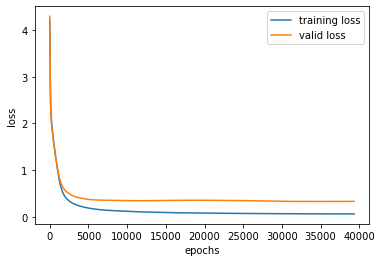

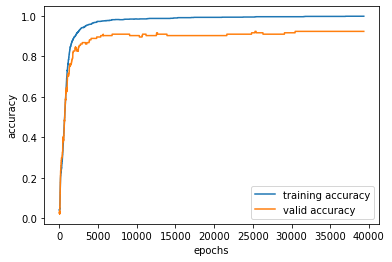

Training Accuracy 0.9909533750869868
Train - No. of correct predictions:  1424.0 / 1437
Train - Confusion Matrix 
 [[146   0   0   0   0   0   0   0   0   0]
 [  0 137   0   0   1   0   0   0   0   0]
 [  1   0 144   0   0   0   1   0   0   0]
 [  0   0   0 146   0   0   0   0   0   1]
 [  1   0   0   0 145   0   0   0   0   0]
 [  0   0   0   0   0 139   0   0   0   0]
 [  0   0   0   0   0   1 145   0   0   0]
 [  0   0   0   0   0   1   0 138   0   0]
 [  0   0   1   0   0   0   0   0 136   1]
 [  0   0   1   2   0   1   0   0   0 148]]

Train - Classification Report 

   Precision    Recall  F1-score
0   0.986486  1.000000  0.993197
1   1.000000  0.992754  0.996364
2   0.986301  0.986301  0.986301
3   0.986486  0.993197  0.989831
4   0.993151  0.993151  0.993151
5   0.978873  1.000000  0.989324
6   0.993151  0.993151  0.993151
7   1.000000  0.992806  0.996390
8   1.000000  0.985507  0.992701
9   0.986667  0.973684  0.980132


In [1621]:
#10
#a&b
mlp=MLPClassifier_Multiclass(hidden_layer_neurons=8, activation='logistic', regularizer='l2', alpha=0.0001, learning_rate='constant',
                  learning_rate_init=0.9, tol=1e-07, early_stopping=True, n_iter_no_change=10, 
                  momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=True)
mlp.fit(X_train_standard,y_train,validation_fraction=0.1,max_iter=1000000,verbose=True)

#c
y_predicted_train = mlp.predict(X_train_standard)
train_acc = np.mean(y_train==y_predicted_train)
train_cm = confusion_matrix(y_train,y_predicted_train)
precision_values = precision(train_cm)
recall_values = recall(train_cm)
f1_values = f1(train_cm)
d = np.zeros((10,3))
for i in range(10):
    d[i][0]=precision_values[i]
    d[i][1]=recall_values[i]
    d[i][2]=f1_values[i]
    
df=pd.DataFrame(d,columns=['Precision','Recall','F1-score'])

print('Training Accuracy', train_acc)
print('Train - No. of correct predictions: ', train_acc*len(y_train),'/',len(y_train))
print('Train - Confusion Matrix \n', train_cm)
print('\nTrain - Classification Report \n')
print(df)


In [1622]:
#d
y_predicted_test=mlp.predict(X_test_standard)
test_acc= np.mean(y_test==y_predicted_test)
test_cm=confusion_matrix(y_test,y_predicted_test)
precision_values=precision(test_cm)
recall_values=recall(test_cm)
f1_values=f1(test_cm)
d1=np.zeros((10,3))
for i in range(10):
    d1[i][0]=precision_values[i]
    d1[i][1]=recall_values[i]
    d1[i][2]=f1_values[i]
    
df1=pd.DataFrame(d1,columns=['Precision','Recall','F1-score'])

print('Testing Accuracy', test_acc)
print('\nTest - No. of correct predictions: ', test_acc*len(y_test),'/',len(y_test))
print('\nTest - Confusion Matrix \n', test_cm)
print('\n Test - Classification Report \n')
print(df1)

Testing Accuracy 0.9222222222222223

Test - No. of correct predictions:  332.0 / 360

Test - Confusion Matrix 
 [[31  0  0  0  0  0  0  0  1  0]
 [ 0 40  0  0  1  0  0  0  1  2]
 [ 0  0 31  0  0  0  0  0  0  0]
 [ 0  2  0 33  0  0  0  0  0  1]
 [ 0  0  0  0 28  1  0  0  6  0]
 [ 0  1  0  0  0 42  0  0  0  0]
 [ 1  1  0  0  0  0 33  0  0  0]
 [ 0  0  0  1  1  0  0 38  0  0]
 [ 0  2  1  0  1  0  1  0 31  0]
 [ 0  0  0  1  0  1  0  1  0 25]]

 Test - Classification Report 

   Precision    Recall  F1-score
0   0.968750  0.968750  0.968750
1   0.869565  0.909091  0.888889
2   0.968750  1.000000  0.984127
3   0.942857  0.916667  0.929577
4   0.903226  0.800000  0.848485
5   0.954545  0.976744  0.965517
6   0.970588  0.942857  0.956522
7   0.974359  0.950000  0.962025
8   0.794872  0.861111  0.826667
9   0.892857  0.892857  0.892857


In [1554]:
def ForwardPropagation_Binary(activation,w1,w2,X):
    X_bias=np.insert(X,0,1,axis=1)
        
    a1=X_bias
   
    z2=np.dot(a1,w1)
    a2=activate(activation, z2)
    a2=np.insert(a2,0,1,axis=1)
    #print('a2.shape',a2.shape)
    

    z3=np.dot(a2,w2)
    a3=activate(activation, z3)
    #print('a3.shape',a3.shape)
    
    return a3,a2,a1,z3,z2

In [1659]:
def BackPropagation_Binary(activation,a3,a2,a1,z3,z2,w1,w2,y,n,learning_rate_init,learning_rate,
                        learning_rate_scheduler,iterations,momentum,new_m1,new_m2,beta):
    if activation=='logistic':
        activation_gradient='logistic_gradient'
    elif activation=='relu':
        activation_gradient='relu_gradient'
    elif activation=='tanh':
        activation_gradient='tanh_gradient'
    w2_no_bias=np.delete(w2,0,axis=0)
    if learning_rate=='constant':
        for i in y:
            if y[i]==1:
                delta3=-(1/a3)*activate_gradient(activation_gradient,z3)
            elif y[i]==0:
                delta3=1/(1-a3)*activate_gradient(activation_gradient,z3)
        print('delta3.shape',delta3.shape)
        #print('y_one_hot',y_one_hot.shape)
        #print('a2.shape in backprop',a2.shape)
        grad_L_for_w2=np.dot(a2.T,delta3)
        #print('grad_L_for_w2.shape',grad_L_for_w2.shape)
        delta2=delta3.dot(w2_no_bias.T)*activate_gradient(activation_gradient,z2)
        #print('delta2.shape',delta2.shape)
        grad_L_for_w1=np.dot(a1.T,delta2)
        #print('grad_L_for_w1.shape',grad_L_for_w1.shape)
        if momentum==True:
            previous_m1=new_m1
            new_m1=beta*previous_m1-learning_rate_init*grad_L_for_w2
            w2=w2+new_m1
            previous_m2=new_m2
            new_m2=beta*previous_m2-learning_rate_init*grad_L_for_w1
            w1=w1+new_m2
            return w1,w2,learning_rate_init,new_m1,new_m2
        elif momentum==False:
            w2=w2-((learning_rate_init/n)*grad_L_for_w2)
            #print('w2.shape',w2.shape)
            w1=w1-((learning_rate_init/n)*grad_L_for_w1)
            #print('w1.shape',w1.shape)
            return w1,w2,learning_rate_init,new_m1,new_m2
    elif learning_rate=='adaptive':
        for i in y:
            if y[i]==1:
                delta3=-(1/a3)*activate_gradient(activation_gradient,z3)
            else:
                delta3=1/(1-a3)*activate_gradient(activation_gradient,z3)
        grad_L_for_w2=np.dot(a2.T,delta3)
        delta2=delta3.dot(w2_no_bias.T)*activate_gradient(activation_gradient,z2)
        grad_L_for_w1=np.dot(a1.T,delta2)
        if learning_rate_scheduler=='timeBasedDecay':
            learning_rate_new=timeBasedDecay(learning_rate_init,iterations,0.01)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
        elif learning_rate_scheduler=='exponentialDecay':
            learning_rate_new=exponentialDecay(learning_rate_init,iterations,0.01)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
        elif learning_rate_scheduler=='reduceLearningRateonPlateau':
            learning_rate_new=reduceLearningRateonPlateau(learning_rate_init,0.1)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
            

In [1661]:
#11
class MLPClassifier_Binary:
    
    def __init__(self, hidden_layer_neurons=2, activation='logistic', regularizer=None, alpha=0.0001, learning_rate='constant',
                  learning_rate_init=0.001, tol=0.0001, early_stopping=False, n_iter_no_change=10, 
                  momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=True,**kwargs):
        self.hidden_layer_neurons=hidden_layer_neurons
        self.activation=activation
        self.regularizer=regularizer
        self.alpha=alpha
        self.learning_rate=learning_rate
        self.learning_rate_init=learning_rate_init
        self.tol=tol
        self.early_stopping=early_stopping
        self.n_iter_no_change=n_iter_no_change
        self.momentum=momentum
        self.beta=beta
        self.learning_rate_scheduler=learning_rate_scheduler
        self.plotLearningCurve=plotLearningCurve
        
        
    def fit(self, X, y, validation_fraction=0.1, max_iter=1000,verbose=False, **kwargs):
        self.validation_fraction=validation_fraction
        self.verbose=verbose
        self.X=X
        self.y=y
        n=X.shape
        self.max_iter=max_iter
        
        if self.early_stopping==True:
            X_train,X_valid,y_train,y_valid=train_test_split(X, y, test_size=self.validation_fraction)
            n_train=X_train.shape[0]
            n_valid=X_valid.shape[0]
            #print('y_train.shape',y_train.shape,'X_train.shape',X_train.shape)
            input_neurons=len(X_train[0])
            output_neurons=1
            train_loss,valid_loss=[],[]
            train_acc,valid_acc=[],[]
            eta=[]
            newJ_train=0
            newJ_valid=0
            new_acc_train=0
            new_acc_valid=0
            new_m1=0
            new_m2=0
            w1=InitializeWeights(input_neurons+1,self.hidden_layer_neurons)
            #w1=np.insert(w1,0,0.0)#W1 with bias
            #print('w1.shape',w1.shape)
            w2=InitializeWeights(self.hidden_layer_neurons+1,output_neurons)
            #w2=np.insert(w2,0,0.0)#W2 with bias
            #print('w2.shape',w2.shape)
            for i in range(self.max_iter):
                if self.regularizer=='l2':
                    random_index=np.random.randint(n_train)
                    X_traini=X_train[random_index:random_index+1]
                    #print('X_traini.shape',X_traini.shape)
                    y_traini=y_train[random_index:random_index+1]
                    a3_train,a2_train,a1_train,z3_train,z2_train=ForwardPropagation_Binary(self.activation,w1,w2,X_train)
                    #print('a3_train',a3_train.shape,'\n a2_train',a2_train.shape,'\n a1_train.shape',a1_train.shape,'\n z3_train',z3_train.shape,'\n z2_train',z2_train.shape)
                    a3_valid,a2_valid,a1_valid,z3_valid,z2_valid=ForwardPropagation_Binary(self.activation,w1,w2,X_valid)
                    #print('\n a3_valid',a3_valid.shape,'\n a2_valid',a2_valid.shape,'\n z3_valid',z3_valid.shape,'\n z2_valid',z2_valid.shape)
                    previousJ_train=newJ_train
                    previousJ_valid=newJ_valid
                    previous_acc_train=new_acc_train
                    previous_acc_valid=new_acc_valid
                    #print('a3_train',a3_train.shape)
                    #print('\n \n \n a3_valid',a3_valid.shape)
                    #print('\n \n \n y_one_hot_train',y_one_hot_train.shape)
                    #print('\n \n \n y_one_hot_valid',y_one_hot_valid.shape)
                    
                    newJ_train=binary_cross_entropy_loss_l2(y_train,a3_train,w2,self.alpha)
                    newJ_valid=binary_cross_entropy_loss_l2(y_valid,a3_valid,w2,self.alpha)
                    y_predicted_train=(a3_train>=0.5).astype(int)
                    y_predicted_valid=(a3_valid>=0.5).astype(int)
                    new_acc_train=np.mean(y_train==y_predicted_train)
                    new_acc_valid=np.mean(y_valid==y_predicted_valid)
                    train_loss.append(newJ_train)
                    valid_loss.append(newJ_valid)
                    train_acc.append(new_acc_train)
                    valid_acc.append(new_acc_valid)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Binary(self.activation,a3_train,a2_train,a1_train,z3_train,z2_train,w1,w2,
                                                                            y_train,n_train,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    #print('w1_updated',w1.shape)
                    #print('w2_updated',w2.shape)
                    #print('a2_train',a2_train.shape)
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],'| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if i>self.n_iter_no_change:
                        if valid_loss[i]<valid_loss[i-self.n_iter_no_change]:
                            self.n_iter_no_change=i
                        elif valid_loss[i]>=valid_loss[i-self.n_iter_no_change]:
                            break
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
                
                if self.regularizer==None:
                    random_index=np.random.randint(n_train)
                    X_traini=X_train[random_index:random_index+1]
                    y_traini=y_train[random_index:random_index+1]
                    a3_train,a2_train,a1_train,z3_train,z2_train=ForwardPropagation_Binary(self.activation,w1,w2,X_train)
                    #print(a3_train)
                    a3_valid,a2_valid,a1_valid,z3_valid,z2_valid=ForwardPropagation_Binary(self.activation,w1,w2,X_valid)
                    #print('a3_valid',a3_valid)
                    previousJ_train=newJ_train
                    previousJ_valid=newJ_valid
                    previous_acc_train=new_acc_train
                    previous_acc_valid=new_acc_valid
                    newJ_train=binary_cross_entropy_loss(y_train,a3_train)
                    newJ_valid=binary_cross_entropy_loss(y_valid,a3_valid)
                    y_predicted_train=(a3_train>=0.5).astype(np.int)
                    y_predicted_valid=(a3_valid>=0.5).astype(np.int)
                    new_acc_train=np.mean(y_train==y_predicted_train)
                    new_acc_valid=np.mean(y_valid==y_predicted_valid)
                    train_loss.append(newJ_train)
                    valid_loss.append(newJ_valid)
                    train_acc.append(new_acc_train)
                    valid_acc.append(new_acc_valid)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Binary(self.activation,a3_train,a2_train,a1_train,z3_train,z2_train,w1,w2,
                                                                            y_train,n_train,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if i>self.n_iter_no_change:
                        if valid_loss[i]<valid_loss[i-self.n_iter_no_change]:
                            self.n_iter_no_change=i
                        elif valid_loss[i]>=valid_loss[i-self.n_iter_no_change]:
                            break
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
            if self.verbose==True:
                print('\nEarly stopping because the validation accuracy change between two consecutive epochs is less than ',self.tol,' over the last ', self.n_iter_no_change,' epochs')    
            if self.plotLearningCurve==True:
                print("number of iterations used: ", self.n_iter_no_change)
                plt.plot(train_loss,label="training loss")
                plt.plot(valid_loss,label="valid loss")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("loss")
                plt.show()
                    
                plt.plot(train_acc,label="training accuracy")
                plt.plot(valid_acc,label="valid accuracy")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("accuracy")
                plt.show()
        
        elif self.early_stopping==False:
            class_label=np.unique(y)
            y_one_hot=one_hot_labels(y,class_label)
            input_neurons=len(self.X[0])
            output_neurons=len(np.unique(self.y))
            train_loss=[]
            train_acc=[]
            eta=[]
            w1_array=[]
            w2_array=[]
            newJ=0
            new_acc=0
            new_m1=0
            new_m2=0
            w1=InitializeWeights(input_neurons+1,self.hidden_layer_neurons)  #W1 with bias
            w2=InitializeWeights(self.hidden_layer_neurons+1,output_neurons) #W2 with bias
            for i in range(max_iter):
                if regularizer=='l2':
                    random_index=random.randint(n)
                    Xi=X[random_index]
                    y_one_hoti=y_one_hot[random_index]
                    a3,a2,a1,z3,z2=ForwardPropagation_Binary(self.activation,w1,w2,X)
                    previousJ=newJ
                    previous_acc=new_acc
                    newJ=cros_entropy_loss_l2(y_one_hot,a3,w2,self.alpha)
                    y_predicted=(a3>=0.5).astype(np.int)
                    new_acc=np.mean(y_train==y_predicted)
                    train_loss.append(newJ)
                    train_acc.append(new_acc)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Binary(self.activation,a3,a2,a1,z3,z2,w1,w2,
                                                                            y_one_hot,n,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
                
                
                if regularizer==None:
                    random_index=random.randint(n)
                    Xi=X[random_index]
                    y_one_hoti=y_one_hot[random_index]
                    a3,a2,a1,z3,z2=ForwardPropagation_Binary(self.activation,w1,w2,X)
                    previousJ=newJ
                    previous_acc=new_acc
                    newJ=cross_entropy_loss(y_one_hot,a3)
                    y_predicted=(a3>=0.5).astype(np.int)
                    new_acc=np.mean(y_train==y_predicted)
                    train_loss.append(newJ)
                    train_acc.append(new_acc)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Binary(self.activation,a3,a2,a1,z3,z2,w1,w2,
                                                                            y_one_hot,n,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
            if self.plotLearningCurve==True:
                print("number of iterations used: ", self.n_iter_no_change)
                plt.plot(train_loss,label="training loss")
                    #plt.plot(valid_loss,label="valid loss")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("loss")
                plt.show()
                    
                plt.plot(train_acc,label="training accuracy")
                    #plt.plot(valid_acc,label="valid accuracy")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("accuracy")
                plt.show()
                    
    def predict(self,X):
        A3,A2,A1,Z3,Z2=ForwardPropagation_Binary(self.activation,self.W1,self.W2,X)
        y_predicted=(A3>=0.5).astype(int)
        return y_predicted


In [1648]:
digits=load_digits()
X1=digits['data']
y1=(digits['target']==5).astype(int)
#X1.shape,y1.shape

In [1649]:
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.20, random_state=2)
#X1_train,X1_test,y1_train,y1_train.shape,y1_test,y1_test.shape



In [1650]:

scaler=StandardScaler()
scaler.fit(X1_train)
X1_train_standard=scaler.transform(X1_train)
X1_test_standard=scaler.transform(X1_test)
#X1_train_standard.shape,X1_test_standard.shape

In [1653]:
import tabulate
def mydictionary(hidden_layer_neurons, activation, alpha, learning_rate, learning_rate_init, max_iter, tol, n_iter_no_change):
    mydict={'hidden_layer_neurons':[],'activation':[],'alpha':[],'learning_rate':[],'learning_rate_init':[],
            'max_iter':[],'tolerance':[],'n_iter_no_change':[],'accuracy':[]}
    mylist=[]
    for h in hidden_layer_neurons:
        for a in activation:
            for al in alpha:
                for l in learning_rate:
                    for lr in learning_rate_init:
                        for m in max_iter:
                            for t in tol:
                                for n in n_iter_no_change:
                                    mlp_classifier=MLPClassifier_Binary(hidden_layer_neurons=h, activation=a, regularizer='l2', alpha=al, learning_rate=l,
                                                                            learning_rate_init=lr, tol=t, early_stopping=True, n_iter_no_change=n, 
                                                                            momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=False)
                                    mlp_classifier.fit(X1_train_standard,y1_train,validation_fraction=0.1,max_iter=m,verbose=True)
                                    y1_predicted_train=mlp_classifier.predict(X1_train)
                                    accuracy=np.mean(y1_train==y1_predicted_train)
                                    mydict={'hidden_layer_neurons':h,'activation':a,'alpha':al,'learning_rate':l,
                                            'learning_rate_init':lr,'max_iter':m,'tolerance':t,'n_iter_no_change':n,'accuracy':accuracy}
                                    mydict_copy=mydict.copy()
                                    mylist.append(mydict_copy)
    header=mylist[0].keys()
    rows= [x.values() for x in mylist]
    print(tabulate.tabulate(rows,header,tablefmt='grid'))
hidden_layer_neurons=[4]
activation=['logistic']
alpha=[0.0001]
learning_rate=['adaptive']
learning_rate_init=[0.01]
max_iter=[1000000]
tol=[1e-05]
n_iter_no_change=[10]
mydictionary(hidden_layer_neurons, activation, alpha, learning_rate, learning_rate_init, max_iter, tol, n_iter_no_change)


Epoch  0 of 1000000 : Training Loss  1772.2430396015905 | Valid Loss  183.1132148192872 | Training accuracy  0.25074214238247594 | Valid accuracy  0.24479166666666666 | ETA  0.01
Epoch  1 of 1000000 : Training Loss  1758.8360469301363 | Valid Loss  181.71338171887413 | Training accuracy  0.2570285952858183 | Valid accuracy  0.24479166666666666 | ETA  0.009900990099009901
Epoch  2 of 1000000 : Training Loss  1745.6691663171996 | Valid Loss  180.3397730075529 | Training accuracy  0.26017182173748943 | Valid accuracy  0.25 | ETA  0.00980392156862745
Epoch  3 of 1000000 : Training Loss  1732.736440271622 | Valid Loss  178.9917199553791 | Training accuracy  0.2645723387698291 | Valid accuracy  0.25 | ETA  0.00970873786407767
Epoch  4 of 1000000 : Training Loss  1720.0320987737935 | Valid Loss  177.6685751735195 | Training accuracy  0.2683442105118345 | Valid accuracy  0.2552083333333333 | ETA  0.009615384615384614
Epoch  5 of 1000000 : Training Loss  1707.5505521193527 | Valid Loss  176.369

Epoch  44 of 1000000 : Training Loss  1350.0304923442163 | Valid Loss  139.68442631545628 | Training accuracy  0.4299060501277328 | Valid accuracy  0.4895833333333333 | ETA  0.006944444444444444
Epoch  45 of 1000000 : Training Loss  1343.3248276194213 | Valid Loss  139.00733898514807 | Training accuracy  0.43179198599873553 | Valid accuracy  0.4947916666666667 | ETA  0.006896551724137932
Epoch  46 of 1000000 : Training Loss  1336.7103902481995 | Valid Loss  138.3399181818291 | Training accuracy  0.43367792186973825 | Valid accuracy  0.4947916666666667 | ETA  0.00684931506849315
Epoch  47 of 1000000 : Training Loss  1330.1854407795822 | Valid Loss  137.68197355225936 | Training accuracy  0.43367792186973825 | Valid accuracy  0.4947916666666667 | ETA  0.006802721088435374
Epoch  48 of 1000000 : Training Loss  1323.7482818814801 | Valid Loss  137.03331946590964 | Training accuracy  0.43367792186973825 | Valid accuracy  0.4947916666666667 | ETA  0.006756756756756757
Epoch  49 of 1000000 : 

Epoch  87 of 1000000 : Training Loss  1126.8234666208675 | Valid Loss  117.42143820058138 | Training accuracy  0.473282575160795 | Valid accuracy  0.53125 | ETA  0.0053475935828877
Epoch  88 of 1000000 : Training Loss  1122.8700615562616 | Valid Loss  117.03279692019595 | Training accuracy  0.47516851103179775 | Valid accuracy  0.53125 | ETA  0.005319148936170213
Epoch  89 of 1000000 : Training Loss  1118.959884312362 | Valid Loss  116.64862371281592 | Training accuracy  0.47516851103179775 | Valid accuracy  0.5364583333333334 | ETA  0.005291005291005291
Epoch  90 of 1000000 : Training Loss  1115.0922639871571 | Valid Loss  116.26884694980667 | Training accuracy  0.47768309219313465 | Valid accuracy  0.5364583333333334 | ETA  0.005263157894736842
Epoch  91 of 1000000 : Training Loss  1111.2665429639162 | Valid Loss  115.89339645787732 | Training accuracy  0.47894038277380313 | Valid accuracy  0.5364583333333334 | ETA  0.005235602094240838
Epoch  92 of 1000000 : Training Loss  1107.4820

Epoch  135 of 1000000 : Training Loss  976.3491537120956 | Valid Loss  102.80039870668472 | Training accuracy  0.5091153567098464 | Valid accuracy  0.5625 | ETA  0.00425531914893617
Epoch  136 of 1000000 : Training Loss  973.8941841087731 | Valid Loss  102.56507995771088 | Training accuracy  0.5097440020001807 | Valid accuracy  0.5625 | ETA  0.0042372881355932195
Epoch  137 of 1000000 : Training Loss  971.4610702796381 | Valid Loss  102.33196994860258 | Training accuracy  0.5116299378711834 | Valid accuracy  0.5625 | ETA  0.004219409282700422
Epoch  138 of 1000000 : Training Loss  969.0495324420451 | Valid Loss  102.10103948165285 | Training accuracy  0.5116299378711834 | Valid accuracy  0.5625 | ETA  0.004201680672268907
Epoch  139 of 1000000 : Training Loss  966.6592954132071 | Valid Loss  101.87225985140431 | Training accuracy  0.5128872284518519 | Valid accuracy  0.5625 | ETA  0.0041841004184100415
Epoch  140 of 1000000 : Training Loss  964.2900885185214 | Valid Loss  101.645602834

Epoch  182 of 1000000 : Training Loss  880.7546803998707 | Valid Loss  93.72925572022517 | Training accuracy  0.5518632364525744 | Valid accuracy  0.5989583333333334 | ETA  0.0035460992907801413
Epoch  183 of 1000000 : Training Loss  879.0854831049066 | Valid Loss  93.57268576663735 | Training accuracy  0.5518632364525744 | Valid accuracy  0.5989583333333334 | ETA  0.00353356890459364
Epoch  184 of 1000000 : Training Loss  877.4287871020798 | Valid Loss  93.41735620626787 | Training accuracy  0.5531205270332429 | Valid accuracy  0.5989583333333334 | ETA  0.003521126760563381
Epoch  185 of 1000000 : Training Loss  875.7844563305069 | Valid Loss  93.26325309653647 | Training accuracy  0.5531205270332429 | Valid accuracy  0.6041666666666666 | ETA  0.0035087719298245615
Epoch  186 of 1000000 : Training Loss  874.1523566433227 | Valid Loss  93.1103626958512 | Training accuracy  0.5537491723235771 | Valid accuracy  0.6041666666666666 | ETA  0.0034965034965034965
Epoch  187 of 1000000 : Train

Epoch  226 of 1000000 : Training Loss  817.5626115246044 | Valid Loss  87.85285424776451 | Training accuracy  0.5876960180016257 | Valid accuracy  0.6354166666666666 | ETA  0.003067484662576687
Epoch  227 of 1000000 : Training Loss  816.3362805690884 | Valid Loss  87.73992469088854 | Training accuracy  0.58832466329196 | Valid accuracy  0.6354166666666666 | ETA  0.0030581039755351682
Epoch  228 of 1000000 : Training Loss  815.1179162873407 | Valid Loss  87.62777387148091 | Training accuracy  0.5889533085822942 | Valid accuracy  0.6354166666666666 | ETA  0.003048780487804878
Epoch  229 of 1000000 : Training Loss  813.9074428610351 | Valid Loss  87.51639413161034 | Training accuracy  0.5908392444532969 | Valid accuracy  0.6354166666666666 | ETA  0.00303951367781155
Epoch  230 of 1000000 : Training Loss  812.7047854094172 | Valid Loss  87.40577791035015 | Training accuracy  0.5908392444532969 | Valid accuracy  0.6354166666666666 | ETA  0.00303030303030303
Epoch  231 of 1000000 : Training 

Epoch  272 of 1000000 : Training Loss  768.3816748762533 | Valid Loss  83.36184808459949 | Training accuracy  0.6436454488413726 | Valid accuracy  0.6875 | ETA  0.0026881720430107525
Epoch  273 of 1000000 : Training Loss  767.4555634939619 | Valid Loss  83.2780755852164 | Training accuracy  0.6493032564543807 | Valid accuracy  0.6875 | ETA  0.002680965147453083
Epoch  274 of 1000000 : Training Loss  766.5347216040791 | Valid Loss  83.19481102230573 | Training accuracy  0.6499319017447149 | Valid accuracy  0.6875 | ETA  0.00267379679144385
Epoch  275 of 1000000 : Training Loss  765.6191049821401 | Valid Loss  83.11204998744783 | Training accuracy  0.6518178376157177 | Valid accuracy  0.6875 | ETA  0.0026666666666666666
Epoch  276 of 1000000 : Training Loss  764.7086698882358 | Valid Loss  83.02978812169522 | Training accuracy  0.6543324187770546 | Valid accuracy  0.6927083333333334 | ETA  0.0026595744680851063
Epoch  277 of 1000000 : Training Loss  763.8033730605042 | Valid Loss  82.948

Epoch  317 of 1000000 : Training Loss  731.3609257647277 | Valid Loss  80.03901153468894 | Training accuracy  0.6863933285841006 | Valid accuracy  0.7135416666666666 | ETA  0.0023980815347721825
Epoch  318 of 1000000 : Training Loss  730.6341781475008 | Valid Loss  79.97434481032003 | Training accuracy  0.6876506191647691 | Valid accuracy  0.7135416666666666 | ETA  0.002392344497607656
Epoch  319 of 1000000 : Training Loss  729.9111106627078 | Valid Loss  79.91002842063318 | Training accuracy  0.6895365550357718 | Valid accuracy  0.7135416666666666 | ETA  0.0023866348448687356
Epoch  320 of 1000000 : Training Loss  729.1916956739452 | Valid Loss  79.84605964217941 | Training accuracy  0.690165200326106 | Valid accuracy  0.7135416666666666 | ETA  0.0023809523809523807
Epoch  321 of 1000000 : Training Loss  728.475905816812 | Valid Loss  79.78243577896701 | Training accuracy  0.6914224909067744 | Valid accuracy  0.7135416666666666 | ETA  0.0023752969121140144
Epoch  322 of 1000000 : Trai

Epoch  363 of 1000000 : Training Loss  701.3602322019273 | Valid Loss  77.38965535149585 | Training accuracy  0.7083959137457988 | Valid accuracy  0.7239583333333334 | ETA  0.0021598272138228943
Epoch  364 of 1000000 : Training Loss  700.7778171299399 | Valid Loss  77.33865286771925 | Training accuracy  0.709024559036133 | Valid accuracy  0.7239583333333334 | ETA  0.0021551724137931034
Epoch  365 of 1000000 : Training Loss  700.1980492380263 | Valid Loss  77.28789942306008 | Training accuracy  0.709024559036133 | Valid accuracy  0.7239583333333334 | ETA  0.002150537634408602
Epoch  366 of 1000000 : Training Loss  699.6209106020211 | Valid Loss  77.23739326987832 | Training accuracy  0.7096532043264673 | Valid accuracy  0.7239583333333334 | ETA  0.002145922746781116
Epoch  367 of 1000000 : Training Loss  699.0463834573527 | Valid Loss  77.18713267647796 | Training accuracy  0.7096532043264673 | Valid accuracy  0.7239583333333334 | ETA  0.0021413276231263384
Epoch  368 of 1000000 : Train

Epoch  409 of 1000000 : Training Loss  677.0607215596059 | Valid Loss  75.27714519959957 | Training accuracy  0.7215974648428177 | Valid accuracy  0.7395833333333334 | ETA  0.001964636542239686
Epoch  410 of 1000000 : Training Loss  676.5836905157952 | Valid Loss  75.23600557359812 | Training accuracy  0.7215974648428177 | Valid accuracy  0.7395833333333334 | ETA  0.0019607843137254906
Epoch  411 of 1000000 : Training Loss  676.1086240409459 | Valid Loss  75.19504873183257 | Training accuracy  0.7228547554234862 | Valid accuracy  0.7395833333333334 | ETA  0.0019569471624266144
Epoch  412 of 1000000 : Training Loss  675.6355100370496 | Valid Loss  75.1542735062331 | Training accuracy  0.7228547554234862 | Valid accuracy  0.7395833333333334 | ETA  0.001953125
Epoch  413 of 1000000 : Training Loss  675.1643365043411 | Valid Loss  75.11367873845303 | Training accuracy  0.7234834007138204 | Valid accuracy  0.7395833333333334 | ETA  0.0019493177387914231
Epoch  414 of 1000000 : Training Loss

Epoch  454 of 1000000 : Training Loss  657.3811002503917 | Valid Loss  73.59157990616767 | Training accuracy  0.7417141141335133 | Valid accuracy  0.7447916666666666 | ETA  0.0018050541516245488
Epoch  455 of 1000000 : Training Loss  656.9817582208667 | Valid Loss  73.55763369222322 | Training accuracy  0.7417141141335133 | Valid accuracy  0.7447916666666666 | ETA  0.001801801801801802
Epoch  456 of 1000000 : Training Loss  656.5839212026956 | Valid Loss  73.52382607590236 | Training accuracy  0.7417141141335133 | Valid accuracy  0.7447916666666666 | ETA  0.0017985611510791366
Epoch  457 of 1000000 : Training Loss  656.1875806887507 | Valid Loss  73.49015624314971 | Training accuracy  0.7423427594238475 | Valid accuracy  0.7447916666666666 | ETA  0.0017953321364452424
Epoch  458 of 1000000 : Training Loss  655.7927282354628 | Valid Loss  73.45662338614744 | Training accuracy  0.743600050004516 | Valid accuracy  0.7447916666666666 | ETA  0.0017921146953405018
Epoch  459 of 1000000 : Tra

Epoch  499 of 1000000 : Training Loss  640.7887556632897 | Valid Loss  72.19052305103097 | Training accuracy  0.7618307634242087 | Valid accuracy  0.7604166666666666 | ETA  0.001669449081803005
Epoch  500 of 1000000 : Training Loss  640.4495387618705 | Valid Loss  72.1620883102041 | Training accuracy  0.7630880540048772 | Valid accuracy  0.7604166666666666 | ETA  0.0016666666666666666
Epoch  501 of 1000000 : Training Loss  640.111499511141 | Valid Loss  72.13376096427598 | Training accuracy  0.7630880540048772 | Valid accuracy  0.7604166666666666 | ETA  0.001663893510815308
Epoch  502 of 1000000 : Training Loss  639.7746317633244 | Valid Loss  72.10554042989368 | Training accuracy  0.7630880540048772 | Valid accuracy  0.7604166666666666 | ETA  0.0016611295681063121
Epoch  503 of 1000000 : Training Loss  639.4389294131536 | Valid Loss  72.077426127843 | Training accuracy  0.7630880540048772 | Valid accuracy  0.7604166666666666 | ETA  0.001658374792703151
Epoch  504 of 1000000 : Training

Epoch  544 of 1000000 : Training Loss  626.6085491498284 | Valid Loss  71.00957824062405 | Training accuracy  0.7788041862632331 | Valid accuracy  0.7604166666666666 | ETA  0.0015527950310559005
Epoch  545 of 1000000 : Training Loss  626.316793355398 | Valid Loss  70.98545251819391 | Training accuracy  0.7794328315535674 | Valid accuracy  0.7604166666666666 | ETA  0.0015503875968992248
Epoch  546 of 1000000 : Training Loss  626.025975980716 | Valid Loss  70.96141157503844 | Training accuracy  0.7794328315535674 | Valid accuracy  0.7604166666666666 | ETA  0.0015479876160990713
Epoch  547 of 1000000 : Training Loss  625.7360924771382 | Valid Loss  70.93745498297795 | Training accuracy  0.7794328315535674 | Valid accuracy  0.765625 | ETA  0.0015455950540958269
Epoch  548 of 1000000 : Training Loss  625.4471383252724 | Valid Loss  70.91358231666003 | Training accuracy  0.7794328315535674 | Valid accuracy  0.7708333333333334 | ETA  0.0015432098765432098
Epoch  549 of 1000000 : Training Loss

Epoch  587 of 1000000 : Training Loss  614.857706354296 | Valid Loss  70.04377174582022 | Training accuracy  0.7869765750375781 | Valid accuracy  0.78125 | ETA  0.0014556040756914118
Epoch  588 of 1000000 : Training Loss  614.6025293803132 | Valid Loss  70.02293713824804 | Training accuracy  0.7876052203279124 | Valid accuracy  0.78125 | ETA  0.0014534883720930235
Epoch  589 of 1000000 : Training Loss  614.3481190210774 | Valid Loss  70.00217119258228 | Training accuracy  0.7876052203279124 | Valid accuracy  0.78125 | ETA  0.001451378809869376
Epoch  590 of 1000000 : Training Loss  614.094471799685 | Valid Loss  69.9814735839075 | Training accuracy  0.7876052203279124 | Valid accuracy  0.78125 | ETA  0.0014492753623188406
Epoch  591 of 1000000 : Training Loss  613.8415842601821 | Valid Loss  69.96084398931981 | Training accuracy  0.7882338656182466 | Valid accuracy  0.78125 | ETA  0.001447178002894356
Epoch  592 of 1000000 : Training Loss  613.5894529674118 | Valid Loss  69.94028208791

Epoch  635 of 1000000 : Training Loss  603.417641056098 | Valid Loss  69.11590820047901 | Training accuracy  0.8064645790379394 | Valid accuracy  0.8020833333333334 | ETA  0.0013605442176870747
Epoch  636 of 1000000 : Training Loss  603.1956737509057 | Valid Loss  69.09803488565255 | Training accuracy  0.8064645790379394 | Valid accuracy  0.8020833333333334 | ETA  0.001358695652173913
Epoch  637 of 1000000 : Training Loss  602.9743273404878 | Valid Loss  69.08021666502907 | Training accuracy  0.8064645790379394 | Valid accuracy  0.8020833333333334 | ETA  0.0013568521031207597
Epoch  638 of 1000000 : Training Loss  602.7535991984149 | Valid Loss  69.06245329507719 | Training accuracy  0.8064645790379394 | Valid accuracy  0.8020833333333334 | ETA  0.0013550135501355016
Epoch  639 of 1000000 : Training Loss  602.5334867130454 | Valid Loss  69.04474453367473 | Training accuracy  0.8064645790379394 | Valid accuracy  0.8020833333333334 | ETA  0.0013531799729364006
Epoch  640 of 1000000 : Tra

Epoch  680 of 1000000 : Training Loss  594.0086119969678 | Valid Loss  68.36289491612251 | Training accuracy  0.8121223866509475 | Valid accuracy  0.8125 | ETA  0.0012820512820512823
Epoch  681 of 1000000 : Training Loss  593.8121801392842 | Valid Loss  68.34727833980928 | Training accuracy  0.8121223866509475 | Valid accuracy  0.8125 | ETA  0.0012804097311139564
Epoch  682 of 1000000 : Training Loss  593.6162642733296 | Valid Loss  68.33170716289241 | Training accuracy  0.8127510319412817 | Valid accuracy  0.8125 | ETA  0.0012787723785166241
Epoch  683 of 1000000 : Training Loss  593.4208623466005 | Valid Loss  68.31618119639029 | Training accuracy  0.8127510319412817 | Valid accuracy  0.8125 | ETA  0.001277139208173691
Epoch  684 of 1000000 : Training Loss  593.2259723174665 | Valid Loss  68.30070025235148 | Training accuracy  0.8127510319412817 | Valid accuracy  0.8125 | ETA  0.0012755102040816328
Epoch  685 of 1000000 : Training Loss  593.0315921551058 | Valid Loss  68.285264143847

Epoch  728 of 1000000 : Training Loss  585.1284214299204 | Valid Loss  67.6614303834341 | Training accuracy  0.8171515489736214 | Valid accuracy  0.8125 | ETA  0.0012077294685990338
Epoch  729 of 1000000 : Training Loss  584.9546170165505 | Valid Loss  67.64779636586002 | Training accuracy  0.8171515489736214 | Valid accuracy  0.8125 | ETA  0.0012062726176115804
Epoch  730 of 1000000 : Training Loss  584.7812412041957 | Valid Loss  67.63419972872455 | Training accuracy  0.8171515489736214 | Valid accuracy  0.8125 | ETA  0.0012048192771084336
Epoch  731 of 1000000 : Training Loss  584.6082923903556 | Valid Loss  67.62064032554385 | Training accuracy  0.8171515489736214 | Valid accuracy  0.8125 | ETA  0.0012033694344163659
Epoch  732 of 1000000 : Training Loss  584.4357689805157 | Valid Loss  67.60711801058609 | Training accuracy  0.8171515489736214 | Valid accuracy  0.8125 | ETA  0.0012019230769230768
Epoch  733 of 1000000 : Training Loss  584.2636693881059 | Valid Loss  67.593632638866

Epoch  774 of 1000000 : Training Loss  577.5539336773469 | Valid Loss  67.07084720520429 | Training accuracy  0.8221807112962953 | Valid accuracy  0.8125 | ETA  0.0011441647597254005
Epoch  775 of 1000000 : Training Loss  577.3982999955107 | Valid Loss  67.05879176085206 | Training accuracy  0.8221807112962953 | Valid accuracy  0.8125 | ETA  0.001142857142857143
Epoch  776 of 1000000 : Training Loss  577.2430287724803 | Valid Loss  67.04676767008387 | Training accuracy  0.8228093565866296 | Valid accuracy  0.8125 | ETA  0.0011415525114155253
Epoch  777 of 1000000 : Training Loss  577.0881187270653 | Valid Loss  67.03477481657086 | Training accuracy  0.8228093565866296 | Valid accuracy  0.8125 | ETA  0.0011402508551881414
Epoch  778 of 1000000 : Training Loss  576.9335685841215 | Valid Loss  67.02281308454968 | Training accuracy  0.8228093565866296 | Valid accuracy  0.8125 | ETA  0.0011389521640091116
Epoch  779 of 1000000 : Training Loss  576.7793770745138 | Valid Loss  67.010882358819

Epoch  820 of 1000000 : Training Loss  570.751420707902 | Valid Loss  66.54706969872518 | Training accuracy  0.8265812283286349 | Valid accuracy  0.8125 | ETA  0.0010869565217391307
Epoch  821 of 1000000 : Training Loss  570.6112203888074 | Valid Loss  66.53634418070214 | Training accuracy  0.8265812283286349 | Valid accuracy  0.8125 | ETA  0.0010857763300760044
Epoch  822 of 1000000 : Training Loss  570.4713293490342 | Valid Loss  66.52564520258737 | Training accuracy  0.8265812283286349 | Valid accuracy  0.8125 | ETA  0.0010845986984815616
Epoch  823 of 1000000 : Training Loss  570.3317465521567 | Valid Loss  66.51497267088793 | Training accuracy  0.8272098736189691 | Valid accuracy  0.8125 | ETA  0.0010834236186348862
Epoch  824 of 1000000 : Training Loss  570.192470966394 | Valid Loss  66.50432649254248 | Training accuracy  0.8278385189093034 | Valid accuracy  0.8125 | ETA  0.0010822510822510823
Epoch  825 of 1000000 : Training Loss  570.053501564575 | Valid Loss  66.4937065749188 

Epoch  867 of 1000000 : Training Loss  564.4803207198338 | Valid Loss  66.07021737830279 | Training accuracy  0.8334963265223115 | Valid accuracy  0.8125 | ETA  0.001034126163391934
Epoch  868 of 1000000 : Training Loss  564.3536070250956 | Valid Loss  66.0606447532912 | Training accuracy  0.8334963265223115 | Valid accuracy  0.8125 | ETA  0.0010330578512396695
Epoch  869 of 1000000 : Training Loss  564.2271585225459 | Valid Loss  66.05109470341996 | Training accuracy  0.8334963265223115 | Valid accuracy  0.8125 | ETA  0.0010319917440660476
Epoch  870 of 1000000 : Training Loss  564.100974368422 | Valid Loss  66.0415671530675 | Training accuracy  0.8334963265223115 | Valid accuracy  0.8125 | ETA  0.0010309278350515464
Epoch  871 of 1000000 : Training Loss  563.9750537225492 | Valid Loss  66.03206202694413 | Training accuracy  0.8334963265223115 | Valid accuracy  0.8125 | ETA  0.0010298661174047373
Epoch  872 of 1000000 : Training Loss  563.8493957483215 | Valid Loss  66.02257925009039 

Epoch  913 of 1000000 : Training Loss  558.9137170522195 | Valid Loss  65.65214576640787 | Training accuracy  0.837268198264317 | Valid accuracy  0.8229166666666666 | ETA  0.0009871668311944718
Epoch  914 of 1000000 : Training Loss  558.7983804385225 | Valid Loss  65.64353808966105 | Training accuracy  0.837268198264317 | Valid accuracy  0.8229166666666666 | ETA  0.0009861932938856014
Epoch  915 of 1000000 : Training Loss  558.6832736482572 | Valid Loss  65.63494982746404 | Training accuracy  0.837268198264317 | Valid accuracy  0.8229166666666666 | ETA  0.0009852216748768472
Epoch  916 of 1000000 : Training Loss  558.5683959847507 | Valid Loss  65.62638091776337 | Training accuracy  0.837268198264317 | Valid accuracy  0.8229166666666666 | ETA  0.000984251968503937
Epoch  917 of 1000000 : Training Loss  558.4537467541554 | Valid Loss  65.61783129876544 | Training accuracy  0.837268198264317 | Valid accuracy  0.8229166666666666 | ETA  0.0009832841691248771
Epoch  918 of 1000000 : Trainin

Epoch  958 of 1000000 : Training Loss  553.9416130381018 | Valid Loss  65.28317732110891 | Training accuracy  0.8416687152966565 | Valid accuracy  0.8229166666666666 | ETA  0.000945179584120983
Epoch  959 of 1000000 : Training Loss  553.8359668366597 | Valid Loss  65.27538536311314 | Training accuracy  0.8416687152966565 | Valid accuracy  0.8229166666666666 | ETA  0.0009442870632672333
Epoch  960 of 1000000 : Training Loss  553.7305217148387 | Valid Loss  65.26761026661671 | Training accuracy  0.8416687152966565 | Valid accuracy  0.8229166666666666 | ETA  0.0009433962264150945
Epoch  961 of 1000000 : Training Loss  553.6252770900943 | Valid Loss  65.25985198003787 | Training accuracy  0.8416687152966565 | Valid accuracy  0.8229166666666666 | ETA  0.0009425070688030161
Epoch  962 of 1000000 : Training Loss  553.5202323821425 | Valid Loss  65.25211045200156 | Training accuracy  0.8416687152966565 | Valid accuracy  0.8229166666666666 | ETA  0.0009416195856873823
Epoch  963 of 1000000 : Tr

Epoch  1001 of 1000000 : Training Loss  549.5734807658338 | Valid Loss  64.96273705342949 | Training accuracy  0.8435546511676593 | Valid accuracy  0.8229166666666666 | ETA  0.0009082652134423251
Epoch  1002 of 1000000 : Training Loss  549.4759815416766 | Valid Loss  64.95562599204312 | Training accuracy  0.8435546511676593 | Valid accuracy  0.8229166666666666 | ETA  0.0009074410163339384
Epoch  1003 of 1000000 : Training Loss  549.3786602603255 | Valid Loss  64.94852974888565 | Training accuracy  0.8435546511676593 | Valid accuracy  0.8229166666666666 | ETA  0.0009066183136899365
Epoch  1004 of 1000000 : Training Loss  549.2815164272401 | Valid Loss  64.94144828040939 | Training accuracy  0.8435546511676593 | Valid accuracy  0.8229166666666666 | ETA  0.0009057971014492753
Epoch  1005 of 1000000 : Training Loss  549.1845495497184 | Valid Loss  64.93438154323425 | Training accuracy  0.8435546511676593 | Valid accuracy  0.8229166666666666 | ETA  0.0009049773755656109
Epoch  1006 of 10000

Epoch  1043 of 1000000 : Training Loss  545.6262437911802 | Valid Loss  64.67634915100454 | Training accuracy  0.8448119417483277 | Valid accuracy  0.8229166666666666 | ETA  0.0008748906386701664
Epoch  1044 of 1000000 : Training Loss  545.5358125797941 | Valid Loss  64.6698247995627 | Training accuracy  0.8448119417483277 | Valid accuracy  0.8229166666666666 | ETA  0.0008741258741258742
Epoch  1045 of 1000000 : Training Loss  545.4455400323443 | Valid Loss  64.6633135730052 | Training accuracy  0.8448119417483277 | Valid accuracy  0.8229166666666666 | ETA  0.0008733624454148472
Epoch  1046 of 1000000 : Training Loss  545.3554257247521 | Valid Loss  64.65681543418675 | Training accuracy  0.8448119417483277 | Valid accuracy  0.8229166666666666 | ETA  0.0008726003490401396
Epoch  1047 of 1000000 : Training Loss  545.2654692344563 | Valid Loss  64.65033034609979 | Training accuracy  0.845440587038662 | Valid accuracy  0.8229166666666666 | ETA  0.0008718395815170009
Epoch  1048 of 1000000 

Epoch  1088 of 1000000 : Training Loss  541.7081171974651 | Valid Loss  64.39523965004824 | Training accuracy  0.8466978776193305 | Valid accuracy  0.8229166666666666 | ETA  0.0008417508417508417
Epoch  1089 of 1000000 : Training Loss  541.6244266090625 | Valid Loss  64.38927100827154 | Training accuracy  0.8466978776193305 | Valid accuracy  0.8229166666666666 | ETA  0.0008410428931875526
Epoch  1090 of 1000000 : Training Loss  541.5408770134987 | Valid Loss  64.38331394767633 | Training accuracy  0.8466978776193305 | Valid accuracy  0.8229166666666666 | ETA  0.0008403361344537815
Epoch  1091 of 1000000 : Training Loss  541.4574680488003 | Valid Loss  64.37736843673379 | Training accuracy  0.8466978776193305 | Valid accuracy  0.8229166666666666 | ETA  0.0008396305625524769
Epoch  1092 of 1000000 : Training Loss  541.37419935424 | Valid Loss  64.37143444402743 | Training accuracy  0.8473265229096647 | Valid accuracy  0.8229166666666666 | ETA  0.0008389261744966444
Epoch  1093 of 1000000

Epoch  1133 of 1000000 : Training Loss  538.0766665350894 | Valid Loss  64.13768490574118 | Training accuracy  0.8492124587806674 | Valid accuracy  0.8229166666666666 | ETA  0.0008110300081103
Epoch  1134 of 1000000 : Training Loss  537.9989791842755 | Valid Loss  64.13220772756802 | Training accuracy  0.8492124587806674 | Valid accuracy  0.8229166666666666 | ETA  0.0008103727714748785
Epoch  1135 of 1000000 : Training Loss  537.921417698805 | Valid Loss  64.12674081637775 | Training accuracy  0.8492124587806674 | Valid accuracy  0.8229166666666666 | ETA  0.0008097165991902835
Epoch  1136 of 1000000 : Training Loss  537.8439817678313 | Valid Loss  64.1212841452429 | Training accuracy  0.8492124587806674 | Valid accuracy  0.8229166666666666 | ETA  0.0008090614886731393
Epoch  1137 of 1000000 : Training Loss  537.7666710815373 | Valid Loss  64.11583768732841 | Training accuracy  0.8492124587806674 | Valid accuracy  0.8229166666666666 | ETA  0.0008084074373484237
Epoch  1138 of 1000000 : 

Epoch  1175 of 1000000 : Training Loss  534.9187110704429 | Valid Loss  63.916184190637374 | Training accuracy  0.8523556852323385 | Valid accuracy  0.8229166666666666 | ETA  0.000784313725490196
Epoch  1176 of 1000000 : Training Loss  534.8460537855277 | Valid Loss  63.91111606011924 | Training accuracy  0.8523556852323385 | Valid accuracy  0.8229166666666666 | ETA  0.0007836990595611286
Epoch  1177 of 1000000 : Training Loss  534.7735101502377 | Valid Loss  63.90605714092834 | Training accuracy  0.8523556852323385 | Valid accuracy  0.8229166666666666 | ETA  0.0007830853563038372
Epoch  1178 of 1000000 : Training Loss  534.701079893528 | Valid Loss  63.90100740970318 | Training accuracy  0.8523556852323385 | Valid accuracy  0.8229166666666666 | ETA  0.000782472613458529
Epoch  1179 of 1000000 : Training Loss  534.6287627452228 | Valid Loss  63.895966843159876 | Training accuracy  0.8523556852323385 | Valid accuracy  0.8229166666666666 | ETA  0.0007818608287724785
Epoch  1180 of 100000

Epoch  1220 of 1000000 : Training Loss  531.7579253873843 | Valid Loss  63.69691720729606 | Training accuracy  0.8529843305226728 | Valid accuracy  0.8333333333333334 | ETA  0.0007575757575757575
Epoch  1221 of 1000000 : Training Loss  531.6901258121978 | Valid Loss  63.69224151321937 | Training accuracy  0.853612975813007 | Valid accuracy  0.8333333333333334 | ETA  0.0007570022710068129
Epoch  1222 of 1000000 : Training Loss  531.6224285014345 | Valid Loss  63.68757405166305 | Training accuracy  0.853612975813007 | Valid accuracy  0.8333333333333334 | ETA  0.00075642965204236
Epoch  1223 of 1000000 : Training Loss  531.5548332198659 | Valid Loss  63.68291480246009 | Training accuracy  0.853612975813007 | Valid accuracy  0.8333333333333334 | ETA  0.0007558578987150416
Epoch  1224 of 1000000 : Training Loss  531.4873397329906 | Valid Loss  63.678263745508126 | Training accuracy  0.853612975813007 | Valid accuracy  0.8333333333333334 | ETA  0.0007552870090634441
Epoch  1225 of 1000000 : 

Epoch  1264 of 1000000 : Training Loss  528.8684664906999 | Valid Loss  63.49871604311167 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007331378299120234
Epoch  1265 of 1000000 : Training Loss  528.8049532753306 | Valid Loss  63.494384324298416 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007326007326007326
Epoch  1266 of 1000000 : Training Loss  528.7415326258974 | Valid Loss  63.49006000855409 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007320644216691069
Epoch  1267 of 1000000 : Training Loss  528.6782043366356 | Valid Loss  63.485743078327836 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007315288953913679
Epoch  1268 of 1000000 : Training Loss  528.6149682023953 | Valid Loss  63.48143351612316 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007309941520467836
Epoch  1269 of 100

Epoch  1307 of 1000000 : Training Loss  526.2185195676549 | Valid Loss  63.31892702919423 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.000710732054015636
Epoch  1308 of 1000000 : Training Loss  526.15880818725 | Valid Loss  63.31489844047406 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007102272727272729
Epoch  1309 of 1000000 : Training Loss  526.0991810523533 | Valid Loss  63.31087654680185 | Training accuracy  0.8542416211033412 | Valid accuracy  0.8385416666666666 | ETA  0.0007097232079489
Epoch  1310 of 1000000 : Training Loss  526.039637981657 | Valid Loss  63.30686133278892 | Training accuracy  0.8548702663936755 | Valid accuracy  0.8385416666666666 | ETA  0.0007092198581560284
Epoch  1311 of 1000000 : Training Loss  525.9801787943759 | Valid Loss  63.302852783092796 | Training accuracy  0.8548702663936755 | Valid accuracy  0.8385416666666666 | ETA  0.0007087172218284905
Epoch  1312 of 1000000 : T

Epoch  1353 of 1000000 : Training Loss  523.5563209004473 | Valid Loss  63.14031503806631 | Training accuracy  0.856127556974344 | Valid accuracy  0.84375 | ETA  0.0006882312456985547
Epoch  1354 of 1000000 : Training Loss  523.5003048157714 | Valid Loss  63.13657916901798 | Training accuracy  0.856127556974344 | Valid accuracy  0.84375 | ETA  0.000687757909215956
Epoch  1355 of 1000000 : Training Loss  523.4443651513141 | Valid Loss  63.1328493324977 | Training accuracy  0.856127556974344 | Valid accuracy  0.84375 | ETA  0.0006872852233676975
Epoch  1356 of 1000000 : Training Loss  523.3885017480306 | Valid Loss  63.12912551507649 | Training accuracy  0.856127556974344 | Valid accuracy  0.84375 | ETA  0.0006868131868131868
Epoch  1357 of 1000000 : Training Loss  523.3327144473182 | Valid Loss  63.12540770336441 | Training accuracy  0.856127556974344 | Valid accuracy  0.84375 | ETA  0.0006863417982155114
Epoch  1358 of 1000000 : Training Loss  523.2770030910192 | Valid Loss  63.1216958

Epoch  1401 of 1000000 : Training Loss  520.9510839220297 | Valid Loss  62.96757311359318 | Training accuracy  0.8567562022646782 | Valid accuracy  0.84375 | ETA  0.0006662225183211193
Epoch  1402 of 1000000 : Training Loss  520.8985640031373 | Valid Loss  62.96411230714671 | Training accuracy  0.8567562022646782 | Valid accuracy  0.84375 | ETA  0.0006657789613848203
Epoch  1403 of 1000000 : Training Loss  520.8461133461534 | Valid Loss  62.96065693037274 | Training accuracy  0.8567562022646782 | Valid accuracy  0.84375 | ETA  0.0006653359946773121
Epoch  1404 of 1000000 : Training Loss  520.793731811727 | Valid Loss  62.95720697156826 | Training accuracy  0.8567562022646782 | Valid accuracy  0.84375 | ETA  0.0006648936170212766
Epoch  1405 of 1000000 : Training Loss  520.7414192608852 | Valid Loss  62.953762419063175 | Training accuracy  0.8567562022646782 | Valid accuracy  0.84375 | ETA  0.0006644518272425248
Epoch  1406 of 1000000 : Training Loss  520.6891755550296 | Valid Loss  62.

Epoch  1447 of 1000000 : Training Loss  518.6047981720494 | Valid Loss  62.81382329842644 | Training accuracy  0.8573848475550124 | Valid accuracy  0.84375 | ETA  0.0006464124111182935
Epoch  1448 of 1000000 : Training Loss  518.5553255913943 | Valid Loss  62.810600626207076 | Training accuracy  0.8573848475550124 | Valid accuracy  0.84375 | ETA  0.0006459948320413436
Epoch  1449 of 1000000 : Training Loss  518.5059162339302 | Valid Loss  62.8073828777457 | Training accuracy  0.8580134928453467 | Valid accuracy  0.84375 | ETA  0.000645577792123951
Epoch  1450 of 1000000 : Training Loss  518.4565699763925 | Valid Loss  62.8041700427426 | Training accuracy  0.8580134928453467 | Valid accuracy  0.84375 | ETA  0.0006451612903225806
Epoch  1451 of 1000000 : Training Loss  518.4072866958386 | Valid Loss  62.800962110926136 | Training accuracy  0.8580134928453467 | Valid accuracy  0.84375 | ETA  0.0006447453255963895
Epoch  1452 of 1000000 : Training Loss  518.3580662696485 | Valid Loss  62.7

Epoch  1493 of 1000000 : Training Loss  516.3926756009181 | Valid Loss  62.67052457798092 | Training accuracy  0.8598994287163494 | Valid accuracy  0.8489583333333334 | ETA  0.0006277463904582549
Epoch  1494 of 1000000 : Training Loss  516.3459884439587 | Valid Loss  62.6675181502751 | Training accuracy  0.8598994287163494 | Valid accuracy  0.8489583333333334 | ETA  0.0006273525721455459
Epoch  1495 of 1000000 : Training Loss  516.2993591588998 | Valid Loss  62.66451620026176 | Training accuracy  0.8598994287163494 | Valid accuracy  0.8489583333333334 | ETA  0.0006269592476489028
Epoch  1496 of 1000000 : Training Loss  516.2527876362998 | Valid Loss  62.661518718841876 | Training accuracy  0.8598994287163494 | Valid accuracy  0.8489583333333334 | ETA  0.0006265664160401002
Epoch  1497 of 1000000 : Training Loss  516.2062737669921 | Valid Loss  62.65852569694055 | Training accuracy  0.8598994287163494 | Valid accuracy  0.8489583333333334 | ETA  0.0006261740763932373
Epoch  1498 of 10000

Epoch  1537 of 1000000 : Training Loss  514.3917748893069 | Valid Loss  62.54236033910169 | Training accuracy  0.8617853645873521 | Valid accuracy  0.8489583333333334 | ETA  0.0006108735491753207
Epoch  1538 of 1000000 : Training Loss  514.3475341317811 | Valid Loss  62.53954263122074 | Training accuracy  0.8617853645873521 | Valid accuracy  0.8489583333333334 | ETA  0.0006105006105006104
Epoch  1539 of 1000000 : Training Loss  514.3033466826186 | Valid Loss  62.536729022485275 | Training accuracy  0.8617853645873521 | Valid accuracy  0.8489583333333334 | ETA  0.0006101281269066504
Epoch  1540 of 1000000 : Training Loss  514.2592124438254 | Valid Loss  62.53391950478664 | Training accuracy  0.8617853645873521 | Valid accuracy  0.8489583333333334 | ETA  0.0006097560975609757
Epoch  1541 of 1000000 : Training Loss  514.2151313176483 | Valid Loss  62.53111407003701 | Training accuracy  0.8617853645873521 | Valid accuracy  0.8489583333333334 | ETA  0.0006093845216331506
Epoch  1542 of 1000

Epoch  1580 of 1000000 : Training Loss  512.5363796028478 | Valid Loss  62.424802877381026 | Training accuracy  0.8624140098776863 | Valid accuracy  0.8489583333333334 | ETA  0.0005952380952380952
Epoch  1581 of 1000000 : Training Loss  512.4943455151118 | Valid Loss  62.422154360696254 | Training accuracy  0.8624140098776863 | Valid accuracy  0.8489583333333334 | ETA  0.0005948839976204639
Epoch  1582 of 1000000 : Training Loss  512.4523607317766 | Valid Loss  62.419509612574295 | Training accuracy  0.8624140098776863 | Valid accuracy  0.8489583333333334 | ETA  0.0005945303210463734
Epoch  1583 of 1000000 : Training Loss  512.4104251646181 | Valid Loss  62.41686862574842 | Training accuracy  0.8630426551680206 | Valid accuracy  0.8489583333333334 | ETA  0.0005941770647653001
Epoch  1584 of 1000000 : Training Loss  512.3685387256259 | Valid Loss  62.414231392970215 | Training accuracy  0.8630426551680206 | Valid accuracy  0.8489583333333334 | ETA  0.0005938242280285036
Epoch  1585 of 1

Epoch  1624 of 1000000 : Training Loss  510.7323814207966 | Valid Loss  62.311739381950545 | Training accuracy  0.8655572363293575 | Valid accuracy  0.8541666666666666 | ETA  0.0005800464037122969
Epoch  1625 of 1000000 : Training Loss  510.69243599505523 | Valid Loss  62.30925004206804 | Training accuracy  0.8655572363293575 | Valid accuracy  0.8541666666666666 | ETA  0.0005797101449275362
Epoch  1626 of 1000000 : Training Loss  510.65253618457325 | Valid Loss  62.306764167562285 | Training accuracy  0.8655572363293575 | Valid accuracy  0.8541666666666666 | ETA  0.0005793742757821553
Epoch  1627 of 1000000 : Training Loss  510.61268190989244 | Valid Loss  62.30428175191893 | Training accuracy  0.8655572363293575 | Valid accuracy  0.8541666666666666 | ETA  0.0005790387955993052
Epoch  1628 of 1000000 : Training Loss  510.5728730917427 | Valid Loss  62.301802788639606 | Training accuracy  0.8655572363293575 | Valid accuracy  0.8541666666666666 | ETA  0.0005787037037037037
Epoch  1629 of

Epoch  1667 of 1000000 : Training Loss  509.05496057043337 | Valid Loss  62.207748531532324 | Training accuracy  0.8661858816196917 | Valid accuracy  0.8541666666666666 | ETA  0.0005659309564233163
Epoch  1668 of 1000000 : Training Loss  509.0169070827762 | Valid Loss  62.20540251142797 | Training accuracy  0.8661858816196917 | Valid accuracy  0.8541666666666666 | ETA  0.0005656108597285068
Epoch  1669 of 1000000 : Training Loss  508.9788959553135 | Valid Loss  62.20305969041021 | Training accuracy  0.8661858816196917 | Valid accuracy  0.8541666666666666 | ETA  0.0005652911249293386
Epoch  1670 of 1000000 : Training Loss  508.94092711612353 | Valid Loss  62.20072006260895 | Training accuracy  0.8661858816196917 | Valid accuracy  0.8541666666666666 | ETA  0.0005649717514124294
Epoch  1671 of 1000000 : Training Loss  508.90300049344853 | Valid Loss  62.19838362216813 | Training accuracy  0.8661858816196917 | Valid accuracy  0.8541666666666666 | ETA  0.000564652738565782
Epoch  1672 of 10

Epoch  1712 of 1000000 : Training Loss  507.3834935565881 | Valid Loss  62.10526346539158 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005518763796909492
Epoch  1713 of 1000000 : Training Loss  507.34727733765976 | Valid Loss  62.10305578573729 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005515719801434088
Epoch  1714 of 1000000 : Training Loss  507.311100398625 | Valid Loss  62.10085105432855 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005512679162072767
Epoch  1715 of 1000000 : Training Loss  507.2749626745115 | Valid Loss  62.09864926588715 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005509641873278236
Epoch  1716 of 1000000 : Training Loss  507.2388641004913 | Valid Loss  62.09645041514716 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005506607929515418
Epoch  1717 of 1000000 : Training Loss  507.20280461187866 | Valid Los

Epoch  1756 of 1000000 : Training Loss  505.82629740451 | Valid Loss  62.01084632740586 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.000538793103448276
Epoch  1757 of 1000000 : Training Loss  505.79174989844853 | Valid Loss  62.008763535494715 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005385029617662897
Epoch  1758 of 1000000 : Training Loss  505.7572389451116 | Valid Loss  62.00668347076374 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005382131324004305
Epoch  1759 of 1000000 : Training Loss  505.72276448552407 | Valid Loss  62.004606128443626 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005379236148466917
Epoch  1760 of 1000000 : Training Loss  505.6883264608391 | Valid Loss  62.00253150377594 | Training accuracy  0.8674431722003602 | Valid accuracy  0.859375 | ETA  0.0005376344086021505
Epoch  1761 of 1000000 : Training Loss  505.6539248123377 | Valid Los

Epoch  1803 of 1000000 : Training Loss  504.2411441607671 | Valid Loss  61.9158277437259 | Training accuracy  0.8687004627810286 | Valid accuracy  0.859375 | ETA  0.0005254860746190226
Epoch  1804 of 1000000 : Training Loss  504.20825289724735 | Valid Loss  61.913868144222555 | Training accuracy  0.8687004627810286 | Valid accuracy  0.859375 | ETA  0.0005252100840336134
Epoch  1805 of 1000000 : Training Loss  504.175395547621 | Valid Loss  61.91191105898782 | Training accuracy  0.8687004627810286 | Valid accuracy  0.859375 | ETA  0.0005249343832020997
Epoch  1806 of 1000000 : Training Loss  504.14257205857285 | Valid Loss  61.90995648373067 | Training accuracy  0.8687004627810286 | Valid accuracy  0.859375 | ETA  0.0005246589716684157
Epoch  1807 of 1000000 : Training Loss  504.1097823769001 | Valid Loss  61.9080044141696 | Training accuracy  0.8687004627810286 | Valid accuracy  0.859375 | ETA  0.0005243838489774515
Epoch  1808 of 1000000 : Training Loss  504.0770264495135 | Valid Loss

Epoch  1851 of 1000000 : Training Loss  502.6997176945941 | Valid Loss  61.82453065280873 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005125576627370579
Epoch  1852 of 1000000 : Training Loss  502.66839605302346 | Valid Loss  61.822687057561026 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005122950819672131
Epoch  1853 of 1000000 : Training Loss  502.6371058884741 | Valid Loss  61.8208457809104 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005120327700972862
Epoch  1854 of 1000000 : Training Loss  502.60584715272415 | Valid Loss  61.81900681899458 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005117707267144319
Epoch  1855 of 1000000 : Training Loss  502.57461979765105 | Valid Loss  61.81717016795953 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005115089514066496
Epoch  1856 of 1000000 : Training Loss  502.54342377523176 | Valid 

Epoch  1898 of 1000000 : Training Loss  501.2608626330033 | Valid Loss  61.740326908418986 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005005005005005005
Epoch  1899 of 1000000 : Training Loss  501.2309698513168 | Valid Loss  61.73858824363063 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005002501250625312
Epoch  1900 of 1000000 : Training Loss  501.2011063836881 | Valid Loss  61.736851724590046 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0005
Epoch  1901 of 1000000 : Training Loss  501.1712721863023 | Valid Loss  61.735117347804476 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0004997501249375312
Epoch  1902 of 1000000 : Training Loss  501.14146721543494 | Valid Loss  61.733385109788564 | Training accuracy  0.8693291080713629 | Valid accuracy  0.859375 | ETA  0.0004995004995004995
Epoch  1903 of 1000000 : Training Loss  501.11169142744836 | Valid Loss  61.7316

Epoch  1946 of 1000000 : Training Loss  499.8583343499673 | Valid Loss  61.65923239437521 | Training accuracy  0.8699577533616971 | Valid accuracy  0.859375 | ETA  0.0004887585532746823
Epoch  1947 of 1000000 : Training Loss  499.82980070395604 | Valid Loss  61.65759290958444 | Training accuracy  0.8699577533616971 | Valid accuracy  0.859375 | ETA  0.0004885197850512947
Epoch  1948 of 1000000 : Training Loss  499.80129436467394 | Valid Loss  61.655955410887884 | Training accuracy  0.8699577533616971 | Valid accuracy  0.859375 | ETA  0.00048828125
Epoch  1949 of 1000000 : Training Loss  499.7728152922997 | Valid Loss  61.65431989512612 | Training accuracy  0.8699577533616971 | Valid accuracy  0.859375 | ETA  0.00048804294777940455
Epoch  1950 of 1000000 : Training Loss  499.7443634470899 | Valid Loss  61.65268635914626 | Training accuracy  0.8699577533616971 | Valid accuracy  0.859375 | ETA  0.00048780487804878054
Epoch  1951 of 1000000 : Training Loss  499.71593878937824 | Valid Loss  

Epoch  1992 of 1000000 : Training Loss  498.57345710690487 | Valid Loss  61.58582478258733 | Training accuracy  0.8705863986520314 | Valid accuracy  0.859375 | ETA  0.0004780114722753346
Epoch  1993 of 1000000 : Training Loss  498.54613951133916 | Valid Loss  61.58427348440545 | Training accuracy  0.8705863986520314 | Valid accuracy  0.859375 | ETA  0.00047778308647873863
Epoch  1994 of 1000000 : Training Loss  498.518847468803 | Valid Loss  61.58272403348463 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.0004775549188156638
Epoch  1995 of 1000000 : Training Loss  498.4915809428794 | Valid Loss  61.581176426948765 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00047732696897374703
Epoch  1996 of 1000000 : Training Loss  498.46433989722345 | Valid Loss  61.579630661927496 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00047709923664122136
Epoch  1997 of 1000000 : Training Loss  498.4371242955579 | Val

Epoch  2037 of 1000000 : Training Loss  497.3689562747148 | Valid Loss  61.51780518769293 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.0004679457182966776
Epoch  2038 of 1000000 : Training Loss  497.34275348090966 | Valid Loss  61.51633424911446 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00046772684752104777
Epoch  2039 of 1000000 : Training Loss  497.31657466828614 | Valid Loss  61.514865033915974 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.0004675081813931744
Epoch  2040 of 1000000 : Training Loss  497.29041980341543 | Valid Loss  61.513397539468684 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.0004672897196261682
Epoch  2041 of 1000000 : Training Loss  497.26428885292637 | Valid Loss  61.51193176314902 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00046707146193367583
Epoch  2042 of 1000000 : Training Loss  497.23818178351587 | V

Epoch  2082 of 1000000 : Training Loss  496.21310671138804 | Valid Loss  61.45328255377545 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00045829514207149406
Epoch  2083 of 1000000 : Training Loss  496.18795084311745 | Valid Loss  61.45188663662757 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00045808520384791566
Epoch  2084 of 1000000 : Training Loss  496.162817511729 | Valid Loss  61.450492329529744 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.0004578754578754579
Epoch  2085 of 1000000 : Training Loss  496.13770668647584 | Valid Loss  61.449099630074734 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.00045766590389016015
Epoch  2086 of 1000000 : Training Loss  496.11261833666674 | Valid Loss  61.44770853586004 | Training accuracy  0.8712150439423656 | Valid accuracy  0.859375 | ETA  0.0004574565416285453
Epoch  2087 of 1000000 : Training Loss  496.08755243166627 | V

Epoch  2130 of 1000000 : Training Loss  495.03052560499276 | Valid Loss  61.38805391956311 | Training accuracy  0.8737296251037026 | Valid accuracy  0.859375 | ETA  0.0004484304932735426
Epoch  2131 of 1000000 : Training Loss  495.0064177764293 | Valid Loss  61.38673264792021 | Training accuracy  0.8737296251037026 | Valid accuracy  0.859375 | ETA  0.0004482294935006724
Epoch  2132 of 1000000 : Training Loss  494.9823310704162 | Valid Loss  61.38541287584767 | Training accuracy  0.8737296251037026 | Valid accuracy  0.859375 | ETA  0.00044802867383512545
Epoch  2133 of 1000000 : Training Loss  494.9582654587777 | Valid Loss  61.38409460114976 | Training accuracy  0.8737296251037026 | Valid accuracy  0.859375 | ETA  0.0004478280340349306
Epoch  2134 of 1000000 : Training Loss  494.93422091338584 | Valid Loss  61.38277782163493 | Training accuracy  0.8737296251037026 | Valid accuracy  0.859375 | ETA  0.0004476275738585497
Epoch  2135 of 1000000 : Training Loss  494.9101974061679 | Valid L

Epoch  2176 of 1000000 : Training Loss  493.94300771906063 | Valid Loss  61.32879481347192 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004393673110720562
Epoch  2177 of 1000000 : Training Loss  493.9198431154101 | Valid Loss  61.327540311039805 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004391743522178305
Epoch  2178 of 1000000 : Training Loss  493.89669838890336 | Valid Loss  61.32628721133354 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004389815627743635
Epoch  2179 of 1000000 : Training Loss  493.8735735135804 | Valid Loss  61.32503551233896 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004387889425186486
Epoch  2180 of 1000000 : Training Loss  493.850468463524 | Valid Loss  61.323785212045614 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004385964912280702
Epoch  2181 of 1000000 : Training Loss  493.8273832128644 | Valid L

Epoch  2223 of 1000000 : Training Loss  492.87534557108324 | Valid Loss  61.27131753927039 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.00043047783039173483
Epoch  2224 of 1000000 : Training Loss  492.853087851956 | Valid Loss  61.270126846706084 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004302925989672977
Epoch  2225 of 1000000 : Training Loss  492.830848837572 | Valid Loss  61.268937466104845 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004301075268817205
Epoch  2226 of 1000000 : Training Loss  492.808628504011 | Valid Loss  61.26774939561914 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.0004299226139294927
Epoch  2227 of 1000000 : Training Loss  492.786426827395 | Valid Loss  61.266562633404924 | Training accuracy  0.8743582703940368 | Valid accuracy  0.859375 | ETA  0.00042973785990545773
Epoch  2228 of 1000000 : Training Loss  492.76424378388737 | Valid L

Epoch  2267 of 1000000 : Training Loss  491.9133893237451 | Valid Loss  61.22014416333463 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.00042247570764681025
Epoch  2268 of 1000000 : Training Loss  491.8919325192467 | Valid Loss  61.219009492905265 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.0004222972972972973
Epoch  2269 of 1000000 : Training Loss  491.87049340485885 | Valid Loss  61.21787605622961 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.00042211903756859433
Epoch  2270 of 1000000 : Training Loss  491.84907195839463 | Valid Loss  61.21674385160111 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.0004219409282700422
Epoch  2271 of 1000000 : Training Loss  491.82766815770395 | Valid Loss  61.21561287731618 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.00042176296921130323
Epoch  2272 o

Epoch  2310 of 1000000 : Training Loss  491.0064516311629 | Valid Loss  61.172446722862325 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.0004149377593360996
Epoch  2311 of 1000000 : Training Loss  490.98573591881143 | Valid Loss  61.17136359955701 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.000414765657403567
Epoch  2312 of 1000000 : Training Loss  490.9650369753875 | Valid Loss  61.17028163929088 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.00041459369817578774
Epoch  2313 of 1000000 : Training Loss  490.94435478024576 | Valid Loss  61.169200840482404 | Training accuracy  0.8756155609747053 | Valid accuracy  0.8645833333333334 | ETA  0.00041442188147534193
Epoch  2314 of 1000000 : Training Loss  490.9236893127754 | Valid Loss  61.16812120155283 | Training accuracy  0.8762442062650395 | Valid accuracy  0.8645833333333334 | ETA  0.0004142502071251036
Epoch  2315 of 

Epoch  2352 of 1000000 : Training Loss  490.1505965248103 | Valid Loss  61.1279390702843 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.0004078303425774878
Epoch  2353 of 1000000 : Training Loss  490.130567717144 | Valid Loss  61.12690346410811 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.00040766408479412964
Epoch  2354 of 1000000 : Training Loss  490.1105548399895 | Valid Loss  61.12586895686713 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.0004074979625101875
Epoch  2355 of 1000000 : Training Loss  490.09055787408 | Valid Loss  61.12483554709131 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.0004073319755600815
Epoch  2356 of 1000000 : Training Loss  490.07057680017925 | Valid Loss  61.12380323331308 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.0004071661237785017
Epoch  2357 of 1000000

Epoch  2397 of 1000000 : Training Loss  489.2648025952082 | Valid Loss  61.08240424867671 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.00040048057669203043
Epoch  2398 of 1000000 : Training Loss  489.2454720228395 | Valid Loss  61.08141667435951 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.00040032025620496394
Epoch  2399 of 1000000 : Training Loss  489.2261565441814 | Valid Loss  61.08043013525691 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.0004001600640256102
Epoch  2400 of 1000000 : Training Loss  489.2068561413184 | Valid Loss  61.079444630007714 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.0004
Epoch  2401 of 1000000 : Training Loss  489.18757079636464 | Valid Loss  61.07846015725292 | Training accuracy  0.8768728515553738 | Valid accuracy  0.8645833333333334 | ETA  0.00039984006397441024
Epoch  2402 of 1000000 : Train

Epoch  2443 of 1000000 : Training Loss  488.3909509011554 | Valid Loss  61.0380269829038 | Training accuracy  0.877501496845708 | Valid accuracy  0.8645833333333334 | ETA  0.00039323633503735744
Epoch  2444 of 1000000 : Training Loss  488.37229652290955 | Valid Loss  61.037085653767186 | Training accuracy  0.8781301421360422 | Valid accuracy  0.8645833333333334 | ETA  0.0003930817610062893
Epoch  2445 of 1000000 : Training Loss  488.3536564430751 | Valid Loss  61.036145299540884 | Training accuracy  0.8781301421360422 | Valid accuracy  0.8645833333333334 | ETA  0.0003929273084479371
Epoch  2446 of 1000000 : Training Loss  488.3350306449964 | Valid Loss  61.035205918964806 | Training accuracy  0.8781301421360422 | Valid accuracy  0.8645833333333334 | ETA  0.0003927729772191673
Epoch  2447 of 1000000 : Training Loss  488.3164191120446 | Valid Loss  61.03426751078097 | Training accuracy  0.8781301421360422 | Valid accuracy  0.8645833333333334 | ETA  0.0003926187671770711
Epoch  2448 of 10

Epoch  2485 of 1000000 : Training Loss  487.619589631052 | Valid Loss  60.99931632197959 | Training accuracy  0.8787587874263765 | Valid accuracy  0.8697916666666666 | ETA  0.00038684719535783365
Epoch  2486 of 1000000 : Training Loss  487.6015217406157 | Valid Loss  60.99841487771307 | Training accuracy  0.8787587874263765 | Valid accuracy  0.8697916666666666 | ETA  0.0003866976024748647
Epoch  2487 of 1000000 : Training Loss  487.58346747101206 | Valid Loss  60.99751435718829 | Training accuracy  0.8787587874263765 | Valid accuracy  0.8697916666666666 | ETA  0.00038654812524159255
Epoch  2488 of 1000000 : Training Loss  487.5654268066417 | Valid Loss  60.99661475922955 | Training accuracy  0.8787587874263765 | Valid accuracy  0.8697916666666666 | ETA  0.0003863987635239567
Epoch  2489 of 1000000 : Training Loss  487.54739973192756 | Valid Loss  60.995716082663094 | Training accuracy  0.8787587874263765 | Valid accuracy  0.8697916666666666 | ETA  0.0003862495171881035
Epoch  2490 of 1

Epoch  2531 of 1000000 : Training Loss  486.8023312894276 | Valid Loss  60.95878841975755 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.0003800836183960471
Epoch  2532 of 1000000 : Training Loss  486.7848741691987 | Valid Loss  60.957928279323276 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.00037993920972644377
Epoch  2533 of 1000000 : Training Loss  486.767429976424 | Valid Loss  60.957069010480964 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.0003797949107481959
Epoch  2534 of 1000000 : Training Loss  486.7499986965649 | Valid Loss  60.956210612139444 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.00037965072133637056
Epoch  2535 of 1000000 : Training Loss  486.7325803151036 | Valid Loss  60.95535308320936 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.0003795066413662239
Epoch  2536 of 1

Epoch  2575 of 1000000 : Training Loss  486.0462577579347 | Valid Loss  60.92175254996459 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.00037383177570093456
Epoch  2576 of 1000000 : Training Loss  486.0293559776658 | Valid Loss  60.920929750123506 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.0003736920777279521
Epoch  2577 of 1000000 : Training Loss  486.01246650541975 | Valid Loss  60.92010777547839 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.0003735524841240194
Epoch  2578 of 1000000 : Training Loss  485.9955893275872 | Valid Loss  60.91928662501211 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.00037341299477221804
Epoch  2579 of 1000000 : Training Loss  485.9787244305805 | Valid Loss  60.91846629770913 | Training accuracy  0.8793874327167107 | Valid accuracy  0.8697916666666666 | ETA  0.00037327360955580446
Epoch  2580 of 

Epoch  2621 of 1000000 : Training Loss  485.28131135074074 | Valid Loss  60.88474265290864 | Training accuracy  0.8800160780070448 | Valid accuracy  0.8697916666666666 | ETA  0.00036751194413818446
Epoch  2622 of 1000000 : Training Loss  485.26496195651384 | Valid Loss  60.88395678323846 | Training accuracy  0.8800160780070448 | Valid accuracy  0.8697916666666666 | ETA  0.00036737692872887586
Epoch  2623 of 1000000 : Training Loss  485.2486242647443 | Valid Loss  60.88317169359324 | Training accuracy  0.8800160780070448 | Valid accuracy  0.8697916666666666 | ETA  0.00036724201248622846
Epoch  2624 of 1000000 : Training Loss  485.2322982627203 | Valid Loss  60.88238738302666 | Training accuracy  0.8800160780070448 | Valid accuracy  0.8697916666666666 | ETA  0.0003671071953010278
Epoch  2625 of 1000000 : Training Loss  485.215983937744 | Valid Loss  60.88160385059392 | Training accuracy  0.8800160780070448 | Valid accuracy  0.8697916666666666 | ETA  0.00036697247706422024
Epoch  2626 of 

Epoch  2665 of 1000000 : Training Loss  484.57284263860623 | Valid Loss  60.850889954825924 | Training accuracy  0.8819020138780476 | Valid accuracy  0.8697916666666666 | ETA  0.00036166365280289325
Epoch  2666 of 1000000 : Training Loss  484.556996367218 | Valid Loss  60.85013753015562 | Training accuracy  0.8819020138780476 | Valid accuracy  0.8697916666666666 | ETA  0.00036153289949385393
Epoch  2667 of 1000000 : Training Loss  484.541161256044 | Valid Loss  60.84938584522806 | Training accuracy  0.8819020138780476 | Valid accuracy  0.8697916666666666 | ETA  0.0003614022406938923
Epoch  2668 of 1000000 : Training Loss  484.52533729315854 | Valid Loss  60.848634899159094 | Training accuracy  0.8819020138780476 | Valid accuracy  0.8697916666666666 | ETA  0.00036127167630057807
Epoch  2669 of 1000000 : Training Loss  484.50952446665264 | Valid Loss  60.84788469106596 | Training accuracy  0.8819020138780476 | Valid accuracy  0.8697916666666666 | ETA  0.0003611412062116287
Epoch  2670 of

Epoch  2710 of 1000000 : Training Loss  483.8706423259973 | Valid Loss  60.81775084241752 | Training accuracy  0.8825306591683818 | Valid accuracy  0.8697916666666666 | ETA  0.0003558718861209964
Epoch  2711 of 1000000 : Training Loss  483.85528669638995 | Valid Loss  60.81703084968935 | Training accuracy  0.8825306591683818 | Valid accuracy  0.8697916666666666 | ETA  0.0003557452863749555
Epoch  2712 of 1000000 : Training Loss  483.8399417068853 | Valid Loss  60.81631155822143 | Training accuracy  0.8825306591683818 | Valid accuracy  0.8697916666666666 | ETA  0.0003556187766714082
Epoch  2713 of 1000000 : Training Loss  483.8246073462998 | Valid Loss  60.815592967188046 | Training accuracy  0.8825306591683818 | Valid accuracy  0.8697916666666666 | ETA  0.0003554923569143264
Epoch  2714 of 1000000 : Training Loss  483.80928360346564 | Valid Loss  60.81487507576473 | Training accuracy  0.8825306591683818 | Valid accuracy  0.8697916666666666 | ETA  0.000355366027007818
Epoch  2715 of 100

Epoch  2753 of 1000000 : Training Loss  483.21982218013727 | Valid Loss  60.787414354433885 | Training accuracy  0.883159304458716 | Valid accuracy  0.8697916666666666 | ETA  0.0003505082369435682
Epoch  2754 of 1000000 : Training Loss  483.2049141684558 | Valid Loss  60.78672378535829 | Training accuracy  0.883159304458716 | Valid accuracy  0.8697916666666666 | ETA  0.000350385423966363
Epoch  2755 of 1000000 : Training Loss  483.1900163299555 | Valid Loss  60.78603388313316 | Training accuracy  0.883159304458716 | Valid accuracy  0.8697916666666666 | ETA  0.0003502626970227671
Epoch  2756 of 1000000 : Training Loss  483.17512865411095 | Valid Loss  60.78534464698426 | Training accuracy  0.883159304458716 | Valid accuracy  0.8697916666666666 | ETA  0.00035014005602240897
Epoch  2757 of 1000000 : Training Loss  483.16025113040826 | Valid Loss  60.78465607613847 | Training accuracy  0.883159304458716 | Valid accuracy  0.8697916666666666 | ETA  0.0003500175008750438
Epoch  2758 of 100000

Epoch  2795 of 1000000 : Training Loss  482.60232557091666 | Valid Loss  60.7589758501463 | Training accuracy  0.8844165950393845 | Valid accuracy  0.8697916666666666 | ETA  0.0003454231433506045
Epoch  2796 of 1000000 : Training Loss  482.58783593482985 | Valid Loss  60.758312635134715 | Training accuracy  0.8844165950393845 | Valid accuracy  0.8697916666666666 | ETA  0.00034530386740331496
Epoch  2797 of 1000000 : Training Loss  482.5733560421412 | Valid Loss  60.75765005542154 | Training accuracy  0.8844165950393845 | Valid accuracy  0.8697916666666666 | ETA  0.0003451846738004833
Epoch  2798 of 1000000 : Training Loss  482.558885882918 | Valid Loss  60.756988110279075 | Training accuracy  0.8844165950393845 | Valid accuracy  0.8697916666666666 | ETA  0.0003450655624568668
Epoch  2799 of 1000000 : Training Loss  482.5444254472429 | Valid Loss  60.756326798980616 | Training accuracy  0.8844165950393845 | Valid accuracy  0.8697916666666666 | ETA  0.0003449465332873405
Epoch  2800 of 1

Epoch  2838 of 1000000 : Training Loss  481.987948597627 | Valid Loss  60.73102242783545 | Training accuracy  0.8850452403297188 | Valid accuracy  0.8697916666666666 | ETA  0.0003403675970047652
Epoch  2839 of 1000000 : Training Loss  481.97386912453476 | Valid Loss  60.730385886426994 | Training accuracy  0.8850452403297188 | Valid accuracy  0.8697916666666666 | ETA  0.0003402517863218782
Epoch  2840 of 1000000 : Training Loss  481.95979897979777 | Valid Loss  60.729749949963086 | Training accuracy  0.8850452403297188 | Valid accuracy  0.8697916666666666 | ETA  0.0003401360544217687
Epoch  2841 of 1000000 : Training Loss  481.94573815404965 | Valid Loss  60.7291146177601 | Training accuracy  0.8850452403297188 | Valid accuracy  0.8697916666666666 | ETA  0.00034002040122407346
Epoch  2842 of 1000000 : Training Loss  481.9316866379384 | Valid Loss  60.72847988913537 | Training accuracy  0.8850452403297188 | Valid accuracy  0.8697916666666666 | ETA  0.00033990482664853844
Epoch  2843 of 

Epoch  2884 of 1000000 : Training Loss  481.3498075448398 | Valid Loss  60.70235742180076 | Training accuracy  0.8863025309103872 | Valid accuracy  0.8697916666666666 | ETA  0.0003351206434316354
Epoch  2885 of 1000000 : Training Loss  481.3361476711058 | Valid Loss  60.7017480149792 | Training accuracy  0.88818846678139 | Valid accuracy  0.8697916666666666 | ETA  0.0003350083752093802
Epoch  2886 of 1000000 : Training Loss  481.3224967076823 | Valid Loss  60.701139182650095 | Training accuracy  0.88818846678139 | Valid accuracy  0.8697916666666666 | ETA  0.00033489618218352315
Epoch  2887 of 1000000 : Training Loss  481.3088546457655 | Valid Loss  60.70053092417339 | Training accuracy  0.88818846678139 | Valid accuracy  0.8697916666666666 | ETA  0.0003347840642785403
Epoch  2888 of 1000000 : Training Loss  481.2952214765617 | Valid Loss  60.699923238910024 | Training accuracy  0.88818846678139 | Valid accuracy  0.8697916666666666 | ETA  0.00033467202141900936
Epoch  2889 of 1000000 : 

Epoch  2927 of 1000000 : Training Loss  480.77037175302337 | Valid Loss  60.67666390731487 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00033036009250082593
Epoch  2928 of 1000000 : Training Loss  480.7570872142095 | Valid Loss  60.67607863675448 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003302509907529722
Epoch  2929 of 1000000 : Training Loss  480.74381121744807 | Valid Loss  60.67549391396732 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00033014196104324867
Epoch  2930 of 1000000 : Training Loss  480.73054375442183 | Valid Loss  60.674909738351026 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00033003300330033
Epoch  2931 of 1000000 : Training Loss  480.7172848168236 | Valid Loss  60.674326109304154 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003299241174529858
Epoch  2932 of 

Epoch  2972 of 1000000 : Training Loss  480.1809077116709 | Valid Loss  60.65086060457276 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00032552083333333337
Epoch  2973 of 1000000 : Training Loss  480.16799948271137 | Valid Loss  60.65029939926669 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003254149040026033
Epoch  2974 of 1000000 : Training Loss  480.15509943205234 | Valid Loss  60.64973871544443 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003253090435914118
Epoch  2975 of 1000000 : Training Loss  480.14220755184954 | Valid Loss  60.649178552540185 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003252032520325204
Epoch  2976 of 1000000 : Training Loss  480.12932383426914 | Valid Loss  60.64861890998902 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003250975292587776
Epoch  2977 of

Epoch  3015 of 1000000 : Training Loss  479.63314330277666 | Valid Loss  60.62719278948043 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00032102728731942215
Epoch  3016 of 1000000 : Training Loss  479.6205797805968 | Valid Loss  60.62665350658331 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00032092426187419767
Epoch  3017 of 1000000 : Training Loss  479.60802410837556 | Valid Loss  60.626114721532055 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.00032082130253448823
Epoch  3018 of 1000000 : Training Loss  479.59547627868926 | Valid Loss  60.62557643379333 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003207184092366902
Epoch  3019 of 1000000 : Training Loss  479.58293628412537 | Valid Loss  60.62503864283454 | Training accuracy  0.8907030479427269 | Valid accuracy  0.8697916666666666 | ETA  0.0003206155819172812
Epoch  3020 

Epoch  3061 of 1000000 : Training Loss  479.06323483543514 | Valid Loss  60.60289306772721 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.0003163555836760519
Epoch  3062 of 1000000 : Training Loss  479.05102486997066 | Valid Loss  60.60237614458244 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.00031625553447185326
Epoch  3063 of 1000000 : Training Loss  479.0388224225836 | Valid Loss  60.60185969548449 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.0003161555485298767
Epoch  3064 of 1000000 : Training Loss  479.02662748627114 | Valid Loss  60.60134371993225 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.00031605562579013904
Epoch  3065 of 1000000 : Training Loss  479.0144400540387 | Valid Loss  60.60082821742525 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.000315955766192733
Epoch  3066 of 1

Epoch  3106 of 1000000 : Training Loss  478.52113120783895 | Valid Loss  60.58009382052347 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.00031191515907673113
Epoch  3107 of 1000000 : Training Loss  478.5092527456719 | Valid Loss  60.57959774275802 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.0003118178983473651
Epoch  3108 of 1000000 : Training Loss  478.4973814949617 | Valid Loss  60.579102117139534 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.00031172069825436414
Epoch  3109 of 1000000 : Training Loss  478.4855174490855 | Valid Loss  60.578606943196135 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.0003116235587410408
Epoch  3110 of 1000000 : Training Loss  478.4736606014315 | Valid Loss  60.578112220456525 | Training accuracy  0.8932176291040638 | Valid accuracy  0.8697916666666666 | ETA  0.00031152647975077883
Epoch  3111 o

Epoch  3151 of 1000000 : Training Loss  477.9936470077474 | Valid Loss  60.55821134211261 | Training accuracy  0.893846274394398 | Valid accuracy  0.8697916666666666 | ETA  0.0003075976622577668
Epoch  3152 of 1000000 : Training Loss  477.98208662088524 | Valid Loss  60.55773515249259 | Training accuracy  0.893846274394398 | Valid accuracy  0.8697916666666666 | ETA  0.00030750307503075037
Epoch  3153 of 1000000 : Training Loss  477.97053315547583 | Valid Loss  60.55725939438837 | Training accuracy  0.893846274394398 | Valid accuracy  0.8697916666666666 | ETA  0.0003074085459575776
Epoch  3154 of 1000000 : Training Loss  477.9589866052546 | Valid Loss  60.556784067355196 | Training accuracy  0.893846274394398 | Valid accuracy  0.8697916666666666 | ETA  0.00030731407498463427
Epoch  3155 of 1000000 : Training Loss  477.94744696396486 | Valid Loss  60.556309170948886 | Training accuracy  0.893846274394398 | Valid accuracy  0.8697916666666666 | ETA  0.0003072196620583718
Epoch  3156 of 100

Epoch  3193 of 1000000 : Training Loss  477.5139990594978 | Valid Loss  60.53857787163284 | Training accuracy  0.8951035649750665 | Valid accuracy  0.8697916666666666 | ETA  0.0003036744609778318
Epoch  3194 of 1000000 : Training Loss  477.5027240663512 | Valid Loss  60.53811942930997 | Training accuracy  0.8951035649750665 | Valid accuracy  0.8697916666666666 | ETA  0.00030358227079538557
Epoch  3195 of 1000000 : Training Loss  477.4914557379961 | Valid Loss  60.53766140031303 | Training accuracy  0.8951035649750665 | Valid accuracy  0.8697916666666666 | ETA  0.00030349013657056146
Epoch  3196 of 1000000 : Training Loss  477.4801940684771 | Valid Loss  60.537203784220885 | Training accuracy  0.8951035649750665 | Valid accuracy  0.8697916666666666 | ETA  0.0003033980582524272
Epoch  3197 of 1000000 : Training Loss  477.46893905184874 | Valid Loss  60.536746580612956 | Training accuracy  0.8951035649750665 | Valid accuracy  0.8697916666666666 | ETA  0.00030330603579011223
Epoch  3198 of

Epoch  3237 of 1000000 : Training Loss  477.0241263663215 | Valid Loss  60.51879191120793 | Training accuracy  0.8957322102654007 | Valid accuracy  0.8697916666666666 | ETA  0.00029967036260113877
Epoch  3238 of 1000000 : Training Loss  477.01313908543153 | Valid Loss  60.51835126392315 | Training accuracy  0.8957322102654007 | Valid accuracy  0.8697916666666666 | ETA  0.0002995805871779508
Epoch  3239 of 1000000 : Training Loss  477.00215821401804 | Valid Loss  60.51791101193771 | Training accuracy  0.8957322102654007 | Valid accuracy  0.8697916666666666 | ETA  0.00029949086552860134
Epoch  3240 of 1000000 : Training Loss  476.9911837464317 | Valid Loss  60.51747115485361 | Training accuracy  0.8957322102654007 | Valid accuracy  0.8697916666666666 | ETA  0.0002994011976047904
Epoch  3241 of 1000000 : Training Loss  476.98021567703154 | Valid Loss  60.51703169227336 | Training accuracy  0.896360855555735 | Valid accuracy  0.8697916666666666 | ETA  0.00029931158335827593
Epoch  3242 of 

Epoch  3280 of 1000000 : Training Loss  476.55739215844613 | Valid Loss  60.500196183343945 | Training accuracy  0.896360855555735 | Valid accuracy  0.8697916666666666 | ETA  0.0002958579881656805
Epoch  3281 of 1000000 : Training Loss  476.5466754662408 | Valid Loss  60.49977218069626 | Training accuracy  0.896360855555735 | Valid accuracy  0.8697916666666666 | ETA  0.00029577048210588586
Epoch  3282 of 1000000 : Training Loss  476.5359649465739 | Valid Loss  60.499348556682115 | Training accuracy  0.896360855555735 | Valid accuracy  0.8697916666666666 | ETA  0.0002956830277942046
Epoch  3283 of 1000000 : Training Loss  476.52526059407603 | Valid Loss  60.49892531092464 | Training accuracy  0.896360855555735 | Valid accuracy  0.8697916666666666 | ETA  0.0002955956251847473
Epoch  3284 of 1000000 : Training Loss  476.5145624033851 | Valid Loss  60.498502443047414 | Training accuracy  0.896360855555735 | Valid accuracy  0.8697916666666666 | ETA  0.0002955082742316785
Epoch  3285 of 1000

Epoch  3323 of 1000000 : Training Loss  476.10208270837705 | Valid Loss  60.48230138219683 | Training accuracy  0.8969895008460692 | Valid accuracy  0.8697916666666666 | ETA  0.00029214139643587495
Epoch  3324 of 1000000 : Training Loss  476.0916266639195 | Valid Loss  60.481893326222334 | Training accuracy  0.8969895008460692 | Valid accuracy  0.8697916666666666 | ETA  0.0002920560747663551
Epoch  3325 of 1000000 : Training Loss  476.0811765667163 | Valid Loss  60.48148563309443 | Training accuracy  0.8969895008460692 | Valid accuracy  0.8697916666666666 | ETA  0.000291970802919708
Epoch  3326 of 1000000 : Training Loss  476.0707324116606 | Valid Loss  60.48107830245603 | Training accuracy  0.8969895008460692 | Valid accuracy  0.8697916666666666 | ETA  0.0002918855808523059
Epoch  3327 of 1000000 : Training Loss  476.06029419365336 | Valid Loss  60.4806713339504 | Training accuracy  0.8969895008460692 | Valid accuracy  0.8697916666666666 | ETA  0.0002918004085205719
Epoch  3328 of 100

Epoch  3365 of 1000000 : Training Loss  475.6679914606764 | Valid Loss  60.465471391364446 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.0002886002886002886
Epoch  3366 of 1000000 : Training Loss  475.6577808712324 | Valid Loss  60.46507827247282 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.00028851702250432774
Epoch  3367 of 1000000 : Training Loss  475.6475760195669 | Valid Loss  60.464685501802585 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.00028843380444188056
Epoch  3368 of 1000000 : Training Loss  475.6373769008136 | Valid Loss  60.464293079014695 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.0002883506343713956
Epoch  3369 of 1000000 : Training Loss  475.62718351011426 | Valid Loss  60.46390100377051 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.0002882675122513693
Epoch  3370 of

Epoch  3408 of 1000000 : Training Loss  475.23405796212273 | Valid Loss  60.44887758944332 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.00028506271379703536
Epoch  3409 of 1000000 : Training Loss  475.2240897712614 | Valid Loss  60.448499142967 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.0002849814762040467
Epoch  3410 of 1000000 : Training Loss  475.21412711388575 | Valid Loss  60.44812103050116 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.00028490028490028494
Epoch  3411 of 1000000 : Training Loss  475.2041699853631 | Valid Loss  60.4477432517241 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.0002848191398461977
Epoch  3412 of 1000000 : Training Loss  475.1942183810643 | Valid Loss  60.4473658063145 | Training accuracy  0.8976181461364034 | Valid accuracy  0.8697916666666666 | ETA  0.00028473804100227795
Epoch  3413 of 1000

Epoch  3451 of 1000000 : Training Loss  474.8103659490253 | Valid Loss  60.432902080019474 | Training accuracy  0.8982467914267377 | Valid accuracy  0.8697916666666666 | ETA  0.0002816108138552521
Epoch  3452 of 1000000 : Training Loss  474.80063157762197 | Valid Loss  60.43253771025174 | Training accuracy  0.8982467914267377 | Valid accuracy  0.8697916666666666 | ETA  0.00028153153153153153
Epoch  3453 of 1000000 : Training Loss  474.79090254509464 | Valid Loss  60.432173661007205 | Training accuracy  0.8982467914267377 | Valid accuracy  0.8697916666666666 | ETA  0.00028145229383619476
Epoch  3454 of 1000000 : Training Loss  474.7811788470274 | Valid Loss  60.43180993198051 | Training accuracy  0.8982467914267377 | Valid accuracy  0.8697916666666666 | ETA  0.0002813731007315701
Epoch  3455 of 1000000 : Training Loss  474.7714604790102 | Valid Loss  60.43144652286656 | Training accuracy  0.8982467914267377 | Valid accuracy  0.8697916666666666 | ETA  0.0002812939521800281
Epoch  3456 of

Epoch  3495 of 1000000 : Training Loss  474.38704636818994 | Valid Loss  60.41716902951748 | Training accuracy  0.8988754367170719 | Valid accuracy  0.8697916666666666 | ETA  0.00027816411682892903
Epoch  3496 of 1000000 : Training Loss  474.37754279469226 | Valid Loss  60.41681847863464 | Training accuracy  0.8988754367170719 | Valid accuracy  0.8697916666666666 | ETA  0.00027808676307007786
Epoch  3497 of 1000000 : Training Loss  474.3680443703622 | Valid Loss  60.41646823517665 | Training accuracy  0.8988754367170719 | Valid accuracy  0.8697916666666666 | ETA  0.00027800945232137893
Epoch  3498 of 1000000 : Training Loss  474.3585510909934 | Valid Loss  60.41611829885376 | Training accuracy  0.8988754367170719 | Valid accuracy  0.8697916666666666 | ETA  0.00027793218454697053
Epoch  3499 of 1000000 : Training Loss  474.3490629523865 | Valid Loss  60.4157686693765 | Training accuracy  0.8988754367170719 | Valid accuracy  0.8697916666666666 | ETA  0.0002778549597110308
Epoch  3500 of 

Epoch  3539 of 1000000 : Training Loss  473.9737051737747 | Valid Loss  60.402031822851285 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.0002748007694421544
Epoch  3540 of 1000000 : Training Loss  473.96442424591584 | Valid Loss  60.401694529014534 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.0002747252747252747
Epoch  3541 of 1000000 : Training Loss  473.9551482864881 | Valid Loss  60.40135753017093 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.000274649821477616
Epoch  3542 of 1000000 : Training Loss  473.9458772914839 | Valid Loss  60.401020826045325 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.0002745744096650192
Epoch  3543 of 1000000 : Training Loss  473.93661125689977 | Valid Loss  60.400684416362964 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.0002744990392533626
Epoch  3544 of 

Epoch  3584 of 1000000 : Training Loss  473.56092594094474 | Valid Loss  60.387141786955745 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.0002714440825190011
Epoch  3585 of 1000000 : Training Loss  473.5518646858974 | Valid Loss  60.38681749995064 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.00027137042062415194
Epoch  3586 of 1000000 : Training Loss  473.5428082231681 | Valid Loss  60.386493495871136 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.00027129679869777537
Epoch  3587 of 1000000 : Training Loss  473.53375654893944 | Valid Loss  60.3861697744562 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.00027122321670735016
Epoch  3588 of 1000000 : Training Loss  473.52470965939835 | Valid Loss  60.385846335445066 | Training accuracy  0.9001327272977404 | Valid accuracy  0.8697916666666666 | ETA  0.0002711496746203904
Epoch  3589 

Epoch  3629 of 1000000 : Training Loss  473.1578602936154 | Valid Loss  60.37282530828388 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002681684097613301
Epoch  3630 of 1000000 : Training Loss  473.1490109709805 | Valid Loss  60.37251349871749 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002680965147453083
Epoch  3631 of 1000000 : Training Loss  473.1401662728587 | Valid Loss  60.37220196062276 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002680246582685607
Epoch  3632 of 1000000 : Training Loss  473.1313261956125 | Valid Loss  60.371890693751844 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002679528403001072
Epoch  3633 of 1000000 : Training Loss  473.12249073560696 | Valid Loss  60.37157969785717 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002678810608090008
Epoch  3634 of 100

Epoch  3674 of 1000000 : Training Loss  472.7641679827398 | Valid Loss  60.35905915946239 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002649708532061473
Epoch  3675 of 1000000 : Training Loss  472.7555232151467 | Valid Loss  60.35875932471156 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.00026490066225165563
Epoch  3676 of 1000000 : Training Loss  472.7468829120839 | Valid Loss  60.35845975055428 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.0002648305084745763
Epoch  3677 of 1000000 : Training Loss  472.7382470700826 | Valid Loss  60.35816043675508 | Training accuracy  0.9007613725880746 | Valid accuracy  0.8697916666666666 | ETA  0.00026476039184537993
Epoch  3678 of 1000000 : Training Loss  472.72961568567456 | Valid Loss  60.35786138307873 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00026469031233456857
Epoch  3679 of 1

Epoch  3716 of 1000000 : Training Loss  472.40489227287094 | Valid Loss  60.346687797315184 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.0002620545073375262
Epoch  3717 of 1000000 : Training Loss  472.3964320691604 | Valid Loss  60.34639870777411 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.0002619858527639507
Epoch  3718 of 1000000 : Training Loss  472.38797618731843 | Valid Loss  60.34610986916228 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00026191723415400735
Epoch  3719 of 1000000 : Training Loss  472.37952462402365 | Valid Loss  60.34582128125505 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.0002618486514794449
Epoch  3720 of 1000000 : Training Loss  472.3710773759589 | Valid Loss  60.345532943828125 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00026178010471204186
Epoch  3721 o

Epoch  3759 of 1000000 : Training Loss  472.04496559196446 | Valid Loss  60.334480795263296 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00025913449080072553
Epoch  3760 of 1000000 : Training Loss  472.03668827130673 | Valid Loss  60.334202295942355 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00025906735751295336
Epoch  3761 of 1000000 : Training Loss  472.0284151327494 | Valid Loss  60.333924038116535 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.000259000259000259
Epoch  3762 of 1000000 : Training Loss  472.02014617311437 | Valid Loss  60.333646021571774 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00025893319523562924
Epoch  3763 of 1000000 : Training Loss  472.0118813892284 | Valid Loss  60.33336824609424 | Training accuracy  0.9013900178784089 | Valid accuracy  0.8697916666666666 | ETA  0.00025886616619207867
Epoch  376

Epoch  3804 of 1000000 : Training Loss  471.6765818324637 | Valid Loss  60.32218440331145 | Training accuracy  0.9026473084590774 | Valid accuracy  0.8697916666666666 | ETA  0.00025614754098360657
Epoch  3805 of 1000000 : Training Loss  471.6684896061256 | Valid Loss  60.321916562661855 | Training accuracy  0.9026473084590774 | Valid accuracy  0.8697916666666666 | ETA  0.00025608194622279127
Epoch  3806 of 1000000 : Training Loss  471.6604014220609 | Valid Loss  60.32164895410467 | Training accuracy  0.9026473084590774 | Valid accuracy  0.8697916666666666 | ETA  0.0002560163850486431
Epoch  3807 of 1000000 : Training Loss  471.6523172772348 | Valid Loss  60.32138157743617 | Training accuracy  0.9026473084590774 | Valid accuracy  0.8697916666666666 | ETA  0.00025595085743537245
Epoch  3808 of 1000000 : Training Loss  471.6442371686145 | Valid Loss  60.3211144324529 | Training accuracy  0.9026473084590774 | Valid accuracy  0.8697916666666666 | ETA  0.00025588536335721597
Epoch  3809 of 1

Epoch  3847 of 1000000 : Training Loss  471.33222919024143 | Valid Loss  60.310874348184214 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.0002533569799847986
Epoch  3848 of 1000000 : Training Loss  471.324308078255 | Valid Loss  60.31061630628279 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00025329280648429586
Epoch  3849 of 1000000 : Training Loss  471.3163908807507 | Valid Loss  60.31035848791251 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.0002532286654849329
Epoch  3850 of 1000000 : Training Loss  471.3084775948228 | Valid Loss  60.310100892879014 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00025316455696202533
Epoch  3851 of 1000000 : Training Loss  471.30056821756716 | Valid Loss  60.30984352098813 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.0002531004808909137
Epoch  3852 of 1000000 : Training Loss  471.29266274608284 | Valid Loss  60.3095

Epoch  3893 of 1000000 : Training Loss  470.97186587392576 | Valid Loss  60.29923285900465 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.0002504382669671926
Epoch  3894 of 1000000 : Training Loss  470.96412186323096 | Valid Loss  60.29898490152262 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00025037556334501755
Epoch  3895 of 1000000 : Training Loss  470.95638163626376 | Valid Loss  60.29873715884494 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00025031289111389235
Epoch  3896 of 1000000 : Training Loss  470.94864519024736 | Valid Loss  60.298489630786676 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00025025025025025025
Epoch  3897 of 1000000 : Training Loss  470.94091252240804 | Valid Loss  60.298242317163066 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.0002501876407305479
Epoch  3898 of 1000000 : Training Loss  470.9331836299748 | Valid Loss  60.

Epoch  3938 of 1000000 : Training Loss  470.62709228632906 | Valid Loss  60.288284833443505 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00024764735017335313
Epoch  3939 of 1000000 : Training Loss  470.6195158328755 | Valid Loss  60.28804636183499 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.0002475860361475613
Epoch  3940 of 1000000 : Training Loss  470.6119430408664 | Valid Loss  60.28780809690092 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00024752475247524753
Epoch  3941 of 1000000 : Training Loss  470.6043739076457 | Valid Loss  60.28757003846501 | Training accuracy  0.9032759537494116 | Valid accuracy  0.875 | ETA  0.00024746349913387774
Epoch  3942 of 1000000 : Training Loss  470.59680843055907 | Valid Loss  60.287332186351215 | Training accuracy  0.9039045990397458 | Valid accuracy  0.875 | ETA  0.00024740227610094015
Epoch  3943 of 1000000 : Training Loss  470.58924660695527 | Valid Loss  60.2

Epoch  3984 of 1000000 : Training Loss  470.2823251156686 | Valid Loss  60.27752640190858 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.0002448579823702253
Epoch  3985 of 1000000 : Training Loss  470.27491437803724 | Valid Loss  60.277297257685056 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00024479804161566703
Epoch  3986 of 1000000 : Training Loss  470.2675071822882 | Valid Loss  60.27706831221753 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.0002447381302006853
Epoch  3987 of 1000000 : Training Loss  470.2601035258813 | Valid Loss  60.27683956533811 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.0002446782481037436
Epoch  3988 of 1000000 : Training Loss  470.2527034062786 | Valid Loss  60.27661101687906 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.0002446183953033268
Epoch  3989 of 1000000 : Training Loss  470.24530682094417 | Valid Loss  60.276382

Epoch  4030 of 1000000 : Training Loss  469.94505886621494 | Valid Loss  60.2671889597094 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00024213075060532685
Epoch  4031 of 1000000 : Training Loss  469.93780846263905 | Valid Loss  60.266968787117115 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00024207213749697412
Epoch  4032 of 1000000 : Training Loss  469.9305614865819 | Valid Loss  60.26674880573618 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.0002420135527589545
Epoch  4033 of 1000000 : Training Loss  469.9233179356138 | Valid Loss  60.266529015406554 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00024195499637067505
Epoch  4034 of 1000000 : Training Loss  469.9160778073068 | Valid Loss  60.26630941596839 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00024189646831156264
Epoch  4035 of 1000000 : Training Loss  469.9088410992344 | Valid Loss  60.266

Epoch  4077 of 1000000 : Training Loss  469.60795604485827 | Valid Loss  60.25704498186066 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023940627244433804
Epoch  4078 of 1000000 : Training Loss  469.60086414440315 | Valid Loss  60.25683362587324 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023934897079942556
Epoch  4079 of 1000000 : Training Loss  469.5937755596952 | Valid Loss  60.25662245375238 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023929169657812874
Epoch  4080 of 1000000 : Training Loss  469.58669028841086 | Valid Loss  60.256411465345614 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023923444976076553
Epoch  4081 of 1000000 : Training Loss  469.5796083282267 | Valid Loss  60.2562006605007 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023917723032767282
Epoch  4082 of 1000000 : Training Loss  469.5725296768232 | Valid Loss  60.25

Epoch  4122 of 1000000 : Training Loss  469.2920704543486 | Valid Loss  60.24771385040743 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.000236854571293226
Epoch  4123 of 1000000 : Training Loss  469.2851254920852 | Valid Loss  60.24751061970166 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023679848448969923
Epoch  4124 of 1000000 : Training Loss  469.2781837431057 | Valid Loss  60.24730756615539 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023674242424242425
Epoch  4125 of 1000000 : Training Loss  469.2712452051806 | Valid Loss  60.24710468962305 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023668639053254438
Epoch  4126 of 1000000 : Training Loss  469.2643098760849 | Valid Loss  60.24690198995924 | Training accuracy  0.9045332443300801 | Valid accuracy  0.875 | ETA  0.00023663038334122103
Epoch  4127 of 1000000 : Training Loss  469.25737775359346 | Valid Loss  60.246699

Epoch  4169 of 1000000 : Training Loss  468.9690950236381 | Valid Loss  60.23835118239221 | Training accuracy  0.9051618896204143 | Valid accuracy  0.875 | ETA  0.000234246896228625
Epoch  4170 of 1000000 : Training Loss  468.9622987102613 | Valid Loss  60.23815612319211 | Training accuracy  0.9051618896204143 | Valid accuracy  0.875 | ETA  0.000234192037470726
Epoch  4171 of 1000000 : Training Loss  468.9555055076505 | Valid Loss  60.23796123446699 | Training accuracy  0.9051618896204143 | Valid accuracy  0.875 | ETA  0.00023413720440177945
Epoch  4172 of 1000000 : Training Loss  468.9487154136721 | Valid Loss  60.23776651607801 | Training accuracy  0.9051618896204143 | Valid accuracy  0.875 | ETA  0.00023408239700374535
Epoch  4173 of 1000000 : Training Loss  468.94192842619503 | Valid Loss  60.23757196788652 | Training accuracy  0.9051618896204143 | Valid accuracy  0.875 | ETA  0.0002340276152586005
Epoch  4174 of 1000000 : Training Loss  468.9351445430905 | Valid Loss  60.237377589

Epoch  4214 of 1000000 : Training Loss  468.66631060210534 | Valid Loss  60.22974033962975 | Training accuracy  0.9057905349107486 | Valid accuracy  0.875 | ETA  0.00023180343069077424
Epoch  4215 of 1000000 : Training Loss  468.6596521890531 | Valid Loss  60.22955281634837 | Training accuracy  0.9057905349107486 | Valid accuracy  0.875 | ETA  0.00023174971031286214
Epoch  4216 of 1000000 : Training Loss  468.6529967926964 | Valid Loss  60.22936545743191 | Training accuracy  0.9057905349107486 | Valid accuracy  0.875 | ETA  0.00023169601482854495
Epoch  4217 of 1000000 : Training Loss  468.646344410988 | Valid Loss  60.22917826274771 | Training accuracy  0.9057905349107486 | Valid accuracy  0.875 | ETA  0.0002316423442205235
Epoch  4218 of 1000000 : Training Loss  468.6396950418827 | Valid Loss  60.22899123216324 | Training accuracy  0.9057905349107486 | Valid accuracy  0.875 | ETA  0.0002315886984715146
Epoch  4219 of 1000000 : Training Loss  468.6330486833387 | Valid Loss  60.2288043

Epoch  4259 of 1000000 : Training Loss  468.3696397764666 | Valid Loss  60.221462650109174 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022941041523285156
Epoch  4260 of 1000000 : Training Loss  468.36311511469097 | Valid Loss  60.221282393755175 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002293577981651376
Epoch  4261 of 1000000 : Training Loss  468.35659337932924 | Valid Loss  60.22110229592449 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002293052052281587
Epoch  4262 of 1000000 : Training Loss  468.35007456841856 | Valid Loss  60.22092235649024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022925263640531868
Epoch  4263 of 1000000 : Training Loss  468.3435586799947 | Valid Loss  60.22074257532564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022920009168003665
Epoch  4264 of 1000000 : Training Loss  468.33704571209825 | Valid Loss  60.2

Epoch  4306 of 1000000 : Training Loss  468.0661125843372 | Valid Loss  60.213159929977195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022696323195642307
Epoch  4307 of 1000000 : Training Loss  468.0597233687071 | Valid Loss  60.21298698907017 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002269117313365101
Epoch  4308 of 1000000 : Training Loss  468.05333698904013 | Valid Loss  60.2128142008563 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002268602540834846
Epoch  4309 of 1000000 : Training Loss  468.04695344345305 | Valid Loss  60.212641565214454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000226808800181447
Epoch  4310 of 1000000 : Training Loss  468.0405727300644 | Valid Loss  60.212469082023595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022675736961451248
Epoch  4311 of 1000000 : Training Loss  468.03419484699316 | Valid Loss  60.2122

Epoch  4354 of 1000000 : Training Loss  467.762596950477 | Valid Loss  60.20502893180118 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022451728783116302
Epoch  4355 of 1000000 : Training Loss  467.7563417654122 | Valid Loss  60.204863185535274 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022446689113355778
Epoch  4356 of 1000000 : Training Loss  467.75008932777536 | Valid Loss  60.20469758627876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002244165170556553
Epoch  4357 of 1000000 : Training Loss  467.7438396357641 | Valid Loss  60.20453213391602 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002243661655822302
Epoch  4358 of 1000000 : Training Loss  467.73759268757374 | Valid Loss  60.20436682833154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002243158366980709
Epoch  4359 of 1000000 : Training Loss  467.7313484814029 | Valid Loss  60.204201

Epoch  4401 of 1000000 : Training Loss  467.4715442427035 | Valid Loss  60.19739591950694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022217285047767166
Epoch  4402 of 1000000 : Training Loss  467.4654162615371 | Valid Loss  60.19723695949337 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002221235006663705
Epoch  4403 of 1000000 : Training Loss  467.45929094467726 | Valid Loss  60.19707814117411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022207417277370642
Epoch  4404 of 1000000 : Training Loss  467.4531682903926 | Valid Loss  60.19691946443872 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022202486678507994
Epoch  4405 of 1000000 : Training Loss  467.44704829695365 | Valid Loss  60.19676092917678 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00022197558268590456
Epoch  4406 of 1000000 : Training Loss  467.4409309626317 | Valid Loss  60.1966

Epoch  4448 of 1000000 : Training Loss  467.18638143433986 | Valid Loss  60.190076197475165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002198768689533861
Epoch  4449 of 1000000 : Training Loss  467.18037682806664 | Valid Loss  60.18992377934602 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021982853374367993
Epoch  4450 of 1000000 : Training Loss  467.17437480632793 | Valid Loss  60.18977149783047 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002197802197802198
Epoch  4451 of 1000000 : Training Loss  467.1683753674617 | Valid Loss  60.18961935282287 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021973192704900023
Epoch  4452 of 1000000 : Training Loss  467.1623785098086 | Valid Loss  60.18946734421767 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002196836555360281
Epoch  4453 of 1000000 : Training Loss  467.15638423170736 | Valid Loss  60.189

Epoch  4494 of 1000000 : Training Loss  466.91281954086116 | Valid Loss  60.183204771081805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021767522855898998
Epoch  4495 of 1000000 : Training Loss  466.9069321244707 | Valid Loss  60.1830585293364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021762785636561478
Epoch  4496 of 1000000 : Training Loss  466.9010472176223 | Valid Loss  60.182912419446865 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002175805047867711
Epoch  4497 of 1000000 : Training Loss  466.8951648187194 | Valid Loss  60.18276644131202 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021753317380900588
Epoch  4498 of 1000000 : Training Loss  466.8892849261642 | Valid Loss  60.18262059483087 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021748586341887774
Epoch  4499 of 1000000 : Training Loss  466.88340753836314 | Valid Loss  60.182

Epoch  4540 of 1000000 : Training Loss  466.6445717335016 | Valid Loss  60.17661260151 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021551724137931037
Epoch  4541 of 1000000 : Training Loss  466.6387981231175 | Valid Loss  60.176472321869014 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021547080370609782
Epoch  4542 of 1000000 : Training Loss  466.63302695018234 | Valid Loss  60.176332169527754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021542438604049978
Epoch  4543 of 1000000 : Training Loss  466.6272582131601 | Valid Loss  60.17619214438931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021537798836958864
Epoch  4544 of 1000000 : Training Loss  466.6214919105158 | Valid Loss  60.17605224635691 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021533161068044792
Epoch  4545 of 1000000 : Training Loss  466.6157280407152 | Valid Loss  60.17591

Epoch  4586 of 1000000 : Training Loss  466.38148530803227 | Valid Loss  60.170290037093594 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021340162185232606
Epoch  4587 of 1000000 : Training Loss  466.3758222499766 | Valid Loss  60.170155514316335 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021335609131640712
Epoch  4588 of 1000000 : Training Loss  466.3701615600361 | Valid Loss  60.170021114473926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021331058020477813
Epoch  4589 of 1000000 : Training Loss  466.3645032367335 | Valid Loss  60.16988683747354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021326508850501175
Epoch  4590 of 1000000 : Training Loss  466.35884727859235 | Valid Loss  60.16975268322241 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021321961620469082
Epoch  4591 of 1000000 : Training Loss  466.3531936841373 | Valid Loss  60.

Epoch  4632 of 1000000 : Training Loss  466.12341340750214 | Valid Loss  60.16422783150468 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021132713440405747
Epoch  4633 of 1000000 : Training Loss  466.1178577720531 | Valid Loss  60.16409886892997 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021128248468201986
Epoch  4634 of 1000000 : Training Loss  466.1123044380135 | Valid Loss  60.16397002510687 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021123785382340512
Epoch  4635 of 1000000 : Training Loss  466.10675340396244 | Valid Loss  60.163841299946405 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021119324181626187
Epoch  4636 of 1000000 : Training Loss  466.1012046684782 | Valid Loss  60.16371269335965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00021114864864864866
Epoch  4637 of 1000000 : Training Loss  466.0956582301417 | Valid Loss  60.16

Epoch  4681 of 1000000 : Training Loss  465.85386777995944 | Valid Loss  60.158046694741046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020916126333403052
Epoch  4682 of 1000000 : Training Loss  465.8484232629849 | Valid Loss  60.15792344782234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020911752404851526
Epoch  4683 of 1000000 : Training Loss  465.8429809791162 | Valid Loss  60.15780031538877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020907380305247754
Epoch  4684 of 1000000 : Training Loss  465.83754092698695 | Valid Loss  60.15767729735521 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020903010033444816
Epoch  4685 of 1000000 : Training Loss  465.83210310523333 | Valid Loss  60.15755439363664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002089864158829676
Epoch  4686 of 1000000 : Training Loss  465.82666751249286 | Valid Loss  60.1

Epoch  4728 of 1000000 : Training Loss  465.60036752783 | Valid Loss  60.152376481610055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002071251035625518
Epoch  4729 of 1000000 : Training Loss  465.5950265088269 | Valid Loss  60.15225852472789 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002070822116380203
Epoch  4730 of 1000000 : Training Loss  465.58968765995155 | Valid Loss  60.15214067841286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020703933747412008
Epoch  4731 of 1000000 : Training Loss  465.5843509798891 | Valid Loss  60.15202294258341 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020699648105982198
Epoch  4732 of 1000000 : Training Loss  465.57901646732824 | Valid Loss  60.15190531715802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000206953642384106
Epoch  4733 of 1000000 : Training Loss  465.573684120956 | Valid Loss  60.151787802

Epoch  4773 of 1000000 : Training Loss  465.36215161353203 | Valid Loss  60.14717673670696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002052123948286476
Epoch  4774 of 1000000 : Training Loss  465.3569069645813 | Valid Loss  60.14706367561849 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002051702913418137
Epoch  4775 of 1000000 : Training Loss  465.35166442767894 | Valid Loss  60.14695072149786 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020512820512820514
Epoch  4776 of 1000000 : Training Loss  465.34642400155894 | Valid Loss  60.146837874266716 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020508613617719443
Epoch  4777 of 1000000 : Training Loss  465.34118568495416 | Valid Loss  60.14672513384679 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020504408447816278
Epoch  4778 of 1000000 : Training Loss  465.3359494766007 | Valid Loss  60.14

Epoch  4818 of 1000000 : Training Loss  465.12821551438606 | Valid Loss  60.14219378438047 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020333468889792598
Epoch  4819 of 1000000 : Training Loss  465.1230646678705 | Valid Loss  60.14208546025538 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020329335230737957
Epoch  4820 of 1000000 : Training Loss  465.11791587739606 | Valid Loss  60.141977239640305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002032520325203252
Epoch  4821 of 1000000 : Training Loss  465.11276914174135 | Valid Loss  60.141869122459944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000203210729526519
Epoch  4822 of 1000000 : Training Loss  465.10762445968567 | Valid Loss  60.1417611086391 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020316944331572534
Epoch  4823 of 1000000 : Training Loss  465.10248183000897 | Valid Loss  60.14

Epoch  4865 of 1000000 : Training Loss  464.88832867032585 | Valid Loss  60.137213235818926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002014098690835851
Epoch  4866 of 1000000 : Training Loss  464.8832731526664 | Valid Loss  60.13710969634604 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002013693113169553
Epoch  4867 of 1000000 : Training Loss  464.8782196346644 | Valid Loss  60.137006256915456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020132876988121604
Epoch  4868 of 1000000 : Training Loss  464.8731681151429 | Valid Loss  60.136902917454954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00020128824476650564
Epoch  4869 of 1000000 : Training Loss  464.8681185929257 | Valid Loss  60.136799677892334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0002012477359629704
Epoch  4870 of 1000000 : Training Loss  464.86307106683773 | Valid Loss  60.13

Epoch  4913 of 1000000 : Training Loss  464.64789925965414 | Valid Loss  60.132354951621124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019948134849391582
Epoch  4914 of 1000000 : Training Loss  464.6429384139023 | Valid Loss  60.13225613377636 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001994415636218588
Epoch  4915 of 1000000 : Training Loss  464.6379795123502 | Valid Loss  60.13215741257671 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019940179461615156
Epoch  4916 of 1000000 : Training Loss  464.63302255386446 | Valid Loss  60.13205878795288 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001993620414673046
Epoch  4917 of 1000000 : Training Loss  464.6280675373129 | Valid Loss  60.13196025983569 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019932230416583614
Epoch  4918 of 1000000 : Training Loss  464.62311446156315 | Valid Loss  60.131

Epoch  4962 of 1000000 : Training Loss  464.40708350416645 | Valid Loss  60.12762526814545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019755037534571315
Epoch  4963 of 1000000 : Training Loss  464.4022166076795 | Valid Loss  60.12753110553626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001975113569030219
Epoch  4964 of 1000000 : Training Loss  464.39735160089265 | Valid Loss  60.127437036247166 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019747235387045813
Epoch  4965 of 1000000 : Training Loss  464.3924884827132 | Valid Loss  60.12734306021178 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019743336623889436
Epoch  4966 of 1000000 : Training Loss  464.3876272520532 | Valid Loss  60.127249177363744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019739439399921041
Epoch  4967 of 1000000 : Training Loss  464.3827679078226 | Valid Loss  60.12

Epoch  5008 of 1000000 : Training Loss  464.1851456842236 | Valid Loss  60.12338937565443 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001957713390759593
Epoch  5009 of 1000000 : Training Loss  464.1803645977118 | Valid Loss  60.123299437899014 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019573302016050108
Epoch  5010 of 1000000 : Training Loss  464.17558535159014 | Valid Loss  60.12320959046732 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019569471624266145
Epoch  5011 of 1000000 : Training Loss  464.1708079448051 | Valid Loss  60.1231198332955 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019565642731363725
Epoch  5012 of 1000000 : Training Loss  464.166032376305 | Valid Loss  60.12303016631979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019561815336463222
Epoch  5013 of 1000000 : Training Loss  464.1612586450387 | Valid Loss  60.122940

Epoch  5056 of 1000000 : Training Loss  463.95771144076537 | Valid Loss  60.119173154910996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001939487975174554
Epoch  5057 of 1000000 : Training Loss  463.95301751942543 | Valid Loss  60.11908748161587 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001939111886755866
Epoch  5058 of 1000000 : Training Loss  463.9483253888485 | Valid Loss  60.11900189564071 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019387359441644047
Epoch  5059 of 1000000 : Training Loss  463.9436350480202 | Valid Loss  60.11891639692421 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001938360147315371
Epoch  5060 of 1000000 : Training Loss  463.93894649592545 | Valid Loss  60.11883098540513 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001937984496124031
Epoch  5061 of 1000000 : Training Loss  463.9342597315524 | Valid Loss  60.11874

Epoch  5103 of 1000000 : Training Loss  463.73901663664896 | Valid Loss  60.11523991830132 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019219680953296174
Epoch  5104 of 1000000 : Training Loss  463.73440579673155 | Valid Loss  60.11515828362354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001921598770176787
Epoch  5105 of 1000000 : Training Loss  463.7297967007124 | Valid Loss  60.11507673344041 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019212295869356385
Epoch  5106 of 1000000 : Training Loss  463.72518934761234 | Valid Loss  60.11499526769301 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019208605455243947
Epoch  5107 of 1000000 : Training Loss  463.7205837364528 | Valid Loss  60.11491388632246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019204916458613407
Epoch  5108 of 1000000 : Training Loss  463.715979866256 | Valid Loss  60.1148

Epoch  5148 of 1000000 : Training Loss  463.5332415153039 | Valid Loss  60.11164917888501 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019054878048780488
Epoch  5149 of 1000000 : Training Loss  463.52870819187274 | Valid Loss  60.11157128884053 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00019051247856734615
Epoch  5150 of 1000000 : Training Loss  463.5241765690017 | Valid Loss  60.11149348068806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001904761904761905
Epoch  5151 of 1000000 : Training Loss  463.51964664574405 | Valid Loss  60.111415754370825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001904399162064369
Epoch  5152 of 1000000 : Training Loss  463.51511842115485 | Valid Loss  60.111338109832154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001904036557501904
Epoch  5153 of 1000000 : Training Loss  463.5105918942878 | Valid Loss  60.111

Epoch  5196 of 1000000 : Training Loss  463.3175439879393 | Valid Loss  60.10800185875038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018882175226586103
Epoch  5197 of 1000000 : Training Loss  463.31309123582867 | Valid Loss  60.107927836333054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018878610534264677
Epoch  5198 of 1000000 : Training Loss  463.30864013963225 | Valid Loss  60.10785389313692 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018875047187617969
Epoch  5199 of 1000000 : Training Loss  463.3041906984359 | Valid Loss  60.107780029107474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001887148518588413
Epoch  5200 of 1000000 : Training Loss  463.29974291132805 | Valid Loss  60.107706244190254 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018867924528301886
Epoch  5201 of 1000000 : Training Loss  463.29529677739646 | Valid Loss  60

Epoch  5242 of 1000000 : Training Loss  463.1144175079261 | Valid Loss  60.1046780011671 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018719580681392738
Epoch  5243 of 1000000 : Training Loss  463.110039992793 | Valid Loss  60.10460756717256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018716077110237696
Epoch  5244 of 1000000 : Training Loss  463.1056640922536 | Valid Loss  60.10453720993719 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018712574850299402
Epoch  5245 of 1000000 : Training Loss  463.10128980542635 | Valid Loss  60.10446692940848 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018709073900841907
Epoch  5246 of 1000000 : Training Loss  463.0969171314287 | Valid Loss  60.104396725533995 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018705574261129816
Epoch  5247 of 1000000 : Training Loss  463.0925460693792 | Valid Loss  60.10432

Epoch  5288 of 1000000 : Training Loss  462.9147096214999 | Valid Loss  60.10151669321434 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001855976243504083
Epoch  5289 of 1000000 : Training Loss  462.9104054737854 | Valid Loss  60.10144973645316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018556318426424197
Epoch  5290 of 1000000 : Training Loss  462.90610290071993 | Valid Loss  60.10138285408015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001855287569573284
Epoch  5291 of 1000000 : Training Loss  462.90180190144935 | Valid Loss  60.101316046044744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018549434242255613
Epoch  5292 of 1000000 : Training Loss  462.89750247512177 | Valid Loss  60.10124931229644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018545994065281897
Epoch  5293 of 1000000 : Training Loss  462.89320462088443 | Valid Loss  60.10

Epoch  5333 of 1000000 : Training Loss  462.7225698569552 | Valid Loss  60.098576571842884 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018406037180195107
Epoch  5334 of 1000000 : Training Loss  462.71833573217145 | Valid Loss  60.09851291306958 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001840264998159735
Epoch  5335 of 1000000 : Training Loss  462.714103144235 | Valid Loss  60.09844932644923 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001839926402943882
Epoch  5336 of 1000000 : Training Loss  462.7098720923189 | Valid Loss  60.09838581193308 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001839587932303164
Epoch  5337 of 1000000 : Training Loss  462.7056425755981 | Valid Loss  60.09832236947243 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001839249586168843
Epoch  5338 of 1000000 : Training Loss  462.7014145932476 | Valid Loss  60.09825899

Epoch  5381 of 1000000 : Training Loss  462.5210512571646 | Valid Loss  60.095601503609345 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018244845831052726
Epoch  5382 of 1000000 : Training Loss  462.5168899793796 | Valid Loss  60.095541253856915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018241517694272163
Epoch  5383 of 1000000 : Training Loss  462.51273019945137 | Valid Loss  60.09548107396097 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018238190771475472
Epoch  5384 of 1000000 : Training Loss  462.5085719165823 | Valid Loss  60.0954209638746 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018234865061998541
Epoch  5385 of 1000000 : Training Loss  462.50441512997406 | Valid Loss  60.09536092355094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018231540565177755
Epoch  5386 of 1000000 : Training Loss  462.5002598388303 | Valid Loss  60.09

Epoch  5427 of 1000000 : Training Loss  462.33117073849587 | Valid Loss  60.092901610463095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001809299800977022
Epoch  5428 of 1000000 : Training Loss  462.32707754469897 | Valid Loss  60.09284452612238 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001808972503617945
Epoch  5429 of 1000000 : Training Loss  462.32298581263086 | Valid Loss  60.092787509518615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018086453246518358
Epoch  5430 of 1000000 : Training Loss  462.3188955415194 | Valid Loss  60.09273056060663 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00018083182640144663
Epoch  5431 of 1000000 : Training Loss  462.3148067305922 | Valid Loss  60.09267367934122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001807991321641656
Epoch  5432 of 1000000 : Training Loss  462.31071937907814 | Valid Loss  60.09

Epoch  5474 of 1000000 : Training Loss  462.1403583326047 | Valid Loss  60.09029114324218 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001794043774668102
Epoch  5475 of 1000000 : Training Loss  462.1363330139799 | Valid Loss  60.09023719423336 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017937219730941703
Epoch  5476 of 1000000 : Training Loss  462.1323091213693 | Valid Loss  60.09018331087446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017934002869440457
Epoch  5477 of 1000000 : Training Loss  462.12828665402594 | Valid Loss  60.090129493121914 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001793078716155639
Epoch  5478 of 1000000 : Training Loss  462.1242656112034 | Valid Loss  60.0900757409322 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017927572606669058
Epoch  5479 of 1000000 : Training Loss  462.120245992156 | Valid Loss  60.0900220

Epoch  5520 of 1000000 : Training Loss  461.9566583453347 | Valid Loss  60.087876780694906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001779359430604982
Epoch  5521 of 1000000 : Training Loss  461.9526978580569 | Valid Loss  60.08782580700498 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001779042874933286
Epoch  5522 of 1000000 : Training Loss  461.94873876296447 | Valid Loss  60.08777489699588 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017787264318747776
Epoch  5523 of 1000000 : Training Loss  461.94478105933547 | Valid Loss  60.08772405062556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017784101013693757
Epoch  5524 of 1000000 : Training Loss  461.94082474644574 | Valid Loss  60.08767326785203 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001778093883357041
Epoch  5525 of 1000000 : Training Loss  461.9368698235743 | Valid Loss  60.0876

Epoch  5566 of 1000000 : Training Loss  461.77590594442665 | Valid Loss  60.085597268017366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017649135192375574
Epoch  5567 of 1000000 : Training Loss  461.77200875662805 | Valid Loss  60.085549180645344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001764602082230457
Epoch  5568 of 1000000 : Training Loss  461.76811292825715 | Valid Loss  60.08550115505464 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017642907551164433
Epoch  5569 of 1000000 : Training Loss  461.7642184586127 | Valid Loss  60.085453191204735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001763979537837361
Epoch  5570 of 1000000 : Training Loss  461.7603253469954 | Valid Loss  60.0854052890551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017636684303350968
Epoch  5571 of 1000000 : Training Loss  461.7564335927059 | Valid Loss  60.08

Epoch  5615 of 1000000 : Training Loss  461.5865296234094 | Valid Loss  60.083312901293645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017497812773403326
Epoch  5616 of 1000000 : Training Loss  461.58269823251595 | Valid Loss  60.08326779410286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001749475157452764
Epoch  5617 of 1000000 : Training Loss  461.57886816728404 | Valid Loss  60.08322274674331 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017491691446562882
Epoch  5618 of 1000000 : Training Loss  461.5750394270363 | Valid Loss  60.083177759175975 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017488632388947185
Epoch  5619 of 1000000 : Training Loss  461.57121201109567 | Valid Loss  60.083132831361844 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017485574401119078
Epoch  5620 of 1000000 : Training Loss  461.56738591878633 | Valid Loss  60

Epoch  5664 of 1000000 : Training Loss  461.40033806640247 | Valid Loss  60.08117229765339 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017349063150589867
Epoch  5665 of 1000000 : Training Loss  461.39657084488033 | Valid Loss  60.081130076838335 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017346053772766696
Epoch  5666 of 1000000 : Training Loss  461.3928049163703 | Valid Loss  60.08108791397675 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001734304543877905
Epoch  5667 of 1000000 : Training Loss  461.38904028021756 | Valid Loss  60.08104580903103 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017340038148083925
Epoch  5668 of 1000000 : Training Loss  461.38527693576765 | Valid Loss  60.08100376196361 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017337031900138697
Epoch  5669 of 1000000 : Training Loss  461.3815148823672 | Valid Loss  60.0

Epoch  5708 of 1000000 : Training Loss  461.23579489447167 | Valid Loss  60.07936891176748 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001721763085399449
Epoch  5709 of 1000000 : Training Loss  461.2320839517183 | Valid Loss  60.07932920571965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001721466689619556
Epoch  5710 of 1000000 : Training Loss  461.2283742735742 | Valid Loss  60.07928955599809 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001721170395869191
Epoch  5711 of 1000000 : Training Loss  461.22466585940344 | Valid Loss  60.07924996256641 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017208742040956807
Epoch  5712 of 1000000 : Training Loss  461.22095870857004 | Valid Loss  60.079210425388325 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017205781142463867
Epoch  5713 of 1000000 : Training Loss  461.21725282044025 | Valid Loss  60.079

Epoch  5756 of 1000000 : Training Loss  461.05908520829064 | Valid Loss  60.07752593407307 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017076502732240434
Epoch  5757 of 1000000 : Training Loss  461.05543425700006 | Valid Loss  60.07748889115317 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017073587160662456
Epoch  5758 of 1000000 : Training Loss  461.05178454028027 | Valid Loss  60.077451902845354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001707067258449983
Epoch  5759 of 1000000 : Training Loss  461.04813605751605 | Valid Loss  60.07741496911454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017067759003242872
Epoch  5760 of 1000000 : Training Loss  461.044488808092 | Valid Loss  60.07737808992573 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00017064846416382253
Epoch  5761 of 1000000 : Training Loss  461.04084279139397 | Valid Loss  60.0

Epoch  5801 of 1000000 : Training Loss  460.89600595184015 | Valid Loss  60.075912575117684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016946280291476023
Epoch  5802 of 1000000 : Training Loss  460.89240995264714 | Valid Loss  60.07587795540872 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016943409013893594
Epoch  5803 of 1000000 : Training Loss  460.88881516072803 | Valid Loss  60.075843388760205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001694053870913095
Epoch  5804 of 1000000 : Training Loss  460.88522157548607 | Valid Loss  60.075808875138264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001693766937669377
Epoch  5805 of 1000000 : Training Loss  460.8816291963242 | Valid Loss  60.075774414509006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016934801016088062
Epoch  5806 of 1000000 : Training Loss  460.878038022646 | Valid Loss  60.

Epoch  5848 of 1000000 : Training Loss  460.72828943768434 | Valid Loss  60.074342262135325 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016812373907195696
Epoch  5849 of 1000000 : Training Loss  460.7247495410335 | Valid Loss  60.07431010004166 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016809547823163555
Epoch  5850 of 1000000 : Training Loss  460.7212108240048 | Valid Loss  60.07427798944274 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001680672268907563
Epoch  5851 of 1000000 : Training Loss  460.7176732860206 | Valid Loss  60.07424593030588 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016803898504453034
Epoch  5852 of 1000000 : Training Loss  460.7141369265021 | Valid Loss  60.07421392259836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016801075268817203
Epoch  5853 of 1000000 : Training Loss  460.71060174486934 | Valid Loss  60.074

Epoch  5894 of 1000000 : Training Loss  460.56666637333495 | Valid Loss  60.07291561015888 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016683350016683353
Epoch  5895 of 1000000 : Training Loss  460.56318014576533 | Valid Loss  60.07288578332505 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016680567139282736
Epoch  5896 of 1000000 : Training Loss  460.5596950715728 | Valid Loss  60.0728560065057 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016677785190126753
Epoch  5897 of 1000000 : Training Loss  460.5562111501956 | Valid Loss  60.07282627966927 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016675004168751042
Epoch  5898 of 1000000 : Training Loss  460.5527283810719 | Valid Loss  60.0727966027841 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016672224074691563
Epoch  5899 of 1000000 : Training Loss  460.54924676364135 | Valid Loss  60.0727

Epoch  5941 of 1000000 : Training Loss  460.40405143336403 | Valid Loss  60.07156730602148 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001655355073663301
Epoch  5942 of 1000000 : Training Loss  460.40061881309646 | Valid Loss  60.07153979606032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016550810989738495
Epoch  5943 of 1000000 : Training Loss  460.3971873201935 | Valid Loss  60.07151233465233 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016548072149594575
Epoch  5944 of 1000000 : Training Loss  460.3937569541092 | Valid Loss  60.07148492176696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016545334215751158
Epoch  5945 of 1000000 : Training Loss  460.39032771429953 | Valid Loss  60.07145755737366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016542597187758478
Epoch  5946 of 1000000 : Training Loss  460.386899600221 | Valid Loss  60.0714

Epoch  5986 of 1000000 : Training Loss  460.25069193238284 | Valid Loss  60.07037699524814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001643115346697338
Epoch  5987 of 1000000 : Training Loss  460.2473095090519 | Valid Loss  60.07035164025262 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016428454082470837
Epoch  5988 of 1000000 : Training Loss  460.2439281889117 | Valid Loss  60.07032633245756 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000164257555847569
Epoch  5989 of 1000000 : Training Loss  460.24054797143333 | Valid Loss  60.070301071833384 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016423057973394647
Epoch  5990 of 1000000 : Training Loss  460.237168856087 | Valid Loss  60.07027585835056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016420361247947455
Epoch  5991 of 1000000 : Training Loss  460.2337908423459 | Valid Loss  60.070250

Epoch  6033 of 1000000 : Training Loss  460.09290206387396 | Valid Loss  60.069235858682795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016305233980107615
Epoch  6034 of 1000000 : Training Loss  460.0895709238808 | Valid Loss  60.06921269050259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016302575806977502
Epoch  6035 of 1000000 : Training Loss  460.086240862568 | Valid Loss  60.069189568156624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016299918500407498
Epoch  6036 of 1000000 : Training Loss  460.08291187942194 | Valid Loss  60.06916649161632 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016297262059973927
Epoch  6037 of 1000000 : Training Loss  460.0795839739302 | Valid Loss  60.06914346085313 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001629460648525338
Epoch  6038 of 1000000 : Training Loss  460.0762571455791 | Valid Loss  60.069

Epoch  6078 of 1000000 : Training Loss  459.9440614195762 | Valid Loss  60.06823826417403 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016186468112657816
Epoch  6079 of 1000000 : Training Loss  459.9407783164374 | Valid Loss  60.06821713054508 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001618384851917786
Epoch  6080 of 1000000 : Training Loss  459.9374962691914 | Valid Loss  60.06819604148513 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016181229773462783
Epoch  6081 of 1000000 : Training Loss  459.9342152773395 | Valid Loss  60.068174996966555 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016178611875101117
Epoch  6082 of 1000000 : Training Loss  459.93093534038337 | Valid Loss  60.06815399696169 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016175994823681658
Epoch  6083 of 1000000 : Training Loss  459.92765645782447 | Valid Loss  60.068

Epoch  6124 of 1000000 : Training Loss  459.79412400097823 | Valid Loss  60.067311829626725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016066838046272492
Epoch  6125 of 1000000 : Training Loss  459.7908889572144 | Valid Loss  60.067292717851224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001606425702811245
Epoch  6126 of 1000000 : Training Loss  459.7876549467128 | Valid Loss  60.067273649393066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016061676839061997
Epoch  6127 of 1000000 : Training Loss  459.78442196898897 | Valid Loss  60.0672546242255 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016059097478721696
Epoch  6128 of 1000000 : Training Loss  459.78119002355834 | Valid Loss  60.06723564232175 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00016056518946692356
Epoch  6129 of 1000000 : Training Loss  459.7779591099372 | Valid Loss  60.0

Epoch  6171 of 1000000 : Training Loss  459.6431860952727 | Valid Loss  60.06645997177535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015946420028703558
Epoch  6172 of 1000000 : Training Loss  459.6399990957774 | Valid Loss  60.0664428672999 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001594387755102041
Epoch  6173 of 1000000 : Training Loss  459.63681310708876 | Valid Loss  60.066425804904725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015941335883947074
Epoch  6174 of 1000000 : Training Loss  459.63362812873703 | Valid Loss  60.06640878456394 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015938795027095953
Epoch  6175 of 1000000 : Training Loss  459.6304441602517 | Valid Loss  60.066391806251694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015936254980079682
Epoch  6176 of 1000000 : Training Loss  459.62726120116173 | Valid Loss  60.06

Epoch  6218 of 1000000 : Training Loss  459.49448222226937 | Valid Loss  60.06570113391689 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015827793605571386
Epoch  6219 of 1000000 : Training Loss  459.4913422266835 | Valid Loss  60.06568597954009 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015825288811520809
Epoch  6220 of 1000000 : Training Loss  459.48820322009897 | Valid Loss  60.065670866047114 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001582278481012658
Epoch  6221 of 1000000 : Training Loss  459.48506520205905 | Valid Loss  60.06565579341294 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015820281601012498
Epoch  6222 of 1000000 : Training Loss  459.4819281721072 | Valid Loss  60.065640761612556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015817779183802596
Epoch  6223 of 1000000 : Training Loss  459.47879212978717 | Valid Loss  60.

Epoch  6263 of 1000000 : Training Loss  459.354155088908 | Valid Loss  60.06505930943371 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015715857300015719
Epoch  6264 of 1000000 : Training Loss  459.3510591499018 | Valid Loss  60.065045970301064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015713387806411063
Epoch  6265 of 1000000 : Training Loss  459.3479641796073 | Valid Loss  60.0650326709433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015710919088766692
Epoch  6266 of 1000000 : Training Loss  459.3448701775801 | Valid Loss  60.06501941133619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015708451146716933
Epoch  6267 of 1000000 : Training Loss  459.3417771433759 | Valid Loss  60.065006191455495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015705983979896342
Epoch  6268 of 1000000 : Training Loss  459.3386850765508 | Valid Loss  60.06499

Epoch  6307 of 1000000 : Training Loss  459.21884432360935 | Valid Loss  60.06450969581713 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015607928827844546
Epoch  6308 of 1000000 : Training Loss  459.2157905909982 | Valid Loss  60.06449808406571 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015605493133583021
Epoch  6309 of 1000000 : Training Loss  459.2127378077969 | Valid Loss  60.06448651103824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015603058199407084
Epoch  6310 of 1000000 : Training Loss  459.2096859735709 | Valid Loss  60.06447497671116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015600624024960998
Epoch  6311 of 1000000 : Training Loss  459.20663508788914 | Valid Loss  60.06446348106104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015598190609889253
Epoch  6312 of 1000000 : Training Loss  459.2035851503195 | Valid Loss  60.064

Epoch  6353 of 1000000 : Training Loss  459.0793487366832 | Valid Loss  60.06401528026604 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001549666821633349
Epoch  6354 of 1000000 : Training Loss  459.0763382330491 | Valid Loss  60.06400542572715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001549426712116517
Epoch  6355 of 1000000 : Training Loss  459.07332865919125 | Valid Loss  60.063995608847385 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015491866769945775
Epoch  6356 of 1000000 : Training Loss  459.0703200146898 | Valid Loss  60.063985829603986 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015489467162329616
Epoch  6357 of 1000000 : Training Loss  459.06731229912293 | Valid Loss  60.06397608797419 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015487068297971197
Epoch  6358 of 1000000 : Training Loss  459.06430551207234 | Valid Loss  60.06

Epoch  6400 of 1000000 : Training Loss  458.9388533777601 | Valid Loss  60.06359246000376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015384615384615385
Epoch  6401 of 1000000 : Training Loss  458.9358861229404 | Valid Loss  60.06358435108086 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015382248884786957
Epoch  6402 of 1000000 : Training Loss  458.9329197783963 | Valid Loss  60.06357627876361 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015379883112888343
Epoch  6403 of 1000000 : Training Loss  458.92995434371943 | Valid Loss  60.063568243030026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015377518068583732
Epoch  6404 of 1000000 : Training Loss  458.9269898185007 | Valid Loss  60.06356024385804 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015375153751537513
Epoch  6405 of 1000000 : Training Loss  458.9240262023321 | Valid Loss  60.063

Epoch  6447 of 1000000 : Training Loss  458.8003698224877 | Valid Loss  60.063250556599726 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015274171376202842
Epoch  6448 of 1000000 : Training Loss  458.7974449125536 | Valid Loss  60.063244144557274 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015271838729383018
Epoch  6449 of 1000000 : Training Loss  458.7945208939394 | Valid Loss  60.063237768100585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015269506794930525
Epoch  6450 of 1000000 : Training Loss  458.79159776624743 | Valid Loss  60.06323142720834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015267175572519084
Epoch  6451 of 1000000 : Training Loss  458.7886755290809 | Valid Loss  60.06322512185919 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001526484506182262
Epoch  6452 of 1000000 : Training Loss  458.78575418204196 | Valid Loss  60.0

Epoch  6495 of 1000000 : Training Loss  458.66097272463185 | Valid Loss  60.062982552960875 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015163002274450342
Epoch  6496 of 1000000 : Training Loss  458.65809015370615 | Valid Loss  60.06297782520907 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015160703456640386
Epoch  6497 of 1000000 : Training Loss  458.6552084552845 | Valid Loss  60.06297313203475 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015158405335758679
Epoch  6498 of 1000000 : Training Loss  458.65232762897904 | Valid Loss  60.06296847341725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001515610791148833
Epoch  6499 of 1000000 : Training Loss  458.6494476744044 | Valid Loss  60.06296384933597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015153811183512655
Epoch  6500 of 1000000 : Training Loss  458.64656859117457 | Valid Loss  60.0

Epoch  6540 of 1000000 : Training Loss  458.5321153630971 | Valid Loss  60.06280374479869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001506024096385542
Epoch  6541 of 1000000 : Training Loss  458.52927167557976 | Valid Loss  60.062800552780935 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015057973196807713
Epoch  6542 of 1000000 : Training Loss  458.52642884340514 | Valid Loss  60.062797394424855 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015055706112616682
Epoch  6543 of 1000000 : Training Loss  458.5235868661973 | Valid Loss  60.06279426971037 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015053439710973956
Epoch  6544 of 1000000 : Training Loss  458.5207457435808 | Valid Loss  60.06279117861751 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00015051173991571343
Epoch  6545 of 1000000 : Training Loss  458.51790547517976 | Valid Loss  60.0

Epoch  6588 of 1000000 : Training Loss  458.39657672592915 | Valid Loss  60.06268815436453 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001495215311004785
Epoch  6589 of 1000000 : Training Loss  458.3937736743657 | Valid Loss  60.06268655573744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014949917775452235
Epoch  6590 of 1000000 : Training Loss  458.3909714603362 | Valid Loss  60.06268498982537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014947683109118085
Epoch  6591 of 1000000 : Training Loss  458.38817008347587 | Valid Loss  60.06268345660888 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001494544911074578
Epoch  6592 of 1000000 : Training Loss  458.38536954341834 | Valid Loss  60.06268195606864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014943215780035862
Epoch  6593 of 1000000 : Training Loss  458.3825698397984 | Valid Loss  60.0626

Epoch  6634 of 1000000 : Training Loss  458.2684976853077 | Valid Loss  60.062648185186404 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014850014850014852
Epoch  6635 of 1000000 : Training Loss  458.2657327850403 | Valid Loss  60.06264807156796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014847809948032666
Epoch  6636 of 1000000 : Training Loss  458.26296870570354 | Valid Loss  60.06264798978553 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001484560570071259
Epoch  6637 of 1000000 : Training Loss  458.26020544694234 | Valid Loss  60.06264793982029 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014843402107763098
Epoch  6638 of 1000000 : Training Loss  458.2574430083998 | Valid Loss  60.06264792165342 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014841199168892847
Epoch  6639 of 1000000 : Training Loss  458.25468138972167 | Valid Loss  60.06

Epoch  6682 of 1000000 : Training Loss  458.13670236495466 | Valid Loss  60.06267831960159 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001474491300501327
Epoch  6683 of 1000000 : Training Loss  458.1339764713365 | Valid Loss  60.06267971310901 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014742739200943535
Epoch  6684 of 1000000 : Training Loss  458.1312513817914 | Valid Loss  60.06268113756357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014740566037735848
Epoch  6685 of 1000000 : Training Loss  458.1285270959727 | Valid Loss  60.062682592947056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014738393515106857
Epoch  6686 of 1000000 : Training Loss  458.12580361353486 | Valid Loss  60.06268407924124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014736221632773356
Epoch  6687 of 1000000 : Training Loss  458.1230809341322 | Valid Loss  60.062

Epoch  6730 of 1000000 : Training Loss  458.00676051544417 | Valid Loss  60.062779803561 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014641288433382137
Epoch  6731 of 1000000 : Training Loss  458.0040728301846 | Valid Loss  60.06278266218822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014639145073927682
Epoch  6732 of 1000000 : Training Loss  458.00138593260084 | Valid Loss  60.062785550901566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014637002341920375
Epoch  6733 of 1000000 : Training Loss  457.9986998223557 | Valid Loss  60.06278846968343 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014634860237084738
Epoch  6734 of 1000000 : Training Loss  457.9960144991124 | Valid Loss  60.062791418516156 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001463271875914545
Epoch  6735 of 1000000 : Training Loss  457.99332996253565 | Valid Loss  60.062

Epoch  6777 of 1000000 : Training Loss  457.8812853584513 | Valid Loss  60.06294639806828 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014541224371092046
Epoch  6778 of 1000000 : Training Loss  457.8786343329575 | Valid Loss  60.06295065185422 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014539110206455364
Epoch  6779 of 1000000 : Training Loss  457.87598407951486 | Valid Loss  60.06295493490933 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014536996656490768
Epoch  6780 of 1000000 : Training Loss  457.87333459779603 | Valid Loss  60.06295924721645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014534883720930232
Epoch  6781 of 1000000 : Training Loss  457.87068588747366 | Valid Loss  60.06296358875849 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014532771399505885
Epoch  6782 of 1000000 : Training Loss  457.8680379482197 | Valid Loss  60.06

Epoch  6822 of 1000000 : Training Loss  457.76274891720493 | Valid Loss  60.063166553745546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001444669170759896
Epoch  6823 of 1000000 : Training Loss  457.76013231204917 | Valid Loss  60.06317210786129 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014444604940054887
Epoch  6824 of 1000000 : Training Loss  457.75751646437334 | Valid Loss  60.06317769048719 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001444251877527441
Epoch  6825 of 1000000 : Training Loss  457.75490137385657 | Valid Loss  60.06318330160664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001444043321299639
Epoch  6826 of 1000000 : Training Loss  457.75228704017997 | Valid Loss  60.06318894120302 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001443834825295986
Epoch  6827 of 1000000 : Training Loss  457.7496734630249 | Valid Loss  60.063

Epoch  6870 of 1000000 : Training Loss  457.6380008130617 | Valid Loss  60.06346502550152 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014347202295552367
Epoch  6871 of 1000000 : Training Loss  457.63542020947403 | Valid Loss  60.063471929550325 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014345144168698894
Epoch  6872 of 1000000 : Training Loss  457.63284034822533 | Valid Loss  60.0634788613239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001434308663224326
Epoch  6873 of 1000000 : Training Loss  457.63026122900453 | Valid Loss  60.063485820806164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014341029685931449
Epoch  6874 of 1000000 : Training Loss  457.6276828515003 | Valid Loss  60.06349280798101 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001433897332950961
Epoch  6875 of 1000000 : Training Loss  457.62510521540213 | Valid Loss  60.06

Epoch  6917 of 1000000 : Training Loss  457.5175098993168 | Valid Loss  60.063819227025235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014251104460595695
Epoch  6918 of 1000000 : Training Loss  457.5149638521722 | Valid Loss  60.06382741689947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014249073810202335
Epoch  6919 of 1000000 : Training Loss  457.51241853293294 | Valid Loss  60.06383563375281 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014247043738424277
Epoch  6920 of 1000000 : Training Loss  457.5098739412943 | Valid Loss  60.063843877569646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014245014245014247
Epoch  6921 of 1000000 : Training Loss  457.50733007695425 | Valid Loss  60.06385214833435 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001424298532972511
Epoch  6922 of 1000000 : Training Loss  457.50478693961 | Valid Loss  60.0638

Epoch  6964 of 1000000 : Training Loss  457.39862766461863 | Valid Loss  60.06423306403219 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014156285390713478
Epoch  6965 of 1000000 : Training Loss  457.3961155041342 | Valid Loss  60.064242505200916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014154281670205238
Epoch  6966 of 1000000 : Training Loss  457.393604057493 | Valid Loss  60.064251972625364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014152278516841213
Epoch  6967 of 1000000 : Training Loss  457.3910933244003 | Valid Loss  60.06426146629038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014150275930380644
Epoch  6968 of 1000000 : Training Loss  457.3885833045604 | Valid Loss  60.06427098618081 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014148273910582907
Epoch  6969 of 1000000 : Training Loss  457.38607399767864 | Valid Loss  60.06

Epoch  7010 of 1000000 : Training Loss  457.28380265558127 | Valid Loss  60.064694303985036 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014064697609001404
Epoch  7011 of 1000000 : Training Loss  457.2813230288228 | Valid Loss  60.06470493737769 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014062719729995783
Epoch  7012 of 1000000 : Training Loss  457.2788441024956 | Valid Loss  60.0647155963389 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000140607424071991
Epoch  7013 of 1000000 : Training Loss  457.2763658763126 | Valid Loss  60.064726280853925 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00014058765640376775
Epoch  7014 of 1000000 : Training Loss  457.2738883499859 | Valid Loss  60.064736990908074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001405678942929435
Epoch  7015 of 1000000 : Training Loss  457.2714115232283 | Valid Loss  60.06474

Epoch  7058 of 1000000 : Training Loss  457.1655657111258 | Valid Loss  60.065233295439214 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013970382788488405
Epoch  7059 of 1000000 : Training Loss  457.1631193831787 | Valid Loss  60.065245139683654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001396843134515994
Epoch  7060 of 1000000 : Training Loss  457.16067374202584 | Valid Loss  60.06525700880077 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013966480446927373
Epoch  7061 of 1000000 : Training Loss  457.1582287873872 | Valid Loss  60.065268902776275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013964530093562352
Epoch  7062 of 1000000 : Training Loss  457.15578451898307 | Valid Loss  60.065280821595906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013962580284836637
Epoch  7063 of 1000000 : Training Loss  457.15334093653263 | Valid Loss  60

Epoch  7103 of 1000000 : Training Loss  457.0561569251433 | Valid Loss  60.06579070919055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013883104262113008
Epoch  7104 of 1000000 : Training Loss  457.0537412275992 | Valid Loss  60.065803658702514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013881177123820098
Epoch  7105 of 1000000 : Training Loss  457.0513262043862 | Valid Loss  60.06581663245376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013879250520471896
Epoch  7106 of 1000000 : Training Loss  457.04891185523024 | Valid Loss  60.0658296304304 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013877324451845685
Epoch  7107 of 1000000 : Training Loss  457.0464981798587 | Valid Loss  60.06584265261858 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013875398917718884
Epoch  7108 of 1000000 : Training Loss  457.04408517799664 | Valid Loss  60.065

Epoch  7148 of 1000000 : Training Loss  456.94811426389214 | Valid Loss  60.06639723855905 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001379690949227373
Epoch  7149 of 1000000 : Training Loss  456.945728642542 | Valid Loss  60.06641126522821 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013795006207752795
Epoch  7150 of 1000000 : Training Loss  456.94334368336024 | Valid Loss  60.06642531552099 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013793103448275863
Epoch  7151 of 1000000 : Training Loss  456.94095938607916 | Valid Loss  60.06643938942389 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013791201213625705
Epoch  7152 of 1000000 : Training Loss  456.93857575043273 | Valid Loss  60.06645348692344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001378929950358522
Epoch  7153 of 1000000 : Training Loss  456.9361927761537 | Valid Loss  60.0664

Epoch  7195 of 1000000 : Training Loss  456.8367015614289 | Valid Loss  60.06708181198921 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001370801919122687
Epoch  7196 of 1000000 : Training Loss  456.834346775747 | Valid Loss  60.06709693452794 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013706140350877192
Epoch  7197 of 1000000 : Training Loss  456.8319926398416 | Valid Loss  60.06711208006558 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001370426202548993
Epoch  7198 of 1000000 : Training Loss  456.82963915345243 | Valid Loss  60.067127248589024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013702384214853383
Epoch  7199 of 1000000 : Training Loss  456.8272863163195 | Valid Loss  60.067142440085206 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013700506918755994
Epoch  7200 of 1000000 : Training Loss  456.824934128183 | Valid Loss  60.067157

Epoch  7242 of 1000000 : Training Loss  456.72672484745215 | Valid Loss  60.06781722227743 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013620266957232362
Epoch  7243 of 1000000 : Training Loss  456.7244003221726 | Valid Loss  60.06783341174295 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013618412093149938
Epoch  7244 of 1000000 : Training Loss  456.7220764345864 | Valid Loss  60.06784962360077 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013616557734204794
Epoch  7245 of 1000000 : Training Loss  456.7197531844399 | Valid Loss  60.06786585783816 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013614703880190606
Epoch  7246 of 1000000 : Training Loss  456.7174305714802 | Valid Loss  60.0678821144424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001361285053090117
Epoch  7247 of 1000000 : Training Loss  456.7151085954526 | Valid Loss  60.067898

Epoch  7288 of 1000000 : Training Loss  456.6204528667401 | Valid Loss  60.068584921975486 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001353546291283162
Epoch  7289 of 1000000 : Training Loss  456.61815741472145 | Valid Loss  60.06860212844513 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013533631073216944
Epoch  7290 of 1000000 : Training Loss  456.61586258886 | Valid Loss  60.06861935673029 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013531799729364004
Epoch  7291 of 1000000 : Training Loss  456.6135683889086 | Valid Loss  60.068636606818565 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013529968881071576
Epoch  7292 of 1000000 : Training Loss  456.6112748146198 | Valid Loss  60.06865387869761 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013528138528138528
Epoch  7293 of 1000000 : Training Loss  456.6089818657446 | Valid Loss  60.06867

Epoch  7336 of 1000000 : Training Loss  456.5109732170028 | Valid Loss  60.0694352281299 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013448090371167293
Epoch  7337 of 1000000 : Training Loss  456.5087075434157 | Valid Loss  60.06945346793473 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001344628210299852
Epoch  7338 of 1000000 : Training Loss  456.50644248424413 | Valid Loss  60.069471728970406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013444474321054048
Epoch  7339 of 1000000 : Training Loss  456.5041780392462 | Valid Loss  60.06949001122493 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013442667025137788
Epoch  7340 of 1000000 : Training Loss  456.50191420818146 | Valid Loss  60.069508314686324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013440860215053763
Epoch  7341 of 1000000 : Training Loss  456.4996509908077 | Valid Loss  60.069

Epoch  7381 of 1000000 : Training Loss  456.40962276927405 | Valid Loss  60.07027686874274 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001336719689881032
Epoch  7382 of 1000000 : Training Loss  456.4073845071172 | Valid Loss  60.070296052162625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013365410318096763
Epoch  7383 of 1000000 : Training Loss  456.4051468486336 | Valid Loss  60.070315256280715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013363624214887077
Epoch  7384 of 1000000 : Training Loss  456.4029097935889 | Valid Loss  60.07033448108536 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013361838588989844
Epoch  7385 of 1000000 : Training Loss  456.4006733417459 | Valid Loss  60.07035372656488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001336005344021376
Epoch  7386 of 1000000 : Training Loss  456.3984374928695 | Valid Loss  60.0703

Epoch  7427 of 1000000 : Training Loss  456.30728395241005 | Valid Loss  60.071180552710565 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001328550551348479
Epoch  7428 of 1000000 : Training Loss  456.3050732170129 | Valid Loss  60.071200676277066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013283740701381508
Epoch  7429 of 1000000 : Training Loss  456.3028630745671 | Valid Loss  60.071220820012236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013281976358082084
Epoch  7430 of 1000000 : Training Loss  456.300653524843 | Valid Loss  60.07124098390475 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013280212483399734
Epoch  7431 of 1000000 : Training Loss  456.2984445676108 | Valid Loss  60.07126116794328 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001327844907714779
Epoch  7432 of 1000000 : Training Loss  456.29623620263885 | Valid Loss  60.071

Epoch  7475 of 1000000 : Training Loss  456.2018335435339 | Valid Loss  60.072169039265496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013201320132013203
Epoch  7476 of 1000000 : Training Loss  456.1996510121477 | Valid Loss  60.07219011824835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013199577613516366
Epoch  7477 of 1000000 : Training Loss  456.197469062795 | Valid Loss  60.07221121686294 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013197835554968986
Epoch  7478 of 1000000 : Training Loss  456.195287695251 | Valid Loss  60.07223233509827 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013196093956188967
Epoch  7479 of 1000000 : Training Loss  456.1931069092918 | Valid Loss  60.072253472943295 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013194352816994325
Epoch  7480 of 1000000 : Training Loss  456.19092670469115 | Valid Loss  60.0722

Epoch  7520 of 1000000 : Training Loss  456.10419267435816 | Valid Loss  60.07313687352265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013123359580052493
Epoch  7521 of 1000000 : Training Loss  456.10203611375954 | Valid Loss  60.07315882511731 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013121637580370028
Epoch  7522 of 1000000 : Training Loss  456.09988012520085 | Valid Loss  60.07318079585431 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001311991603253739
Epoch  7523 of 1000000 : Training Loss  456.09772470846286 | Valid Loss  60.073202785722934 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013118194936376755
Epoch  7524 of 1000000 : Training Loss  456.09556986332717 | Valid Loss  60.07322479471246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001311647429171039
Epoch  7525 of 1000000 : Training Loss  456.0934155895733 | Valid Loss  60.0

Epoch  7568 of 1000000 : Training Loss  456.00131925344834 | Valid Loss  60.07421195837944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013041210224308815
Epoch  7569 of 1000000 : Training Loss  455.99918990518813 | Valid Loss  60.074234816819626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001303950971443474
Epoch  7570 of 1000000 : Training Loss  455.9970611185612 | Valid Loss  60.07425769389458 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001303780964797914
Epoch  7571 of 1000000 : Training Loss  455.99493289335214 | Valid Loss  60.074280589593855 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013036110024768608
Epoch  7572 of 1000000 : Training Loss  455.99280522934845 | Valid Loss  60.07430350390705 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00013034410844629823
Epoch  7573 of 1000000 : Training Loss  455.99067812633535 | Valid Loss  60.

Epoch  7616 of 1000000 : Training Loss  455.8997403764927 | Valid Loss  60.07533000449553 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012960082944530845
Epoch  7617 of 1000000 : Training Loss  455.8976377469558 | Valid Loss  60.07535374575743 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001295840352468576
Epoch  7618 of 1000000 : Training Loss  455.89553566889634 | Valid Loss  60.07537750516094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012956724540036277
Epoch  7619 of 1000000 : Training Loss  455.8934341421044 | Valid Loss  60.07540128269587 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012955045990413269
Epoch  7620 of 1000000 : Training Loss  455.8913331663725 | Valid Loss  60.07542507835213 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012953367875647668
Epoch  7621 of 1000000 : Training Loss  455.88923274149045 | Valid Loss  60.0754

Epoch  7663 of 1000000 : Training Loss  455.8015095655526 | Valid Loss  60.07646529174306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012881617931212162
Epoch  7664 of 1000000 : Training Loss  455.79943263126245 | Valid Loss  60.07648987481121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012879958784131891
Epoch  7665 of 1000000 : Training Loss  455.79735623874245 | Valid Loss  60.07651447555153 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000128783000643915
Epoch  7666 of 1000000 : Training Loss  455.795280387788 | Valid Loss  60.07653909395417 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001287664177182591
Epoch  7667 of 1000000 : Training Loss  455.7932050781949 | Valid Loss  60.0765637300093 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012874983906270118
Epoch  7668 of 1000000 : Training Loss  455.7911303097599 | Valid Loss  60.07658838

Epoch  7709 of 1000000 : Training Loss  455.7065282389823 | Valid Loss  60.07761425507221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012805736970162632
Epoch  7710 of 1000000 : Training Loss  455.7044760164532 | Valid Loss  60.07763964095847 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012804097311139564
Epoch  7711 of 1000000 : Training Loss  455.70242432641373 | Valid Loss  60.07766504407001 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012802458071949814
Epoch  7712 of 1000000 : Training Loss  455.7003731686631 | Valid Loss  60.077690464397236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012800819252432156
Epoch  7713 of 1000000 : Training Loss  455.6983225430025 | Valid Loss  60.07771590193059 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012799180852425445
Epoch  7714 of 1000000 : Training Loss  455.6962724492333 | Valid Loss  60.077

Epoch  7758 of 1000000 : Training Loss  455.60659188943725 | Valid Loss  60.07887824510887 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012725884448969204
Epoch  7759 of 1000000 : Training Loss  455.6045655262074 | Valid Loss  60.0789044638707 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001272426517368622
Epoch  7760 of 1000000 : Training Loss  455.60253968581327 | Valid Loss  60.078930699394945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001272264631043257
Epoch  7761 of 1000000 : Training Loss  455.60051436805946 | Valid Loss  60.0789569516723 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012721027859051011
Epoch  7762 of 1000000 : Training Loss  455.5984895727516 | Valid Loss  60.078983220693495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001271940981938438
Epoch  7763 of 1000000 : Training Loss  455.59646529969604 | Valid Loss  60.0790

Epoch  7806 of 1000000 : Training Loss  455.50991286602755 | Valid Loss  60.08015549376843 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001264862130027827
Epoch  7807 of 1000000 : Training Loss  455.50791138107996 | Valid Loss  60.080182506721776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001264702162640698
Epoch  7808 of 1000000 : Training Loss  455.5059104097357 | Valid Loss  60.08020953599691 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012645422357106728
Epoch  7809 of 1000000 : Training Loss  455.50390995180584 | Valid Loss  60.080236581584764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012643823492224047
Epoch  7810 of 1000000 : Training Loss  455.501910007101 | Valid Loss  60.08026364347629 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012642225031605562
Epoch  7811 of 1000000 : Training Loss  455.4999105754304 | Valid Loss  60.080

Epoch  7853 of 1000000 : Training Loss  455.41639521571625 | Valid Loss  60.08144260062811 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001257387149503332
Epoch  7854 of 1000000 : Training Loss  455.4144176663069 | Valid Loss  60.08147037100837 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012572290671360322
Epoch  7855 of 1000000 : Training Loss  455.41244062167374 | Valid Loss  60.08149815729078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001257071024512885
Epoch  7856 of 1000000 : Training Loss  455.41046408163004 | Valid Loss  60.08152595946653 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001256913021618904
Epoch  7857 of 1000000 : Training Loss  455.40848804599136 | Valid Loss  60.081553777526835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000125675505843911
Epoch  7858 of 1000000 : Training Loss  455.40651251457086 | Valid Loss  60.0815

Epoch  7897 of 1000000 : Training Loss  455.3298581133015 | Valid Loss  60.08267942488661 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012504689258471927
Epoch  7898 of 1000000 : Training Loss  455.3279025996155 | Valid Loss  60.08270788670044 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001250312578144536
Epoch  7899 of 1000000 : Training Loss  455.32594758262246 | Valid Loss  60.0827363640339 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012501562695336918
Epoch  7900 of 1000000 : Training Loss  455.32399306214177 | Valid Loss  60.08276485687833 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000125
Epoch  7901 of 1000000 : Training Loss  455.32203903799075 | Valid Loss  60.0827933652252 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012498437695288088
Epoch  7902 of 1000000 : Training Loss  455.3200855099887 | Valid Loss  60.08282188906593 | Tr

Epoch  7945 of 1000000 : Training Loss  455.23655060175895 | Valid Loss  60.08406295058725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001243008079552517
Epoch  7946 of 1000000 : Training Loss  455.23461872596897 | Valid Loss  60.08409214774706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012428535918468804
Epoch  7947 of 1000000 : Training Loss  455.23268733825216 | Valid Loss  60.084121360020106 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012426991425375916
Epoch  7948 of 1000000 : Training Loss  455.23075643843055 | Valid Loss  60.084150587398064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012425447316103378
Epoch  7949 of 1000000 : Training Loss  455.22882602632683 | Valid Loss  60.084179829872575 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001242390359050814
Epoch  7950 of 1000000 : Training Loss  455.22689610176366 | Valid Loss  6

Epoch  7992 of 1000000 : Training Loss  455.14627718413834 | Valid Loss  60.08545142003662 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012357884330202668
Epoch  7993 of 1000000 : Training Loss  455.14436805732566 | Valid Loss  60.08548131857429 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001235635734585444
Epoch  7994 of 1000000 : Training Loss  455.14245941033664 | Valid Loss  60.08551123183808 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012354830738818879
Epoch  7995 of 1000000 : Training Loss  455.14055124299915 | Valid Loss  60.0855411598199 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012353304508956145
Epoch  7996 of 1000000 : Training Loss  455.13864355513914 | Valid Loss  60.08557110251162 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012351778656126481
Epoch  7997 of 1000000 : Training Loss  455.1367363465839 | Valid Loss  60.08

Epoch  8039 of 1000000 : Training Loss  455.0570641164065 | Valid Loss  60.08687243937109 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012286521685710773
Epoch  8040 of 1000000 : Training Loss  455.0551773551828 | Valid Loss  60.08690302133122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012285012285012285
Epoch  8041 of 1000000 : Training Loss  455.05329106572054 | Valid Loss  60.086933617640696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012283503255128362
Epoch  8042 of 1000000 : Training Loss  455.0514052478505 | Valid Loss  60.08696422829162 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001228199459592238
Epoch  8043 of 1000000 : Training Loss  455.0495199014022 | Valid Loss  60.08699485327608 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012280486307257767
Epoch  8044 of 1000000 : Training Loss  455.0476350262073 | Valid Loss  60.0870

Epoch  8087 of 1000000 : Training Loss  454.9670288074337 | Valid Loss  60.08835642364033 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012214486380847684
Epoch  8088 of 1000000 : Training Loss  454.96516450087995 | Valid Loss  60.08838768552789 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012212994626282367
Epoch  8089 of 1000000 : Training Loss  454.9633006580385 | Valid Loss  60.08841896139034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012211503236048357
Epoch  8090 of 1000000 : Training Loss  454.96143727874494 | Valid Loss  60.08845025121994 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001221001221001221
Epoch  8091 of 1000000 : Training Loss  454.9595743628326 | Valid Loss  60.08848155500905 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012208521548040532
Epoch  8092 of 1000000 : Training Loss  454.9577119101361 | Valid Loss  60.0885

Epoch  8133 of 1000000 : Training Loss  454.8817481459685 | Valid Loss  60.08980881838921 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012146240738491437
Epoch  8134 of 1000000 : Training Loss  454.8799049998784 | Valid Loss  60.089840715224526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012144765606023803
Epoch  8135 of 1000000 : Training Loss  454.878062309959 | Valid Loss  60.089872625685324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012143290831815421
Epoch  8136 of 1000000 : Training Loss  454.876220076049 | Valid Loss  60.08990454976412 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012141816415735795
Epoch  8137 of 1000000 : Training Loss  454.87437829798506 | Valid Loss  60.089936487453386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012140342357654487
Epoch  8138 of 1000000 : Training Loss  454.87253697560595 | Valid Loss  60.08

Epoch  8180 of 1000000 : Training Loss  454.7956107852003 | Valid Loss  60.0913225780262 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012077294685990338
Epoch  8181 of 1000000 : Training Loss  454.7937889051209 | Valid Loss  60.0913551072261 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012075836251660427
Epoch  8182 of 1000000 : Training Loss  454.79196747367416 | Valid Loss  60.09138764970379 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012074378169524268
Epoch  8183 of 1000000 : Training Loss  454.7901464907031 | Valid Loss  60.09142020545198 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012072920439454304
Epoch  8184 of 1000000 : Training Loss  454.78832595604734 | Valid Loss  60.09145277446336 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012071463061323032
Epoch  8185 of 1000000 : Training Loss  454.7865058695504 | Valid Loss  60.09148

Epoch  8224 of 1000000 : Training Loss  454.7158703789885 | Valid Loss  60.09276632752124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012013455069678041
Epoch  8225 of 1000000 : Training Loss  454.7140680897645 | Valid Loss  60.09279943409472 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012012012012012012
Epoch  8226 of 1000000 : Training Loss  454.712266242267 | Valid Loss  60.09283255362876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012010569300984866
Epoch  8227 of 1000000 : Training Loss  454.71046483634166 | Valid Loss  60.09286568611627 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001200912693647172
Epoch  8228 of 1000000 : Training Loss  454.70866387183287 | Valid Loss  60.092898831550094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00012007684918347744
Epoch  8229 of 1000000 : Training Loss  454.7068633485854 | Valid Loss  60.0929

Epoch  8270 of 1000000 : Training Loss  454.633419916436 | Valid Loss  60.09430253666951 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011947431302270011
Epoch  8271 of 1000000 : Training Loss  454.6316377870127 | Valid Loss  60.09433623212124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001194600406164138
Epoch  8272 of 1000000 : Training Loss  454.62985609224796 | Valid Loss  60.094369940210164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011944577161968466
Epoch  8273 of 1000000 : Training Loss  454.6280748319888 | Valid Loss  60.094403660929366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011943150603129105
Epoch  8274 of 1000000 : Training Loss  454.6262940060838 | Valid Loss  60.09443739427191 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011941724385001195
Epoch  8275 of 1000000 : Training Loss  454.62451361438036 | Valid Loss  60.094

Epoch  8315 of 1000000 : Training Loss  454.5536522574003 | Valid Loss  60.0958312449634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011883541295306001
Epoch  8316 of 1000000 : Training Loss  454.55188953810745 | Valid Loss  60.09586550227608 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011882129277566541
Epoch  8317 of 1000000 : Training Loss  454.5501272467028 | Valid Loss  60.09589977191761 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011880717595342758
Epoch  8318 of 1000000 : Training Loss  454.5483653830367 | Valid Loss  60.095934053881194 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011879306248515087
Epoch  8319 of 1000000 : Training Loss  454.5466039469611 | Valid Loss  60.0959683481601 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011877895236964011
Epoch  8320 of 1000000 : Training Loss  454.5448429383274 | Valid Loss  60.09600

Epoch  8362 of 1000000 : Training Loss  454.47126459624775 | Valid Loss  60.09745455710833 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011817537225242258
Epoch  8363 of 1000000 : Training Loss  454.46952182790255 | Valid Loss  60.097489386624225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011816140848398913
Epoch  8364 of 1000000 : Training Loss  454.4677794805249 | Valid Loss  60.09752422815506 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011814744801512288
Epoch  8365 of 1000000 : Training Loss  454.46603755396745 | Valid Loss  60.097559081694236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011813349084465446
Epoch  8366 of 1000000 : Training Loss  454.46429604808554 | Valid Loss  60.09759394723515 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011811953697141509
Epoch  8367 of 1000000 : Training Loss  454.4625549627336 | Valid Loss  60

Epoch  8406 of 1000000 : Training Loss  454.3949791037794 | Valid Loss  60.09899833514412 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001175640724194686
Epoch  8407 of 1000000 : Training Loss  454.39325472108175 | Valid Loss  60.099033687130735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011755025273304337
Epoch  8408 of 1000000 : Training Loss  454.3915307530058 | Valid Loss  60.09906905084575 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011753643629525154
Epoch  8409 of 1000000 : Training Loss  454.38980719940866 | Valid Loss  60.09910442628273 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001175226231049477
Epoch  8410 of 1000000 : Training Loss  454.3880840601481 | Valid Loss  60.09913981343522 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011750881316098706
Epoch  8411 of 1000000 : Training Loss  454.386361335082 | Valid Loss  60.09917

Epoch  8454 of 1000000 : Training Loss  454.31267397224707 | Valid Loss  60.100708349584494 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011690437222352116
Epoch  8455 of 1000000 : Training Loss  454.3109693315559 | Valid Loss  60.10074425734072 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011689070718877848
Epoch  8456 of 1000000 : Training Loss  454.30926509870966 | Valid Loss  60.10078017652061 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001168770453482936
Epoch  8457 of 1000000 : Training Loss  454.30756127356915 | Valid Loss  60.10081610711792 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011686338670094658
Epoch  8458 of 1000000 : Training Loss  454.3058578559948 | Valid Loss  60.10085204912636 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011684973124561814
Epoch  8459 of 1000000 : Training Loss  454.3041548458475 | Valid Loss  60.10

Epoch  8500 of 1000000 : Training Loss  454.2346805116201 | Valid Loss  60.10237183535862 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011627906976744187
Epoch  8501 of 1000000 : Training Loss  454.23299448829226 | Valid Loss  60.10240826217356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001162655505173817
Epoch  8502 of 1000000 : Training Loss  454.2313088664538 | Valid Loss  60.10244470012764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011625203441060219
Epoch  8503 of 1000000 : Training Loss  454.2296236459669 | Valid Loss  60.102481149214725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001162385214460072
Epoch  8504 of 1000000 : Training Loss  454.2279388266963 | Valid Loss  60.102517609428695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011622501162250114
Epoch  8505 of 1000000 : Training Loss  454.22625440850555 | Valid Loss  60.102

Epoch  8547 of 1000000 : Training Loss  454.15586921950194 | Valid Loss  60.10409583862218 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011564704521799469
Epoch  8548 of 1000000 : Training Loss  454.15420191939586 | Valid Loss  60.10413278242838 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001156336725254394
Epoch  8549 of 1000000 : Training Loss  454.1525350144209 | Valid Loss  60.1041697370903 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011562030292519367
Epoch  8550 of 1000000 : Training Loss  454.15086850444305 | Valid Loss  60.104206702601964 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011560693641618497
Epoch  8551 of 1000000 : Training Loss  454.14920238932797 | Valid Loss  60.10424367895742 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011559357299734135
Epoch  8552 of 1000000 : Training Loss  454.1475366689431 | Valid Loss  60.10

Epoch  8592 of 1000000 : Training Loss  454.08123000440895 | Valid Loss  60.10576897307938 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011504832029452369
Epoch  8593 of 1000000 : Training Loss  454.079580353566 | Valid Loss  60.10580639954626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011503508570113884
Epoch  8594 of 1000000 : Training Loss  454.077931091892 | Valid Loss  60.105843836604244 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011502185415228895
Epoch  8595 of 1000000 : Training Loss  454.07628221925563 | Valid Loss  60.10588128424749 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001150086256469235
Epoch  8596 of 1000000 : Training Loss  454.07463373552514 | Valid Loss  60.10591874247023 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011499540018399264
Epoch  8597 of 1000000 : Training Loss  454.07298564057027 | Valid Loss  60.105

Epoch  8641 of 1000000 : Training Loss  454.0008523717816 | Valid Loss  60.10761521875783 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011440338634023568
Epoch  8642 of 1000000 : Training Loss  453.9992216370667 | Valid Loss  60.107653157417055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011439029970258523
Epoch  8643 of 1000000 : Training Loss  453.9975912851644 | Valid Loss  60.10769110638651 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011437721605856113
Epoch  8644 of 1000000 : Training Loss  453.99596131594546 | Valid Loss  60.107729065660564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011436413540713633
Epoch  8645 of 1000000 : Training Loss  453.99433172928155 | Valid Loss  60.10776703523354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011435105774728416
Epoch  8646 of 1000000 : Training Loss  453.992702525045 | Valid Loss  60.10

Epoch  8688 of 1000000 : Training Loss  453.9246195900547 | Valid Loss  60.10940938996895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001137915339098771
Epoch  8689 of 1000000 : Training Loss  453.92300670975754 | Valid Loss  60.10944780714651 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011377858686995108
Epoch  8690 of 1000000 : Training Loss  453.92139420630457 | Valid Loss  60.10948623437186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011376564277588168
Epoch  8691 of 1000000 : Training Loss  453.9197820795712 | Valid Loss  60.109524671639456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011375270162666365
Epoch  8692 of 1000000 : Training Loss  453.9181703294299 | Valid Loss  60.10956311894382 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011373976342129207
Epoch  8693 of 1000000 : Training Loss  453.91655895575667 | Valid Loss  60.10

Epoch  8733 of 1000000 : Training Loss  453.85241127845535 | Valid Loss  60.11114803248038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011321181931393637
Epoch  8734 of 1000000 : Training Loss  453.85081523258657 | Valid Loss  60.11118689639277 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011319900384876613
Epoch  8735 of 1000000 : Training Loss  453.8492195579641 | Valid Loss  60.11122577010781 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011318619128466326
Epoch  8736 of 1000000 : Training Loss  453.8476242544646 | Valid Loss  60.111264653620125 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011317338162064282
Epoch  8737 of 1000000 : Training Loss  453.84602932196594 | Valid Loss  60.11130354692433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011316057485572027
Epoch  8738 of 1000000 : Training Loss  453.8444347603447 | Valid Loss  60.1

Epoch  8778 of 1000000 : Training Loss  453.78095500936945 | Valid Loss  60.112906537250076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011263798152737103
Epoch  8779 of 1000000 : Training Loss  453.7793755484684 | Valid Loss  60.11294583699644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011262529564140105
Epoch  8780 of 1000000 : Training Loss  453.77779645332714 | Valid Loss  60.11298514630619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011261261261261263
Epoch  8781 of 1000000 : Training Loss  453.7762177238239 | Valid Loss  60.113024465174085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011259993244004053
Epoch  8782 of 1000000 : Training Loss  453.7746393598385 | Valid Loss  60.11306379359488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011258725512272011
Epoch  8783 of 1000000 : Training Loss  453.77306136125094 | Valid Loss  60.

Epoch  8825 of 1000000 : Training Loss  453.7071137850016 | Valid Loss  60.114763878706576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011204481792717087
Epoch  8826 of 1000000 : Training Loss  453.70555138516045 | Valid Loss  60.11480362230107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011203226529240422
Epoch  8827 of 1000000 : Training Loss  453.7039893454617 | Valid Loss  60.114843375215166 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011201971546992271
Epoch  8828 of 1000000 : Training Loss  453.7024276657879 | Valid Loss  60.11488313744371 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011200716845878136
Epoch  8829 of 1000000 : Training Loss  453.7008663460215 | Valid Loss  60.11492290898163 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011199462425803562
Epoch  8830 of 1000000 : Training Loss  453.69930538604274 | Valid Loss  60.1

Epoch  8873 of 1000000 : Training Loss  453.6325227989385 | Valid Loss  60.11668199570284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011144544745347152
Epoch  8874 of 1000000 : Training Loss  453.6309775534797 | Valid Loss  60.11672218090847 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011143302874972142
Epoch  8875 of 1000000 : Training Loss  453.62943266254644 | Valid Loss  60.11676237519092 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011142061281337047
Epoch  8876 of 1000000 : Training Loss  453.6278881260232 | Valid Loss  60.11680257854526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011140819964349377
Epoch  8877 of 1000000 : Training Loss  453.62634394379353 | Valid Loss  60.11684279096646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011139578923916676
Epoch  8878 of 1000000 : Training Loss  453.62480011574195 | Valid Loss  60.11

Epoch  8922 of 1000000 : Training Loss  453.55722057083875 | Valid Loss  60.11866165374696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001108401684770561
Epoch  8923 of 1000000 : Training Loss  453.5556925618895 | Valid Loss  60.118702277896695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011082788429568879
Epoch  8924 of 1000000 : Training Loss  453.5541649018503 | Valid Loss  60.11874291088179 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011081560283687944
Epoch  8925 of 1000000 : Training Loss  453.55263759060875 | Valid Loss  60.118783552697366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000110803324099723
Epoch  8926 of 1000000 : Training Loss  453.55111062805184 | Valid Loss  60.11882420333857 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011079104808331487
Epoch  8927 of 1000000 : Training Loss  453.54958401406566 | Valid Loss  60.11

Epoch  8967 of 1000000 : Training Loss  453.48880398874877 | Valid Loss  60.12049841886162 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011029006286533582
Epoch  8968 of 1000000 : Training Loss  453.48729156926817 | Valid Loss  60.12053943582419 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011027790030877812
Epoch  8969 of 1000000 : Training Loss  453.4857794936464 | Valid Loss  60.12058046140579 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011026574043444702
Epoch  8970 of 1000000 : Training Loss  453.4842677617716 | Valid Loss  60.12062149560169 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011025358324145534
Epoch  8971 of 1000000 : Training Loss  453.48275637353333 | Valid Loss  60.12066253840713 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00011024142872891632
Epoch  8972 of 1000000 : Training Loss  453.48124532881985 | Valid Loss  60.1

Epoch  9015 of 1000000 : Training Loss  453.416593812785 | Valid Loss  60.122476873694204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010970927043335162
Epoch  9016 of 1000000 : Training Loss  453.41509777395027 | Valid Loss  60.12251829905724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010969723562966215
Epoch  9017 of 1000000 : Training Loss  453.413602073692 | Valid Loss  60.12255973281417 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010968520346605244
Epoch  9018 of 1000000 : Training Loss  453.41210671190095 | Valid Loss  60.12260117496038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010967317394165386
Epoch  9019 of 1000000 : Training Loss  453.4106116884694 | Valid Loss  60.12264262549122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001096611470555982
Epoch  9020 of 1000000 : Training Loss  453.40911700328724 | Valid Loss  60.1226

Epoch  9061 of 1000000 : Training Loss  453.348124807695 | Valid Loss  60.12439105819445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010915838882218098
Epoch  9062 of 1000000 : Training Loss  453.34664423138327 | Valid Loss  60.124432864921644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010914647456887143
Epoch  9063 of 1000000 : Training Loss  453.3451639886871 | Valid Loss  60.12447467983225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010913456291607553
Epoch  9064 of 1000000 : Training Loss  453.3436840794997 | Valid Loss  60.124516502921765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010912265386294196
Epoch  9065 of 1000000 : Training Loss  453.34220450371436 | Valid Loss  60.12455833418566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010911074740861974
Epoch  9066 of 1000000 : Training Loss  453.340725261225 | Valid Loss  60.124

Epoch  9106 of 1000000 : Training Loss  453.28182764482966 | Valid Loss  60.12628039872241 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010862480990658266
Epoch  9107 of 1000000 : Training Loss  453.280361976163 | Valid Loss  60.12632256926256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010861301183881828
Epoch  9108 of 1000000 : Training Loss  453.27889663635256 | Valid Loss  60.126364747785075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010860121633362294
Epoch  9109 of 1000000 : Training Loss  453.27743162529293 | Valid Loss  60.126406934285534 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001085894233901618
Epoch  9110 of 1000000 : Training Loss  453.27596694288013 | Valid Loss  60.12644912875954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010857763300760044
Epoch  9111 of 1000000 : Training Loss  453.2745025890087 | Valid Loss  60.1

Epoch  9155 of 1000000 : Training Loss  453.2103946943497 | Valid Loss  60.128356061610376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010804970286331713
Epoch  9156 of 1000000 : Training Loss  453.2089450172631 | Valid Loss  60.1283986181375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000108038029386344
Epoch  9157 of 1000000 : Training Loss  453.20749566395125 | Valid Loss  60.1284411824334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010802635843145727
Epoch  9158 of 1000000 : Training Loss  453.20604663431277 | Valid Loss  60.128483754493736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010801468999783971
Epoch  9159 of 1000000 : Training Loss  453.20459792824437 | Valid Loss  60.12852633431423 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010800302408467436
Epoch  9160 of 1000000 : Training Loss  453.2031495456438 | Valid Loss  60.1285

Epoch  9203 of 1000000 : Training Loss  453.1411736470353 | Valid Loss  60.13040746407996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010749220681500591
Epoch  9204 of 1000000 : Training Loss  453.1397393962016 | Valid Loss  60.1304503886922 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010748065348237318
Epoch  9205 of 1000000 : Training Loss  453.1383054642679 | Valid Loss  60.130493320869164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010746910263299303
Epoch  9206 of 1000000 : Training Loss  453.13687185113315 | Valid Loss  60.13053626060667 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010745755426606491
Epoch  9207 of 1000000 : Training Loss  453.1354385566977 | Valid Loss  60.130579207900475 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010744600838078866
Epoch  9208 of 1000000 : Training Loss  453.1340055808604 | Valid Loss  60.130

Epoch  9251 of 1000000 : Training Loss  453.07268759545724 | Valid Loss  60.13247630630724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010694043417816274
Epoch  9252 of 1000000 : Training Loss  453.07126853914355 | Valid Loss  60.13251958932954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010692899914456802
Epoch  9253 of 1000000 : Training Loss  453.0698497969518 | Valid Loss  60.13256287971755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010691756655618518
Epoch  9254 of 1000000 : Training Loss  453.0684313687831 | Valid Loss  60.13260617746716 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010690613641223006
Epoch  9255 of 1000000 : Training Loss  453.0670132545387 | Valid Loss  60.13264948257431 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010689470871191876
Epoch  9256 of 1000000 : Training Loss  453.06559545412114 | Valid Loss  60.13

Epoch  9296 of 1000000 : Training Loss  453.0091396497465 | Valid Loss  60.13443127658544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010642826734780757
Epoch  9297 of 1000000 : Training Loss  453.007734631944 | Valid Loss  60.134474887041655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010641694157709908
Epoch  9298 of 1000000 : Training Loss  453.00632992387006 | Valid Loss  60.13451850468143 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010640561821664183
Epoch  9299 of 1000000 : Training Loss  453.0049255254271 | Valid Loss  60.134562129500765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010639429726566656
Epoch  9300 of 1000000 : Training Loss  453.0035214365195 | Valid Loss  60.13460576149569 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010638297872340425
Epoch  9301 of 1000000 : Training Loss  453.0021176570504 | Valid Loss  60.134

Epoch  9345 of 1000000 : Training Loss  452.94065624487666 | Valid Loss  60.1365765635576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010587612493382743
Epoch  9346 of 1000000 : Training Loss  452.93926629078436 | Valid Loss  60.13662052134261 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010586491636671606
Epoch  9347 of 1000000 : Training Loss  452.9378766417286 | Valid Loss  60.13666448611758 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010585371017254155
Epoch  9348 of 1000000 : Training Loss  452.93648729761577 | Valid Loss  60.136708457878655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010584250635055038
Epoch  9349 of 1000000 : Training Loss  452.9350982583503 | Valid Loss  60.136752436621904 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010583130489998942
Epoch  9350 of 1000000 : Training Loss  452.93370952383805 | Valid Loss  60.

Epoch  9392 of 1000000 : Training Loss  452.8756566183043 | Valid Loss  60.138650072736006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010535187526337969
Epoch  9393 of 1000000 : Training Loss  452.87428089916676 | Valid Loss  60.13869435486629 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010534077741493732
Epoch  9394 of 1000000 : Training Loss  452.8729054806558 | Valid Loss  60.13873864380537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010532968190436065
Epoch  9395 of 1000000 : Training Loss  452.87153036267785 | Valid Loss  60.13878293954948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010531858873091101
Epoch  9396 of 1000000 : Training Loss  452.8701555451397 | Valid Loss  60.13882724209477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010530749789385002
Epoch  9397 of 1000000 : Training Loss  452.86878102794964 | Valid Loss  60.1

Epoch  9437 of 1000000 : Training Loss  452.8140455639737 | Valid Loss  60.14064945559085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010485477613505295
Epoch  9438 of 1000000 : Training Loss  452.8126832815509 | Valid Loss  60.140694040376154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010484378276368212
Epoch  9439 of 1000000 : Training Loss  452.81132129561126 | Valid Loss  60.14073863180086 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010483279169724291
Epoch  9440 of 1000000 : Training Loss  452.809959606062 | Valid Loss  60.140783229861235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010482180293501048
Epoch  9441 of 1000000 : Training Loss  452.80859821281234 | Valid Loss  60.14082783455359 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010481081647626036
Epoch  9442 of 1000000 : Training Loss  452.8072371157711 | Valid Loss  60.14

Epoch  9482 of 1000000 : Training Loss  452.75303508322276 | Valid Loss  60.142662291420365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010436234606553953
Epoch  9483 of 1000000 : Training Loss  452.75168605270596 | Valid Loss  60.142707171321916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010435145570280706
Epoch  9484 of 1000000 : Training Loss  452.75033731460337 | Valid Loss  60.1427520576973 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010434056761268782
Epoch  9485 of 1000000 : Training Loss  452.74898886882454 | Valid Loss  60.14279695054289 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010432968179447051
Epoch  9486 of 1000000 : Training Loss  452.74764071528034 | Valid Loss  60.14284184985503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010431879824744419
Epoch  9487 of 1000000 : Training Loss  452.746292853881 | Valid Loss  60.

Epoch  9530 of 1000000 : Training Loss  452.6886099191139 | Valid Loss  60.14482376663733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010384215991692629
Epoch  9531 of 1000000 : Training Loss  452.68727482405956 | Valid Loss  60.14486895321259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010383137784238397
Epoch  9532 of 1000000 : Training Loss  452.68594001716116 | Valid Loss  60.14491414608918 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010382059800664451
Epoch  9533 of 1000000 : Training Loss  452.6846054983304 | Valid Loss  60.14495934526359 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001038098204090107
Epoch  9534 of 1000000 : Training Loss  452.6832712674796 | Valid Loss  60.14500455073223 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010379904504878554
Epoch  9535 of 1000000 : Training Loss  452.6819373245208 | Valid Loss  60.1450

Epoch  9575 of 1000000 : Training Loss  452.628814674893 | Valid Loss  60.146863350765976 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000103359173126615
Epoch  9576 of 1000000 : Training Loss  452.62749246040306 | Valid Loss  60.14690881741385 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010334849111202976
Epoch  9577 of 1000000 : Training Loss  452.6261705301517 | Valid Loss  60.14695429020514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010333781130515656
Epoch  9578 of 1000000 : Training Loss  452.62484888405226 | Valid Loss  60.14699976913637 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.000103327133705311
Epoch  9579 of 1000000 : Training Loss  452.6235275220191 | Valid Loss  60.147045254204066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010331645831180906
Epoch  9580 of 1000000 : Training Loss  452.6222064439665 | Valid Loss  60.147090

Epoch  9622 of 1000000 : Training Loss  452.56697646365075 | Valid Loss  60.149006868307495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010285949393128987
Epoch  9623 of 1000000 : Training Loss  452.5656675157147 | Valid Loss  60.149052619974086 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010284891494394735
Epoch  9624 of 1000000 : Training Loss  452.56435884800106 | Valid Loss  60.14909837762291 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010283833813245579
Epoch  9625 of 1000000 : Training Loss  452.5630504604258 | Valid Loss  60.1491441412506 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010282776349614395
Epoch  9626 of 1000000 : Training Loss  452.56174235290433 | Valid Loss  60.149189910853785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010281719103434094
Epoch  9627 of 1000000 : Training Loss  452.5604345253515 | Valid Loss  60.

Epoch  9667 of 1000000 : Training Loss  452.5083500314048 | Valid Loss  60.15107156791333 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010238558410975735
Epoch  9668 of 1000000 : Training Loss  452.50705361020283 | Valid Loss  60.15111758545142 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010237510237510237
Epoch  9669 of 1000000 : Training Loss  452.50575746544837 | Valid Loss  60.15116360882101 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010236462278636502
Epoch  9670 of 1000000 : Training Loss  452.50446159705984 | Valid Loss  60.15120963801877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010235414534288638
Epoch  9671 of 1000000 : Training Loss  452.5031660049531 | Valid Loss  60.15125567304138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010234367004400778
Epoch  9672 of 1000000 : Training Loss  452.5018706890457 | Valid Loss  60.15

Epoch  9716 of 1000000 : Training Loss  452.4451489716961 | Valid Loss  60.153333224433695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010187449062754687
Epoch  9717 of 1000000 : Training Loss  452.44386599934353 | Valid Loss  60.153379523850006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010186411327289397
Epoch  9718 of 1000000 : Training Loss  452.4425832994057 | Valid Loss  60.15342582893746 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010185373803218578
Epoch  9719 of 1000000 : Training Loss  452.44130087180207 | Valid Loss  60.153472139692795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010184336490477645
Epoch  9720 of 1000000 : Training Loss  452.44001871644997 | Valid Loss  60.15351845611284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010183299389002037
Epoch  9721 of 1000000 : Training Loss  452.4387368332689 | Valid Loss  60

Epoch  9763 of 1000000 : Training Loss  452.3851424361876 | Valid Loss  60.15551537538798 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001013890297069857
Epoch  9764 of 1000000 : Training Loss  452.383872179773 | Valid Loss  60.155561937880556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001013787510137875
Epoch  9765 of 1000000 : Training Loss  452.38260219197895 | Valid Loss  60.155608505894136 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010136847440446021
Epoch  9766 of 1000000 : Training Loss  452.3813324727246 | Valid Loss  60.15565507942553 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010135819987837016
Epoch  9767 of 1000000 : Training Loss  452.38006302192946 | Valid Loss  60.155701658471614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010134792743488397
Epoch  9768 of 1000000 : Training Loss  452.3787938395143 | Valid Loss  60.155

Epoch  9808 of 1000000 : Training Loss  452.32824570079765 | Valid Loss  60.15761610877852 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010092854259184497
Epoch  9809 of 1000000 : Training Loss  452.32698745353343 | Valid Loss  60.15766291661302 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010091835704914725
Epoch  9810 of 1000000 : Training Loss  452.3257294713213 | Valid Loss  60.15770972982802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010090817356205851
Epoch  9811 of 1000000 : Training Loss  452.32447175408214 | Valid Loss  60.157756548420416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001008979921299566
Epoch  9812 of 1000000 : Training Loss  452.32321430173687 | Valid Loss  60.15780337238714 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010088781275221953
Epoch  9813 of 1000000 : Training Loss  452.321957114208 | Valid Loss  60.15

Epoch  9856 of 1000000 : Training Loss  452.26814745730655 | Valid Loss  60.15986890094919 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010044194455604661
Epoch  9857 of 1000000 : Training Loss  452.2669018444208 | Valid Loss  60.15991596359242 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010043185698503566
Epoch  9858 of 1000000 : Training Loss  452.2656564928499 | Valid Loss  60.15996303146972 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.0001004217714400482
Epoch  9859 of 1000000 : Training Loss  452.2644114025165 | Valid Loss  60.16001010457806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010041168792047395
Epoch  9860 of 1000000 : Training Loss  452.26316657334326 | Valid Loss  60.16005718291446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  0.00010040160642570282
Epoch  9861 of 1000000 : Training Loss  452.2619220052543 | Valid Loss  60.1601

Epoch  9902 of 1000000 : Training Loss  452.2111185598617 | Valid Loss  60.16203915428925 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.998000399920017e-05
Epoch  9903 of 1000000 : Training Loss  452.209884888112 | Valid Loss  60.16208645460283 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.997000899730081e-05
Epoch  9904 of 1000000 : Training Loss  452.20865147416174 | Valid Loss  60.16213376001334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.996001599360256e-05
Epoch  9905 of 1000000 : Training Loss  452.20741831793526 | Valid Loss  60.1621810705179 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.995002498750625e-05
Epoch  9906 of 1000000 : Training Loss  452.20618541935596 | Valid Loss  60.16222838611353 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.994003597841295e-05
Epoch  9907 of 1000000 : Training Loss  452.2049527783488 | Valid Loss  60.162275706

Epoch  9949 of 1000000 : Training Loss  452.1534134459601 | Valid Loss  60.16426773134121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.951238929246692e-05
Epoch  9950 of 1000000 : Training Loss  452.1521918093928 | Valid Loss  60.164315268051325 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.950248756218905e-05
Epoch  9951 of 1000000 : Training Loss  452.15097042709715 | Valid Loss  60.164362809721496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.949258780220874e-05
Epoch  9952 of 1000000 : Training Loss  452.1497492989994 | Valid Loss  60.16441035634889 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.948269001193792e-05
Epoch  9953 of 1000000 : Training Loss  452.1485284250248 | Valid Loss  60.16445790793058 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.947279419078883e-05
Epoch  9954 of 1000000 : Training Loss  452.1473078050994 | Valid Loss  60.1645054

Epoch  9996 of 1000000 : Training Loss  452.0962701948474 | Valid Loss  60.16650727214032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.904912836767037e-05
Epoch  9997 of 1000000 : Training Loss  452.09506042915774 | Valid Loss  60.16655503888554 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.903931860948797e-05
Epoch  9998 of 1000000 : Training Loss  452.0938509142764 | Valid Loss  60.16660281045707 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.902951079421667e-05
Epoch  9999 of 1000000 : Training Loss  452.09264165013167 | Valid Loss  60.16665058685212 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.901970492127933e-05
Epoch  10000 of 1000000 : Training Loss  452.09143263664873 | Valid Loss  60.16669836806786 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.900990099009902e-05
Epoch  10001 of 1000000 : Training Loss  452.09022387375563 | Valid Loss  60.1667

Epoch  10045 of 1000000 : Training Loss  452.0372852879602 | Valid Loss  60.16885346688619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.857072449482503e-05
Epoch  10046 of 1000000 : Training Loss  452.03608772655974 | Valid Loss  60.16890146683913 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.856100926473486e-05
Epoch  10047 of 1000000 : Training Loss  452.03489041242426 | Valid Loss  60.1689494714822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.855129594954174e-05
Epoch  10048 of 1000000 : Training Loss  452.0336933454811 | Valid Loss  60.16899748081265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.854158454867954e-05
Epoch  10049 of 1000000 : Training Loss  452.03249652565927 | Valid Loss  60.16904549482772 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.853187506158242e-05
Epoch  10050 of 1000000 : Training Loss  452.0312999528872 | Valid Loss  60.16

Epoch  10093 of 1000000 : Training Loss  451.9800800214592 | Valid Loss  60.171162707865676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.810654370646521e-05
Epoch  10094 of 1000000 : Training Loss  451.97889424842606 | Valid Loss  60.17121092987094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.809691975671964e-05
Epoch  10095 of 1000000 : Training Loss  451.97770871925013 | Valid Loss  60.17125915643607 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.808729769494851e-05
Epoch  10096 of 1000000 : Training Loss  451.9765234338613 | Valid Loss  60.171307387558365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.80776775205963e-05
Epoch  10097 of 1000000 : Training Loss  451.9753383921886 | Valid Loss  60.17135562323514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.806805923310778e-05
Epoch  10098 of 1000000 : Training Loss  451.9741535941622 | Valid Loss  60.1

Epoch  10142 of 1000000 : Training Loss  451.9222626287451 | Valid Loss  60.17353089937481 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.763718023823472e-05
Epoch  10143 of 1000000 : Training Loss  451.9210887224997 | Valid Loss  60.17357934168295 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.762764814995606e-05
Epoch  10144 of 1000000 : Training Loss  451.919915056697 | Valid Loss  60.1736277884211 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.761811792268645e-05
Epoch  10145 of 1000000 : Training Loss  451.9187416312683 | Valid Loss  60.173676239586584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.760858955588093e-05
Epoch  10146 of 1000000 : Training Loss  451.91756844614383 | Valid Loss  60.17372469517681 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.759906304899472e-05
Epoch  10147 of 1000000 : Training Loss  451.91639550125535 | Valid Loss  60.173

Epoch  10187 of 1000000 : Training Loss  451.8696739105254 | Valid Loss  60.17571515194978 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.72100709633518e-05
Epoch  10188 of 1000000 : Training Loss  451.86851075624674 | Valid Loss  60.17576379103254 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.720062208398134e-05
Epoch  10189 of 1000000 : Training Loss  451.867347839331 | Valid Loss  60.17581243442872 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.719117504130626e-05
Epoch  10190 of 1000000 : Training Loss  451.8661851597099 | Valid Loss  60.17586108213571 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.718172983479106e-05
Epoch  10191 of 1000000 : Training Loss  451.86502271731626 | Valid Loss  60.175909734151006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.71722864639005e-05
Epoch  10192 of 1000000 : Training Loss  451.86386051208206 | Valid Loss  60.175

Epoch  10235 of 1000000 : Training Loss  451.8141090820619 | Valid Loss  60.17805464937399 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.675858732462505e-05
Epoch  10236 of 1000000 : Training Loss  451.81295724511875 | Valid Loss  60.1781034926319 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.674922600619196e-05
Epoch  10237 of 1000000 : Training Loss  451.8118056423111 | Valid Loss  60.17815234008165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.673986649898423e-05
Epoch  10238 of 1000000 : Training Loss  451.8106542735716 | Valid Loss  60.17820119172071 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.673050880247631e-05
Epoch  10239 of 1000000 : Training Loss  451.8095031388348 | Valid Loss  60.17825004754662 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.672115291614277e-05
Epoch  10240 of 1000000 : Training Loss  451.8083522380327 | Valid Loss  60.1782

Epoch  10279 of 1000000 : Training Loss  451.7636488697056 | Valid Loss  60.18020768521866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.634839579920994e-05
Epoch  10280 of 1000000 : Training Loss  451.76250727202864 | Valid Loss  60.1802567105659 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.633911368015416e-05
Epoch  10281 of 1000000 : Training Loss  451.7613659055797 | Valid Loss  60.18030573999597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.63298333493883e-05
Epoch  10282 of 1000000 : Training Loss  451.7602247702927 | Valid Loss  60.18035477350648 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.632055480639569e-05
Epoch  10283 of 1000000 : Training Loss  451.7590838661032 | Valid Loss  60.18040381109495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.631127805065973e-05
Epoch  10284 of 1000000 : Training Loss  451.7579431929442 | Valid Loss  60.18045

Epoch  10324 of 1000000 : Training Loss  451.7125049637483 | Valid Loss  60.18241783328874 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.593246354566385e-05
Epoch  10325 of 1000000 : Training Loss  451.71137370680856 | Valid Loss  60.182467039956066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.592326139088728e-05
Epoch  10326 of 1000000 : Training Loss  451.71024267817245 | Valid Loss  60.182516250597196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.59140610013428e-05
Epoch  10327 of 1000000 : Training Loss  451.70911187777534 | Valid Loss  60.182565465209706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.59048623765225e-05
Epoch  10328 of 1000000 : Training Loss  451.7079813055535 | Valid Loss  60.18261468379121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.589566551591869e-05
Epoch  10329 of 1000000 : Training Loss  451.70685096144246 | Valid Loss  60

Epoch  10373 of 1000000 : Training Loss  451.6573406771089 | Valid Loss  60.18483358923439 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.548362455838824e-05
Epoch  10374 of 1000000 : Training Loss  451.6562205317372 | Valid Loss  60.184882987819144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.547450830628221e-05
Epoch  10375 of 1000000 : Training Loss  451.6551006115406 | Valid Loss  60.18493239026157 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.546539379474941e-05
Epoch  10376 of 1000000 : Training Loss  451.653980916456 | Valid Loss  60.18498179655933 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.545628102329134e-05
Epoch  10377 of 1000000 : Training Loss  451.65286144642056 | Valid Loss  60.185031206710065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.544716999140977e-05
Epoch  10378 of 1000000 : Training Loss  451.6517422013707 | Valid Loss  60.18

Epoch  10422 of 1000000 : Training Loss  451.6027171998109 | Valid Loss  60.18725861360844 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.503896597605019e-05
Epoch  10423 of 1000000 : Training Loss  451.60160801408426 | Valid Loss  60.1873081984863 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.502993442934524e-05
Epoch  10424 of 1000000 : Training Loss  451.60049905046185 | Valid Loss  60.187357787108404 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.502090459901178e-05
Epoch  10425 of 1000000 : Training Loss  451.59939030888097 | Valid Loss  60.187407379472496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.501187648456058e-05
Epoch  10426 of 1000000 : Training Loss  451.59828178927916 | Valid Loss  60.187456975576275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.500285008550257e-05
Epoch  10427 of 1000000 : Training Loss  451.59717349159547 | Valid Loss  

Epoch  10468 of 1000000 : Training Loss  451.5519235948024 | Valid Loss  60.189543358764965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.462528387585161e-05
Epoch  10469 of 1000000 : Training Loss  451.55082456192014 | Valid Loss  60.18959311352858 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.461633077869242e-05
Epoch  10470 of 1000000 : Training Loss  451.54972574830816 | Valid Loss  60.18964287193239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.46073793755913e-05
Epoch  10471 of 1000000 : Training Loss  451.54862715390624 | Valid Loss  60.18969263397415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.459842966606754e-05
Epoch  10472 of 1000000 : Training Loss  451.5475287786524 | Valid Loss  60.18974239965164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.458948164964057e-05
Epoch  10473 of 1000000 : Training Loss  451.54643062248675 | Valid Loss  60.

Epoch  10514 of 1000000 : Training Loss  451.50159410427574 | Valid Loss  60.191835811711925 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.42151874882231e-05
Epoch  10515 of 1000000 : Training Loss  451.500505094997 | Valid Loss  60.19188573162552 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.420631182289215e-05
Epoch  10516 of 1000000 : Training Loss  451.4994163022039 | Valid Loss  60.19193565507751 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.419743782969105e-05
Epoch  10517 of 1000000 : Training Loss  451.4983277258357 | Valid Loss  60.19198558206572 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.418856550814731e-05
Epoch  10518 of 1000000 : Training Loss  451.49723936583365 | Valid Loss  60.19203551258792 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.417969485778865e-05
Epoch  10519 of 1000000 : Training Loss  451.4961512221367 | Valid Loss  60.192

Epoch  10562 of 1000000 : Training Loss  451.44956482063907 | Valid Loss  60.194235921230685 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.379103357719002e-05
Epoch  10563 of 1000000 : Training Loss  451.4484861353367 | Valid Loss  60.19428600853693 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.378223764419019e-05
Epoch  10564 of 1000000 : Training Loss  451.44740766366414 | Valid Loss  60.19433609927773 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.377344336084021e-05
Epoch  10565 of 1000000 : Training Loss  451.44632940556136 | Valid Loss  60.194386193450896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.376465072667604e-05
Epoch  10566 of 1000000 : Training Loss  451.4452513609698 | Valid Loss  60.194436291054345 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.375585974123384e-05
Epoch  10567 of 1000000 : Training Loss  451.444173529831 | Valid Loss  60

Epoch  10610 of 1000000 : Training Loss  451.39802788395644 | Valid Loss  60.19664394928573 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.337068160597572e-05
Epoch  10611 of 1000000 : Training Loss  451.39695938670127 | Valid Loss  60.19669419905439 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.336196433572963e-05
Epoch  10612 of 1000000 : Training Loss  451.39589110026907 | Valid Loss  60.196744452156075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.335324869305451e-05
Epoch  10613 of 1000000 : Training Loss  451.39482302460107 | Valid Loss  60.19679470858867 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.334453467749464e-05
Epoch  10614 of 1000000 : Training Loss  451.3937551596397 | Valid Loss  60.19684496835009 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.333582228859437e-05
Epoch  10615 of 1000000 : Training Loss  451.39268750532744 | Valid Loss  6

Epoch  10656 of 1000000 : Training Loss  451.34909433541685 | Valid Loss  60.19895885673623 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.297136481963555e-05
Epoch  10657 of 1000000 : Training Loss  451.34803547634624 | Valid Loss  60.199009257674646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.296272194849865e-05
Epoch  10658 of 1000000 : Training Loss  451.34697682545465 | Valid Loss  60.199059661850924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.295408068414203e-05
Epoch  10659 of 1000000 : Training Loss  451.34591838268443 | Valid Loss  60.199110069263014 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.294544102611767e-05
Epoch  10660 of 1000000 : Training Loss  451.34486014797903 | Valid Loss  60.199160479908876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.293680297397768e-05
Epoch  10661 of 1000000 : Training Loss  451.34380212128184 | Valid Los

Epoch  10702 of 1000000 : Training Loss  451.300601421619 | Valid Loss  60.20128062020388 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.257544899092762e-05
Epoch  10703 of 1000000 : Training Loss  451.2995520801096 | Valid Loss  60.201331167981834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.256687957048968e-05
Epoch  10704 of 1000000 : Training Loss  451.2985029441798 | Valid Loss  60.20138171890457 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.255831173639392e-05
Epoch  10705 of 1000000 : Training Loss  451.29745401377266 | Valid Loss  60.20143227297009 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.254974548819991e-05
Epoch  10706 of 1000000 : Training Loss  451.296405288833 | Valid Loss  60.20148283017637 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.254118082546735e-05
Epoch  10707 of 1000000 : Training Loss  451.29535676930294 | Valid Loss  60.201

Epoch  10750 of 1000000 : Training Loss  451.2504639569064 | Valid Loss  60.20371042642215 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.216589861751152e-05
Epoch  10751 of 1000000 : Training Loss  451.2494244203234 | Valid Loss  60.20376112290817 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.215740484747948e-05
Epoch  10752 of 1000000 : Training Loss  451.24838508665226 | Valid Loss  60.20381182244395 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.214891264283083e-05
Epoch  10753 of 1000000 : Training Loss  451.2473459558375 | Valid Loss  60.20386252502755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.214042200313276e-05
Epoch  10754 of 1000000 : Training Loss  451.2463070278245 | Valid Loss  60.20391323065702 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.213193292795283e-05
Epoch  10755 of 1000000 : Training Loss  451.24526830255826 | Valid Loss  60.20

Epoch  10797 of 1000000 : Training Loss  451.2018241956369 | Valid Loss  60.20609642650938 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.176837661741764e-05
Epoch  10798 of 1000000 : Training Loss  451.2007941366917 | Valid Loss  60.206147264234694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.175995595522114e-05
Epoch  10799 of 1000000 : Training Loss  451.19976427809246 | Valid Loss  60.20619810491879 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.175153683824204e-05
Epoch  10800 of 1000000 : Training Loss  451.19873461978284 | Valid Loss  60.206248948559804 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.174311926605506e-05
Epoch  10801 of 1000000 : Training Loss  451.19770516170956 | Valid Loss  60.2062997951558 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.173470323823502e-05
Epoch  10802 of 1000000 : Training Loss  451.1966759038187 | Valid Loss  60.

Epoch  10845 of 1000000 : Training Loss  451.1526064221637 | Valid Loss  60.20853994193821 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.136592051164915e-05
Epoch  10846 of 1000000 : Training Loss  451.15158591901184 | Valid Loss  60.20859091954333 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.135757354284669e-05
Epoch  10847 of 1000000 : Training Loss  451.1505656136263 | Valid Loss  60.208641900016424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.134922809902256e-05
Epoch  10848 of 1000000 : Training Loss  451.1495455059549 | Valid Loss  60.208692883355596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.134088417975886e-05
Epoch  10849 of 1000000 : Training Loss  451.1485255959448 | Valid Loss  60.208743869559015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.133254178463786e-05
Epoch  10850 of 1000000 : Training Loss  451.1475058835408 | Valid Loss  60.

Epoch  10893 of 1000000 : Training Loss  451.10384443521133 | Valid Loss  60.210990069859996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.096697898662786e-05
Epoch  10894 of 1000000 : Training Loss  451.10283336516693 | Valid Loss  60.21104118303217 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.095870474804439e-05
Epoch  10895 of 1000000 : Training Loss  451.10182249035597 | Valid Loss  60.2110922989835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.095043201455208e-05
Epoch  10896 of 1000000 : Training Loss  451.1008118107256 | Valid Loss  60.21114341771214 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.094216078574027e-05
Epoch  10897 of 1000000 : Training Loss  451.0998013262248 | Valid Loss  60.21119453921627 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.093389106119852e-05
Epoch  10898 of 1000000 : Training Loss  451.09879103680043 | Valid Loss  60.

Epoch  10940 of 1000000 : Training Loss  451.05653434539533 | Valid Loss  60.21339536369913 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.057971014492754e-05
Epoch  10941 of 1000000 : Training Loss  451.0555323950634 | Valid Loss  60.21344660552752 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.057150620414819e-05
Epoch  10942 of 1000000 : Training Loss  451.0545306375251 | Valid Loss  60.21349785004999 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.056330374932079e-05
Epoch  10943 of 1000000 : Training Loss  451.05352907273027 | Valid Loss  60.21354909726478 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.055510278004166e-05
Epoch  10944 of 1000000 : Training Loss  451.0525277006259 | Valid Loss  60.21360034717008 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.05469032959073e-05
Epoch  10945 of 1000000 : Training Loss  451.0515265211622 | Valid Loss  60.213

Epoch  10987 of 1000000 : Training Loss  451.0096502592338 | Valid Loss  60.21580661307627 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.019572472264814e-05
Epoch  10988 of 1000000 : Training Loss  451.0086573149007 | Valid Loss  60.21585797960593 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.01875901875902e-05
Epoch  10989 of 1000000 : Training Loss  451.0076645609628 | Valid Loss  60.21590934874648 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.017945711966813e-05
Epoch  10990 of 1000000 : Training Loss  451.00667199736966 | Valid Loss  60.21596072049614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.017132551848512e-05
Epoch  10991 of 1000000 : Training Loss  451.00567962407075 | Valid Loss  60.21601209485319 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  9.01631953836444e-05
Epoch  10992 of 1000000 : Training Loss  451.00468744101545 | Valid Loss  60.216

Epoch  11034 of 1000000 : Training Loss  450.9631868754799 | Valid Loss  60.21822363409197 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.981498113885395e-05
Epoch  11035 of 1000000 : Training Loss  450.9622028253081 | Valid Loss  60.218275121453814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.98069151324652e-05
Epoch  11036 of 1000000 : Training Loss  450.96121896317135 | Valid Loss  60.21832661134512 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.979885057471264e-05
Epoch  11037 of 1000000 : Training Loss  450.9602352890207 | Valid Loss  60.21837810376421 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.979078746520607e-05
Epoch  11038 of 1000000 : Training Loss  450.9592518028066 | Valid Loss  60.218429598709356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.97827258035554e-05
Epoch  11039 of 1000000 : Training Loss  450.9582685044792 | Valid Loss  60.218

Epoch  11082 of 1000000 : Training Loss  450.9161637141201 | Valid Loss  60.22069785124334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.942944017170452e-05
Epoch  11083 of 1000000 : Training Loss  450.9151886338218 | Valid Loss  60.22074945810192 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.942144326209425e-05
Epoch  11084 of 1000000 : Training Loss  450.91421373918945 | Valid Loss  60.22080106740866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.941344778254648e-05
Epoch  11085 of 1000000 : Training Loss  450.91323903017513 | Valid Loss  60.22085267916189 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.94054537326777e-05
Epoch  11086 of 1000000 : Training Loss  450.9122645067286 | Valid Loss  60.22090429335992 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.939746111210442e-05
Epoch  11087 of 1000000 : Training Loss  450.9112901688012 | Valid Loss  60.220

Epoch  11128 of 1000000 : Training Loss  450.8715014446426 | Valid Loss  60.22307427528564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.906305664410404e-05
Epoch  11129 of 1000000 : Training Loss  450.87053485458586 | Valid Loss  60.22312599303781 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.905512512245079e-05
Epoch  11130 of 1000000 : Training Loss  450.869568447962 | Valid Loss  60.22317771316192 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.904719501335708e-05
Epoch  11131 of 1000000 : Training Loss  450.8686022247219 | Valid Loss  60.2232294356563 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.903926631644555e-05
Epoch  11132 of 1000000 : Training Loss  450.86763618481734 | Valid Loss  60.223281160519306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.903133903133904e-05
Epoch  11133 of 1000000 : Training Loss  450.8666703282006 | Valid Loss  60.223

Epoch  11176 of 1000000 : Training Loss  450.8253112036234 | Valid Loss  60.22555937469959 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.86839304717985e-05
Epoch  11177 of 1000000 : Training Loss  450.8243533642696 | Valid Loss  60.225611204467334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.867606632969762e-05
Epoch  11178 of 1000000 : Training Loss  450.82339570605524 | Valid Loss  60.22566303652915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.866820358219543e-05
Epoch  11179 of 1000000 : Training Loss  450.8224382289323 | Valid Loss  60.225714870883415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.8660342228921e-05
Epoch  11180 of 1000000 : Training Loss  450.8214809328535 | Valid Loss  60.22576670752854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.865248226950355e-05
Epoch  11181 of 1000000 : Training Loss  450.8205238177715 | Valid Loss  60.2258

Epoch  11221 of 1000000 : Training Loss  450.78238709060884 | Valid Loss  60.22789396273037 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.833141948591113e-05
Epoch  11222 of 1000000 : Training Loss  450.7814373558473 | Valid Loss  60.22794589415412 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.832361773538245e-05
Epoch  11223 of 1000000 : Training Loss  450.78048780010994 | Valid Loss  60.2279978278005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.831581736288969e-05
Epoch  11224 of 1000000 : Training Loss  450.7795384233499 | Valid Loss  60.22804976366795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.830801836806782e-05
Epoch  11225 of 1000000 : Training Loss  450.77858922551917 | Valid Loss  60.22810170175491 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.830022075055188e-05
Epoch  11226 of 1000000 : Training Loss  450.77764020657276 | Valid Loss  60.2

Epoch  11269 of 1000000 : Training Loss  450.73700095718203 | Valid Loss  60.23038915118334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.795848359574281e-05
Epoch  11270 of 1000000 : Training Loss  450.73605976322494 | Valid Loss  60.23044118753466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.795074758135443e-05
Epoch  11271 of 1000000 : Training Loss  450.73511874607055 | Valid Loss  60.23049322603407 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.794301292762289e-05
Epoch  11272 of 1000000 : Training Loss  450.7341779056736 | Valid Loss  60.23054526667998 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.793527963418924e-05
Epoch  11273 of 1000000 : Training Loss  450.7332372419879 | Valid Loss  60.2305973094709 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.792754770069463e-05
Epoch  11274 of 1000000 : Training Loss  450.7322967549675 | Valid Loss  60.23

Epoch  11318 of 1000000 : Training Loss  450.69108953194404 | Valid Loss  60.232941430371575 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.758101243650377e-05
Epoch  11319 of 1000000 : Training Loss  450.69015694768495 | Valid Loss  60.232993570184604 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.757334267448988e-05
Epoch  11320 of 1000000 : Training Loss  450.6892245379999 | Valid Loss  60.23304571207127 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.756567425569177e-05
Epoch  11321 of 1000000 : Training Loss  450.68829230284314 | Valid Loss  60.23309785603005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.755800717975658e-05
Epoch  11322 of 1000000 : Training Loss  450.6873602421704 | Valid Loss  60.23315000205944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.755034144633164e-05
Epoch  11323 of 1000000 : Training Loss  450.6864283559366 | Valid Loss  60

Epoch  11365 of 1000000 : Training Loss  450.6474460575418 | Valid Loss  60.23539421893951 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.72219799389446e-05
Epoch  11366 of 1000000 : Training Loss  450.64652162974795 | Valid Loss  60.23544645460041 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.721437292865864e-05
Epoch  11367 of 1000000 : Training Loss  450.6455973744249 | Valid Loss  60.23549869226506 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.720676724513822e-05
Epoch  11368 of 1000000 : Training Loss  450.64467329152774 | Valid Loss  60.23555093193203 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.719916288803626e-05
Epoch  11369 of 1000000 : Training Loss  450.6437493810135 | Valid Loss  60.235603173599834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.719155985700585e-05
Epoch  11370 of 1000000 : Training Loss  450.6428256428351 | Valid Loss  60.23

Epoch  11411 of 1000000 : Training Loss  450.60510021480707 | Valid Loss  60.237799111046165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.687342541916427e-05
Epoch  11412 of 1000000 : Training Loss  450.60418367495174 | Valid Loss  60.237851437369685 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.686587908269633e-05
Epoch  11413 of 1000000 : Training Loss  450.60326730554084 | Valid Loss  60.23790376563006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.685833405715279e-05
Epoch  11414 of 1000000 : Training Loss  450.60235110653116 | Valid Loss  60.23795609582585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.68507903421921e-05
Epoch  11415 of 1000000 : Training Loss  450.60143507787785 | Valid Loss  60.238008427955634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.684324793747285e-05
Epoch  11416 of 1000000 : Training Loss  450.6005192195389 | Valid Loss  

Epoch  11456 of 1000000 : Training Loss  450.5640240435396 | Valid Loss  60.24015569277131 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.653513326410522e-05
Epoch  11457 of 1000000 : Training Loss  450.5631151306379 | Valid Loss  60.24020810483805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.652764558276369e-05
Epoch  11458 of 1000000 : Training Loss  450.56220638622943 | Valid Loss  60.240260518777546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.652015919709292e-05
Epoch  11459 of 1000000 : Training Loss  450.5612978102711 | Valid Loss  60.240312934588374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.651267410675665e-05
Epoch  11460 of 1000000 : Training Loss  450.56038940271924 | Valid Loss  60.24036535226913 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.650519031141868e-05
Epoch  11461 of 1000000 : Training Loss  450.55948116353164 | Valid Loss  60

Epoch  11501 of 1000000 : Training Loss  450.5232891624452 | Valid Loss  60.2425160698856 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.61994655633135e-05
Epoch  11502 of 1000000 : Training Loss  450.52238778932633 | Valid Loss  60.24256856483939 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.619203585588694e-05
Epoch  11503 of 1000000 : Training Loss  450.52148658277844 | Valid Loss  60.24262106160314 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.618460742911315e-05
Epoch  11504 of 1000000 : Training Loss  450.5205855427584 | Valid Loss  60.24267356017544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.617718028266115e-05
Epoch  11505 of 1000000 : Training Loss  450.5196846692246 | Valid Loss  60.24272606055492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.616975441619992e-05
Epoch  11506 of 1000000 : Training Loss  450.51878396213436 | Valid Loss  60.242

Epoch  11547 of 1000000 : Training Loss  450.4819977586606 | Valid Loss  60.24493269018773 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.585901948999743e-05
Epoch  11548 of 1000000 : Training Loss  450.4811040041461 | Valid Loss  60.24498526697896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.585164835164834e-05
Epoch  11549 of 1000000 : Training Loss  450.4802104142676 | Valid Loss  60.245037845517246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.584427847883937e-05
Epoch  11550 of 1000000 : Training Loss  450.4793169889838 | Valid Loss  60.24509042580124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.583690987124464e-05
Epoch  11551 of 1000000 : Training Loss  450.47842372825204 | Valid Loss  60.24514300782958 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.582954252853832e-05
Epoch  11552 of 1000000 : Training Loss  450.4775306320306 | Valid Loss  60.24

Epoch  11595 of 1000000 : Training Loss  450.43928253218314 | Valid Loss  60.247458323579025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.550662676357416e-05
Epoch  11596 of 1000000 : Training Loss  450.4383966333596 | Valid Loss  60.24751098271425 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.549931600547196e-05
Epoch  11597 of 1000000 : Training Loss  450.4375108971847 | Valid Loss  60.24756364353231 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.549200649739251e-05
Epoch  11598 of 1000000 : Training Loss  450.4366253236169 | Valid Loss  60.24761630603189 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.548469823901521e-05
Epoch  11599 of 1000000 : Training Loss  450.43573991261667 | Valid Loss  60.247668970211656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.547739123001965e-05
Epoch  11600 of 1000000 : Training Loss  450.43485466414074 | Valid Loss  60

Epoch  11642 of 1000000 : Training Loss  450.3978204471182 | Valid Loss  60.24993510073201 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.516436722875149e-05
Epoch  11643 of 1000000 : Training Loss  450.39694214860674 | Valid Loss  60.24998783753989 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.515711487694797e-05
Epoch  11644 of 1000000 : Training Loss  450.3960640108281 | Valid Loss  60.250040575969074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.5149863760218e-05
Epoch  11645 of 1000000 : Training Loss  450.39518603374285 | Valid Loss  60.25009331601825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.514261387824607e-05
Epoch  11646 of 1000000 : Training Loss  450.3943082173098 | Valid Loss  60.25014605768614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.513536523071684e-05
Epoch  11647 of 1000000 : Training Loss  450.393430561489 | Valid Loss  60.2501

Epoch  11690 of 1000000 : Training Loss  450.35584272912143 | Valid Loss  60.25246827404239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.481764206955047e-05
Epoch  11691 of 1000000 : Training Loss  450.3549721004402 | Valid Loss  60.25252108722153 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.481044864727335e-05
Epoch  11692 of 1000000 : Training Loss  450.3541016305669 | Valid Loss  60.252573901960446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.480325644504748e-05
Epoch  11693 of 1000000 : Training Loss  450.35323131946154 | Valid Loss  60.2526267182579 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.479606546256253e-05
Epoch  11694 of 1000000 : Training Loss  450.3523611670852 | Valid Loss  60.25267953611259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.478887569950822e-05
Epoch  11695 of 1000000 : Training Loss  450.3514911733974 | Valid Loss  60.25

Epoch  11737 of 1000000 : Training Loss  450.31509420981587 | Valid Loss  60.2549521591418 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.448086508405846e-05
Epoch  11738 of 1000000 : Training Loss  450.3142310023185 | Valid Loss  60.255005044270156 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.447372867038352e-05
Epoch  11739 of 1000000 : Training Loss  450.31336795177276 | Valid Loss  60.25505793089933 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.446659346228568e-05
Epoch  11740 of 1000000 : Training Loss  450.31250505814097 | Valid Loss  60.2551108190281 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.445945945945945e-05
Epoch  11741 of 1000000 : Training Loss  450.3116423213829 | Valid Loss  60.255163708655246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.445232666159953e-05
Epoch  11742 of 1000000 : Training Loss  450.3107797414598 | Valid Loss  60.2

Epoch  11786 of 1000000 : Training Loss  450.27298089951296 | Valid Loss  60.25754527267963 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.413259296651522e-05
Epoch  11787 of 1000000 : Training Loss  450.2721253368566 | Valid Loss  60.25759822990047 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.412551526878102e-05
Epoch  11788 of 1000000 : Training Loss  450.2712699292495 | Valid Loss  60.25765118856202 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.411843876177658e-05
Epoch  11789 of 1000000 : Training Loss  450.27041467665094 | Valid Loss  60.257704148663066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.411136344520145e-05
Epoch  11790 of 1000000 : Training Loss  450.2695595790242 | Valid Loss  60.2577571102024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.410428931875525e-05
Epoch  11791 of 1000000 : Training Loss  450.2687046363296 | Valid Loss  60.25

Epoch  11831 of 1000000 : Training Loss  450.23463353275497 | Valid Loss  60.25992975678156 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.381527114240215e-05
Epoch  11832 of 1000000 : Training Loss  450.2337849092956 | Valid Loss  60.259982777640744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.380824673147838e-05
Epoch  11833 of 1000000 : Training Loss  450.23293643916145 | Valid Loss  60.26003579988657 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.380122349786309e-05
Epoch  11834 of 1000000 : Training Loss  450.23208812231593 | Valid Loss  60.260088823517854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.379420144126026e-05
Epoch  11835 of 1000000 : Training Loss  450.23123995872163 | Valid Loss  60.260141848533394 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.378718056137411e-05
Epoch  11836 of 1000000 : Training Loss  450.2303919483393 | Valid Loss  

Epoch  11878 of 1000000 : Training Loss  450.1949133624748 | Valid Loss  60.26242321694291 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.348639171814995e-05
Epoch  11879 of 1000000 : Training Loss  450.1940719045087 | Valid Loss  60.26247630169782 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.347942232239753e-05
Epoch  11880 of 1000000 : Training Loss  450.19323059809733 | Valid Loss  60.26252938778406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.347245409015025e-05
Epoch  11881 of 1000000 : Training Loss  450.1923894432038 | Valid Loss  60.26258247520048 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.346548702111677e-05
Epoch  11882 of 1000000 : Training Loss  450.19154843979067 | Valid Loss  60.26263556394591 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.345852111500584e-05
Epoch  11883 of 1000000 : Training Loss  450.1907075878204 | Valid Loss  60.26

Epoch  11923 of 1000000 : Training Loss  450.1571972647 | Valid Loss  60.26481333250106 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.317391665973551e-05
Epoch  11924 of 1000000 : Training Loss  450.1563625898642 | Valid Loss  60.26486647602132 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.316699933466401e-05
Epoch  11925 of 1000000 : Training Loss  450.1555280649132 | Valid Loss  60.26491962082107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.316008316008317e-05
Epoch  11926 of 1000000 : Training Loss  450.154693689809 | Valid Loss  60.264972766899135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.315316813570596e-05
Epoch  11927 of 1000000 : Training Loss  450.1538594645161 | Valid Loss  60.265025914254394 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.314625426124553e-05
Epoch  11928 of 1000000 : Training Loss  450.15302538899647 | Valid Loss  60.26507

Epoch  11969 of 1000000 : Training Loss  450.1189567951695 | Valid Loss  60.26725924145879 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.285690612312537e-05
Epoch  11970 of 1000000 : Training Loss  450.1181289770573 | Valid Loss  60.26731244266211 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.285004142502072e-05
Epoch  11971 of 1000000 : Training Loss  450.117301307148 | Valid Loss  60.267365645092966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.284317786430287e-05
Epoch  11972 of 1000000 : Training Loss  450.11647378540334 | Valid Loss  60.26741884875024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.28363154406892e-05
Epoch  11973 of 1000000 : Training Loss  450.1156464117883 | Valid Loss  60.267472053632815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.282945415389712e-05
Epoch  11974 of 1000000 : Training Loss  450.11481918626527 | Valid Loss  60.26

Epoch  12015 of 1000000 : Training Loss  450.0810300016382 | Valid Loss  60.26970775042984 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.254230293025175e-05
Epoch  12016 of 1000000 : Training Loss  450.0802089634099 | Valid Loss  60.2697610069509 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.253549026081217e-05
Epoch  12017 of 1000000 : Training Loss  450.07938807172513 | Valid Loss  60.269814264648595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.252867871585376e-05
Epoch  12018 of 1000000 : Training Loss  450.0785673265497 | Valid Loss  60.269867523521846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.252186829509821e-05
Epoch  12019 of 1000000 : Training Loss  450.0777467278462 | Valid Loss  60.26992078356957 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.25150589982672e-05
Epoch  12020 of 1000000 : Training Loss  450.07692627557924 | Valid Loss  60.26

Epoch  12060 of 1000000 : Training Loss  450.0442278540813 | Valid Loss  60.27210544330693 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.223684210526316e-05
Epoch  12061 of 1000000 : Training Loss  450.04341337508646 | Valid Loss  60.272158751700836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.223007976317738e-05
Epoch  12062 of 1000000 : Training Loss  450.0425990410377 | Valid Loss  60.272212061222625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.2223318533136e-05
Epoch  12063 of 1000000 : Training Loss  450.04178485189914 | Valid Loss  60.27226537187123 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.221655841486476e-05
Epoch  12064 of 1000000 : Training Loss  450.0409708076365 | Valid Loss  60.27231868364557 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.220979940808945e-05
Epoch  12065 of 1000000 : Training Loss  450.0401569082137 | Valid Loss  60.27

Epoch  12104 of 1000000 : Training Loss  450.00852743183333 | Valid Loss  60.2744520654795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.194034742707308e-05
Epoch  12105 of 1000000 : Training Loss  450.0077192972624 | Valid Loss  60.27450542249212 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.193363375665711e-05
Epoch  12106 of 1000000 : Training Loss  450.0069113060969 | Valid Loss  60.27455878058587 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.192692118630181e-05
Epoch  12107 of 1000000 : Training Loss  450.0061034583029 | Valid Loss  60.274612139759704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.192020971573687e-05
Epoch  12108 of 1000000 : Training Loss  450.00529575384456 | Valid Loss  60.27466550001259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.1913499344692e-05
Epoch  12109 of 1000000 : Training Loss  450.00448819268775 | Valid Loss  60.274

Epoch  12152 of 1000000 : Training Loss  449.9698981350398 | Valid Loss  60.27701440351861 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.161932745674175e-05
Epoch  12153 of 1000000 : Training Loss  449.9690968449282 | Valid Loss  60.277067811248045 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.161266628580755e-05
Epoch  12154 of 1000000 : Training Loss  449.96829569656734 | Valid Loss  60.27712122000867 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.160600620205646e-05
Epoch  12155 of 1000000 : Training Loss  449.967494689922 | Valid Loss  60.27717462979946 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.159934720522237e-05
Epoch  12156 of 1000000 : Training Loss  449.9666938249581 | Valid Loss  60.277228040619406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.159268929503915e-05
Epoch  12157 of 1000000 : Training Loss  449.9658931016416 | Valid Loss  60.27

Epoch  12199 of 1000000 : Training Loss  449.9323901785247 | Valid Loss  60.27952566491444 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.130742336775347e-05
Epoch  12200 of 1000000 : Training Loss  449.931595513842 | Valid Loss  60.27957912000475 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.13008130081301e-05
Epoch  12201 of 1000000 : Training Loss  449.9308009893129 | Valid Loss  60.27963257607837 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.129420372327452e-05
Epoch  12202 of 1000000 : Training Loss  449.93000660490304 | Valid Loss  60.2796860331343 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.128759551292474e-05
Epoch  12203 of 1000000 : Training Loss  449.92921236057856 | Valid Loss  60.279739491171505 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.128098837681867e-05
Epoch  12204 of 1000000 : Training Loss  449.92841825630694 | Valid Loss  60.279

Epoch  12245 of 1000000 : Training Loss  449.8959801516583 | Valid Loss  60.28198560156903 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.100445524503848e-05
Epoch  12246 of 1000000 : Training Loss  449.89519189929104 | Valid Loss  60.282039100855286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.099789405475457e-05
Epoch  12247 of 1000000 : Training Loss  449.8944037855375 | Valid Loss  60.28209260107895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.09913339272698e-05
Epoch  12248 of 1000000 : Training Loss  449.8936158103643 | Valid Loss  60.282146102239025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.098477486232588e-05
Epoch  12249 of 1000000 : Training Loss  449.89282797373795 | Valid Loss  60.282199604334544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.097821685966474e-05
Epoch  12250 of 1000000 : Training Loss  449.89204027562494 | Valid Loss  60

Epoch  12290 of 1000000 : Training Loss  449.8606455525191 | Valid Loss  60.28439398354074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.071025020177562e-05
Epoch  12291 of 1000000 : Training Loss  449.8598635050117 | Valid Loss  60.284447524039145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.07037365830038e-05
Epoch  12292 of 1000000 : Training Loss  449.8590815946333 | Valid Loss  60.28450106543095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.069722401549388e-05
Epoch  12293 of 1000000 : Training Loss  449.85829982135056 | Valid Loss  60.284554607715215 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.069071249899137e-05
Epoch  12294 of 1000000 : Training Loss  449.8575181851309 | Valid Loss  60.28460815089094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.068420203324189e-05
Epoch  12295 of 1000000 : Training Loss  449.8567366859416 | Valid Loss  60.28

Epoch  12335 of 1000000 : Training Loss  449.82558870883537 | Valid Loss  60.28680417677598 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.041817450743868e-05
Epoch  12336 of 1000000 : Training Loss  449.8248127998385 | Valid Loss  60.28685775652582 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.041170794467674e-05
Epoch  12337 of 1000000 : Training Loss  449.824037026506 | Valid Loss  60.286911337125915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.04052424218059e-05
Epoch  12338 of 1000000 : Training Loss  449.82326138880615 | Valid Loss  60.28696491857537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.039877793857533e-05
Epoch  12339 of 1000000 : Training Loss  449.8224858867073 | Valid Loss  60.2870185008732 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.03923144947343e-05
Epoch  12340 of 1000000 : Training Loss  449.82171052017577 | Valid Loss  60.2870

Epoch  12380 of 1000000 : Training Loss  449.79080665551936 | Valid Loss  60.28921609390082 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.012820512820514e-05
Epoch  12381 of 1000000 : Training Loss  449.79003681961814 | Valid Loss  60.28926971098024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.012178511337233e-05
Epoch  12382 of 1000000 : Training Loss  449.789267117939 | Valid Loss  60.28932332886769 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.011536612722321e-05
Epoch  12383 of 1000000 : Training Loss  449.78849755044945 | Valid Loss  60.289376947562204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.010894816951053e-05
Epoch  12384 of 1000000 : Training Loss  449.7877281171182 | Valid Loss  60.28943056706288 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  8.010253123998718e-05
Epoch  12385 of 1000000 : Training Loss  449.78695881791265 | Valid Loss  60.

Epoch  12427 of 1000000 : Training Loss  449.75476894743014 | Valid Loss  60.29173695509137 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.982757244352201e-05
Epoch  12428 of 1000000 : Training Loss  449.7540053856967 | Valid Loss  60.291790609148904 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.982120051085569e-05
Epoch  12429 of 1000000 : Training Loss  449.7532419566995 | Valid Loss  60.2918442639712 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.981482959533881e-05
Epoch  12430 of 1000000 : Training Loss  449.75247866040723 | Valid Loss  60.29189791955733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.980845969672785e-05
Epoch  12431 of 1000000 : Training Loss  449.7517154967882 | Valid Loss  60.29195157590642 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.980209081477934e-05
Epoch  12432 of 1000000 : Training Loss  449.7509524658108 | Valid Loss  60.29

Epoch  12473 of 1000000 : Training Loss  449.7197820149328 | Valid Loss  60.2942058195031 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.953551260637873e-05
Epoch  12474 of 1000000 : Training Loss  449.7190245267381 | Valid Loss  60.29425950780305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.95291872117067e-05
Epoch  12475 of 1000000 : Training Loss  449.71826716984674 | Valid Loss  60.29431319682627 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.952286282306163e-05
Epoch  12476 of 1000000 : Training Loss  449.7175099442265 | Valid Loss  60.29436688657191 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.951653944020357e-05
Epoch  12477 of 1000000 : Training Loss  449.7167528498489 | Valid Loss  60.294420577039034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.951021706289259e-05
Epoch  12478 of 1000000 : Training Loss  449.7159958866805 | Valid Loss  60.2944

Epoch  12522 of 1000000 : Training Loss  449.68281893804647 | Valid Loss  60.29683738042979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.922674694977026e-05
Epoch  12523 of 1000000 : Training Loss  449.6820678475096 | Valid Loss  60.29689110312877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.922047056959519e-05
Epoch  12524 of 1000000 : Training Loss  449.6813168867718 | Valid Loss  60.29694482650777 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.921419518377693e-05
Epoch  12525 of 1000000 : Training Loss  449.6805660558027 | Valid Loss  60.296998550565924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.920792079207921e-05
Epoch  12526 of 1000000 : Training Loss  449.67981535457125 | Valid Loss  60.297052275302384 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.920164739426579e-05
Epoch  12527 of 1000000 : Training Loss  449.67906478304735 | Valid Loss  60

Epoch  12567 of 1000000 : Training Loss  449.6491479340694 | Valid Loss  60.29925556278432 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.894529091339702e-05
Epoch  12568 of 1000000 : Training Loss  449.64840265446605 | Valid Loss  60.2993093152259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.893905904641616e-05
Epoch  12569 of 1000000 : Training Loss  449.64765750330054 | Valid Loss  60.29936306830861 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.89328281632331e-05
Epoch  12570 of 1000000 : Training Loss  449.64691248054277 | Valid Loss  60.2994168220316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.892659826361485e-05
Epoch  12571 of 1000000 : Training Loss  449.6461675861625 | Valid Loss  60.29947057639401 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.892036934732854e-05
Epoch  12572 of 1000000 : Training Loss  449.6454228201296 | Valid Loss  60.2995

Epoch  12613 of 1000000 : Training Loss  449.6149975508704 | Valid Loss  60.301728825736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.865963973885e-05
Epoch  12614 of 1000000 : Training Loss  449.61425814845313 | Valid Loss  60.30178260678947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.865345288658172e-05
Epoch  12615 of 1000000 : Training Loss  449.6135188731011 | Valid Loss  60.30183638844513 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.864726700747149e-05
Epoch  12616 of 1000000 : Training Loss  449.612779724785 | Valid Loss  60.301890170702094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.864108210128971e-05
Epoch  12617 of 1000000 : Training Loss  449.61204070347577 | Valid Loss  60.30194395355952 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.863489816780689e-05
Epoch  12618 of 1000000 : Training Loss  449.6113018091432 | Valid Loss  60.3019977

Epoch  12659 of 1000000 : Training Loss  449.5811161045029 | Valid Loss  60.30420336475727 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.837604827964574e-05
Epoch  12660 of 1000000 : Training Loss  449.5803825165907 | Valid Loss  60.30425717264758 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.836990595611284e-05
Epoch  12661 of 1000000 : Training Loss  449.57964905439167 | Valid Loss  60.30431098110186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.836376459525115e-05
Epoch  12662 of 1000000 : Training Loss  449.5789157178758 | Valid Loss  60.30436479011926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.835762419683435e-05
Epoch  12663 of 1000000 : Training Loss  449.57818250701445 | Valid Loss  60.304418599699 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.835148476063621e-05
Epoch  12664 of 1000000 : Training Loss  449.57744942177874 | Valid Loss  60.304

Epoch  12705 of 1000000 : Training Loss  449.5475007315521 | Valid Loss  60.306679099001535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.809449433814915e-05
Epoch  12706 of 1000000 : Training Loss  449.5467728963464 | Valid Loss  60.306732931989345 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.808839606434484e-05
Epoch  12707 of 1000000 : Training Loss  449.5460451855191 | Valid Loss  60.30678676550368 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.808229874287499e-05
Epoch  12708 of 1000000 : Training Loss  449.54531759904233 | Valid Loss  60.306840599543754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.807620237351656e-05
Epoch  12709 of 1000000 : Training Loss  449.54459013688745 | Valid Loss  60.30689443410876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.807010695604652e-05
Epoch  12710 of 1000000 : Training Loss  449.5438627990246 | Valid Loss  60

Epoch  12752 of 1000000 : Training Loss  449.5134264653504 | Valid Loss  60.30920980563123 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.78089013383131e-05
Epoch  12753 of 1000000 : Training Loss  449.51270444498095 | Valid Loss  60.309263662502055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.780284758422158e-05
Epoch  12754 of 1000000 : Training Loss  449.5119825476466 | Valid Loss  60.30931751986199 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.779679477205538e-05
Epoch  12755 of 1000000 : Training Loss  449.5112607733187 | Valid Loss  60.30937137771022 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.77907429015947e-05
Epoch  12756 of 1000000 : Training Loss  449.5105391219708 | Valid Loss  60.30942523604596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.778469197261979e-05
Epoch  12757 of 1000000 : Training Loss  449.5098175935727 | Valid Loss  60.3094

Epoch  12798 of 1000000 : Training Loss  449.48034044069726 | Valid Loss  60.311687715983034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.753140021708792e-05
Epoch  12799 of 1000000 : Training Loss  449.4796240507198 | Valid Loss  60.311741594541076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.752538956508256e-05
Epoch  12800 of 1000000 : Training Loss  449.4789077824811 | Valid Loss  60.31179547355227 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.751937984496124e-05
Epoch  12801 of 1000000 : Training Loss  449.4781916359537 | Valid Loss  60.3118493530159 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.751337105650726e-05
Epoch  12802 of 1000000 : Training Loss  449.4774756111093 | Valid Loss  60.31190323293115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.750736319950395e-05
Epoch  12803 of 1000000 : Training Loss  449.4767597079202 | Valid Loss  60.31

Epoch  12846 of 1000000 : Training Loss  449.4460905610832 | Valid Loss  60.3142743846516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.724393635099645e-05
Epoch  12847 of 1000000 : Training Loss  449.4453799831622 | Valid Loss  60.314328284096305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.72379701861435e-05
Epoch  12848 of 1000000 : Training Loss  449.44466952564636 | Valid Loss  60.31438218395748 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.723200494284832e-05
Epoch  12849 of 1000000 : Training Loss  449.44395918850876 | Valid Loss  60.31443608423436 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.722604062089736e-05
Epoch  12850 of 1000000 : Training Loss  449.44324897172146 | Valid Loss  60.31448998492619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.722007722007723e-05
Epoch  12851 of 1000000 : Training Loss  449.44253887525645 | Valid Loss  60.3

Epoch  12894 of 1000000 : Training Loss  449.4121181628292 | Valid Loss  60.31686201475386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.695859627520394e-05
Epoch  12895 of 1000000 : Training Loss  449.41141333340465 | Valid Loss  60.316915933341456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.695267410542517e-05
Epoch  12896 of 1000000 : Training Loss  449.41070862307197 | Valid Loss  60.316969852309576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.694675284702985e-05
Epoch  12897 of 1000000 : Training Loss  449.41000403180215 | Valid Loss  60.317023771657496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.694083249980765e-05
Epoch  12898 of 1000000 : Training Loss  449.40929955956955 | Valid Loss  60.31707769138446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.693491306354825e-05
Epoch  12899 of 1000000 : Training Loss  449.4085952063464 | Valid Loss  

Epoch  12939 of 1000000 : Training Loss  449.38051835440785 | Valid Loss  60.31928871745961 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.669299792928905e-05
Epoch  12940 of 1000000 : Training Loss  449.37981885728857 | Valid Loss  60.319342652442444 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.668711656441718e-05
Epoch  12941 of 1000000 : Training Loss  449.3791194780451 | Valid Loss  60.31939658777281 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.668123610152596e-05
Epoch  12942 of 1000000 : Training Loss  449.37842021665074 | Valid Loss  60.31945052344997 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.667535654040791e-05
Epoch  12943 of 1000000 : Training Loss  449.3777210730786 | Valid Loss  60.319504459473194 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.666947788085562e-05
Epoch  12944 of 1000000 : Training Loss  449.3770220473025 | Valid Loss  60

Epoch  12986 of 1000000 : Training Loss  449.34776898039206 | Valid Loss  60.3218240256078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.641754546843955e-05
Epoch  12987 of 1000000 : Training Loss  449.3470749945886 | Valid Loss  60.32187797614444 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.641170627340108e-05
Epoch  12988 of 1000000 : Training Loss  449.34638112540944 | Valid Loss  60.321931926994814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.640586797066016e-05
Epoch  12989 of 1000000 : Training Loss  449.3456873728283 | Valid Loss  60.3219858781582 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.640003056001222e-05
Epoch  12990 of 1000000 : Training Loss  449.3449937368189 | Valid Loss  60.32203982963393 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.639419404125286e-05
Epoch  12991 of 1000000 : Training Loss  449.3443002173541 | Valid Loss  60.322

Epoch  13031 of 1000000 : Training Loss  449.3166547033831 | Valid Loss  60.32425210031158 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.61556621734826e-05
Epoch  13032 of 1000000 : Training Loss  449.3159659396144 | Valid Loss  60.32430606426676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.614986293024673e-05
Epoch  13033 of 1000000 : Training Loss  449.3152772912883 | Valid Loss  60.32436002850396 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.614406457016675e-05
Epoch  13034 of 1000000 : Training Loss  449.3145887583778 | Valid Loss  60.32441399302253 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.613826709304096e-05
Epoch  13035 of 1000000 : Training Loss  449.3139003408584 | Valid Loss  60.32446795782173 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.613247049866769e-05
Epoch  13036 of 1000000 : Training Loss  449.31321203870243 | Valid Loss  60.3245

Epoch  13080 of 1000000 : Training Loss  449.2830405600472 | Valid Loss  60.326896653013 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.587253414264036e-05
Epoch  13081 of 1000000 : Training Loss  449.28235742242344 | Valid Loss  60.32695062997378 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.586677793794098e-05
Epoch  13082 of 1000000 : Training Loss  449.28167439897294 | Valid Loss  60.3270046071828 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.586102260658475e-05
Epoch  13083 of 1000000 : Training Loss  449.2809914896702 | Valid Loss  60.32705858463937 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.58552681483729e-05
Epoch  13084 of 1000000 : Training Loss  449.2803086944896 | Valid Loss  60.327112562342805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.58495145631068e-05
Epoch  13085 of 1000000 : Training Loss  449.2796260134048 | Valid Loss  60.327166

Epoch  13126 of 1000000 : Training Loss  449.2517340097638 | Valid Loss  60.32937983981886 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.560864962951762e-05
Epoch  13127 of 1000000 : Training Loss  449.2510560976226 | Valid Loss  60.329433827496544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.560293339381567e-05
Epoch  13128 of 1000000 : Training Loss  449.250378298479 | Valid Loss  60.329487815391374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.559721802237678e-05
Epoch  13129 of 1000000 : Training Loss  449.24970061230914 | Valid Loss  60.32954180350269 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.559150351500492e-05
Epoch  13130 of 1000000 : Training Loss  449.249023039088 | Valid Loss  60.3295957918298 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.558578987150416e-05
Epoch  13131 of 1000000 : Training Loss  449.24834557878813 | Valid Loss  60.329

Epoch  13172 of 1000000 : Training Loss  449.2206666211381 | Valid Loss  60.331863487637406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.534659433393612e-05
Epoch  13173 of 1000000 : Training Loss  449.21999388080246 | Valid Loss  60.33191748461621 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.534091765237701e-05
Epoch  13174 of 1000000 : Training Loss  449.21932125230643 | Valid Loss  60.3319714817817 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.533524182612626e-05
Epoch  13175 of 1000000 : Training Loss  449.2186487356258 | Valid Loss  60.33202547913324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.532956685499058e-05
Epoch  13176 of 1000000 : Training Loss  449.2179763307341 | Valid Loss  60.332079476670145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.532389273877674e-05
Epoch  13177 of 1000000 : Training Loss  449.2173040376085 | Valid Loss  60.3

Epoch  13220 of 1000000 : Training Loss  449.18850080919754 | Valid Loss  60.33445554192488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.507507507507509e-05
Epoch  13221 of 1000000 : Training Loss  449.1878334090866 | Valid Loss  60.33450954713041 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.506943923128894e-05
Epoch  13222 of 1000000 : Training Loss  449.18716611962316 | Valid Loss  60.3345635524915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.506380423359856e-05
Epoch  13223 of 1000000 : Training Loss  449.1864989407829 | Valid Loss  60.33461755800748 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.50581700818134e-05
Epoch  13224 of 1000000 : Training Loss  449.18583187254046 | Valid Loss  60.33467156367775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.505253677574302e-05
Epoch  13225 of 1000000 : Training Loss  449.18516491487185 | Valid Loss  60.33

Epoch  13268 of 1000000 : Training Loss  449.15658998901085 | Valid Loss  60.33704795620959 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.480550568521843e-05
Epoch  13269 of 1000000 : Training Loss  449.1559278722812 | Valid Loss  60.337101968162656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.479991024010772e-05
Epoch  13270 of 1000000 : Training Loss  449.1552658650233 | Valid Loss  60.3371559802408 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.479431563201197e-05
Epoch  13271 of 1000000 : Training Loss  449.15460396721295 | Valid Loss  60.33720999244338 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.47887218607434e-05
Epoch  13272 of 1000000 : Training Loss  449.1539421788252 | Valid Loss  60.337264004769764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.478312892611427e-05
Epoch  13273 of 1000000 : Training Loss  449.15328049983617 | Valid Loss  60.3

Epoch  13316 of 1000000 : Training Loss  449.1249314508347 | Valid Loss  60.33964066021847 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.453786523553965e-05
Epoch  13317 of 1000000 : Training Loss  449.1242745614384 | Valid Loss  60.33969467747075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.453230975627934e-05
Epoch  13318 of 1000000 : Training Loss  449.12361778035427 | Valid Loss  60.33974869481825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.452675510508272e-05
Epoch  13319 of 1000000 : Training Loss  449.1229611075587 | Valid Loss  60.33980271226035 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.452120128176467e-05
Epoch  13320 of 1000000 : Training Loss  449.12230454302744 | Valid Loss  60.33985672979643 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.45156482861401e-05
Epoch  13321 of 1000000 : Training Loss  449.12164808673697 | Valid Loss  60.33

Epoch  13365 of 1000000 : Training Loss  449.0928708054905 | Valid Loss  60.34228760627752 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.426661715558857e-05
Epoch  13366 of 1000000 : Training Loss  449.09221919533144 | Valid Loss  60.34234162747686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.426110203475421e-05
Epoch  13367 of 1000000 : Training Loss  449.09156769231777 | Valid Loss  60.342395648741615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.42555877329769e-05
Epoch  13368 of 1000000 : Training Loss  449.09091629642626 | Valid Loss  60.342449670071154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.425007425007426e-05
Epoch  13369 of 1000000 : Training Loss  449.09026500763264 | Valid Loss  60.34250369146488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.424456158586385e-05
Epoch  13370 of 1000000 : Training Loss  449.08961382591406 | Valid Loss  6

Epoch  13413 of 1000000 : Training Loss  449.0617139705897 | Valid Loss  60.34488068723997 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.400281210686007e-05
Epoch  13414 of 1000000 : Training Loss  449.0610674768747 | Valid Loss  60.344934710903246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.399733609590054e-05
Epoch  13415 of 1000000 : Training Loss  449.06042108917785 | Valid Loss  60.344988734603305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.399186089530152e-05
Epoch  13416 of 1000000 : Training Loss  449.05977480747714 | Valid Loss  60.34504275833956 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.39863865048831e-05
Epoch  13417 of 1000000 : Training Loss  449.05912863174785 | Valid Loss  60.34509678211141 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.398091292446548e-05
Epoch  13418 of 1000000 : Training Loss  449.0584825619675 | Valid Loss  60.

Epoch  13458 of 1000000 : Training Loss  449.0327263821245 | Valid Loss  60.34731178017298 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.375719132615429e-05
Epoch  13459 of 1000000 : Training Loss  449.03208463626737 | Valid Loss  60.34736580491138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.37517516041006e-05
Epoch  13460 of 1000000 : Training Loss  449.03144299538707 | Valid Loss  60.347419829660275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.374631268436578e-05
Epoch  13461 of 1000000 : Training Loss  449.0308014594602 | Valid Loss  60.34747385441912 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.374087456677236e-05
Epoch  13462 of 1000000 : Training Loss  449.03016002846334 | Valid Loss  60.34752787918729 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.37354372511429e-05
Epoch  13463 of 1000000 : Training Loss  449.02951870237433 | Valid Loss  60.3

Epoch  13505 of 1000000 : Training Loss  449.00267743438 | Valid Loss  60.34985094490563 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.350238882763689e-05
Epoch  13506 of 1000000 : Training Loss  449.0020405976462 | Valid Loss  60.34990496951698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.349698662354843e-05
Epoch  13507 of 1000000 : Training Loss  449.0014038648146 | Valid Loss  60.349958994111944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.349158521349305e-05
Epoch  13508 of 1000000 : Training Loss  449.0007672358621 | Valid Loss  60.35001301868996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.34861845972957e-05
Epoch  13509 of 1000000 : Training Loss  449.00013071076637 | Valid Loss  60.35006704325045 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.34807847747814e-05
Epoch  13510 of 1000000 : Training Loss  448.99949428950447 | Valid Loss  60.35012

Epoch  13551 of 1000000 : Training Loss  448.973490139767 | Valid Loss  60.352336051508566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.325470661490002e-05
Epoch  13552 of 1000000 : Training Loss  448.97285805913424 | Valid Loss  60.35239007478364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.324934075593318e-05
Epoch  13553 of 1000000 : Training Loss  448.9722260813659 | Valid Loss  60.35244409801654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.324397568300008e-05
Epoch  13554 of 1000000 : Training Loss  448.97159420643976 | Valid Loss  60.35249812120671 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.323861139592794e-05
Epoch  13555 of 1000000 : Training Loss  448.970962434334 | Valid Loss  60.35255214435357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.323324789454412e-05
Epoch  13556 of 1000000 : Training Loss  448.9703307650257 | Valid Loss  60.352

Epoch  13600 of 1000000 : Training Loss  448.94263874625386 | Valid Loss  60.354983132208496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.2992700729927e-05
Epoch  13601 of 1000000 : Training Loss  448.9420116797645 | Valid Loss  60.35503715276851 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.29873731844391e-05
Epoch  13602 of 1000000 : Training Loss  448.94138471504976 | Valid Loss  60.355091173259424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.298204641658152e-05
Epoch  13603 of 1000000 : Training Loss  448.94075785208764 | Valid Loss  60.35514519368073 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.297672042618404e-05
Epoch  13604 of 1000000 : Training Loss  448.94013109085586 | Valid Loss  60.355199214031856 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.297139521307647e-05
Epoch  13605 of 1000000 : Training Loss  448.9395044313324 | Valid Loss  60.

Epoch  13645 of 1000000 : Training Loss  448.91452119857837 | Valid Loss  60.35741398133927 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.275372862859222e-05
Epoch  13646 of 1000000 : Training Loss  448.91389869016734 | Valid Loss  60.35746799825593 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.274843590862796e-05
Epoch  13647 of 1000000 : Training Loss  448.9132762825431 | Valid Loss  60.35752201507931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.27431439586819e-05
Epoch  13648 of 1000000 : Training Loss  448.91265397568384 | Valid Loss  60.35757603180886 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.273785277858598e-05
Epoch  13649 of 1000000 : Training Loss  448.91203176956856 | Valid Loss  60.357630048444044 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.273256236817223e-05
Epoch  13650 of 1000000 : Training Loss  448.9114096641737 | Valid Loss  60.

Epoch  13692 of 1000000 : Training Loss  448.88537190138123 | Valid Loss  60.35995266697753 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.25058004640371e-05
Epoch  13693 of 1000000 : Training Loss  448.88475410648124 | Valid Loss  60.360006678937445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.250054375407815e-05
Epoch  13694 of 1000000 : Training Loss  448.8841364113499 | Valid Loss  60.36006069077931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.24952878062926e-05
Epoch  13695 of 1000000 : Training Loss  448.8835188159658 | Valid Loss  60.36011470250256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.249003262051467e-05
Epoch  13696 of 1000000 : Training Loss  448.8829013203071 | Valid Loss  60.360168714106706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.248477819657872e-05
Epoch  13697 of 1000000 : Training Loss  448.882283924353 | Valid Loss  60.360

Epoch  13737 of 1000000 : Training Loss  448.85766959749253 | Valid Loss  60.36238308091492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.227000072270001e-05
Epoch  13738 of 1000000 : Training Loss  448.8570562709701 | Valid Loss  60.36243708704841 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.226477814713109e-05
Epoch  13739 of 1000000 : Training Loss  448.85644304325405 | Valid Loss  60.362491093040596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.225955632632416e-05
Epoch  13740 of 1000000 : Training Loss  448.85582991432324 | Valid Loss  60.362545098890955 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.225433526011561e-05
Epoch  13741 of 1000000 : Training Loss  448.85521688415685 | Valid Loss  60.362599104598964 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.224911494834188e-05
Epoch  13742 of 1000000 : Training Loss  448.85460395273276 | Valid Loss 

Epoch  13786 of 1000000 : Training Loss  448.8277324042807 | Valid Loss  60.36502920588893 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.201497911565604e-05
Epoch  13787 of 1000000 : Training Loss  448.82712389440843 | Valid Loss  60.36508320450042 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.200979333189313e-05
Epoch  13788 of 1000000 : Training Loss  448.82651548230876 | Valid Loss  60.36513720294579 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.200460829493088e-05
Epoch  13789 of 1000000 : Training Loss  448.82590716796034 | Valid Loss  60.36519120122455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.199942400460795e-05
Epoch  13790 of 1000000 : Training Loss  448.8252989513431 | Valid Loss  60.36524519933619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.199424046076313e-05
Epoch  13791 of 1000000 : Training Loss  448.8246908324356 | Valid Loss  60.3

Epoch  13833 of 1000000 : Training Loss  448.7992377939352 | Valid Loss  60.3675669529784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.177205196296562e-05
Epoch  13834 of 1000000 : Training Loss  448.7986338568297 | Valid Loss  60.36762094324481 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.176690110521028e-05
Epoch  13835 of 1000000 : Training Loss  448.7980300165183 | Valid Loss  60.36767493332182 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.176175098672408e-05
Epoch  13836 of 1000000 : Training Loss  448.7974262729811 | Valid Loss  60.36772892320892 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.175660160734788e-05
Epoch  13837 of 1000000 : Training Loss  448.7968226261967 | Valid Loss  60.367782912905646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.175145296692258e-05
Epoch  13838 of 1000000 : Training Loss  448.7962190761452 | Valid Loss  60.3678

Epoch  13878 of 1000000 : Training Loss  448.772156158203 | Valid Loss  60.369996320528 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.154099298898269e-05
Epoch  13879 of 1000000 : Training Loss  448.7715565564635 | Valid Loss  60.37005030178872 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.153587524143358e-05
Epoch  13880 of 1000000 : Training Loss  448.7709570505942 | Valid Loss  60.37010428283818 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.153075822603719e-05
Epoch  13881 of 1000000 : Training Loss  448.770357640574 | Valid Loss  60.370158263675876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.152564194263644e-05
Epoch  13882 of 1000000 : Training Loss  448.76975832638266 | Valid Loss  60.370212244301364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.152052639107424e-05
Epoch  13883 of 1000000 : Training Loss  448.76915910800017 | Valid Loss  60.3702

Epoch  13923 of 1000000 : Training Loss  448.7452687022943 | Valid Loss  60.37242526132269 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.131141695785496e-05
Epoch  13924 of 1000000 : Training Loss  448.7446733945712 | Valid Loss  60.37247923260379 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.13063320022818e-05
Epoch  13925 of 1000000 : Training Loss  448.7440781818049 | Valid Loss  60.3725332036522 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.130124777183601e-05
Epoch  13926 of 1000000 : Training Loss  448.7434830639754 | Valid Loss  60.37258717446744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.129616426636248e-05
Epoch  13927 of 1000000 : Training Loss  448.74288804106305 | Valid Loss  60.372641145049066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.129108148570614e-05
Epoch  13928 of 1000000 : Training Loss  448.74229311304623 | Valid Loss  60.372

Epoch  13972 of 1000000 : Training Loss  448.7162099230061 | Valid Loss  60.37506957181979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.106310403638432e-05
Epoch  13973 of 1000000 : Training Loss  448.71561924456995 | Valid Loss  60.37512353114889 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.10580544304697e-05
Epoch  13974 of 1000000 : Training Loss  448.71502866010945 | Valid Loss  60.375177490222455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.105300554213443e-05
Epoch  13975 of 1000000 : Training Loss  448.7144381696056 | Valid Loss  60.37523144904003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.104795737122558e-05
Epoch  13976 of 1000000 : Training Loss  448.7138477730372 | Valid Loss  60.37528540760114 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.104290991759024e-05
Epoch  13977 of 1000000 : Training Loss  448.7132574703849 | Valid Loss  60.37

Epoch  14019 of 1000000 : Training Loss  448.68854930291724 | Valid Loss  60.37760537660946 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.082654578936186e-05
Epoch  14020 of 1000000 : Training Loss  448.6879630199392 | Valid Loss  60.377659323433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.082152974504249e-05
Epoch  14021 of 1000000 : Training Loss  448.6873768300078 | Valid Loss  60.37771326997955 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.081651441116068e-05
Epoch  14022 of 1000000 : Training Loss  448.686790733104 | Valid Loss  60.37776721624864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.08114997875655e-05
Epoch  14023 of 1000000 : Training Loss  448.68620472920844 | Valid Loss  60.37782116223985 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.080648587410607e-05
Epoch  14024 of 1000000 : Training Loss  448.68561881830107 | Valid Loss  60.37787

Epoch  14068 of 1000000 : Training Loss  448.65993050008785 | Valid Loss  60.38024843693121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.058159232072275e-05
Epoch  14069 of 1000000 : Training Loss  448.65934875344436 | Valid Loss  60.38030236965416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.057661091114406e-05
Epoch  14070 of 1000000 : Training Loss  448.6587670988929 | Valid Loss  60.38035630207821 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.057163020465772e-05
Epoch  14071 of 1000000 : Training Loss  448.65818553641407 | Valid Loss  60.38041023420292 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.056665020111496e-05
Epoch  14072 of 1000000 : Training Loss  448.6576040659882 | Valid Loss  60.38046416602782 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.056167090036692e-05
Epoch  14073 of 1000000 : Training Loss  448.6570226875965 | Valid Loss  60.3

Epoch  14116 of 1000000 : Training Loss  448.63211020713675 | Valid Loss  60.38283686285775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.034327518289252e-05
Epoch  14117 of 1000000 : Training Loss  448.6315328591622 | Valid Loss  60.382890780737824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.03383273545755e-05
Epoch  14118 of 1000000 : Training Loss  448.6309556023568 | Valid Loss  60.38294469829799 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.033338022225348e-05
Epoch  14119 of 1000000 : Training Loss  448.63037843670037 | Valid Loss  60.38299861553782 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.032843378577959e-05
Epoch  14120 of 1000000 : Training Loss  448.6298013621747 | Valid Loss  60.38305253245686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.032348804500702e-05
Epoch  14121 of 1000000 : Training Loss  448.6292243787605 | Valid Loss  60.38

Epoch  14161 of 1000000 : Training Loss  448.6062195349991 | Valid Loss  60.38526284463364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.01213098660683e-05
Epoch  14162 of 1000000 : Training Loss  448.6056462707776 | Valid Loss  60.385316747691775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.011639321273314e-05
Epoch  14163 of 1000000 : Training Loss  448.6050730968702 | Valid Loss  60.38537065041071 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.011147724882563e-05
Epoch  14164 of 1000000 : Training Loss  448.60450001325813 | Valid Loss  60.38542455279001 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.010656197420079e-05
Epoch  14165 of 1000000 : Training Loss  448.60392701992293 | Valid Loss  60.38547845482927 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  7.010164738871364e-05
Epoch  14166 of 1000000 : Training Loss  448.60335411684486 | Valid Loss  60.3

Epoch  14206 of 1000000 : Training Loss  448.58051178910307 | Valid Loss  60.38768814044075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.990074094785405e-05
Epoch  14207 of 1000000 : Training Loss  448.5799425704134 | Valid Loss  60.387742027817076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.989585517578807e-05
Epoch  14208 of 1000000 : Training Loss  448.579373441194 | Valid Loss  60.38779591483526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.98909700866648e-05
Epoch  14209 of 1000000 : Training Loss  448.5788044014256 | Valid Loss  60.387849801494916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.988608568034105e-05
Epoch  14210 of 1000000 : Training Loss  448.5782354510907 | Valid Loss  60.387903687795614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.988120195667365e-05
Epoch  14211 of 1000000 : Training Loss  448.57766659017017 | Valid Loss  60.3

Epoch  14252 of 1000000 : Training Loss  448.5544200489519 | Valid Loss  60.39016658280846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.967670011148272e-05
Epoch  14253 of 1000000 : Training Loss  448.5538549266793 | Valid Loss  60.39022045328329 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.967184560719014e-05
Epoch  14254 of 1000000 : Training Loss  448.5532898930246 | Valid Loss  60.39027432338104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.966699177929498e-05
Epoch  14255 of 1000000 : Training Loss  448.55272494797 | Valid Loss  60.39032819310131 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.966213862765586e-05
Epoch  14256 of 1000000 : Training Loss  448.55216009149666 | Valid Loss  60.39038206244368 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.965728615213152e-05
Epoch  14257 of 1000000 : Training Loss  448.55159532358647 | Valid Loss  60.3904

Epoch  14300 of 1000000 : Training Loss  448.5273938238066 | Valid Loss  60.39275193324361 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.944444444444444e-05
Epoch  14301 of 1000000 : Training Loss  448.52683293453254 | Valid Loss  60.39280578516207 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.943962224845498e-05
Epoch  14302 of 1000000 : Training Loss  448.52627213299894 | Valid Loss  60.39285963668409 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.943480072212192e-05
Epoch  14303 of 1000000 : Training Loss  448.5257114191878 | Valid Loss  60.39291348780926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.942997986530584e-05
Epoch  14304 of 1000000 : Training Loss  448.5251507930804 | Valid Loss  60.39296733853721 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.942515967786726e-05
Epoch  14305 of 1000000 : Training Loss  448.52459025465936 | Valid Loss  60.3

Epoch  14348 of 1000000 : Training Loss  448.50056979664527 | Valid Loss  60.395336371271696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.921373200442969e-05
Epoch  14349 of 1000000 : Training Loss  448.5000130985076 | Valid Loss  60.39539020371365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.920894179527995e-05
Epoch  14350 of 1000000 : Training Loss  448.49945648724434 | Valid Loss  60.39544403574018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.920415224913495e-05
Epoch  14351 of 1000000 : Training Loss  448.49889996283656 | Valid Loss  60.39549786735091 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.919936336585704e-05
Epoch  14352 of 1000000 : Training Loss  448.4983435252681 | Valid Loss  60.39555169854547 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.91945751453086e-05
Epoch  14353 of 1000000 : Training Loss  448.4977871745189 | Valid Loss  60.3

Epoch  14394 of 1000000 : Training Loss  448.47505132565345 | Valid Loss  60.39781222775094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.899406651028011e-05
Epoch  14395 of 1000000 : Training Loss  448.4744986052425 | Valid Loss  60.39786604068229 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.898930665746808e-05
Epoch  14396 of 1000000 : Training Loss  448.47394597088635 | Valid Loss  60.39791985318046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.898454746136865e-05
Epoch  14397 of 1000000 : Training Loss  448.4733934225659 | Valid Loss  60.39797366524503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.89797889218459e-05
Epoch  14398 of 1000000 : Training Loss  448.47284096026516 | Valid Loss  60.39802747687564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.897503103876398e-05
Epoch  14399 of 1000000 : Training Loss  448.4722885839658 | Valid Loss  60.39

Epoch  14441 of 1000000 : Training Loss  448.4491662049108 | Valid Loss  60.40034096105058 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.877106113747335e-05
Epoch  14442 of 1000000 : Training Loss  448.44861750999445 | Valid Loss  60.40039475321005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.876633200385091e-05
Epoch  14443 of 1000000 : Training Loss  448.4480689003057 | Valid Loss  60.400448544918504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.87616035205941e-05
Epoch  14444 of 1000000 : Training Loss  448.44752037582685 | Valid Loss  60.40050233617557 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.875687568756877e-05
Epoch  14445 of 1000000 : Training Loss  448.4469719365407 | Valid Loss  60.400556126980845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.875214850464076e-05
Epoch  14446 of 1000000 : Training Loss  448.4464235824289 | Valid Loss  60.4

Epoch  14490 of 1000000 : Training Loss  448.4223800603425 | Valid Loss  60.40297623958868 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.854009595613435e-05
Epoch  14491 of 1000000 : Training Loss  448.42183552109657 | Valid Loss  60.40303000921009 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.853539853334248e-05
Epoch  14492 of 1000000 : Training Loss  448.42129106622633 | Valid Loss  60.40308377836229 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.853070175438596e-05
Epoch  14493 of 1000000 : Training Loss  448.4207466957154 | Valid Loss  60.40313754704491 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.852600561913245e-05
Epoch  14494 of 1000000 : Training Loss  448.4202024095458 | Valid Loss  60.4031913152576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.852131012744964e-05
Epoch  14495 of 1000000 : Training Loss  448.41965820770145 | Valid Loss  60.40

Epoch  14535 of 1000000 : Training Loss  448.39795908265916 | Valid Loss  60.40539540285579 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.832934745473182e-05
Epoch  14536 of 1000000 : Training Loss  448.39741832333124 | Valid Loss  60.40544915100195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.832467887400929e-05
Epoch  14537 of 1000000 : Training Loss  448.396877647608 | Valid Loss  60.40550289866256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.832001093120175e-05
Epoch  14538 of 1000000 : Training Loss  448.3963370554716 | Valid Loss  60.40555664583725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.831534362617844e-05
Epoch  14539 of 1000000 : Training Loss  448.39579654690607 | Valid Loss  60.40561039252568 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.831067695880866e-05
Epoch  14540 of 1000000 : Training Loss  448.3952561218937 | Valid Loss  60.40

Epoch  14582 of 1000000 : Training Loss  448.3726334951168 | Valid Loss  60.407921035031684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.811061163329247e-05
Epoch  14583 of 1000000 : Training Loss  448.3720966468475 | Valid Loss  60.407974759970294 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.810597289382278e-05
Epoch  14584 of 1000000 : Training Loss  448.37155988138613 | Valid Loss  60.4080284844066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.810133478616181e-05
Epoch  14585 of 1000000 : Training Loss  448.37102319871633 | Valid Loss  60.40808220834025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.809669731018046e-05
Epoch  14586 of 1000000 : Training Loss  448.3704865988217 | Valid Loss  60.40813593177091 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.809206046574969e-05
Epoch  14587 of 1000000 : Training Loss  448.36995008168446 | Valid Loss  60.

Epoch  14627 of 1000000 : Training Loss  448.3485570650052 | Valid Loss  60.41033815502078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.790249202145719e-05
Epoch  14628 of 1000000 : Training Loss  448.348023926508 | Valid Loss  60.41039185700954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.789788158609452e-05
Epoch  14629 of 1000000 : Training Loss  448.34749087006617 | Valid Loss  60.410445558480305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.789327177676693e-05
Epoch  14630 of 1000000 : Training Loss  448.3469578956629 | Valid Loss  60.41049925943273 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.78886625933469e-05
Epoch  14631 of 1000000 : Training Loss  448.34642500328084 | Valid Loss  60.410552959866486 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.788405403570701e-05
Epoch  14632 of 1000000 : Training Loss  448.34589219290496 | Valid Loss  60.4

Epoch  14673 of 1000000 : Training Loss  448.3241173695883 | Valid Loss  60.41280790516293 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.769105801123672e-05
Epoch  14674 of 1000000 : Training Loss  448.32358798848657 | Valid Loss  60.41286158296887 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.768647624204683e-05
Epoch  14675 of 1000000 : Training Loss  448.3230586886807 | Valid Loss  60.4129152602411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.768189509306261e-05
Epoch  14676 of 1000000 : Training Loss  448.3225294701522 | Valid Loss  60.412968936979276 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.76773145641581e-05
Epoch  14677 of 1000000 : Training Loss  448.32200033288603 | Valid Loss  60.41302261318304 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.767273465520742e-05
Epoch  14678 of 1000000 : Training Loss  448.32147127686545 | Valid Loss  60.41

Epoch  14719 of 1000000 : Training Loss  448.29984973037716 | Valid Loss  60.4152765267245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.74809366354005e-05
Epoch  14720 of 1000000 : Training Loss  448.2993240718991 | Valid Loss  60.41533017963141 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.747638326585695e-05
Epoch  14721 of 1000000 : Training Loss  448.2987984939651 | Valid Loss  60.4153838319892 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.747183051076176e-05
Epoch  14722 of 1000000 : Training Loss  448.29827299655835 | Valid Loss  60.41543748379754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.746727836999055e-05
Epoch  14723 of 1000000 : Training Loss  448.2977475796626 | Valid Loss  60.41549113505607 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.746272684341901e-05
Epoch  14724 of 1000000 : Training Loss  448.2972222432618 | Valid Loss  60.41554

Epoch  14767 of 1000000 : Training Loss  448.2747086967516 | Valid Loss  60.41785124113611 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.726306585054146e-05
Epoch  14768 of 1000000 : Training Loss  448.2741868861338 | Valid Loss  60.41790486731356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.725854183481302e-05
Epoch  14769 of 1000000 : Training Loss  448.2736651552855 | Valid Loss  60.41795849292613 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.725401842760106e-05
Epoch  14770 of 1000000 : Training Loss  448.27314350419107 | Valid Loss  60.41801211797352 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.724949562878279e-05
Epoch  14771 of 1000000 : Training Loss  448.27262193283326 | Valid Loss  60.418065742455376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.724497343823549e-05
Epoch  14772 of 1000000 : Training Loss  448.2721004411972 | Valid Loss  60.4

Epoch  14813 of 1000000 : Training Loss  448.2507877271314 | Valid Loss  60.420317455755495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.705558908335011e-05
Epoch  14814 of 1000000 : Training Loss  448.25026956938626 | Valid Loss  60.42037105561527 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.70510929328148e-05
Epoch  14815 of 1000000 : Training Loss  448.2497514906772 | Valid Loss  60.42042465489539 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.70465973851827e-05
Epoch  14816 of 1000000 : Training Loss  448.24923349098975 | Valid Loss  60.42047825359556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.704210244033253e-05
Epoch  14817 of 1000000 : Training Loss  448.24871557030707 | Valid Loss  60.42053185171545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.703760809814305e-05
Epoch  14818 of 1000000 : Training Loss  448.24819772861326 | Valid Loss  60.4

Epoch  14861 of 1000000 : Training Loss  448.226005035717 | Valid Loss  60.42288958971508 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.684045184145445e-05
Epoch  14862 of 1000000 : Training Loss  448.2254906539468 | Valid Loss  60.42294316139582 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.68359844940516e-05
Epoch  14863 of 1000000 : Training Loss  448.2249763504572 | Valid Loss  60.42299673248183 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.683151774376797e-05
Epoch  14864 of 1000000 : Training Loss  448.2244621252339 | Valid Loss  60.42305030297278 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.682705159048381e-05
Epoch  14865 of 1000000 : Training Loss  448.2239479782614 | Valid Loss  60.42310387286837 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.682258603407952e-05
Epoch  14866 of 1000000 : Training Loss  448.2234339095226 | Valid Loss  60.423157

Epoch  14908 of 1000000 : Training Loss  448.2019134620142 | Valid Loss  60.42540681077606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.663113006396588e-05
Epoch  14909 of 1000000 : Training Loss  448.2014027426406 | Valid Loss  60.42546035416998 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.66266906522753e-05
Epoch  14910 of 1000000 : Training Loss  448.2008921008176 | Valid Loss  60.42551389695469 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.662225183211193e-05
Epoch  14911 of 1000000 : Training Loss  448.20038153653064 | Valid Loss  60.425567439129885 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.661781360335753e-05
Epoch  14912 of 1000000 : Training Loss  448.19987104976394 | Valid Loss  60.425620980695264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.661337596589395e-05
Epoch  14913 of 1000000 : Training Loss  448.199360640502 | Valid Loss  60.42

Epoch  14953 of 1000000 : Training Loss  448.1790076473337 | Valid Loss  60.42781565608263 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.643194047698134e-05
Epoch  14954 of 1000000 : Training Loss  448.17850040253273 | Valid Loss  60.4278691717625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.642752756742394e-05
Epoch  14955 of 1000000 : Training Loss  448.177993234592 | Valid Loss  60.42792268681958 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.642311524410495e-05
Epoch  14956 of 1000000 : Training Loss  448.17748614349665 | Valid Loss  60.427976201253585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.641870350690754e-05
Epoch  14957 of 1000000 : Training Loss  448.17697912923074 | Valid Loss  60.4280297150642 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.641429235571496e-05
Epoch  14958 of 1000000 : Training Loss  448.17647219177934 | Valid Loss  60.42

Epoch  14998 of 1000000 : Training Loss  448.1562575070491 | Valid Loss  60.43022324090797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.623393826996953e-05
Epoch  14999 of 1000000 : Training Loss  448.15575370591057 | Valid Loss  60.43027672826909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.622955162593549e-05
Epoch  15000 of 1000000 : Training Loss  448.15524998095003 | Valid Loss  60.43033021499415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.622516556291391e-05
Epoch  15001 of 1000000 : Training Loss  448.15474633215166 | Valid Loss  60.43038370108283 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.622078008078937e-05
Epoch  15002 of 1000000 : Training Loss  448.15424275950033 | Valid Loss  60.430437186534846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.621639517944642e-05
Epoch  15003 of 1000000 : Training Loss  448.15373926298184 | Valid Loss  6

Epoch  15044 of 1000000 : Training Loss  448.1331612701141 | Valid Loss  60.432682996759134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.603275224511358e-05
Epoch  15045 of 1000000 : Training Loss  448.13266095759116 | Valid Loss  60.43273645455988 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.602839220864971e-05
Epoch  15046 of 1000000 : Training Loss  448.1321607205558 | Valid Loss  60.432789911711225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.602403274792024e-05
Epoch  15047 of 1000000 : Training Loss  448.1316605589934 | Valid Loss  60.43284336821288 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.601967386281111e-05
Epoch  15048 of 1000000 : Training Loss  448.13116047288923 | Valid Loss  60.43289682406457 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.601531555320836e-05
Epoch  15049 of 1000000 : Training Loss  448.1306604622276 | Valid Loss  60.

Epoch  15090 of 1000000 : Training Loss  448.11022479830996 | Valid Loss  60.43514137913852 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.583278472679395e-05
Epoch  15091 of 1000000 : Training Loss  448.10972794285897 | Valid Loss  60.4351948067724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.582845105654664e-05
Epoch  15092 of 1000000 : Training Loss  448.10923116221386 | Valid Loss  60.435248233743835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.582411795681937e-05
Epoch  15093 of 1000000 : Training Loss  448.1087344563605 | Valid Loss  60.43530166005255 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.58197854274995e-05
Epoch  15094 of 1000000 : Training Loss  448.10823782528354 | Valid Loss  60.43535508569827 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.58154534684744e-05
Epoch  15095 of 1000000 : Training Loss  448.10774126896916 | Valid Loss  60.4

Epoch  15136 of 1000000 : Training Loss  448.0874466490688 | Valid Loss  60.43759836043016 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.563402467839328e-05
Epoch  15137 of 1000000 : Training Loss  448.08695321951944 | Valid Loss  60.4376517573032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.562971713591915e-05
Epoch  15138 of 1000000 : Training Loss  448.0864598641031 | Valid Loss  60.437705153501 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.56254101588135e-05
Epoch  15139 of 1000000 : Training Loss  448.08596658280476 | Valid Loss  60.437758549023314 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.562110374696501e-05
Epoch  15140 of 1000000 : Training Loss  448.08547337561043 | Valid Loss  60.43781194386986 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.561679790026247e-05
Epoch  15141 of 1000000 : Training Loss  448.0849802425051 | Valid Loss  60.4378

Epoch  15183 of 1000000 : Training Loss  448.06433536244106 | Valid Loss  60.44010727911704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.543217954590067e-05
Epoch  15184 of 1000000 : Training Loss  448.0638454014597 | Valid Loss  60.44016064395974 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.54278984559016e-05
Epoch  15185 of 1000000 : Training Loss  448.063355513931 | Valid Loss  60.440214008114424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.542361792607131e-05
Epoch  15186 of 1000000 : Training Loss  448.06286569984104 | Valid Loss  60.440267371580845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.541933795629989e-05
Epoch  15187 of 1000000 : Training Loss  448.06237595917514 | Valid Loss  60.44032073435873 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.541505854647741e-05
Epoch  15188 of 1000000 : Training Loss  448.06188629191837 | Valid Loss  60.

Epoch  15230 of 1000000 : Training Loss  448.04138636632763 | Valid Loss  60.44261467865447 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.523157208088715e-05
Epoch  15231 of 1000000 : Training Loss  448.04089984214613 | Valid Loss  60.442668010872325 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.522731720044354e-05
Epoch  15232 of 1000000 : Training Loss  448.04041339074524 | Valid Loss  60.44272134238964 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.522306287503261e-05
Epoch  15233 of 1000000 : Training Loss  448.03992701211104 | Valid Loss  60.44277467320619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.521880910454574e-05
Epoch  15234 of 1000000 : Training Loss  448.03944070622987 | Valid Loss  60.442828003321694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.521455588887439e-05
Epoch  15235 of 1000000 : Training Loss  448.0389544730872 | Valid Loss  

Epoch  15276 of 1000000 : Training Loss  448.01908136731055 | Valid Loss  60.445067231666684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.503642039542144e-05
Epoch  15277 of 1000000 : Training Loss  448.0185981764097 | Valid Loss  60.445120531390224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.503219093451258e-05
Epoch  15278 of 1000000 : Training Loss  448.01811505764067 | Valid Loss  60.445173830401245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.502796202367018e-05
Epoch  15279 of 1000000 : Training Loss  448.01763201098873 | Valid Loss  60.445227128699514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.502373366278693e-05
Epoch  15280 of 1000000 : Training Loss  448.0171490364401 | Valid Loss  60.44528042628478 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.501950585175553e-05
Epoch  15281 of 1000000 : Training Loss  448.0166661339808 | Valid Loss  

Epoch  15323 of 1000000 : Training Loss  447.996449141997 | Valid Loss  60.44757154429796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.483822861959413e-05
Epoch  15324 of 1000000 : Training Loss  447.9959693261529 | Valid Loss  60.447624810257054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.483402489626556e-05
Epoch  15325 of 1000000 : Training Loss  447.9954895817848 | Valid Loss  60.44767807549165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.482982171799027e-05
Epoch  15326 of 1000000 : Training Loss  447.99500990887805 | Valid Loss  60.44773134000151 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.482561908466227e-05
Epoch  15327 of 1000000 : Training Loss  447.99453030741824 | Valid Loss  60.447784603786374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.482141699617554e-05
Epoch  15328 of 1000000 : Training Loss  447.99405077739334 | Valid Loss  60.

Epoch  15369 of 1000000 : Training Loss  447.97445138025313 | Valid Loss  60.45002102475199 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.464541987200206e-05
Epoch  15370 of 1000000 : Training Loss  447.97397483797573 | Valid Loss  60.45007425712485 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.464124111182935e-05
Epoch  15371 of 1000000 : Training Loss  447.973498366539 | Valid Loss  60.45012748876172 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.46370628918622e-05
Epoch  15372 of 1000000 : Training Loss  447.9730219659298 | Valid Loss  60.450180719662384 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.463288521199587e-05
Epoch  15373 of 1000000 : Training Loss  447.972545636134 | Valid Loss  60.45023394982654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.462870807212564e-05
Epoch  15374 of 1000000 : Training Loss  447.9720693771383 | Valid Loss  60.4502

Epoch  15414 of 1000000 : Training Loss  447.9530769163227 | Valid Loss  60.45241574941516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.44579089854325e-05
Epoch  15415 of 1000000 : Training Loss  447.95260354836694 | Valid Loss  60.45246894842561 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.445375443119562e-05
Epoch  15416 of 1000000 : Training Loss  447.9521302506382 | Valid Loss  60.452522146689056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.444960041247745e-05
Epoch  15417 of 1000000 : Training Loss  447.9516570231233 | Valid Loss  60.45257534420529 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.444544692917445e-05
Epoch  15418 of 1000000 : Training Loss  447.9511838658091 | Valid Loss  60.452628540974025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.444129398118315e-05
Epoch  15419 of 1000000 : Training Loss  447.9507107786816 | Valid Loss  60.45

Epoch  15461 of 1000000 : Training Loss  447.93090431913436 | Valid Loss  60.454915291499404 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.4263222157959e-05
Epoch  15462 of 1000000 : Training Loss  447.9304342372741 | Valid Loss  60.4549684551412 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.425909266161162e-05
Epoch  15463 of 1000000 : Training Loss  447.92996422500806 | Valid Loss  60.455021618024745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.425496369594551e-05
Epoch  15464 of 1000000 : Training Loss  447.92949428232225 | Valid Loss  60.45507478014981 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.425083526085839e-05
Epoch  15465 of 1000000 : Training Loss  447.92902440920415 | Valid Loss  60.45512794151614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.424670735624799e-05
Epoch  15466 of 1000000 : Training Loss  447.92855460564016 | Valid Loss  60.

Epoch  15508 of 1000000 : Training Loss  447.908885486396 | Valid Loss  60.457413159170414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.406970784213224e-05
Epoch  15509 of 1000000 : Training Loss  447.9084186610368 | Valid Loss  60.45746628691999 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.406560317765392e-05
Epoch  15510 of 1000000 : Training Loss  447.9079519046459 | Valid Loss  60.4575194139003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.406149903907751e-05
Epoch  15511 of 1000000 : Training Loss  447.90748521721 | Valid Loss  60.457572540111094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.405739542630196e-05
Epoch  15512 of 1000000 : Training Loss  447.9070185987163 | Valid Loss  60.45762566555215 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.405329233922624e-05
Epoch  15513 of 1000000 : Training Loss  447.90655204915055 | Valid Loss  60.45767

Epoch  15555 of 1000000 : Training Loss  447.8870190352077 | Valid Loss  60.45990932807918 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.387735547748322e-05
Epoch  15556 of 1000000 : Training Loss  447.88655543710405 | Valid Loss  60.45996241942417 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.387327542156361e-05
Epoch  15557 of 1000000 : Training Loss  447.88609190735036 | Valid Loss  60.46001550998912 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.386919588682379e-05
Epoch  15558 of 1000000 : Training Loss  447.88562844593315 | Valid Loss  60.460068599773784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.386511687316387e-05
Epoch  15559 of 1000000 : Training Loss  447.88516505283945 | Valid Loss  60.46012168877795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.386103838048407e-05
Epoch  15560 of 1000000 : Training Loss  447.8847017280562 | Valid Loss  60

Epoch  15604 of 1000000 : Training Loss  447.8643828671883 | Valid Loss  60.46250988248676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.367804381049414e-05
Epoch  15605 of 1000000 : Training Loss  447.86392260290273 | Valid Loss  60.462562935344415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.367398917542184e-05
Epoch  15606 of 1000000 : Training Loss  447.86346240632906 | Valid Loss  60.46261598741103 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.366993505666624e-05
Epoch  15607 of 1000000 : Training Loss  447.86300227745596 | Valid Loss  60.46266903868638 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.366588145412874e-05
Epoch  15608 of 1000000 : Training Loss  447.8625422162696 | Valid Loss  60.46272208917023 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.366182836771072e-05
Epoch  15609 of 1000000 : Training Loss  447.86208222275724 | Valid Loss  60

Epoch  15653 of 1000000 : Training Loss  447.8419093099634 | Valid Loss  60.4651085381808 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.347997206881229e-05
Epoch  15654 of 1000000 : Training Loss  447.84145234846517 | Valid Loss  60.46516155201844 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.347594261774788e-05
Epoch  15655 of 1000000 : Training Loss  447.8409954540502 | Valid Loss  60.465214565054275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.34719136781974e-05
Epoch  15656 of 1000000 : Training Loss  447.8405386267062 | Valid Loss  60.4652675772881 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.346788525006346e-05
Epoch  15657 of 1000000 : Training Loss  447.8400818664199 | Valid Loss  60.46532058871972 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.346385733324872e-05
Epoch  15658 of 1000000 : Training Loss  447.83962517317866 | Valid Loss  60.4653

Epoch  15699 of 1000000 : Training Loss  447.82095831913 | Valid Loss  60.46754634158641 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.329514526235837e-05
Epoch  15700 of 1000000 : Training Loss  447.8205044303061 | Valid Loss  60.46759931831894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.329113924050633e-05
Epoch  15701 of 1000000 : Training Loss  447.82005060798235 | Valid Loss  60.46765229423981 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.328713372571356e-05
Epoch  15702 of 1000000 : Training Loss  447.8195968521451 | Valid Loss  60.46770526934882 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.328312871788382e-05
Epoch  15703 of 1000000 : Training Loss  447.8191431627819 | Valid Loss  60.46775824364574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.327912421692084e-05
Epoch  15704 of 1000000 : Training Loss  447.81868953988067 | Valid Loss  60.4678

Epoch  15748 of 1000000 : Training Loss  447.7987957384588 | Valid Loss  60.470141243085386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.309944472488642e-05
Epoch  15749 of 1000000 : Training Loss  447.7983450933339 | Valid Loss  60.47019417979911 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.309546343617894e-05
Epoch  15750 of 1000000 : Training Loss  447.79789451409374 | Valid Loss  60.4702471156909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.309148264984228e-05
Epoch  15751 of 1000000 : Training Loss  447.79744400072593 | Valid Loss  60.47030005076056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.308750236578134e-05
Epoch  15752 of 1000000 : Training Loss  447.7969935532179 | Valid Loss  60.47035298500785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.308352258390108e-05
Epoch  15753 of 1000000 : Training Loss  447.79654317155763 | Valid Loss  60.4

Epoch  15794 of 1000000 : Training Loss  447.7781340649457 | Valid Loss  60.47257547808188 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.291682395872657e-05
Epoch  15795 of 1000000 : Training Loss  447.77768643767536 | Valid Loss  60.47262837677344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.291286568103177e-05
Epoch  15796 of 1000000 : Training Loss  447.77723887571995 | Valid Loss  60.472681274633636 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.290890790135883e-05
Epoch  15797 of 1000000 : Training Loss  447.77679137906756 | Valid Loss  60.47273417166225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.290495061961377e-05
Epoch  15798 of 1000000 : Training Loss  447.7763439477046 | Valid Loss  60.47278706785909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.290099383570261e-05
Epoch  15799 of 1000000 : Training Loss  447.7758965816198 | Valid Loss  60.

Epoch  15839 of 1000000 : Training Loss  447.7580553250217 | Valid Loss  60.47495509327741 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.273919317397578e-05
Epoch  15840 of 1000000 : Training Loss  447.75761062476005 | Valid Loss  60.475007954357615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.273525721455459e-05
Epoch  15841 of 1000000 : Training Loss  447.75716598926203 | Valid Loss  60.475060814597434 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.273132174894925e-05
Epoch  15842 of 1000000 : Training Loss  447.756721418515 | Valid Loss  60.475113673996646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.272738677706686e-05
Epoch  15843 of 1000000 : Training Loss  447.75627691250696 | Valid Loss  60.47516653255503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.272345229881453e-05
Epoch  15844 of 1000000 : Training Loss  447.7558324712256 | Valid Loss  60

Epoch  15885 of 1000000 : Training Loss  447.7376659584448 | Valid Loss  60.47738583014211 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.255864873318736e-05
Epoch  15886 of 1000000 : Training Loss  447.7372242247247 | Valid Loss  60.47743865235924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.255473539346929e-05
Epoch  15887 of 1000000 : Training Loss  447.73678255520986 | Valid Loss  60.47749147372691 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.255082254331645e-05
Epoch  15888 of 1000000 : Training Loss  447.73634094988927 | Valid Loss  60.477544294244936 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.254691018263698e-05
Epoch  15889 of 1000000 : Training Loss  447.7358994087499 | Valid Loss  60.47759711391313 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.254299831133904e-05
Epoch  15890 of 1000000 : Training Loss  447.73545793178016 | Valid Loss  60.

Epoch  15934 of 1000000 : Training Loss  447.71609629071594 | Valid Loss  60.47997311626271 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.236746912810279e-05
Epoch  15935 of 1000000 : Training Loss  447.7156576889603 | Valid Loss  60.48002589662973 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.236357966947304e-05
Epoch  15936 of 1000000 : Training Loss  447.7152191508238 | Valid Loss  60.48007867613787 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.235969069593414e-05
Epoch  15937 of 1000000 : Training Loss  447.71478067629386 | Valid Loss  60.48013145478697 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.23558022073954e-05
Epoch  15938 of 1000000 : Training Loss  447.714342265359 | Valid Loss  60.4801842325768 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.235191420376606e-05
Epoch  15939 of 1000000 : Training Loss  447.7139039180073 | Valid Loss  60.48023

Epoch  15979 of 1000000 : Training Loss  447.69642202579877 | Valid Loss  60.48234737981462 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.219292244542571e-05
Epoch  15980 of 1000000 : Training Loss  447.6959862751429 | Valid Loss  60.48240012134569 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.218905472636816e-05
Epoch  15981 of 1000000 : Training Loss  447.6955505875728 | Valid Loss  60.482452862009424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.218518748834028e-05
Epoch  15982 of 1000000 : Training Loss  447.6951149630767 | Valid Loss  60.482505601805656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.218132073125234e-05
Epoch  15983 of 1000000 : Training Loss  447.6946794016431 | Valid Loss  60.48255834073419 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.21774544550146e-05
Epoch  15984 of 1000000 : Training Loss  447.6942439032601 | Valid Loss  60.48

Epoch  16023 of 1000000 : Training Loss  447.6773085206388 | Valid Loss  60.48466718423833 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.202319667555667e-05
Epoch  16024 of 1000000 : Training Loss  447.67687553466135 | Valid Loss  60.484719887432234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.201935003721161e-05
Epoch  16025 of 1000000 : Training Loss  447.67644261125434 | Valid Loss  60.48477258975071 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.201550387596899e-05
Epoch  16026 of 1000000 : Training Loss  447.67600975040625 | Valid Loss  60.484825291193566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.201165819174006e-05
Epoch  16027 of 1000000 : Training Loss  447.6755769521056 | Valid Loss  60.484877991760634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.200781298443604e-05
Epoch  16028 of 1000000 : Training Loss  447.6751442163401 | Valid Loss  6

Epoch  16071 of 1000000 : Training Loss  447.6565955723305 | Valid Loss  60.487195946933156 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.183909467565396e-05
Epoch  16072 of 1000000 : Training Loss  447.6561655766471 | Valid Loss  60.48724860790276 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.183527083848628e-05
Epoch  16073 of 1000000 : Training Loss  447.65573564297773 | Valid Loss  60.48730126798829 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.183144747418538e-05
Epoch  16074 of 1000000 : Training Loss  447.6553057713112 | Valid Loss  60.4873539271896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.182762458266353e-05
Epoch  16075 of 1000000 : Training Loss  447.65487596163666 | Valid Loss  60.48740658550646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.182380216383307e-05
Epoch  16076 of 1000000 : Training Loss  447.6544462139419 | Valid Loss  60.48

Epoch  16116 of 1000000 : Training Loss  447.63730699800703 | Valid Loss  60.48956481282776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.1667488899852e-05
Epoch  16117 of 1000000 : Training Loss  447.6368797816193 | Valid Loss  60.48961743383945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.166368625516433e-05
Epoch  16118 of 1000000 : Training Loss  447.63645262673117 | Valid Loss  60.48967005395916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.165988407941794e-05
Epoch  16119 of 1000000 : Training Loss  447.6360255333305 | Valid Loss  60.4897226731867 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.165608237252606e-05
Epoch  16120 of 1000000 : Training Loss  447.63559850140615 | Valid Loss  60.4897752915219 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.165228113440197e-05
Epoch  16121 of 1000000 : Training Loss  447.63517153094693 | Valid Loss  60.4898

Epoch  16164 of 1000000 : Training Loss  447.6168697860732 | Valid Loss  60.492089612231055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.148548942449582e-05
Epoch  16165 of 1000000 : Training Loss  447.61644550884915 | Valid Loss  60.49214219023235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.148170919151552e-05
Epoch  16166 of 1000000 : Training Loss  447.6160212925809 | Valid Loss  60.492194767333416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.147792942333702e-05
Epoch  16167 of 1000000 : Training Loss  447.615597137257 | Valid Loss  60.49224734353406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.147415011987458e-05
Epoch  16168 of 1000000 : Training Loss  447.61517304286633 | Valid Loss  60.49229991883409 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.147037128104254e-05
Epoch  16169 of 1000000 : Training Loss  447.61474900939777 | Valid Loss  60.

Epoch  16209 of 1000000 : Training Loss  447.59783749778654 | Valid Loss  60.49445472863947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.131583788092464e-05
Epoch  16210 of 1000000 : Training Loss  447.597415952463 | Valid Loss  60.49450726596221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.131207847946045e-05
Epoch  16211 of 1000000 : Training Loss  447.5969944675903 | Valid Loss  60.49455980237715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.130831953896143e-05
Epoch  16212 of 1000000 : Training Loss  447.5965730431586 | Valid Loss  60.49461233788407 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.130456105934282e-05
Epoch  16213 of 1000000 : Training Loss  447.59615167915683 | Valid Loss  60.49466487248285 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.130080304051984e-05
Epoch  16214 of 1000000 : Training Loss  447.5957303755735 | Valid Loss  60.494

Epoch  16255 of 1000000 : Training Loss  447.57850881191655 | Valid Loss  60.496870503373344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.114338122898196e-05
Epoch  16256 of 1000000 : Training Loss  447.5780900358925 | Valid Loss  60.49692299876509 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.113964294448521e-05
Epoch  16257 of 1000000 : Training Loss  447.5776713198102 | Valid Loss  60.496975493241436 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.113590511707526e-05
Epoch  16258 of 1000000 : Training Loss  447.57725266365935 | Valid Loss  60.49702798680221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.113216774666829e-05
Epoch  16259 of 1000000 : Training Loss  447.57683406742893 | Valid Loss  60.497080479447256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.112843083318051e-05
Epoch  16260 of 1000000 : Training Loss  447.576415531108 | Valid Loss  60

Epoch  16300 of 1000000 : Training Loss  447.5597230779042 | Valid Loss  60.49923188745922 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.097560975609757e-05
Epoch  16301 of 1000000 : Training Loss  447.5593069884223 | Valid Loss  60.49928434149802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0971891957807455e-05
Epoch  16302 of 1000000 : Training Loss  447.55889095839 | Valid Loss  60.49933679461416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.096817461285209e-05
Epoch  16303 of 1000000 : Training Loss  447.55847498779593 | Valid Loss  60.49938924680752 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0964457721148575e-05
Epoch  16304 of 1000000 : Training Loss  447.55805907663023 | Valid Loss  60.49944169807789 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0960741282614e-05
Epoch  16305 of 1000000 : Training Loss  447.5576432248806 | Valid Loss  60.4994

Epoch  16345 of 1000000 : Training Loss  447.5410577519916 | Valid Loss  60.50159140353898 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.080875646093037e-05
Epoch  16346 of 1000000 : Training Loss  447.54064432698715 | Valid Loss  60.50164381590224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0805058980907206e-05
Epoch  16347 of 1000000 : Training Loss  447.5402309609453 | Valid Loss  60.50169622733577 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.080136195050769e-05
Epoch  16348 of 1000000 : Training Loss  447.53981765385424 | Valid Loss  60.5017486378394 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0797665369649806e-05
Epoch  16349 of 1000000 : Training Loss  447.53940440570295 | Valid Loss  60.501801047413004 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.079396923825156e-05
Epoch  16350 of 1000000 : Training Loss  447.5389912164817 | Valid Loss  60

Epoch  16394 of 1000000 : Training Loss  447.52086906788907 | Valid Loss  60.504158513119854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.062810719049352e-05
Epoch  16395 of 1000000 : Training Loss  447.52045851938857 | Valid Loss  60.50421087974448 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0624431645953316e-05
Epoch  16396 of 1000000 : Training Loss  447.5200480293245 | Valid Loss  60.50426324543181 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.062075654704171e-05
Epoch  16397 of 1000000 : Training Loss  447.5196375976865 | Valid Loss  60.50431561018171 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0617081893677636e-05
Epoch  16398 of 1000000 : Training Loss  447.519227224464 | Valid Loss  60.50436797399405 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.06134076857801e-05
Epoch  16399 of 1000000 : Training Loss  447.51881690964603 | Valid Loss  60.

Epoch  16441 of 1000000 : Training Loss  447.50163628625444 | Valid Loss  60.50661872883115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0455837011063415e-05
Epoch  16442 of 1000000 : Training Loss  447.50122847280966 | Valid Loss  60.50667105124074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.045218232378189e-05
Epoch  16443 of 1000000 : Training Loss  447.5008207173037 | Valid Loss  60.50672337270597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.04485280783413e-05
Epoch  16444 of 1000000 : Training Loss  447.50041301972595 | Valid Loss  60.506775693226736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0444874274661516e-05
Epoch  16445 of 1000000 : Training Loss  447.50000538006634 | Valid Loss  60.50682801280286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.044122091266243e-05
Epoch  16446 of 1000000 : Training Loss  447.4995977983139 | Valid Loss  6

Epoch  16486 of 1000000 : Training Loss  447.4833418916749 | Valid Loss  60.50897230027043 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.02918123718799e-05
Epoch  16487 of 1000000 : Training Loss  447.4829366750896 | Valid Loss  60.50902458003876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.028817748839453e-05
Epoch  16488 of 1000000 : Training Loss  447.48253151597135 | Valid Loss  60.509076858856155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0284543043163735e-05
Epoch  16489 of 1000000 : Training Loss  447.4821264143107 | Valid Loss  60.50912913672244 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.028090903610826e-05
Epoch  16490 of 1000000 : Training Loss  447.48172137009584 | Valid Loss  60.509181413637506 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.027727546714888e-05
Epoch  16491 of 1000000 : Training Loss  447.48131638331773 | Valid Loss  60

Epoch  16534 of 1000000 : Training Loss  447.4639561390725 | Valid Loss  60.51148065398137 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.011783094865937e-05
Epoch  16535 of 1000000 : Training Loss  447.4635536692118 | Valid Loss  60.51153288794154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0114217012323416e-05
Epoch  16536 of 1000000 : Training Loss  447.4631512563211 | Valid Loss  60.511585120943856 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.011060351045924e-05
Epoch  16537 of 1000000 : Training Loss  447.4627489003899 | Valid Loss  60.51163735298822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.010699044298852e-05
Epoch  16538 of 1000000 : Training Loss  447.4623466014087 | Valid Loss  60.511689584074446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  6.0103377809832915e-05
Epoch  16539 of 1000000 : Training Loss  447.4619443593661 | Valid Loss  60.

Epoch  16579 of 1000000 : Training Loss  447.4459012498276 | Valid Loss  60.51383023192605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.995563283170454e-05
Epoch  16580 of 1000000 : Training Loss  447.4455013334525 | Valid Loss  60.51388242264406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.995203836930456e-05
Epoch  16581 of 1000000 : Training Loss  447.44510147358653 | Valid Loss  60.513934612397904 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.994844433786943e-05
Epoch  16582 of 1000000 : Training Loss  447.44470167021893 | Valid Loss  60.513986801187485 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.994485073732167e-05
Epoch  16583 of 1000000 : Training Loss  447.4443019233404 | Valid Loss  60.51403898901262 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.994125756758377e-05
Epoch  16584 of 1000000 : Training Loss  447.44390223293937 | Valid Loss  60

Epoch  16626 of 1000000 : Training Loss  447.4271661013761 | Valid Loss  60.516282151190495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.978715771852206e-05
Epoch  16627 of 1000000 : Training Loss  447.4267688299352 | Valid Loss  60.51633429644472 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.978358342799067e-05
Epoch  16628 of 1000000 : Training Loss  447.4263716145269 | Valid Loss  60.51638644072834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.978000956480153e-05
Epoch  16629 of 1000000 : Training Loss  447.4259744551405 | Valid Loss  60.51643858404124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9776436128878e-05
Epoch  16630 of 1000000 : Training Loss  447.4255773517657 | Valid Loss  60.51649072638328 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.977286312014345e-05
Epoch  16631 of 1000000 : Training Loss  447.425180304394 | Valid Loss  60.516542

Epoch  16672 of 1000000 : Training Loss  447.40894945588826 | Valid Loss  60.518679826279815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9623181492964464e-05
Epoch  16673 of 1000000 : Training Loss  447.4085547515351 | Valid Loss  60.51873192674781 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.961962678113635e-05
Epoch  16674 of 1000000 : Training Loss  447.40816010275347 | Valid Loss  60.51878402623906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9616072493144144e-05
Epoch  16675 of 1000000 : Training Loss  447.407765509533 | Valid Loss  60.51883612475342 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.961251862891207e-05
Epoch  16676 of 1000000 : Training Loss  447.40737097186354 | Valid Loss  60.51888822229079 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9608965188364334e-05
Epoch  16677 of 1000000 : Training Loss  447.40697648973503 | Valid Loss  

Epoch  16717 of 1000000 : Training Loss  447.3912426341643 | Valid Loss  60.52102337849402 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9463637985371946e-05
Epoch  16718 of 1000000 : Training Loss  447.39085042066796 | Valid Loss  60.521075434878455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.946010227137591e-05
Epoch  16719 of 1000000 : Training Loss  447.3904582622963 | Valid Loss  60.521127490280264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9456566977822705e-05
Epoch  16720 of 1000000 : Training Loss  447.39006615903884 | Valid Loss  60.5211795446993 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.945303210463733e-05
Epoch  16721 of 1000000 : Training Loss  447.3896741108863 | Valid Loss  60.52123159813545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9449497651744845e-05
Epoch  16722 of 1000000 : Training Loss  447.3892821178289 | Valid Loss  6

Epoch  16765 of 1000000 : Training Loss  447.37247839661427 | Valid Loss  60.523520974316774 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.929439667951378e-05
Epoch  16766 of 1000000 : Training Loss  447.37208881800564 | Valid Loss  60.523572983390274 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.929088106249259e-05
Epoch  16767 of 1000000 : Training Loss  447.37169929405036 | Valid Loss  60.52362499147504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.928736586233473e-05
Epoch  16768 of 1000000 : Training Loss  447.3713098247392 | Valid Loss  60.5236769985709 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9283851078966086e-05
Epoch  16769 of 1000000 : Training Loss  447.37092041006184 | Valid Loss  60.523729004677755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.9280336712312534e-05
Epoch  16770 of 1000000 : Training Loss  447.3705310500085 | Valid Loss 

Epoch  16812 of 1000000 : Training Loss  447.354227124624 | Valid Loss  60.52596432988939 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.912961210974457e-05
Epoch  16813 of 1000000 : Training Loss  447.35384010421825 | Valid Loss  60.52601629235594 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.912611600543961e-05
Epoch  16814 of 1000000 : Training Loss  447.3534531380099 | Valid Loss  60.52606825382786 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.912262031453234e-05
Epoch  16815 of 1000000 : Training Loss  447.3530662259893 | Valid Loss  60.52612021430506 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.911912503694945e-05
Epoch  16816 of 1000000 : Training Loss  447.352679368147 | Valid Loss  60.526172173787366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.911563017261764e-05
Epoch  16817 of 1000000 : Training Loss  447.3522925644729 | Valid Loss  60.5262

Epoch  16859 of 1000000 : Training Loss  447.33609559678666 | Valid Loss  60.52840548865269 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.896574090453447e-05
Epoch  16860 of 1000000 : Training Loss  447.3357111132592 | Valid Loss  60.52845740424027 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8962264150943403e-05
Epoch  16861 of 1000000 : Training Loss  447.33532668347806 | Valid Loss  60.528509318827524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8958787807322674e-05
Epoch  16862 of 1000000 : Training Loss  447.3349423074328 | Valid Loss  60.52856123241432 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.895531187359981e-05
Epoch  16863 of 1000000 : Training Loss  447.3345579851152 | Valid Loss  60.52861314500055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8951836349702294e-05
Epoch  16864 of 1000000 : Training Loss  447.33417371651484 | Valid Loss  

Epoch  16907 of 1000000 : Training Loss  447.31770084842725 | Valid Loss  60.53089630641762 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.879931792791204e-05
Epoch  16908 of 1000000 : Training Loss  447.3173189339844 | Valid Loss  60.53094817385491 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8795860771401695e-05
Epoch  16909 of 1000000 : Training Loss  447.3169370728319 | Valid Loss  60.531000040286166 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.879240402140044e-05
Epoch  16910 of 1000000 : Training Loss  447.3165552649605 | Valid Loss  60.53105190571128 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.878894767783657e-05
Epoch  16911 of 1000000 : Training Loss  447.3161735103608 | Valid Loss  60.53110377013012 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.878549174063841e-05
Epoch  16912 of 1000000 : Training Loss  447.31579180902236 | Valid Loss  60.

Epoch  16951 of 1000000 : Training Loss  447.30094690092585 | Valid Loss  60.533177520414874 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.864758665180928e-05
Epoch  16952 of 1000000 : Training Loss  447.3005673223586 | Valid Loss  60.533229343477046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.864414731409805e-05
Epoch  16953 of 1000000 : Training Loss  447.3001877966687 | Valid Loss  60.53328116552808 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8640708379757225e-05
Epoch  16954 of 1000000 : Training Loss  447.2998083238465 | Valid Loss  60.5333329865679 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.863726984871585e-05
Epoch  16955 of 1000000 : Training Loss  447.2994289038824 | Valid Loss  60.533384806596366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.863383172090296e-05
Epoch  16956 of 1000000 : Training Loss  447.2990495367674 | Valid Loss  60.

Epoch  16996 of 1000000 : Training Loss  447.28391808142317 | Valid Loss  60.535508555587846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.84932147870847e-05
Epoch  16997 of 1000000 : Training Loss  447.2835408731037 | Valid Loss  60.53556033303713 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.848979353102884e-05
Epoch  16998 of 1000000 : Training Loss  447.28316371724264 | Valid Loss  60.53561210947022 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.848637267516669e-05
Epoch  16999 of 1000000 : Training Loss  447.2827866138305 | Valid Loss  60.53566388488697 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8482952219428036e-05
Epoch  17000 of 1000000 : Training Loss  447.28240956285924 | Valid Loss  60.53571565928729 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8479532163742686e-05
Epoch  17001 of 1000000 : Training Loss  447.28203256431846 | Valid Loss  6

Epoch  17044 of 1000000 : Training Loss  447.26587109591003 | Valid Loss  60.5379927249466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.832944470368642e-05
Epoch  17045 of 1000000 : Training Loss  447.2654963952108 | Valid Loss  60.538044453492745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.832604257801108e-05
Epoch  17046 of 1000000 : Training Loss  447.26512174652925 | Valid Loss  60.53809618101738 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.832264084917765e-05
Epoch  17047 of 1000000 : Training Loss  447.2647471498557 | Valid Loss  60.53814790752039 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.83192395171167e-05
Epoch  17048 of 1000000 : Training Loss  447.2643726051807 | Valid Loss  60.53819963300169 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.831583858175881e-05
Epoch  17049 of 1000000 : Training Loss  447.26399811249547 | Valid Loss  60.53

Epoch  17088 of 1000000 : Training Loss  447.249433352518 | Valid Loss  60.540267813195754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8180125669071444e-05
Epoch  17089 of 1000000 : Training Loss  447.2490609319481 | Valid Loss  60.54031949669331 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.817674093897259e-05
Epoch  17090 of 1000000 : Training Loss  447.24868856299537 | Valid Loss  60.54037117916459 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.817335660267598e-05
Epoch  17091 of 1000000 : Training Loss  447.2483162456496 | Valid Loss  60.54042286060951 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.816997266011285e-05
Epoch  17092 of 1000000 : Training Loss  447.2479439799025 | Valid Loss  60.54047454102799 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.8166589111214514e-05
Epoch  17093 of 1000000 : Training Loss  447.247571765745 | Valid Loss  60.54

Epoch  17134 of 1000000 : Training Loss  447.2323552924361 | Valid Loss  60.54264419031261 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.802483462922131e-05
Epoch  17135 of 1000000 : Training Loss  447.2319852368923 | Valid Loss  60.54269582649361 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.802146794313896e-05
Epoch  17136 of 1000000 : Training Loss  447.2316152325507 | Valid Loss  60.542747461643536 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.801810164771408e-05
Epoch  17137 of 1000000 : Training Loss  447.23124527940274 | Valid Loss  60.54279909576228 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.801473574287869e-05
Epoch  17138 of 1000000 : Training Loss  447.23087537743896 | Valid Loss  60.542850728849736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.80113702285648e-05
Epoch  17139 of 1000000 : Training Loss  447.23050552665 | Valid Loss  60.542

Epoch  17181 of 1000000 : Training Loss  447.2150178866157 | Valid Loss  60.54506997455027 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.786702158439905e-05
Epoch  17182 of 1000000 : Training Loss  447.2146502279265 | Valid Loss  60.54512156215926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7863673185973855e-05
Epoch  17183 of 1000000 : Training Loss  447.2142826200201 | Valid Loss  60.54517314873236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.786032517502748e-05
Epoch  17184 of 1000000 : Training Loss  447.21391506288853 | Valid Loss  60.54522473426948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7856977551492705e-05
Epoch  17185 of 1000000 : Training Loss  447.21354755652254 | Valid Loss  60.54527631877048 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.785363031530229e-05
Epoch  17186 of 1000000 : Training Loss  447.2131801009132 | Valid Loss  60.

Epoch  17228 of 1000000 : Training Loss  447.1977926816455 | Valid Loss  60.54749347073941 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.771006463527239e-05
Epoch  17229 of 1000000 : Training Loss  447.1974274002241 | Valid Loss  60.54754500955286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.770673437590167e-05
Epoch  17230 of 1000000 : Training Loss  447.197062169172 | Valid Loss  60.54759654732571 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.770340450086555e-05
Epoch  17231 of 1000000 : Training Loss  447.19669698848014 | Valid Loss  60.547648084057855 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.770007501009752e-05
Epoch  17232 of 1000000 : Training Loss  447.196331858139 | Valid Loss  60.54769961974924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.769674590353104e-05
Epoch  17233 of 1000000 : Training Loss  447.1959667781407 | Valid Loss  60.5477

Epoch  17272 of 1000000 : Training Loss  447.18176783222157 | Valid Loss  60.54976019283406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7563895924476166e-05
Epoch  17273 of 1000000 : Training Loss  447.1814047587626 | Valid Loss  60.54981168576899 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7560582513095036e-05
Epoch  17274 of 1000000 : Training Loss  447.18104173528826 | Valid Loss  60.549863177659034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.755726948313572e-05
Epoch  17275 of 1000000 : Training Loss  447.1806787617902 | Valid Loss  60.54991466850411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.755395683453238e-05
Epoch  17276 of 1000000 : Training Loss  447.1803158382599 | Valid Loss  60.549966158304116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7550644567219155e-05
Epoch  17277 of 1000000 : Training Loss  447.1799529646878 | Valid Loss  

Epoch  17320 of 1000000 : Training Loss  447.16439653937107 | Valid Loss  60.55223067343616 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7405281285878294e-05
Epoch  17321 of 1000000 : Training Loss  447.1640358554276 | Valid Loss  60.552282116109424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.740198610871936e-05
Epoch  17322 of 1000000 : Training Loss  447.1636752210541 | Valid Loss  60.552333557733235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.739869130983814e-05
Epoch  17323 of 1000000 : Training Loss  447.1633146362432 | Valid Loss  60.55238499830754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7395396889169494e-05
Epoch  17324 of 1000000 : Training Loss  447.16295410098536 | Valid Loss  60.5524364378322 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.73921028466483e-05
Epoch  17325 of 1000000 : Training Loss  447.16259361527165 | Valid Loss  60

Epoch  17367 of 1000000 : Training Loss  447.14749784066646 | Valid Loss  60.55464734313079 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.725081582412549e-05
Epoch  17368 of 1000000 : Training Loss  447.1471394772767 | Valid Loss  60.5546987363802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.72475383558507e-05
Epoch  17369 of 1000000 : Training Loss  447.1467811630563 | Valid Loss  60.55475012857584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.72442612628084e-05
Epoch  17370 of 1000000 : Training Loss  447.1464228979956 | Valid Loss  60.554801519717614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.724098454493417e-05
Epoch  17371 of 1000000 : Training Loss  447.14606468208683 | Valid Loss  60.55485290980542 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.723770820216358e-05
Epoch  17372 of 1000000 : Training Loss  447.14570651532136 | Valid Loss  60.554

Epoch  17412 of 1000000 : Training Loss  447.13142004492335 | Valid Loss  60.55695899482488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.710370031978072e-05
Epoch  17413 of 1000000 : Training Loss  447.1310638857428 | Valid Loss  60.557010340564574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.710043967338549e-05
Epoch  17414 of 1000000 : Training Loss  447.1307077753506 | Valid Loss  60.55706168524644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.709717939933767e-05
Epoch  17415 of 1000000 : Training Loss  447.13035171373804 | Valid Loss  60.55711302887037 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.7093919497573504e-05
Epoch  17416 of 1000000 : Training Loss  447.12999570089727 | Valid Loss  60.55716437143631 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.709065996802923e-05
Epoch  17417 of 1000000 : Training Loss  447.12963973681985 | Valid Loss  6

Epoch  17457 of 1000000 : Training Loss  447.1154410630935 | Valid Loss  60.55926850459972 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.695733895312412e-05
Epoch  17458 of 1000000 : Training Loss  447.11508709108375 | Valid Loss  60.55931980264949 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.695409499943046e-05
Epoch  17459 of 1000000 : Training Loss  447.11473316748544 | Valid Loss  60.559371099637474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.695085141522865e-05
Epoch  17460 of 1000000 : Training Loss  447.1143792922898 | Valid Loss  60.55942239556359 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6947608200455584e-05
Epoch  17461 of 1000000 : Training Loss  447.1140254654898 | Valid Loss  60.559473690427744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.694436535504811e-05
Epoch  17462 of 1000000 : Training Loss  447.1136716870763 | Valid Loss  60

Epoch  17504 of 1000000 : Training Loss  447.09885657684396 | Valid Loss  60.561678363749635 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.680527152919791e-05
Epoch  17505 of 1000000 : Training Loss  447.09850487120605 | Valid Loss  60.56172961180246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6802044873615446e-05
Epoch  17506 of 1000000 : Training Loss  447.09815321359065 | Valid Loss  60.56178085878951 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.679881858457344e-05
Epoch  17507 of 1000000 : Training Loss  447.09780160398935 | Valid Loss  60.561832104710646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.679559266200943e-05
Epoch  17508 of 1000000 : Training Loss  447.0974500423937 | Valid Loss  60.5618833495658 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.679236710586097e-05
Epoch  17509 of 1000000 : Training Loss  447.09709852879564 | Valid Loss  

Epoch  17551 of 1000000 : Training Loss  447.0823781905925 | Valid Loss  60.56408586873473 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6654013936887434e-05
Epoch  17552 of 1000000 : Training Loss  447.08202873312047 | Valid Loss  60.56413706660416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.665080444142307e-05
Epoch  17553 of 1000000 : Training Loss  447.0816793232855 | Valid Loss  60.56418826340386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6647595309579106e-05
Epoch  17554 of 1000000 : Training Loss  447.0813299610792 | Valid Loss  60.56423945913375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.664438654129376e-05
Epoch  17555 of 1000000 : Training Loss  447.08098064649374 | Valid Loss  60.56429065379376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.664117813650524e-05
Epoch  17556 of 1000000 : Training Loss  447.0806313795206 | Valid Loss  60.

Epoch  17599 of 1000000 : Training Loss  447.0656578256896 | Valid Loss  60.56654215841034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6500367252387136e-05
Epoch  17600 of 1000000 : Training Loss  447.06531064562256 | Valid Loss  60.56659330484135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.649717514124294e-05
Epoch  17601 of 1000000 : Training Loss  447.0649635128033 | Valid Loss  60.56664445019874 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.649398339076889e-05
Epoch  17602 of 1000000 : Training Loss  447.0646164272232 | Valid Loss  60.56669559448245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.649079200090385e-05
Epoch  17603 of 1000000 : Training Loss  447.0642693888747 | Valid Loss  60.56674673769239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6487600971586734e-05
Epoch  17604 of 1000000 : Training Loss  447.0639223977503 | Valid Loss  60.5

Epoch  17647 of 1000000 : Training Loss  447.04904633854545 | Valid Loss  60.56899597469638 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.634755169887869e-05
Epoch  17648 of 1000000 : Training Loss  447.0487014172922 | Valid Loss  60.56904706950495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6344376831192255e-05
Epoch  17649 of 1000000 : Training Loss  447.048356542902 | Valid Loss  60.56909816323612 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.634120232125753e-05
Epoch  17650 of 1000000 : Training Loss  447.04801171536576 | Valid Loss  60.56914925588982 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6338028169014086e-05
Epoch  17651 of 1000000 : Training Loss  447.04766693467593 | Valid Loss  60.56920034746597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.633485437440145e-05
Epoch  17652 of 1000000 : Training Loss  447.0473222008251 | Valid Loss  60.

Epoch  17696 of 1000000 : Training Loss  447.0322001606182 | Valid Loss  60.57149835188825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.619240278714318e-05
Epoch  17697 of 1000000 : Training Loss  447.03185752626797 | Valid Loss  60.57154939381443 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6189245378434565e-05
Epoch  17698 of 1000000 : Training Loss  447.0315149383903 | Valid Loss  60.57160043465946 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.618608832453085e-05
Epoch  17699 of 1000000 : Training Loss  447.03117239697815 | Valid Loss  60.571651474423284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.618293162537221e-05
Epoch  17700 of 1000000 : Training Loss  447.030829902024 | Valid Loss  60.57170251310583 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.617977528089888e-05
Epoch  17701 of 1000000 : Training Loss  447.0304874535194 | Valid Loss  60.5

Epoch  17744 of 1000000 : Training Loss  447.01580599750895 | Valid Loss  60.57394714352959 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6041246357318986e-05
Epoch  17745 of 1000000 : Training Loss  447.0154655850037 | Valid Loss  60.57399813347704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.603810591202017e-05
Epoch  17746 of 1000000 : Training Loss  447.01512521859433 | Valid Loss  60.57404912233982 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6034965818670854e-05
Epoch  17747 of 1000000 : Training Loss  447.01478489827446 | Valid Loss  60.574100110117804 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.6031826077211856e-05
Epoch  17748 of 1000000 : Training Loss  447.0144446240343 | Valid Loss  60.574151096810944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.602868668758405e-05
Epoch  17749 of 1000000 : Training Loss  447.0141043958675 | Valid Loss 

Epoch  17789 of 1000000 : Training Loss  447.0005329595698 | Valid Loss  60.576240616279414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5900273911342166e-05
Epoch  17790 of 1000000 : Training Loss  447.0001946136914 | Valid Loss  60.5762915573435 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5897149245388485e-05
Epoch  17791 of 1000000 : Training Loss  446.99985631356003 | Valid Loss  60.57634249731963 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5894024928735126e-05
Epoch  17792 of 1000000 : Training Loss  446.9995180591669 | Valid Loss  60.57639343620773 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.589090096132349e-05
Epoch  17793 of 1000000 : Training Loss  446.9991798505045 | Valid Loss  60.57644437400776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.588777734309506e-05
Epoch  17794 of 1000000 : Training Loss  446.99884168756637 | Valid Loss  60

Epoch  17838 of 1000000 : Training Loss  446.9840076673228 | Valid Loss  60.57873544768599 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.574757498048835e-05
Epoch  17839 of 1000000 : Training Loss  446.9836715539607 | Valid Loss  60.57878633535753 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.574446736161436e-05
Epoch  17840 of 1000000 : Training Loss  446.98333548596827 | Valid Loss  60.57883722193767 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.574136008918617e-05
Epoch  17841 of 1000000 : Training Loss  446.98299946333765 | Valid Loss  60.578888107426344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.573825316314587e-05
Epoch  17842 of 1000000 : Training Loss  446.9826634860606 | Valid Loss  60.5789389918235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.573514658343551e-05
Epoch  17843 of 1000000 : Training Loss  446.98232755413113 | Valid Loss  60.5

Epoch  17885 of 1000000 : Training Loss  446.96825926002475 | Valid Loss  60.581125987343235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.560189046427579e-05
Epoch  17886 of 1000000 : Training Loss  446.9679252707879 | Valid Loss  60.58117682364547 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.559879906594017e-05
Epoch  17887 of 1000000 : Training Loss  446.9675913265629 | Valid Loss  60.581227658853116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.559570801134153e-05
Epoch  17888 of 1000000 : Training Loss  446.9672574273421 | Valid Loss  60.58127849296609 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.559261730042251e-05
Epoch  17889 of 1000000 : Training Loss  446.9669235731179 | Valid Loss  60.581329325984356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5589526933125794e-05
Epoch  17890 of 1000000 : Training Loss  446.9665897638825 | Valid Loss  60

Epoch  17934 of 1000000 : Training Loss  446.95194658207964 | Valid Loss  60.58361567768684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.545081512698237e-05
Epoch  17935 of 1000000 : Training Loss  446.9516147895442 | Valid Loss  60.58366646027601 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.544774050457445e-05
Epoch  17936 of 1000000 : Training Loss  446.9512830416508 | Valid Loss  60.58371724176733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5444666223109334e-05
Epoch  17937 of 1000000 : Training Loss  446.9509513383934 | Valid Loss  60.58376802216077 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.544159228253035e-05
Epoch  17938 of 1000000 : Training Loss  446.9506196797631 | Valid Loss  60.58381880145625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5438518682780794e-05
Epoch  17939 of 1000000 : Training Loss  446.9502880657535 | Valid Loss  60.5

Epoch  17980 of 1000000 : Training Loss  446.9367302171197 | Valid Loss  60.585950539554666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5309734513274336e-05
Epoch  17981 of 1000000 : Training Loss  446.93640047041646 | Valid Loss  60.58600127157699 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.530667551573475e-05
Epoch  17982 of 1000000 : Training Loss  446.93607076801294 | Valid Loss  60.58605200249854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.530361685654242e-05
Epoch  17983 of 1000000 : Training Loss  446.9357411099017 | Valid Loss  60.58610273231926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.53005585356412e-05
Epoch  17984 of 1000000 : Training Loss  446.9354114960753 | Valid Loss  60.58615346103907 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5297500552975e-05
Epoch  17985 of 1000000 : Training Loss  446.93508192652666 | Valid Loss  60.58

Epoch  18029 of 1000000 : Training Loss  446.9206245888205 | Valid Loss  60.58843511297794 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.516024049864858e-05
Epoch  18030 of 1000000 : Training Loss  446.9202970041105 | Valid Loss  60.58848579098858 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.515719801434087e-05
Epoch  18031 of 1000000 : Training Loss  446.91996946333893 | Valid Loss  60.58853646789537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5154155865644475e-05
Epoch  18032 of 1000000 : Training Loss  446.91964196649815 | Valid Loss  60.58858714369831 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5151114052503865e-05
Epoch  18033 of 1000000 : Training Loss  446.919314513581 | Valid Loss  60.58863781839728 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.514807257486351e-05
Epoch  18034 of 1000000 : Training Loss  446.9189871045797 | Valid Loss  60.5

Epoch  18076 of 1000000 : Training Loss  446.9052754859372 | Valid Loss  60.59081578525644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5017605633802825e-05
Epoch  18077 of 1000000 : Training Loss  446.90494995841584 | Valid Loss  60.59086641132173 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5014578863398796e-05
Epoch  18078 of 1000000 : Training Loss  446.90462447448886 | Valid Loss  60.590917036280366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.501155242600946e-05
Epoch  18079 of 1000000 : Training Loss  446.90429903415003 | Valid Loss  60.59096766013228 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5008526321579844e-05
Epoch  18080 of 1000000 : Training Loss  446.9039736373916 | Valid Loss  60.591018282877414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.5005500550055004e-05
Epoch  18081 of 1000000 : Training Loss  446.90364828420655 | Valid Los

Epoch  18121 of 1000000 : Training Loss  446.8906698036949 | Valid Loss  60.59309286176536 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.488172987212557e-05
Epoch  18122 of 1000000 : Training Loss  446.8903462307801 | Valid Loss  60.59314343797277 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.487871803314675e-05
Epoch  18123 of 1000000 : Training Loss  446.8900227011356 | Valid Loss  60.5931940130709 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4875706524721505e-05
Epoch  18124 of 1000000 : Training Loss  446.88969921475365 | Valid Loss  60.59324458705968 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4872695346795435e-05
Epoch  18125 of 1000000 : Training Loss  446.889375771627 | Valid Loss  60.593295159939046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.486968449931413e-05
Epoch  18126 of 1000000 : Training Loss  446.889052371748 | Valid Loss  60.593

Epoch  18166 of 1000000 : Training Loss  446.8761517577348 | Valid Loss  60.59536769208918 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.474652359575168e-05
Epoch  18167 of 1000000 : Training Loss  446.8758301248586 | Valid Loss  60.595418218322 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4743526577982154e-05
Epoch  18168 of 1000000 : Training Loss  446.8755085349303 | Valid Loss  60.59546874344299 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4740529888329315e-05
Epoch  18169 of 1000000 : Training Loss  446.87518698794236 | Valid Loss  60.59551926745209 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.473753352673929e-05
Epoch  18170 of 1000000 : Training Loss  446.87486548388796 | Valid Loss  60.59556979034922 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.473453749315818e-05
Epoch  18171 of 1000000 : Training Loss  446.8745440227596 | Valid Loss  60.59

Epoch  18213 of 1000000 : Training Loss  446.8610813236726 | Valid Loss  60.597741222228485 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.460601758313767e-05
Epoch  18214 of 1000000 : Training Loss  446.8607617016573 | Valid Loss  60.5977916961448 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.460303592879764e-05
Epoch  18215 of 1000000 : Training Loss  446.860442122257 | Valid Loss  60.597842168946705 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.460005460005459e-05
Epoch  18216 of 1000000 : Training Loss  446.8601225854639 | Valid Loss  60.59789264063411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.459707359685521e-05
Epoch  18217 of 1000000 : Training Loss  446.85980309127126 | Valid Loss  60.59794311120696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4594092919146145e-05
Epoch  18218 of 1000000 : Training Loss  446.8594836396714 | Valid Loss  60.59

Epoch  18259 of 1000000 : Training Loss  446.8464227101496 | Valid Loss  60.60006186812808 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.446919766871834e-05
Epoch  18260 of 1000000 : Training Loss  446.84610504112436 | Valid Loss  60.60011229072515 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.446623093681918e-05
Epoch  18261 of 1000000 : Training Loss  446.8457874143906 | Valid Loss  60.60016271220532 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.446326452807581e-05
Epoch  18262 of 1000000 : Training Loss  446.8454698299414 | Valid Loss  60.60021313256857 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.446029844243547e-05
Epoch  18263 of 1000000 : Training Loss  446.8451522877703 | Valid Loss  60.60026355181483 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4457332679845346e-05
Epoch  18264 of 1000000 : Training Loss  446.8448347878697 | Valid Loss  60.60

Epoch  18306 of 1000000 : Training Loss  446.83153787030227 | Valid Loss  60.602430521997235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.433010974682169e-05
Epoch  18307 of 1000000 : Training Loss  446.83122218146235 | Valid Loss  60.60248089204478 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.432715814635737e-05
Epoch  18308 of 1000000 : Training Loss  446.8309065345867 | Valid Loss  60.602531260973 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.432420686657975e-05
Epoch  18309 of 1000000 : Training Loss  446.8305909296701 | Valid Loss  60.602581628781884 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.432125590743658e-05
Epoch  18310 of 1000000 : Training Loss  446.83027536670426 | Valid Loss  60.60263199547135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.431830526887562e-05
Epoch  18311 of 1000000 : Training Loss  446.8299598456829 | Valid Loss  60.6

Epoch  18350 of 1000000 : Training Loss  446.8176871690113 | Valid Loss  60.60464574455815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4200542005420054e-05
Epoch  18351 of 1000000 : Training Loss  446.8173733201181 | Valid Loss  60.60469606530869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.419760446588261e-05
Epoch  18352 of 1000000 : Training Loss  446.81705951288774 | Valid Loss  60.60474638493772 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.419466724474312e-05
Epoch  18353 of 1000000 : Training Loss  446.8167457473122 | Valid Loss  60.60479670344521 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4191730341949824e-05
Epoch  18354 of 1000000 : Training Loss  446.8164320233859 | Valid Loss  60.604847020831095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4188793757450966e-05
Epoch  18355 of 1000000 : Training Loss  446.8161183411015 | Valid Loss  60

Epoch  18397 of 1000000 : Training Loss  446.8029811973554 | Valid Loss  60.60700960669654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.406282099799968e-05
Epoch  18398 of 1000000 : Training Loss  446.80266929921834 | Valid Loss  60.6070598746838 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4059898367391076e-05
Epoch  18399 of 1000000 : Training Loss  446.80235744242395 | Valid Loss  60.60711014154729 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.4056976052759604e-05
Epoch  18400 of 1000000 : Training Loss  446.802045626965 | Valid Loss  60.60716040728693 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.405405405405406e-05
Epoch  18401 of 1000000 : Training Loss  446.8017338528343 | Valid Loss  60.60721067190273 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.405113237122318e-05
Epoch  18402 of 1000000 : Training Loss  446.80142212002585 | Valid Loss  60.6

Epoch  18444 of 1000000 : Training Loss  446.78836656619654 | Valid Loss  60.60937098653036 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.392579810181191e-05
Epoch  18445 of 1000000 : Training Loss  446.78805660383904 | Valid Loss  60.6094212016493 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.39228902669183e-05
Epoch  18446 of 1000000 : Training Loss  446.7877466825073 | Valid Loss  60.60947141564224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.391998274560552e-05
Epoch  18447 of 1000000 : Training Loss  446.787436802194 | Valid Loss  60.60952162850918 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.391707553782283e-05
Epoch  18448 of 1000000 : Training Loss  446.787126962892 | Valid Loss  60.609571840250055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.391416864351952e-05
Epoch  18449 of 1000000 : Training Loss  446.78681716459556 | Valid Loss  60.6096

Epoch  18490 of 1000000 : Training Loss  446.77415065720186 | Valid Loss  60.61167971592735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.379236148466917e-05
Epoch  18491 of 1000000 : Training Loss  446.773842575079 | Valid Loss  60.61172987920451 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.378946802216126e-05
Epoch  18492 of 1000000 : Training Loss  446.7735345336748 | Valid Loss  60.611780041353605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3786574870912215e-05
Epoch  18493 of 1000000 : Training Loss  446.77322653298154 | Valid Loss  60.611830202374634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.378368203087183e-05
Epoch  18494 of 1000000 : Training Loss  446.7729185729931 | Valid Loss  60.611880362267506 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.378078950198989e-05
Epoch  18495 of 1000000 : Training Loss  446.7726106537027 | Valid Loss  60

Epoch  18536 of 1000000 : Training Loss  446.7600209220197 | Valid Loss  60.613986058476954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.365958360163125e-05
Epoch  18537 of 1000000 : Training Loss  446.75971470606726 | Valid Loss  60.61403616981842 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3656704405215434e-05
Epoch  18538 of 1000000 : Training Loss  446.7594085305285 | Valid Loss  60.614086280029824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.365382551775942e-05
Epoch  18539 of 1000000 : Training Loss  446.75910239539735 | Valid Loss  60.614136389111124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3650946939213474e-05
Epoch  18540 of 1000000 : Training Loss  446.7587963006662 | Valid Loss  60.614186497062285 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.36480686695279e-05
Epoch  18541 of 1000000 : Training Loss  446.7584902463295 | Valid Loss  

Epoch  18581 of 1000000 : Training Loss  446.7462811205897 | Valid Loss  60.616239949484054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.353032492907232e-05
Epoch  18582 of 1000000 : Training Loss  446.7459767167603 | Valid Loss  60.61629000993106 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.352745958676801e-05
Epoch  18583 of 1000000 : Training Loss  446.7456723530502 | Valid Loss  60.61634006924609 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.352459455119627e-05
Epoch  18584 of 1000000 : Training Loss  446.74536802945215 | Valid Loss  60.616390127429135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.352172982230786e-05
Epoch  18585 of 1000000 : Training Loss  446.7450637459604 | Valid Loss  60.61644018448015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.351886540005352e-05
Epoch  18586 of 1000000 : Training Loss  446.7447595025677 | Valid Loss  60.6

Epoch  18627 of 1000000 : Training Loss  446.73231996886415 | Valid Loss  60.618541557853554 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.339883590537726e-05
Epoch  18628 of 1000000 : Training Loss  446.7320174037825 | Valid Loss  60.61859156618847 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.339598462195643e-05
Epoch  18629 of 1000000 : Training Loss  446.7317148785214 | Valid Loss  60.61864157338955 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3393133643013514e-05
Epoch  18630 of 1000000 : Training Loss  446.7314123930742 | Valid Loss  60.61869157945677 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.339028296849973e-05
Epoch  18631 of 1000000 : Training Loss  446.731109947435 | Valid Loss  60.618741584390115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.338743259836635e-05
Epoch  18632 of 1000000 : Training Loss  446.7308075415965 | Valid Loss  60.6

Epoch  18672 of 1000000 : Training Loss  446.7187438711434 | Valid Loss  60.62079080988032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.327082889409759e-05
Epoch  18673 of 1000000 : Training Loss  446.71844309161526 | Valid Loss  60.620840767154235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.326799126404944e-05
Epoch  18674 of 1000000 : Training Loss  446.7181423516185 | Valid Loss  60.62089072329256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.326515393629487e-05
Epoch  18675 of 1000000 : Training Loss  446.717841651147 | Valid Loss  60.62094067829526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3262316910785624e-05
Epoch  18676 of 1000000 : Training Loss  446.7175409901941 | Valid Loss  60.62099063216232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3259480187473374e-05
Epoch  18677 of 1000000 : Training Loss  446.7172403687538 | Valid Loss  60.6

Epoch  18721 of 1000000 : Training Loss  446.7040520456902 | Valid Loss  60.62323738015157 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3132139631262945e-05
Epoch  18722 of 1000000 : Training Loss  446.7037531957067 | Valid Loss  60.623287281737134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3129316756986504e-05
Epoch  18723 of 1000000 : Training Loss  446.7034543849422 | Valid Loss  60.623337182185246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.312649418264889e-05
Epoch  18724 of 1000000 : Training Loss  446.70315561339197 | Valid Loss  60.6233870814959 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.3123671908202294e-05
Epoch  18725 of 1000000 : Training Loss  446.70285688104843 | Valid Loss  60.62343697966903 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.312084993359894e-05
Epoch  18726 of 1000000 : Training Loss  446.7025581879049 | Valid Loss  6

Epoch  18769 of 1000000 : Training Loss  446.6897513770512 | Valid Loss  60.62563137259866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2996979172187185e-05
Epoch  18770 of 1000000 : Training Loss  446.68945440249485 | Valid Loss  60.625681219546195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.299417064122947e-05
Epoch  18771 of 1000000 : Training Loss  446.689157466857 | Valid Loss  60.625731065354536 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.299136240792751e-05
Epoch  18772 of 1000000 : Training Loss  446.68886057012946 | Valid Loss  60.62578091002367 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2988554472234e-05
Epoch  18773 of 1000000 : Training Loss  446.68856371230714 | Valid Loss  60.625830753553586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.298574683410163e-05
Epoch  18774 of 1000000 : Training Loss  446.6882668933834 | Valid Loss  60.

Epoch  18816 of 1000000 : Training Loss  446.67583554125446 | Valid Loss  60.62797294711375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.286529921759357e-05
Epoch  18817 of 1000000 : Training Loss  446.6755403890635 | Valid Loss  60.62802274048214 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2862504625469154e-05
Epoch  18818 of 1000000 : Training Loss  446.6752452754975 | Valid Loss  60.62807253270971 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.285971032878739e-05
Epoch  18819 of 1000000 : Training Loss  446.6749502005485 | Valid Loss  60.628122323796454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.285691632750145e-05
Epoch  18820 of 1000000 : Training Loss  446.6746551642121 | Valid Loss  60.62817211374232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.285412262156447e-05
Epoch  18821 of 1000000 : Training Loss  446.67436016648185 | Valid Loss  60.

Epoch  18862 of 1000000 : Training Loss  446.66229842267245 | Valid Loss  60.63026226080659 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.273705305347537e-05
Epoch  18863 of 1000000 : Training Loss  446.6620050407986 | Valid Loss  60.63031200166278 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2734272003375e-05
Epoch  18864 of 1000000 : Training Loss  446.6617116972648 | Valid Loss  60.630361741376596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.273149124657245e-05
Epoch  18865 of 1000000 : Training Loss  446.6614183920647 | Valid Loss  60.63041147994806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2728710783021356e-05
Epoch  18866 of 1000000 : Training Loss  446.66112512519305 | Valid Loss  60.63046121737708 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.272593061267532e-05
Epoch  18867 of 1000000 : Training Loss  446.6608318966429 | Valid Loss  60.63

Epoch  18907 of 1000000 : Training Loss  446.64913410818707 | Valid Loss  60.632499467946566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2612195506918506e-05
Epoch  18908 of 1000000 : Training Loss  446.64884244555884 | Valid Loss  60.63254915736491 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.260942760942761e-05
Epoch  18909 of 1000000 : Training Loss  446.64855082099587 | Valid Loss  60.63259884563948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.26066600031564e-05
Epoch  18910 of 1000000 : Training Loss  446.6482592344922 | Valid Loss  60.63264853277019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2603892688058915e-05
Epoch  18911 of 1000000 : Training Loss  446.64796768604117 | Valid Loss  60.63269821875706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.260112566408921e-05
Epoch  18912 of 1000000 : Training Loss  446.64767617563706 | Valid Loss  

Epoch  18956 of 1000000 : Training Loss  446.63488729197536 | Valid Loss  60.63493290376606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2476910159529805e-05
Epoch  18957 of 1000000 : Training Loss  446.63459748739734 | Valid Loss  60.63498253710185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.247415647793462e-05
Epoch  18958 of 1000000 : Training Loss  446.6343077205865 | Valid Loss  60.63503216929232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.24714030853185e-05
Epoch  18959 of 1000000 : Training Loss  446.63401799153854 | Valid Loss  60.63508180033745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.246864998163597e-05
Epoch  18960 of 1000000 : Training Loss  446.63372830024645 | Valid Loss  60.63513143023722 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.246589716684156e-05
Epoch  18961 of 1000000 : Training Loss  446.63343864670463 | Valid Loss  60

Epoch  19001 of 1000000 : Training Loss  446.62188339113413 | Valid Loss  60.63716526959965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2353279932987806e-05
Epoch  19002 of 1000000 : Training Loss  446.621595280176 | Valid Loss  60.63721485136722 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2350539210553864e-05
Epoch  19003 of 1000000 : Training Loss  446.62130720671655 | Valid Loss  60.637264431988164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2347798775061515e-05
Epoch  19004 of 1000000 : Training Loss  446.6210191707495 | Valid Loss  60.63731401146245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.234505862646567e-05
Epoch  19005 of 1000000 : Training Loss  446.62073117226896 | Valid Loss  60.637363589790034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.234231876472127e-05
Epoch  19006 of 1000000 : Training Loss  446.620443211268 | Valid Loss  6

Epoch  19048 of 1000000 : Training Loss  446.6083826151565 | Valid Loss  60.63949437270191 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2224775433465635e-05
Epoch  19049 of 1000000 : Training Loss  446.6080962601831 | Valid Loss  60.63954390054696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.222204814872839e-05
Epoch  19050 of 1000000 : Training Loss  446.6078099424293 | Valid Loss  60.63959342724405 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2219321148825065e-05
Epoch  19051 of 1000000 : Training Loss  446.60752366188854 | Valid Loss  60.63964295279317 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.221659443371104e-05
Epoch  19052 of 1000000 : Training Loss  446.60723741855463 | Valid Loss  60.63969247719425 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2213868003341685e-05
Epoch  19053 of 1000000 : Training Loss  446.6069512124224 | Valid Loss  60

Epoch  19096 of 1000000 : Training Loss  446.59467945746053 | Valid Loss  60.64187041389374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.209418628881017e-05
Epoch  19097 of 1000000 : Training Loss  446.5943948823517 | Valid Loss  60.64191988660607 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.209147262593114e-05
Epoch  19098 of 1000000 : Training Loss  446.5941103441791 | Valid Loss  60.64196935816914 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.208875924575477e-05
Epoch  19099 of 1000000 : Training Loss  446.59382584293786 | Valid Loss  60.64201882858294 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.2086046148236886e-05
Epoch  19100 of 1000000 : Training Loss  446.5935413786205 | Valid Loss  60.64206829784741 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.208333333333333e-05
Epoch  19101 of 1000000 : Training Loss  446.59325695122305 | Valid Loss  60.

Epoch  19144 of 1000000 : Training Loss  446.58106141567885 | Valid Loss  60.64424380727817 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.196424859696529e-05
Epoch  19145 of 1000000 : Training Loss  446.5807786069434 | Valid Loss  60.64429322479715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.196154845414393e-05
Epoch  19146 of 1000000 : Training Loss  446.58049583486496 | Valid Loss  60.64434264116563 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.195884859191521e-05
Epoch  19147 of 1000000 : Training Loss  446.5802130994375 | Valid Loss  60.644392056383595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1956149010235366e-05
Epoch  19148 of 1000000 : Training Loss  446.5799304006554 | Valid Loss  60.64444147045104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1953449709060676e-05
Epoch  19149 of 1000000 : Training Loss  446.5796477385126 | Valid Loss  60

Epoch  19192 of 1000000 : Training Loss  446.56752784538634 | Valid Loss  60.646614550013204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.183495749533485e-05
Epoch  19193 of 1000000 : Training Loss  446.5672467896659 | Valid Loss  60.646663912281085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.183227077178251e-05
Epoch  19194 of 1000000 : Training Loss  446.5669657703264 | Valid Loss  60.646713273397296 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.18295843267337e-05
Epoch  19195 of 1000000 : Training Loss  446.5666847873605 | Valid Loss  60.646762633361845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.182689816014511e-05
Epoch  19196 of 1000000 : Training Loss  446.56640384076314 | Valid Loss  60.646811992174676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.182421227197347e-05
Epoch  19197 of 1000000 : Training Loss  446.5661229305293 | Valid Loss  6

Epoch  19238 of 1000000 : Training Loss  446.55463684868596 | Valid Loss  60.648884022012915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1711655807218955e-05
Epoch  19239 of 1000000 : Training Loss  446.5543574605258 | Valid Loss  60.64893333128032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.170898185014736e-05
Epoch  19240 of 1000000 : Training Loss  446.5540781084825 | Valid Loss  60.648982639394966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.170630816959669e-05
Epoch  19241 of 1000000 : Training Loss  446.55379879255105 | Valid Loss  60.64903194635688 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1703634765524014e-05
Epoch  19242 of 1000000 : Training Loss  446.55351951272525 | Valid Loss  60.64908125216602 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.170096163788646e-05
Epoch  19243 of 1000000 : Training Loss  446.55324026900007 | Valid Loss 

Epoch  19287 of 1000000 : Training Loss  446.5409891981985 | Valid Loss  60.651298820097615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1580956310930006e-05
Epoch  19288 of 1000000 : Training Loss  446.5407115731182 | Valid Loss  60.65134807285527 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1578295853105015e-05
Epoch  19289 of 1000000 : Training Loss  446.5404339838773 | Valid Loss  60.65139732445913 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1575635669709626e-05
Epoch  19290 of 1000000 : Training Loss  446.54015643047086 | Valid Loss  60.65144657490918 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.15729757607014e-05
Epoch  19291 of 1000000 : Training Loss  446.53987891289364 | Valid Loss  60.65149582420537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.157031612603786e-05
Epoch  19292 of 1000000 : Training Loss  446.5396014311392 | Valid Loss  60

Epoch  19335 of 1000000 : Training Loss  446.52770352470526 | Valid Loss  60.653661650607845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.145356315924878e-05
Epoch  19336 of 1000000 : Training Loss  446.5274276136149 | Valid Loss  60.65371084795913 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.145091582630171e-05
Epoch  19337 of 1000000 : Training Loss  446.52715173809486 | Valid Loss  60.65376004415562 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.144826876575603e-05
Epoch  19338 of 1000000 : Training Loss  446.5268758981408 | Valid Loss  60.65380923919727 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.144562197756971e-05
Epoch  19339 of 1000000 : Training Loss  446.52660009374665 | Valid Loss  60.653858433084096 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.14429754617007e-05
Epoch  19340 of 1000000 : Training Loss  446.5263243249067 | Valid Loss  60.

Epoch  19380 of 1000000 : Training Loss  446.51532266206476 | Valid Loss  60.655874387875095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.13347022587269e-05
Epoch  19381 of 1000000 : Training Loss  446.5150483461704 | Valid Loss  60.655923533240454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1332067142343825e-05
Epoch  19382 of 1000000 : Training Loss  446.5147740655965 | Valid Loss  60.65597267745011 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.132943229647881e-05
Epoch  19383 of 1000000 : Training Loss  446.51449982033984 | Valid Loss  60.65602182050406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1326797721090176e-05
Epoch  19384 of 1000000 : Training Loss  446.5142256103929 | Valid Loss  60.65607096240228 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1324163416136314e-05
Epoch  19385 of 1000000 : Training Loss  446.51395143575047 | Valid Loss  

Epoch  19429 of 1000000 : Training Loss  446.5019226196159 | Valid Loss  60.658281151335686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.120589891955554e-05
Epoch  19430 of 1000000 : Training Loss  446.5016500279927 | Valid Loss  60.65833024005005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.120327700972862e-05
Epoch  19431 of 1000000 : Training Loss  446.5013774714215 | Valid Loss  60.65837932760778 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.120065536838871e-05
Epoch  19432 of 1000000 : Training Loss  446.50110494989656 | Valid Loss  60.658428414008895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.119803399549458e-05
Epoch  19433 of 1000000 : Training Loss  446.5008324634129 | Valid Loss  60.65847749925338 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.119541289100496e-05
Epoch  19434 of 1000000 : Training Loss  446.5005600119648 | Valid Loss  60.6

Epoch  19474 of 1000000 : Training Loss  446.48969062061434 | Valid Loss  60.66048899819213 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.1088178195565545e-05
Epoch  19475 of 1000000 : Training Loss  446.4894196009329 | Valid Loss  60.66053803484183 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.108556832694764e-05
Epoch  19476 of 1000000 : Training Loss  446.48914861605846 | Valid Loss  60.660587070334145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.108295872496936e-05
Epoch  19477 of 1000000 : Training Loss  446.48887766598546 | Valid Loss  60.66063610466907 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.108034938958983e-05
Epoch  19478 of 1000000 : Training Loss  446.4886067507085 | Valid Loss  60.66068513784655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.107774032076821e-05
Epoch  19479 of 1000000 : Training Loss  446.48833587022204 | Valid Loss  6

Epoch  19520 of 1000000 : Training Loss  446.4772596584155 | Valid Loss  60.66274348592577 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.09683995922528e-05
Epoch  19521 of 1000000 : Training Loss  446.47699023426304 | Valid Loss  60.66279246931832 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0965801946893634e-05
Epoch  19522 of 1000000 : Training Loss  446.47672084466996 | Valid Loss  60.6628414515527 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.096320456630313e-05
Epoch  19523 of 1000000 : Training Loss  446.4764514896298 | Valid Loss  60.66289043262894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0960607450440805e-05
Epoch  19524 of 1000000 : Training Loss  446.476182169138 | Valid Loss  60.66293941254698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0958010599266205e-05
Epoch  19525 of 1000000 : Training Loss  446.47591288318847 | Valid Loss  60.6

Epoch  19565 of 1000000 : Training Loss  446.4651697087776 | Valid Loss  60.66494659180157 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0851767098906685e-05
Epoch  19566 of 1000000 : Training Loss  446.4649018344726 | Valid Loss  60.66499552306204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.084918132818062e-05
Epoch  19567 of 1000000 : Training Loss  446.46463399448567 | Valid Loss  60.66504445316366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.084659582040982e-05
Epoch  19568 of 1000000 : Training Loss  446.46436618881114 | Valid Loss  60.66509338210642 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.08440105755542e-05
Epoch  19569 of 1000000 : Training Loss  446.4640984174453 | Valid Loss  60.66514230989033 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0841425593573645e-05
Epoch  19570 of 1000000 : Training Loss  446.4638306803813 | Valid Loss  60.6

Epoch  19611 of 1000000 : Training Loss  446.45288292956366 | Valid Loss  60.667196230159426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0733093196692195e-05
Epoch  19612 of 1000000 : Training Loss  446.4526166284082 | Valid Loss  60.6672451080981 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0730519480519484e-05
Epoch  19613 of 1000000 : Training Loss  446.4523503613277 | Valid Loss  60.66729398487725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0727946025465434e-05
Epoch  19614 of 1000000 : Training Loss  446.4520841283162 | Valid Loss  60.66734286049688 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.07253728314903e-05
Epoch  19615 of 1000000 : Training Loss  446.4518179293694 | Valid Loss  60.66739173495699 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0722799898554396e-05
Epoch  19616 of 1000000 : Training Loss  446.4515517644811 | Valid Loss  60.

Epoch  19659 of 1000000 : Training Loss  446.4401388193118 | Valid Loss  60.66954106305758 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.060984867655246e-05
Epoch  19660 of 1000000 : Training Loss  446.4398741478101 | Valid Loss  60.669589885324704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.060728744939272e-05
Epoch  19661 of 1000000 : Training Loss  446.4396095101309 | Valid Loss  60.66963870643168 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.060472648145337e-05
Epoch  19662 of 1000000 : Training Loss  446.4393449062697 | Valid Loss  60.6696875263785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0602165772695065e-05
Epoch  19663 of 1000000 : Training Loss  446.43908033622057 | Valid Loss  60.669736345165134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.059960532307849e-05
Epoch  19664 of 1000000 : Training Loss  446.4388157999787 | Valid Loss  60.6

Epoch  19704 of 1000000 : Training Loss  446.4282620123308 | Valid Loss  60.671736916352486 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.049484952534842e-05
Epoch  19705 of 1000000 : Training Loss  446.4279988576992 | Valid Loss  60.67178568640052 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.049229992426155e-05
Epoch  19706 of 1000000 : Training Loss  446.4277357366562 | Valid Loss  60.67183445528784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.048975058063213e-05
Epoch  19707 of 1000000 : Training Loss  446.4274726491966 | Valid Loss  60.671883223014454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0487201494421164e-05
Epoch  19708 of 1000000 : Training Loss  446.42720959531556 | Valid Loss  60.67193198958034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0484652665589664e-05
Epoch  19709 of 1000000 : Training Loss  446.4269465750085 | Valid Loss  60

Epoch  19753 of 1000000 : Training Loss  446.4154068407151 | Valid Loss  60.67412528350101 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0370221125270744e-05
Epoch  19754 of 1000000 : Training Loss  446.4151453258696 | Valid Loss  60.67417399666083 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.036768409388537e-05
Epoch  19755 of 1000000 : Training Loss  446.41488384436036 | Valid Loss  60.67422270865939 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0365147318055896e-05
Epoch  19756 of 1000000 : Training Loss  446.41462239618255 | Valid Loss  60.67427141949666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.036261079774376e-05
Epoch  19757 of 1000000 : Training Loss  446.41436098133124 | Valid Loss  60.674320129172656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.036007453291031e-05
Epoch  19758 of 1000000 : Training Loss  446.41409959980115 | Valid Loss  

Epoch  19799 of 1000000 : Training Loss  446.40341158346473 | Valid Loss  60.676364886780966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0253781597065174e-05
Epoch  19800 of 1000000 : Training Loss  446.4031515968094 | Valid Loss  60.676413546511604 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0251256281407036e-05
Epoch  19801 of 1000000 : Training Loss  446.40289164325577 | Valid Loss  60.676462205080504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0248731219536713e-05
Epoch  19802 of 1000000 : Training Loss  446.40263172279913 | Valid Loss  60.67651086248764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0246206411415934e-05
Epoch  19803 of 1000000 : Training Loss  446.4023718354343 | Valid Loss  60.67655951873302 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.024368185700648e-05
Epoch  19804 of 1000000 : Training Loss  446.4021119811556 | Valid Los

Epoch  19848 of 1000000 : Training Loss  446.39071107176983 | Valid Loss  60.67874784719064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.013033888109083e-05
Epoch  19849 of 1000000 : Training Loss  446.39045270115156 | Valid Loss  60.67879644998441 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.012782595618828e-05
Epoch  19850 of 1000000 : Training Loss  446.3901943633872 | Valid Loss  60.67884505161597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.0125313283208015e-05
Epoch  19851 of 1000000 : Training Loss  446.38993605847213 | Valid Loss  60.67889365208533 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.012280086211218e-05
Epoch  19852 of 1000000 : Training Loss  446.38967778640176 | Valid Loss  60.67894225139245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.012028869286287e-05
Epoch  19853 of 1000000 : Training Loss  446.38941954716967 | Valid Loss  6

Epoch  19897 of 1000000 : Training Loss  446.3780894555941 | Valid Loss  60.68112801716565 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.000750112516878e-05
Epoch  19898 of 1000000 : Training Loss  446.37783268893696 | Valid Loss  60.68117656300094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.000500050005e-05
Epoch  19899 of 1000000 : Training Loss  446.3775759548891 | Valid Loss  60.68122510767361 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5.000250012500625e-05
Epoch  19900 of 1000000 : Training Loss  446.3773192534454 | Valid Loss  60.68127365118366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  5e-05
Epoch  19901 of 1000000 : Training Loss  446.3770625846004 | Valid Loss  60.681322193531045 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9997500124993755e-05
Epoch  19902 of 1000000 : Training Loss  446.3768059483497 | Valid Loss  60.6813707347158 | Trai

Epoch  19943 of 1000000 : Training Loss  446.36631186425717 | Valid Loss  60.683359922152505 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9892730629147335e-05
Epoch  19944 of 1000000 : Training Loss  446.36605659247476 | Valid Loss  60.683408414498984 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.989024146876871e-05
Epoch  19945 of 1000000 : Training Loss  446.365801353074 | Valid Loss  60.68345690568248 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.988775255674731e-05
Epoch  19946 of 1000000 : Training Loss  446.3655461460487 | Valid Loss  60.683505395703015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.988526389304599e-05
Epoch  19947 of 1000000 : Training Loss  446.36529097139464 | Valid Loss  60.683553884560546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9882775477627575e-05
Epoch  19948 of 1000000 : Training Loss  446.36503582910706 | Valid Loss

Epoch  19990 of 1000000 : Training Loss  446.35434901446183 | Valid Loss  60.685637805148865 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.977600796416127e-05
Epoch  19991 of 1000000 : Training Loss  446.35409525926593 | Valid Loss  60.685686242828126 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9773530436513865e-05
Epoch  19992 of 1000000 : Training Loss  446.3538415362198 | Valid Loss  60.6857346793441 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.977105315548477e-05
Epoch  19993 of 1000000 : Training Loss  446.35358784531894 | Valid Loss  60.68578311469677 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.976857612103718e-05
Epoch  19994 of 1000000 : Training Loss  446.35333418655824 | Valid Loss  60.68583154888614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.976609933313427e-05
Epoch  19995 of 1000000 : Training Loss  446.35308055993346 | Valid Loss  

Epoch  20039 of 1000000 : Training Loss  446.34195272846875 | Valid Loss  60.68800988329329 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.965489845573265e-05
Epoch  20040 of 1000000 : Training Loss  446.3417005428948 | Valid Loss  60.688058263964386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.965243296921549e-05
Epoch  20041 of 1000000 : Training Loss  446.3414483892317 | Valid Loss  60.6881066434719 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.964996772752098e-05
Epoch  20042 of 1000000 : Training Loss  446.3411962674761 | Valid Loss  60.68815502181584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9647502730612654e-05
Epoch  20043 of 1000000 : Training Loss  446.3409441776224 | Valid Loss  60.6882033989962 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.964503797845406e-05
Epoch  20044 of 1000000 : Training Loss  446.3406921196655 | Valid Loss  60.688

Epoch  20087 of 1000000 : Training Loss  446.32988373367164 | Valid Loss  60.69033084290705 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.953683063357606e-05
Epoch  20088 of 1000000 : Training Loss  446.32963307441094 | Valid Loss  60.69037916772095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9534376857539136e-05
Epoch  20089 of 1000000 : Training Loss  446.3293824468299 | Valid Loss  60.690427491371054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.953192332458269e-05
Epoch  20090 of 1000000 : Training Loss  446.3291318509252 | Valid Loss  60.69047581385736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.952947003467063e-05
Epoch  20091 of 1000000 : Training Loss  446.3288812866906 | Valid Loss  60.690524135179835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.952701698776683e-05
Epoch  20092 of 1000000 : Training Loss  446.32863075412183 | Valid Loss  6

Epoch  20132 of 1000000 : Training Loss  446.31863536249415 | Valid Loss  60.69250430730314 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9426650850138396e-05
Epoch  20133 of 1000000 : Training Loss  446.318386124111 | Valid Loss  60.69255257974157 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.942420797706716e-05
Epoch  20134 of 1000000 : Training Loss  446.3181369171933 | Valid Loss  60.692600851016 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9421765345458145e-05
Epoch  20135 of 1000000 : Training Loss  446.317887741736 | Valid Loss  60.69264912112645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9419322955275514e-05
Epoch  20136 of 1000000 : Training Loss  446.317638597735 | Valid Loss  60.6926973900729 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.941688080648349e-05
Epoch  20137 of 1000000 : Training Loss  446.31738948518466 | Valid Loss  60.69274

Epoch  20179 of 1000000 : Training Loss  446.3069550956255 | Valid Loss  60.6947718535805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.93120962572119e-05
Epoch  20180 of 1000000 : Training Loss  446.30670733099015 | Valid Loss  60.69482007130776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.930966469428008e-05
Epoch  20181 of 1000000 : Training Loss  446.30645959759795 | Valid Loss  60.694868287870904 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.930723337113555e-05
Epoch  20182 of 1000000 : Training Loss  446.30621189544365 | Valid Loss  60.694916503269866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9304802287742826e-05
Epoch  20183 of 1000000 : Training Loss  446.30596422452345 | Valid Loss  60.6949647175047 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.930237144406646e-05
Epoch  20184 of 1000000 : Training Loss  446.30571658483154 | Valid Loss  60

Epoch  20224 of 1000000 : Training Loss  446.2958365508134 | Valid Loss  60.69694049877022 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.92029128124385e-05
Epoch  20225 of 1000000 : Training Loss  446.2955901874586 | Valid Loss  60.696988664108595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.920049200492005e-05
Epoch  20226 of 1000000 : Training Loss  446.2953438551355 | Valid Loss  60.697036828282705 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.919807143559973e-05
Epoch  20227 of 1000000 : Training Loss  446.29509755383935 | Valid Loss  60.697084991292584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.919565110444236e-05
Epoch  20228 of 1000000 : Training Loss  446.2948512835659 | Valid Loss  60.69713315313819 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.919323101141283e-05
Epoch  20229 of 1000000 : Training Loss  446.29460504431023 | Valid Loss  60.

Epoch  20272 of 1000000 : Training Loss  446.2840460330841 | Valid Loss  60.69925112170557 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.908698213233851e-05
Epoch  20273 of 1000000 : Training Loss  446.2838011540048 | Valid Loss  60.69929923115792 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9084572718794474e-05
Epoch  20274 of 1000000 : Training Loss  446.28355630573446 | Valid Loss  60.69934733944594 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.908216354176892e-05
Epoch  20275 of 1000000 : Training Loss  446.2833114882683 | Valid Loss  60.699395446569646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.9079754601227e-05
Epoch  20276 of 1000000 : Training Loss  446.2830667016013 | Valid Loss  60.69944355252899 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.907734589713389e-05
Epoch  20277 of 1000000 : Training Loss  446.28282194572967 | Valid Loss  60.69

Epoch  20320 of 1000000 : Training Loss  446.2723265096568 | Valid Loss  60.70155906203805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.897159647404505e-05
Epoch  20321 of 1000000 : Training Loss  446.27208310419246 | Valid Loss  60.70160711560154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.896919837422261e-05
Epoch  20322 of 1000000 : Training Loss  446.2718397293157 | Valid Loss  60.70165516800069 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.896680050925473e-05
Epoch  20323 of 1000000 : Training Loss  446.27159638502184 | Valid Loss  60.701703219235455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.896440287910689e-05
Epoch  20324 of 1000000 : Training Loss  446.2713530713065 | Valid Loss  60.70175126930584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.896200548374461e-05
Epoch  20325 of 1000000 : Training Loss  446.271109788165 | Valid Loss  60.70

Epoch  20366 of 1000000 : Training Loss  446.2611614470689 | Valid Loss  60.70376832083489 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.88615264340858e-05
Epoch  20367 of 1000000 : Training Loss  446.260919443906 | Valid Loss  60.70381632083729 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.885913910196902e-05
Epoch  20368 of 1000000 : Training Loss  446.2606774711202 | Valid Loss  60.703864319675326 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.885675200312683e-05
Epoch  20369 of 1000000 : Training Loss  446.26043552870794 | Valid Loss  60.70391231734899 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8854365137525044e-05
Epoch  20370 of 1000000 : Training Loss  446.2601936166643 | Valid Loss  60.7039603138583 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.885197850512946e-05
Epoch  20371 of 1000000 : Training Loss  446.2599517349846 | Valid Loss  60.7040

Epoch  20412 of 1000000 : Training Loss  446.25006067369094 | Valid Loss  60.70597511583095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.875195007800312e-05
Epoch  20413 of 1000000 : Training Loss  446.249820063215 | Valid Loss  60.706023062272955 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.874957344123239e-05
Epoch  20414 of 1000000 : Training Loss  446.249579482908 | Valid Loss  60.70607100755063 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.874719703617042e-05
Epoch  20415 of 1000000 : Training Loss  446.2493389327663 | Valid Loss  60.70611895166397 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.874482086278333e-05
Epoch  20416 of 1000000 : Training Loss  446.2490984127855 | Valid Loss  60.70616689461297 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.874244492103724e-05
Epoch  20417 of 1000000 : Training Loss  446.24885792296124 | Valid Loss  60.706

Epoch  20457 of 1000000 : Training Loss  446.23926300646895 | Valid Loss  60.70813155304545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.864523033516564e-05
Epoch  20458 of 1000000 : Training Loss  446.23902374918237 | Valid Loss  60.708179447093585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.864286409183773e-05
Epoch  20459 of 1000000 : Training Loss  446.2387845218639 | Valid Loss  60.708227339977455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.864049807870033e-05
Epoch  20460 of 1000000 : Training Loss  446.23854532450906 | Valid Loss  60.708275231697044 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.863813229571985e-05
Epoch  20461 of 1000000 : Training Loss  446.2383061571129 | Valid Loss  60.708323122252374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.86357667428627e-05
Epoch  20462 of 1000000 : Training Loss  446.2380670196714 | Valid Loss  6

Epoch  20503 of 1000000 : Training Loss  446.22828812046936 | Valid Loss  60.71033347426789 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8536620880454306e-05
Epoch  20504 of 1000000 : Training Loss  446.22805023710066 | Valid Loss  60.71038131476161 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8534265191225004e-05
Epoch  20505 of 1000000 : Training Loss  446.2278123834951 | Valid Loss  60.71042915409113 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8531909730647896e-05
Epoch  20506 of 1000000 : Training Loss  446.2275745596486 | Valid Loss  60.71047699225651 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8529554498689704e-05
Epoch  20507 of 1000000 : Training Loss  446.2273367655568 | Valid Loss  60.71052482925769 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.852719949531713e-05
Epoch  20508 of 1000000 : Training Loss  446.2270990012151 | Valid Loss  6

Epoch  20550 of 1000000 : Training Loss  446.2171397048562 | Valid Loss  60.7125807190441 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.842615012106538e-05
Epoch  20551 of 1000000 : Training Loss  446.2169032156024 | Valid Loss  60.712628504824615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.84238051426081e-05
Epoch  20552 of 1000000 : Training Loss  446.216666755905 | Valid Loss  60.7126762894411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.84214603912454e-05
Epoch  20553 of 1000000 : Training Loss  446.216430325759 | Valid Loss  60.71272407289354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8419115866944266e-05
Epoch  20554 of 1000000 : Training Loss  446.2161939251609 | Valid Loss  60.71277185518195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.841677156967174e-05
Epoch  20555 of 1000000 : Training Loss  446.2159575541061 | Valid Loss  60.71281963

Epoch  20595 of 1000000 : Training Loss  446.20652688721634 | Valid Loss  60.71472992681698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8320850446967865e-05
Epoch  20596 of 1000000 : Training Loss  446.2062917236741 | Valid Loss  60.71477766021916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.831851565519907e-05
Epoch  20597 of 1000000 : Training Loss  446.2060565894919 | Valid Loss  60.714825392457456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.831618108904672e-05
Epoch  20598 of 1000000 : Training Loss  446.20582148466497 | Valid Loss  60.714873123531895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8313846748478106e-05
Epoch  20599 of 1000000 : Training Loss  446.20558640918995 | Valid Loss  60.71492085344244 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8311512633460555e-05
Epoch  20600 of 1000000 : Training Loss  446.20535136306125 | Valid Loss

Epoch  20642 of 1000000 : Training Loss  446.19550586854484 | Valid Loss  60.71697213863265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.821135859608523e-05
Epoch  20643 of 1000000 : Training Loss  446.1952720802372 | Valid Loss  60.71701981733699 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.820903437304151e-05
Epoch  20644 of 1000000 : Training Loss  446.19503832108575 | Valid Loss  60.71706749487766 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.820671037408407e-05
Epoch  20645 of 1000000 : Training Loss  446.1948045910865 | Valid Loss  60.717115171254655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8204386599180526e-05
Epoch  20646 of 1000000 : Training Loss  446.19457089023547 | Valid Loss  60.717162846467986 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.820206304829847e-05
Epoch  20647 of 1000000 : Training Loss  446.19433721852795 | Valid Loss  

Epoch  20687 of 1000000 : Training Loss  446.1850141987066 | Valid Loss  60.71911652835344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.81069899456391e-05
Epoch  20688 of 1000000 : Training Loss  446.1847817181923 | Valid Loss  60.71916415469698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.810467577448528e-05
Epoch  20689 of 1000000 : Training Loss  446.1845492666416 | Valid Loss  60.719211779877064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8102361825965654e-05
Epoch  20690 of 1000000 : Training Loss  446.18431684404993 | Valid Loss  60.719259403893695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8100048100048105e-05
Epoch  20691 of 1000000 : Training Loss  446.1840844504133 | Valid Loss  60.71930702674688 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.8097734596700496e-05
Epoch  20692 of 1000000 : Training Loss  446.18385208572766 | Valid Loss  6

Epoch  20733 of 1000000 : Training Loss  446.1743500076254 | Valid Loss  60.72130613605979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.80007680122882e-05
Epoch  20734 of 1000000 : Training Loss  446.1741188550265 | Valid Loss  60.72135370888992 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.799846404915043e-05
Epoch  20735 of 1000000 : Training Loss  446.1738877311955 | Valid Loss  60.72140128055686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.799616030717543e-05
Epoch  20736 of 1000000 : Training Loss  446.173656636128 | Valid Loss  60.7214488510606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.799385678633135e-05
Epoch  20737 of 1000000 : Training Loss  446.17342556982055 | Valid Loss  60.72149642040115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7991553486586365e-05
Epoch  20738 of 1000000 : Training Loss  446.1731945322675 | Valid Loss  60.72154

Epoch  20780 of 1000000 : Training Loss  446.16351686510615 | Valid Loss  60.72354080175352 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7892720306513405e-05
Epoch  20781 of 1000000 : Training Loss  446.16328706003696 | Valid Loss  60.72358831991979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.789042670370193e-05
Epoch  20782 of 1000000 : Training Loss  446.16305728353734 | Valid Loss  60.72363583692316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7888133320563166e-05
Epoch  20783 of 1000000 : Training Loss  446.1628275356028 | Valid Loss  60.723683352763615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7885840157065554e-05
Epoch  20784 of 1000000 : Training Loss  446.16259781623035 | Valid Loss  60.72373086744117 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.788354721317756e-05
Epoch  20785 of 1000000 : Training Loss  446.1623681254149 | Valid Loss 

Epoch  20828 of 1000000 : Training Loss  446.15251837610134 | Valid Loss  60.7258203620891 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7782874617737003e-05
Epoch  20829 of 1000000 : Training Loss  446.1522899376637 | Valid Loss  60.725867824443384 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.778059152372307e-05
Epoch  20830 of 1000000 : Training Loss  446.15206152759504 | Valid Loss  60.725915285635075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.777830864787386e-05
Epoch  20831 of 1000000 : Training Loss  446.1518331458919 | Valid Loss  60.72596274566418 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7776025990158144e-05
Epoch  20832 of 1000000 : Training Loss  446.1516047925498 | Valid Loss  60.72601020453074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7773743550544626e-05
Epoch  20833 of 1000000 : Training Loss  446.15137646756483 | Valid Loss  

Epoch  20876 of 1000000 : Training Loss  446.1415852599097 | Valid Loss  60.728097243832536 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.767353165522502e-05
Epoch  20877 of 1000000 : Training Loss  446.14135817852207 | Valid Loss  60.728144650391414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.767125899795013e-05
Epoch  20878 of 1000000 : Training Loss  446.1411311253053 | Valid Loss  60.72819205578805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.766898655734579e-05
Epoch  20879 of 1000000 : Training Loss  446.1409041002547 | Valid Loss  60.72823946002247 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7666714333381e-05
Epoch  20880 of 1000000 : Training Loss  446.1406771033667 | Valid Loss  60.7282868630947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.766444232602478e-05
Epoch  20881 of 1000000 : Training Loss  446.14045013463704 | Valid Loss  60.728

Epoch  20923 of 1000000 : Training Loss  446.1309428204558 | Valid Loss  60.730324095871815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.756695048280454e-05
Epoch  20924 of 1000000 : Training Loss  446.13071705864525 | Valid Loss  60.73037144781518 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.756468797564688e-05
Epoch  20925 of 1000000 : Training Loss  446.13049132481314 | Valid Loss  60.730418798596695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.756242568370987e-05
Epoch  20926 of 1000000 : Training Loss  446.13026561895407 | Valid Loss  60.73046614821639 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7560163606962815e-05
Epoch  20927 of 1000000 : Training Loss  446.13003994106526 | Valid Loss  60.73051349667428 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.755790174537499e-05
Epoch  20928 of 1000000 : Training Loss  446.1298142911413 | Valid Loss  

Epoch  20971 of 1000000 : Training Loss  446.1201377420298 | Valid Loss  60.73259567875392 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7458592378150065e-05
Epoch  20972 of 1000000 : Training Loss  446.11991331856035 | Valid Loss  60.73264297493906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.745634016704632e-05
Epoch  20973 of 1000000 : Training Loss  446.11968892287337 | Valid Loss  60.732690269962795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.745408816969582e-05
Epoch  20974 of 1000000 : Training Loss  446.11946455496565 | Valid Loss  60.732737563825104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.745183638606814e-05
Epoch  20975 of 1000000 : Training Loss  446.1192402148321 | Valid Loss  60.732784856526045 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7449584816132864e-05
Epoch  20976 of 1000000 : Training Loss  446.1190159024685 | Valid Loss 

Epoch  21016 of 1000000 : Training Loss  446.1100661333945 | Valid Loss  60.73472285741837 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.735745406326956e-05
Epoch  21017 of 1000000 : Training Loss  446.1098429561476 | Valid Loss  60.734770101349156 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.735521144101908e-05
Epoch  21018 of 1000000 : Training Loss  446.10961980650205 | Valid Loss  60.73481734411896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.735296903115825e-05
Epoch  21019 of 1000000 : Training Loss  446.1093966844533 | Valid Loss  60.734864585727784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.735072683365689e-05
Epoch  21020 of 1000000 : Training Loss  446.1091735899981 | Valid Loss  60.73491182617564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.734848484848484e-05
Epoch  21021 of 1000000 : Training Loss  446.10895052313265 | Valid Loss  60.

Epoch  21062 of 1000000 : Training Loss  446.0998284865507 | Valid Loss  60.73689487675936 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.725451280597297e-05
Epoch  21063 of 1000000 : Training Loss  446.09960657482 | Valid Loss  60.736942067294834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.7252279922506264e-05
Epoch  21064 of 1000000 : Training Loss  446.0993846905068 | Valid Loss  60.736989256669766 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.725004725004724e-05
Epoch  21065 of 1000000 : Training Loss  446.09916283360695 | Valid Loss  60.73703644488417 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.724781478856603e-05
Epoch  21066 of 1000000 : Training Loss  446.09894100411617 | Valid Loss  60.73708363193808 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.72455825380327e-05
Epoch  21067 of 1000000 : Training Loss  446.09871920203125 | Valid Loss  60.7

Epoch  21111 of 1000000 : Training Loss  446.08898698151063 | Valid Loss  60.739205848403195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.714534911131016e-05
Epoch  21112 of 1000000 : Training Loss  446.0887664085698 | Valid Loss  60.73925298208488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.714312653215161e-05
Epoch  21113 of 1000000 : Training Loss  446.08854586285156 | Valid Loss  60.73930011460655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.714090416254184e-05
Epoch  21114 of 1000000 : Training Loss  446.08832534435334 | Valid Loss  60.73934724596822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.713868200245121e-05
Epoch  21115 of 1000000 : Training Loss  446.0881048530705 | Valid Loss  60.739394376169884 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.713646005185011e-05
Epoch  21116 of 1000000 : Training Loss  446.08788438899865 | Valid Loss  6

Epoch  21157 of 1000000 : Training Loss  446.07886874268166 | Valid Loss  60.74137279731143 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.704332690407866e-05
Epoch  21158 of 1000000 : Training Loss  446.07864941794674 | Valid Loss  60.74141987764382 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.704111393357795e-05
Epoch  21159 of 1000000 : Training Loss  446.07843012025415 | Valid Loss  60.7414669568167 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.703890117126864e-05
Epoch  21160 of 1000000 : Training Loss  446.07821084960045 | Valid Loss  60.7415140348301 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.703668861712136e-05
Epoch  21161 of 1000000 : Training Loss  446.0779916059822 | Valid Loss  60.74156111168401 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.703447627110672e-05
Epoch  21162 of 1000000 : Training Loss  446.0777723893947 | Valid Loss  60.74

Epoch  21202 of 1000000 : Training Loss  446.06902584660895 | Valid Loss  60.74349026452362 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.694394892498357e-05
Epoch  21203 of 1000000 : Training Loss  446.0688077349405 | Valid Loss  60.74353729268979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.694174529409004e-05
Epoch  21204 of 1000000 : Training Loss  446.0685896501393 | Valid Loss  60.743584319696964 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.693954187007135e-05
Epoch  21205 of 1000000 : Training Loss  446.0683715922018 | Valid Loss  60.74363134554519 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6937338652898375e-05
Epoch  21206 of 1000000 : Training Loss  446.06815356112463 | Valid Loss  60.74367837023445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.693513564254201e-05
Epoch  21207 of 1000000 : Training Loss  446.06793555690325 | Valid Loss  60

Epoch  21251 of 1000000 : Training Loss  446.05836989992474 | Valid Loss  60.74579328192852 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.683621376047961e-05
Epoch  21252 of 1000000 : Training Loss  446.05815310022575 | Valid Loss  60.74584025331894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.683402023229674e-05
Epoch  21253 of 1000000 : Training Loss  446.05793632720486 | Valid Loss  60.745887223551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.683182690956775e-05
Epoch  21254 of 1000000 : Training Loss  446.0577195808586 | Valid Loss  60.74593419262469 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.682963379226374e-05
Epoch  21255 of 1000000 : Training Loss  446.05750286118337 | Valid Loss  60.74598116054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.682744088035588e-05
Epoch  21256 of 1000000 : Training Loss  446.0572861681756 | Valid Loss  60.74602

Epoch  21297 of 1000000 : Training Loss  446.04842466788557 | Valid Loss  60.747952767155546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.673552367154274e-05
Epoch  21298 of 1000000 : Training Loss  446.0482090914361 | Valid Loss  60.74799968527356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.673333956444527e-05
Epoch  21299 of 1000000 : Training Loss  446.0479935414891 | Valid Loss  60.748046602233785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.673115566147951e-05
Epoch  21300 of 1000000 : Training Loss  446.0477780180411 | Valid Loss  60.748093518036235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.672897196261682e-05
Epoch  21301 of 1000000 : Training Loss  446.0475625210881 | Valid Loss  60.74814043268089 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6726788467828604e-05
Epoch  21302 of 1000000 : Training Loss  446.0473470506262 | Valid Loss  60

Epoch  21342 of 1000000 : Training Loss  446.03874991133506 | Valid Loss  60.75006293643621 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6637440537263306e-05
Epoch  21343 of 1000000 : Training Loss  446.03853552374414 | Valid Loss  60.750109802466525 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6635265587837526e-05
Epoch  21344 of 1000000 : Training Loss  446.0383211624855 | Valid Loss  60.75015666733965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.663309084126096e-05
Epoch  21345 of 1000000 : Training Loss  446.03810682755477 | Valid Loss  60.75020353105558 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6630916297505244e-05
Epoch  21346 of 1000000 : Training Loss  446.03789251894875 | Valid Loss  60.750250393614365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.662874195654201e-05
Epoch  21347 of 1000000 : Training Loss  446.03767823666294 | Valid Los

Epoch  21390 of 1000000 : Training Loss  446.0284889442673 | Valid Loss  60.752311200808926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.653327128897162e-05
Epoch  21391 of 1000000 : Training Loss  446.0282758163635 | Valid Loss  60.75235801130921 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6531106044390675e-05
Epoch  21392 of 1000000 : Training Loss  446.02806271461134 | Valid Loss  60.752404820652956 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.652894100130281e-05
Epoch  21393 of 1000000 : Training Loss  446.0278496390072 | Valid Loss  60.7524516288402 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.65267761596799e-05
Epoch  21394 of 1000000 : Training Loss  446.0276365895468 | Valid Loss  60.75249843587092 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.652461151949381e-05
Epoch  21395 of 1000000 : Training Loss  446.0274235662267 | Valid Loss  60.75

Epoch  21436 of 1000000 : Training Loss  446.0187120708049 | Valid Loss  60.754463287022624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.643387815750371e-05
Epoch  21437 of 1000000 : Training Loss  446.01850014200687 | Valid Loss  60.75451004433697 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.643172215257464e-05
Epoch  21438 of 1000000 : Training Loss  446.018288239189 | Valid Loss  60.754556800495436 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.642956634785031e-05
Epoch  21439 of 1000000 : Training Loss  446.0180763623475 | Valid Loss  60.75460355549803 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.642741074330285e-05
Epoch  21440 of 1000000 : Training Loss  446.01786451147876 | Valid Loss  60.754650309344775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.642525533890436e-05
Epoch  21441 of 1000000 : Training Loss  446.017652686579 | Valid Loss  60.7

Epoch  21484 of 1000000 : Training Loss  446.008568729937 | Valid Loss  60.756706334533625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.633061527057079e-05
Epoch  21485 of 1000000 : Training Loss  446.0083580440061 | Valid Loss  60.75675303638239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.632846884410471e-05
Epoch  21486 of 1000000 : Training Loss  446.0081473838787 | Valid Loss  60.75679973707598 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.63263226165107e-05
Epoch  21487 of 1000000 : Training Loss  446.00793674954974 | Valid Loss  60.75684643661442 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.632417658776115e-05
Epoch  21488 of 1000000 : Training Loss  446.00772614101635 | Valid Loss  60.7568931349977 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.632203075782842e-05
Epoch  21489 of 1000000 : Training Loss  446.00751555827446 | Valid Loss  60.756

Epoch  21531 of 1000000 : Training Loss  445.9986943243679 | Valid Loss  60.75890007293388 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.622994776015903e-05
Epoch  21532 of 1000000 : Training Loss  445.9984848471975 | Valid Loss  60.758946720506145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.622781065088758e-05
Epoch  21533 of 1000000 : Training Loss  445.99827539565734 | Valid Loss  60.75899336692395 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.622567373919475e-05
Epoch  21534 of 1000000 : Training Loss  445.9980659697443 | Valid Loss  60.75904001218735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.622353702505315e-05
Epoch  21535 of 1000000 : Training Loss  445.9978565694544 | Valid Loss  60.75908665629631 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.622140050843541e-05
Epoch  21536 of 1000000 : Training Loss  445.9976471947842 | Valid Loss  60.75

Epoch  21578 of 1000000 : Training Loss  445.9888765449173 | Valid Loss  60.7610912611236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.612971676353908e-05
Epoch  21579 of 1000000 : Training Loss  445.98866826844875 | Valid Loss  60.76113785445368 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6127588910927627e-05
Epoch  21580 of 1000000 : Training Loss  445.98846001744056 | Valid Loss  60.76118444663003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6125461254612545e-05
Epoch  21581 of 1000000 : Training Loss  445.98825179188833 | Valid Loss  60.761231037652706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.612333379456667e-05
Epoch  21582 of 1000000 : Training Loss  445.9880435917884 | Valid Loss  60.761277627521686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.612120653076285e-05
Epoch  21583 of 1000000 : Training Loss  445.98783541713794 | Valid Loss  

Epoch  21624 of 1000000 : Training Loss  445.97932212351714 | Valid Loss  60.76323336046254 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.603203829865586e-05
Epoch  21625 of 1000000 : Training Loss  445.9791150144684 | Valid Loss  60.76327990073872 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6029919447640965e-05
Epoch  21626 of 1000000 : Training Loss  445.9789079307142 | Valid Loss  60.76332643986194 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.602780079167817e-05
Epoch  21627 of 1000000 : Training Loss  445.9787008722503 | Valid Loss  60.76337297783221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.6025682330740555e-05
Epoch  21628 of 1000000 : Training Loss  445.9784938390734 | Valid Loss  60.76341951464954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.602356406480118e-05
Epoch  21629 of 1000000 : Training Loss  445.9782868311804 | Valid Loss  60.7

Epoch  21673 of 1000000 : Training Loss  445.9692034601799 | Valid Loss  60.765512478416966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.592844348505029e-05
Epoch  21674 of 1000000 : Training Loss  445.968997586342 | Valid Loss  60.76555896221753 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5926334160007343e-05
Epoch  21675 of 1000000 : Training Loss  445.9687917376236 | Valid Loss  60.76560544486596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5924225028702645e-05
Epoch  21676 of 1000000 : Training Loss  445.9685859140203 | Valid Loss  60.76565192636226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.592211609110948e-05
Epoch  21677 of 1000000 : Training Loss  445.9683801155301 | Valid Loss  60.76569840670645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.592000734720117e-05
Epoch  21678 of 1000000 : Training Loss  445.9681743421478 | Valid Loss  60.76

Epoch  21722 of 1000000 : Training Loss  445.9591451170596 | Valid Loss  60.76778883003811 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5825313903400244e-05
Epoch  21723 of 1000000 : Training Loss  445.95894046989895 | Valid Loss  60.76783525740375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.582321404023278e-05
Epoch  21724 of 1000000 : Training Loss  445.9587358476845 | Valid Loss  60.767881683618086 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.582111436950146e-05
Epoch  21725 of 1000000 : Training Loss  445.9585312504124 | Valid Loss  60.76792810868114 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5819014891179845e-05
Epoch  21726 of 1000000 : Training Loss  445.95832667807923 | Valid Loss  60.76797453259291 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.581691560524146e-05
Epoch  21727 of 1000000 : Training Loss  445.9581221306811 | Valid Loss  60

Epoch  21771 of 1000000 : Training Loss  445.949146677848 | Valid Loss  60.77006241734571 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5722646426775186e-05
Epoch  21772 of 1000000 : Training Loss  445.94894324890805 | Valid Loss  60.77010878831818 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.572055596196049e-05
Epoch  21773 of 1000000 : Training Loss  445.94873984474157 | Valid Loss  60.77015515814024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5718465688291496e-05
Epoch  21774 of 1000000 : Training Loss  445.9485364653461 | Valid Loss  60.77020152681186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.571637560574197e-05
Epoch  21775 of 1000000 : Training Loss  445.94833311071744 | Valid Loss  60.77024789433309 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5714285714285716e-05
Epoch  21776 of 1000000 : Training Loss  445.94812978085275 | Valid Loss  6

Epoch  21819 of 1000000 : Training Loss  445.93940997364706 | Valid Loss  60.77228692664224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.562251927551439e-05
Epoch  21820 of 1000000 : Training Loss  445.9392077299371 | Valid Loss  60.772333242414035 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.562043795620438e-05
Epoch  21821 of 1000000 : Training Loss  445.9390055108346 | Valid Loss  60.77237955703627 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.56183568267871e-05
Epoch  21822 of 1000000 : Training Loss  445.9388033163359 | Valid Loss  60.77242587050896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.561627588723657e-05
Epoch  21823 of 1000000 : Training Loss  445.93860114643707 | Valid Loss  60.77247218283209 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.56141951375268e-05
Epoch  21824 of 1000000 : Training Loss  445.9383990011354 | Valid Loss  60.772

Epoch  21865 of 1000000 : Training Loss  445.93013217908594 | Valid Loss  60.7744162626204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.552697473252903e-05
Epoch  21866 of 1000000 : Training Loss  445.929931063738 | Valid Loss  60.7744625255311 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.552490212146044e-05
Epoch  21867 of 1000000 : Training Loss  445.92972997283954 | Valid Loss  60.774508787293094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.552282969909409e-05
Epoch  21868 of 1000000 : Training Loss  445.9295289063859 | Valid Loss  60.77455504790638 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.552075746540423e-05
Epoch  21869 of 1000000 : Training Loss  445.9293278643741 | Valid Loss  60.77460130737101 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.551868542036506e-05
Epoch  21870 of 1000000 : Training Loss  445.92912684680084 | Valid Loss  60.774

Epoch  21913 of 1000000 : Training Loss  445.9205061613503 | Valid Loss  60.776635586907084 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.542770181256531e-05
Epoch  21914 of 1000000 : Training Loss  445.92030621568216 | Valid Loss  60.77668179470064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.542563823021713e-05
Epoch  21915 of 1000000 : Training Loss  445.92010629429836 | Valid Loss  60.7767280013464 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5423574835339534e-05
Epoch  21916 of 1000000 : Training Loss  445.91990639719666 | Valid Loss  60.776774206844365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.542151162790698e-05
Epoch  21917 of 1000000 : Training Loss  445.9197065243724 | Valid Loss  60.77682041119456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5419448607893895e-05
Epoch  21918 of 1000000 : Training Loss  445.9195066758227 | Valid Loss  6

Epoch  21961 of 1000000 : Training Loss  445.91093610372974 | Valid Loss  60.778852266603515 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.532886088572594e-05
Epoch  21962 of 1000000 : Training Loss  445.91073731990156 | Valid Loss  60.77889841932403 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.532680627322999e-05
Epoch  21963 of 1000000 : Training Loss  445.910538560196 | Valid Loss  60.77894457089768 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.532475184698364e-05
Epoch  21964 of 1000000 : Training Loss  445.91033982460846 | Valid Loss  60.77899072132446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.532269760696157e-05
Epoch  21965 of 1000000 : Training Loss  445.9101411131364 | Valid Loss  60.77903687060443 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.532064355313846e-05
Epoch  21966 of 1000000 : Training Loss  445.90994242577636 | Valid Loss  60.

Epoch  22007 of 1000000 : Training Loss  445.901816962936 | Valid Loss  60.780974105026736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.523454109558059e-05
Epoch  22008 of 1000000 : Training Loss  445.90161928524395 | Valid Loss  60.781020205011224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.523249502442555e-05
Epoch  22009 of 1000000 : Training Loss  445.90142163151916 | Valid Loss  60.781066303849734 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5230449138359946e-05
Epoch  22010 of 1000000 : Training Loss  445.90122400175966 | Valid Loss  60.7811124015423 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.522840343735866e-05
Epoch  22011 of 1000000 : Training Loss  445.9010263959603 | Valid Loss  60.78115849808894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.522635792139659e-05
Epoch  22012 of 1000000 : Training Loss  445.900828814119 | Valid Loss  60.

Epoch  22053 of 1000000 : Training Loss  445.89274854490674 | Valid Loss  60.78309351853897 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.514061300952467e-05
Epoch  22054 of 1000000 : Training Loss  445.89255196627215 | Valid Loss  60.78313956582965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.513857542655954e-05
Epoch  22055 of 1000000 : Training Loss  445.8923554114516 | Valid Loss  60.78318561197529 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.513653802753329e-05
Epoch  22056 of 1000000 : Training Loss  445.8921588804423 | Valid Loss  60.783231656975886 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.513450081242101e-05
Epoch  22057 of 1000000 : Training Loss  445.89196237324126 | Valid Loss  60.7832777008315 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5132463781197814e-05
Epoch  22058 of 1000000 : Training Loss  445.89176588984384 | Valid Loss  60

Epoch  22098 of 1000000 : Training Loss  445.88392603559043 | Valid Loss  60.785164513316865 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.504910352283989e-05
Epoch  22099 of 1000000 : Training Loss  445.8837305253267 | Valid Loss  60.78521050910088 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.504707419253119e-05
Epoch  22100 of 1000000 : Training Loss  445.8835350387287 | Valid Loss  60.78525650374077 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.5045045045045046e-05
Epoch  22101 of 1000000 : Training Loss  445.8833395757935 | Valid Loss  60.78530249723656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.504301608035675e-05
Epoch  22102 of 1000000 : Training Loss  445.8831441365165 | Valid Loss  60.78534848958827 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.504098729844158e-05
Epoch  22103 of 1000000 : Training Loss  445.88294872089597 | Valid Loss  60.

Epoch  22145 of 1000000 : Training Loss  445.8747625825462 | Valid Loss  60.78732507871006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.495392222971454e-05
Epoch  22146 of 1000000 : Training Loss  445.87456818102186 | Valid Loss  60.787371020743 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.495190146543198e-05
Epoch  22147 of 1000000 : Training Loss  445.87437380300923 | Valid Loss  60.787416961632815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4949880882815664e-05
Epoch  22148 of 1000000 : Training Loss  445.87417944850483 | Valid Loss  60.7874629013795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4947860481841056e-05
Epoch  22149 of 1000000 : Training Loss  445.873985117506 | Valid Loss  60.7875088399831 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.494584026248371e-05
Epoch  22150 of 1000000 : Training Loss  445.8737908100087 | Valid Loss  60.787

Epoch  22194 of 1000000 : Training Loss  445.86526449756866 | Valid Loss  60.789574894385865 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.485511796896026e-05
Epoch  22195 of 1000000 : Training Loss  445.8650712442889 | Valid Loss  60.78962078043007 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.485310607759587e-05
Epoch  22196 of 1000000 : Training Loss  445.8648780143614 | Valid Loss  60.78966666533217 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.485109436670255e-05
Epoch  22197 of 1000000 : Training Loss  445.8646848077833 | Valid Loss  60.7897125490922 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4849082836256e-05
Epoch  22198 of 1000000 : Training Loss  445.86449162455153 | Valid Loss  60.78975843171019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4847071486231945e-05
Epoch  22199 of 1000000 : Training Loss  445.86429846466183 | Valid Loss  60.78

Epoch  22242 of 1000000 : Training Loss  445.85601462587016 | Valid Loss  60.79177613659861 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.475875033569062e-05
Epoch  22243 of 1000000 : Training Loss  445.8558224898696 | Valid Loss  60.791821967846666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.475674707962225e-05
Epoch  22244 of 1000000 : Training Loss  445.8556303770666 | Valid Loss  60.791867797953664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.47547440028643e-05
Epoch  22245 of 1000000 : Training Loss  445.8554382874583 | Valid Loss  60.79191362691964 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.47527411053927e-05
Epoch  22246 of 1000000 : Training Loss  445.8552462210413 | Valid Loss  60.7919594547446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.475073838718339e-05
Epoch  22247 of 1000000 : Training Loss  445.8550541778121 | Valid Loss  60.7920

Epoch  22288 of 1000000 : Training Loss  445.847200331003 | Valid Loss  60.793883193351185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4666785778095405e-05
Epoch  22289 of 1000000 : Training Loss  445.8470092587915 | Valid Loss  60.79392897213348 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.466479074545535e-05
Epoch  22290 of 1000000 : Training Loss  445.8468182096318 | Valid Loss  60.79397474977574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.466279589102278e-05
Epoch  22291 of 1000000 : Training Loss  445.846627183519 | Valid Loss  60.79402052627797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4660801214773797e-05
Epoch  22292 of 1000000 : Training Loss  445.8464361804515 | Valid Loss  60.79406630164022 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.465880671668453e-05
Epoch  22293 of 1000000 : Training Loss  445.8462452004251 | Valid Loss  60.794

Epoch  22335 of 1000000 : Training Loss  445.83824480363006 | Valid Loss  60.796033564095836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.457321149988857e-05
Epoch  22336 of 1000000 : Training Loss  445.83805481138165 | Valid Loss  60.79607928932032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4571224817257974e-05
Epoch  22337 of 1000000 : Training Loss  445.8378648420352 | Valid Loss  60.7961250134058 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.456923831171725e-05
Epoch  22338 of 1000000 : Training Loss  445.83767489558807 | Valid Loss  60.79617073635232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.456725198324271e-05
Epoch  22339 of 1000000 : Training Loss  445.83748497203624 | Valid Loss  60.79621645815989 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4565265831810684e-05
Epoch  22340 of 1000000 : Training Loss  445.83729507137724 | Valid Loss  

Epoch  22382 of 1000000 : Training Loss  445.8293398739812 | Valid Loss  60.798181418764834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.448002846721822e-05
Epoch  22383 of 1000000 : Training Loss  445.82915095472634 | Valid Loss  60.798227090481255 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4478050082284386e-05
Epoch  22384 of 1000000 : Training Loss  445.8289620582255 | Valid Loss  60.79827276105977 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.447607187333215e-05
Epoch  22385 of 1000000 : Training Loss  445.8287731844762 | Valid Loss  60.79831843050038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.447409384033801e-05
Epoch  22386 of 1000000 : Training Loss  445.8285843334745 | Valid Loss  60.79836409880311 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4472115983278487e-05
Epoch  22387 of 1000000 : Training Loss  445.82839550521845 | Valid Loss  6

Epoch  22428 of 1000000 : Training Loss  445.82067309159953 | Valid Loss  60.80028114031955 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4389204545454553e-05
Epoch  22429 of 1000000 : Training Loss  445.820485215815 | Valid Loss  60.80032675971534 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.438723423143504e-05
Epoch  22430 of 1000000 : Training Loss  445.8202973626412 | Valid Loss  60.80037237797426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.438526409232135e-05
Epoch  22431 of 1000000 : Training Loss  445.8201095320755 | Valid Loss  60.80041799509637 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.438329412809018e-05
Epoch  22432 of 1000000 : Training Loss  445.8199217241146 | Valid Loss  60.80046361108163 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4381324338718264e-05
Epoch  22433 of 1000000 : Training Loss  445.81973393875535 | Valid Loss  60.8

Epoch  22475 of 1000000 : Training Loss  445.81186732200416 | Valid Loss  60.80242402335119 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.429678848283499e-05
Epoch  22476 of 1000000 : Training Loss  445.81168050559154 | Valid Loss  60.802469589339665 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4294826364280654e-05
Epoch  22477 of 1000000 : Training Loss  445.81149371164463 | Valid Loss  60.80251515419236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.429286441954201e-05
Epoch  22478 of 1000000 : Training Loss  445.8113069401603 | Valid Loss  60.80256071790932 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.429090264859598e-05
Epoch  22479 of 1000000 : Training Loss  445.81112019113556 | Valid Loss  60.80260628049057 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.428894105141947e-05
Epoch  22480 of 1000000 : Training Loss  445.8109334645672 | Valid Loss  6

Epoch  22522 of 1000000 : Training Loss  445.80311118628504 | Valid Loss  60.80456439743138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.420475643179206e-05
Epoch  22523 of 1000000 : Training Loss  445.8029254224452 | Valid Loss  60.80460991006451 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.420280245767581e-05
Epoch  22524 of 1000000 : Training Loss  445.8027396809264 | Valid Loss  60.80465542156298 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.42008486562942e-05
Epoch  22525 of 1000000 : Training Loss  445.80255396172686 | Valid Loss  60.80470093192683 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4198895027624314e-05
Epoch  22526 of 1000000 : Training Loss  445.8023682648427 | Valid Loss  60.80474644115606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.419694157164324e-05
Epoch  22527 of 1000000 : Training Loss  445.8021825902713 | Valid Loss  60.80

Epoch  22570 of 1000000 : Training Loss  445.7942196481565 | Valid Loss  60.80674772435029 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.4111160123511244e-05
Epoch  22571 of 1000000 : Training Loss  445.7940349523247 | Valid Loss  60.80679318254725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.410921441489127e-05
Epoch  22572 of 1000000 : Training Loss  445.7938502786688 | Valid Loss  60.806838639610724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.410726887791108e-05
Epoch  22573 of 1000000 : Training Loss  445.7936656271859 | Valid Loss  60.8068840955407 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.410532351254796e-05
Epoch  22574 of 1000000 : Training Loss  445.79348099787205 | Valid Loss  60.80692955033725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.410337831877922e-05
Epoch  22575 of 1000000 : Training Loss  445.7932963907253 | Valid Loss  60.80

Epoch  22618 of 1000000 : Training Loss  445.7853792102959 | Valid Loss  60.80892843963934 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.401795932740558e-05
Epoch  22619 of 1000000 : Training Loss  445.7851955754981 | Valid Loss  60.80897384345583 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.401602183194683e-05
Epoch  22620 of 1000000 : Training Loss  445.7850119627316 | Valid Loss  60.809019246140004 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.401408450704225e-05
Epoch  22621 of 1000000 : Training Loss  445.784828371993 | Valid Loss  60.80906464769187 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.401214735266934e-05
Epoch  22622 of 1000000 : Training Loss  445.7846448032793 | Valid Loss  60.80911004811145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.401021036880557e-05
Epoch  22623 of 1000000 : Training Loss  445.7844612565886 | Valid Loss  60.8091

Epoch  22664 of 1000000 : Training Loss  445.77695476635296 | Valid Loss  60.81101584361092 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.392901071867861e-05
Epoch  22665 of 1000000 : Training Loss  445.77677214188947 | Valid Loss  60.811061195365745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3927081045464524e-05
Epoch  22666 of 1000000 : Training Loss  445.7765895393193 | Valid Loss  60.811106545989375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.392515154177282e-05
Epoch  22667 of 1000000 : Training Loss  445.7764069586403 | Valid Loss  60.81115189548185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3923222207581145e-05
Epoch  22668 of 1000000 : Training Loss  445.776224399848 | Valid Loss  60.81119724384316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.392129304286718e-05
Epoch  22669 of 1000000 : Training Loss  445.77604186294076 | Valid Loss  6

Epoch  22709 of 1000000 : Training Loss  445.7687582980136 | Valid Loss  60.813055553047825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.384234293480643e-05
Epoch  22710 of 1000000 : Training Loss  445.76857665582355 | Valid Loss  60.81310085392351 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.384042086804033e-05
Epoch  22711 of 1000000 : Training Loss  445.7683950353935 | Valid Loss  60.81314615366912 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3838498969795274e-05
Epoch  22712 of 1000000 : Training Loss  445.7682134367206 | Valid Loss  60.813191452284684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.38365772400491e-05
Epoch  22713 of 1000000 : Training Loss  445.7680318598022 | Valid Loss  60.813236749770226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.383465567877965e-05
Epoch  22714 of 1000000 : Training Loss  445.7678503046351 | Valid Loss  60.

Epoch  22754 of 1000000 : Training Loss  445.76060590019307 | Valid Loss  60.815092974038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3756016452262186e-05
Epoch  22755 of 1000000 : Training Loss  445.76042523429373 | Valid Loss  60.815138224085324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.375410194705754e-05
Epoch  22756 of 1000000 : Training Loss  445.76024459002264 | Valid Loss  60.81518347300369 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3752187609380475e-05
Epoch  22757 of 1000000 : Training Loss  445.76006396737597 | Valid Loss  60.81522872079315 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3750273439209e-05
Epoch  22758 of 1000000 : Training Loss  445.7598833663514 | Valid Loss  60.81527396745372 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.374835943652113e-05
Epoch  22759 of 1000000 : Training Loss  445.7597027869458 | Valid Loss  60.8

Epoch  22799 of 1000000 : Training Loss  445.7524973047168 | Valid Loss  60.81712810887853 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.36700292589196e-05
Epoch  22800 of 1000000 : Training Loss  445.75231760917313 | Valid Loss  60.8171733081488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3668122270742355e-05
Epoch  22801 of 1000000 : Training Loss  445.75213793512603 | Valid Loss  60.817218506291276 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3666215449107026e-05
Epoch  22802 of 1000000 : Training Loss  445.75195828257256 | Valid Loss  60.817263703306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.366430879399179e-05
Epoch  22803 of 1000000 : Training Loss  445.75177865150937 | Valid Loss  60.81730889919296 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.366240230537485e-05
Epoch  22804 of 1000000 : Training Loss  445.75159904193424 | Valid Loss  60.

Epoch  22845 of 1000000 : Training Loss  445.74425351442954 | Valid Loss  60.81920610843665 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.358247984310307e-05
Epoch  22846 of 1000000 : Training Loss  445.7440748047182 | Valid Loss  60.81925125585512 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.358058049333217e-05
Epoch  22847 of 1000000 : Training Loss  445.74389611637014 | Valid Loss  60.819296402147 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.357868130910359e-05
Epoch  22848 of 1000000 : Training Loss  445.74371744938276 | Valid Loss  60.81934154731229 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3576782290395675e-05
Epoch  22849 of 1000000 : Training Loss  445.74353880375253 | Valid Loss  60.81938669135102 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.357488343718681e-05
Epoch  22850 of 1000000 : Training Loss  445.7433601794767 | Valid Loss  60.8

Epoch  22892 of 1000000 : Training Loss  445.7358772049007 | Valid Loss  60.821326819664556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3493389004871255e-05
Epoch  22893 of 1000000 : Training Loss  445.73569949614813 | Valid Loss  60.82137191416064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.34914974122559e-05
Epoch  22894 of 1000000 : Training Loss  445.73552180862373 | Valid Loss  60.82141700753132 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.348960598416978e-05
Epoch  22895 of 1000000 : Training Loss  445.7353441423245 | Valid Loss  60.82146209977666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.348771472059143e-05
Epoch  22896 of 1000000 : Training Loss  445.7351664972477 | Valid Loss  60.821507190896654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3485823621499386e-05
Epoch  22897 of 1000000 : Training Loss  445.7349888733901 | Valid Loss  60

Epoch  22939 of 1000000 : Training Loss  445.72754779482386 | Valid Loss  60.823445044866624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.340466166066235e-05
Epoch  22940 of 1000000 : Training Loss  445.7273710807078 | Valid Loss  60.823490086498104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.340277777777778e-05
Epoch  22941 of 1000000 : Training Loss  445.7271943876863 | Valid Loss  60.823535127005435 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.34008940584176e-05
Epoch  22942 of 1000000 : Training Loss  445.7270177157561 | Valid Loss  60.82358016638864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.339901050256054e-05
Epoch  22943 of 1000000 : Training Loss  445.7268410649148 | Valid Loss  60.82362520464775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3397127110185304e-05
Epoch  22944 of 1000000 : Training Loss  445.7266644351586 | Valid Loss  60.

Epoch  22985 of 1000000 : Training Loss  445.7194407349781 | Valid Loss  60.82551579682521 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.331817197314273e-05
Epoch  22986 of 1000000 : Training Loss  445.71926498826525 | Valid Loss  60.82556078677339 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3316295590401104e-05
Epoch  22987 of 1000000 : Training Loss  445.7190892625156 | Valid Loss  60.82560577559867 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3314419370208345e-05
Epoch  22988 of 1000000 : Training Loss  445.71891355772823 | Valid Loss  60.82565076330105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.331254331254331e-05
Epoch  22989 of 1000000 : Training Loss  445.718737873899 | Valid Loss  60.82569574988053 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.33106674173849e-05
Epoch  22990 of 1000000 : Training Loss  445.71856221102513 | Valid Loss  60.8

Epoch  23030 of 1000000 : Training Loss  445.71155284749915 | Valid Loss  60.827539233178676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.323389537397319e-05
Epoch  23031 of 1000000 : Training Loss  445.7113780413922 | Valid Loss  60.827584172621776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.323202628507199e-05
Epoch  23032 of 1000000 : Training Loss  445.7112032561223 | Valid Loss  60.827629110943185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.323015735777278e-05
Epoch  23033 of 1000000 : Training Loss  445.7110284916879 | Valid Loss  60.8276740481429 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.322828859205464e-05
Epoch  23034 of 1000000 : Training Loss  445.7108537480857 | Valid Loss  60.82771898422094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.32264199878966e-05
Epoch  23035 of 1000000 : Training Loss  445.71067902531297 | Valid Loss  60.8

Epoch  23078 of 1000000 : Training Loss  445.7031856112818 | Valid Loss  60.82969506161819 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3144361032013115e-05
Epoch  23079 of 1000000 : Training Loss  445.703011802251 | Valid Loss  60.82973994724935 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3142499676431255e-05
Epoch  23080 of 1000000 : Training Loss  445.7028380139251 | Valid Loss  60.82978483176011 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3140638481449525e-05
Epoch  23081 of 1000000 : Training Loss  445.7026642463003 | Valid Loss  60.829829715150474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3138777447047155e-05
Epoch  23082 of 1000000 : Training Loss  445.7024904993745 | Valid Loss  60.82987459742047 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.313691657320335e-05
Epoch  23083 of 1000000 : Training Loss  445.70231677314456 | Valid Loss  60

Epoch  23124 of 1000000 : Training Loss  445.6952117828995 | Valid Loss  60.831758641433275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3058904581467444e-05
Epoch  23125 of 1000000 : Training Loss  445.69503892340794 | Valid Loss  60.83180347555346 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.3057050592034446e-05
Epoch  23126 of 1000000 : Training Loss  445.6948660844951 | Valid Loss  60.83184830855448 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.305519676224921e-05
Epoch  23127 of 1000000 : Training Loss  445.69469326615604 | Valid Loss  60.83189314043636 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.30533430920911e-05
Epoch  23128 of 1000000 : Training Loss  445.6945204683892 | Valid Loss  60.831937971199146 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.305148958153952e-05
Epoch  23129 of 1000000 : Training Loss  445.6943476911913 | Valid Loss  60

Epoch  23172 of 1000000 : Training Loss  445.68693769117687 | Valid Loss  60.83390941726367 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2970092815400483e-05
Epoch  23173 of 1000000 : Training Loss  445.68676581630774 | Valid Loss  60.833954197695164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.296824646586172e-05
Epoch  23174 of 1000000 : Training Loss  445.68659396188485 | Valid Loss  60.8339989770088 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.296640027498496e-05
Epoch  23175 of 1000000 : Training Loss  445.6864221279049 | Valid Loss  60.83404375520462 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.296455424274973e-05
Epoch  23176 of 1000000 : Training Loss  445.6862503143653 | Valid Loss  60.834088532282685 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.296270836913559e-05
Epoch  23177 of 1000000 : Training Loss  445.6860785212643 | Valid Loss  60

Epoch  23220 of 1000000 : Training Loss  445.67871071344456 | Valid Loss  60.836057617533235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.288164665523156e-05
Epoch  23221 of 1000000 : Training Loss  445.67853981691445 | Valid Loss  60.836102344339814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2879807898460615e-05
Epoch  23222 of 1000000 : Training Loss  445.6783689406996 | Valid Loss  60.836147070029874 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.287796929937398e-05
Epoch  23223 of 1000000 : Training Loss  445.67819808479805 | Valid Loss  60.836191794603465 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2876130857951374e-05
Epoch  23224 of 1000000 : Training Loss  445.67802724920654 | Valid Loss  60.8362365180606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.287429257417252e-05
Epoch  23225 of 1000000 : Training Loss  445.67785643392256 | Valid Los

Epoch  23268 of 1000000 : Training Loss  445.6705305493263 | Valid Loss  60.83820324531651 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.279356384799726e-05
Epoch  23269 of 1000000 : Training Loss  445.6703606249033 | Valid Loss  60.83824791856248 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2791732637254484e-05
Epoch  23270 of 1000000 : Training Loss  445.67019072066654 | Valid Loss  60.83829259069332 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2789901583226356e-05
Epoch  23271 of 1000000 : Training Loss  445.6700208366134 | Valid Loss  60.838337261709015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.278807068589277e-05
Epoch  23272 of 1000000 : Training Loss  445.6698509727415 | Valid Loss  60.838381931609625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.278623994523362e-05
Epoch  23273 of 1000000 : Training Loss  445.66968112904715 | Valid Loss  6

Epoch  23314 of 1000000 : Training Loss  445.66273487807746 | Valid Loss  60.84025706087221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.270949004868882e-05
Epoch  23315 of 1000000 : Training Loss  445.66256587945617 | Valid Loss  60.84030168285018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2707666026051675e-05
Epoch  23316 of 1000000 : Training Loss  445.66239690089907 | Valid Loss  60.840346303714284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.270584215920738e-05
Epoch  23317 of 1000000 : Training Loss  445.66222794240224 | Valid Loss  60.84039092346457 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2704018448135966e-05
Epoch  23318 of 1000000 : Training Loss  445.66205900396324 | Valid Loss  60.84043554210105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.270219489281749e-05
Epoch  23319 of 1000000 : Training Loss  445.66189008558007 | Valid Loss

Epoch  23362 of 1000000 : Training Loss  445.65464552987356 | Valid Loss  60.84239765987579 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2622112351888155e-05
Epoch  23363 of 1000000 : Training Loss  445.6544774913025 | Valid Loss  60.84244222842074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.262029578485275e-05
Epoch  23364 of 1000000 : Training Loss  445.654309472668 | Valid Loss  60.84248679585318 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.261847937265599e-05
Epoch  23365 of 1000000 : Training Loss  445.65414147396746 | Valid Loss  60.84253136217316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.261666311527807e-05
Epoch  23366 of 1000000 : Training Loss  445.65397349519725 | Valid Loss  60.842575927380715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2614847012699225e-05
Epoch  23367 of 1000000 : Training Loss  445.6538055363556 | Valid Loss  60

Epoch  23409 of 1000000 : Training Loss  445.6467692253566 | Valid Loss  60.844491179351486 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.253690076141052e-05
Epoch  23410 of 1000000 : Training Loss  445.64660212094105 | Valid Loss  60.844535695640424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.253509145044662e-05
Epoch  23411 of 1000000 : Training Loss  445.64643503633744 | Valid Loss  60.84458021081823 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.253328229339458e-05
Epoch  23412 of 1000000 : Training Loss  445.6462679715443 | Valid Loss  60.84462472488492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.253147329023477e-05
Epoch  23413 of 1000000 : Training Loss  445.64610092655846 | Valid Loss  60.84466923784053 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.252966444094756e-05
Epoch  23414 of 1000000 : Training Loss  445.64593390137765 | Valid Loss  6

Epoch  23458 of 1000000 : Training Loss  445.6386043604708 | Valid Loss  60.84667117134141 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2448425163426435e-05
Epoch  23459 of 1000000 : Training Loss  445.6384382238016 | Valid Loss  60.84671563321848 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.244662337111083e-05
Epoch  23460 of 1000000 : Training Loss  445.63827210681785 | Valid Loss  60.84676009398585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.244482173174873e-05
Epoch  23461 of 1000000 : Training Loss  445.638106009516 | Valid Loss  60.84680455364351 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.244302024532066e-05
Epoch  23462 of 1000000 : Training Loss  445.63793993189347 | Valid Loss  60.84684901219151 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.244121891180714e-05
Epoch  23463 of 1000000 : Training Loss  445.63777387394856 | Valid Loss  60.8

Epoch  23503 of 1000000 : Training Loss  445.63114766155934 | Valid Loss  60.84867085759816 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2367495657331696e-05
Epoch  23504 of 1000000 : Training Loss  445.6309824081427 | Valid Loss  60.84871526956657 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.236570072869006e-05
Epoch  23505 of 1000000 : Training Loss  445.63081717429463 | Valid Loss  60.84875968042656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.236390595212879e-05
Epoch  23506 of 1000000 : Training Loss  445.63065196001196 | Valid Loss  60.84880409017819 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.236211132762857e-05
Epoch  23507 of 1000000 : Training Loss  445.63048676529263 | Valid Loss  60.84884849882146 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.236031685517008e-05
Epoch  23508 of 1000000 : Training Loss  445.63032159013443 | Valid Loss  6

Epoch  23549 of 1000000 : Training Loss  445.62356621862705 | Valid Loss  60.85071266138476 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.228508605015011e-05
Epoch  23550 of 1000000 : Training Loss  445.62340186269597 | Valid Loss  60.85075702239663 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.228329809725159e-05
Epoch  23551 of 1000000 : Training Loss  445.62323752621427 | Valid Loss  60.85080138230142 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.228151029554776e-05
Epoch  23552 of 1000000 : Training Loss  445.623073209181 | Valid Loss  60.85084574109918 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2279722645019446e-05
Epoch  23553 of 1000000 : Training Loss  445.6229089115925 | Valid Loss  60.85089009878994 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.227793514564749e-05
Epoch  23554 of 1000000 : Training Loss  445.6227446334468 | Valid Loss  60.8

Epoch  23594 of 1000000 : Training Loss  445.6161894212668 | Valid Loss  60.85270781134629 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.220477758082216e-05
Epoch  23595 of 1000000 : Training Loss  445.61602593807265 | Valid Loss  60.852752122569626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.22029964127453e-05
Epoch  23596 of 1000000 : Training Loss  445.6158624742136 | Valid Loss  60.8527964326872 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.220121539500337e-05
Epoch  23597 of 1000000 : Training Loss  445.615699029688 | Valid Loss  60.85284074169908 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2199434527577325e-05
Epoch  23598 of 1000000 : Training Loss  445.6155356044931 | Valid Loss  60.852885049605284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.219765381044813e-05
Epoch  23599 of 1000000 : Training Loss  445.615372198626 | Valid Loss  60.8529

Epoch  23641 of 1000000 : Training Loss  445.608526571869 | Valid Loss  60.85478924402696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2121224885219664e-05
Epoch  23642 of 1000000 : Training Loss  445.6083639947125 | Valid Loss  60.85483350331297 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2119450762362055e-05
Epoch  23643 of 1000000 : Training Loss  445.60820143677245 | Valid Loss  60.85487776149463 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.211767678894832e-05
Epoch  23644 of 1000000 : Training Loss  445.6080388980469 | Valid Loss  60.85492201857199 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2115902964959564e-05
Epoch  23645 of 1000000 : Training Loss  445.6078763785336 | Valid Loss  60.854966274545085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.211412929037692e-05
Epoch  23646 of 1000000 : Training Loss  445.6077138782289 | Valid Loss  60.

Epoch  23689 of 1000000 : Training Loss  445.6007445014358 | Valid Loss  60.85691244458168 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.203623523477237e-05
Epoch  23690 of 1000000 : Training Loss  445.60058284385275 | Valid Loss  60.85695665089331 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.203446826397646e-05
Epoch  23691 of 1000000 : Training Loss  445.60042120536616 | Valid Loss  60.857000856102026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2032701441721656e-05
Epoch  23692 of 1000000 : Training Loss  445.6002595859733 | Valid Loss  60.857045060207895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.203093476798924e-05
Epoch  23693 of 1000000 : Training Loss  445.6000979856717 | Valid Loss  60.85708926321091 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.2029168242760476e-05
Epoch  23694 of 1000000 : Training Loss  445.5999364044593 | Valid Loss  6

Epoch  23735 of 1000000 : Training Loss  445.59332797954147 | Valid Loss  60.858944793872006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.195510803440319e-05
Epoch  23736 of 1000000 : Training Loss  445.5931671978141 | Valid Loss  60.858988949481386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1953347877160593e-05
Epoch  23737 of 1000000 : Training Loss  445.59300643506845 | Valid Loss  60.85903310398927 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.195158786760079e-05
Epoch  23738 of 1000000 : Training Loss  445.59284569130233 | Valid Loss  60.859077257395654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.194982800570518e-05
Epoch  23739 of 1000000 : Training Loss  445.59268496651373 | Valid Loss  60.859121409700585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.194806829145518e-05
Epoch  23740 of 1000000 : Training Loss  445.59252426069907 | Valid Los

Epoch  23781 of 1000000 : Training Loss  445.5859516288258 | Valid Loss  60.86097481229515 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1874293371299367e-05
Epoch  23782 of 1000000 : Training Loss  445.58579171770884 | Valid Loss  60.86101891726617 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1872539988275694e-05
Epoch  23783 of 1000000 : Training Loss  445.58563182545936 | Valid Loss  60.86106302113707 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1870786752083075e-05
Epoch  23784 of 1000000 : Training Loss  445.5854719520767 | Valid Loss  60.861107123907885 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1869033662703066e-05
Epoch  23785 of 1000000 : Training Loss  445.58531209755665 | Valid Loss  60.86115122557864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.186728072011723e-05
Epoch  23786 of 1000000 : Training Loss  445.58515226189763 | Valid Loss

Epoch  23829 of 1000000 : Training Loss  445.57829713621544 | Valid Loss  60.86309061049308 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.179029629320072e-05
Epoch  23830 of 1000000 : Training Loss  445.578138128011 | Valid Loss  60.863134662692595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1788549937317175e-05
Epoch  23831 of 1000000 : Training Loss  445.5779791385573 | Valid Loss  60.86317871379344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1786803727382895e-05
Epoch  23832 of 1000000 : Training Loss  445.5778201678518 | Valid Loss  60.863222763795655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.178505766337957e-05
Epoch  23833 of 1000000 : Training Loss  445.57766121589214 | Valid Loss  60.86326681269928 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.178331174528893e-05
Epoch  23834 of 1000000 : Training Loss  445.57750228267616 | Valid Loss  6

Epoch  23876 of 1000000 : Training Loss  445.5708439806617 | Valid Loss  60.86515987671472 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1708375041708384e-05
Epoch  23877 of 1000000 : Training Loss  445.57068585111074 | Valid Loss  60.86520387731031 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1706635525712144e-05
Epoch  23878 of 1000000 : Training Loss  445.57052774019604 | Valid Loss  60.86524787680867 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1704896154808576e-05
Epoch  23879 of 1000000 : Training Loss  445.5703696479159 | Valid Loss  60.865291875209834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1703156928979526e-05
Epoch  23880 of 1000000 : Training Loss  445.57021157426743 | Valid Loss  60.86533587251385 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.170141784820684e-05
Epoch  23881 of 1000000 : Training Loss  445.5700535192481 | Valid Loss 

Epoch  23925 of 1000000 : Training Loss  445.56311750466347 | Valid Loss  60.86731461613433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.162330905306972e-05
Epoch  23926 of 1000000 : Training Loss  445.5629602854614 | Valid Loss  60.867358563002334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.162157662532257e-05
Epoch  23927 of 1000000 : Training Loss  445.562803084777 | Valid Loss  60.86740250877462 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1619844341782156e-05
Epoch  23928 of 1000000 : Training Loss  445.562645902609 | Valid Loss  60.867446453451215 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.16181122024305e-05
Epoch  23929 of 1000000 : Training Loss  445.56248873895413 | Valid Loss  60.867490397032185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.161638020724958e-05
Epoch  23930 of 1000000 : Training Loss  445.5623315938102 | Valid Loss  60.8

Epoch  23969 of 1000000 : Training Loss  445.5562173463451 | Valid Loss  60.86924724219376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.15472184137272e-05
Epoch  23970 of 1000000 : Training Loss  445.55606093968294 | Valid Loss  60.86929114087977 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.154549231408392e-05
Epoch  23971 of 1000000 : Training Loss  445.5559045514331 | Valid Loss  60.86933503847144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1543766357858004e-05
Epoch  23972 of 1000000 : Training Loss  445.5557481815946 | Valid Loss  60.86937893496879 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.154204054503157e-05
Epoch  23973 of 1000000 : Training Loss  445.55559183016425 | Valid Loss  60.86942283037184 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.154031487558676e-05
Epoch  23974 of 1000000 : Training Loss  445.5554354971401 | Valid Loss  60.86

Epoch  24015 of 1000000 : Training Loss  445.54904166125357 | Valid Loss  60.871265449572185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.146796599626788e-05
Epoch  24016 of 1000000 : Training Loss  445.5488860991305 | Valid Loss  60.871309297950376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.146624647536905e-05
Epoch  24017 of 1000000 : Training Loss  445.5487305553101 | Valid Loss  60.87135314523566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1464527097068454e-05
Epoch  24018 of 1000000 : Training Loss  445.54857502979195 | Valid Loss  60.87139699142805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.146280786134837e-05
Epoch  24019 of 1000000 : Training Loss  445.5484195225725 | Valid Loss  60.8714408365276 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.146108876819105e-05
Epoch  24020 of 1000000 : Training Loss  445.54826403364973 | Valid Loss  60

Epoch  24061 of 1000000 : Training Loss  445.54190471213707 | Valid Loss  60.873281344275526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.13890153553247e-05
Epoch  24062 of 1000000 : Training Loss  445.541749989545 | Valid Loss  60.87332514241192 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1387302375631155e-05
Epoch  24063 of 1000000 : Training Loss  445.54159528514856 | Valid Loss  60.87336893945687 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.138558953772297e-05
Epoch  24064 of 1000000 : Training Loss  445.5414405989449 | Valid Loss  60.87341273541035 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1383876841582524e-05
Epoch  24065 of 1000000 : Training Loss  445.5412859309315 | Valid Loss  60.87345653027243 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.138216428719222e-05
Epoch  24066 of 1000000 : Training Loss  445.541131281107 | Valid Loss  60.87

Epoch  24106 of 1000000 : Training Loss  445.5349601756453 | Valid Loss  60.87525118029707 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.131207138725936e-05
Epoch  24107 of 1000000 : Training Loss  445.5348062695256 | Valid Loss  60.8752949293481 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.131036477052093e-05
Epoch  24108 of 1000000 : Training Loss  445.53465238149585 | Valid Loss  60.87533867730906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1308658294778584e-05
Epoch  24109 of 1000000 : Training Loss  445.53449851155443 | Valid Loss  60.875382424179996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.130695196001487e-05
Epoch  24110 of 1000000 : Training Loss  445.53434465969804 | Valid Loss  60.87542616996092 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.130524576621231e-05
Epoch  24111 of 1000000 : Training Loss  445.53419082592455 | Valid Loss  60

Epoch  24152 of 1000000 : Training Loss  445.5278991820702 | Valid Loss  60.877262508908096 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.123371268349002e-05
Epoch  24153 of 1000000 : Training Loss  445.5277461056882 | Valid Loss  60.87730620784888 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.123201253453181e-05
Epoch  24154 of 1000000 : Training Loss  445.5275930472894 | Valid Loss  60.87734990570107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1230312525768946e-05
Epoch  24155 of 1000000 : Training Loss  445.5274400068721 | Valid Loss  60.877393602464664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1228612657184085e-05
Epoch  24156 of 1000000 : Training Loss  445.52728698443326 | Valid Loss  60.877437298139725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.122691292875989e-05
Epoch  24157 of 1000000 : Training Loss  445.52713397997024 | Valid Loss  

Epoch  24198 of 1000000 : Training Loss  445.52087624615274 | Valid Loss  60.87927153395371 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1155650670837104e-05
Epoch  24199 of 1000000 : Training Loss  445.52072399461355 | Valid Loss  60.87931518285122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.115395695296103e-05
Epoch  24200 of 1000000 : Training Loss  445.5205717609522 | Valid Loss  60.87935883066158 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.11522633744856e-05
Epoch  24201 of 1000000 : Training Loss  445.5204195451653 | Valid Loss  60.879402477384836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.115056993539361e-05
Epoch  24202 of 1000000 : Training Loss  445.52026734725086 | Valid Loss  60.87944612302099 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1148876635667845e-05
Epoch  24203 of 1000000 : Training Loss  445.52011516720717 | Valid Loss  6

Epoch  24243 of 1000000 : Training Loss  445.51404259288023 | Valid Loss  60.88123465851373 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.107957112927741e-05
Epoch  24244 of 1000000 : Training Loss  445.513891143551 | Valid Loss  60.88127825852095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.107788366743345e-05
Epoch  24245 of 1000000 : Training Loss  445.51373971199683 | Valid Loss  60.881321857442465 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1076196344218524e-05
Epoch  24246 of 1000000 : Training Loss  445.5135882982141 | Valid Loss  60.881365455278285 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1074509159615545e-05
Epoch  24247 of 1000000 : Training Loss  445.5134369022013 | Valid Loss  60.88140905202847 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.1072822113607424e-05
Epoch  24248 of 1000000 : Training Loss  445.5132855239562 | Valid Loss  6

Epoch  24292 of 1000000 : Training Loss  445.5066424364956 | Valid Loss  60.88336978265249 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0997048212528697e-05
Epoch  24293 of 1000000 : Training Loss  445.5064918554367 | Valid Loss  60.883413329497145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.099536752346985e-05
Epoch  24294 of 1000000 : Training Loss  445.50634129204144 | Valid Loss  60.88345687525764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0993686972206286e-05
Epoch  24295 of 1000000 : Training Loss  445.506190746307 | Valid Loss  60.88350041993403 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.099200655872105e-05
Epoch  24296 of 1000000 : Training Loss  445.5060402182309 | Valid Loss  60.88354396352633 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0990326282997215e-05
Epoch  24297 of 1000000 : Training Loss  445.5058897078111 | Valid Loss  60.

Epoch  24340 of 1000000 : Training Loss  445.4994344306712 | Valid Loss  60.885458808830144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.091653027823241e-05
Epoch  24341 of 1000000 : Training Loss  445.49928469489936 | Valid Loss  60.88550230367184 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.091485618428052e-05
Epoch  24342 of 1000000 : Training Loss  445.4991349766829 | Valid Loss  60.8855457974309 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.091318222731364e-05
Epoch  24343 of 1000000 : Training Loss  445.49898527601886 | Valid Loss  60.88558929010742 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0911508407314974e-05
Epoch  24344 of 1000000 : Training Loss  445.49883559290635 | Valid Loss  60.88563278170138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.090983472426772e-05
Epoch  24345 of 1000000 : Training Loss  445.498685927341 | Valid Loss  60.8

Epoch  24386 of 1000000 : Training Loss  445.4925647206673 | Valid Loss  60.88745845153869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0839663481172915e-05
Epoch  24387 of 1000000 : Training Loss  445.4924157901121 | Valid Loss  60.887501896613834 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.083799567117246e-05
Epoch  24388 of 1000000 : Training Loss  445.49226687700923 | Valid Loss  60.88754534060784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.083632799738648e-05
Epoch  24389 of 1000000 : Training Loss  445.49211798135667 | Valid Loss  60.88758878352076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.083466045979828e-05
Epoch  24390 of 1000000 : Training Loss  445.49196910315146 | Valid Loss  60.887632225352625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0832993058391186e-05
Epoch  24391 of 1000000 : Training Loss  445.4918202423919 | Valid Loss  

Epoch  24431 of 1000000 : Training Loss  445.4858800918938 | Valid Loss  60.88941241006749 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0764746647099594e-05
Epoch  24432 of 1000000 : Training Loss  445.48573194449204 | Valid Loss  60.88945580652417 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.076308495026904e-05
Epoch  24433 of 1000000 : Training Loss  445.48558381444246 | Valid Loss  60.88949920190116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.076142338890474e-05
Epoch  24434 of 1000000 : Training Loss  445.48543570174326 | Valid Loss  60.889542596198524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.075976196299014e-05
Epoch  24435 of 1000000 : Training Loss  445.48528760639203 | Valid Loss  60.8895859894163 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0758100672508665e-05
Epoch  24436 of 1000000 : Training Loss  445.4851395283864 | Valid Loss  6

Epoch  24477 of 1000000 : Training Loss  445.4790832377053 | Valid Loss  60.891407530114044 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.068844854945681e-05
Epoch  24478 of 1000000 : Training Loss  445.47893588623435 | Valid Loss  60.89145087693976 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0686793066970456e-05
Epoch  24479 of 1000000 : Training Loss  445.4787885520149 | Valid Loss  60.89149422268731 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.068513771919118e-05
Epoch  24480 of 1000000 : Training Loss  445.4786412350441 | Valid Loss  60.89153756735672 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.068348250610253e-05
Epoch  24481 of 1000000 : Training Loss  445.47849393532016 | Valid Loss  60.89158091094802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.068182742768805e-05
Epoch  24482 of 1000000 : Training Loss  445.4783466528409 | Valid Loss  60.

Epoch  24525 of 1000000 : Training Loss  445.47202978856404 | Valid Loss  60.893486962137786 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.060913705583757e-05
Epoch  24526 of 1000000 : Training Loss  445.4718832626818 | Valid Loss  60.89353025724818 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.060748802079104e-05
Epoch  24527 of 1000000 : Training Loss  445.47173675394583 | Valid Loss  60.893573551281975 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.060583911966541e-05
Epoch  24528 of 1000000 : Training Loss  445.47159026235374 | Valid Loss  60.893616844239205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.060419035244438e-05
Epoch  24529 of 1000000 : Training Loss  445.47144378790335 | Valid Loss  60.893660136119884 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0602541719111614e-05
Epoch  24530 of 1000000 : Training Loss  445.4712973305939 | Valid Loss

Epoch  24574 of 1000000 : Training Loss  445.46487014435917 | Valid Loss  60.89560715706628 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0528491529545265e-05
Epoch  24575 of 1000000 : Training Loss  445.4647244560927 | Valid Loss  60.89565039946167 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.052684903748734e-05
Epoch  24576 of 1000000 : Training Loss  445.4645787848665 | Valid Loss  60.895693640782085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.052520667855406e-05
Epoch  24577 of 1000000 : Training Loss  445.46443313067834 | Valid Loss  60.895736881027524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0523564452729265e-05
Epoch  24578 of 1000000 : Training Loss  445.4642874935259 | Valid Loss  60.89578012019804 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0521922359996764e-05
Epoch  24579 of 1000000 : Training Loss  445.4641418734066 | Valid Loss  

Epoch  24621 of 1000000 : Training Loss  445.4580411812199 | Valid Loss  60.897638388111446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.045143804862263e-05
Epoch  24622 of 1000000 : Training Loss  445.4578962915092 | Valid Loss  60.897681580017526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.04498017959712e-05
Epoch  24623 of 1000000 : Training Loss  445.45775141873736 | Valid Loss  60.89772477085017 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.04481656756866e-05
Epoch  24624 of 1000000 : Training Loss  445.4576065629022 | Valid Loss  60.89776796060938 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.044652968775279e-05
Epoch  24625 of 1000000 : Training Loss  445.45746172400214 | Valid Loss  60.897811149295194 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.044489383215369e-05
Epoch  24626 of 1000000 : Training Loss  445.4573169020342 | Valid Loss  60.8

Epoch  24668 of 1000000 : Training Loss  445.4512496411697 | Valid Loss  60.89966724783134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0374677002583974e-05
Epoch  24669 of 1000000 : Training Loss  445.4511055452803 | Valid Loss  60.89971038932087 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.037304695385361e-05
Epoch  24670 of 1000000 : Training Loss  445.45096146623007 | Valid Loss  60.899753529738504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.037141703673799e-05
Epoch  24671 of 1000000 : Training Loss  445.4508174040157 | Valid Loss  60.89979666908427 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.036978725122119e-05
Epoch  24672 of 1000000 : Training Loss  445.4506733586362 | Valid Loss  60.899839807358205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.036815759728726e-05
Epoch  24673 of 1000000 : Training Loss  445.45052933008867 | Valid Loss  60

Epoch  24714 of 1000000 : Training Loss  445.44463862604664 | Valid Loss  60.90165064743527 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.029983074071089e-05
Epoch  24715 of 1000000 : Training Loss  445.4444953025401 | Valid Loss  60.901693739651634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.029820672980053e-05
Epoch  24716 of 1000000 : Training Loss  445.44435199577384 | Valid Loss  60.90173683079763 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0296582849774346e-05
Epoch  24717 of 1000000 : Training Loss  445.44420870574726 | Valid Loss  60.901779920873274 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.029495910061651e-05
Epoch  24718 of 1000000 : Training Loss  445.4440654324577 | Valid Loss  60.901823009878605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0293335482311224e-05
Epoch  24719 of 1000000 : Training Loss  445.4439221759032 | Valid Loss 

Epoch  24762 of 1000000 : Training Loss  445.4377779453367 | Valid Loss  60.9037178670094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0222025581208276e-05
Epoch  24763 of 1000000 : Training Loss  445.43763542303213 | Valid Loss  60.90376090788511 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0220407834935444e-05
Epoch  24764 of 1000000 : Training Loss  445.4374929173668 | Valid Loss  60.903803947692026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.021879021879022e-05
Epoch  24765 of 1000000 : Training Loss  445.4373504283414 | Valid Loss  60.90384698643021 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.021717273275689e-05
Epoch  24766 of 1000000 : Training Loss  445.43720795595067 | Valid Loss  60.90389002409965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0215555376819756e-05
Epoch  24767 of 1000000 : Training Loss  445.4370655001947 | Valid Loss  60

Epoch  24810 of 1000000 : Training Loss  445.43095560875497 | Valid Loss  60.90578262403179 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.014452027298274e-05
Epoch  24811 of 1000000 : Training Loss  445.4308138828255 | Valid Loss  60.90582561364348 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0142908755168396e-05
Epoch  24812 of 1000000 : Training Loss  445.4306721734365 | Valid Loss  60.90586860218797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.014129736673089e-05
Epoch  24813 of 1000000 : Training Loss  445.43053048058533 | Valid Loss  60.90591158966532 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.013968610765464e-05
Epoch  24814 of 1000000 : Training Loss  445.4303888042702 | Valid Loss  60.90595457607555 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.013807497792406e-05
Epoch  24815 of 1000000 : Training Loss  445.43024714448865 | Valid Loss  60.

Epoch  24858 of 1000000 : Training Loss  445.4241713855006 | Valid Loss  60.90784492218712 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.006731308598445e-05
Epoch  24859 of 1000000 : Training Loss  445.4240304511578 | Valid Loss  60.90788786061168 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.006570776072759e-05
Epoch  24860 of 1000000 : Training Loss  445.4238895332551 | Valid Loss  60.90793079797064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.006410256410257e-05
Epoch  24861 of 1000000 : Training Loss  445.4237486317912 | Valid Loss  60.90797373426407 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.00624974960939e-05
Epoch  24862 of 1000000 : Training Loss  445.42360774676416 | Valid Loss  60.90801666949198 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  4.0060892556686166e-05
Epoch  24863 of 1000000 : Training Loss  445.42346687817144 | Valid Loss  60.90

Epoch  24904 of 1000000 : Training Loss  445.4177053905992 | Valid Loss  60.90981898735038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9993601023836184e-05
Epoch  24905 of 1000000 : Training Loss  445.4175652103989 | Valid Loss  60.90986187679295 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9992001599680064e-05
Epoch  24906 of 1000000 : Training Loss  445.41742504654496 | Valid Loss  60.909904765171504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.999040230344717e-05
Epoch  24907 of 1000000 : Training Loss  445.4172848990353 | Valid Loss  60.909947652486046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.998880313512217e-05
Epoch  24908 of 1000000 : Training Loss  445.4171447678676 | Valid Loss  60.909990538736615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.99872040946897e-05
Epoch  24909 of 1000000 : Training Loss  445.4170046530402 | Valid Loss  60

Epoch  24949 of 1000000 : Training Loss  445.4114134353106 | Valid Loss  60.91174795934624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.992175336340772e-05
Epoch  24950 of 1000000 : Training Loss  445.4112739886659 | Valid Loss  60.9117908009404 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.992015968063872e-05
Epoch  24951 of 1000000 : Training Loss  445.41113455827605 | Valid Loss  60.91183364147205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.991856612510478e-05
Epoch  24952 of 1000000 : Training Loss  445.4109951441389 | Valid Loss  60.91187648094119 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.991697269679067e-05
Epoch  24953 of 1000000 : Training Loss  445.4108557462518 | Valid Loss  60.91191931934789 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.991537939568116e-05
Epoch  24954 of 1000000 : Training Loss  445.4107163646125 | Valid Loss  60.9119

Epoch  24996 of 1000000 : Training Loss  445.4048769811041 | Valid Loss  60.91376036622894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9846987567739883e-05
Epoch  24997 of 1000000 : Training Loss  445.4047382962232 | Valid Loss  60.913803157920874 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9845399848587483e-05
Epoch  24998 of 1000000 : Training Loss  445.404599627502 | Valid Loss  60.91384594855185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.984381225595665e-05
Epoch  24999 of 1000000 : Training Loss  445.4044609749373 | Valid Loss  60.913888738121926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9842224789832265e-05
Epoch  25000 of 1000000 : Training Loss  445.40432233852795 | Valid Loss  60.91393152663113 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9840637450199205e-05
Epoch  25001 of 1000000 : Training Loss  445.40418371827167 | Valid Loss  

Epoch  25044 of 1000000 : Training Loss  445.3982382995504 | Valid Loss  60.91581317128445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9770919503658924e-05
Epoch  25045 of 1000000 : Training Loss  445.3981003880404 | Valid Loss  60.91585591208932 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.976933784052495e-05
Epoch  25046 of 1000000 : Training Loss  445.397962492593 | Valid Loss  60.91589865183487 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.976775630318937e-05
Epoch  25047 of 1000000 : Training Loss  445.3978246132062 | Valid Loss  60.91594139052116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9766174891637175e-05
Epoch  25048 of 1000000 : Training Loss  445.39768674987806 | Valid Loss  60.91598412814819 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.976459360585335e-05
Epoch  25049 of 1000000 : Training Loss  445.39754890260684 | Valid Loss  60.9

Epoch  25090 of 1000000 : Training Loss  445.3919109646414 | Valid Loss  60.91777815242849 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.969829297340214e-05
Epoch  25091 of 1000000 : Training Loss  445.39177378994873 | Valid Loss  60.917820844539776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.969671708149736e-05
Epoch  25092 of 1000000 : Training Loss  445.3916366312264 | Valid Loss  60.91786353559331 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.969514131470308e-05
Epoch  25093 of 1000000 : Training Loss  445.3914994884727 | Valid Loss  60.917906225589114 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9693565673004404e-05
Epoch  25094 of 1000000 : Training Loss  445.3913623616869 | Valid Loss  60.91794891452722 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9691990156386444e-05
Epoch  25095 of 1000000 : Training Loss  445.3912252508656 | Valid Loss  60

Epoch  25137 of 1000000 : Training Loss  445.3854809864754 | Valid Loss  60.91978353877131 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9624361057177956e-05
Epoch  25138 of 1000000 : Training Loss  445.3853445602728 | Valid Loss  60.919826181204606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.962279102940012e-05
Epoch  25139 of 1000000 : Training Loss  445.3852081499481 | Valid Loss  60.91986882258172 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9621221126035104e-05
Epoch  25140 of 1000000 : Training Loss  445.38507175549944 | Valid Loss  60.91991146290271 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.961965134706815e-05
Epoch  25141 of 1000000 : Training Loss  445.38493537692426 | Valid Loss  60.919954102167615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.961808169248445e-05
Epoch  25142 of 1000000 : Training Loss  445.3847990142213 | Valid Loss  6

Epoch  25184 of 1000000 : Training Loss  445.379086086989 | Valid Loss  60.92178659197498 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9550704002531244e-05
Epoch  25185 of 1000000 : Training Loss  445.3789504049182 | Valid Loss  60.92182918480537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9549139806209216e-05
Epoch  25186 of 1000000 : Training Loss  445.37881473863297 | Valid Loss  60.92187177658122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.954757573360753e-05
Epoch  25187 of 1000000 : Training Loss  445.37867908813155 | Valid Loss  60.921914367302534 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9546011784711516e-05
Epoch  25188 of 1000000 : Training Loss  445.3785434534118 | Valid Loss  60.92195695696934 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.954444795950649e-05
Epoch  25189 of 1000000 : Training Loss  445.3784078344709 | Valid Loss  60

Epoch  25232 of 1000000 : Training Loss  445.372591119807 | Valid Loss  60.92382985887713 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.947576188220433e-05
Epoch  25233 of 1000000 : Training Loss  445.3724561932354 | Valid Loss  60.92387240112698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.947420360794221e-05
Epoch  25234 of 1000000 : Training Loss  445.37232128235576 | Valid Loss  60.923914942323925 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.947264545669851e-05
Epoch  25235 of 1000000 : Training Loss  445.37218638716627 | Valid Loss  60.92395748246796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9471087428458653e-05
Epoch  25236 of 1000000 : Training Loss  445.37205150766493 | Valid Loss  60.92400002155914 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.946952952320808e-05
Epoch  25237 of 1000000 : Training Loss  445.3719166438498 | Valid Loss  60.

Epoch  25280 of 1000000 : Training Loss  445.3661323112199 | Valid Loss  60.92587069976243 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.940110323089046e-05
Epoch  25281 of 1000000 : Training Loss  445.36599813566994 | Valid Loss  60.92591319151046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9399550845120365e-05
Epoch  25282 of 1000000 : Training Loss  445.3658639757188 | Valid Loss  60.92595568220724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.939799858167206e-05
Epoch  25283 of 1000000 : Training Loss  445.3657298313644 | Valid Loss  60.92599817185272 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.939644644053106e-05
Epoch  25284 of 1000000 : Training Loss  445.3655957026052 | Valid Loss  60.92604066044702 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9394894421682954e-05
Epoch  25285 of 1000000 : Training Loss  445.36546158943867 | Valid Loss  60.

Epoch  25328 of 1000000 : Training Loss  445.3597094470679 | Valid Loss  60.92790911841373 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.932672644329086e-05
Epoch  25329 of 1000000 : Training Loss  445.3595760180942 | Valid Loss  60.92795155973886 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.93251799126981e-05
Epoch  25330 of 1000000 : Training Loss  445.35944260462776 | Valid Loss  60.92799400001432 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9323633503735746e-05
Epoch  25331 of 1000000 : Training Loss  445.3593092066659 | Valid Loss  60.92803643924019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9322087216389446e-05
Epoch  25332 of 1000000 : Training Loss  445.35917582420603 | Valid Loss  60.9280788774165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9320541050644855e-05
Epoch  25333 of 1000000 : Training Loss  445.3590424572477 | Valid Loss  60.9

Epoch  25377 of 1000000 : Training Loss  445.35318962799585 | Valid Loss  60.92998750960349 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.925108921772579e-05
Epoch  25378 of 1000000 : Training Loss  445.3530569566029 | Valid Loss  60.93002989953677 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.924954863019075e-05
Epoch  25379 of 1000000 : Training Loss  445.35292430062356 | Valid Loss  60.930072288422096 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.92480081635857e-05
Epoch  25380 of 1000000 : Training Loss  445.3527916600554 | Valid Loss  60.9301146762595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.924646781789639e-05
Epoch  25381 of 1000000 : Training Loss  445.3526590348967 | Valid Loss  60.93015706304901 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.924492759310859e-05
Epoch  25382 of 1000000 : Training Loss  445.3525264251454 | Valid Loss  60.930

Epoch  25426 of 1000000 : Training Loss  445.3467068207644 | Valid Loss  60.932063384574214 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9175742380318105e-05
Epoch  25427 of 1000000 : Training Loss  445.3465749023911 | Valid Loss  60.932105723198234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9174207701649236e-05
Epoch  25428 of 1000000 : Training Loss  445.34644299933836 | Valid Loss  60.93214806077597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.917267314321529e-05
Epoch  25429 of 1000000 : Training Loss  445.34631111160417 | Valid Loss  60.93219039730749 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.917113870500215e-05
Epoch  25430 of 1000000 : Training Loss  445.34617923918665 | Valid Loss  60.932232732792805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.916960438699569e-05
Epoch  25431 of 1000000 : Training Loss  445.3460473820839 | Valid Loss 

Epoch  25472 of 1000000 : Training Loss  445.3406544037354 | Valid Loss  60.934009878915965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9105271390583454e-05
Epoch  25473 of 1000000 : Training Loss  445.3405231881582 | Valid Loss  60.93405216944739 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.910374222813123e-05
Epoch  25474 of 1000000 : Training Loss  445.34039198781505 | Valid Loss  60.93409445893415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.910221318526629e-05
Epoch  25475 of 1000000 : Training Loss  445.3402608027042 | Valid Loss  60.93413674737625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.9100684261974585e-05
Epoch  25476 of 1000000 : Training Loss  445.3401296328241 | Valid Loss  60.93417903477376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.90991554582421e-05
Epoch  25477 of 1000000 : Training Loss  445.3399984781717 | Valid Loss  60.9

Epoch  25518 of 1000000 : Training Loss  445.3346342261109 | Valid Loss  60.93595416264233 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.903505347802326e-05
Epoch  25519 of 1000000 : Training Loss  445.3345037093698 | Valid Loss  60.93599640515422 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.903352980210001e-05
Epoch  25520 of 1000000 : Training Loss  445.3343732077766 | Valid Loss  60.93603864662305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.903200624512099e-05
Epoch  25521 of 1000000 : Training Loss  445.33424272133027 | Valid Loss  60.93608088704882 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.903048280707232e-05
Epoch  25522 of 1000000 : Training Loss  445.3341122500278 | Valid Loss  60.93612312643154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.902895948794005e-05
Epoch  25523 of 1000000 : Training Loss  445.3339817938686 | Valid Loss  60.936

Epoch  25566 of 1000000 : Training Loss  445.3283864777347 | Valid Loss  60.93798062720666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8962050962362664e-05
Epoch  25567 of 1000000 : Training Loss  445.3282566860212 | Valid Loss  60.93802281968927 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8960532980091166e-05
Epoch  25568 of 1000000 : Training Loss  445.3281269093671 | Valid Loss  60.93806501113046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8959015116097865e-05
Epoch  25569 of 1000000 : Training Loss  445.32799714777065 | Valid Loss  60.93810720153025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.895749737036893e-05
Epoch  25570 of 1000000 : Training Loss  445.3278674012297 | Valid Loss  60.93814939088869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.895597974289053e-05
Epoch  25571 of 1000000 : Training Loss  445.32773766974327 | Valid Loss  60

Epoch  25612 of 1000000 : Training Loss  445.3224316175004 | Valid Loss  60.9399204040549 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8892345986309894e-05
Epoch  25613 of 1000000 : Training Loss  445.3223025166169 | Valid Loss  60.939962548667694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.889083343056042e-05
Epoch  25614 of 1000000 : Training Loss  445.3221734307095 | Valid Loss  60.94000469224065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8889320992455475e-05
Epoch  25615 of 1000000 : Training Loss  445.32204435977457 | Valid Loss  60.940046834773824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8887808671981336e-05
Epoch  25616 of 1000000 : Training Loss  445.3219153038107 | Valid Loss  60.94008897626722 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8886296469124275e-05
Epoch  25617 of 1000000 : Training Loss  445.3217862628163 | Valid Loss  6

Epoch  25660 of 1000000 : Training Loss  445.31625163521073 | Valid Loss  60.94194217313799 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.881987577639751e-05
Epoch  25661 of 1000000 : Training Loss  445.3161232510638 | Valid Loss  60.94198426787797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8818368852140834e-05
Epoch  25662 of 1000000 : Training Loss  445.3159948818034 | Valid Loss  60.942026361579785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8816862044872296e-05
Epoch  25663 of 1000000 : Training Loss  445.3158665274293 | Valid Loss  60.942068454243476 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.881535535457827e-05
Epoch  25664 of 1000000 : Training Loss  445.3157381879384 | Valid Loss  60.94211054586907 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.881384878124515e-05
Epoch  25665 of 1000000 : Training Loss  445.31560986332926 | Valid Loss  6

Epoch  25705 of 1000000 : Training Loss  445.3104890613153 | Valid Loss  60.94383540914683 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.875217981011432e-05
Epoch  25706 of 1000000 : Training Loss  445.3103613453035 | Valid Loss  60.9438774572038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.875067813686739e-05
Epoch  25707 of 1000000 : Training Loss  445.3102336440978 | Valid Loss  60.943919504224176 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.874917657999768e-05
Epoch  25708 of 1000000 : Training Loss  445.31010595769646 | Valid Loss  60.94396155020797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8747675139491635e-05
Epoch  25709 of 1000000 : Training Loss  445.30997828609696 | Valid Loss  60.94400359515524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.874617381533573e-05
Epoch  25710 of 1000000 : Training Loss  445.30985062929744 | Valid Loss  60.

Epoch  25753 of 1000000 : Training Loss  445.30437536260234 | Valid Loss  60.94585254719916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.868023053417398e-05
Epoch  25754 of 1000000 : Training Loss  445.30424835524093 | Valid Loss  60.945894545538636 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.867873443180939e-05
Epoch  25755 of 1000000 : Training Loss  445.3041213625991 | Valid Loss  60.945936542843185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.867723844517501e-05
Epoch  25756 of 1000000 : Training Loss  445.3039943846751 | Valid Loss  60.945978539112836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8675742574257426e-05
Epoch  25757 of 1000000 : Training Loss  445.30386742146686 | Valid Loss  60.946020534347625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.86742468190432e-05
Epoch  25758 of 1000000 : Training Loss  445.30374047297283 | Valid Loss 

Epoch  25800 of 1000000 : Training Loss  445.2984218994436 | Valid Loss  60.947825350963704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.861003861003861e-05
Epoch  25801 of 1000000 : Training Loss  445.2982955819693 | Valid Loss  60.94786730069933 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.860854793251226e-05
Epoch  25802 of 1000000 : Training Loss  445.2981692791299 | Valid Loss  60.947909249401654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8607057370087256e-05
Epoch  25803 of 1000000 : Training Loss  445.2980429909241 | Valid Loss  60.94795119707071 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.860556692275026e-05
Epoch  25804 of 1000000 : Training Loss  445.2979167173514 | Valid Loss  60.947993143706576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.860407659048795e-05
Epoch  25805 of 1000000 : Training Loss  445.2977904584085 | Valid Loss  60.

Epoch  25847 of 1000000 : Training Loss  445.2925007704819 | Valid Loss  60.949795872120596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.854010097506455e-05
Epoch  25848 of 1000000 : Training Loss  445.29237513896476 | Valid Loss  60.949837773329484 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8538615692924306e-05
Epoch  25849 of 1000000 : Training Loss  445.29224952200013 | Valid Loss  60.94987967350673 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.853713052526109e-05
Epoch  25850 of 1000000 : Training Loss  445.292123919586 | Valid Loss  60.94992157265236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.853564547206166e-05
Epoch  25851 of 1000000 : Training Loss  445.29199833172083 | Valid Loss  60.94996347076641 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8534160533312786e-05
Epoch  25852 of 1000000 : Training Loss  445.29187275840246 | Valid Loss  

Epoch  25895 of 1000000 : Training Loss  445.2864868422535 | Valid Loss  60.95180596705745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.846893633391037e-05
Epoch  25896 of 1000000 : Training Loss  445.28636190726377 | Valid Loss  60.95184781878688 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8467456531774125e-05
Epoch  25897 of 1000000 : Training Loss  445.28623698674136 | Valid Loss  60.95188966948631 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8465976843481936e-05
Epoch  25898 of 1000000 : Training Loss  445.28611208068577 | Valid Loss  60.95193151915585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.846449726902069e-05
Epoch  25899 of 1000000 : Training Loss  445.28598718909416 | Valid Loss  60.95197336779549 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8463017808377244e-05
Epoch  25900 of 1000000 : Training Loss  445.28586231196533 | Valid Loss 

Epoch  25942 of 1000000 : Training Loss  445.28063050919076 | Valid Loss  60.95377188551648 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.839950848629137e-05
Epoch  25943 of 1000000 : Training Loss  445.28050625230355 | Valid Loss  60.95381368887544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.839803402065814e-05
Epoch  25944 of 1000000 : Training Loss  445.2803820098023 | Valid Loss  60.95385549120608 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.839655966825373e-05
Epoch  25945 of 1000000 : Training Loss  445.2802577816854 | Valid Loss  60.95389729250844 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.839508542906508e-05
Epoch  25946 of 1000000 : Training Loss  445.2801335679507 | Valid Loss  60.953939092782534 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.839361130307917e-05
Epoch  25947 of 1000000 : Training Loss  445.28000936859655 | Valid Loss  60.

Epoch  25989 of 1000000 : Training Loss  445.27480595845 | Valid Loss  60.95573553234449 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8330330790754726e-05
Epoch  25990 of 1000000 : Training Loss  445.27468237582156 | Valid Loss  60.95577728741043 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.832886163280951e-05
Epoch  25991 of 1000000 : Training Loss  445.27455880749847 | Valid Loss  60.95581904144968 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8327392587482265e-05
Epoch  25992 of 1000000 : Training Loss  445.2744352534777 | Valid Loss  60.95586079446232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8325923654760075e-05
Epoch  25993 of 1000000 : Training Loss  445.2743117137572 | Valid Loss  60.95590254644836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8324454834629976e-05
Epoch  25994 of 1000000 : Training Loss  445.2741881883367 | Valid Loss  60.

Epoch  26036 of 1000000 : Training Loss  445.2690130100109 | Valid Loss  60.95769691118386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8261401897765534e-05
Epoch  26037 of 1000000 : Training Loss  445.2688900978261 | Valid Loss  60.95773861803433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.825993801890041e-05
Epoch  26038 of 1000000 : Training Loss  445.26876719986456 | Valid Loss  60.957780323859765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.825847425204683e-05
Epoch  26039 of 1000000 : Training Loss  445.26864431612506 | Valid Loss  60.957822028660225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.825701059719194e-05
Epoch  26040 of 1000000 : Training Loss  445.26852144660546 | Valid Loss  60.95786373243575 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.825554705432288e-05
Epoch  26041 of 1000000 : Training Loss  445.2683985913041 | Valid Loss  6

Epoch  26081 of 1000000 : Training Loss  445.2634960186465 | Valid Loss  60.95957270518576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8195638058133756e-05
Epoch  26082 of 1000000 : Training Loss  445.2633737448247 | Valid Loss  60.959614365945214 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.819417920708884e-05
Epoch  26083 of 1000000 : Training Loss  445.2632514851491 | Valid Loss  60.959656025681255 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.81927204674789e-05
Epoch  26084 of 1000000 : Training Loss  445.2631292396181 | Valid Loss  60.959697684393866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.819126183929117e-05
Epoch  26085 of 1000000 : Training Loss  445.263007008231 | Valid Loss  60.959739342083125 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.818980332251288e-05
Epoch  26086 of 1000000 : Training Loss  445.2628847909854 | Valid Loss  60.9

Epoch  26129 of 1000000 : Training Loss  445.2576428031252 | Valid Loss  60.96157126781313 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8125738686187046e-05
Epoch  26130 of 1000000 : Training Loss  445.2575212064226 | Valid Loss  60.96161287948738 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8124285169653065e-05
Epoch  26131 of 1000000 : Training Loss  445.2573996237845 | Valid Loss  60.961654490139885 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8122831763943425e-05
Epoch  26132 of 1000000 : Training Loss  445.25727805521046 | Valid Loss  60.96169609977067 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.812137846904544e-05
Epoch  26133 of 1000000 : Training Loss  445.2571565006979 | Valid Loss  60.96173770837979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8119925284946446e-05
Epoch  26134 of 1000000 : Training Loss  445.2570349602458 | Valid Loss  6

Epoch  26175 of 1000000 : Training Loss  445.25206388658 | Valid Loss  60.96348434785621 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.8058991436726926e-05
Epoch  26176 of 1000000 : Training Loss  445.2519429351272 | Valid Loss  60.9635259125666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.80575430050236e-05
Epoch  26177 of 1000000 : Training Loss  445.2518219976617 | Valid Loss  60.96356747625688 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.805609468356357e-05
Epoch  26178 of 1000000 : Training Loss  445.2517010741822 | Valid Loss  60.963609038927046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.805464647233427e-05
Epoch  26179 of 1000000 : Training Loss  445.251580164687 | Valid Loss  60.96365060057719 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.805319837132311e-05
Epoch  26180 of 1000000 : Training Loss  445.2514592691747 | Valid Loss  60.9636921

Epoch  26222 of 1000000 : Training Loss  445.2463942617392 | Valid Loss  60.96543678706121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7991034115948635e-05
Epoch  26223 of 1000000 : Training Loss  445.2462739658939 | Valid Loss  60.96547830386385 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7989590852106524e-05
Epoch  26224 of 1000000 : Training Loss  445.24615368395786 | Valid Loss  60.965519819648016 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.798814769791825e-05
Epoch  26225 of 1000000 : Training Loss  445.24603341592876 | Valid Loss  60.96556133441374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.798670465337132e-05
Epoch  26226 of 1000000 : Training Loss  445.24591316180573 | Valid Loss  60.965602848161076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.798526171845324e-05
Epoch  26227 of 1000000 : Training Loss  445.2457929215865 | Valid Loss  

Epoch  26269 of 1000000 : Training Loss  445.2407553656608 | Valid Loss  60.96738697639374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7923319048883154e-05
Epoch  26270 of 1000000 : Training Loss  445.24063572174094 | Valid Loss  60.96742844536656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.79218809252939e-05
Epoch  26271 of 1000000 : Training Loss  445.2405160916519 | Valid Loss  60.96746991332256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7920442910773205e-05
Epoch  26272 of 1000000 : Training Loss  445.2403964753922 | Valid Loss  60.96751138026178 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.791900500530866e-05
Epoch  26273 of 1000000 : Training Loss  445.2402768729599 | Valid Loss  60.96755284618427 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.791756720888787e-05
Epoch  26274 of 1000000 : Training Loss  445.2401572843544 | Valid Loss  60.96

Epoch  26314 of 1000000 : Training Loss  445.23538505844147 | Valid Loss  60.96925207403116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.785871128946771e-05
Epoch  26315 of 1000000 : Training Loss  445.23526603527836 | Valid Loss  60.96929349728257 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.785727806170737e-05
Epoch  26316 of 1000000 : Training Loss  445.23514702587244 | Valid Loss  60.96933491951875 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7855844942459115e-05
Epoch  26317 of 1000000 : Training Loss  445.2350280302209 | Valid Loss  60.96937634073975 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.785441193171064e-05
Epoch  26318 of 1000000 : Training Loss  445.2349090483234 | Valid Loss  60.96941776094561 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.785297902944962e-05
Epoch  26319 of 1000000 : Training Loss  445.23479008017773 | Valid Loss  60

Epoch  26362 of 1000000 : Training Loss  445.2296874358182 | Valid Loss  60.97123924554352 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.779003854583932e-05
Epoch  26363 of 1000000 : Training Loss  445.2295690711281 | Valid Loss  60.9712806201043 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.778861051279145e-05
Epoch  26364 of 1000000 : Training Loss  445.22945072011584 | Valid Loss  60.971321993651586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.778718258766627e-05
Epoch  26365 of 1000000 : Training Loss  445.2293323827803 | Valid Loss  60.971363366185365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.778575477045155e-05
Epoch  26366 of 1000000 : Training Loss  445.22921405911944 | Valid Loss  60.9714047377057 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7784327061135034e-05
Epoch  26367 of 1000000 : Training Loss  445.22909574913155 | Valid Loss  60.

Epoch  26408 of 1000000 : Training Loss  445.2242567921642 | Valid Loss  60.97314142688248 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7724460540214275e-05
Epoch  26409 of 1000000 : Training Loss  445.2241390549811 | Valid Loss  60.97318275485791 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.772303745897619e-05
Epoch  26410 of 1000000 : Training Loss  445.2240213314012 | Valid Loss  60.973224081821456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.772161448509996e-05
Epoch  26411 of 1000000 : Training Loss  445.2239036214238 | Valid Loss  60.973265407773134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.772019161857342e-05
Epoch  26412 of 1000000 : Training Loss  445.2237859250457 | Valid Loss  60.97330673271299 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.771876885938443e-05
Epoch  26413 of 1000000 : Training Loss  445.2236682422661 | Valid Loss  60.9

Epoch  26455 of 1000000 : Training Loss  445.21873782349604 | Valid Loss  60.97508274844479 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.765769158350593e-05
Epoch  26456 of 1000000 : Training Loss  445.21862072392054 | Valid Loss  60.9751240288995 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.765627353517096e-05
Epoch  26457 of 1000000 : Training Loss  445.21850363787166 | Valid Loss  60.975165308343975 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.76548555936288e-05
Epoch  26458 of 1000000 : Training Loss  445.21838656534925 | Valid Loss  60.97520658677826 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7653437758867384e-05
Epoch  26459 of 1000000 : Training Loss  445.218269506351 | Valid Loss  60.97524786420238 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7652020030874655e-05
Epoch  26460 of 1000000 : Training Loss  445.2181524608748 | Valid Loss  60.

Epoch  26500 of 1000000 : Training Loss  445.21348171191846 | Valid Loss  60.97693936928213 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.759398496240601e-05
Epoch  26501 of 1000000 : Training Loss  445.2133652194862 | Valid Loss  60.97698060431158 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7592571707830533e-05
Epoch  26502 of 1000000 : Training Loss  445.2132487405096 | Valid Loss  60.97702183833239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7591158559506806e-05
Epoch  26503 of 1000000 : Training Loss  445.213132274986 | Valid Loss  60.977063071344624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.758974551742284e-05
Epoch  26504 of 1000000 : Training Loss  445.2130158229149 | Valid Loss  60.977104303348284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7588332581566684e-05
Epoch  26505 of 1000000 : Training Loss  445.21289938429413 | Valid Loss  6

Epoch  26545 of 1000000 : Training Loss  445.2082528505199 | Valid Loss  60.97879394756219 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.753049352598987e-05
Epoch  26546 of 1000000 : Training Loss  445.20813696199474 | Valid Loss  60.97883513723818 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.75290850409067e-05
Epoch  26547 of 1000000 : Training Loss  445.2080210868535 | Valid Loss  60.978876325907116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.752767666153788e-05
Epoch  26548 of 1000000 : Training Loss  445.2079052250942 | Valid Loss  60.978917513569044 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.752626838787151e-05
Epoch  26549 of 1000000 : Training Loss  445.207789376715 | Valid Loss  60.97895870022402 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.752486021989568e-05
Epoch  26550 of 1000000 : Training Loss  445.2076735417145 | Valid Loss  60.978

Epoch  26591 of 1000000 : Training Loss  445.20293580630783 | Valid Loss  60.98068763091 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.746581244614289e-05
Epoch  26592 of 1000000 : Training Loss  445.20282053178835 | Valid Loss  60.98072877429887 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.746440881162895e-05
Epoch  26593 of 1000000 : Training Loss  445.20270527057863 | Valid Loss  60.98076991668234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.746300528228374e-05
Epoch  26594 of 1000000 : Training Loss  445.20259002267903 | Valid Loss  60.98081105806045 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.746160185809545e-05
Epoch  26595 of 1000000 : Training Loss  445.2024747880863 | Valid Loss  60.98085219843322 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.746019853905226e-05
Epoch  26596 of 1000000 : Training Loss  445.2023595668002 | Valid Loss  60.980

Epoch  26638 of 1000000 : Training Loss  445.1975322673259 | Valid Loss  60.98262028391704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.739995512005386e-05
Epoch  26639 of 1000000 : Training Loss  445.1974176167135 | Valid Loss  60.982661380090136 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.739855641572236e-05
Epoch  26640 of 1000000 : Training Loss  445.1973029793379 | Valid Loss  60.982702475259465 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7397157816005985e-05
Epoch  26641 of 1000000 : Training Loss  445.1971883551979 | Valid Loss  60.982743569425104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.739575932089301e-05
Epoch  26642 of 1000000 : Training Loss  445.19707374429163 | Valid Loss  60.982784662587065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.73943609303717e-05
Epoch  26643 of 1000000 : Training Loss  445.1969591466177 | Valid Loss  60

Epoch  26687 of 1000000 : Training Loss  445.19192992520635 | Valid Loss  60.98463281665443 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.733154141934521e-05
Epoch  26688 of 1000000 : Training Loss  445.1918159213692 | Valid Loss  60.98467386368603 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7330147827385393e-05
Epoch  26689 of 1000000 : Training Loss  445.1917019306925 | Valid Loss  60.98471490971563 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.732875433946769e-05
Epoch  26690 of 1000000 : Training Loss  445.19158795317503 | Valid Loss  60.984755954743264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7327360955580445e-05
Epoch  26691 of 1000000 : Training Loss  445.1914739888147 | Valid Loss  60.98479699876896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7325967675711987e-05
Epoch  26692 of 1000000 : Training Loss  445.1913600376104 | Valid Loss  6

Epoch  26733 of 1000000 : Training Loss  445.1866993463214 | Valid Loss  60.98651994357755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7267543696194986e-05
Epoch  26734 of 1000000 : Training Loss  445.1865859462652 | Valid Loss  60.98656094455394 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.726615487813967e-05
Epoch  26735 of 1000000 : Training Loss  445.1864725592984 | Valid Loss  60.986601944529966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.726476616359232e-05
Epoch  26736 of 1000000 : Training Loss  445.18635918541906 | Valid Loss  60.98664294350564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.726337755254136e-05
Epoch  26737 of 1000000 : Training Loss  445.1862458246258 | Valid Loss  60.98668394148103 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.726198904497522e-05
Epoch  26738 of 1000000 : Training Loss  445.1861324769179 | Valid Loss  60.9

Epoch  26779 of 1000000 : Training Loss  445.18149646779466 | Valid Loss  60.98840495365234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.720376502102013e-05
Epoch  26780 of 1000000 : Training Loss  445.18138366825383 | Valid Loss  60.98844590864869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.720238095238095e-05
Epoch  26781 of 1000000 : Training Loss  445.18127088173117 | Valid Loss  60.988486862646326 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7200996986719245e-05
Epoch  26782 of 1000000 : Training Loss  445.1811581082258 | Valid Loss  60.98852781564525 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.719961312402352e-05
Epoch  26783 of 1000000 : Training Loss  445.1810453477357 | Valid Loss  60.98856876764551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7198229364282265e-05
Epoch  26784 of 1000000 : Training Loss  445.1809326002599 | Valid Loss  6

Epoch  26826 of 1000000 : Training Loss  445.17620893764166 | Valid Loss  60.990328759429524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.713882492757929e-05
Epoch  26827 of 1000000 : Training Loss  445.17609674832084 | Valid Loss  60.99036966752396 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.713744568648568e-05
Epoch  26828 of 1000000 : Training Loss  445.1759845719472 | Valid Loss  60.99041057462135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.713606654783125e-05
Epoch  26829 of 1000000 : Training Loss  445.1758724085184 | Valid Loss  60.990451480721696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7134687511604586e-05
Epoch  26830 of 1000000 : Training Loss  445.1757602580336 | Valid Loss  60.990492385825064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.713330857779428e-05
Epoch  26831 of 1000000 : Training Loss  445.17564812049125 | Valid Loss  

Epoch  26873 of 1000000 : Training Loss  445.1709500104226 | Valid Loss  60.99225036262338 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7074111148185224e-05
Epoch  26874 of 1000000 : Training Loss  445.17083842796006 | Valid Loss  60.992291223894455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7072736709423893e-05
Epoch  26875 of 1000000 : Training Loss  445.17072685837303 | Valid Loss  60.99233208417015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.707136237256719e-05
Epoch  26876 of 1000000 : Training Loss  445.1706153016602 | Valid Loss  60.99237294345048 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.70699881376038e-05
Epoch  26877 of 1000000 : Training Loss  445.17050375781946 | Valid Loss  60.99241380173551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7068614004522374e-05
Epoch  26878 of 1000000 : Training Loss  445.17039222685 | Valid Loss  60.

Epoch  26918 of 1000000 : Training Loss  445.1659415249637 | Valid Loss  60.99408813489229 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.701236212895107e-05
Epoch  26919 of 1000000 : Training Loss  445.1658305204063 | Valid Loss  60.99412895140611 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7010992264702614e-05
Epoch  26920 of 1000000 : Training Loss  445.16571952865723 | Valid Loss  60.99416976692615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7009622501850486e-05
Epoch  26921 of 1000000 : Training Loss  445.1656085497143 | Valid Loss  60.99421058145243 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.7008252840383405e-05
Epoch  26922 of 1000000 : Training Loss  445.16549758357587 | Valid Loss  60.99425139498499 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.700688328029013e-05
Epoch  26923 of 1000000 : Training Loss  445.16538663024096 | Valid Loss  6

Epoch  26965 of 1000000 : Training Loss  445.16073813164974 | Valid Loss  60.996005437334645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.694808793644929e-05
Epoch  26966 of 1000000 : Training Loss  445.16062772743766 | Valid Loss  60.99604620717892 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.694672282568536e-05
Epoch  26967 of 1000000 : Training Loss  445.1605173359627 | Valid Loss  60.99608697603107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6945357815790445e-05
Epoch  26968 of 1000000 : Training Loss  445.1604069572235 | Valid Loss  60.996127743891144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.694399290675336e-05
Epoch  26969 of 1000000 : Training Loss  445.160296591219 | Valid Loss  60.99616851075919 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.694262809856293e-05
Epoch  26970 of 1000000 : Training Loss  445.16018623794736 | Valid Loss  60

Epoch  27010 of 1000000 : Training Loss  445.1557825310304 | Valid Loss  60.99783909863793 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.688675765400221e-05
Epoch  27011 of 1000000 : Training Loss  445.15567269852966 | Valid Loss  60.997879823872275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6885397071299475e-05
Epoch  27012 of 1000000 : Training Loss  445.15556287869924 | Valid Loss  60.99792054811608 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6884036588964295e-05
Epoch  27013 of 1000000 : Training Loss  445.15545307153843 | Valid Loss  60.997961271369405 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.688267620698558e-05
Epoch  27014 of 1000000 : Training Loss  445.1553432770453 | Valid Loss  60.9980019936323 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.688131592535222e-05
Epoch  27015 of 1000000 : Training Loss  445.1552334952178 | Valid Loss  6

Epoch  27058 of 1000000 : Training Loss  445.1505248378319 | Valid Loss  60.99979279320162 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6821562707121295e-05
Epoch  27059 of 1000000 : Training Loss  445.15041561185177 | Valid Loss  60.99983347093144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6820206929562945e-05
Epoch  27060 of 1000000 : Training Loss  445.15030639847146 | Valid Loss  60.99987414767245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.681885125184094e-05
Epoch  27061 of 1000000 : Training Loss  445.1501971976902 | Valid Loss  60.9999148234247 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6817495673944256e-05
Epoch  27062 of 1000000 : Training Loss  445.15008800950477 | Valid Loss  60.99995549818821 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6816140195861865e-05
Epoch  27063 of 1000000 : Training Loss  445.1499788339152 | Valid Loss  6

Epoch  27106 of 1000000 : Training Loss  445.1452961779166 | Valid Loss  61.00174420947619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.675659780930677e-05
Epoch  27107 of 1000000 : Training Loss  445.14518755506964 | Valid Loss  61.00178483978351 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.675524681148234e-05
Epoch  27108 of 1000000 : Training Loss  445.1450789447518 | Valid Loss  61.00182546910374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.675389591296678e-05
Epoch  27109 of 1000000 : Training Loss  445.1449703469627 | Valid Loss  61.001866097436896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6752545113749126e-05
Epoch  27110 of 1000000 : Training Loss  445.14486176169845 | Valid Loss  61.001906724783055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6751194413818446e-05
Epoch  27111 of 1000000 : Training Loss  445.1447531889607 | Valid Loss  6

Epoch  27153 of 1000000 : Training Loss  445.1402044247641 | Valid Loss  61.00365276744625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.669320808718306e-05
Epoch  27154 of 1000000 : Training Loss  445.1400963892243 | Valid Loss  61.00369335139854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6691861745064946e-05
Epoch  27155 of 1000000 : Training Loss  445.13998836614576 | Valid Loss  61.00373393436537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.66905155017428e-05
Epoch  27156 of 1000000 : Training Loss  445.1398803555274 | Valid Loss  61.00377451634684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.668916935720575e-05
Epoch  27157 of 1000000 : Training Loss  445.1397723573666 | Valid Loss  61.003815097342944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.668782331144293e-05
Epoch  27158 of 1000000 : Training Loss  445.13966437166283 | Valid Loss  61.0

Epoch  27201 of 1000000 : Training Loss  445.13503274988216 | Valid Loss  61.00559968621374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6628694919600016e-05
Epoch  27202 of 1000000 : Training Loss  445.1349253108406 | Valid Loss  61.00564022290586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.662735330745001e-05
Epoch  27203 of 1000000 : Training Loss  445.13481788419057 | Valid Loss  61.00568075861426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.662601179357579e-05
Epoch  27204 of 1000000 : Training Loss  445.13471046993106 | Valid Loss  61.005721293338986 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.662467037796659e-05
Epoch  27205 of 1000000 : Training Loss  445.1346030680602 | Valid Loss  61.00576182708007 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.662332906061161e-05
Epoch  27206 of 1000000 : Training Loss  445.134495678577 | Valid Loss  61.

Epoch  27247 of 1000000 : Training Loss  445.1301033575408 | Valid Loss  61.00746335644748 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6567082312502284e-05
Epoch  27248 of 1000000 : Training Loss  445.1299964870302 | Valid Loss  61.00750384792561 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6565745209887376e-05
Epoch  27249 of 1000000 : Training Loss  445.12988962884464 | Valid Loss  61.00754433842164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.65644082050532e-05
Epoch  27250 of 1000000 : Training Loss  445.1297827829837 | Valid Loss  61.00758482793564 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.656307129798903e-05
Epoch  27251 of 1000000 : Training Loss  445.12967594944496 | Valid Loss  61.00762531646764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6561734488684145e-05
Epoch  27252 of 1000000 : Training Loss  445.1295691282286 | Valid Loss  61.

Epoch  27292 of 1000000 : Training Loss  445.12530636671045 | Valid Loss  61.00928450121223 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.650700934579439e-05
Epoch  27293 of 1000000 : Training Loss  445.1252000494426 | Valid Loss  61.009324948532154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6505676632716386e-05
Epoch  27294 of 1000000 : Training Loss  445.125093744436 | Valid Loss  61.00936539487161 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.650434401693802e-05
Epoch  27295 of 1000000 : Training Loss  445.1249874516897 | Valid Loss  61.00940584023061 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.650301149844863e-05
Epoch  27296 of 1000000 : Training Loss  445.1248811712025 | Valid Loss  61.00944628460922 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.650167907723756e-05
Epoch  27297 of 1000000 : Training Loss  445.1247749029718 | Valid Loss  61.00

Epoch  27338 of 1000000 : Training Loss  445.12042844155144 | Valid Loss  61.01114406367828 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.644580508783439e-05
Epoch  27339 of 1000000 : Training Loss  445.1203226868474 | Valid Loss  61.011184465933226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.644447683953497e-05
Epoch  27340 of 1000000 : Training Loss  445.12021694434 | Valid Loss  61.01122486720935 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.644314868804664e-05
Epoch  27341 of 1000000 : Training Loss  445.12011121402765 | Valid Loss  61.01126526750667 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.644182063335884e-05
Epoch  27342 of 1000000 : Training Loss  445.1200054959084 | Valid Loss  61.01130566682522 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.644049267546097e-05
Epoch  27343 of 1000000 : Training Loss  445.11989978998184 | Valid Loss  61.01

Epoch  27385 of 1000000 : Training Loss  445.11547113195013 | Valid Loss  61.01304191211605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6383481899217756e-05
Epoch  27386 of 1000000 : Training Loss  445.11536594895597 | Valid Loss  61.013082268404155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6382158189623806e-05
Epoch  27387 of 1000000 : Training Loss  445.11526077809214 | Valid Loss  61.01312262371511 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.638083457634518e-05
Epoch  27388 of 1000000 : Training Loss  445.11515561935715 | Valid Loss  61.01316297804893 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.637951105937136e-05
Epoch  27389 of 1000000 : Training Loss  445.1150504727496 | Valid Loss  61.01320333140567 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6378187638691846e-05
Epoch  27390 of 1000000 : Training Loss  445.1149453382685 | Valid Loss 

Epoch  27431 of 1000000 : Training Loss  445.1106452478691 | Valid Loss  61.0148972905456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6322690784933346e-05
Epoch  27432 of 1000000 : Training Loss  445.11054062142324 | Valid Loss  61.01493760192103 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.632137149498765e-05
Epoch  27433 of 1000000 : Training Loss  445.1104360070431 | Valid Loss  61.01497791232095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.632005230087532e-05
Epoch  27434 of 1000000 : Training Loss  445.11033140472733 | Valid Loss  61.01501822174538 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.631873320258589e-05
Epoch  27435 of 1000000 : Training Loss  445.1102268144751 | Valid Loss  61.01505853019434 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.631741420010895e-05
Epoch  27436 of 1000000 : Training Loss  445.1101222362849 | Valid Loss  61.01

Epoch  27476 of 1000000 : Training Loss  445.10594898348967 | Valid Loss  61.016710337174544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.626341746446185e-05
Epoch  27477 of 1000000 : Training Loss  445.10584489864164 | Valid Loss  61.01675060468653 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.62621024767016e-05
Epoch  27478 of 1000000 : Training Loss  445.10574082579797 | Valid Loss  61.01679087122462 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.626078758430633e-05
Epoch  27479 of 1000000 : Training Loss  445.10563676495644 | Valid Loss  61.016831136788795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.625947278726567e-05
Epoch  27480 of 1000000 : Training Loss  445.1055327161155 | Valid Loss  61.01687140137912 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.625815808556925e-05
Epoch  27481 of 1000000 : Training Loss  445.1054286792742 | Valid Loss  61

Epoch  27522 of 1000000 : Training Loss  445.10117348332216 | Valid Loss  61.01856163525468 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.62030265730215e-05
Epoch  27523 of 1000000 : Training Loss  445.1010699492146 | Valid Loss  61.018601858002974 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6201715961336564e-05
Epoch  27524 of 1000000 : Training Loss  445.1009664270472 | Valid Loss  61.01864207977898 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.620040544454098e-05
Epoch  27525 of 1000000 : Training Loss  445.1008629168182 | Valid Loss  61.01868230058275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6199095022624436e-05
Epoch  27526 of 1000000 : Training Loss  445.10075941852716 | Valid Loss  61.018722520414286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6197784695576636e-05
Epoch  27527 of 1000000 : Training Loss  445.10065593217246 | Valid Loss  

Epoch  27568 of 1000000 : Training Loss  445.0964232517115 | Valid Loss  61.02041087589857 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.614283648980772e-05
Epoch  27569 of 1000000 : Training Loss  445.0963202654373 | Valid Loss  61.02045105395845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6141530232390037e-05
Epoch  27570 of 1000000 : Training Loss  445.09621729103975 | Valid Loss  61.02049123104768 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.614022406938923e-05
Epoch  27571 of 1000000 : Training Loss  445.0961143285182 | Valid Loss  61.0205314071663 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.613891800079506e-05
Epoch  27572 of 1000000 : Training Loss  445.0960113778713 | Valid Loss  61.02057158231433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.613761202659728e-05
Epoch  27573 of 1000000 : Training Loss  445.0959084390977 | Valid Loss  61.020

Epoch  27615 of 1000000 : Training Loss  445.09159571405417 | Valid Loss  61.02229819601574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.608154429009561e-05
Epoch  27616 of 1000000 : Training Loss  445.0914932845398 | Valid Loss  61.02233832849347 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.608024245922932e-05
Epoch  27617 of 1000000 : Training Loss  445.091390866839 | Valid Loss  61.02237846000221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6078940722300394e-05
Epoch  27618 of 1000000 : Training Loss  445.09128846095024 | Valid Loss  61.022418590542 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.607763907929865e-05
Epoch  27619 of 1000000 : Training Loss  445.0911860668719 | Valid Loss  61.022458720112894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6076337530213934e-05
Epoch  27620 of 1000000 : Training Loss  445.0910836846029 | Valid Loss  61.02

Epoch  27661 of 1000000 : Training Loss  445.0868961626978 | Valid Loss  61.02414328763683 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6021757141313356e-05
Epoch  27662 of 1000000 : Training Loss  445.0867942751994 | Valid Loss  61.024183375578296 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.602045962106476e-05
Epoch  27663 of 1000000 : Training Loss  445.086692399451 | Valid Loss  61.02422346255243 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.601916219428736e-05
Epoch  27664 of 1000000 : Training Loss  445.08659053545364 | Valid Loss  61.02426354855923 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6017864860971045e-05
Epoch  27665 of 1000000 : Training Loss  445.0864886832047 | Valid Loss  61.02430363359877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.6016567621105706e-05
Epoch  27666 of 1000000 : Training Loss  445.08638684270284 | Valid Loss  61

Epoch  27708 of 1000000 : Training Loss  445.0821201315496 | Valid Loss  61.02602637576324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.596087456846951e-05
Epoch  27709 of 1000000 : Training Loss  445.0820187949073 | Valid Loss  61.02606641827796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.595958143047215e-05
Epoch  27710 of 1000000 : Training Loss  445.08191746995254 | Valid Loss  61.02610645982702 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.595828838547285e-05
Epoch  27711 of 1000000 : Training Loss  445.08181615668474 | Valid Loss  61.02614650041044 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5956995433461583e-05
Epoch  27712 of 1000000 : Training Loss  445.0817148551027 | Valid Loss  61.02618654002824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5955702574428306e-05
Epoch  27713 of 1000000 : Training Loss  445.0816135652048 | Valid Loss  61.

Epoch  27757 of 1000000 : Training Loss  445.07716835677473 | Valid Loss  61.02798732400782 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.589761998779481e-05
Epoch  27758 of 1000000 : Training Loss  445.0770675912845 | Valid Loss  61.02802731924635 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5896331394931445e-05
Epoch  27759 of 1000000 : Training Loss  445.07696683741665 | Valid Loss  61.028067313520935 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.589504289457625e-05
Epoch  27760 of 1000000 : Training Loss  445.07686609517094 | Valid Loss  61.02810730683165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.589375448671931e-05
Epoch  27761 of 1000000 : Training Loss  445.07676536454545 | Valid Loss  61.02814729917849 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5892466171350634e-05
Epoch  27762 of 1000000 : Training Loss  445.07666464553864 | Valid Loss 

Epoch  27802 of 1000000 : Training Loss  445.0726453975727 | Valid Loss  61.029786155953005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.583972475091392e-05
Epoch  27803 of 1000000 : Training Loss  445.07254515380146 | Valid Loss  61.02982610784976 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5838440311077656e-05
Epoch  27804 of 1000000 : Training Loss  445.07244492159333 | Valid Loss  61.02986605878418 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.583715596330275e-05
Epoch  27805 of 1000000 : Training Loss  445.07234470094727 | Valid Loss  61.029906008756306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.583587170757929e-05
Epoch  27806 of 1000000 : Training Loss  445.07224449186197 | Valid Loss  61.029945957766145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.583458754389737e-05
Epoch  27807 of 1000000 : Training Loss  445.0721442943361 | Valid Loss 

Epoch  27848 of 1000000 : Training Loss  445.0680461321698 | Valid Loss  61.031622947727655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5780735651925e-05
Epoch  27849 of 1000000 : Training Loss  445.0679464189507 | Valid Loss  61.03166285539383 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.577945543668825e-05
Epoch  27850 of 1000000 : Training Loss  445.0678467172342 | Valid Loss  61.031702762099286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5778175313059034e-05
Epoch  27851 of 1000000 : Training Loss  445.067747027019 | Valid Loss  61.0317426678441 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.577689528102751e-05
Epoch  27852 of 1000000 : Training Loss  445.0676473483048 | Valid Loss  61.03178257262826 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.577561534058386e-05
Epoch  27853 of 1000000 : Training Loss  445.06754768108885 | Valid Loss  61.0318

Epoch  27894 of 1000000 : Training Loss  445.0634712097003 | Valid Loss  61.033457706585615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.572194041580339e-05
Epoch  27895 of 1000000 : Training Loss  445.0633720242596 | Valid Loss  61.033497570096316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.572066440435792e-05
Epoch  27896 of 1000000 : Training Loss  445.06327285026265 | Valid Loss  61.033537432647954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5719388484069154e-05
Epoch  27897 of 1000000 : Training Loss  445.06317368770686 | Valid Loss  61.03357729424056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.571811265492731e-05
Epoch  27898 of 1000000 : Training Loss  445.0630745365912 | Valid Loss  61.03361715487416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5716836916922634e-05
Epoch  27899 of 1000000 : Training Loss  445.06297539691406 | Valid Loss 

Epoch  27940 of 1000000 : Training Loss  445.0589205030269 | Valid Loss  61.03529043598178 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.566333808844508e-05
Epoch  27941 of 1000000 : Training Loss  445.05882184261156 | Valid Loss  61.0353302554121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.566206626011911e-05
Epoch  27942 of 1000000 : Training Loss  445.05872319357917 | Valid Loss  61.035370073885 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5660794522501956e-05
Epoch  27943 of 1000000 : Training Loss  445.0586245559286 | Valid Loss  61.03540989140049 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.565952287558392e-05
Epoch  27944 of 1000000 : Training Loss  445.05852592965834 | Valid Loss  61.035449707958605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5658251319355304e-05
Epoch  27945 of 1000000 : Training Loss  445.0584273147679 | Valid Loss  61.0

Epoch  27985 of 1000000 : Training Loss  445.05449203530344 | Valid Loss  61.037081362988694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.560619547801317e-05
Epoch  27986 of 1000000 : Training Loss  445.0543938858513 | Valid Loss  61.03712113936954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5604927721996724e-05
Epoch  27987 of 1000000 : Training Loss  445.0542957477242 | Valid Loss  61.037160914794555 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5603660056253786e-05
Epoch  27988 of 1000000 : Training Loss  445.05419762092106 | Valid Loss  61.03720068926376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.560239248077471e-05
Epoch  27989 of 1000000 : Training Loss  445.05409950544004 | Valid Loss  61.03724046277719 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.560112499554986e-05
Epoch  27990 of 1000000 : Training Loss  445.05400140128074 | Valid Loss 

Epoch  28031 of 1000000 : Training Loss  445.04998886252974 | Valid Loss  61.03891008775182 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.554797198819807e-05
Epoch  28032 of 1000000 : Training Loss  445.0498912327068 | Valid Loss  61.038949820200735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5546708374804495e-05
Epoch  28033 of 1000000 : Training Loss  445.04979361414934 | Valid Loss  61.03898955169544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5545444851242315e-05
Epoch  28034 of 1000000 : Training Loss  445.04969600685695 | Valid Loss  61.03902928223598 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.554418141750195e-05
Epoch  28035 of 1000000 : Training Loss  445.04959841082825 | Valid Loss  61.03906901182236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.554291807357384e-05
Epoch  28036 of 1000000 : Training Loss  445.0495008260618 | Valid Loss  

Epoch  28080 of 1000000 : Training Loss  445.0452182267794 | Valid Loss  61.04085585625172 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.548616039744499e-05
Epoch  28081 of 1000000 : Training Loss  445.0451211475031 | Valid Loss  61.04089554198606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5484901174550227e-05
Epoch  28082 of 1000000 : Training Loss  445.04502407943073 | Valid Loss  61.04093522676792 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.548364204101909e-05
Epoch  28083 of 1000000 : Training Loss  445.0449270225611 | Valid Loss  61.040974910597356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.548238299684207e-05
Epoch  28084 of 1000000 : Training Loss  445.04482997689274 | Valid Loss  61.04101459347439 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.548112404200965e-05
Epoch  28085 of 1000000 : Training Loss  445.044732942425 | Valid Loss  61.0

Epoch  28128 of 1000000 : Training Loss  445.0405710376318 | Valid Loss  61.04275969772289 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.542581833640357e-05
Epoch  28129 of 1000000 : Training Loss  445.0404744947162 | Valid Loss  61.04279933777846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5424563392256186e-05
Epoch  28130 of 1000000 : Training Loss  445.04037796294415 | Valid Loss  61.04283897688326 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5423308537017356e-05
Epoch  28131 of 1000000 : Training Loss  445.0402814423135 | Valid Loss  61.04287861503733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.542205377067763e-05
Epoch  28132 of 1000000 : Training Loss  445.04018493282405 | Valid Loss  61.04291825224069 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5420799093227545e-05
Epoch  28133 of 1000000 : Training Loss  445.04008843447406 | Valid Loss  6

Epoch  28175 of 1000000 : Training Loss  445.0360455460958 | Valid Loss  61.04462175312251 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5366931918656054e-05
Epoch  28176 of 1000000 : Training Loss  445.03594952555636 | Valid Loss  61.044661348529985 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.536568114301882e-05
Epoch  28177 of 1000000 : Training Loss  445.0358535161008 | Valid Loss  61.04470094298836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.536443045584751e-05
Epoch  28178 of 1000000 : Training Loss  445.0357575177285 | Valid Loss  61.04474053649765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5363179857132754e-05
Epoch  28179 of 1000000 : Training Loss  445.03566153043795 | Valid Loss  61.044780129057884 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5361929346865166e-05
Epoch  28180 of 1000000 : Training Loss  445.03556555422784 | Valid Loss 

Epoch  28220 of 1000000 : Training Loss  445.03173557755804 | Valid Loss  61.04640260734138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.531073446327684e-05
Epoch  28221 of 1000000 : Training Loss  445.0316400545764 | Valid Loss  61.04644216007391 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.530948765933407e-05
Epoch  28222 of 1000000 : Training Loss  445.0315445426237 | Valid Loss  61.04648171185891 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.53082409434362e-05
Epoch  28223 of 1000000 : Training Loss  445.0314490416975 | Valid Loss  61.046521262696416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.530699431557391e-05
Epoch  28224 of 1000000 : Training Loss  445.0313535517974 | Valid Loss  61.04656081258649 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.530574777573789e-05
Epoch  28225 of 1000000 : Training Loss  445.0312580729217 | Valid Loss  61.046

Epoch  28265 of 1000000 : Training Loss  445.0274479437383 | Valid Loss  61.04818154276256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.52547153181738e-05
Epoch  28266 of 1000000 : Training Loss  445.027352915799 | Valid Loss  61.04822105289172 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5253472467038e-05
Epoch  28267 of 1000000 : Training Loss  445.0272578988331 | Valid Loss  61.04826056207496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.525222970352875e-05
Epoch  28268 of 1000000 : Training Loss  445.02716289283796 | Valid Loss  61.04830007031231 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.525098702763678e-05
Epoch  28269 of 1000000 : Training Loss  445.0270678978128 | Valid Loss  61.04833957760377 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5249744439352814e-05
Epoch  28270 of 1000000 : Training Loss  445.0269729137569 | Valid Loss  61.048379

Epoch  28311 of 1000000 : Training Loss  445.0230879963722 | Valid Loss  61.04999803020421 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5197634718946884e-05
Epoch  28312 of 1000000 : Training Loss  445.0229934718932 | Valid Loss  61.05003749685722 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.519639588906096e-05
Epoch  28313 of 1000000 : Training Loss  445.02289895833 | Valid Loss  61.05007696256592 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.519515714637666e-05
Epoch  28314 of 1000000 : Training Loss  445.02280445568107 | Valid Loss  61.050116427330366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5193918490884776e-05
Epoch  28315 of 1000000 : Training Loss  445.02270996394617 | Valid Loss  61.050155891150574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.51926799225761e-05
Epoch  28316 of 1000000 : Training Loss  445.02261548312305 | Valid Loss  61.

Epoch  28357 of 1000000 : Training Loss  445.01875114968715 | Valid Loss  61.05181251942439 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.51407386583266e-05
Epoch  28358 of 1000000 : Training Loss  445.0186571260725 | Valid Loss  61.051851942675974 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.513950383020592e-05
Epoch  28359 of 1000000 : Training Loss  445.01856311331716 | Valid Loss  61.05189136498488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.513826908886468e-05
Epoch  28360 of 1000000 : Training Loss  445.0184691114203 | Valid Loss  61.05193078635113 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.513703443429375e-05
Epoch  28361 of 1000000 : Training Loss  445.01837512038094 | Valid Loss  61.051970206774776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.513579986648396e-05
Epoch  28362 of 1000000 : Training Loss  445.0182811401974 | Valid Loss  61.

Epoch  28403 of 1000000 : Training Loss  445.01443728467734 | Valid Loss  61.05362501385901 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5084026242851626e-05
Epoch  28404 of 1000000 : Training Loss  445.0143437593483 | Valid Loss  61.053664393783826 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.508279539713724e-05
Epoch  28405 of 1000000 : Training Loss  445.0142502448228 | Valid Loss  61.053703772767584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5081564637782844e-05
Epoch  28406 of 1000000 : Training Loss  445.0141567410996 | Valid Loss  61.05374315081033 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.508033396477934e-05
Epoch  28407 of 1000000 : Training Loss  445.0140632481785 | Valid Loss  61.05378252791208 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.507910337811766e-05
Epoch  28408 of 1000000 : Training Loss  445.0139697660572 | Valid Loss  61

Epoch  28448 of 1000000 : Training Loss  445.0102393234633 | Valid Loss  61.05539617932948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.502872355331371e-05
Epoch  28449 of 1000000 : Training Loss  445.0101462831087 | Valid Loss  61.05543551694163 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5027496584819084e-05
Epoch  28450 of 1000000 : Training Loss  445.0100532535035 | Valid Loss  61.05547485361431 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5026269702276706e-05
Epoch  28451 of 1000000 : Training Loss  445.0099602346468 | Valid Loss  61.05551418934754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.5025042905677564e-05
Epoch  28452 of 1000000 : Training Loss  445.0098672265371 | Valid Loss  61.05555352414137 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.502381619501261e-05
Epoch  28453 of 1000000 : Training Loss  445.0097742291725 | Valid Loss  61.0

Epoch  28494 of 1000000 : Training Loss  445.00597057463506 | Valid Loss  61.05720473767043 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.497237182625725e-05
Epoch  28495 of 1000000 : Training Loss  445.0058780275143 | Valid Loss  61.05724403210338 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.497114880223816e-05
Epoch  28496 of 1000000 : Training Loss  445.00578549108775 | Valid Loss  61.05728332559846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.496992586375717e-05
Epoch  28497 of 1000000 : Training Loss  445.00569296535485 | Valid Loss  61.05732261815574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4968703010805326e-05
Epoch  28498 of 1000000 : Training Loss  445.00560045031364 | Valid Loss  61.05736190977523 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.496748024337366e-05
Epoch  28499 of 1000000 : Training Loss  445.0055079459625 | Valid Loss  61

Epoch  28538 of 1000000 : Training Loss  445.0019086023576 | Valid Loss  61.05893280597936 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.491863956980236e-05
Epoch  28539 of 1000000 : Training Loss  445.0018165246589 | Valid Loss  61.058972059180164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4917420300988164e-05
Epoch  28540 of 1000000 : Training Loss  445.0017244576028 | Valid Loss  61.05901131144467 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.491620111731843e-05
Epoch  28541 of 1000000 : Training Loss  445.00163240118667 | Valid Loss  61.059050562772924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.491498201878426e-05
Epoch  28542 of 1000000 : Training Loss  445.0015403554106 | Valid Loss  61.059089813164945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.491376300537672e-05
Epoch  28543 of 1000000 : Training Loss  445.00144832027263 | Valid Loss  6

Epoch  28584 of 1000000 : Training Loss  444.9976840246039 | Valid Loss  61.06073748467839 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.486264119369683e-05
Epoch  28585 of 1000000 : Training Loss  444.9975924352066 | Valid Loss  61.060776694845735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4861425832316536e-05
Epoch  28586 of 1000000 : Training Loss  444.9975008563966 | Valid Loss  61.06081590407839 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4860210555671756e-05
Epoch  28587 of 1000000 : Training Loss  444.9974092881732 | Valid Loss  61.060855112376395 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4858995363753616e-05
Epoch  28588 of 1000000 : Training Loss  444.9973177305346 | Valid Loss  61.06089431973978 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4857780256553265e-05
Epoch  28589 of 1000000 : Training Loss  444.99722618347977 | Valid Loss  

Epoch  28633 of 1000000 : Training Loss  444.9932085732674 | Valid Loss  61.06265768433724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.480318797201824e-05
Epoch  28634 of 1000000 : Training Loss  444.9931175012709 | Valid Loss  61.0626968487464 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.480197675227952e-05
Epoch  28635 of 1000000 : Training Loss  444.9930264398035 | Valid Loss  61.062736012222594 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.480076561684357e-05
Epoch  28636 of 1000000 : Training Loss  444.9929353888647 | Valid Loss  61.06277517476586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.479955456570156e-05
Epoch  28637 of 1000000 : Training Loss  444.99284434845373 | Valid Loss  61.06281433637624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.479834359884469e-05
Epoch  28638 of 1000000 : Training Loss  444.992753318569 | Valid Loss  61.0628

Epoch  28681 of 1000000 : Training Loss  444.98884897481196 | Valid Loss  61.064536524203426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.474514436607484e-05
Epoch  28682 of 1000000 : Training Loss  444.9887584069277 | Valid Loss  61.064575643870036 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4743937182961575e-05
Epoch  28683 of 1000000 : Training Loss  444.98866784951633 | Valid Loss  61.064614762605366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.474273008372998e-05
Epoch  28684 of 1000000 : Training Loss  444.988577302578 | Valid Loss  61.064653880409445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4741523068371316e-05
Epoch  28685 of 1000000 : Training Loss  444.9884867661111 | Valid Loss  61.06469299728234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4740316136876845e-05
Epoch  28686 of 1000000 : Training Loss  444.988396240115 | Valid Loss  

Epoch  28729 of 1000000 : Training Loss  444.98451351064267 | Valid Loss  61.06641321832773 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.468729404419161e-05
Epoch  28730 of 1000000 : Training Loss  444.98442344418805 | Valid Loss  61.066452293332645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4686090877558096e-05
Epoch  28731 of 1000000 : Training Loss  444.9843333881517 | Valid Loss  61.066491367407984 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.468488779438799e-05
Epoch  28732 of 1000000 : Training Loss  444.984243342532 | Valid Loss  61.066530440553755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.468368479467259e-05
Epoch  28733 of 1000000 : Training Loss  444.9841533073279 | Valid Loss  61.066569512769995 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.468248187840322e-05
Epoch  28734 of 1000000 : Training Loss  444.98406328253833 | Valid Loss  

Epoch  28776 of 1000000 : Training Loss  444.98029163048085 | Valid Loss  61.06824873923822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.463083529574734e-05
Epoch  28777 of 1000000 : Training Loss  444.9802020524279 | Valid Loss  61.06828777059018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.46296360425252e-05
Epoch  28778 of 1000000 : Training Loss  444.98011248473875 | Valid Loss  61.06832680101422 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.462843687235958e-05
Epoch  28779 of 1000000 : Training Loss  444.98002292741245 | Valid Loss  61.06836583051035 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.462723778524187e-05
Epoch  28780 of 1000000 : Training Loss  444.9799333804478 | Valid Loss  61.068404859078605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.462603878116344e-05
Epoch  28781 of 1000000 : Training Loss  444.97984384384347 | Valid Loss  61.

Epoch  28821 of 1000000 : Training Loss  444.9762708620756 | Valid Loss  61.07000423190897 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4576951004460425e-05
Epoch  28822 of 1000000 : Training Loss  444.97618174926276 | Valid Loss  61.0700432215381 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4575755480257244e-05
Epoch  28823 of 1000000 : Training Loss  444.97609264676294 | Valid Loss  61.07008221024088 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4574560038723504e-05
Epoch  28824 of 1000000 : Training Loss  444.97600355457354 | Valid Loss  61.070121198017304 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.457336467985064e-05
Epoch  28825 of 1000000 : Training Loss  444.97591447269417 | Valid Loss  61.070160184867454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.457216940363008e-05
Epoch  28826 of 1000000 : Training Loss  444.97582540112427 | Valid Loss

Epoch  28869 of 1000000 : Training Loss  444.9720050596958 | Valid Loss  61.07187468976892 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.451965894576962e-05
Epoch  28870 of 1000000 : Training Loss  444.9719164405911 | Valid Loss  61.071913634971835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.451846738004833e-05
Epoch  28871 of 1000000 : Training Loss  444.9718278317448 | Valid Loss  61.07195257925005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4517275896586246e-05
Epoch  28872 of 1000000 : Training Loss  444.9717392331548 | Valid Loss  61.07199152260361 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.451608449537484e-05
Epoch  28873 of 1000000 : Training Loss  444.9716506448202 | Valid Loss  61.07203046503257 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.451489317640562e-05
Epoch  28874 of 1000000 : Training Loss  444.9715620667405 | Valid Loss  61.07

Epoch  28918 of 1000000 : Training Loss  444.96767476583824 | Valid Loss  61.07378191792115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.446136880556896e-05
Epoch  28919 of 1000000 : Training Loss  444.96758664803275 | Valid Loss  61.0738208178554 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4460181260553434e-05
Epoch  28920 of 1000000 : Training Loss  444.9674985404299 | Valid Loss  61.073859716866686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.445899379738112e-05
Epoch  28921 of 1000000 : Training Loss  444.96741044302837 | Valid Loss  61.07389861495503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.445780641604356e-05
Epoch  28922 of 1000000 : Training Loss  444.96732235582675 | Valid Loss  61.073937512120445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.445661911653228e-05
Epoch  28923 of 1000000 : Training Loss  444.9672342788242 | Valid Loss  6

Epoch  28966 of 1000000 : Training Loss  444.963456600011 | Valid Loss  61.075648074252115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.44044588178628e-05
Epoch  28967 of 1000000 : Training Loss  444.96336897065197 | Valid Loss  61.07568692992291 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.440327519179826e-05
Epoch  28968 of 1000000 : Training Loss  444.96328135144125 | Valid Loss  61.075725784672386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.440209164717215e-05
Epoch  28969 of 1000000 : Training Loss  444.963193742378 | Valid Loss  61.07576463850061 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.440090818397606e-05
Epoch  28970 of 1000000 : Training Loss  444.9631061434611 | Valid Loss  61.075803491407605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.439972480220158e-05
Epoch  28971 of 1000000 : Training Loss  444.96301855468926 | Valid Loss  61.0

Epoch  29013 of 1000000 : Training Loss  444.9593489725365 | Valid Loss  61.07747329541958 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4348916291691e-05
Epoch  29014 of 1000000 : Training Loss  444.9592618189494 | Valid Loss  61.07751210782697 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4347736484165694e-05
Epoch  29015 of 1000000 : Training Loss  444.9591746754586 | Valid Loss  61.077550919314724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.434655675768504e-05
Epoch  29016 of 1000000 : Training Loss  444.95908754206255 | Valid Loss  61.07758972988283 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.434537711224069e-05
Epoch  29017 of 1000000 : Training Loss  444.9590004187606 | Valid Loss  61.077628539531375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.434419754782429e-05
Epoch  29018 of 1000000 : Training Loss  444.95891330555116 | Valid Loss  61.0

Epoch  29061 of 1000000 : Training Loss  444.9551769695426 | Valid Loss  61.07933525420112 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.429237680463633e-05
Epoch  29062 of 1000000 : Training Loss  444.9550902993163 | Valid Loss  61.07937402250416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.429120087785474e-05
Epoch  29063 of 1000000 : Training Loss  444.955003639133 | Valid Loss  61.07941278988921 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4290025031718274e-05
Epoch  29064 of 1000000 : Training Loss  444.9549169889911 | Valid Loss  61.079451556356304 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.428884926621863e-05
Epoch  29065 of 1000000 : Training Loss  444.95483034889014 | Valid Loss  61.07949032190547 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4287673581347504e-05
Epoch  29066 of 1000000 : Training Loss  444.9547437188287 | Valid Loss  61.0

Epoch  29109 of 1000000 : Training Loss  444.95102810800216 | Valid Loss  61.081195097859286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4236023143551646e-05
Epoch  29110 of 1000000 : Training Loss  444.9509419185925 | Valid Loss  61.081233822138195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4234851078397804e-05
Epoch  29111 of 1000000 : Training Loss  444.95085573917254 | Valid Loss  61.0812725455008 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4233679093492176e-05
Epoch  29112 of 1000000 : Training Loss  444.95076956974174 | Valid Loss  61.08131126794713 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.423250718882651e-05
Epoch  29113 of 1000000 : Training Loss  444.95068341029884 | Valid Loss  61.081349989477204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4231335364392565e-05
Epoch  29114 of 1000000 : Training Loss  444.95059726084213 | Valid Lo

Epoch  29155 of 1000000 : Training Loss  444.9470737182488 | Valid Loss  61.08297546683059 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.418219107844813e-05
Epoch  29156 of 1000000 : Training Loss  444.9469879872497 | Valid Loss  61.08301414899499 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.418102269619907e-05
Epoch  29157 of 1000000 : Training Loss  444.94690226619 | Valid Loss  61.083052830244654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4179854393820287e-05
Epoch  29158 of 1000000 : Training Loss  444.946816555069 | Valid Loss  61.08309151057965 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.417868617130358e-05
Epoch  29159 of 1000000 : Training Loss  444.946730853886 | Valid Loss  61.08313018999999 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.417751802864076e-05
Epoch  29160 of 1000000 : Training Loss  444.9466451626387 | Valid Loss  61.083168

Epoch  29201 of 1000000 : Training Loss  444.94314036343116 | Valid Loss  61.084753900188765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.412852803658578e-05
Epoch  29202 of 1000000 : Training Loss  444.9430550885359 | Valid Loss  61.084792540312165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.412736331990991e-05
Epoch  29203 of 1000000 : Training Loss  444.9429698235303 | Valid Loss  61.08483117952247 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.412619868272873e-05
Epoch  29204 of 1000000 : Training Loss  444.9428845684142 | Valid Loss  61.08486981781969 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.412503412503413e-05
Epoch  29205 of 1000000 : Training Loss  444.94279932318483 | Valid Loss  61.084908455203845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.412386964681795e-05
Epoch  29206 of 1000000 : Training Loss  444.9427140878424 | Valid Loss  61

Epoch  29249 of 1000000 : Training Loss  444.93905830545515 | Valid Loss  61.08660759671622 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.407271116562745e-05
Epoch  29250 of 1000000 : Training Loss  444.93897350405115 | Valid Loss  61.08664619304912 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.407155025553663e-05
Epoch  29251 of 1000000 : Training Loss  444.938888712486 | Valid Loss  61.08668478847059 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.407038942455112e-05
Epoch  29252 of 1000000 : Training Loss  444.9388039307568 | Valid Loss  61.08672338298064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.406922867266285e-05
Epoch  29253 of 1000000 : Training Loss  444.9387191588642 | Valid Loss  61.08676197657932 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.406806799986372e-05
Epoch  29254 of 1000000 : Training Loss  444.9386343968056 | Valid Loss  61.086

Epoch  29296 of 1000000 : Training Loss  444.93508325692477 | Valid Loss  61.08842063964638 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.401823377330249e-05
Epoch  29297 of 1000000 : Training Loss  444.93499891674554 | Valid Loss  61.08845919317856 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.4017076572439365e-05
Epoch  29298 of 1000000 : Training Loss  444.93491458635447 | Valid Loss  61.0884977458009 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.401591945030274e-05
Epoch  29299 of 1000000 : Training Loss  444.9348302657495 | Valid Loss  61.088536297513464 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.401476240688459e-05
Epoch  29300 of 1000000 : Training Loss  444.9347459549306 | Valid Loss  61.08857484831627 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.401360544217687e-05
Epoch  29301 of 1000000 : Training Loss  444.93466165389543 | Valid Loss  61

Epoch  29344 of 1000000 : Training Loss  444.9310459502694 | Valid Loss  61.09027018351038 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3962776796630896e-05
Epoch  29345 of 1000000 : Training Loss  444.93096207869075 | Valid Loss  61.090308693410144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3961623365596876e-05
Epoch  29346 of 1000000 : Training Loss  444.93087821684964 | Valid Loss  61.09034720240177 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.396047001290498e-05
Epoch  29347 of 1000000 : Training Loss  444.93079436474324 | Valid Loss  61.09038571048527 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.395931673854722e-05
Epoch  29348 of 1000000 : Training Loss  444.93071052237104 | Valid Loss  61.09042421766068 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.395816354251562e-05
Epoch  29349 of 1000000 : Training Loss  444.93062668973215 | Valid Loss 

Epoch  29389 of 1000000 : Training Loss  444.92728135328093 | Valid Loss  61.092002230413236 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.391094984570518e-05
Epoch  29390 of 1000000 : Training Loss  444.92719791879335 | Valid Loss  61.09204069948008 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3909799932180395e-05
Epoch  29391 of 1000000 : Training Loss  444.9271144939941 | Valid Loss  61.09207916764032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.390865009663965e-05
Epoch  29392 of 1000000 : Training Loss  444.9270310788836 | Valid Loss  61.09211763489399 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3907500339075e-05
Epoch  29393 of 1000000 : Training Loss  444.92694767345904 | Valid Loss  61.09215610124112 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.390635065947852e-05
Epoch  29394 of 1000000 : Training Loss  444.9268642777202 | Valid Loss  61.0

Epoch  29434 of 1000000 : Training Loss  444.9235363782958 | Valid Loss  61.09373244137451 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.385928082887519e-05
Epoch  29435 of 1000000 : Training Loss  444.9234533787616 | Valid Loss  61.09377086967842 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3858134416793634e-05
Epoch  29436 of 1000000 : Training Loss  444.9233703888687 | Valid Loss  61.09380929707731 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.385698808234019e-05
Epoch  29437 of 1000000 : Training Loss  444.923287408616 | Valid Loss  61.09384772357116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.385584182550699e-05
Epoch  29438 of 1000000 : Training Loss  444.9232044380028 | Valid Loss  61.09388614916004 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3854695646286145e-05
Epoch  29439 of 1000000 : Training Loss  444.9231214770281 | Valid Loss  61.093

Epoch  29482 of 1000000 : Training Loss  444.9195632580865 | Valid Loss  61.09557597966563 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.380434047731729e-05
Epoch  29483 of 1000000 : Training Loss  444.91948072016095 | Valid Loss  61.09561436456618 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3803197782510226e-05
Epoch  29484 of 1000000 : Training Loss  444.91939819182693 | Valid Loss  61.09565274856334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3802055164954025e-05
Epoch  29485 of 1000000 : Training Loss  444.9193156730826 | Valid Loss  61.09569113165716 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3800912624640865e-05
Epoch  29486 of 1000000 : Training Loss  444.9192331639284 | Valid Loss  61.09572951384765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.37997701615629e-05
Epoch  29487 of 1000000 : Training Loss  444.9191506643611 | Valid Loss  61.

Epoch  29530 of 1000000 : Training Loss  444.91561223861476 | Valid Loss  61.09741743646352 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.374957813027337e-05
Epoch  29531 of 1000000 : Training Loss  444.91553015989695 | Valid Loss  61.09745577804019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.374843913469002e-05
Epoch  29532 of 1000000 : Training Loss  444.9154480907206 | Valid Loss  61.09749411871514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3747300215982723e-05
Epoch  29533 of 1000000 : Training Loss  444.9153660310843 | Valid Loss  61.097532458488374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3746161374143694e-05
Epoch  29534 of 1000000 : Training Loss  444.915283980988 | Valid Loss  61.09757079735994 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.374502260916515e-05
Epoch  29535 of 1000000 : Training Loss  444.9152019404295 | Valid Loss  61.

Epoch  29577 of 1000000 : Training Loss  444.91176483638037 | Valid Loss  61.0992185163488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.369612831485663e-05
Epoch  29578 of 1000000 : Training Loss  444.91168320499224 | Valid Loss  61.0992568155811 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3694992924051485e-05
Epoch  29579 of 1000000 : Training Loss  444.91160158309657 | Valid Loss  61.099295113913264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.369385760975774e-05
Epoch  29580 of 1000000 : Training Loss  444.91151997069306 | Valid Loss  61.09933341134537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.369272237196765e-05
Epoch  29581 of 1000000 : Training Loss  444.91143836778014 | Valid Loss  61.09937170787741 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.36915872106735e-05
Epoch  29582 of 1000000 : Training Loss  444.9113567743572 | Valid Loss  61.

Epoch  29623 of 1000000 : Training Loss  444.90801960207665 | Valid Loss  61.10097934993472 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.36439794098846e-05
Epoch  29624 of 1000000 : Training Loss  444.9079384062991 | Valid Loss  61.101017607797196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.364284753061499e-05
Epoch  29625 of 1000000 : Training Loss  444.9078572199674 | Valid Loss  61.10105586476114 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3641715727502105e-05
Epoch  29626 of 1000000 : Training Loss  444.90777604308056 | Valid Loss  61.10109412082658 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.364058400053825e-05
Epoch  29627 of 1000000 : Training Loss  444.9076948756374 | Valid Loss  61.10113237599356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.363945234971575e-05
Epoch  29628 of 1000000 : Training Loss  444.90761371763676 | Valid Loss  61.

Epoch  29671 of 1000000 : Training Loss  444.90413284189344 | Valid Loss  61.1028147143797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.358973497699103e-05
Epoch  29672 of 1000000 : Training Loss  444.90405209836064 | Valid Loss  61.10285292915121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3588606744592236e-05
Epoch  29673 of 1000000 : Training Loss  444.90397136422456 | Valid Loss  61.10289114302584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3587478587982404e-05
Epoch  29674 of 1000000 : Training Loss  444.903890639484 | Valid Loss  61.10292935600363 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.358635050715389e-05
Epoch  29675 of 1000000 : Training Loss  444.90380992413867 | Valid Loss  61.10296756808457 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.358522250209908e-05
Epoch  29676 of 1000000 : Training Loss  444.9037292181868 | Valid Loss  61.

Epoch  29718 of 1000000 : Training Loss  444.90034803736495 | Valid Loss  61.104609839662864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.353678985847475e-05
Epoch  29719 of 1000000 : Training Loss  444.90026773438683 | Valid Loss  61.1046480123178 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.353566517991885e-05
Epoch  29720 of 1000000 : Training Loss  444.9001874407577 | Valid Loss  61.10468618407745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.35345405767941e-05
Epoch  29721 of 1000000 : Training Loss  444.9001071564774 | Valid Loss  61.10472435494187 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.353341604909293e-05
Epoch  29722 of 1000000 : Training Loss  444.9000268815442 | Valid Loss  61.10476252491109 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3532291596807725e-05
Epoch  29723 of 1000000 : Training Loss  444.8999466159571 | Valid Loss  61.10

Epoch  29767 of 1000000 : Training Loss  444.89642416758335 | Valid Loss  61.10647924754342 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.34817691766833e-05
Epoch  29768 of 1000000 : Training Loss  444.89634432153395 | Valid Loss  61.10651737637022 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3480648185348865e-05
Epoch  29769 of 1000000 : Training Loss  444.89626448478407 | Valid Loss  61.10655550430343 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.347952726907496e-05
Epoch  29770 of 1000000 : Training Loss  444.8961846573335 | Valid Loss  61.10659363134306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.347840642785403e-05
Epoch  29771 of 1000000 : Training Loss  444.8961048391807 | Valid Loss  61.106631757489176 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3477285661678555e-05
Epoch  29772 of 1000000 : Training Loss  444.89602503032523 | Valid Loss  6

Epoch  29814 of 1000000 : Training Loss  444.8926814402704 | Valid Loss  61.10827033698134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3429163602326674e-05
Epoch  29815 of 1000000 : Training Loss  444.89260203023684 | Valid Loss  61.10830842384616 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.342804613070366e-05
Epoch  29816 of 1000000 : Training Loss  444.8925226294565 | Valid Loss  61.108346509818986 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3426928733787935e-05
Epoch  29817 of 1000000 : Training Loss  444.892443237928 | Valid Loss  61.10838459489987 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.342581141157201e-05
Epoch  29818 of 1000000 : Training Loss  444.89236385565084 | Valid Loss  61.10842267908881 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.34246941640484e-05
Epoch  29819 of 1000000 : Training Loss  444.8922844826232 | Valid Loss  61.1

Epoch  29860 of 1000000 : Training Loss  444.8890381404741 | Valid Loss  61.11002141007547 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3377837116154874e-05
Epoch  29861 of 1000000 : Training Loss  444.8889591550494 | Valid Loss  61.11005945594427 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3376723073328663e-05
Epoch  29862 of 1000000 : Training Loss  444.88888017883124 | Valid Loss  61.110097500922656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3375609104866166e-05
Epoch  29863 of 1000000 : Training Loss  444.88880121181995 | Valid Loss  61.11013554501066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.337449521075994e-05
Epoch  29864 of 1000000 : Training Loss  444.88872225401394 | Valid Loss  61.11017358820832 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.337338139100254e-05
Epoch  29865 of 1000000 : Training Loss  444.8886433054123 | Valid Loss  

Epoch  29905 of 1000000 : Training Loss  444.8854928975453 | Valid Loss  61.111732593145526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.332777870354941e-05
Epoch  29906 of 1000000 : Training Loss  444.8854143254704 | Valid Loss  61.11177059897947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.332666799973339e-05
Epoch  29907 of 1000000 : Training Loss  444.8853357625586 | Valid Loss  61.11180860392452 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3325557369947014e-05
Epoch  29908 of 1000000 : Training Loss  444.8852572088086 | Valid Loss  61.11184660798075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.332444681418288e-05
Epoch  29909 of 1000000 : Training Loss  444.8851786642198 | Valid Loss  61.11188461114816 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.33233363324336e-05
Epoch  29910 of 1000000 : Training Loss  444.8851001287907 | Valid Loss  61.111

Epoch  29954 of 1000000 : Training Loss  444.8816536233364 | Valid Loss  61.11359383431574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.327344113928262e-05
Epoch  29955 of 1000000 : Training Loss  444.88157549908846 | Valid Loss  61.113631796634735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.32723340542339e-05
Epoch  29956 of 1000000 : Training Loss  444.881497383955 | Valid Loss  61.11366975806652 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.327122704285334e-05
Epoch  29957 of 1000000 : Training Loss  444.88141927793555 | Valid Loss  61.113707718611124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.327012010513358e-05
Epoch  29958 of 1000000 : Training Loss  444.8813411810295 | Valid Loss  61.11374567826859 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3269013241067276e-05
Epoch  29959 of 1000000 : Training Loss  444.88126309323457 | Valid Loss  61.

Epoch  30001 of 1000000 : Training Loss  444.87799162097997 | Valid Loss  61.11537710478856 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.322148765821734e-05
Epoch  30002 of 1000000 : Training Loss  444.8779139240742 | Valid Loss  61.11541502544557 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3220384027639364e-05
Epoch  30003 of 1000000 : Training Loss  444.87783623623733 | Valid Loss  61.11545294521698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.321928047038501e-05
Epoch  30004 of 1000000 : Training Loss  444.87775855746884 | Valid Loss  61.115490864102824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.321817698644698e-05
Epoch  30005 of 1000000 : Training Loss  444.8776808877673 | Valid Loss  61.11552878210312 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.321707357581797e-05
Epoch  30006 of 1000000 : Training Loss  444.8776032271321 | Valid Loss  61

Epoch  30046 of 1000000 : Training Loss  444.8745042247967 | Valid Loss  61.1170826580851 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.317189676905726e-05
Epoch  30047 of 1000000 : Training Loss  444.874426935038 | Valid Loss  61.11712053892343 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.31707964308223e-05
Epoch  30048 of 1000000 : Training Loss  444.87434965430367 | Valid Loss  61.117158418877686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.316969616558312e-05
Epoch  30049 of 1000000 : Training Loss  444.87427238259454 | Valid Loss  61.11719629794788 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.316859597333245e-05
Epoch  30050 of 1000000 : Training Loss  444.87419511990856 | Valid Loss  61.1172341761341 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.316749585406302e-05
Epoch  30051 of 1000000 : Training Loss  444.87411786624523 | Valid Loss  61.117

Epoch  30094 of 1000000 : Training Loss  444.87080448038313 | Valid Loss  61.11889994167229 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.311916274756574e-05
Epoch  30095 of 1000000 : Training Loss  444.87072762275864 | Valid Loss  61.118937780113185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.311806590495115e-05
Epoch  30096 of 1000000 : Training Loss  444.87065077411324 | Valid Loss  61.118975617671616 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3116969134984766e-05
Epoch  30097 of 1000000 : Training Loss  444.87057393444604 | Valid Loss  61.11901345434765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3115872437659365e-05
Epoch  30098 of 1000000 : Training Loss  444.8704971037561 | Valid Loss  61.11905129014132 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3114775812967744e-05
Epoch  30099 of 1000000 : Training Loss  444.87042028204263 | Valid Los

Epoch  30140 of 1000000 : Training Loss  444.8672783086322 | Valid Loss  61.12063959713444 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.306878306878307e-05
Epoch  30141 of 1000000 : Training Loss  444.8672018630618 | Valid Loss  61.12067739501782 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.306768956053041e-05
Epoch  30142 of 1000000 : Training Loss  444.86712542642704 | Valid Loss  61.12071519202031 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.306659612459494e-05
Epoch  30143 of 1000000 : Training Loss  444.8670489987266 | Valid Loss  61.12075298814195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.306550276096948e-05
Epoch  30144 of 1000000 : Training Loss  444.86697257995957 | Valid Loss  61.120790783382766 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.306440946964687e-05
Epoch  30145 of 1000000 : Training Loss  444.86689617012485 | Valid Loss  61.

Epoch  30184 of 1000000 : Training Loss  444.8639231436897 | Valid Loss  61.1223018711315 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.302073702285035e-05
Epoch  30185 of 1000000 : Training Loss  444.8638470903711 | Valid Loss  61.12233963028784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.301964668978042e-05
Epoch  30186 of 1000000 : Training Loss  444.8637710459448 | Valid Loss  61.12237738856477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.3018556428712935e-05
Epoch  30187 of 1000000 : Training Loss  444.86369501041196 | Valid Loss  61.12241514596235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.301746623964077e-05
Epoch  30188 of 1000000 : Training Loss  444.8636189837705 | Valid Loss  61.1224529024806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.301637612255679e-05
Epoch  30189 of 1000000 : Training Loss  444.8635429660193 | Valid Loss  61.1224

Epoch  30231 of 1000000 : Training Loss  444.86035823613855 | Valid Loss  61.124075601398324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2969569087732026e-05
Epoch  30232 of 1000000 : Training Loss  444.86028259978787 | Valid Loss  61.12411331925952 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.296848213108269e-05
Epoch  30233 of 1000000 : Training Loss  444.86020697228645 | Valid Loss  61.12415103624289 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2967395246101606e-05
Epoch  30234 of 1000000 : Training Loss  444.8601313536328 | Valid Loss  61.12418875234849 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.29663084327817e-05
Epoch  30235 of 1000000 : Training Loss  444.8600557438266 | Valid Loss  61.12422646757636 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.296522169111587e-05
Epoch  30236 of 1000000 : Training Loss  444.8599801428663 | Valid Loss  61

Epoch  30279 of 1000000 : Training Loss  444.8567376567304 | Valid Loss  61.12588506915105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.291747588794891e-05
Epoch  30280 of 1000000 : Training Loss  444.8566624440723 | Valid Loss  61.12592274491551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2916392363396976e-05
Epoch  30281 of 1000000 : Training Loss  444.8565872402178 | Valid Loss  61.125960419803796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2915308910174126e-05
Epoch  30282 of 1000000 : Training Loss  444.8565120451667 | Valid Loss  61.12599809381591 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.291422552827332e-05
Epoch  30283 of 1000000 : Training Loss  444.8564368589174 | Valid Loss  61.126035766951915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2913142217687525e-05
Epoch  30284 of 1000000 : Training Loss  444.8563616814696 | Valid Loss  61

Epoch  30325 of 1000000 : Training Loss  444.8532869723508 | Valid Loss  61.127617247973966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.286770747740345e-05
Epoch  30326 of 1000000 : Training Loss  444.8532121637073 | Valid Loss  61.12765488346868 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2866627226713995e-05
Epoch  30327 of 1000000 : Training Loss  444.8531373638253 | Valid Loss  61.1276925180888 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.28655470470306e-05
Epoch  30328 of 1000000 : Training Loss  444.85306257270287 | Valid Loss  61.12773015183429 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.286446693834626e-05
Epoch  30329 of 1000000 : Training Loss  444.8529877903395 | Valid Loss  61.1277677847052 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.286338690065398e-05
Epoch  30330 of 1000000 : Training Loss  444.8529130167349 | Valid Loss  61.1278

Epoch  30369 of 1000000 : Training Loss  444.8500036676668 | Valid Loss  61.12927238278216 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2820243526206966e-05
Epoch  30370 of 1000000 : Training Loss  444.8499292436298 | Valid Loss  61.129309979824754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.281916639317361e-05
Epoch  30371 of 1000000 : Training Loss  444.84985482831325 | Valid Loss  61.129347575994174 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2818089330839157e-05
Epoch  30372 of 1000000 : Training Loss  444.8497804217167 | Valid Loss  61.1293851712905 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.281701233919664e-05
Epoch  30373 of 1000000 : Training Loss  444.8497060238375 | Valid Loss  61.12942276571373 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.28159354182391e-05
Epoch  30374 of 1000000 : Training Loss  444.84963163467626 | Valid Loss  61.

Epoch  30415 of 1000000 : Training Loss  444.84658917338317 | Valid Loss  61.131000943536726 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2770768474520726e-05
Epoch  30416 of 1000000 : Training Loss  444.84651514952105 | Valid Loss  61.13103850044902 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.276969458644645e-05
Epoch  30417 of 1000000 : Training Loss  444.84644113433643 | Valid Loss  61.1310760564897 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.276862076875185e-05
Epoch  30418 of 1000000 : Training Loss  444.84636712782924 | Valid Loss  61.1311136116588 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.276754702142998e-05
Epoch  30419 of 1000000 : Training Loss  444.8462931299976 | Valid Loss  61.13115116595637 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.276647334447394e-05
Epoch  30420 of 1000000 : Training Loss  444.84621914084136 | Valid Loss  61

Epoch  30462 of 1000000 : Training Loss  444.84311941768664 | Valid Loss  61.13276517675084 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.272037170342255e-05
Epoch  30463 of 1000000 : Training Loss  444.8430458006896 | Valid Loss  61.13280269273386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2719301115728166e-05
Epoch  30464 of 1000000 : Training Loss  444.8429721923275 | Valid Loss  61.132840207846854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2718230598089256e-05
Epoch  30465 of 1000000 : Training Loss  444.84289859259894 | Valid Loss  61.132877722089866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.271716015049893e-05
Epoch  30466 of 1000000 : Training Loss  444.84282500150357 | Valid Loss  61.132915235462924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2716089772950334e-05
Epoch  30467 of 1000000 : Training Loss  444.84275141904016 | Valid Los

Epoch  30507 of 1000000 : Training Loss  444.8398151882664 | Valid Loss  61.13445253513409 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.267226451465351e-05
Epoch  30508 of 1000000 : Training Loss  444.83974195893006 | Valid Loss  61.134490011999006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.267119707266075e-05
Epoch  30509 of 1000000 : Training Loss  444.83966873818724 | Valid Loss  61.134527487995406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.267012970041491e-05
Epoch  30510 of 1000000 : Training Loss  444.83959552603733 | Valid Loss  61.134564963123296 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2669062397909175e-05
Epoch  30511 of 1000000 : Training Loss  444.8395223224795 | Valid Loss  61.13460243738275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2667995165136716e-05
Epoch  30512 of 1000000 : Training Loss  444.8394491275126 | Valid Loss 

Epoch  30556 of 1000000 : Training Loss  444.8362370403265 | Valid Loss  61.136287880752064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.262004175365345e-05
Epoch  30557 of 1000000 : Training Loss  444.8361642310185 | Valid Loss  61.136325315098865 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.261897772123822e-05
Epoch  30558 of 1000000 : Training Loss  444.8360914302598 | Valid Loss  61.13636274857878 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.261791375823603e-05
Epoch  30559 of 1000000 : Training Loss  444.83601863804944 | Valid Loss  61.136400181191846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.261684986464007e-05
Epoch  30560 of 1000000 : Training Loss  444.8359458543862 | Valid Loss  61.13643761293813 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2615786040443576e-05
Epoch  30561 of 1000000 : Training Loss  444.8358730792705 | Valid Loss  61

Epoch  30602 of 1000000 : Training Loss  444.832896647101 | Valid Loss  61.13800896399233 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.257116800208456e-05
Epoch  30603 of 1000000 : Training Loss  444.8328242301333 | Valid Loss  61.13804635849729 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2570107155652544e-05
Epoch  30604 of 1000000 : Training Loss  444.8327518216736 | Valid Loss  61.1380837521369 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.256904637832204e-05
Epoch  30605 of 1000000 : Training Loss  444.83267942172137 | Valid Loss  61.138121144911196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2567985670086304e-05
Epoch  30606 of 1000000 : Training Loss  444.83260703027463 | Valid Loss  61.13815853682024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.256692503093858e-05
Epoch  30607 of 1000000 : Training Loss  444.8325346473337 | Valid Loss  61.1

Epoch  30647 of 1000000 : Training Loss  444.8296462937921 | Valid Loss  61.13969086050097 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2523498227469345e-05
Epoch  30648 of 1000000 : Training Loss  444.82957425879925 | Valid Loss  61.139728216098604 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.252244048393391e-05
Epoch  30649 of 1000000 : Training Loss  444.8295022322747 | Valid Loss  61.1397655708324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2521382809197043e-05
Epoch  30650 of 1000000 : Training Loss  444.82943021421676 | Valid Loss  61.1398029247024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.252032520325203e-05
Epoch  30651 of 1000000 : Training Loss  444.829358204625 | Valid Loss  61.13984027770862 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.251926766609216e-05
Epoch  30652 of 1000000 : Training Loss  444.8292862034979 | Valid Loss  61.13

Epoch  30693 of 1000000 : Training Loss  444.826341434785 | Valid Loss  61.14140832442503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.247491312960738e-05
Epoch  30694 of 1000000 : Training Loss  444.82626978839005 | Valid Loss  61.14144564032058 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2473858543872184e-05
Epoch  30695 of 1000000 : Training Loss  444.8261981504217 | Valid Loss  61.14148295535382 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2472804026627696e-05
Epoch  30696 of 1000000 : Training Loss  444.82612652087977 | Valid Loss  61.14152026952479 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.247174957786726e-05
Epoch  30697 of 1000000 : Training Loss  444.8260548997634 | Valid Loss  61.141557582833514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.247069519758418e-05
Epoch  30698 of 1000000 : Training Loss  444.82598328707064 | Valid Loss  61

Epoch  30738 of 1000000 : Training Loss  444.82312567709846 | Valid Loss  61.14308668651448 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2427524482780983e-05
Epoch  30739 of 1000000 : Training Loss  444.8230544090394 | Valid Loss  61.143123963639226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.242647297253478e-05
Epoch  30740 of 1000000 : Training Loss  444.82298314936673 | Valid Loss  61.14316123990318 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2425421530479896e-05
Epoch  30741 of 1000000 : Training Loss  444.82291189808103 | Valid Loss  61.14319851530634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.242437015660971e-05
Epoch  30742 of 1000000 : Training Loss  444.82284065518024 | Valid Loss  61.14323578984875 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.242331885091758e-05
Epoch  30743 of 1000000 : Training Loss  444.82276942066403 | Valid Loss 

Epoch  30785 of 1000000 : Training Loss  444.81978513055867 | Valid Loss  61.14483778138371 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.237817710862878e-05
Epoch  30786 of 1000000 : Training Loss  444.8197142557455 | Valid Loss  61.14487501808643 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.237712879621835e-05
Epoch  30787 of 1000000 : Training Loss  444.8196433892777 | Valid Loss  61.1449122539299 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.237608055168841e-05
Epoch  30788 of 1000000 : Training Loss  444.81957253115525 | Valid Loss  61.144949488914165 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.237503237503238e-05
Epoch  30789 of 1000000 : Training Loss  444.8195016813771 | Valid Loss  61.14498672303926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.237398426624365e-05
Epoch  30790 of 1000000 : Training Loss  444.819430839942 | Valid Loss  61.145

Epoch  30834 of 1000000 : Training Loss  444.816322063362 | Valid Loss  61.14666136995603 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.232688950669166e-05
Epoch  30835 of 1000000 : Training Loss  444.81625159646933 | Valid Loss  61.14669856459476 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.232584451268789e-05
Epoch  30836 of 1000000 : Training Loss  444.8161811378804 | Valid Loss  61.146735758375854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2324799586242565e-05
Epoch  30837 of 1000000 : Training Loss  444.8161106875934 | Valid Loss  61.14677295129938 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.232375472734913e-05
Epoch  30838 of 1000000 : Training Loss  444.8160402456077 | Valid Loss  61.146810143365336 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.232270993600103e-05
Epoch  30839 of 1000000 : Training Loss  444.81596981192286 | Valid Loss  61.

Epoch  30882 of 1000000 : Training Loss  444.8129490034381 | Valid Loss  61.14844574579338 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.22768058872894e-05
Epoch  30883 of 1000000 : Training Loss  444.8128789341165 | Valid Loss  61.148482899303765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.227576412871575e-05
Epoch  30884 of 1000000 : Training Loss  444.81280887305707 | Valid Loss  61.148520051958094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2274722437387036e-05
Epoch  30885 of 1000000 : Training Loss  444.8127388202576 | Valid Loss  61.148557203756454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.227368081329676e-05
Epoch  30886 of 1000000 : Training Loss  444.81266877571846 | Valid Loss  61.14859435469882 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.227263925643839e-05
Epoch  30887 of 1000000 : Training Loss  444.81259873943776 | Valid Loss  6

Epoch  30929 of 1000000 : Training Loss  444.80966466203245 | Valid Loss  61.15019103595006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.222791582068388e-05
Epoch  30930 of 1000000 : Training Loss  444.80959498006985 | Valid Loss  61.15022814926284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.222687721559781e-05
Epoch  30931 of 1000000 : Training Loss  444.8095253063281 | Valid Loss  61.150265261721124 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.222583867745158e-05
Epoch  30932 of 1000000 : Training Loss  444.809455640806 | Valid Loss  61.15030237332498 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.222480020623872e-05
Epoch  30933 of 1000000 : Training Loss  444.8093859835036 | Valid Loss  61.150339484074436 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2223761801952764e-05
Epoch  30934 of 1000000 : Training Loss  444.8093163344191 | Valid Loss  61.

Epoch  30976 of 1000000 : Training Loss  444.8063984827759 | Valid Loss  61.15193443849937 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.217917363882096e-05
Epoch  30977 of 1000000 : Training Loss  444.8063291862734 | Valid Loss  61.15197151168755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.217813817292532e-05
Epoch  30978 of 1000000 : Training Loss  444.80625989795175 | Valid Loss  61.15200858402283 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.217710277366626e-05
Epoch  30979 of 1000000 : Training Loss  444.80619061781005 | Valid Loss  61.152045655505205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.217606744103735e-05
Epoch  30980 of 1000000 : Training Loss  444.80612134584703 | Valid Loss  61.15208272613472 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.217503217503217e-05
Epoch  30981 of 1000000 : Training Loss  444.80605208206316 | Valid Loss  61

Epoch  31025 of 1000000 : Training Loss  444.8030125590225 | Valid Loss  61.153750022292115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.21285140562249e-05
Epoch  31026 of 1000000 : Training Loss  444.8029436623748 | Valid Loss  61.15378705372591 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2127481847972756e-05
Epoch  31027 of 1000000 : Training Loss  444.8028747738667 | Valid Loss  61.153824084308404 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2126449706042984e-05
Epoch  31028 of 1000000 : Training Loss  444.8028058934965 | Valid Loss  61.15386111403962 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2125417630429196e-05
Epoch  31029 of 1000000 : Training Loss  444.80273702126374 | Valid Loss  61.15389814291961 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2124385621125e-05
Epoch  31030 of 1000000 : Training Loss  444.8026681571676 | Valid Loss  61.1

Epoch  31071 of 1000000 : Training Loss  444.79985172430344 | Valid Loss  61.15545258764473 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2081101023387125e-05
Epoch  31072 of 1000000 : Training Loss  444.79978320117596 | Valid Loss  61.155489579952516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.208007185936096e-05
Epoch  31073 of 1000000 : Training Loss  444.7997146861487 | Valid Loss  61.15552657141052 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2079042761364e-05
Epoch  31074 of 1000000 : Training Loss  444.799646179221 | Valid Loss  61.15556356201876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.207801372938988e-05
Epoch  31075 of 1000000 : Training Loss  444.7995776803914 | Valid Loss  61.15560055177727 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.207698476343224e-05
Epoch  31076 of 1000000 : Training Loss  444.79950918965955 | Valid Loss  61.15

Epoch  31118 of 1000000 : Training Loss  444.7966398799183 | Valid Loss  61.157190308018954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.203280158882696e-05
Epoch  31119 of 1000000 : Training Loss  444.79657173658813 | Valid Loss  61.157227260422076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2031775521317146e-05
Epoch  31120 of 1000000 : Training Loss  444.79650360131814 | Valid Loss  61.15726421197693 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2030749519538757e-05
Epoch  31121 of 1000000 : Training Loss  444.7964354741084 | Valid Loss  61.15730116268359 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.2029723583485475e-05
Epoch  31122 of 1000000 : Training Loss  444.7963673549572 | Valid Loss  61.15733811254204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.202869771315098e-05
Epoch  31123 of 1000000 : Training Loss  444.7962992438644 | Valid Loss  

Epoch  31165 of 1000000 : Training Loss  444.79344584335496 | Valid Loss  61.15892615454234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1984647369262754e-05
Epoch  31166 of 1000000 : Training Loss  444.7933780779693 | Valid Loss  61.158963067113326 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.198362438431523e-05
Epoch  31167 of 1000000 : Training Loss  444.7933103206057 | Valid Loss  61.158999978837585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.198260146480315e-05
Epoch  31168 of 1000000 : Training Loss  444.79324257126217 | Valid Loss  61.159036889715196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.198157861072023e-05
Epoch  31169 of 1000000 : Training Loss  444.7931748299387 | Valid Loss  61.15907379974616 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.198055582206019e-05
Epoch  31170 of 1000000 : Training Loss  444.7931070966337 | Valid Loss  6

Epoch  31210 of 1000000 : Training Loss  444.7904043303528 | Valid Loss  61.16058638246382 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.193867773874161e-05
Epoch  31211 of 1000000 : Training Loss  444.7903369251057 | Valid Loss  61.16062325696551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1937657692184855e-05
Epoch  31212 of 1000000 : Training Loss  444.79026952784204 | Valid Loss  61.160660130622 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1936637710781805e-05
Epoch  31213 of 1000000 : Training Loss  444.7902021385617 | Valid Loss  61.160697003433285 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1935617794526235e-05
Epoch  31214 of 1000000 : Training Loss  444.7901347572639 | Valid Loss  61.160733875399394 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1934597943411896e-05
Epoch  31215 of 1000000 : Training Loss  444.79006738394713 | Valid Loss  6

Epoch  31257 of 1000000 : Training Loss  444.7872449009818 | Valid Loss  61.16231857088073 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1890805880664604e-05
Epoch  31258 of 1000000 : Training Loss  444.7871778700874 | Valid Loss  61.162355405691976 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1889788889597554e-05
Epoch  31259 of 1000000 : Training Loss  444.7871108471379 | Valid Loss  61.162392239659525 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1888771963391685e-05
Epoch  31260 of 1000000 : Training Loss  444.7870438321332 | Valid Loss  61.16242907278343 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.188775510204081e-05
Epoch  31261 of 1000000 : Training Loss  444.78697682507214 | Valid Loss  61.1624659050637 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.188673830553873e-05
Epoch  31262 of 1000000 : Training Loss  444.7869098259532 | Valid Loss  61

Epoch  31304 of 1000000 : Training Loss  444.7841030243369 | Valid Loss  61.16404889550713 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.184307731499172e-05
Epoch  31305 of 1000000 : Training Loss  444.7840363659769 | Valid Loss  61.16408569070013 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.18420633657061e-05
Epoch  31306 of 1000000 : Training Loss  444.7839697155239 | Valid Loss  61.16412248505096 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1841049480990894e-05
Epoch  31307 of 1000000 : Training Loss  444.78390307297605 | Valid Loss  61.164159278559666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.184003566083994e-05
Epoch  31308 of 1000000 : Training Loss  444.78383643833376 | Valid Loss  61.164196071226286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.183902190524707e-05
Epoch  31309 of 1000000 : Training Loss  444.7837698115953 | Valid Loss  61.

Epoch  31349 of 1000000 : Training Loss  444.78111121407045 | Valid Loss  61.16570384591809 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.179751343444942e-05
Epoch  31350 of 1000000 : Training Loss  444.7810449106987 | Valid Loss  61.16574060324625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1796502384737684e-05
Epoch  31351 of 1000000 : Training Loss  444.78097861519683 | Valid Loss  61.16577735973373 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.179549139931958e-05
Epoch  31352 of 1000000 : Training Loss  444.78091232756424 | Valid Loss  61.165814115380535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.179448047818899e-05
Epoch  31353 of 1000000 : Training Loss  444.78084604779906 | Valid Loss  61.165850870186716 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.179346962133977e-05
Epoch  31354 of 1000000 : Training Loss  444.78077977590146 | Valid Loss 

Epoch  31398 of 1000000 : Training Loss  444.777871588855 | Valid Loss  61.16750396694557 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.174804749507905e-05
Epoch  31399 of 1000000 : Training Loss  444.77780567015213 | Valid Loss  61.167540683118155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.174703958855837e-05
Epoch  31400 of 1000000 : Training Loss  444.7777397592793 | Valid Loss  61.16757739845166 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1746031746031745e-05
Epoch  31401 of 1000000 : Training Loss  444.7776738562364 | Valid Loss  61.16761411294609 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.17450239674931e-05
Epoch  31402 of 1000000 : Training Loss  444.77760796102126 | Valid Loss  61.167650826601516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.174401625293632e-05
Epoch  31403 of 1000000 : Training Loss  444.7775420736345 | Valid Loss  61.1

Epoch  31443 of 1000000 : Training Loss  444.77491298761333 | Valid Loss  61.16915536446877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1702754969406845e-05
Epoch  31444 of 1000000 : Training Loss  444.774847420468 | Valid Loss  61.169192042914226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1701749936596506e-05
Epoch  31445 of 1000000 : Training Loss  444.7747818611168 | Valid Loss  61.16922872052204 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1700744967506735e-05
Epoch  31446 of 1000000 : Training Loss  444.77471630955836 | Valid Loss  61.169265397292264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.169974006213149e-05
Epoch  31447 of 1000000 : Training Loss  444.774650765792 | Valid Loss  61.16930207322492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.16987352204647e-05
Epoch  31448 of 1000000 : Training Loss  444.7745852298176 | Valid Loss  61.

Epoch  31490 of 1000000 : Training Loss  444.77183974394075 | Valid Loss  61.17087834644956 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.165558721114277e-05
Epoch  31491 of 1000000 : Training Loss  444.77177454223994 | Valid Loss  61.17091498556131 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.165458516666139e-05
Epoch  31492 of 1000000 : Training Loss  444.7717093482957 | Valid Loss  61.170951623836956 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.165358318561661e-05
Epoch  31493 of 1000000 : Training Loss  444.7716441621066 | Valid Loss  61.17098826127652 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.165258126800241e-05
Epoch  31494 of 1000000 : Training Loss  444.771578983672 | Valid Loss  61.17102489788005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.165157941381275e-05
Epoch  31495 of 1000000 : Training Loss  444.7715138129915 | Valid Loss  61.17

Epoch  31535 of 1000000 : Training Loss  444.7689133347336 | Valid Loss  61.172526279190464 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.16105579263474e-05
Epoch  31536 of 1000000 : Training Loss  444.768848481273 | Valid Loss  61.172562880709386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.160955873056012e-05
Epoch  31537 of 1000000 : Training Loss  444.76878363553266 | Valid Loss  61.17259948139366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.160855959793912e-05
Epoch  31538 of 1000000 : Training Loss  444.76871879751167 | Valid Loss  61.17263608124332 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1607560528478414e-05
Epoch  31539 of 1000000 : Training Loss  444.7686539672098 | Valid Loss  61.17267268025839 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1606561522172003e-05
Epoch  31540 of 1000000 : Training Loss  444.7685891446257 | Valid Loss  61.

Epoch  31584 of 1000000 : Training Loss  444.76574457968593 | Valid Loss  61.17431877266369 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.156167150612296e-05
Epoch  31585 of 1000000 : Training Loss  444.7656801035908 | Valid Loss  61.17435533332273 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1560675398453523e-05
Epoch  31586 of 1000000 : Training Loss  444.76561563517686 | Valid Loss  61.174391893148695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.155967935365777e-05
Epoch  31587 of 1000000 : Training Loss  444.7655511744441 | Valid Loss  61.17442845214163 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.155868337172973e-05
Epoch  31588 of 1000000 : Training Loss  444.7654867213912 | Valid Loss  61.17446501030157 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.155768745266347e-05
Epoch  31589 of 1000000 : Training Loss  444.76542227601743 | Valid Loss  61

Epoch  31629 of 1000000 : Training Loss  444.7628507489589 | Valid Loss  61.17596317804218 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.151690882158278e-05
Epoch  31630 of 1000000 : Training Loss  444.7627866177541 | Valid Loss  61.17599970124517 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.151591553734636e-05
Epoch  31631 of 1000000 : Training Loss  444.7627224941954 | Valid Loss  61.17603622361652 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1514922315716493e-05
Epoch  31632 of 1000000 : Training Loss  444.76265837828186 | Valid Loss  61.176072745156326 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1513929156687254e-05
Epoch  31633 of 1000000 : Training Loss  444.7625942700128 | Valid Loss  61.17610926586455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.151293606025274e-05
Epoch  31634 of 1000000 : Training Loss  444.76253016938807 | Valid Loss  61

Epoch  31674 of 1000000 : Training Loss  444.75997240330054 | Valid Loss  61.17760589933529 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1472272927550825e-05
Epoch  31675 of 1000000 : Training Loss  444.7599086153967 | Valid Loss  61.177642385147514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.147128245476003e-05
Epoch  31676 of 1000000 : Training Loss  444.75984483510354 | Valid Loss  61.177678870129576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.147029204431017e-05
Epoch  31677 of 1000000 : Training Loss  444.75978106242087 | Valid Loss  61.17771535428151 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.146930169619536e-05
Epoch  31678 of 1000000 : Training Loss  444.7597172973475 | Valid Loss  61.17775183760337 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.146831141040972e-05
Epoch  31679 of 1000000 : Training Loss  444.7596535398828 | Valid Loss  6

Epoch  31721 of 1000000 : Training Loss  444.75698258660384 | Valid Loss  61.17931983562422 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1425788001634144e-05
Epoch  31722 of 1000000 : Training Loss  444.7569191555722 | Valid Loss  61.1793562824535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1424800452517124e-05
Epoch  31723 of 1000000 : Training Loss  444.75685573211456 | Valid Loss  61.17939272845413 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1423812965465224e-05
Epoch  31724 of 1000000 : Training Loss  444.75679231623104 | Valid Loss  61.179429173626154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.14228255404726e-05
Epoch  31725 of 1000000 : Training Loss  444.75672890791975 | Valid Loss  61.179465617969576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.142183817753339e-05
Epoch  31726 of 1000000 : Training Loss  444.75666550718114 | Valid Loss 

Epoch  31767 of 1000000 : Training Loss  444.7540725868555 | Valid Loss  61.18099553260365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.138042489095302e-05
Epoch  31768 of 1000000 : Training Loss  444.75400950344346 | Valid Loss  61.18103194134817 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1379440190787e-05
Epoch  31769 of 1000000 : Training Loss  444.75394642757016 | Valid Loss  61.1810683492655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.137845555241771e-05
Epoch  31770 of 1000000 : Training Loss  444.75388335923503 | Valid Loss  61.18110475635571 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.137747097583935e-05
Epoch  31771 of 1000000 : Training Loss  444.7538202984369 | Valid Loss  61.1811411626188 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.137648646104609e-05
Epoch  31772 of 1000000 : Training Loss  444.7537572451756 | Valid Loss  61.18117

Epoch  31814 of 1000000 : Training Loss  444.7511158034439 | Valid Loss  61.182705849939516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.133421069123269e-05
Epoch  31815 of 1000000 : Training Loss  444.7510530735233 | Valid Loss  61.18274221984146 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.133322888923703e-05
Epoch  31816 of 1000000 : Training Loss  444.7509903511054 | Valid Loss  61.182778588917735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.133224714876551e-05
Epoch  31817 of 1000000 : Training Loss  444.7509276361894 | Valid Loss  61.182814957168375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.133126546981233e-05
Epoch  31818 of 1000000 : Training Loss  444.7508649287748 | Valid Loss  61.18285132459342 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.13302838523717e-05
Epoch  31819 of 1000000 : Training Loss  444.7508022288604 | Valid Loss  61.18

Epoch  31860 of 1000000 : Training Loss  444.7482379807396 | Valid Loss  61.18437801134812 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1289111389236544e-05
Epoch  31861 of 1000000 : Training Loss  444.74817559515 | Valid Loss  61.18441434330246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.128813241137636e-05
Epoch  31862 of 1000000 : Training Loss  444.74811321702765 | Valid Loss  61.18445067443259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1287153494775044e-05
Epoch  31863 of 1000000 : Training Loss  444.7480508463724 | Valid Loss  61.18448700473855 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.128617463942684e-05
Epoch  31864 of 1000000 : Training Loss  444.7479884831832 | Valid Loss  61.18452333422039 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.128519584532599e-05
Epoch  31865 of 1000000 : Training Loss  444.7479261274589 | Valid Loss  61.184

Epoch  31906 of 1000000 : Training Loss  444.7453759609342 | Valid Loss  61.186048428689254 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.124414172342686e-05
Epoch  31907 of 1000000 : Training Loss  444.7453139180626 | Valid Loss  61.186084722763624 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1243165557534294e-05
Epoch  31908 of 1000000 : Training Loss  444.74525188262356 | Valid Loss  61.186121016015264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.124218945263684e-05
Epoch  31909 of 1000000 : Training Loss  444.74518985461657 | Valid Loss  61.186157308444216 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1241213408728793e-05
Epoch  31910 of 1000000 : Training Loss  444.7451278340408 | Valid Loss  61.186193600050515 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.124023742580443e-05
Epoch  31911 of 1000000 : Training Loss  444.74506582089504 | Valid Los

Epoch  31954 of 1000000 : Training Loss  444.7424062739486 | Valid Loss  61.18778961677544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.119735446434142e-05
Epoch  31955 of 1000000 : Training Loss  444.7423445869876 | Valid Loss  61.18782587139492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.119638121977851e-05
Epoch  31956 of 1000000 : Training Loss  444.7422829074226 | Valid Loss  61.18786212519321 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.119540803593711e-05
Epoch  31957 of 1000000 : Training Loss  444.74222123525277 | Valid Loss  61.18789837817033 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1194434912811554e-05
Epoch  31958 of 1000000 : Training Loss  444.7421595704784 | Valid Loss  61.18793463032633 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.119346185039616e-05
Epoch  31959 of 1000000 : Training Loss  444.74209791309744 | Valid Loss  61.1

Epoch  31999 of 1000000 : Training Loss  444.73963767235995 | Valid Loss  61.18942026212019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1153618492787935e-05
Epoch  32000 of 1000000 : Training Loss  444.73957631748897 | Valid Loss  61.18945647981737 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.115264797507788e-05
Epoch  32001 of 1000000 : Training Loss  444.73951496997944 | Valid Loss  61.18949269669479 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.115167751783434e-05
Epoch  32002 of 1000000 : Training Loss  444.7394536298321 | Valid Loss  61.18952891275251 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.115070712105165e-05
Epoch  32003 of 1000000 : Training Loss  444.7393922970457 | Valid Loss  61.18956512799051 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.114973678472417e-05
Epoch  32004 of 1000000 : Training Loss  444.73933097161984 | Valid Loss  61

Epoch  32046 of 1000000 : Training Loss  444.7367619401557 | Valid Loss  61.19112160823993 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.110806943321098e-05
Epoch  32047 of 1000000 : Training Loss  444.73670093051436 | Valid Loss  61.19115778744264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.110710175132983e-05
Epoch  32048 of 1000000 : Training Loss  444.7366399282016 | Valid Loss  61.191193965827054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.110613412965037e-05
Epoch  32049 of 1000000 : Training Loss  444.7365789332145 | Valid Loss  61.191230143393234 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1105166568166975e-05
Epoch  32050 of 1000000 : Training Loss  444.7365179455537 | Valid Loss  61.19126632014122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.110419906687403e-05
Epoch  32051 of 1000000 : Training Loss  444.73645696521777 | Valid Loss  61

Epoch  32092 of 1000000 : Training Loss  444.73396306928703 | Valid Loss  61.19278500513658 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1063618290258446e-05
Epoch  32093 of 1000000 : Training Loss  444.73390239593965 | Valid Loss  61.192821146731724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.106265337185102e-05
Epoch  32094 of 1000000 : Training Loss  444.733841729885 | Valid Loss  61.192857287510066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.106168851338759e-05
Epoch  32095 of 1000000 : Training Loss  444.7337810711231 | Valid Loss  61.1928934274716 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.106072371486256e-05
Epoch  32096 of 1000000 : Training Loss  444.733720419653 | Valid Loss  61.192929566616414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.105975897627035e-05
Epoch  32097 of 1000000 : Training Loss  444.7336597754739 | Valid Loss  61.1

Epoch  32139 of 1000000 : Training Loss  444.7311192940206 | Valid Loss  61.19448277765003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1018331834113966e-05
Epoch  32140 of 1000000 : Training Loss  444.7310589626599 | Valid Loss  61.19451888088935 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1017369727047146e-05
Epoch  32141 of 1000000 : Training Loss  444.73099863855714 | Valid Loss  61.194554983313324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.101640767966254e-05
Epoch  32142 of 1000000 : Training Loss  444.7309383217127 | Valid Loss  61.19459108492201 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.1015445691954595e-05
Epoch  32143 of 1000000 : Training Loss  444.73087801212563 | Valid Loss  61.19462718571544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.101448376391775e-05
Epoch  32144 of 1000000 : Training Loss  444.7308177097948 | Valid Loss  6

Epoch  32186 of 1000000 : Training Loss  444.7282915547199 | Valid Loss  61.196178749047284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.09731772285201e-05
Epoch  32187 of 1000000 : Training Loss  444.7282315637208 | Valid Loss  61.19621481400063 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.097221792052529e-05
Epoch  32188 of 1000000 : Training Loss  444.72817157994564 | Valid Loss  61.19625087814016 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.097125867195243e-05
Epoch  32189 of 1000000 : Training Loss  444.72811160339427 | Valid Loss  61.196286941465885 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0970299482796e-05
Epoch  32190 of 1000000 : Training Loss  444.72805163406537 | Valid Loss  61.19632300397784 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.096934035305047e-05
Epoch  32191 of 1000000 : Training Loss  444.72799167195836 | Valid Loss  61.1

Epoch  32232 of 1000000 : Training Loss  444.7255394346751 | Valid Loss  61.197836895060796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.092911047878263e-05
Epoch  32233 of 1000000 : Training Loss  444.72547977523135 | Valid Loss  61.19787292261036 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.09281538984938e-05
Epoch  32234 of 1000000 : Training Loss  444.72542012297856 | Valid Loss  61.19790894934755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.092719737737366e-05
Epoch  32235 of 1000000 : Training Loss  444.7253604779162 | Valid Loss  61.19794497527238 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0926240915416734e-05
Epoch  32236 of 1000000 : Training Loss  444.72530084004205 | Valid Loss  61.19798100038489 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.092528451261752e-05
Epoch  32237 of 1000000 : Training Loss  444.72524120935674 | Valid Loss  61

Epoch  32278 of 1000000 : Training Loss  444.7228025315464 | Valid Loss  61.19949332200135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0885168941874115e-05
Epoch  32279 of 1000000 : Training Loss  444.7227432021204 | Valid Loss  61.19952931221385 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.08842150776738e-05
Epoch  32280 of 1000000 : Training Loss  444.7226838798514 | Valid Loss  61.1995653016154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.088326127239036e-05
Epoch  32281 of 1000000 : Training Loss  444.72262456473936 | Valid Loss  61.19960129020605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.088230752601834e-05
Epoch  32282 of 1000000 : Training Loss  444.7225652567829 | Valid Loss  61.199637277985815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.088135383855228e-05
Epoch  32283 of 1000000 : Training Loss  444.7225059559814 | Valid Loss  61.199

Epoch  32327 of 1000000 : Training Loss  444.7199037933216 | Valid Loss  61.201255889332515 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.08384987818793e-05
Epoch  32328 of 1000000 : Training Loss  444.71984481375324 | Valid Loss  61.20129183984614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0837547798199085e-05
Epoch  32329 of 1000000 : Training Loss  444.7197858413069 | Valid Loss  61.201327789550376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0836596873169075e-05
Epoch  32330 of 1000000 : Training Loss  444.7197268759824 | Valid Loss  61.20136373844526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0835646006783845e-05
Epoch  32331 of 1000000 : Training Loss  444.7196679177777 | Valid Loss  61.2013996865308 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.083469519903796e-05
Epoch  32332 of 1000000 : Training Loss  444.71960896669333 | Valid Loss  61

Epoch  32374 of 1000000 : Training Loss  444.7171394408262 | Valid Loss  61.20294468902593 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0793865861920304e-05
Epoch  32375 of 1000000 : Training Loss  444.7170807952153 | Valid Loss  61.202980601531905 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.079291762894534e-05
Epoch  32376 of 1000000 : Training Loss  444.71702215669274 | Valid Loss  61.203016513229976 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.07919694543663e-05
Epoch  32377 of 1000000 : Training Loss  444.7169635252572 | Valid Loss  61.20305242412015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.079102133817779e-05
Epoch  32378 of 1000000 : Training Loss  444.71690490090884 | Valid Loss  61.20308833420246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0790073280374405e-05
Epoch  32379 of 1000000 : Training Loss  444.7168462836472 | Valid Loss  61

Epoch  32423 of 1000000 : Training Loss  444.7142741285816 | Valid Loss  61.204703452282516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.074747102050856e-05
Epoch  32424 of 1000000 : Training Loss  444.71421582945874 | Valid Loss  61.204739325237256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.074652564260239e-05
Epoch  32425 of 1000000 : Training Loss  444.71415753738944 | Valid Loss  61.20477519738562 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0745580322828594e-05
Epoch  32426 of 1000000 : Training Loss  444.71409925237265 | Valid Loss  61.20481106872762 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0744635061181826e-05
Epoch  32427 of 1000000 : Training Loss  444.714040974408 | Valid Loss  61.20484693926329 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.074368985765672e-05
Epoch  32428 of 1000000 : Training Loss  444.71398270349454 | Valid Loss  

Epoch  32469 of 1000000 : Training Loss  444.711599658452 | Valid Loss  61.206352774066545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0704043722558264e-05
Epoch  32470 of 1000000 : Training Loss  444.71154168305264 | Valid Loss  61.206388609959916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0703101013202333e-05
Epoch  32471 of 1000000 : Training Loss  444.7114837146743 | Valid Loss  61.20642444504835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.070215836173283e-05
Epoch  32472 of 1000000 : Training Loss  444.7114257533158 | Valid Loss  61.206460279331864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0701215768144416e-05
Epoch  32473 of 1000000 : Training Loss  444.7113677989768 | Valid Loss  61.206496112810484 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0700273232431764e-05
Epoch  32474 of 1000000 : Training Loss  444.71130985165706 | Valid Loss

Epoch  32517 of 1000000 : Training Loss  444.7088247466182 | Valid Loss  61.208071989508106 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.065885887727259e-05
Epoch  32518 of 1000000 : Training Loss  444.7087671074249 | Valid Loss  61.208107786799225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.065791894046232e-05
Epoch  32519 of 1000000 : Training Loss  444.7087094752193 | Valid Loss  61.2081435832869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.06569790612833e-05
Epoch  32520 of 1000000 : Training Loss  444.70865184999997 | Valid Loss  61.208179378971145 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0656039239730225e-05
Epoch  32521 of 1000000 : Training Loss  444.70859423176614 | Valid Loss  61.20821517385201 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.06550994757978e-05
Epoch  32522 of 1000000 : Training Loss  444.7085366205171 | Valid Loss  61.2

Epoch  32565 of 1000000 : Training Loss  444.7060659346622 | Valid Loss  61.20978935372963 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.061380682687892e-05
Epoch  32566 of 1000000 : Training Loss  444.70600863005956 | Valid Loss  61.20982511249032 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0612869650401026e-05
Epoch  32567 of 1000000 : Training Loss  444.7059513324099 | Valid Loss  61.209860870449056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.06119325313007e-05
Epoch  32568 of 1000000 : Training Loss  444.7058940417133 | Valid Loss  61.20989662760587 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.061099546957267e-05
Epoch  32569 of 1000000 : Training Loss  444.70583675796837 | Valid Loss  61.20993238396078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.061005846521167e-05
Epoch  32570 of 1000000 : Training Loss  444.7057794811754 | Valid Loss  61.2

Epoch  32612 of 1000000 : Training Loss  444.70338012376425 | Valid Loss  61.211469149073324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0569821472242604e-05
Epoch  32613 of 1000000 : Training Loss  444.7033231452231 | Valid Loss  61.21150487017578 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.056888698682481e-05
Epoch  32614 of 1000000 : Training Loss  444.70326617360286 | Valid Loss  61.211540590477725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.056795255853763e-05
Epoch  32615 of 1000000 : Training Loss  444.70320920890316 | Valid Loss  61.2115763099792 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.056701818737582e-05
Epoch  32616 of 1000000 : Training Loss  444.70315225112313 | Valid Loss  61.21161202868026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0566083873334146e-05
Epoch  32617 of 1000000 : Training Loss  444.70309530026117 | Valid Loss 

Epoch  32658 of 1000000 : Training Loss  444.70076626343 | Valid Loss  61.2131114917461 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0526894193784724e-05
Epoch  32659 of 1000000 : Training Loss  444.7007096025311 | Valid Loss  61.21314717605797 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.052596233096248e-05
Epoch  32660 of 1000000 : Training Loss  444.7006529485206 | Valid Loss  61.21318285957078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0525030525030525e-05
Epoch  32661 of 1000000 : Training Loss  444.7005963013994 | Valid Loss  61.213218542284544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0524098775983637e-05
Epoch  32662 of 1000000 : Training Loss  444.70053966116524 | Valid Loss  61.21325422419931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0523167083816616e-05
Epoch  32663 of 1000000 : Training Loss  444.70048302781777 | Valid Loss  61.

Epoch  32704 of 1000000 : Training Loss  444.69816698176083 | Valid Loss  61.21475214352905 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0484087306426044e-05
Epoch  32705 of 1000000 : Training Loss  444.69811063704475 | Valid Loss  61.214787791115945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0483158055174515e-05
Epoch  32706 of 1000000 : Training Loss  444.69805429918625 | Valid Loss  61.214823437905196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0482228860574288e-05
Epoch  32707 of 1000000 : Training Loss  444.69799796818387 | Valid Loss  61.21485908389685 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.048129972262017e-05
Epoch  32708 of 1000000 : Training Loss  444.6979416440379 | Valid Loss  61.21489472909091 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0480370641307e-05
Epoch  32709 of 1000000 : Training Loss  444.6978853267471 | Valid Loss  

Epoch  32750 of 1000000 : Training Loss  444.6955822118423 | Valid Loss  61.216391107437005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0441400304414e-05
Epoch  32751 of 1000000 : Training Loss  444.6955261818589 | Valid Loss  61.21642671836441 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0440473653770055e-05
Epoch  32752 of 1000000 : Training Loss  444.6954701587012 | Valid Loss  61.216462328495595 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0439547059539756e-05
Epoch  32753 of 1000000 : Training Loss  444.69541414236875 | Valid Loss  61.21649793783059 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.043862052171795e-05
Epoch  32754 of 1000000 : Training Loss  444.6953581328611 | Valid Loss  61.216533546369426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0437694040299505e-05
Epoch  32755 of 1000000 : Training Loss  444.69530213017765 | Valid Loss  6

Epoch  32796 of 1000000 : Training Loss  444.69301188714206 | Valid Loss  61.21802838647926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0398832684824903e-05
Epoch  32797 of 1000000 : Training Loss  444.69295617044884 | Valid Loss  61.21806396081253 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0397908623886675e-05
Epoch  32798 of 1000000 : Training Loss  444.69290046055005 | Valid Loss  61.21809953435099 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.039698461912578e-05
Epoch  32799 of 1000000 : Training Loss  444.6928447574458 | Valid Loss  61.21813510709469 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0396060670537098e-05
Epoch  32800 of 1000000 : Training Loss  444.69278906113476 | Valid Loss  61.218170679043645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0395136778115502e-05
Epoch  32801 of 1000000 : Training Loss  444.69273337161593 | Valid Los

Epoch  32844 of 1000000 : Training Loss  444.69034513859367 | Valid Loss  61.219735058474825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0354541039339487e-05
Epoch  32845 of 1000000 : Training Loss  444.69028974728366 | Valid Loss  61.219770594692456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0353619669145548e-05
Epoch  32846 of 1000000 : Training Loss  444.6902343627354 | Valid Loss  61.21980613011676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0352698354883755e-05
Epoch  32847 of 1000000 : Training Loss  444.69017898494957 | Valid Loss  61.21984166474778 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0351777096549e-05
Epoch  32848 of 1000000 : Training Loss  444.6901236139243 | Valid Loss  61.21987719858554 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0350855894136217e-05
Epoch  32849 of 1000000 : Training Loss  444.6900682496589 | Valid Loss  

Epoch  32893 of 1000000 : Training Loss  444.687638904438 | Valid Loss  61.22147540075926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.030945958233565e-05
Epoch  32894 of 1000000 : Training Loss  444.68758384368897 | Valid Loss  61.221510898140295 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0308540946838818e-05
Epoch  32895 of 1000000 : Training Loss  444.68752878966865 | Valid Loss  61.22154639472952 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0307622367025306e-05
Epoch  32896 of 1000000 : Training Loss  444.6874737423775 | Valid Loss  61.22158189052698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.030670384289005e-05
Epoch  32897 of 1000000 : Training Loss  444.6874187018142 | Valid Loss  61.22161738553265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0305785374427976e-05
Epoch  32898 of 1000000 : Training Loss  444.68736366797884 | Valid Loss  6

Epoch  32940 of 1000000 : Training Loss  444.68505831282533 | Valid Loss  61.22314292221357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0266343825665856e-05
Epoch  32941 of 1000000 : Training Loss  444.6850035676344 | Valid Loss  61.22317838241248 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0265427801821978e-05
Epoch  32942 of 1000000 : Training Loss  444.68494882914047 | Valid Loss  61.22321384182101 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0264511833424128e-05
Epoch  32943 of 1000000 : Training Loss  444.68489409734417 | Valid Loss  61.223249300439186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.026359592046727e-05
Epoch  32944 of 1000000 : Training Loss  444.68483937224516 | Valid Loss  61.223284758267056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0262680062946375e-05
Epoch  32945 of 1000000 : Training Loss  444.68478465384135 | Valid Lo

Epoch  32986 of 1000000 : Training Loss  444.68254695634585 | Valid Loss  61.22477327379155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.022426403917065e-05
Epoch  32987 of 1000000 : Training Loss  444.6824925185742 | Valid Loss  61.22480869766498 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.022335056064315e-05
Epoch  32988 of 1000000 : Training Loss  444.68243808746996 | Valid Loss  61.224844120749445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0222437137330758e-05
Epoch  32989 of 1000000 : Training Loss  444.68238366303217 | Valid Loss  61.22487954304497 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0221523769228446e-05
Epoch  32990 of 1000000 : Training Loss  444.682329245261 | Valid Loss  61.22491496455158 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0220610456331215e-05
Epoch  32991 of 1000000 : Training Loss  444.6822748341551 | Valid Loss  6

Epoch  33032 of 1000000 : Training Loss  444.6800497096277 | Valid Loss  61.22640195585477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.018230109863576e-05
Epoch  33033 of 1000000 : Training Loss  444.67999557787493 | Valid Loss  61.22643734346746 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0181390154830533e-05
Epoch  33034 of 1000000 : Training Loss  444.6799414527594 | Valid Loss  61.226472730292585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0180479266010744e-05
Epoch  33035 of 1000000 : Training Loss  444.6798873342803 | Valid Loss  61.226508116330194 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.017956843217142e-05
Epoch  33036 of 1000000 : Training Loss  444.6798332224374 | Valid Loss  61.22654350158029 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.017865765330758e-05
Epoch  33037 of 1000000 : Training Loss  444.67977911722903 | Valid Loss  6

Epoch  33081 of 1000000 : Training Loss  444.67740504685577 | Valid Loss  61.22813502326947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.013772942346524e-05
Epoch  33082 of 1000000 : Training Loss  444.67735123954793 | Valid Loss  61.22817037232764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.013682116810319e-05
Epoch  33083 of 1000000 : Training Loss  444.6772974388453 | Valid Loss  61.228205720599775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.013591296748335e-05
Epoch  33084 of 1000000 : Training Loss  444.677243644747 | Valid Loss  61.22824106808586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.013500482160077e-05
Epoch  33085 of 1000000 : Training Loss  444.6771898572518 | Valid Loss  61.228276414785945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0134096730450503e-05
Epoch  33086 of 1000000 : Training Loss  444.6771360763598 | Valid Loss  61.

Epoch  33130 of 1000000 : Training Loss  444.6747762441423 | Valid Loss  61.22986620327003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.009328919650918e-05
Epoch  33131 of 1000000 : Training Loss  444.6747227597084 | Valid Loss  61.229901513846876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.009238361770636e-05
Epoch  33132 of 1000000 : Training Loss  444.6746692818474 | Valid Loss  61.22993682363915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0091478093403947e-05
Epoch  33133 of 1000000 : Training Loss  444.674615810559 | Valid Loss  61.22997213264689 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.009057262359703e-05
Epoch  33134 of 1000000 : Training Loss  444.674562345842 | Valid Loss  61.2300074408701 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0089667208280676e-05
Epoch  33135 of 1000000 : Training Loss  444.6745088876961 | Valid Loss  61.2300

Epoch  33178 of 1000000 : Training Loss  444.67221639439856 | Valid Loss  61.23156022648638 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.004988280545706e-05
Epoch  33179 of 1000000 : Training Loss  444.6721632247356 | Valid Loss  61.231595499438015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0048979837134526e-05
Epoch  33180 of 1000000 : Training Loss  444.67211006161364 | Valid Loss  61.23163077160655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.004807692307692e-05
Epoch  33181 of 1000000 : Training Loss  444.67205690503306 | Valid Loss  61.231666042991996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.004717406327935e-05
Epoch  33182 of 1000000 : Training Loss  444.67200375499317 | Valid Loss  61.23170131359438 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0046271257736914e-05
Epoch  33183 of 1000000 : Training Loss  444.67195061149374 | Valid Loss

Epoch  33226 of 1000000 : Training Loss  444.66967161859753 | Valid Loss  61.233252445336696 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.000660145231951e-05
Epoch  33227 of 1000000 : Training Loss  444.6696187622146 | Valid Loss  61.23328768073306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.000570108320581e-05
Epoch  33228 of 1000000 : Training Loss  444.66956591234344 | Valid Loss  61.23332291534776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0004800768122898e-05
Epoch  33229 of 1000000 : Training Loss  444.66951306898204 | Valid Loss  61.23335814918084 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.0003900507065916e-05
Epoch  33230 of 1000000 : Training Loss  444.6694602321302 | Valid Loss  61.233393382232315 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  3.000300030003e-05
Epoch  33231 of 1000000 : Training Loss  444.669407401788 | Valid Loss  61.2

Epoch  33272 of 1000000 : Training Loss  444.6672469540472 | Valid Loss  61.234872465011755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9965240321227374e-05
Epoch  33273 of 1000000 : Training Loss  444.66719439650234 | Valid Loss  61.23490766448314 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9964342432505318e-05
Epoch  33274 of 1000000 : Training Loss  444.667141845439 | Valid Loss  61.23494286317424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.996344459759094e-05
Epoch  33275 of 1000000 : Training Loss  444.66708930085645 | Valid Loss  61.234978061085116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9962546816479404e-05
Epoch  33276 of 1000000 : Training Loss  444.66703676275364 | Valid Loss  61.23501325821577 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.996164908916587e-05
Epoch  33277 of 1000000 : Training Loss  444.66698423113104 | Valid Loss 

Epoch  33317 of 1000000 : Training Loss  444.6648882720816 | Valid Loss  61.23645566918806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9924888529790227e-05
Epoch  33318 of 1000000 : Training Loss  444.66483600556927 | Valid Loss  61.23649083357733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.992399305763361e-05
Epoch  33319 of 1000000 : Training Loss  444.66478374550974 | Valid Loss  61.23652599718769 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.99230976390676e-05
Epoch  33320 of 1000000 : Training Loss  444.6647314919019 | Valid Loss  61.236561160019164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9922202274087375e-05
Epoch  33321 of 1000000 : Training Loss  444.66467924474654 | Valid Loss  61.236596322071804 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9921306962688134e-05
Epoch  33322 of 1000000 : Training Loss  444.66462700404065 | Valid Loss 

Epoch  33362 of 1000000 : Training Loss  444.6625426582294 | Valid Loss  61.238037296014376 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9884645269260656e-05
Epoch  33363 of 1000000 : Training Loss  444.6624906814624 | Valid Loss  61.23807242538263 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9883752203926725e-05
Epoch  33364 of 1000000 : Training Loss  444.6624387111191 | Valid Loss  61.23810755397335 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.988285919196749e-05
Epoch  33365 of 1000000 : Training Loss  444.66238674719966 | Valid Loss  61.238142681786535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9881966233378153e-05
Epoch  33366 of 1000000 : Training Loss  444.6623347897035 | Valid Loss  61.23817780882224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9881073328153944e-05
Epoch  33367 of 1000000 : Training Loss  444.66228283862876 | Valid Loss 

Epoch  33409 of 1000000 : Training Loss  444.6601066845103 | Valid Loss  61.23968753627822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.984272881912322e-05
Epoch  33410 of 1000000 : Training Loss  444.66005500899894 | Valid Loss  61.23972262913411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9841838257236645e-05
Epoch  33411 of 1000000 : Training Loss  444.6600033398822 | Valid Loss  61.23975772121387 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9840947748500494e-05
Epoch  33412 of 1000000 : Training Loss  444.65995167715977 | Valid Loss  61.239792812517514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9840057292910002e-05
Epoch  33413 of 1000000 : Training Loss  444.65990002083066 | Valid Loss  61.2398279030451 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.983916689046042e-05
Epoch  33414 of 1000000 : Training Loss  444.659848370894 | Valid Loss  61

Epoch  33456 of 1000000 : Training Loss  444.65768483785655 | Valid Loss  61.24133606198826 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.980092978900942e-05
Epoch  33457 of 1000000 : Training Loss  444.657633462213 | Valid Loss  61.241371118398185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.980004172005841e-05
Epoch  33458 of 1000000 : Training Loss  444.65758209293415 | Valid Loss  61.241406174033386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9799153704034804e-05
Epoch  33459 of 1000000 : Training Loss  444.6575307300198 | Valid Loss  61.24144122889389 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9798265740933875e-05
Epoch  33460 of 1000000 : Training Loss  444.6574793734698 | Valid Loss  61.241476282979725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9797377830750894e-05
Epoch  33461 of 1000000 : Training Loss  444.65742802328253 | Valid Loss 

Epoch  33504 of 1000000 : Training Loss  444.6552259760303 | Valid Loss  61.24301789629257 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9758362099750028e-05
Epoch  33505 of 1000000 : Training Loss  444.65517490520966 | Valid Loss  61.24305291554947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9757476565987204e-05
Epoch  33506 of 1000000 : Training Loss  444.6551238407233 | Valid Loss  61.24308793403309 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9756591084925313e-05
Epoch  33507 of 1000000 : Training Loss  444.65507278257195 | Valid Loss  61.24312295174346 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9755705656559646e-05
Epoch  33508 of 1000000 : Training Loss  444.65502173075504 | Valid Loss  61.243157968680585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9754820280885503e-05
Epoch  33509 of 1000000 : Training Loss  444.65497068527105 | Valid Los

Epoch  33549 of 1000000 : Training Loss  444.6529340521427 | Valid Loss  61.24459299772357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9718565187672738e-05
Epoch  33550 of 1000000 : Training Loss  444.6528832657925 | Valid Loss  61.24462798221217 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9717682020802376e-05
Epoch  33551 of 1000000 : Training Loss  444.6528324857497 | Valid Loss  61.244662965928825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9716798906421803e-05
Epoch  33552 of 1000000 : Training Loss  444.6527817120136 | Valid Loss  61.244697948873586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9715915844526332e-05
Epoch  33553 of 1000000 : Training Loss  444.6527309445833 | Valid Loss  61.244732931046435 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.971503283511128e-05
Epoch  33554 of 1000000 : Training Loss  444.65268018345864 | Valid Loss 

Epoch  33596 of 1000000 : Training Loss  444.6505539019023 | Valid Loss  61.2462364347036 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9677113010446345e-05
Epoch  33597 of 1000000 : Training Loss  444.65050341133025 | Valid Loss  61.24627138294324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9676232305546488e-05
Epoch  33598 of 1000000 : Training Loss  444.65045292703616 | Valid Loss  61.246306330412345 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9675351652917085e-05
Epoch  33599 of 1000000 : Training Loss  444.6504024490199 | Valid Loss  61.24634127711094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.967447105255349e-05
Epoch  33600 of 1000000 : Training Loss  444.6503519772806 | Valid Loss  61.24637622303906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.967359050445104e-05
Epoch  33601 of 1000000 : Training Loss  444.65030151181844 | Valid Loss  6

Epoch  33641 of 1000000 : Training Loss  444.64828803302976 | Valid Loss  61.24780834307767 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9637532971755428e-05
Epoch  33642 of 1000000 : Training Loss  444.648237824377 | Valid Loss  61.247843256672596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.963665461442712e-05
Epoch  33643 of 1000000 : Training Loss  444.64818762197467 | Valid Loss  61.24787816949833 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.963577630916042e-05
Epoch  33644 of 1000000 : Training Loss  444.6481374258228 | Valid Loss  61.24791308155489 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9634898055950688e-05
Epoch  33645 of 1000000 : Training Loss  444.6480872359212 | Valid Loss  61.24794799284232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9634019854793307e-05
Epoch  33646 of 1000000 : Training Loss  444.6480370522679 | Valid Loss  61

Epoch  33689 of 1000000 : Training Loss  444.645885058041 | Valid Loss  61.249483328494065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9595430465536125e-05
Epoch  33690 of 1000000 : Training Loss  444.64583514873857 | Valid Loss  61.24951820520107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9594554601953238e-05
Epoch  33691 of 1000000 : Training Loss  444.6457852456576 | Valid Loss  61.249553081140306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.959367879021041e-05
Epoch  33692 of 1000000 : Training Loss  444.6457353487973 | Valid Loss  61.24958795631179 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.959280303030303e-05
Epoch  33693 of 1000000 : Training Loss  444.645685458158 | Valid Loss  61.24962283071558 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9591927322226496e-05
Epoch  33694 of 1000000 : Training Loss  444.64563557373765 | Valid Loss  61

Epoch  33737 of 1000000 : Training Loss  444.64349641893216 | Valid Loss  61.25115654489893 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9553447409640335e-05
Epoch  33738 of 1000000 : Training Loss  444.6434468075792 | Valid Loss  61.25119138478644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9552574029197945e-05
Epoch  33739 of 1000000 : Training Loss  444.6433972024196 | Valid Loss  61.251226223907615 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.955170070037531e-05
Epoch  33740 of 1000000 : Training Loss  444.64334760345173 | Valid Loss  61.25126106226248 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9550827423167844e-05
Epoch  33741 of 1000000 : Training Loss  444.6432980106753 | Valid Loss  61.25129589985104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.954995419757099e-05
Epoch  33742 of 1000000 : Training Loss  444.64324842408877 | Valid Loss  

Epoch  33783 of 1000000 : Training Loss  444.641220696774 | Valid Loss  61.25275838700656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9513325266357763e-05
Epoch  33784 of 1000000 : Training Loss  444.64117136965126 | Valid Loss  61.252793191672836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.95124542556959e-05
Epoch  33785 of 1000000 : Training Loss  444.6411220486932 | Valid Loss  61.252827995574116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9511583296443853e-05
Epoch  33786 of 1000000 : Training Loss  444.6410727338989 | Valid Loss  61.252862798710446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.951071238859706e-05
Epoch  33787 of 1000000 : Training Loss  444.64102342526894 | Valid Loss  61.25289760108186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9509841532150972e-05
Epoch  33788 of 1000000 : Training Loss  444.64097412280137 | Valid Loss  

Epoch  33831 of 1000000 : Training Loss  444.63885993834833 | Valid Loss  61.25442814859751 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9471574666234418e-05
Epoch  33832 of 1000000 : Training Loss  444.6388109064575 | Valid Loss  61.254462916577936 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.947070611811859e-05
Epoch  33833 of 1000000 : Training Loss  444.63876188070253 | Valid Loss  61.25449768379476 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.946983762119471e-05
Epoch  33834 of 1000000 : Training Loss  444.63871286108326 | Valid Loss  61.25453245024809 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.946896917545824e-05
Epoch  33835 of 1000000 : Training Loss  444.6386638475988 | Valid Loss  61.254567215937875 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.946810078090467e-05
Epoch  33836 of 1000000 : Training Loss  444.63861484024835 | Valid Loss  

Epoch  33876 of 1000000 : Training Loss  444.63665956944106 | Valid Loss  61.25599195220543 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.943254061690605e-05
Epoch  33877 of 1000000 : Training Loss  444.63661081307976 | Valid Loss  61.256026685854614 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9431674367954796e-05
Epoch  33878 of 1000000 : Training Loss  444.6365620628286 | Valid Loss  61.256061418741574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9430808169992348e-05
Epoch  33879 of 1000000 : Training Loss  444.6365133186848 | Valid Loss  61.256096150866334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9429942023014213e-05
Epoch  33880 of 1000000 : Training Loss  444.63646458065 | Valid Loss  61.256130882228895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.942907592701589e-05
Epoch  33881 of 1000000 : Training Loss  444.6364158487226 | Valid Loss  

Epoch  33923 of 1000000 : Training Loss  444.6343746149039 | Valid Loss  61.257623610216484 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.939188196220204e-05
Epoch  33924 of 1000000 : Training Loss  444.6343261450347 | Valid Loss  61.25765830807235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.939101810486715e-05
Epoch  33925 of 1000000 : Training Loss  444.63427768124654 | Valid Loss  61.25769300516736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9390154298310065e-05
Epoch  33926 of 1000000 : Training Loss  444.63422922353925 | Valid Loss  61.25772770150155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9389290542526306e-05
Epoch  33927 of 1000000 : Training Loss  444.634180771912 | Valid Loss  61.25776239707495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.938842683751139e-05
Epoch  33928 of 1000000 : Training Loss  444.63413232636407 | Valid Loss  61

Epoch  33972 of 1000000 : Training Loss  444.6320067321056 | Valid Loss  61.259322910931076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9349612585113874e-05
Epoch  33973 of 1000000 : Training Loss  444.6319585595291 | Valid Loss  61.25935757153967 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9348751210635988e-05
Epoch  33974 of 1000000 : Training Loss  444.6319103930051 | Valid Loss  61.259392231388816 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9347889886717146e-05
Epoch  33975 of 1000000 : Training Loss  444.6318622325334 | Valid Loss  61.25942689047859 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.93470286133529e-05
Epoch  33976 of 1000000 : Training Loss  444.63181407811277 | Valid Loss  61.259461548809014 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9346167390538794e-05
Epoch  33977 of 1000000 : Training Loss  444.6317659297422 | Valid Loss  

Epoch  34019 of 1000000 : Training Loss  444.6297491542549 | Valid Loss  61.26095113908269 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.930918256689821e-05
Epoch  34020 of 1000000 : Training Loss  444.6297012655122 | Valid Loss  61.260985764030494 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9308323563892145e-05
Epoch  34021 of 1000000 : Training Loss  444.6296533827946 | Valid Loss  61.26102038822025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9307464611236486e-05
Epoch  34022 of 1000000 : Training Loss  444.62960550610103 | Valid Loss  61.261055011652 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.930660570892679e-05
Epoch  34023 of 1000000 : Training Loss  444.62955763543147 | Valid Loss  61.261089634325785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9305746856958648e-05
Epoch  34024 of 1000000 : Training Loss  444.6295097707855 | Valid Loss  61

Epoch  34067 of 1000000 : Training Loss  444.62745728068796 | Valid Loss  61.26261228201775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9268007141393744e-05
Epoch  34068 of 1000000 : Training Loss  444.6274096804862 | Valid Loss  61.2626468706128 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.926715055022243e-05
Epoch  34069 of 1000000 : Training Loss  444.62736208628166 | Valid Loss  61.2626814584512 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9266294009189618e-05
Epoch  34070 of 1000000 : Training Loss  444.62731449807364 | Valid Loss  61.26271604553302 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9265437518290903e-05
Epoch  34071 of 1000000 : Training Loss  444.6272669158616 | Valid Loss  61.26275063185826 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9264581077521877e-05
Epoch  34072 of 1000000 : Training Loss  444.62721933964445 | Valid Loss  6

Epoch  34112 of 1000000 : Training Loss  444.62532120044375 | Valid Loss  61.264168020143195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.92295101134105e-05
Epoch  34113 of 1000000 : Training Loss  444.62527386953445 | Valid Loss  61.264202574718695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9228655774120948e-05
Epoch  34114 of 1000000 : Training Loss  444.6252265445958 | Valid Loss  61.26423712853889 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.922780148477232e-05
Epoch  34115 of 1000000 : Training Loss  444.62517922562813 | Valid Loss  61.26427168160377 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.922694724536022e-05
Epoch  34116 of 1000000 : Training Loss  444.62513191262985 | Valid Loss  61.2643062339134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.922609305588029e-05
Epoch  34117 of 1000000 : Training Loss  444.62508460560093 | Valid Loss  6

Epoch  34157 of 1000000 : Training Loss  444.6231972125951 | Valid Loss  61.26572222868903 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9191114224829965e-05
Epoch  34158 of 1000000 : Training Loss  444.62315014980805 | Valid Loss  61.26575674930405 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9190262128553916e-05
Epoch  34159 of 1000000 : Training Loss  444.62310309296663 | Valid Loss  61.26579126916507 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9189410082022242e-05
Epoch  34160 of 1000000 : Training Loss  444.6230560420694 | Valid Loss  61.2658257882721 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9188558085230592e-05
Epoch  34161 of 1000000 : Training Loss  444.623008997116 | Valid Loss  61.26586030662519 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9187706138174602e-05
Epoch  34162 of 1000000 : Training Loss  444.62296195810643 | Valid Loss  6

Epoch  34204 of 1000000 : Training Loss  444.620991678914 | Valid Loss  61.26734388298501 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9151119402985074e-05
Epoch  34205 of 1000000 : Training Loss  444.62094489492483 | Valid Loss  61.26737836819312 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.915026963999417e-05
Epoch  34206 of 1000000 : Training Loss  444.6208981168534 | Valid Loss  61.26741285264862 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9149419926543464e-05
Epoch  34207 of 1000000 : Training Loss  444.6208513446996 | Valid Loss  61.267447336351495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9148570262628622e-05
Epoch  34208 of 1000000 : Training Loss  444.62080457846315 | Valid Loss  61.26748181930179 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9147720648245306e-05
Epoch  34209 of 1000000 : Training Loss  444.6207578181431 | Valid Loss  6

Epoch  34251 of 1000000 : Training Loss  444.6187992196563 | Valid Loss  61.268963874633485 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.911123402521033e-05
Epoch  34252 of 1000000 : Training Loss  444.6187527132024 | Valid Loss  61.26899832449889 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9110386585933862e-05
Epoch  34253 of 1000000 : Training Loss  444.61870621263995 | Valid Loss  61.26903277361302 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9109539195994526e-05
Epoch  34254 of 1000000 : Training Loss  444.61865971796817 | Valid Loss  61.26906722197591 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.910869185538802e-05
Epoch  34255 of 1000000 : Training Loss  444.6186132291864 | Valid Loss  61.26910166958758 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9107844564110028e-05
Epoch  34256 of 1000000 : Training Loss  444.6185667462946 | Valid Loss  6

Epoch  34299 of 1000000 : Training Loss  444.61657354550067 | Valid Loss  61.270616621234424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.907061251780575e-05
Epoch  34300 of 1000000 : Training Loss  444.61652732119217 | Valid Loss  61.27065103507125 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9069767441860467e-05
Epoch  34301 of 1000000 : Training Loss  444.6164811027478 | Valid Loss  61.27068544815818 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9068922415046075e-05
Epoch  34302 of 1000000 : Training Loss  444.6164348901664 | Valid Loss  61.27071986049527 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9068077437358294e-05
Epoch  34303 of 1000000 : Training Loss  444.6163886834487 | Valid Loss  61.27075427208249 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9067232508792836e-05
Epoch  34304 of 1000000 : Training Loss  444.6163424825936 | Valid Loss  

Epoch  34345 of 1000000 : Training Loss  444.61445328814943 | Valid Loss  61.27219888203471 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.903178980984178e-05
Epoch  34346 of 1000000 : Training Loss  444.6144073330089 | Valid Loss  61.27223326140668 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9030946989490797e-05
Epoch  34347 of 1000000 : Training Loss  444.61436138370635 | Valid Loss  61.2722676400301 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9030104218074144e-05
Epoch  34348 of 1000000 : Training Loss  444.61431544024197 | Valid Loss  61.272302017904984 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9029261495587553e-05
Epoch  34349 of 1000000 : Training Loss  444.61426950261415 | Valid Loss  61.27233639503138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.9028418822026767e-05
Epoch  34350 of 1000000 : Training Loss  444.6142235708231 | Valid Loss 

Epoch  34392 of 1000000 : Training Loss  444.61229969859227 | Valid Loss  61.273813903795364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8992230082337934e-05
Epoch  34393 of 1000000 : Training Loss  444.6122540172437 | Valid Loss  61.273848248016364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.899138955730148e-05
Epoch  34394 of 1000000 : Training Loss  444.6122083417064 | Valid Loss  61.27388259149015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8990549080999593e-05
Epoch  34395 of 1000000 : Training Loss  444.61216267198085 | Valid Loss  61.27391693421677 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8989708653428032e-05
Epoch  34396 of 1000000 : Training Loss  444.61211700806615 | Valid Loss  61.27395127619625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8988868274582564e-05
Epoch  34397 of 1000000 : Training Loss  444.61207134996147 | Valid Los

Epoch  34439 of 1000000 : Training Loss  444.6101589488373 | Valid Loss  61.275427274924375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.895277801905093e-05
Epoch  34440 of 1000000 : Training Loss  444.6101135400464 | Valid Loss  61.275461584058036 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8951939779965258e-05
Epoch  34441 of 1000000 : Training Loss  444.61006813704074 | Valid Loss  61.275495892445846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8951101589415477e-05
Epoch  34442 of 1000000 : Training Loss  444.61002273982035 | Valid Loss  61.275530200087836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.895026344739737e-05
Epoch  34443 of 1000000 : Training Loss  444.60997734838446 | Valid Loss  61.27556450698403 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8949425353906726e-05
Epoch  34444 of 1000000 : Training Loss  444.6099319627333 | Valid Los

Epoch  34484 of 1000000 : Training Loss  444.6081212732452 | Valid Loss  61.27697044795689 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.891510525098311e-05
Epoch  34485 of 1000000 : Training Loss  444.60807612426333 | Valid Loss  61.277004723555805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8914269191846177e-05
Epoch  34486 of 1000000 : Training Loss  444.60803098104236 | Valid Loss  61.27703899841018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8913433181055915e-05
Epoch  34487 of 1000000 : Training Loss  444.6079858435814 | Valid Loss  61.27707327252003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8912597218608148e-05
Epoch  34488 of 1000000 : Training Loss  444.6079407118803 | Valid Loss  61.27710754588538 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.891176130449867e-05
Epoch  34489 of 1000000 : Training Loss  444.60789558593893 | Valid Loss  

Epoch  34529 of 1000000 : Training Loss  444.6060952644365 | Valid Loss  61.27851211320535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.887753039360074e-05
Epoch  34530 of 1000000 : Training Loss  444.606050374145 | Valid Loss  61.278546355327656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.887669650591972e-05
Epoch  34531 of 1000000 : Training Loss  444.6060054895895 | Valid Loss  61.27858059670669 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8875862666397156e-05
Epoch  34532 of 1000000 : Training Loss  444.6059606107699 | Valid Loss  61.278614837342495 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8875028875028877e-05
Epoch  34533 of 1000000 : Training Loss  444.6059157376848 | Valid Loss  61.2786490772351 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8874195131810702e-05
Epoch  34534 of 1000000 : Training Loss  444.60587087033434 | Valid Loss  61.

Epoch  34578 of 1000000 : Training Loss  444.6039023755969 | Valid Loss  61.280189103645206 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8836726454812846e-05
Epoch  34579 of 1000000 : Training Loss  444.603857765725 | Valid Loss  61.28022330938115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8835894921998903e-05
Epoch  34580 of 1000000 : Training Loss  444.60381316156236 | Valid Loss  61.28025751437522 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8835063437139562e-05
Epoch  34581 of 1000000 : Training Loss  444.60376856310796 | Valid Loss  61.28029171862748 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8834232000230674e-05
Epoch  34582 of 1000000 : Training Loss  444.60372397036224 | Valid Loss  61.28032592213791 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8833400611268093e-05
Epoch  34583 of 1000000 : Training Loss  444.6036793833236 | Valid Loss 

Epoch  34625 of 1000000 : Training Loss  444.6018118743666 | Valid Loss  61.28179597174264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8797696184305255e-05
Epoch  34626 of 1000000 : Training Loss  444.60176753223556 | Valid Loss  61.28183014264184 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8796866900881185e-05
Epoch  34627 of 1000000 : Training Loss  444.60172319578817 | Valid Loss  61.28186431280052 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.879603766521727e-05
Epoch  34628 of 1000000 : Training Loss  444.60167886502325 | Valid Loss  61.281898482218715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8795208477309375e-05
Epoch  34629 of 1000000 : Training Loss  444.6016345399411 | Valid Loss  61.28193265089644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8794379337153387e-05
Epoch  34630 of 1000000 : Training Loss  444.60159022054114 | Valid Loss

Epoch  34670 of 1000000 : Training Loss  444.5998220974715 | Valid Loss  61.28333292949438 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8760425654299685e-05
Epoch  34671 of 1000000 : Training Loss  444.59977801056283 | Valid Loss  61.28336706709829 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.875959851600472e-05
Epoch  34672 of 1000000 : Training Loss  444.59973392931323 | Valid Loss  61.28340120396296 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.875877142528471e-05
Epoch  34673 of 1000000 : Training Loss  444.5996898537221 | Valid Loss  61.28343534008844 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.875794438213556e-05
Epoch  34674 of 1000000 : Training Loss  444.59964578378913 | Valid Loss  61.283469475474725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.875711738655317e-05
Epoch  34675 of 1000000 : Training Loss  444.599601719514 | Valid Loss  61.

Epoch  34716 of 1000000 : Training Loss  444.59779994869814 | Valid Loss  61.284902494592906 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8722426470588235e-05
Epoch  34717 of 1000000 : Training Loss  444.597756121552 | Valid Loss  61.28493659822121 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8721601516500558e-05
Epoch  34718 of 1000000 : Training Loss  444.59771230004026 | Valid Loss  61.2849707011116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.872077660979953e-05
Epoch  34719 of 1000000 : Training Loss  444.5976684841621 | Valid Loss  61.28500480326407 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.871995175048106e-05
Epoch  34720 of 1000000 : Training Loss  444.5976246739176 | Valid Loss  61.28503890467866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.871912693854107e-05
Epoch  34721 of 1000000 : Training Loss  444.5975808693053 | Valid Loss  61.2

Epoch  34764 of 1000000 : Training Loss  444.59570259194743 | Valid Loss  61.286538636855006 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8682882055988986e-05
Epoch  34765 of 1000000 : Training Loss  444.5956590346446 | Valid Loss  61.28657270509457 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8682059371862896e-05
Epoch  34766 of 1000000 : Training Loss  444.59561548295113 | Valid Loss  61.28660677259757 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.868123673492801e-05
Epoch  34767 of 1000000 : Training Loss  444.5955719368649 | Valid Loss  61.28664083936404 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8680414145180254e-05
Epoch  34768 of 1000000 : Training Loss  444.59552839638695 | Valid Loss  61.28667490539399 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8679591602615577e-05
Epoch  34769 of 1000000 : Training Loss  444.5954848615155 | Valid Loss 

Epoch  34811 of 1000000 : Training Loss  444.5936614529882 | Valid Loss  61.2881390483415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8644266849989973e-05
Epoch  34812 of 1000000 : Training Loss  444.59361815871404 | Valid Loss  61.288173081992866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.864344637946838e-05
Epoch  34813 of 1000000 : Training Loss  444.59357487002313 | Valid Loss  61.28820711490901 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8642625955947643e-05
Epoch  34814 of 1000000 : Training Loss  444.5935315869157 | Valid Loss  61.28824114708992 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.864180557942373e-05
Epoch  34815 of 1000000 : Training Loss  444.5934883093903 | Valid Loss  61.28827517853568 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8640985249892593e-05
Epoch  34816 of 1000000 : Training Loss  444.593445037447 | Valid Loss  61.

Epoch  34859 of 1000000 : Training Loss  444.5915896168922 | Valid Loss  61.2897718347459 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8604937212162816e-05
Epoch  34860 of 1000000 : Training Loss  444.59154659003013 | Valid Loss  61.28980583313765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.860411899313501e-05
Epoch  34861 of 1000000 : Training Loss  444.5915035687265 | Valid Loss  61.28983983079551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8603300820914735e-05
Epoch  34862 of 1000000 : Training Loss  444.59146055297964 | Valid Loss  61.28987382771952 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8602482695497967e-05
Epoch  34863 of 1000000 : Training Loss  444.5914175427902 | Valid Loss  61.2899078239097 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.86016646168807e-05
Epoch  34864 of 1000000 : Training Loss  444.5913745381574 | Valid Loss  61.28

Epoch  34904 of 1000000 : Training Loss  444.58965890313243 | Valid Loss  61.29130103622979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8568163638441317e-05
Epoch  34905 of 1000000 : Training Loss  444.58961612586245 | Valid Loss  61.29133500162468 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8567347521782604e-05
Epoch  34906 of 1000000 : Training Loss  444.5895733541272 | Valid Loss  61.291368966286974 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8566531451751127e-05
Epoch  34907 of 1000000 : Training Loss  444.5895305879258 | Valid Loss  61.291402930216655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8565715428342902e-05
Epoch  34908 of 1000000 : Training Loss  444.5894878272574 | Valid Loss  61.291436893413795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.856489945155393e-05
Epoch  34909 of 1000000 : Training Loss  444.58944507212203 | Valid Los

Epoch  34953 of 1000000 : Training Loss  444.5875693156687 | Valid Loss  61.29296447954318 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8528228682281115e-05
Epoch  34954 of 1000000 : Training Loss  444.58752680896606 | Valid Loss  61.29299840907304 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8527414845666682e-05
Epoch  34955 of 1000000 : Training Loss  444.5874843077718 | Valid Loss  61.293032337871665 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8526601055484238e-05
Epoch  34956 of 1000000 : Training Loss  444.58744181208647 | Valid Loss  61.29306626593908 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8525787311729804e-05
Epoch  34957 of 1000000 : Training Loss  444.5873993219087 | Valid Loss  61.293100193275315 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.852497361439941e-05
Epoch  34958 of 1000000 : Training Loss  444.5873568372376 | Valid Loss 

Epoch  34999 of 1000000 : Training Loss  444.5856197009095 | Valid Loss  61.29452448151344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.849084019487735e-05
Epoch  35000 of 1000000 : Training Loss  444.5855774470658 | Valid Loss  61.2945583774355 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8490028490028492e-05
Epoch  35001 of 1000000 : Training Loss  444.5855351987074 | Valid Loss  61.2945922726276 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8489216831429308e-05
Epoch  35002 of 1000000 : Training Loss  444.5854929558326 | Valid Loss  61.294626167089795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8488405219075836e-05
Epoch  35003 of 1000000 : Training Loss  444.5854507184417 | Valid Loss  61.29466006082208 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8487593652964132e-05
Epoch  35004 of 1000000 : Training Loss  444.58540848653354 | Valid Loss  61.

Epoch  35045 of 1000000 : Training Loss  444.5836816928769 | Valid Loss  61.29608293886018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8453549580310145e-05
Epoch  35046 of 1000000 : Training Loss  444.58363969079124 | Valid Loss  61.29611680123378 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.845273999886189e-05
Epoch  35047 of 1000000 : Training Loss  444.58359769416705 | Valid Loss  61.2961506628787 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8451930463481948e-05
Epoch  35048 of 1000000 : Training Loss  444.58355570300296 | Valid Loss  61.29618452379499 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.845112097416638e-05
Epoch  35049 of 1000000 : Training Loss  444.58351371729907 | Valid Loss  61.2962183839827 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8450311530911264e-05
Epoch  35050 of 1000000 : Training Loss  444.58347173705437 | Valid Loss  6

Epoch  35093 of 1000000 : Training Loss  444.58167174366383 | Valid Loss  61.29770751135181 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.841474156792544e-05
Epoch  35094 of 1000000 : Training Loss  444.58163000311544 | Valid Loss  61.29774133878146 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8413934193328408e-05
Epoch  35095 of 1000000 : Training Loss  444.5815882680037 | Valid Loss  61.29777516548377 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8413126864611454e-05
Epoch  35096 of 1000000 : Training Loss  444.58154653832725 | Valid Loss  61.29780899145879 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.841231958177066e-05
Epoch  35097 of 1000000 : Training Loss  444.58150481408586 | Valid Loss  61.29784281670656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.841151234480211e-05
Epoch  35098 of 1000000 : Training Loss  444.5814630952791 | Valid Loss  6

Epoch  35141 of 1000000 : Training Loss  444.57967432034866 | Valid Loss  61.29933040804623 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8376039272438353e-05
Epoch  35142 of 1000000 : Training Loss  444.5796328401523 | Valid Loss  61.29936420059626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8375234095681288e-05
Epoch  35143 of 1000000 : Training Loss  444.5795913653673 | Valid Loss  61.29939799242031 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8374428964617086e-05
Epoch  35144 of 1000000 : Training Loss  444.57954989599324 | Valid Loss  61.29943178351839 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8373623879241858e-05
Epoch  35145 of 1000000 : Training Loss  444.57950843202946 | Valid Loss  61.299465573890586 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8372818839551708e-05
Epoch  35146 of 1000000 : Training Loss  444.57946697347586 | Valid Los

Epoch  35186 of 1000000 : Training Loss  444.577813061582 | Valid Loss  61.30085035447674 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8339851499178144e-05
Epoch  35187 of 1000000 : Training Loss  444.57777182439423 | Valid Loss  61.30088411438544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8339048374755578e-05
Epoch  35188 of 1000000 : Training Loss  444.5777305925951 | Valid Loss  61.30091787356942 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8338245295851284e-05
Epoch  35189 of 1000000 : Training Loss  444.57768936618413 | Valid Loss  61.3009516320287 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.833744226246139e-05
Epoch  35190 of 1000000 : Training Loss  444.57764814516054 | Valid Loss  61.300985389763305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8336639274582033e-05
Epoch  35191 of 1000000 : Training Loss  444.5776069295239 | Valid Loss  6

Epoch  35232 of 1000000 : Training Loss  444.5759217203108 | Valid Loss  61.30240256061083 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8302954828484092e-05
Epoch  35233 of 1000000 : Training Loss  444.5758807304671 | Valid Loss  61.30243628721105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8302153793903717e-05
Epoch  35234 of 1000000 : Training Loss  444.575839745989 | Valid Loss  61.302470013087806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.830135280466406e-05
Epoch  35235 of 1000000 : Training Loss  444.57579876687475 | Valid Loss  61.30250373824118 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8300551860761282e-05
Epoch  35236 of 1000000 : Training Loss  444.575757793125 | Valid Loss  61.30253746267115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.829975096219153e-05
Epoch  35237 of 1000000 : Training Loss  444.57571682473895 | Valid Loss  61.

Epoch  35277 of 1000000 : Training Loss  444.5740824816435 | Valid Loss  61.303919541804014 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8266953105124802e-05
Epoch  35278 of 1000000 : Training Loss  444.5740417327301 | Valid Loss  61.30395323587667 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.826615410707219e-05
Epoch  35279 of 1000000 : Training Loss  444.57400098915895 | Valid Loss  61.30398692922714 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.826535515418751e-05
Epoch  35280 of 1000000 : Training Loss  444.57396025092913 | Valid Loss  61.30402062185543 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8264556246466933e-05
Epoch  35281 of 1000000 : Training Loss  444.57391951804163 | Valid Loss  61.30405431376158 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8263757383906615e-05
Epoch  35282 of 1000000 : Training Loss  444.57387879049475 | Valid Loss 

Epoch  35326 of 1000000 : Training Loss  444.5720920582772 | Valid Loss  61.30556970257052 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8227855247558292e-05
Epoch  35327 of 1000000 : Training Loss  444.57205157055006 | Valid Loss  61.30560336128806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.822705845823807e-05
Epoch  35328 of 1000000 : Training Loss  444.5720110881408 | Valid Loss  61.305637019284774 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.822626171389861e-05
Epoch  35329 of 1000000 : Training Loss  444.5719706110487 | Valid Loss  61.30567067656066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8225465014536112e-05
Epoch  35330 of 1000000 : Training Loss  444.5719301392734 | Valid Loss  61.305704333115756 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8224668360146768e-05
Epoch  35331 of 1000000 : Training Loss  444.5718896728144 | Valid Loss  6

Epoch  35371 of 1000000 : Training Loss  444.5702753680732 | Valid Loss  61.307083631618774 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8192044205125316e-05
Epoch  35372 of 1000000 : Training Loss  444.5702351191521 | Valid Loss  61.30711725792578 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.819124943617501e-05
Epoch  35373 of 1000000 : Training Loss  444.57019487552566 | Valid Loss  61.307150883513195 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8190454712034504e-05
Epoch  35374 of 1000000 : Training Loss  444.5701546371948 | Valid Loss  61.30718450838102 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8189660032700008e-05
Epoch  35375 of 1000000 : Training Loss  444.57011440415744 | Valid Loss  61.307218132529314 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8188865398167727e-05
Epoch  35376 of 1000000 : Training Loss  444.57007417641466 | Valid Los

Epoch  35419 of 1000000 : Training Loss  444.56834938435406 | Valid Loss  61.30869688312389 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8153945775500437e-05
Epoch  35420 of 1000000 : Training Loss  444.56830938904676 | Valid Loss  61.30873047492122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8153153153153157e-05
Epoch  35421 of 1000000 : Training Loss  444.56826939901094 | Valid Loss  61.308764066000265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8152360575434254e-05
Epoch  35422 of 1000000 : Training Loss  444.56822941424633 | Valid Loss  61.30879765636106 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8151568042339954e-05
Epoch  35423 of 1000000 : Training Loss  444.56818943475173 | Valid Loss  61.308831246003635 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.815077555386651e-05
Epoch  35424 of 1000000 : Training Loss  444.5681494605275 | Valid Lo

Epoch  35465 of 1000000 : Training Loss  444.5665150486774 | Valid Loss  61.3102413628015 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8117531280753547e-05
Epoch  35466 of 1000000 : Training Loss  444.56647529534564 | Valid Loss  61.31027492158654 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8116740707417195e-05
Epoch  35467 of 1000000 : Training Loss  444.5664355472628 | Valid Loss  61.310308479654566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8115950178536283e-05
Epoch  35468 of 1000000 : Training Loss  444.56639580442817 | Valid Loss  61.3103420370056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8115159694107064e-05
Epoch  35469 of 1000000 : Training Loss  444.56635606684154 | Valid Loss  61.31037559363968 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8114369254125783e-05
Epoch  35470 of 1000000 : Training Loss  444.5663163345019 | Valid Loss  

Epoch  35511 of 1000000 : Training Loss  444.5646918203946 | Valid Loss  61.31178432522173 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.808121086181236e-05
Epoch  35512 of 1000000 : Training Loss  444.5646523079956 | Valid Loss  61.31181785105259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8080422329551836e-05
Epoch  35513 of 1000000 : Training Loss  444.56461280082317 | Valid Loss  61.31185137616769 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.807963384157471e-05
Epoch  35514 of 1000000 : Training Loss  444.5645732988761 | Valid Loss  61.311884900567065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8078845397877243e-05
Epoch  35515 of 1000000 : Training Loss  444.56453380215413 | Valid Loss  61.311918424250756 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8078056998455704e-05
Epoch  35516 of 1000000 : Training Loss  444.56449431065704 | Valid Loss 

Epoch  35559 of 1000000 : Training Loss  444.5628011118551 | Valid Loss  61.3133927582095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8043411200538435e-05
Epoch  35560 of 1000000 : Training Loss  444.56276184975854 | Valid Loss  61.313426249715214 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8042624789680313e-05
Epoch  35561 of 1000000 : Training Loss  444.56272259286413 | Valid Loss  61.313459740506474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8041838422927003e-05
Epoch  35562 of 1000000 : Training Loss  444.5626833411728 | Valid Loss  61.31349323058333 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8041052100274803e-05
Epoch  35563 of 1000000 : Training Loss  444.56264409468196 | Valid Loss  61.313526719945806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8040265821719992e-05
Epoch  35564 of 1000000 : Training Loss  444.5626048533934 | Valid Los

Epoch  35604 of 1000000 : Training Loss  444.5610394612334 | Valid Loss  61.31489916906119 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8008066323101054e-05
Epoch  35605 of 1000000 : Training Loss  444.56100043277473 | Valid Loss  61.31493262844429 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8007281893292256e-05
Epoch  35606 of 1000000 : Training Loss  444.56096140949705 | Valid Loss  61.31496608711417 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.8006497507421723e-05
Epoch  35607 of 1000000 : Training Loss  444.56092239139946 | Valid Loss  61.31499954507087 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.800571316548576e-05
Epoch  35608 of 1000000 : Training Loss  444.5608833784817 | Valid Loss  61.31503300231441 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.800492886748068e-05
Epoch  35609 of 1000000 : Training Loss  444.56084437074315 | Valid Loss  

Epoch  35649 of 1000000 : Training Loss  444.55928830269625 | Valid Loss  61.31640413561122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7972810428263726e-05
Epoch  35650 of 1000000 : Training Loss  444.55924950689325 | Valid Loss  61.31643756292695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7972027972027973e-05
Epoch  35651 of 1000000 : Training Loss  444.55921071624954 | Valid Loss  61.31647098953069 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7971245559564768e-05
Epoch  35652 of 1000000 : Training Loss  444.5591719307642 | Valid Loss  61.316504415422486 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7970463190870443e-05
Epoch  35653 of 1000000 : Training Loss  444.55913315043694 | Valid Loss  61.316537840602344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7969680865941317e-05
Epoch  35654 of 1000000 : Training Loss  444.55909437526753 | Valid L

Epoch  35695 of 1000000 : Training Loss  444.55750902803226 | Valid Loss  61.317941055647026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7936862690319878e-05
Epoch  35696 of 1000000 : Training Loss  444.5574704690458 | Valid Loss  61.31797445023977 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7936082243826127e-05
Epoch  35697 of 1000000 : Training Loss  444.55743191519565 | Valid Loss  61.3180078441218 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.793530184093639e-05
Epoch  35698 of 1000000 : Training Loss  444.5573933664821 | Valid Loss  61.3180412372931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.793452148164702e-05
Epoch  35699 of 1000000 : Training Loss  444.5573548229048 | Valid Loss  61.31807462975373 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7933741165954356e-05
Epoch  35700 of 1000000 : Training Loss  444.5573162844627 | Valid Loss  61.

Epoch  35741 of 1000000 : Training Loss  444.5557406240348 | Valid Loss  61.31947647172005 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.790100722636087e-05
Epoch  35742 of 1000000 : Training Loss  444.55570230084857 | Valid Loss  61.31950983364732 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.790022878187601e-05
Epoch  35743 of 1000000 : Training Loss  444.5556639827769 | Valid Loss  61.3195431948651 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.78994503808275e-05
Epoch  35744 of 1000000 : Training Loss  444.55562566981996 | Valid Loss  61.31957655537343 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7898672023211696e-05
Epoch  35745 of 1000000 : Training Loss  444.55558736197685 | Valid Loss  61.319609915172336 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.789789370902497e-05
Epoch  35746 of 1000000 : Training Loss  444.555549059247 | Valid Loss  61.31

Epoch  35788 of 1000000 : Training Loss  444.5539449557065 | Valid Loss  61.321043715791596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.786446723138654e-05
Epoch  35789 of 1000000 : Training Loss  444.5539068724031 | Valid Loss  61.32107704440252 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7863690824486612e-05
Epoch  35790 of 1000000 : Training Loss  444.55386879419245 | Valid Loss  61.321110372305256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.78629144608526e-05
Epoch  35791 of 1000000 : Training Loss  444.55383072107327 | Valid Loss  61.32114369949979 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7862138140480898e-05
Epoch  35792 of 1000000 : Training Loss  444.55379265304634 | Valid Loss  61.32117702598617 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.786136186336788e-05
Epoch  35793 of 1000000 : Training Loss  444.55375459011003 | Valid Loss  

Epoch  35834 of 1000000 : Training Loss  444.5521983872688 | Valid Loss  61.32257609930909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.782879723938331e-05
Epoch  35835 of 1000000 : Training Loss  444.5521605377287 | Valid Loss  61.32260939537041 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.782802281897871e-05
Epoch  35836 of 1000000 : Training Loss  444.55212269325943 | Valid Loss  61.32264269072477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7827248441674087e-05
Epoch  35837 of 1000000 : Training Loss  444.55208485386015 | Valid Loss  61.32267598537219 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7826474107465846e-05
Epoch  35838 of 1000000 : Training Loss  444.55204701953096 | Valid Loss  61.322709279312704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.782569981635038e-05
Epoch  35839 of 1000000 : Training Loss  444.5520091902707 | Valid Loss  6

Epoch  35879 of 1000000 : Training Loss  444.55050017125393 | Valid Loss  61.32407372255606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7793990939158952e-05
Epoch  35880 of 1000000 : Training Loss  444.5504625494273 | Valid Loss  61.32410698683067 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7793218454697057e-05
Epoch  35881 of 1000000 : Training Loss  444.5504249326514 | Valid Loss  61.324140250399516 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.779244601317362e-05
Epoch  35882 of 1000000 : Training Loss  444.5503873209236 | Valid Loss  61.32417351326265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7791673614585073e-05
Epoch  35883 of 1000000 : Training Loss  444.55034971424493 | Valid Loss  61.32420677542008 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.779090125892783e-05
Epoch  35884 of 1000000 : Training Loss  444.55031211261417 | Valid Loss  

Epoch  35923 of 1000000 : Training Loss  444.548849581508 | Valid Loss  61.325536683354336 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7760042195264134e-05
Epoch  35924 of 1000000 : Training Loss  444.54881218141514 | Valid Loss  61.32556991660133 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7759271596713303e-05
Epoch  35925 of 1000000 : Training Loss  444.5487747863514 | Valid Loss  61.32560314914378 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.775850104094379e-05
Epoch  35926 of 1000000 : Training Loss  444.5487373963163 | Valid Loss  61.3256363809817 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7757730527952037e-05
Epoch  35927 of 1000000 : Training Loss  444.5487000113089 | Valid Loss  61.32566961211508 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.775696005773448e-05
Epoch  35928 of 1000000 : Training Loss  444.54866263132925 | Valid Loss  61.

Epoch  35970 of 1000000 : Training Loss  444.54709720578256 | Valid Loss  61.327097884762416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7723870252287224e-05
Epoch  35971 of 1000000 : Training Loss  444.5470600415417 | Valid Loss  61.32713108492382 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.772310166061379e-05
Epoch  35972 of 1000000 : Training Loss  444.5470228823081 | Valid Loss  61.327164284381915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7722333111554667e-05
Epoch  35973 of 1000000 : Training Loss  444.54698572808053 | Valid Loss  61.32719748313672 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.772156460510631e-05
Epoch  35974 of 1000000 : Training Loss  444.54694857885903 | Valid Loss  61.3272306811883 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7720796141265176e-05
Epoch  35975 of 1000000 : Training Loss  444.54691143464333 | Valid Loss 

Epoch  36016 of 1000000 : Training Loss  444.54539282583295 | Valid Loss  61.328624364673374 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.768855908738509e-05
Epoch  36017 of 1000000 : Training Loss  444.5453558914309 | Valid Loss  61.328657532510505 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7687792452307778e-05
Epoch  36018 of 1000000 : Training Loss  444.54531896201445 | Valid Loss  61.32869069964556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7687025859682154e-05
Epoch  36019 of 1000000 : Training Loss  444.5452820375826 | Valid Loss  61.32872386607857 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7686259309504694e-05
Epoch  36020 of 1000000 : Training Loss  444.5452451181355 | Valid Loss  61.328757031809566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7685492801771873e-05
Epoch  36021 of 1000000 : Training Loss  444.5452082036731 | Valid Loss

Epoch  36063 of 1000000 : Training Loss  444.54366229086145 | Valid Loss  61.330182494512634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7652573071924345e-05
Epoch  36064 of 1000000 : Training Loss  444.5436255902832 | Valid Loss  61.3302156293813 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.765180842827121e-05
Epoch  36065 of 1000000 : Training Loss  444.5435888946686 | Valid Loss  61.33024876354916 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7651043826904464e-05
Epoch  36066 of 1000000 : Training Loss  444.54355220401703 | Valid Loss  61.33028189701623 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.76502792678206e-05
Epoch  36067 of 1000000 : Training Loss  444.5435155183293 | Valid Loss  61.33031502978254 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.764951475101612e-05
Epoch  36068 of 1000000 : Training Loss  444.54347883760346 | Valid Loss  61.

Epoch  36110 of 1000000 : Training Loss  444.5419427221988 | Valid Loss  61.33173907619228 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7616680475006903e-05
Epoch  36111 of 1000000 : Training Loss  444.54190625442726 | Valid Loss  61.33177217815151 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.761591781502858e-05
Epoch  36112 of 1000000 : Training Loss  444.5418697915981 | Valid Loss  61.33180527941117 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7615155197172207e-05
Epoch  36113 of 1000000 : Training Loss  444.54183333371054 | Valid Loss  61.33183837997131 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.761439262143429e-05
Epoch  36114 of 1000000 : Training Loss  444.5417968807645 | Valid Loss  61.33187147983194 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7613630087811345e-05
Epoch  36115 of 1000000 : Training Loss  444.5417604327596 | Valid Loss  61

Epoch  36156 of 1000000 : Training Loss  444.54027031307845 | Valid Loss  61.333261042676085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7581641659311563e-05
Epoch  36157 of 1000000 : Training Loss  444.5402340721806 | Valid Loss  61.333294112483095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7580880933337013e-05
Epoch  36158 of 1000000 : Training Loss  444.54019783620515 | Valid Loss  61.33332718159177 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.758012024932429e-05
Epoch  36159 of 1000000 : Training Loss  444.54016160514993 | Valid Loss  61.333360250002144 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.757935960726992e-05
Epoch  36160 of 1000000 : Training Loss  444.5401253790151 | Valid Loss  61.33339331771423 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7578599007170437e-05
Epoch  36161 of 1000000 : Training Loss  444.5400891578004 | Valid Loss

Epoch  36201 of 1000000 : Training Loss  444.5386443383592 | Valid Loss  61.33474849301659 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7547450483457756e-05
Epoch  36202 of 1000000 : Training Loss  444.5386083184715 | Valid Loss  61.33478153142482 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7546691642333755e-05
Epoch  36203 of 1000000 : Training Loss  444.53857230348467 | Valid Loss  61.334814569135894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.754593284301573e-05
Epoch  36204 of 1000000 : Training Loss  444.53853629339835 | Valid Loss  61.33484760614987 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7545174085500218e-05
Epoch  36205 of 1000000 : Training Loss  444.5385002882119 | Valid Loss  61.33488064246675 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7544415369783774e-05
Epoch  36206 of 1000000 : Training Loss  444.53846428792497 | Valid Loss 

Epoch  36248 of 1000000 : Training Loss  444.53695669415896 | Valid Loss  61.336300545025004 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7511830086937383e-05
Epoch  36249 of 1000000 : Training Loss  444.5369209041238 | Valid Loss  61.33633355069632 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7511073206965803e-05
Epoch  36250 of 1000000 : Training Loss  444.5368851189683 | Valid Loss  61.33636655567175 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.751031636863824e-05
Epoch  36251 of 1000000 : Training Loss  444.53684933869243 | Valid Loss  61.33639955995132 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7509559571951255e-05
Epoch  36252 of 1000000 : Training Loss  444.536813563295 | Valid Loss  61.33643256353503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7508802816901412e-05
Epoch  36253 of 1000000 : Training Loss  444.5367777927758 | Valid Loss  6

Epoch  36294 of 1000000 : Training Loss  444.5353153961503 | Valid Loss  61.3378180860577 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.747705665769083e-05
Epoch  36295 of 1000000 : Training Loss  444.53527983011315 | Valid Loss  61.337851059745304 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7476301689792556e-05
Epoch  36296 of 1000000 : Training Loss  444.5352442689358 | Valid Loss  61.33788403273823 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7475546763380594e-05
Epoch  36297 of 1000000 : Training Loss  444.5352087126159 | Valid Loss  61.33791700503652 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.747479187845152e-05
Epoch  36298 of 1000000 : Training Loss  444.53517316115455 | Valid Loss  61.33794997664018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7474037035001925e-05
Epoch  36299 of 1000000 : Training Loss  444.5351376145507 | Valid Loss  61

Epoch  36341 of 1000000 : Training Loss  444.5336490376961 | Valid Loss  61.33936709885826 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.744161795779479e-05
Epoch  36342 of 1000000 : Training Loss  444.5336136995463 | Valid Loss  61.33940003992462 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7440864936062786e-05
Epoch  36343 of 1000000 : Training Loss  444.5335783662349 | Valid Loss  61.339432980297545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.744011195565678e-05
Epoch  36344 of 1000000 : Training Loss  444.5335430377614 | Valid Loss  61.339465919977066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7439359016573373e-05
Epoch  36345 of 1000000 : Training Loss  444.5335077141244 | Valid Loss  61.339498858963196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7438606118809166e-05
Epoch  36346 of 1000000 : Training Loss  444.53347239532445 | Valid Loss  

Epoch  36388 of 1000000 : Training Loss  444.53199336727624 | Valid Loss  61.34091457980069 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7406270554702917e-05
Epoch  36389 of 1000000 : Training Loss  444.5319582560292 | Valid Loss  61.34094748830406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7405519471621585e-05
Epoch  36390 of 1000000 : Training Loss  444.53192314959915 | Valid Loss  61.340980396115235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7404768429706768e-05
Epoch  36391 of 1000000 : Training Loss  444.5318880479858 | Valid Loss  61.34101330323425 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7404017428955083e-05
Epoch  36392 of 1000000 : Training Loss  444.53185295118845 | Valid Loss  61.3410462096611 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7403266469363148e-05
Epoch  36393 of 1000000 : Training Loss  444.53181785920674 | Valid Loss

Epoch  36434 of 1000000 : Training Loss  444.53038322882315 | Valid Loss  61.34242765493074 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7371763288991077e-05
Epoch  36435 of 1000000 : Training Loss  444.5303483387018 | Valid Loss  61.34246053162024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7371014096072257e-05
Epoch  36436 of 1000000 : Training Loss  444.530313453377 | Valid Loss  61.34249340761877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7370264944164658e-05
Epoch  36437 of 1000000 : Training Loss  444.5302785728481 | Valid Loss  61.34252628292632 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7369515833264908e-05
Epoch  36438 of 1000000 : Training Loss  444.53024369711557 | Valid Loss  61.34255915754293 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7368766763369645e-05
Epoch  36439 of 1000000 : Training Loss  444.53020882617784 | Valid Loss  

Epoch  36480 of 1000000 : Training Loss  444.52878324111094 | Valid Loss  61.34393926787357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.733734281027884e-05
Epoch  36481 of 1000000 : Training Loss  444.5287485711807 | Valid Loss  61.34397211280477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7336595500396384e-05
Epoch  36482 of 1000000 : Training Loss  444.5287139060272 | Valid Loss  61.34400495704619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.733584823137062e-05
Epoch  36483 of 1000000 : Training Loss  444.52867924564947 | Valid Loss  61.34403780059787 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7335101003198208e-05
Epoch  36484 of 1000000 : Training Loss  444.52864459004724 | Valid Loss  61.344070643459794 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.733435381587579e-05
Epoch  36485 of 1000000 : Training Loss  444.5286099392203 | Valid Loss  6

Epoch  36525 of 1000000 : Training Loss  444.5272278167075 | Valid Loss  61.34541660726555 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7303754266211605e-05
Epoch  36526 of 1000000 : Training Loss  444.5271933612831 | Valid Loss  61.34544942118251 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7303008791568835e-05
Epoch  36527 of 1000000 : Training Loss  444.5271589106155 | Valid Loss  61.345482234410866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.730226335763235e-05
Epoch  36528 of 1000000 : Training Loss  444.527124464704 | Valid Loss  61.34551504695064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.730151796439882e-05
Epoch  36529 of 1000000 : Training Loss  444.52709002354834 | Valid Loss  61.34554785880186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7300772611864913e-05
Epoch  36530 of 1000000 : Training Loss  444.52705558714797 | Valid Loss  61

Epoch  36569 of 1000000 : Training Loss  444.5257162721167 | Valid Loss  61.34685976853845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7270991845973437e-05
Epoch  36570 of 1000000 : Training Loss  444.52568202557575 | Valid Loss  61.34689255218156 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.727024815925825e-05
Epoch  36571 of 1000000 : Training Loss  444.52564778377223 | Valid Loss  61.34692533513722 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7269504513103e-05
Epoch  36572 of 1000000 : Training Loss  444.52561354670576 | Valid Loss  61.34695811740545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7268760907504364e-05
Epoch  36573 of 1000000 : Training Loss  444.5255793143764 | Valid Loss  61.34699089898626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.726801734245903e-05
Epoch  36574 of 1000000 : Training Loss  444.52554508678287 | Valid Loss  61.

Epoch  36616 of 1000000 : Training Loss  444.5241117989379 | Valid Loss  61.348399857049095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.723608236191306e-05
Epoch  36617 of 1000000 : Training Loss  444.52407777459285 | Valid Loss  61.34843260841003 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7235340577933927e-05
Epoch  36618 of 1000000 : Training Loss  444.52404375496457 | Valid Loss  61.34846535908474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.723459883435917e-05
Epoch  36619 of 1000000 : Training Loss  444.5240097400531 | Valid Loss  61.34849810907324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.723385713118549e-05
Epoch  36620 of 1000000 : Training Loss  444.5239757298579 | Valid Loss  61.34853085837557 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.723311546840959e-05
Epoch  36621 of 1000000 : Training Loss  444.5239417243788 | Valid Loss  61.

Epoch  36663 of 1000000 : Training Loss  444.52251774696657 | Valid Loss  61.34993842962104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7201262138563232e-05
Epoch  36664 of 1000000 : Training Loss  444.52248394386174 | Valid Loss  61.34997114875733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.72005222500272e-05
Epoch  36665 of 1000000 : Training Loss  444.52245014545355 | Valid Loss  61.350003867208606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7199782401740782e-05
Epoch  36666 of 1000000 : Training Loss  444.52241635174175 | Valid Loss  61.3500365849749 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.71990425937007e-05
Epoch  36667 of 1000000 : Training Loss  444.52238256272653 | Valid Loss  61.35006930205623 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7198302825903665e-05
Epoch  36668 of 1000000 : Training Loss  444.52234877840635 | Valid Loss  

Epoch  36711 of 1000000 : Training Loss  444.5209004886017 | Valid Loss  61.3515081759237 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7165792833663848e-05
Epoch  36712 of 1000000 : Training Loss  444.520866910464 | Valid Loss  61.35154086220892 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7165054873410843e-05
Epoch  36713 of 1000000 : Training Loss  444.52083333700205 | Valid Loss  61.3515735478104 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7164316953250212e-05
Epoch  36714 of 1000000 : Training Loss  444.5207997682161 | Valid Loss  61.35160623272813 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7163579073178684e-05
Epoch  36715 of 1000000 : Training Loss  444.5207662041056 | Valid Loss  61.35163891696215 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.716284123319299e-05
Epoch  36716 of 1000000 : Training Loss  444.5207326446698 | Valid Loss  61.35

Epoch  36760 of 1000000 : Training Loss  444.5192606512967 | Valid Loss  61.35310900027383 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7129679869777535e-05
Epoch  36761 of 1000000 : Training Loss  444.5192273017956 | Valid Loss  61.35314165308521 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7128943870215132e-05
Epoch  36762 of 1000000 : Training Loss  444.51919395694944 | Valid Loss  61.35317430521409 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7128207910585428e-05
Epoch  36763 of 1000000 : Training Loss  444.5191606167585 | Valid Loss  61.35320695666052 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.712747199088517e-05
Epoch  36764 of 1000000 : Training Loss  444.51912728122176 | Valid Loss  61.3532396074245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.712673611111111e-05
Epoch  36765 of 1000000 : Training Loss  444.51909395033954 | Valid Loss  61

Epoch  36806 of 1000000 : Training Loss  444.5177313861164 | Valid Loss  61.35461032360984 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7095865170974912e-05
Epoch  36807 of 1000000 : Training Loss  444.51769825032346 | Valid Loss  61.35464294505331 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.709513100495841e-05
Epoch  36808 of 1000000 : Training Loss  444.5176651191664 | Valid Loss  61.35467556581548 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7094396878725483e-05
Epoch  36809 of 1000000 : Training Loss  444.517631992645 | Valid Loss  61.35470818589637 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7093662792272884e-05
Epoch  36810 of 1000000 : Training Loss  444.51759887075866 | Valid Loss  61.35474080529598 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7092928745597397e-05
Epoch  36811 of 1000000 : Training Loss  444.51756575350674 | Valid Loss  6

Epoch  36853 of 1000000 : Training Loss  444.51617900837454 | Valid Loss  61.35614279538105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7061402321868316e-05
Epoch  36854 of 1000000 : Training Loss  444.5161460900107 | Valid Loss  61.35617538483108 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.706067002218975e-05
Epoch  36855 of 1000000 : Training Loss  444.5161131762627 | Valid Loss  61.35620797360103 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7059937762143145e-05
Epoch  36856 of 1000000 : Training Loss  444.51608026713086 | Valid Loss  61.35624056169092 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7059205541725295e-05
Epoch  36857 of 1000000 : Training Loss  444.516047362614 | Valid Loss  61.35627314910076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7058473360932978e-05
Epoch  36858 of 1000000 : Training Loss  444.5160144627116 | Valid Loss  61

Epoch  36900 of 1000000 : Training Loss  444.51463682838124 | Valid Loss  61.35767376476997 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.702702702702703e-05
Epoch  36901 of 1000000 : Training Loss  444.51460412651636 | Valid Loss  61.357706322283455 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.702629658657874e-05
Epoch  36902 of 1000000 : Training Loss  444.51457142924784 | Valid Loss  61.35773887911807 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.702556618561159e-05
Epoch  36903 of 1000000 : Training Loss  444.51453873657493 | Valid Loss  61.357771435273825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7024835824122368e-05
Epoch  36904 of 1000000 : Training Loss  444.5145060484973 | Valid Loss  61.35780399075075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.7024105502107878e-05
Epoch  36905 of 1000000 : Training Loss  444.5144733650151 | Valid Loss 

Epoch  36945 of 1000000 : Training Loss  444.5131697888355 | Valid Loss  61.3591381811466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6994196247806725e-05
Epoch  36946 of 1000000 : Training Loss  444.5131372933889 | Valid Loss  61.359170708135736 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6993467580845435e-05
Epoch  36947 of 1000000 : Training Loss  444.5131048025201 | Valid Loss  61.35920323444715 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6992738953221582e-05
Epoch  36948 of 1000000 : Training Loss  444.5130723162283 | Valid Loss  61.35923576008085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6992010364931978e-05
Epoch  36949 of 1000000 : Training Loss  444.51303983451277 | Valid Loss  61.35926828503688 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.699128181597344e-05
Epoch  36950 of 1000000 : Training Loss  444.5130073573741 | Valid Loss  61

Epoch  36991 of 1000000 : Training Loss  444.5116797296656 | Valid Loss  61.36063372158649 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6960718233533743e-05
Epoch  36992 of 1000000 : Training Loss  444.51164744435226 | Valid Loss  61.360666217426605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.695999137280276e-05
Epoch  36993 of 1000000 : Training Loss  444.5116151635971 | Valid Loss  61.36069871259019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.695926455126304e-05
Epoch  36994 of 1000000 : Training Loss  444.51158288740015 | Valid Loss  61.36073120707724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6958537768911414e-05
Epoch  36995 of 1000000 : Training Loss  444.5115506157605 | Valid Loss  61.36076370088778 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.695781102574471e-05
Epoch  36996 of 1000000 : Training Loss  444.5115183486783 | Valid Loss  61

Epoch  37037 of 1000000 : Training Loss  444.5101993168542 | Valid Loss  61.36212783039016 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6927323154805183e-05
Epoch  37038 of 1000000 : Training Loss  444.51016724079653 | Valid Loss  61.3621602951354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6926598093596858e-05
Epoch  37039 of 1000000 : Training Loss  444.51013516927776 | Valid Loss  61.362192759205264 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6925873071434343e-05
Epoch  37040 of 1000000 : Training Loss  444.51010310229776 | Valid Loss  61.36222522259978 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6925148088314486e-05
Epoch  37041 of 1000000 : Training Loss  444.51007103985705 | Valid Loss  61.36225768531898 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6924423144234134e-05
Epoch  37042 of 1000000 : Training Loss  444.51003898195376 | Valid Los

Epoch  37084 of 1000000 : Training Loss  444.5086966424523 | Valid Loss  61.363652943749535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6893287435456108e-05
Epoch  37085 of 1000000 : Training Loss  444.5086647792972 | Valid Loss  61.363685376779706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.689256420599704e-05
Epoch  37086 of 1000000 : Training Loss  444.5086329206616 | Valid Loss  61.363717809135714 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6891841015435916e-05
Epoch  37087 of 1000000 : Training Loss  444.5086010665464 | Valid Loss  61.363750240817566 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6891117863769597e-05
Epoch  37088 of 1000000 : Training Loss  444.50856921694964 | Valid Loss  61.363782671825284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6890394750994945e-05
Epoch  37089 of 1000000 : Training Loss  444.5085373718719 | Valid Los

Epoch  37130 of 1000000 : Training Loss  444.5072356092573 | Valid Loss  61.365144165751076 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.686005909213e-05
Epoch  37131 of 1000000 : Training Loss  444.5072039535963 | Valid Loss  61.365176567795466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6859337648733583e-05
Epoch  37132 of 1000000 : Training Loss  444.50717230243686 | Valid Loss  61.36520896916684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.685861624409111e-05
Epoch  37133 of 1000000 : Training Loss  444.507140655778 | Valid Loss  61.36524136986523 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6857894878199446e-05
Epoch  37134 of 1000000 : Training Loss  444.50710901361936 | Valid Loss  61.36527376989067 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6857173551055485e-05
Epoch  37135 of 1000000 : Training Loss  444.50707737596076 | Valid Loss  61.

Epoch  37175 of 1000000 : Training Loss  444.5058155548628 | Valid Loss  61.36660159183242 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6827632461435277e-05
Epoch  37176 of 1000000 : Training Loss  444.5057841013496 | Valid Loss  61.366633963616664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.682691275887971e-05
Epoch  37177 of 1000000 : Training Loss  444.50575265231896 | Valid Loss  61.36666633472903 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6826193094937897e-05
Epoch  37178 of 1000000 : Training Loss  444.5057212077711 | Valid Loss  61.36669870516957 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6825473469606737e-05
Epoch  37179 of 1000000 : Training Loss  444.5056897677056 | Valid Loss  61.366731074938286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.682475388288312e-05
Epoch  37180 of 1000000 : Training Loss  444.50565833212073 | Valid Loss  

Epoch  37222 of 1000000 : Training Loss  444.5043420790715 | Valid Loss  61.36812233981761 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6793848132468782e-05
Epoch  37223 of 1000000 : Training Loss  444.5043108358114 | Valid Loss  61.368154680051646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6793130241406102e-05
Epoch  37224 of 1000000 : Training Loss  444.5042795970156 | Valid Loss  61.36818701961499 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.679241238881149e-05
Epoch  37225 of 1000000 : Training Loss  444.50424836268235 | Valid Loss  61.3682193585077 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.679169457468185e-05
Epoch  37226 of 1000000 : Training Loss  444.5042171328122 | Valid Loss  61.36825169672978 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6790976799014093e-05
Epoch  37227 of 1000000 : Training Loss  444.5041859074049 | Valid Loss  61.

Epoch  37267 of 1000000 : Training Loss  444.50294054575613 | Valid Loss  61.369576986741116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6761581074209864e-05
Epoch  37268 of 1000000 : Training Loss  444.50290950296534 | Valid Loss  61.36960929681988 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.676086491115393e-05
Epoch  37269 of 1000000 : Training Loss  444.5028784646203 | Valid Loss  61.3696416062291 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6760148786427255e-05
Epoch  37270 of 1000000 : Training Loss  444.50284743072007 | Valid Loss  61.369673914968814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.675943270002676e-05
Epoch  37271 of 1000000 : Training Loss  444.50281640126525 | Valid Loss  61.369706223039046 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6758716651949376e-05
Epoch  37272 of 1000000 : Training Loss  444.50278537625417 | Valid Los

Epoch  37315 of 1000000 : Training Loss  444.50145549949184 | Valid Loss  61.371127115721904 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6727248429774155e-05
Epoch  37316 of 1000000 : Training Loss  444.5014246696368 | Valid Loss  61.37115939369141 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6726534103057515e-05
Epoch  37317 of 1000000 : Training Loss  444.50139384420856 | Valid Loss  61.37119167099259 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.672581981452281e-05
Epoch  37318 of 1000000 : Training Loss  444.50136302320595 | Valid Loss  61.37122394762548 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.672510556416698e-05
Epoch  37319 of 1000000 : Training Loss  444.5013322066288 | Valid Loss  61.371256223590095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.672439135198696e-05
Epoch  37320 of 1000000 : Training Loss  444.50130139447737 | Valid Loss 

Epoch  37361 of 1000000 : Training Loss  444.50004190137054 | Valid Loss  61.37261121098517 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.669442887269427e-05
Epoch  37362 of 1000000 : Training Loss  444.5000112747135 | Valid Loss  61.372643458237775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6693716299183176e-05
Epoch  37363 of 1000000 : Training Loss  444.4999806524656 | Valid Loss  61.37267570482323 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6693003763713533e-05
Epoch  37364 of 1000000 : Training Loss  444.4999500346242 | Valid Loss  61.37270795074154 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.66922912662823e-05
Epoch  37365 of 1000000 : Training Loss  444.4999194211906 | Valid Loss  61.37274019599272 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6691578806886425e-05
Epoch  37366 of 1000000 : Training Loss  444.4998888121635 | Valid Loss  61.

Epoch  37410 of 1000000 : Training Loss  444.49854637166476 | Valid Loss  61.37419054223744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6659557451346304e-05
Epoch  37411 of 1000000 : Training Loss  444.49851596053213 | Valid Loss  61.374222756828395 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6658846738290104e-05
Epoch  37412 of 1000000 : Training Loss  444.4984855537878 | Valid Loss  61.37425497075341 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.665813606312647e-05
Epoch  37413 of 1000000 : Training Loss  444.49845515143176 | Valid Loss  61.37428718401252 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6657425425852372e-05
Epoch  37414 of 1000000 : Training Loss  444.49842475346344 | Valid Loss  61.37431939660575 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.665671482646479e-05
Epoch  37415 of 1000000 : Training Loss  444.4983943598824 | Valid Loss 

Epoch  37456 of 1000000 : Training Loss  444.4971519956772 | Valid Loss  61.37567172455731 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.662690382362339e-05
Epoch  37457 of 1000000 : Training Loss  444.49712178600765 | Valid Loss  61.375703908541105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6626194850493917e-05
Epoch  37458 of 1000000 : Training Loss  444.49709158070783 | Valid Loss  61.37573609186013 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.662548591511795e-05
Epoch  37459 of 1000000 : Training Loss  444.4970613797787 | Valid Loss  61.375768274514385 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6624777017492477e-05
Epoch  37460 of 1000000 : Training Loss  444.4970311832187 | Valid Loss  61.37580045650391 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6624068157614485e-05
Epoch  37461 of 1000000 : Training Loss  444.4970009910278 | Valid Loss  

Epoch  37504 of 1000000 : Training Loss  444.4957068544783 | Valid Loss  61.37721580633555 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6592915647271565e-05
Epoch  37505 of 1000000 : Training Loss  444.4956768541418 | Valid Loss  61.37724795843791 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6592208482914504e-05
Epoch  37506 of 1000000 : Training Loss  444.4956468581566 | Valid Loss  61.37728010987668 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.659150135616657e-05
Epoch  37507 of 1000000 : Training Loss  444.49561686652237 | Valid Loss  61.3773122606519 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6590794267024758e-05
Epoch  37508 of 1000000 : Training Loss  444.4955868792394 | Valid Loss  61.37734441076358 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.659008721548607e-05
Epoch  37509 of 1000000 : Training Loss  444.4955568963062 | Valid Loss  61.3

Epoch  37551 of 1000000 : Training Loss  444.4943015362722 | Valid Loss  61.378726238216245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.655971952936177e-05
Epoch  37552 of 1000000 : Training Loss  444.49427174003256 | Valid Loss  61.378758359157096 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.655901412939552e-05
Epoch  37553 of 1000000 : Training Loss  444.49424194812633 | Valid Loss  61.37879047943555 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6558308766897723e-05
Epoch  37554 of 1000000 : Training Loss  444.4942121605524 | Valid Loss  61.37882259905162 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6557603441865406e-05
Epoch  37555 of 1000000 : Training Loss  444.49418237731066 | Valid Loss  61.37885471800531 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6556898154295577e-05
Epoch  37556 of 1000000 : Training Loss  444.49415259840123 | Valid Loss

Epoch  37596 of 1000000 : Training Loss  444.4929649897485 | Valid Loss  61.38017102512028 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6528013582342957e-05
Epoch  37597 of 1000000 : Training Loss  444.4929353881131 | Valid Loss  61.380203116277244 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6527309865506537e-05
Epoch  37598 of 1000000 : Training Loss  444.4929057907943 | Valid Loss  61.38023520677293 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6526606186004563e-05
Epoch  37599 of 1000000 : Training Loss  444.49287619779005 | Valid Loss  61.38026729660732 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6525902543834053e-05
Epoch  37600 of 1000000 : Training Loss  444.4928466091011 | Valid Loss  61.380299385780475 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.652519893899204e-05
Epoch  37601 of 1000000 : Training Loss  444.49281702472615 | Valid Loss 

Epoch  37641 of 1000000 : Training Loss  444.4916371831336 | Valid Loss  61.38161447285685 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6496383243687235e-05
Epoch  37642 of 1000000 : Training Loss  444.49160777531745 | Valid Loss  61.38164653428026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6495681203963754e-05
Epoch  37643 of 1000000 : Training Loss  444.4915783717995 | Valid Loss  61.381678595043496 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6494979201441327e-05
Epoch  37644 of 1000000 : Training Loss  444.49154897257944 | Valid Loss  61.38171065514656 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6494277236117e-05
Epoch  37645 of 1000000 : Training Loss  444.4915195776566 | Valid Loss  61.381742714589535 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6493575307987815e-05
Epoch  37646 of 1000000 : Training Loss  444.4914901870318 | Valid Loss  6

Epoch  37686 of 1000000 : Training Loss  444.49031808114984 | Valid Loss  61.38305658368913 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.64648282432647e-05
Epoch  37687 of 1000000 : Training Loss  444.4902888663709 | Valid Loss  61.38308861542922 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.646412787466589e-05
Epoch  37688 of 1000000 : Training Loss  444.49025965587265 | Valid Loss  61.38312064651026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6463427543135387e-05
Epoch  37689 of 1000000 : Training Loss  444.490230449655 | Valid Loss  61.38315267693225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.646272724867025e-05
Epoch  37690 of 1000000 : Training Loss  444.4902012477172 | Valid Loss  61.383184706695246 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.646202699126753e-05
Epoch  37691 of 1000000 : Training Loss  444.4901720500594 | Valid Loss  61.38

Epoch  37731 of 1000000 : Training Loss  444.48900764869387 | Valid Loss  61.3844973598755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.643334831223071e-05
Epoch  37732 of 1000000 : Training Loss  444.48897862617383 | Valid Loss  61.384529361982416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6432649608796785e-05
Epoch  37733 of 1000000 : Training Loss  444.48894960791677 | Valid Loss  61.38456136343138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.643195094229905e-05
Epoch  37734 of 1000000 : Training Loss  444.4889205939233 | Valid Loss  61.38459336422242 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6431252312734577e-05
Epoch  37735 of 1000000 : Training Loss  444.4888915841929 | Valid Loss  61.38462536435556 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6430553720100434e-05
Epoch  37736 of 1000000 : Training Loss  444.48886257872465 | Valid Loss  

Epoch  37779 of 1000000 : Training Loss  444.48761937046294 | Valid Loss  61.38603271927027 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6399852160827897e-05
Epoch  37780 of 1000000 : Training Loss  444.48759055216505 | Valid Loss  61.386064689823584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6399155227032734e-05
Epoch  37781 of 1000000 : Training Loss  444.48756173811256 | Valid Loss  61.38609665972013 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6398458330033526e-05
Epoch  37782 of 1000000 : Training Loss  444.4875329283055 | Valid Loss  61.386128628959945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.639776146982736e-05
Epoch  37783 of 1000000 : Training Loss  444.4875041227423 | Valid Loss  61.38616059754306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.639706464641132e-05
Epoch  37784 of 1000000 : Training Loss  444.4874753214236 | Valid Loss 

Epoch  37825 of 1000000 : Training Loss  444.48629811688824 | Valid Loss  61.38750268534764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6367831245880024e-05
Epoch  37826 of 1000000 : Training Loss  444.4862694934809 | Valid Loss  61.387534625715375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.63671360016875e-05
Epoch  37827 of 1000000 : Training Loss  444.48624087430244 | Valid Loss  61.387566565427484 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.63664407941572e-05
Epoch  37828 of 1000000 : Training Loss  444.4862122593506 | Valid Loss  61.38759850448398 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6365745623286227e-05
Epoch  37829 of 1000000 : Training Loss  444.4861836486264 | Valid Loss  61.38763044288492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6365050489071687e-05
Epoch  37830 of 1000000 : Training Loss  444.48615504212853 | Valid Loss  6

Epoch  37870 of 1000000 : Training Loss  444.4850142437843 | Valid Loss  61.388939353171224 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.633658151171978e-05
Epoch  37871 of 1000000 : Training Loss  444.4849858102561 | Valid Loss  61.38897126405995 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6335887914461036e-05
Epoch  37872 of 1000000 : Training Loss  444.4849573809396 | Valid Loss  61.38900317429414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.633519435373433e-05
Epoch  37873 of 1000000 : Training Loss  444.4849289558332 | Valid Loss  61.38903508387384 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6334500829536777e-05
Epoch  37874 of 1000000 : Training Loss  444.4849005349371 | Valid Loss  61.38906699279909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6333807341865487e-05
Epoch  37875 of 1000000 : Training Loss  444.48487211825 | Valid Loss  61.38

Epoch  37918 of 1000000 : Training Loss  444.4836541777925 | Valid Loss  61.390470337951 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.63033300015782e-05
Epoch  37919 of 1000000 : Training Loss  444.4836259459614 | Valid Loss  61.39050221745024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6302638154606906e-05
Epoch  37920 of 1000000 : Training Loss  444.48359771832395 | Valid Loss  61.390534096296115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6301946344029457e-05
Epoch  37921 of 1000000 : Training Loss  444.48356949487834 | Valid Loss  61.39056597448866 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6301254569842983e-05
Epoch  37922 of 1000000 : Training Loss  444.4835412756246 | Valid Loss  61.39059785202791 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6300562832044604e-05
Epoch  37923 of 1000000 : Training Loss  444.4835130605632 | Valid Loss  61.

Epoch  37963 of 1000000 : Training Loss  444.4823878909985 | Valid Loss  61.39190426894908 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6272232877072225e-05
Epoch  37964 of 1000000 : Training Loss  444.48235984747515 | Valid Loss  61.39193611907186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.627154266498529e-05
Epoch  37965 of 1000000 : Training Loss  444.4823318081269 | Valid Loss  61.3919679685424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6270852489163273e-05
Epoch  37966 of 1000000 : Training Loss  444.48230377295454 | Valid Loss  61.391999817360734 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.627016234960332e-05
Epoch  37967 of 1000000 : Training Loss  444.4822757419582 | Valid Loss  61.392031665526865 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.626947224630257e-05
Epoch  37968 of 1000000 : Training Loss  444.48224771513605 | Valid Loss  6

Epoch  38008 of 1000000 : Training Loss  444.4811300613886 | Valid Loss  61.3933368790968 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6241209194919703e-05
Epoch  38009 of 1000000 : Training Loss  444.4811022054166 | Valid Loss  61.39336869989263 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.624052061192894e-05
Epoch  38010 of 1000000 : Training Loss  444.4810743536042 | Valid Loss  61.393400520037346 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.623983206507478e-05
Epoch  38011 of 1000000 : Training Loss  444.48104650594985 | Valid Loss  61.39343233953092 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.623914355435439e-05
Epoch  38012 of 1000000 : Training Loss  444.4810186624546 | Valid Loss  61.3934641583734 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6238455079764903e-05
Epoch  38013 of 1000000 : Training Loss  444.48099082311757 | Valid Loss  61.3

Epoch  38055 of 1000000 : Training Loss  444.4798253208647 | Valid Loss  61.39483175300477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.620888481195125e-05
Epoch  38056 of 1000000 : Training Loss  444.47979765997775 | Valid Loss  61.39486354322296 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6208197924310727e-05
Epoch  38057 of 1000000 : Training Loss  444.4797700032332 | Valid Loss  61.39489533279114 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6207511072673427e-05
Epoch  38058 of 1000000 : Training Loss  444.4797423506296 | Valid Loss  61.39492712170933 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6206824257036536e-05
Epoch  38059 of 1000000 : Training Loss  444.47971470216737 | Valid Loss  61.394958909977575 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6206137477397203e-05
Epoch  38060 of 1000000 : Training Loss  444.47968705784615 | Valid Loss 

Epoch  38103 of 1000000 : Training Loss  444.4785022639573 | Valid Loss  61.39635695069317 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.617595476795016e-05
Epoch  38104 of 1000000 : Training Loss  444.4784748014649 | Valid Loss  61.39638870973857 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6175269605276932e-05
Epoch  38105 of 1000000 : Training Loss  444.4784473430967 | Valid Loss  61.39642046813512 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6174584478471407e-05
Epoch  38106 of 1000000 : Training Loss  444.47841988885244 | Valid Loss  61.39645222588286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6173899387530757e-05
Epoch  38107 of 1000000 : Training Loss  444.478392438731 | Valid Loss  61.3964839829818 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.617321433245217e-05
Epoch  38108 of 1000000 : Training Loss  444.4783649927335 | Valid Loss  61.39

Epoch  38148 of 1000000 : Training Loss  444.47727052954986 | Valid Loss  61.39778546573028 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6145157916753815e-05
Epoch  38149 of 1000000 : Training Loss  444.4772432522838 | Valid Loss  61.397817195601974 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6144474365342887e-05
Epoch  38150 of 1000000 : Training Loss  444.4772159791248 | Valid Loss  61.397848924825915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.61437908496732e-05
Epoch  38151 of 1000000 : Training Loss  444.47718871007356 | Valid Loss  61.39788065340212 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.614310736974197e-05
Epoch  38152 of 1000000 : Training Loss  444.4771614451291 | Valid Loss  61.39791238133064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6142423925546378e-05
Epoch  38153 of 1000000 : Training Loss  444.4771341842915 | Valid Loss  6

Epoch  38194 of 1000000 : Training Loss  444.47602002123847 | Valid Loss  61.399244369776945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.611375150154071e-05
Epoch  38195 of 1000000 : Training Loss  444.4759929325494 | Valid Loss  61.399276069877324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6113069591330463e-05
Epoch  38196 of 1000000 : Training Loss  444.4759658479513 | Valid Loss  61.39930776933105 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6112387716732817e-05
Epoch  38197 of 1000000 : Training Loss  444.4759387674434 | Valid Loss  61.39933946813817 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6111705877744993e-05
Epoch  38198 of 1000000 : Training Loss  444.47591169102594 | Valid Loss  61.39937116629869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6111024074364194e-05
Epoch  38199 of 1000000 : Training Loss  444.4758846186982 | Valid Loss 

Epoch  38242 of 1000000 : Training Loss  444.47472437246125 | Valid Loss  61.400765245608426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.608105993427573e-05
Epoch  38243 of 1000000 : Training Loss  444.4746974797282 | Valid Loss  61.40079691469759 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6080379730328874e-05
Epoch  38244 of 1000000 : Training Loss  444.4746705910681 | Valid Loss  61.40082858314125 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6079699561861048e-05
Epoch  38245 of 1000000 : Training Loss  444.47464370648174 | Valid Loss  61.40086025093948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6079019428869475e-05
Epoch  38246 of 1000000 : Training Loss  444.4746168259676 | Valid Loss  61.40089191809226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.607833933135138e-05
Epoch  38247 of 1000000 : Training Loss  444.4745899495262 | Valid Loss  6

Epoch  38287 of 1000000 : Training Loss  444.47351822713165 | Valid Loss  61.402189715940814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6050485841560948e-05
Epoch  38288 of 1000000 : Training Loss  444.4734915173496 | Valid Loss  61.402221356007395 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.604980723142649e-05
Epoch  38289 of 1000000 : Training Loss  444.4734648116247 | Valid Loss  61.40225299542959 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6049128656646437e-05
Epoch  38290 of 1000000 : Training Loss  444.4734381099567 | Valid Loss  61.40228463420742 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6048450117218026e-05
Epoch  38291 of 1000000 : Training Loss  444.47341141234614 | Valid Loss  61.40231627234089 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6047771613138496e-05
Epoch  38292 of 1000000 : Training Loss  444.4733847187911 | Valid Loss 

Epoch  38332 of 1000000 : Training Loss  444.4723202985611 | Valid Loss  61.40361288132992 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.601998334721066e-05
Epoch  38333 of 1000000 : Training Loss  444.47229377100166 | Valid Loss  61.403644492422664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6019306325293367e-05
Epoch  38334 of 1000000 : Training Loss  444.47226724748356 | Valid Loss  61.40367610287209 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6018629338606443e-05
Epoch  38335 of 1000000 : Training Loss  444.4722407280056 | Valid Loss  61.40370771267821 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.601795238714713e-05
Epoch  38336 of 1000000 : Training Loss  444.4722142125683 | Valid Loss  61.4037393218411 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.6017275470912684e-05
Epoch  38337 of 1000000 : Training Loss  444.4721877011711 | Valid Loss  61

Epoch  38378 of 1000000 : Training Loss  444.4711042079552 | Valid Loss  61.405066326133166 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5988876760746398e-05
Epoch  38379 of 1000000 : Training Loss  444.4710778659169 | Valid Loss  61.40509790765842 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5988201356584112e-05
Epoch  38380 of 1000000 : Training Loss  444.4710515279036 | Valid Loss  61.40512948854148 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5987525987525986e-05
Epoch  38381 of 1000000 : Training Loss  444.47102519391484 | Valid Loss  61.405161068782355 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5986850653569294e-05
Epoch  38382 of 1000000 : Training Loss  444.47099886395034 | Valid Loss  61.40519264838107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5986175354711293e-05
Epoch  38383 of 1000000 : Training Loss  444.4709725380088 | Valid Loss

Epoch  38426 of 1000000 : Training Loss  444.4698443238244 | Valid Loss  61.40658151534947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.595649691117687e-05
Epoch  38427 of 1000000 : Training Loss  444.46981817456975 | Valid Loss  61.406613066075764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.595582318893244e-05
Epoch  38428 of 1000000 : Training Loss  444.4697920293232 | Valid Loss  61.40664461616098 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5955149501661127e-05
Epoch  38429 of 1000000 : Training Loss  444.4697658880836 | Valid Loss  61.40667616560517 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5954475849360223e-05
Epoch  38430 of 1000000 : Training Loss  444.4697397508513 | Valid Loss  61.406707714408356 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.595380223202699e-05
Epoch  38431 of 1000000 : Training Loss  444.4697136176251 | Valid Loss  61

Epoch  38471 of 1000000 : Training Loss  444.46867156989174 | Valid Loss  61.408000663722525 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5926213994970312e-05
Epoch  38472 of 1000000 : Training Loss  444.46864560062954 | Valid Loss  61.408032185624776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5925541843824532e-05
Epoch  38473 of 1000000 : Training Loss  444.46861963535935 | Valid Loss  61.408063706887056 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5924869727529617e-05
Epoch  38474 of 1000000 : Training Loss  444.4685936740801 | Valid Loss  61.408095227509364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5924197646082854e-05
Epoch  38475 of 1000000 : Training Loss  444.46856771679177 | Valid Loss  61.40812674749173 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.592352559948153e-05
Epoch  38476 of 1000000 : Training Loss  444.46854176349404 | Valid 

Epoch  38519 of 1000000 : Training Loss  444.4674295418407 | Valid Loss  61.40951299353973 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5893990004919858e-05
Epoch  38520 of 1000000 : Training Loss  444.4674037637822 | Valid Loss  61.409544484749574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5893319523562923e-05
Epoch  38521 of 1000000 : Training Loss  444.4673779896989 | Valid Loss  61.40957597532058 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.589264907692706e-05
Epoch  38522 of 1000000 : Training Loss  444.4673522195895 | Valid Loss  61.40960746525277 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.589197866500958e-05
Epoch  38523 of 1000000 : Training Loss  444.4673264534545 | Valid Loss  61.409638954546146 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.589130828780778e-05
Epoch  38524 of 1000000 : Training Loss  444.46730069129336 | Valid Loss  61

Epoch  38567 of 1000000 : Training Loss  444.46619667253987 | Valid Loss  61.4110238514099 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5861846018568805e-05
Epoch  38568 of 1000000 : Training Loss  444.46617108487584 | Valid Loss  61.41105531198215 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.586117720078618e-05
Epoch  38569 of 1000000 : Training Loss  444.46614550117005 | Valid Loss  61.41108677191671 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5860508417595492e-05
Epoch  38570 of 1000000 : Training Loss  444.46611992142164 | Valid Loss  61.41111823121357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.585983966899405e-05
Epoch  38571 of 1000000 : Training Loss  444.4660943456312 | Valid Loss  61.41114968987279 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5859170954979184e-05
Epoch  38572 of 1000000 : Training Loss  444.466068773797 | Valid Loss  61

Epoch  38615 of 1000000 : Training Loss  444.46497292324375 | Valid Loss  61.41253323996126 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5829781738344308e-05
Epoch  38616 of 1000000 : Training Loss  444.46494752516946 | Valid Loss  61.41256466995061 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5829114577952265e-05
Epoch  38617 of 1000000 : Training Loss  444.4649221310365 | Valid Loss  61.412596099303386 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.582844745202366e-05
Epoch  38618 of 1000000 : Training Loss  444.4648967408445 | Valid Loss  61.412627528019634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5827780360555812e-05
Epoch  38619 of 1000000 : Training Loss  444.4648713545925 | Valid Loss  61.412658956099364 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5827113303546062e-05
Epoch  38620 of 1000000 : Training Loss  444.46484597228164 | Valid Los

Epoch  38663 of 1000000 : Training Loss  444.46375825540656 | Valid Loss  61.41404116181599 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.579779686814746e-05
Epoch  38664 of 1000000 : Training Loss  444.4637330461212 | Valid Loss  61.41407256127699 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.579713135899288e-05
Epoch  38665 of 1000000 : Training Loss  444.4637078407597 | Valid Loss  61.414103960102565 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5796465884173865e-05
Epoch  38666 of 1000000 : Training Loss  444.4636826393231 | Valid Loss  61.41413535829273 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5795800443687765e-05
Epoch  38667 of 1000000 : Training Loss  444.46365744181014 | Valid Loss  61.414166755847546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5795135037531924e-05
Epoch  38668 of 1000000 : Training Loss  444.46363224822096 | Valid Loss 

Epoch  38708 of 1000000 : Training Loss  444.4626277180118 | Valid Loss  61.41545350882291 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5767882910740056e-05
Epoch  38709 of 1000000 : Training Loss  444.46260268499157 | Valid Loss  61.415484879713034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5767218944059367e-05
Epoch  38710 of 1000000 : Training Loss  444.46257765588064 | Valid Loss  61.415516249968796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5766555011594948e-05
Epoch  38711 of 1000000 : Training Loss  444.4625526306784 | Valid Loss  61.41554761959022 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5765891113344154e-05
Epoch  38712 of 1000000 : Training Loss  444.46252760938387 | Valid Loss  61.41557898857733 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5765227249304337e-05
Epoch  38713 of 1000000 : Training Loss  444.46250259199843 | Valid Lo

Epoch  38754 of 1000000 : Training Loss  444.4614802397655 | Valid Loss  61.41689591355823 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5737375817161683e-05
Epoch  38755 of 1000000 : Training Loss  444.4614553862079 | Valid Loss  61.41692725529192 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5736713421696047e-05
Epoch  38756 of 1000000 : Training Loss  444.4614305365427 | Valid Loss  61.41695859639233 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5736051060325305e-05
Epoch  38757 of 1000000 : Training Loss  444.4614056907709 | Valid Loss  61.41698993685948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5735388733046814e-05
Epoch  38758 of 1000000 : Training Loss  444.46138084889145 | Valid Loss  61.41702127669339 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5734726439857945e-05
Epoch  38759 of 1000000 : Training Loss  444.46135601090486 | Valid Loss  

Epoch  38799 of 1000000 : Training Loss  444.46036567915337 | Valid Loss  61.418305664958666 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5707601737833877e-05
Epoch  38800 of 1000000 : Training Loss  444.4603410004549 | Valid Loss  61.41833697821793 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5706940874035987e-05
Epoch  38801 of 1000000 : Training Loss  444.46031632563387 | Valid Loss  61.41836829084497 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.57062800442148e-05
Epoch  38802 of 1000000 : Training Loss  444.46029165469076 | Valid Loss  61.418399602839806 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5705619248367697e-05
Epoch  38803 of 1000000 : Training Loss  444.46026698762495 | Valid Loss  61.41843091420245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5704958486492042e-05
Epoch  38804 of 1000000 : Training Loss  444.46024232443585 | Valid Los

Epoch  38844 of 1000000 : Training Loss  444.459258972015 | Valid Loss  61.41971413605585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.567789646672145e-05
Epoch  38845 of 1000000 : Training Loss  444.4592344674851 | Valid Loss  61.41974542088822 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.567723712928489e-05
Epoch  38846 of 1000000 : Training Loss  444.45920996681815 | Valid Loss  61.41977670508941 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.567657782570739e-05
Epoch  38847 of 1000000 : Training Loss  444.4591854700134 | Valid Loss  61.41980798865947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5675918555986337e-05
Epoch  38848 of 1000000 : Training Loss  444.45916097707095 | Valid Loss  61.419839271598406 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.567525932011913e-05
Epoch  38849 of 1000000 : Training Loss  444.45913648798967 | Valid Loss  61.

Epoch  38891 of 1000000 : Training Loss  444.45811142911094 | Valid Loss  61.42118384126235 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5646944166602548e-05
Epoch  38892 of 1000000 : Training Loss  444.4580871057577 | Valid Loss  61.42121509645502 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5646286417726713e-05
Epoch  38893 of 1000000 : Training Loss  444.4580627862512 | Valid Loss  61.42124635101765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5645628702587643e-05
Epoch  38894 of 1000000 : Training Loss  444.45803847059113 | Valid Loss  61.42127760495023 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5644971021182746e-05
Epoch  38895 of 1000000 : Training Loss  444.4580141587769 | Valid Loss  61.421308858252786 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5644313373509427e-05
Epoch  38896 of 1000000 : Training Loss  444.45798985080864 | Valid Loss

Epoch  38937 of 1000000 : Training Loss  444.4569965310892 | Valid Loss  61.42262092835843 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5616722596511e-05
Epoch  38938 of 1000000 : Training Loss  444.4569723843353 | Valid Loss  61.42265215459208 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.56160663968441e-05
Epoch  38939 of 1000000 : Training Loss  444.4569482414131 | Valid Loss  61.42268338019673 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5615410230794848e-05
Epoch  38940 of 1000000 : Training Loss  444.456924102322 | Valid Loss  61.42271460517241 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5614754098360656e-05
Epoch  38941 of 1000000 : Training Loss  444.456899967061 | Valid Loss  61.42274582951914 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5614097999538947e-05
Epoch  38942 of 1000000 : Training Loss  444.4568758356301 | Valid Loss  61.422777

Epoch  38983 of 1000000 : Training Loss  444.4558897406398 | Valid Loss  61.42405668444891 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5586572166926795e-05
Epoch  38984 of 1000000 : Training Loss  444.45586576977433 | Valid Loss  61.424087881772856 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5585917511001945e-05
Epoch  38985 of 1000000 : Training Loss  444.4558418027259 | Valid Loss  61.42411907846888 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5585262888576176e-05
Epoch  38986 of 1000000 : Training Loss  444.45581783949245 | Valid Loss  61.42415027453698 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5584608299646932e-05
Epoch  38987 of 1000000 : Training Loss  444.4557938800739 | Valid Loss  61.424181469977206 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.558395374421163e-05
Epoch  38988 of 1000000 : Training Loss  444.4557699244701 | Valid Loss 

Epoch  39031 of 1000000 : Training Loss  444.4547434375741 | Valid Loss  61.425553448101226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5555186425084973e-05
Epoch  39032 of 1000000 : Training Loss  444.45471964949115 | Valid Loss  61.42558461531102 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5554533374220587e-05
Epoch  39033 of 1000000 : Training Loss  444.45469586520795 | Valid Loss  61.42561578189399 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.555388035673217e-05
Epoch  39034 of 1000000 : Training Loss  444.45467208472417 | Valid Loss  61.42564694785017 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.555322737261716e-05
Epoch  39035 of 1000000 : Training Loss  444.45464830803945 | Valid Loss  61.42567811317961 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5552574421873e-05
Epoch  39036 of 1000000 : Training Loss  444.4546245351537 | Valid Loss  61

Epoch  39079 of 1000000 : Training Loss  444.45360589001405 | Valid Loss  61.42704876753139 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.552387758748309e-05
Epoch  39080 of 1000000 : Training Loss  444.4535822839467 | Valid Loss  61.427079904680504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5523226135783563e-05
Epoch  39081 of 1000000 : Training Loss  444.45355868166314 | Valid Loss  61.42711104120392 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5522574717337486e-05
Epoch  39082 of 1000000 : Training Loss  444.45353508316333 | Valid Loss  61.427142177101665 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.552192333214231e-05
Epoch  39083 of 1000000 : Training Loss  444.4535114884465 | Valid Loss  61.42717331237375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5521271980195495e-05
Epoch  39084 of 1000000 : Training Loss  444.4534878975126 | Valid Loss 

Epoch  39126 of 1000000 : Training Loss  444.4525004898493 | Valid Loss  61.42851153753743 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.549329526334574e-05
Epoch  39127 of 1000000 : Training Loss  444.45247706126656 | Valid Loss  61.428542645303835 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5492645371810235e-05
Epoch  39128 of 1000000 : Training Loss  444.45245363645193 | Valid Loss  61.428573752445644 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5491995513408786e-05
Epoch  39129 of 1000000 : Training Loss  444.4524302154054 | Valid Loss  61.42860485896285 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5491345688138878e-05
Epoch  39130 of 1000000 : Training Loss  444.4524067981271 | Valid Loss  61.42863596485551 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.549069589599796e-05
Epoch  39131 of 1000000 : Training Loss  444.4523833846159 | Valid Loss  

Epoch  39174 of 1000000 : Training Loss  444.45138016289485 | Valid Loss  61.43000400616587 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5462137801089778e-05
Epoch  39175 of 1000000 : Training Loss  444.4513569148223 | Valid Loss  61.43003508397711 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.546148949713558e-05
Epoch  39176 of 1000000 : Training Loss  444.4513336705023 | Valid Loss  61.43006616116483 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.546084122619411e-05
Epoch  39177 of 1000000 : Training Loss  444.45131042993484 | Valid Loss  61.43009723772909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5460192988262856e-05
Epoch  39178 of 1000000 : Training Loss  444.451287193119 | Valid Loss  61.430128313669904 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.545954478333927e-05
Epoch  39179 of 1000000 : Training Loss  444.4512639600551 | Valid Loss  61.

Epoch  39220 of 1000000 : Training Loss  444.45031463052123 | Valid Loss  61.43143294050902 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5432349949135303e-05
Epoch  39221 of 1000000 : Training Loss  444.4502915547295 | Valid Loss  61.43146398966306 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.54317031611607e-05
Epoch  39222 of 1000000 : Training Loss  444.4502684826752 | Valid Loss  61.43149503819466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5431056406083107e-05
Epoch  39223 of 1000000 : Training Loss  444.4502454143582 | Valid Loss  61.43152608610383 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5430409683900007e-05
Epoch  39224 of 1000000 : Training Loss  444.45022234977785 | Valid Loss  61.431557133390626 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.542976299460889e-05
Epoch  39225 of 1000000 : Training Loss  444.4501992889339 | Valid Loss  61

Epoch  39265 of 1000000 : Training Loss  444.44927991544125 | Valid Loss  61.432829536549875 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.540327702273593e-05
Epoch  39266 of 1000000 : Training Loss  444.44925700751674 | Valid Loss  61.4328605577168 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5402631712645432e-05
Epoch  39267 of 1000000 : Training Loss  444.4492341033152 | Valid Loss  61.43289157826232 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.540198643533924e-05
Epoch  39268 of 1000000 : Training Loss  444.4492112028365 | Valid Loss  61.43292259818645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5401341190814875e-05
Epoch  39269 of 1000000 : Training Loss  444.44918830607986 | Valid Loss  61.43295361748924 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.540069597906983e-05
Epoch  39270 of 1000000 : Training Loss  444.44916541304536 | Valid Loss  6

Epoch  39310 of 1000000 : Training Loss  444.44825273993735 | Valid Loss  61.43422487419373 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5374270489723418e-05
Epoch  39311 of 1000000 : Training Loss  444.44822999922377 | Valid Loss  61.434255867420035 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5373626652457436e-05
Epoch  39312 of 1000000 : Training Loss  444.44820726221786 | Valid Loss  61.43428686002596 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5372982847863595e-05
Epoch  39313 of 1000000 : Training Loss  444.4481845289209 | Valid Loss  61.434317852011525 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5372339075939412e-05
Epoch  39314 of 1000000 : Training Loss  444.4481617993308 | Valid Loss  61.434348843376775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.53716953366824e-05
Epoch  39315 of 1000000 : Training Loss  444.4481390734489 | Valid Loss

Epoch  39359 of 1000000 : Training Loss  444.4471428000402 | Valid Loss  61.4357428131424 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.534276084036595e-05
Epoch  39360 of 1000000 : Training Loss  444.44712024065666 | Valid Loss  61.435773775997205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5342118601115053e-05
Epoch  39361 of 1000000 : Training Loss  444.44709768496546 | Valid Loss  61.435804738232754 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5341476394414738e-05
Epoch  39362 of 1000000 : Training Loss  444.44707513296635 | Valid Loss  61.43583569984908 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.534083422026253e-05
Epoch  39363 of 1000000 : Training Loss  444.44705258465933 | Valid Loss  61.43586666084619 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5340192078655957e-05
Epoch  39364 of 1000000 : Training Loss  444.4470300400437 | Valid Loss 

Epoch  39404 of 1000000 : Training Loss  444.4461312788553 | Valid Loss  61.437135528870726 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5313892264074525e-05
Epoch  39405 of 1000000 : Training Loss  444.4461088853195 | Valid Loss  61.437166463881674 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5313251487153527e-05
Epoch  39406 of 1000000 : Training Loss  444.44608649546154 | Valid Loss  61.4371973982744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5312610742672e-05
Epoch  39407 of 1000000 : Training Loss  444.4460641092814 | Valid Loss  61.43722833204892 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5311970030627487e-05
Epoch  39408 of 1000000 : Training Loss  444.4460417267793 | Valid Loss  61.43725926520528 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.531132935101752e-05
Epoch  39409 of 1000000 : Training Loss  444.44601934795367 | Valid Loss  61.

Epoch  39449 of 1000000 : Training Loss  444.44512720656263 | Valid Loss  61.438526992641876 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.528508938279097e-05
Epoch  39450 of 1000000 : Training Loss  444.4451049782269 | Valid Loss  61.438557899855155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.528445006321113e-05
Epoch  39451 of 1000000 : Training Loss  444.44508275355497 | Valid Loss  61.43858880645122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.528381077596015e-05
Epoch  39452 of 1000000 : Training Loss  444.4450605325464 | Valid Loss  61.43861971243012 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5283171521035603e-05
Epoch  39453 of 1000000 : Training Loss  444.44503831520103 | Valid Loss  61.43865061779185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5282532298435008e-05
Epoch  39454 of 1000000 : Training Loss  444.44501610151826 | Valid Loss 

Epoch  39496 of 1000000 : Training Loss  444.4440864301754 | Valid Loss  61.439978964838645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5255076270330334e-05
Epoch  39497 of 1000000 : Training Loss  444.4440643736938 | Valid Loss  61.440009843067976 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5254438467560673e-05
Epoch  39498 of 1000000 : Training Loss  444.4440423208613 | Valid Loss  61.440040720681175 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.52538006970049e-05
Epoch  39499 of 1000000 : Training Loss  444.4440202716769 | Valid Loss  61.440071597678255 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.525316295866057e-05
Epoch  39500 of 1000000 : Training Loss  444.44399822614093 | Valid Loss  61.44010247405926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5252525252525256e-05
Epoch  39501 of 1000000 : Training Loss  444.4439761842531 | Valid Loss  

Epoch  39544 of 1000000 : Training Loss  444.4430318295049 | Valid Loss  61.44146042523948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.522449803248915e-05
Epoch  39545 of 1000000 : Training Loss  444.4430099478117 | Valid Loss  61.44149127391995 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5223861773237483e-05
Epoch  39546 of 1000000 : Training Loss  444.4429880697525 | Valid Loss  61.44152212198537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.522322554608283e-05
Epoch  39547 of 1000000 : Training Loss  444.44296619532685 | Valid Loss  61.441552969435776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5222589351022777e-05
Epoch  39548 of 1000000 : Training Loss  444.44294432453376 | Valid Loss  61.44158381627117 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5221953188054882e-05
Epoch  39549 of 1000000 : Training Loss  444.4429224573738 | Valid Loss  6

Epoch  39593 of 1000000 : Training Loss  444.44196389397615 | Valid Loss  61.4429712877054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5193359030559546e-05
Epoch  39594 of 1000000 : Training Loss  444.4419421899638 | Valid Loss  61.44300210627522 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.519272434121026e-05
Epoch  39595 of 1000000 : Training Loss  444.4419204895703 | Valid Loss  61.44303292423111 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5192089683839276e-05
Epoch  39596 of 1000000 : Training Loss  444.441898792795 | Valid Loss  61.4430637415731 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5191455058444177e-05
Epoch  39597 of 1000000 : Training Loss  444.4418770996368 | Valid Loss  61.443094558301176 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5190820465022546e-05
Epoch  39598 of 1000000 : Training Loss  444.4418554100965 | Valid Loss  61.4

Epoch  39638 of 1000000 : Training Loss  444.4409907911046 | Valid Loss  61.44435751586992 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.516482963410338e-05
Epoch  39639 of 1000000 : Training Loss  444.4409692496059 | Valid Loss  61.444388306834895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5164196381388563e-05
Epoch  39640 of 1000000 : Training Loss  444.4409477117112 | Valid Loss  61.444419097186966 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5163563160543534e-05
Epoch  39641 of 1000000 : Training Loss  444.44092617742064 | Valid Loss  61.44444988692613 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5162929971565888e-05
Epoch  39642 of 1000000 : Training Loss  444.4409046467335 | Valid Loss  61.44448067605243 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.516229681445322e-05
Epoch  39643 of 1000000 : Training Loss  444.4408831196497 | Valid Loss  6

Epoch  39685 of 1000000 : Training Loss  444.4399822317664 | Valid Loss  61.44580402902123 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5135101168782203e-05
Epoch  39686 of 1000000 : Training Loss  444.43996085932883 | Valid Loss  61.44583479120324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5134469411350726e-05
Epoch  39687 of 1000000 : Training Loss  444.43993949048104 | Valid Loss  61.4458655527734 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5133837685676225e-05
Epoch  39688 of 1000000 : Training Loss  444.439918125223 | Valid Loss  61.445896313731694 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5133205991756308e-05
Epoch  39689 of 1000000 : Training Loss  444.43989676355295 | Valid Loss  61.44592707407819 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5132574329588583e-05
Epoch  39690 of 1000000 : Training Loss  444.43987540547175 | Valid Loss 

Epoch  39730 of 1000000 : Training Loss  444.43902402136763 | Valid Loss  61.44718772178605 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5106703489831784e-05
Epoch  39731 of 1000000 : Training Loss  444.43900281015436 | Valid Loss  61.44721845645646 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.510607315909719e-05
Epoch  39732 of 1000000 : Training Loss  444.4389816025168 | Valid Loss  61.447249190516025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.510544286001205e-05
Epoch  39733 of 1000000 : Training Loss  444.4389603984545 | Valid Loss  61.44727992396474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5104812592573997e-05
Epoch  39734 of 1000000 : Training Loss  444.4389391979676 | Valid Loss  61.447310656802664 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.510418235678064e-05
Epoch  39735 of 1000000 : Training Loss  444.43891800105496 | Valid Loss  

Epoch  39777 of 1000000 : Training Loss  444.43803095461095 | Valid Loss  61.448631591327825 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.507711211976829e-05
Epoch  39778 of 1000000 : Training Loss  444.43800991111937 | Valid Loss  61.44866229731244 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5076483273985658e-05
Epoch  39779 of 1000000 : Training Loss  444.43798887118896 | Valid Loss  61.44869300268723 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5075854459740718e-05
Epoch  39780 of 1000000 : Training Loss  444.4379678348192 | Valid Loss  61.44872370745226 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5075225677031092e-05
Epoch  39781 of 1000000 : Training Loss  444.43794680201 | Valid Loss  61.44875441160753 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.507459692585442e-05
Epoch  39782 of 1000000 : Training Loss  444.4379257727614 | Valid Loss  61

Epoch  39825 of 1000000 : Training Loss  444.43702487867535 | Valid Loss  61.45010479112302 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.504696305572949e-05
Epoch  39826 of 1000000 : Training Loss  444.43700400577217 | Valid Loss  61.450135467862545 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5046335721084007e-05
Epoch  39827 of 1000000 : Training Loss  444.43698313641573 | Valid Loss  61.45016614399333 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5045708417862598e-05
Epoch  39828 of 1000000 : Training Loss  444.4369622706057 | Valid Loss  61.45019681951542 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.504508114606291e-05
Epoch  39829 of 1000000 : Training Loss  444.43694140834083 | Valid Loss  61.450227494428816 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5044453905682585e-05
Epoch  39830 of 1000000 : Training Loss  444.43692054962173 | Valid Los

Epoch  39870 of 1000000 : Training Loss  444.4360891046644 | Valid Loss  61.451484642080466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5018764073054796e-05
Epoch  39871 of 1000000 : Training Loss  444.43606839104825 | Valid Loss  61.45151529144947 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5018138150158864e-05
Epoch  39872 of 1000000 : Training Loss  444.43604768096446 | Valid Loss  61.451545940210764 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5017512258581004e-05
Epoch  39873 of 1000000 : Training Loss  444.4360269744131 | Valid Loss  61.45157658836433 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5016886398318866e-05
Epoch  39874 of 1000000 : Training Loss  444.4360062713936 | Valid Loss  61.451607235910245 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.5016260569370093e-05
Epoch  39875 of 1000000 : Training Loss  444.43598557190603 | Valid Lo

Epoch  39918 of 1000000 : Training Loss  444.4350988306747 | Valid Loss  61.45295512666931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4988755060222898e-05
Epoch  39919 of 1000000 : Training Loss  444.4350782862841 | Valid Loss  61.452985746892864 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.498813063794698e-05
Epoch  39920 of 1000000 : Training Loss  444.4350577454109 | Valid Loss  61.453016366509765 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4987506246876562e-05
Epoch  39921 of 1000000 : Training Loss  444.43503720805626 | Valid Loss  61.45304698552004 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.498688188700932e-05
Epoch  39922 of 1000000 : Training Loss  444.4350166742189 | Valid Loss  61.45307760392371 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.498625755834291e-05
Epoch  39923 of 1000000 : Training Loss  444.43499614389845 | Valid Loss  6

Epoch  39964 of 1000000 : Training Loss  444.43415742532557 | Valid Loss  61.45436302940583 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4960063897763577e-05
Epoch  39965 of 1000000 : Training Loss  444.43413704245376 | Valid Loss  61.454393621746426 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4959440908523646e-05
Epoch  39966 of 1000000 : Training Loss  444.43411666308566 | Valid Loss  61.45442421348139 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.495881795038187e-05
Epoch  39967 of 1000000 : Training Loss  444.4340962872218 | Valid Loss  61.45445480461075 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4958195023335914e-05
Epoch  39968 of 1000000 : Training Loss  444.43407591486204 | Valid Loss  61.454485395134505 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.495757212738345e-05
Epoch  39969 of 1000000 : Training Loss  444.43405554600525 | Valid Los

Epoch  40010 of 1000000 : Training Loss  444.43322343547675 | Valid Loss  61.45576965058313 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4931438544003987e-05
Epoch  40011 of 1000000 : Training Loss  444.4332032134858 | Valid Loss  61.45580021508772 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.493081698287253e-05
Epoch  40012 of 1000000 : Training Loss  444.43318299498526 | Valid Loss  61.4558307789877 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.493019545273235e-05
Epoch  40013 of 1000000 : Training Loss  444.4331627799742 | Valid Loss  61.455861342283086 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4929573953581136e-05
Epoch  40014 of 1000000 : Training Loss  444.4331425684535 | Valid Loss  61.4558919049739 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4928952485416564e-05
Epoch  40015 of 1000000 : Training Loss  444.4331223604219 | Valid Loss  61.

Epoch  40057 of 1000000 : Training Loss  444.43227677008645 | Valid Loss  61.45720552907463 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.490225863485818e-05
Epoch  40058 of 1000000 : Training Loss  444.432256711817 | Valid Loss  61.45723606518649 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.490163852781513e-05
Epoch  40059 of 1000000 : Training Loss  444.432236657024 | Valid Loss  61.45726660069477 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.490101845165467e-05
Epoch  40060 of 1000000 : Training Loss  444.43221660570686 | Valid Loss  61.45729713559952 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4900398406374503e-05
Epoch  40061 of 1000000 : Training Loss  444.4321965578655 | Valid Loss  61.45732766990073 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4899778391972314e-05
Epoch  40062 of 1000000 : Training Loss  444.4321765134995 | Valid Loss  61.45

Epoch  40103 of 1000000 : Training Loss  444.4313576830979 | Valid Loss  61.458609565860286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4873765639380143e-05
Epoch  40104 of 1000000 : Training Loss  444.43133778442785 | Valid Loss  61.45864007423078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4873146950552184e-05
Epoch  40105 of 1000000 : Training Loss  444.4313178892205 | Valid Loss  61.45867058199871 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4872528292500934e-05
Epoch  40106 of 1000000 : Training Loss  444.431297997475 | Valid Loss  61.45870108916412 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4871909665224097e-05
Epoch  40107 of 1000000 : Training Loss  444.4312781091914 | Valid Loss  61.45873159572701 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.487129106871938e-05
Epoch  40108 of 1000000 : Training Loss  444.4312582243699 | Valid Loss  61

Epoch  40152 of 1000000 : Training Loss  444.4303867147481 | Valid Loss  61.46010376781578 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4843486037960847e-05
Epoch  40153 of 1000000 : Training Loss  444.43036698539396 | Valid Loss  61.46013424668699 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4842868854495316e-05
Epoch  40154 of 1000000 : Training Loss  444.43034725948746 | Valid Loss  61.46016472495672 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4842251701694244e-05
Epoch  40155 of 1000000 : Training Loss  444.4303275370288 | Valid Loss  61.460195202625 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4841634579555334e-05
Epoch  40156 of 1000000 : Training Loss  444.4303078180175 | Valid Loss  61.46022567969187 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4841017488076313e-05
Epoch  40157 of 1000000 : Training Loss  444.43028810245346 | Valid Loss  6

Epoch  40197 of 1000000 : Training Loss  444.4295023031408 | Valid Loss  61.461474721871205 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4815743107427354e-05
Epoch  40198 of 1000000 : Training Loss  444.4294827286546 | Valid Loss  61.46150517369776 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4815127301603055e-05
Epoch  40199 of 1000000 : Training Loss  444.429463157603 | Valid Loss  61.46153562492383 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4814511526340603e-05
Epoch  40200 of 1000000 : Training Loss  444.4294435899855 | Valid Loss  61.46156607554945 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4813895781637717e-05
Epoch  40201 of 1000000 : Training Loss  444.4294240258025 | Valid Loss  61.46159652557461 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4813280067492124e-05
Epoch  40202 of 1000000 : Training Loss  444.4294044650535 | Valid Loss  61

Epoch  40242 of 1000000 : Training Loss  444.42862484746587 | Valid Loss  61.4628444598954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.478806206930742e-05
Epoch  40243 of 1000000 : Training Loss  444.42860542725117 | Valid Loss  61.46287488472175 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.478744763651687e-05
Epoch  40244 of 1000000 : Training Loss  444.42858601045805 | Valid Loss  61.462905308948585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4786833234186004e-05
Epoch  40245 of 1000000 : Training Loss  444.42856659708633 | Valid Loss  61.46293573257597 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4786218862312553e-05
Epoch  40246 of 1000000 : Training Loss  444.42854718713534 | Valid Loss  61.46296615560389 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.478560452089426e-05
Epoch  40247 of 1000000 : Training Loss  444.4285277806049 | Valid Loss  

Epoch  40288 of 1000000 : Training Loss  444.4277350544081 | Valid Loss  61.46424338175662 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.475982965237199e-05
Epoch  40289 of 1000000 : Training Loss  444.4277157912797 | Valid Loss  61.4642737790286 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4759216618386194e-05
Epoch  40290 of 1000000 : Training Loss  444.42769653155966 | Valid Loss  61.46430417570207 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.475860361475613e-05
Epoch  40291 of 1000000 : Training Loss  444.427677275247 | Valid Loss  61.464334571777066 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4757990641479537e-05
Epoch  40292 of 1000000 : Training Loss  444.42765802234214 | Valid Loss  61.46436496725362 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.475737769855417e-05
Epoch  40293 of 1000000 : Training Loss  444.4276387728442 | Valid Loss  61.4

Epoch  40333 of 1000000 : Training Loss  444.42687158347195 | Valid Loss  61.46561066679574 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4732273143224594e-05
Epoch  40334 of 1000000 : Training Loss  444.4268524734175 | Valid Loss  61.46564103715706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4731661473017756e-05
Epoch  40335 of 1000000 : Training Loss  444.4268333667585 | Valid Loss  61.4656714069209 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4731049833065413e-05
Epoch  40336 of 1000000 : Training Loss  444.4268142634938 | Valid Loss  61.46570177608723 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4730438223365316e-05
Epoch  40337 of 1000000 : Training Loss  444.4267951636233 | Valid Loss  61.46573214465609 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4729826643915225e-05
Epoch  40338 of 1000000 : Training Loss  444.42677606714716 | Valid Loss  6

Epoch  40380 of 1000000 : Training Loss  444.42597707615874 | Valid Loss  61.467037428221275 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4703557312252964e-05
Epoch  40381 of 1000000 : Training Loss  444.4259581253536 | Valid Loss  61.46706777052308 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4702947061584447e-05
Epoch  40382 of 1000000 : Training Loss  444.4259391779302 | Valid Loss  61.467098112228435 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4702336841065167e-05
Epoch  40383 of 1000000 : Training Loss  444.42592023388727 | Valid Loss  61.467128453337295 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4701726650692884e-05
Epoch  40384 of 1000000 : Training Loss  444.4259012932255 | Valid Loss  61.4671587938497 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.470111649046537e-05
Epoch  40385 of 1000000 : Training Loss  444.42588235594434 | Valid Loss

Epoch  40426 of 1000000 : Training Loss  444.425108834428 | Valid Loss  61.46843255706908 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4675516952080145e-05
Epoch  40427 of 1000000 : Training Loss  444.42509003886533 | Valid Loss  61.46846287195492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4674908085967378e-05
Epoch  40428 of 1000000 : Training Loss  444.4250712466709 | Valid Loss  61.46849318624526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4674299249901302e-05
Epoch  40429 of 1000000 : Training Loss  444.42505245784446 | Valid Loss  61.46852349994014 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.467369044387969e-05
Epoch  40430 of 1000000 : Training Loss  444.4250336723859 | Valid Loss  61.46855381303958 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.467308166790032e-05
Epoch  40431 of 1000000 : Training Loss  444.42501489029416 | Valid Loss  61

Epoch  40471 of 1000000 : Training Loss  444.4242663644376 | Valid Loss  61.469796137705266 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4648147691700966e-05
Epoch  40472 of 1000000 : Training Loss  444.4242477201543 | Valid Loss  61.46982642581558 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4647540175490485e-05
Epoch  40473 of 1000000 : Training Loss  444.42422907922605 | Valid Loss  61.46985671333136 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4646932689226823e-05
Epoch  40474 of 1000000 : Training Loss  444.4242104416526 | Valid Loss  61.469887000252655 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4646325232907775e-05
Epoch  40475 of 1000000 : Training Loss  444.4241918074339 | Valid Loss  61.46991728657948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4645717806531118e-05
Epoch  40476 of 1000000 : Training Loss  444.4241731765691 | Valid Loss 

Epoch  40516 of 1000000 : Training Loss  444.423430689227 | Valid Loss  61.47115851440753 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4620839078195784e-05
Epoch  40517 of 1000000 : Training Loss  444.42341219564213 | Valid Loss  61.471188775786146 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4620232907403306e-05
Epoch  40518 of 1000000 : Training Loss  444.42339370540014 | Valid Loss  61.47121903657123 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.461962676645822e-05
Epoch  40519 of 1000000 : Training Loss  444.4233752185 | Valid Loss  61.471249296762785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.461902065535833e-05
Epoch  40520 of 1000000 : Training Loss  444.42335673494165 | Valid Loss  61.471279556360855 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.461841457410143e-05
Epoch  40521 of 1000000 : Training Loss  444.4233382547245 | Valid Loss  61.

Epoch  40563 of 1000000 : Training Loss  444.422565099162 | Valid Loss  61.47258015793617 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.459238128027937e-05
Epoch  40564 of 1000000 : Training Loss  444.4225467623575 | Valid Loss  61.47261039144175 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4591776509935076e-05
Epoch  40565 of 1000000 : Training Loss  444.42252842888263 | Valid Loss  61.472640624354824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4591171769334808e-05
Epoch  40566 of 1000000 : Training Loss  444.42251009873615 | Valid Loss  61.47267085667537 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4590567058476367e-05
Epoch  40567 of 1000000 : Training Loss  444.42249177191786 | Valid Loss  61.47270108840345 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.458996237735756e-05
Epoch  40568 of 1000000 : Training Loss  444.42247344842787 | Valid Loss  

Epoch  40610 of 1000000 : Training Loss  444.4217068633503 | Valid Loss  61.47400049252828 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4563989191844754e-05
Epoch  40611 of 1000000 : Training Loss  444.4216886827 | Valid Loss  61.474030698208466 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.456338581710103e-05
Epoch  40612 of 1000000 : Training Loss  444.42167050536546 | Valid Loss  61.474060903297136 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.456278247199843e-05
Epoch  40613 of 1000000 : Training Loss  444.42165233134597 | Valid Loss  61.474091107794315 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4562179156534768e-05
Epoch  40614 of 1000000 : Training Loss  444.4216341606419 | Valid Loss  61.47412131170004 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4561575870707868e-05
Epoch  40615 of 1000000 : Training Loss  444.4216159932521 | Valid Loss  61

Epoch  40659 of 1000000 : Training Loss  444.4208199054699 | Valid Loss  61.47547987563416 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.453445864716995e-05
Epoch  40660 of 1000000 : Training Loss  444.42080188695394 | Valid Loss  61.47551005235548 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.453385672227674e-05
Epoch  40661 of 1000000 : Training Loss  444.4207838717402 | Valid Loss  61.47554022848634 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4533254826917885e-05
Epoch  40662 of 1000000 : Training Loss  444.42076585982784 | Valid Loss  61.475570404026755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4532652961091214e-05
Epoch  40663 of 1000000 : Training Loss  444.42074785121656 | Valid Loss  61.47560057897677 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4532051124794544e-05
Epoch  40664 of 1000000 : Training Loss  444.4207298459064 | Valid Loss  

Epoch  40706 of 1000000 : Training Loss  444.41997659995803 | Valid Loss  61.476897543596735 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4506200068617362e-05
Epoch  40707 of 1000000 : Training Loss  444.4199587363254 | Valid Loss  61.47692769258962 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4505599529492488e-05
Epoch  40708 of 1000000 : Training Loss  444.419940875981 | Valid Loss  61.47695784099305 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4504999019800043e-05
Epoch  40709 of 1000000 : Training Loss  444.41992301892543 | Valid Loss  61.47698798880704 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4504398539537846e-05
Epoch  40710 of 1000000 : Training Loss  444.4199051651578 | Valid Loss  61.47701813603163 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.450379808870375e-05
Epoch  40711 of 1000000 : Training Loss  444.4198873146782 | Valid Loss  6

Epoch  40752 of 1000000 : Training Loss  444.4191582723748 | Valid Loss  61.47828378751057 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.447860569861941e-05
Epoch  40753 of 1000000 : Training Loss  444.41914055973143 | Valid Loss  61.47831390941078 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.447800651114973e-05
Epoch  40754 of 1000000 : Training Loss  444.419122850364 | Valid Loss  61.47834403072251 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4477407353013167e-05
Epoch  40755 of 1000000 : Training Loss  444.41910514427184 | Valid Loss  61.47837415144579 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4476808224207562e-05
Epoch  40756 of 1000000 : Training Loss  444.41908744145536 | Valid Loss  61.478404271580665 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.447620912473076e-05
Epoch  40757 of 1000000 : Training Loss  444.419069741914 | Valid Loss  61.

Epoch  40801 of 1000000 : Training Loss  444.4182942001136 | Valid Loss  61.479759068974836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4449279968704923e-05
Epoch  40802 of 1000000 : Training Loss  444.4182766476595 | Valid Loss  61.47978916206519 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4448682216028556e-05
Epoch  40803 of 1000000 : Training Loss  444.4182590984677 | Valid Loss  61.47981925456813 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4448084492580003e-05
Epoch  40804 of 1000000 : Training Loss  444.4182415525381 | Valid Loss  61.47984934648365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.444748679835713e-05
Epoch  40805 of 1000000 : Training Loss  444.4182240098694 | Valid Loss  61.479879437811775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.444688913335778e-05
Epoch  40806 of 1000000 : Training Loss  444.4182064704626 | Valid Loss  61

Epoch  40847 of 1000000 : Training Loss  444.41749015943384 | Valid Loss  61.481142743471366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4421813563875253e-05
Epoch  40848 of 1000000 : Training Loss  444.4174727567562 | Valid Loss  61.4811728095623 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4421217153462928e-05
Epoch  40849 of 1000000 : Training Loss  444.4174553573283 | Valid Loss  61.481202875066785 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.442062077218003e-05
Epoch  40850 of 1000000 : Training Loss  444.41743796114923 | Valid Loss  61.48123293998487 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.442002442002442e-05
Epoch  40851 of 1000000 : Training Loss  444.4174205682195 | Valid Loss  61.481263004316524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.441942809699397e-05
Epoch  40852 of 1000000 : Training Loss  444.4174031785383 | Valid Loss  6

Epoch  40892 of 1000000 : Training Loss  444.41671025206307 | Valid Loss  61.482495137285895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4395003903200624e-05
Epoch  40893 of 1000000 : Training Loss  444.4166929953418 | Valid Loss  61.482525177007915 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4394408801502697e-05
Epoch  40894 of 1000000 : Training Loss  444.41667574185726 | Valid Loss  61.48255521614444 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.439381372883837e-05
Epoch  40895 of 1000000 : Training Loss  444.41665849161006 | Valid Loss  61.48258525469549 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4393218685205515e-05
Epoch  40896 of 1000000 : Training Loss  444.4166412445992 | Valid Loss  61.482615292661116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4392623670602006e-05
Epoch  40897 of 1000000 : Training Loss  444.4166240008244 | Valid Los

Epoch  40936 of 1000000 : Training Loss  444.4159540150347 | Valid Loss  61.48381633146422 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4368846866166292e-05
Epoch  40937 of 1000000 : Training Loss  444.4159369004885 | Valid Loss  61.48384634544485 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.436825303993957e-05
Epoch  40938 of 1000000 : Training Loss  444.41591978916756 | Valid Loss  61.48387635884091 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.436765924265315e-05
Epoch  40939 of 1000000 : Training Loss  444.4159026810718 | Valid Loss  61.483906371652445 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4367065474304932e-05
Epoch  40940 of 1000000 : Training Loss  444.4158855762003 | Valid Loss  61.483936383879474 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4366471734892787e-05
Epoch  40941 of 1000000 : Training Loss  444.41586847455335 | Valid Loss  

Epoch  40983 of 1000000 : Training Loss  444.4151531132928 | Valid Loss  61.48522635699308 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4340968283718326e-05
Epoch  40984 of 1000000 : Training Loss  444.41513615003174 | Valid Loss  61.4852563435225 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.434037581540259e-05
Epoch  40985 of 1000000 : Training Loss  444.4151191899837 | Valid Loss  61.485286329468366 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.433978337592795e-05
Epoch  40986 of 1000000 : Training Loss  444.41510223314697 | Valid Loss  61.4853163148307 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4339190965292314e-05
Epoch  40987 of 1000000 : Training Loss  444.41508527952226 | Valid Loss  61.4853462996095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.433859858349356e-05
Epoch  40988 of 1000000 : Training Loss  444.4150683291093 | Valid Loss  61.4

Epoch  41031 of 1000000 : Training Loss  444.4143424955596 | Valid Loss  61.48666505251446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4312562300940897e-05
Epoch  41032 of 1000000 : Training Loss  444.41432568618325 | Valid Loss  61.486695011056796 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.431197121462608e-05
Epoch  41033 of 1000000 : Training Loss  444.414308880006 | Valid Loss  61.48672496901657 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4311380157051517e-05
Epoch  41034 of 1000000 : Training Loss  444.414292077028 | Valid Loss  61.486754926393836 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.43107891282151e-05
Epoch  41035 of 1000000 : Training Loss  444.414275277249 | Valid Loss  61.48678488318859 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4310198128114744e-05
Epoch  41036 of 1000000 : Training Loss  444.4142584806678 | Valid Loss  61.48

Epoch  41077 of 1000000 : Training Loss  444.4135725714064 | Valid Loss  61.488042542844944 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4285402044830854e-05
Epoch  41078 of 1000000 : Training Loss  444.4135559089176 | Valid Loss  61.48807247461189 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4284812278401086e-05
Epoch  41079 of 1000000 : Training Loss  444.4135392496154 | Valid Loss  61.488102405797285 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.428422254061536e-05
Epoch  41080 of 1000000 : Training Loss  444.4135225935006 | Valid Loss  61.48813233640109 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4283632831471587e-05
Epoch  41081 of 1000000 : Training Loss  444.4135059405715 | Valid Loss  61.48816226642337 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4283043150967677e-05
Epoch  41082 of 1000000 : Training Loss  444.4134892908285 | Valid Loss  6

Epoch  41122 of 1000000 : Training Loss  444.4128259105981 | Valid Loss  61.48938889689283 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4258890883508807e-05
Epoch  41123 of 1000000 : Training Loss  444.4128093912522 | Valid Loss  61.48941880250954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4258302403997768e-05
Epoch  41124 of 1000000 : Training Loss  444.41279287508144 | Valid Loss  61.48944870754561 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4257713953037066e-05
Epoch  41125 of 1000000 : Training Loss  444.41277636208497 | Valid Loss  61.48947861200107 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4257125530624624e-05
Epoch  41126 of 1000000 : Training Loss  444.4127598522625 | Valid Loss  61.48950851587593 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4256537136758357e-05
Epoch  41127 of 1000000 : Training Loss  444.4127433456145 | Valid Loss  

Epoch  41168 of 1000000 : Training Loss  444.4120693025304 | Valid Loss  61.490763954624065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.423185034409228e-05
Epoch  41169 of 1000000 : Training Loss  444.41205292894756 | Valid Loss  61.49079383355334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4231263175749353e-05
Epoch  41170 of 1000000 : Training Loss  444.4120365585274 | Valid Loss  61.49082371190294 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.42306760358614e-05
Epoch  41171 of 1000000 : Training Loss  444.41202019126956 | Valid Loss  61.490853589672895 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.423008892442635e-05
Epoch  41172 of 1000000 : Training Loss  444.4120038271731 | Valid Loss  61.49088346686322 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.422950184144214e-05
Epoch  41173 of 1000000 : Training Loss  444.4119874662387 | Valid Loss  61.

Epoch  41217 of 1000000 : Training Loss  444.41127071114585 | Valid Loss  61.492227340853134 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4203112520270104e-05
Epoch  41218 of 1000000 : Training Loss  444.4112544922111 | Valid Loss  61.49225719140324 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4202526743792054e-05
Epoch  41219 of 1000000 : Training Loss  444.41123827642593 | Valid Loss  61.49228704137468 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4201940995667855e-05
Epoch  41220 of 1000000 : Training Loss  444.4112220637904 | Valid Loss  61.49231689076751 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4201355275895448e-05
Epoch  41221 of 1000000 : Training Loss  444.4112058543038 | Valid Loss  61.49234673958173 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4200769584472784e-05
Epoch  41222 of 1000000 : Training Loss  444.41118964796556 | Valid Loss

Epoch  41265 of 1000000 : Training Loss  444.4104957502791 | Valid Loss  61.49365951490812 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4175027196905594e-05
Epoch  41266 of 1000000 : Training Loss  444.4104796822187 | Valid Loss  61.49368933770684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4174442779093944e-05
Epoch  41267 of 1000000 : Training Loss  444.41046361729565 | Valid Loss  61.49371915992792 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.417385838953755e-05
Epoch  41268 of 1000000 : Training Loss  444.4104475555083 | Valid Loss  61.493748981571365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4173274028234383e-05
Epoch  41269 of 1000000 : Training Loss  444.4104314968575 | Valid Loss  61.49377880263724 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4172689695182386e-05
Epoch  41270 of 1000000 : Training Loss  444.4104154413427 | Valid Loss  6

Epoch  41311 of 1000000 : Training Loss  444.4097598620188 | Valid Loss  61.49503076610542 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4148173190698124e-05
Epoch  41312 of 1000000 : Training Loss  444.409743937975 | Valid Loss  61.49506056235413 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.414759007051096e-05
Epoch  41313 of 1000000 : Training Loss  444.409728017056 | Valid Loss  61.49509035802617 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4147006978485018e-05
Epoch  41314 of 1000000 : Training Loss  444.4097120992613 | Valid Loss  61.49512015312153 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4146423914618248e-05
Epoch  41315 of 1000000 : Training Loss  444.40969618459076 | Valid Loss  61.49514994764026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4145840878908604e-05
Epoch  41316 of 1000000 : Training Loss  444.4096802730437 | Valid Loss  61.4

Epoch  41358 of 1000000 : Training Loss  444.4090148054028 | Valid Loss  61.49643056673593 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4120796951131264e-05
Epoch  41359 of 1000000 : Training Loss  444.40899902793143 | Valid Loss  61.49646033590293 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4120215152319158e-05
Epoch  41360 of 1000000 : Training Loss  444.40898325357244 | Valid Loss  61.49649010449422 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.41196333815726e-05
Epoch  41361 of 1000000 : Training Loss  444.4089674823258 | Valid Loss  61.496519872509815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.411905163888956e-05
Epoch  41362 of 1000000 : Training Loss  444.4089517141904 | Valid Loss  61.496549639949755 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4118469924268005e-05
Epoch  41363 of 1000000 : Training Loss  444.40893594916724 | Valid Loss  

Epoch  41407 of 1000000 : Training Loss  444.40824536453255 | Valid Loss  61.497888579267645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4092321777049656e-05
Epoch  41408 of 1000000 : Training Loss  444.4082297392553 | Valid Loss  61.49791832024931 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4091741351064857e-05
Epoch  41409 of 1000000 : Training Loss  444.4082141170781 | Valid Loss  61.497948060656284 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4091160953046325e-05
Epoch  41410 of 1000000 : Training Loss  444.4081984979992 | Valid Loss  61.49797780048858 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.409058058299205e-05
Epoch  41411 of 1000000 : Training Loss  444.40818288201996 | Valid Loss  61.49800753974623 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.40900002409e-05
Epoch  41412 of 1000000 : Training Loss  444.40816726913914 | Valid Loss  61.

Epoch  41456 of 1000000 : Training Loss  444.40748336614945 | Valid Loss  61.499345211911425 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4063913754933104e-05
Epoch  41457 of 1000000 : Training Loss  444.40746789244093 | Valid Loss  61.499374924757454 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.40633346969223e-05
Epoch  41458 of 1000000 : Training Loss  444.4074524218194 | Valid Loss  61.49940463702981 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.406275566677896e-05
Epoch  41459 of 1000000 : Training Loss  444.4074369542837 | Valid Loss  61.499434348728514 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.406217666450107e-05
Epoch  41460 of 1000000 : Training Loss  444.4074214898348 | Valid Loss  61.49946405985357 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.406159769008662e-05
Epoch  41461 of 1000000 : Training Loss  444.4074060284723 | Valid Loss  61

Epoch  41504 of 1000000 : Training Loss  444.40674410551935 | Valid Loss  61.500770781767265 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4036150370156713e-05
Epoch  41505 of 1000000 : Training Loss  444.4067287796825 | Valid Loss  61.50080046709994 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4035572647518325e-05
Epoch  41506 of 1000000 : Training Loss  444.4067134569204 | Valid Loss  61.50083015185992 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4034994952651064e-05
Epoch  41507 of 1000000 : Training Loss  444.40669813723247 | Valid Loss  61.50085983604726 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4034417285552914e-05
Epoch  41508 of 1000000 : Training Loss  444.40668282061836 | Valid Loss  61.500889519661925 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.403383964622188e-05
Epoch  41509 of 1000000 : Training Loss  444.40666750707766 | Valid Los

Epoch  41550 of 1000000 : Training Loss  444.40604229507125 | Valid Loss  61.50213571464943 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4009603841536614e-05
Epoch  41551 of 1000000 : Training Loss  444.40602711038787 | Valid Loss  61.502165373659686 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4009027394300258e-05
Epoch  41552 of 1000000 : Training Loss  444.40601192876653 | Valid Loss  61.50219503209821 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4008450974743112e-05
Epoch  41553 of 1000000 : Training Loss  444.4059967502078 | Valid Loss  61.50222468996502 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.4007874582863178e-05
Epoch  41554 of 1000000 : Training Loss  444.40598157471106 | Valid Loss  61.502254347260106 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.400729821865847e-05
Epoch  41555 of 1000000 : Training Loss  444.4059664022761 | Valid Los

Epoch  41598 of 1000000 : Training Loss  444.4053168803274 | Valid Loss  61.50355870257161 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3981965561897455e-05
Epoch  41599 of 1000000 : Training Loss  444.4053018423544 | Valid Loss  61.50358833416138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.398139044101777e-05
Epoch  41600 of 1000000 : Training Loss  444.405286807432 | Valid Loss  61.50361796518042 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.398081534772182e-05
Epoch  41601 of 1000000 : Training Loss  444.40527177555936 | Valid Loss  61.503647595628685 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.398024028200763e-05
Epoch  41602 of 1000000 : Training Loss  444.405256746737 | Valid Loss  61.503677225506266 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3979665243873197e-05
Epoch  41603 of 1000000 : Training Loss  444.4052417209632 | Valid Loss  61.5

Epoch  41644 of 1000000 : Training Loss  444.4046282866703 | Valid Loss  61.50492116527887 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3955538520505943e-05
Epoch  41645 of 1000000 : Training Loss  444.4046133887426 | Valid Loss  61.50495077063503 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.395496466642712e-05
Epoch  41646 of 1000000 : Training Loss  444.4045984938537 | Valid Loss  61.50498037542138 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.395439083984094e-05
Epoch  41647 of 1000000 : Training Loss  444.40458360200336 | Valid Loss  61.505009979637926 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3953817040745443e-05
Epoch  41648 of 1000000 : Training Loss  444.40456871319054 | Valid Loss  61.505039583284706 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.395324326913864e-05
Epoch  41649 of 1000000 : Training Loss  444.40455382741544 | Valid Loss  

Epoch  41689 of 1000000 : Training Loss  444.40396088442577 | Valid Loss  61.50625284247961 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.392974227667568e-05
Epoch  41690 of 1000000 : Training Loss  444.4039461229782 | Valid Loss  61.506282422214355 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.392916965781287e-05
Epoch  41691 of 1000000 : Training Loss  444.40393136455754 | Valid Loss  61.5063120013802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3928597066353998e-05
Epoch  41692 of 1000000 : Training Loss  444.4039166091644 | Valid Loss  61.50634157997717 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3928024502297088e-05
Epoch  41693 of 1000000 : Training Loss  444.4039018567974 | Valid Loss  61.50637115800529 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3927451965640183e-05
Epoch  41694 of 1000000 : Training Loss  444.4038871074566 | Valid Loss  61

Epoch  41735 of 1000000 : Training Loss  444.4032849870115 | Valid Loss  61.50761292178126 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3903430142225408e-05
Epoch  41736 of 1000000 : Training Loss  444.40327036454727 | Valid Loss  61.50764247536795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3902858781910316e-05
Epoch  41737 of 1000000 : Training Loss  444.403255745098 | Valid Loss  61.5076720283867 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.390228744890886e-05
Epoch  41738 of 1000000 : Training Loss  444.4032411286643 | Valid Loss  61.5077015808375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3901716143219084e-05
Epoch  41739 of 1000000 : Training Loss  444.40322651524514 | Valid Loss  61.50773113272039 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3901144864839027e-05
Epoch  41740 of 1000000 : Training Loss  444.4032119048414 | Valid Loss  61.5

Epoch  41782 of 1000000 : Training Loss  444.4026009867864 | Valid Loss  61.509001326725155 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3876605701733442e-05
Epoch  41783 of 1000000 : Training Loss  444.40258650577493 | Valid Loss  61.5090308536399 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.387603562304515e-05
Epoch  41784 of 1000000 : Training Loss  444.4025720277677 | Valid Loss  61.509060379987645 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3875465571578646e-05
Epoch  41785 of 1000000 : Training Loss  444.4025575527634 | Valid Loss  61.50908990576841 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.387489554733198e-05
Epoch  41786 of 1000000 : Training Loss  444.4025430807628 | Valid Loss  61.50911943098222 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3874325550303206e-05
Epoch  41787 of 1000000 : Training Loss  444.4025286117646 | Valid Loss  61

Epoch  41829 of 1000000 : Training Loss  444.40192362211315 | Valid Loss  61.51038847912082 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.38498413985547e-05
Epoch  41830 of 1000000 : Training Loss  444.40190928200116 | Valid Loss  61.51041797940853 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3849272597185786e-05
Epoch  41831 of 1000000 : Training Loss  444.40189494488084 | Valid Loss  61.510447479130185 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3848703822947222e-05
Epoch  41832 of 1000000 : Training Loss  444.4018806107524 | Valid Loss  61.51047697828583 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3848135075837067e-05
Epoch  41833 of 1000000 : Training Loss  444.40186627961555 | Valid Loss  61.51050647687546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3847566355853387e-05
Epoch  41834 of 1000000 : Training Loss  444.4018519514693 | Valid Loss 

Epoch  41878 of 1000000 : Training Loss  444.4012244704536 | Valid Loss  61.51183332792251 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3822002001048165e-05
Epoch  41879 of 1000000 : Training Loss  444.401210276649 | Valid Loss  61.51186280049783 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3821434526787203e-05
Epoch  41880 of 1000000 : Training Loss  444.4011960858243 | Valid Loss  61.511892272508085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3820867079561697e-05
Epoch  41881 of 1000000 : Training Loss  444.40118189797903 | Valid Loss  61.511921743953316 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3820299659369715e-05
Epoch  41882 of 1000000 : Training Loss  444.40116771311324 | Valid Loss  61.51195121483353 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.381973226620933e-05
Epoch  41883 of 1000000 : Training Loss  444.401153531226 | Valid Loss  6

Epoch  41925 of 1000000 : Training Loss  444.4005605786225 | Valid Loss  61.51321792846802 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3795359904818562e-05
Epoch  41926 of 1000000 : Training Loss  444.4005465245935 | Valid Loss  61.5132473745077 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.379479369913863e-05
Epoch  41927 of 1000000 : Training Loss  444.4005324735322 | Valid Loss  61.5132768199833 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3794227520403555e-05
Epoch  41928 of 1000000 : Training Loss  444.4005184254387 | Valid Loss  61.51330626489479 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.37936613686114e-05
Epoch  41929 of 1000000 : Training Loss  444.4005043803127 | Valid Loss  61.51333570924222 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.379309524376026e-05
Epoch  41930 of 1000000 : Training Loss  444.4004903381541 | Valid Loss  61.51336

Epoch  41973 of 1000000 : Training Loss  444.39988932884415 | Valid Loss  61.51463070241402 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.376821239274594e-05
Epoch  41974 of 1000000 : Training Loss  444.39987541700015 | Valid Loss  61.51466012139952 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.37676474782526e-05
Epoch  41975 of 1000000 : Training Loss  444.3998615081127 | Valid Loss  61.514689539821894 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3767082590612004e-05
Epoch  41976 of 1000000 : Training Loss  444.3998476021805 | Valid Loss  61.51471895768115 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3766517729822226e-05
Epoch  41977 of 1000000 : Training Loss  444.39983369920395 | Valid Loss  61.51474837497732 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3765952895881362e-05
Epoch  41978 of 1000000 : Training Loss  444.399819799183 | Valid Loss  61

Epoch  42018 of 1000000 : Training Loss  444.3992662189581 | Valid Loss  61.515953999544024 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3742817797616224e-05
Epoch  42019 of 1000000 : Training Loss  444.3992524398973 | Valid Loss  61.51598339320838 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3742254089603267e-05
Epoch  42020 of 1000000 : Training Loss  444.39923866378155 | Valid Loss  61.51601278631053 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3741690408357073e-05
Epoch  42021 of 1000000 : Training Loss  444.39922489061047 | Valid Loss  61.51604217885045 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.374112675387574e-05
Epoch  42022 of 1000000 : Training Loss  444.39921112038456 | Valid Loss  61.516071570828196 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.374056312615735e-05
Epoch  42023 of 1000000 : Training Loss  444.3991973531029 | Valid Loss 

Epoch  42064 of 1000000 : Training Loss  444.39863542662135 | Valid Loss  61.51730552650239 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3716914903709326e-05
Epoch  42065 of 1000000 : Training Loss  444.39862178278196 | Valid Loss  61.517334894324996 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3716352424997034e-05
Epoch  42066 of 1000000 : Training Loss  444.39860814187585 | Valid Loss  61.51736426158629 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3715789972963996e-05
Epoch  42067 of 1000000 : Training Loss  444.39859450390384 | Valid Loss  61.5173936282863 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3715227547608322e-05
Epoch  42068 of 1000000 : Training Loss  444.3985808688651 | Valid Loss  61.51742299442504 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.37146651489281e-05
Epoch  42069 of 1000000 : Training Loss  444.3985672367595 | Valid Loss  

Epoch  42109 of 1000000 : Training Loss  444.39802435488946 | Valid Loss  61.518626523111095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3691629747210312e-05
Epoch  42110 of 1000000 : Training Loss  444.39801084283164 | Valid Loss  61.518655865694775 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.369106846718787e-05
Epoch  42111 of 1000000 : Training Loss  444.3979973336967 | Valid Loss  61.51868520771805 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3690507213759446e-05
Epoch  42112 of 1000000 : Training Loss  444.39798382748506 | Valid Loss  61.51871454918094 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.368994598692315e-05
Epoch  42113 of 1000000 : Training Loss  444.39797032419517 | Valid Loss  61.518743890083464 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.368938478667709e-05
Epoch  42114 of 1000000 : Training Loss  444.3979568238274 | Valid Loss

Epoch  42154 of 1000000 : Training Loss  444.3974192025173 | Valid Loss  61.51994638486012 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.366639844748426e-05
Epoch  42155 of 1000000 : Training Loss  444.39740582174954 | Valid Loss  61.51997570224539 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3665838362323988e-05
Epoch  42156 of 1000000 : Training Loss  444.39739244389386 | Valid Loss  61.520005019071164 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3665278303672853e-05
Epoch  42157 of 1000000 : Training Loss  444.39737906894976 | Valid Loss  61.520034335337456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3664718271528978e-05
Epoch  42158 of 1000000 : Training Loss  444.39736569691803 | Valid Loss  61.52006365104428 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3664158265890484e-05
Epoch  42159 of 1000000 : Training Loss  444.3973523277966 | Valid Los

Epoch  42199 of 1000000 : Training Loss  444.39681994741863 | Valid Loss  61.5212651135711 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3641220832643797e-05
Epoch  42200 of 1000000 : Training Loss  444.39680669745115 | Valid Loss  61.521294405798415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.364066193853428e-05
Epoch  42201 of 1000000 : Training Loss  444.3967934503856 | Valid Loss  61.521323697467125 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.364010307084939e-05
Epoch  42202 of 1000000 : Training Loss  444.39678020622046 | Valid Loss  61.52135298857725 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3639544229587254e-05
Epoch  42203 of 1000000 : Training Loss  444.3967669649562 | Valid Loss  61.5213822791288 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3638985414745997e-05
Epoch  42204 of 1000000 : Training Loss  444.3967537265923 | Valid Loss  6

Epoch  42248 of 1000000 : Training Loss  444.3961741063304 | Valid Loss  61.522699776154354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3613866062151694e-05
Epoch  42249 of 1000000 : Training Loss  444.3961609982359 | Valid Loss  61.52272904103334 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.361330846064842e-05
Epoch  42250 of 1000000 : Training Loss  444.3961478930312 | Valid Loss  61.52275830535468 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.361275088547816e-05
Epoch  42251 of 1000000 : Training Loss  444.3961347907154 | Valid Loss  61.522787569118414 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3612193336639043e-05
Epoch  42252 of 1000000 : Training Loss  444.3961216912882 | Valid Loss  61.522816832324544 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3611635814129202e-05
Epoch  42253 of 1000000 : Training Loss  444.3961085947498 | Valid Loss  6

Epoch  42295 of 1000000 : Training Loss  444.39556114541824 | Valid Loss  61.52407462298804 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.358768722726737e-05
Epoch  42296 of 1000000 : Training Loss  444.395548172865 | Valid Loss  61.52410386167977 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.358713086140202e-05
Epoch  42297 of 1000000 : Training Loss  444.3955352031906 | Valid Loss  61.52413309981481 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.35865745217822e-05
Epoch  42298 of 1000000 : Training Loss  444.39552223639345 | Valid Loss  61.52416233739317 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3586018208406057e-05
Epoch  42299 of 1000000 : Training Loss  444.3955092724749 | Valid Loss  61.52419157441488 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3585461921271726e-05
Epoch  42300 of 1000000 : Training Loss  444.39549631143234 | Valid Loss  61.5

Epoch  42340 of 1000000 : Training Loss  444.3949802265083 | Valid Loss  61.525389813265676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.35626767200754e-05
Epoch  42341 of 1000000 : Training Loss  444.39496738323504 | Valid Loss  61.525419026925576 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3562121533422868e-05
Epoch  42342 of 1000000 : Training Loss  444.3949545428299 | Valid Loss  61.525448240029675 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.356156637293247e-05
Epoch  42343 of 1000000 : Training Loss  444.3949417052917 | Valid Loss  61.525477452577995 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.356101123860236e-05
Epoch  42344 of 1000000 : Training Loss  444.39492887062045 | Valid Loss  61.52550666457054 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3560456130430682e-05
Epoch  42345 of 1000000 : Training Loss  444.3949160388159 | Valid Loss  

Epoch  42384 of 1000000 : Training Loss  444.3944178319469 | Valid Loss  61.52667468876988 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3538273232275676e-05
Epoch  42385 of 1000000 : Training Loss  444.39440511461663 | Valid Loss  61.52670387799297 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3537719195010002e-05
Epoch  42386 of 1000000 : Training Loss  444.39439240014303 | Valid Loss  61.526733066661116 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.353716518382526e-05
Epoch  42387 of 1000000 : Training Loss  444.39437968852627 | Valid Loss  61.526762254774354 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.353661119871961e-05
Epoch  42388 of 1000000 : Training Loss  444.3943669797659 | Valid Loss  61.52679144233271 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3536057239691207e-05
Epoch  42389 of 1000000 : Training Loss  444.39435427386235 | Valid Loss

Epoch  42431 of 1000000 : Training Loss  444.3938232020016 | Valid Loss  61.52804598268781 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3512261644447578e-05
Epoch  42432 of 1000000 : Training Loss  444.3938106186947 | Valid Loss  61.52807514585016 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.351170883099784e-05
Epoch  42433 of 1000000 : Training Loss  444.39379803823437 | Valid Loss  61.5281043084585 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3511156043542663e-05
Epoch  42434 of 1000000 : Training Loss  444.3937854606186 | Valid Loss  61.52813347051287 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.351060328208022e-05
Epoch  42435 of 1000000 : Training Loss  444.3937728858495 | Valid Loss  61.528162632013256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3510050546608677e-05
Epoch  42436 of 1000000 : Training Loss  444.39376031392504 | Valid Loss  61

Epoch  42478 of 1000000 : Training Loss  444.39323485920806 | Valid Loss  61.52941605275273 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3486307482737563e-05
Epoch  42479 of 1000000 : Training Loss  444.3932224094055 | Valid Loss  61.52944518989789 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.348575588905329e-05
Epoch  42480 of 1000000 : Training Loss  444.3932099624379 | Valid Loss  61.529474326489954 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3485204321277596e-05
Epoch  42481 of 1000000 : Training Loss  444.3931975183045 | Valid Loss  61.52950346252896 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3484652779408657e-05
Epoch  42482 of 1000000 : Training Loss  444.39318507700574 | Valid Loss  61.52953259801492 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.348410126344465e-05
Epoch  42483 of 1000000 : Training Loss  444.3931726385409 | Valid Loss  6

Epoch  42523 of 1000000 : Training Loss  444.3926774212961 | Valid Loss  61.530726677008815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3461511390563777e-05
Epoch  42524 of 1000000 : Training Loss  444.3926650988315 | Valid Loss  61.53075578928456 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.346096096096096e-05
Epoch  42525 of 1000000 : Training Loss  444.39265277919145 | Valid Loss  61.53078490100812 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.346041055718475e-05
Epoch  42526 of 1000000 : Training Loss  444.392640462375 | Valid Loss  61.53081401217948 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3459860179233333e-05
Epoch  42527 of 1000000 : Training Loss  444.39262814838276 | Valid Loss  61.53084312279869 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.345930982710489e-05
Epoch  42528 of 1000000 : Training Loss  444.3926158372141 | Valid Loss  61.

Epoch  42570 of 1000000 : Training Loss  444.39210131481536 | Valid Loss  61.53209435735711 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.343566908835247e-05
Epoch  42571 of 1000000 : Training Loss  444.39208912484423 | Valid Loss  61.53212344370058 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3435119870638137e-05
Epoch  42572 of 1000000 : Training Loss  444.3920769376863 | Valid Loss  61.53215252949276 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3434570678665165e-05
Epoch  42573 of 1000000 : Training Loss  444.3920647533415 | Valid Loss  61.53218161473367 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.343402151243175e-05
Epoch  42574 of 1000000 : Training Loss  444.3920525718097 | Valid Loss  61.53221069942336 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3433472371936072e-05
Epoch  42575 of 1000000 : Training Loss  444.39204039309095 | Valid Loss  6

Epoch  42616 of 1000000 : Training Loss  444.39154348451274 | Valid Loss  61.53343175887762 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3410431688360336e-05
Epoch  42617 of 1000000 : Training Loss  444.39153142371936 | Valid Loss  61.5334608198824 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3409883652878245e-05
Epoch  42618 of 1000000 : Training Loss  444.3915193657285 | Valid Loss  61.5334898803368 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3409335643054453e-05
Epoch  42619 of 1000000 : Training Loss  444.3915073105404 | Valid Loss  61.533518940240846 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3408787658887146e-05
Epoch  42620 of 1000000 : Training Loss  444.3914952581545 | Valid Loss  61.533547999594546 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3408239700374533e-05
Epoch  42621 of 1000000 : Training Loss  444.3914832085707 | Valid Loss  

Epoch  42662 of 1000000 : Training Loss  444.3909915853787 | Valid Loss  61.53476799574909 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.338524858519246e-05
Epoch  42663 of 1000000 : Training Loss  444.39097965327426 | Valid Loss  61.53479703145651 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.338470172812946e-05
Epoch  42664 of 1000000 : Training Loss  444.3909677239616 | Valid Loss  61.53482606661446 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3384154896642037e-05
Epoch  42665 of 1000000 : Training Loss  444.3909557974413 | Valid Loss  61.53485510122294 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.33836080907284e-05
Epoch  42666 of 1000000 : Training Loss  444.3909438737122 | Valid Loss  61.53488413528197 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3383061310386756e-05
Epoch  42667 of 1000000 : Training Loss  444.390931952775 | Valid Loss  61.534

Epoch  42710 of 1000000 : Training Loss  444.3904219899457 | Valid Loss  61.536161090224375 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3359028264424202e-05
Epoch  42711 of 1000000 : Training Loss  444.3904101916061 | Valid Loss  61.536190099578526 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.335848263296816e-05
Epoch  42712 of 1000000 : Training Loss  444.39039839604743 | Valid Loss  61.53621910838412 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3357937027001777e-05
Epoch  42713 of 1000000 : Training Loss  444.39038660326986 | Valid Loss  61.53624811664119 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3357391446523254e-05
Epoch  42714 of 1000000 : Training Loss  444.3903748132727 | Valid Loss  61.53627712434975 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3356845891530806e-05
Epoch  42715 of 1000000 : Training Loss  444.3903630260567 | Valid Loss 

Epoch  42755 of 1000000 : Training Loss  444.389893814756 | Valid Loss  61.5374659683723 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.333450005833625e-05
Epoch  42756 of 1000000 : Training Loss  444.3898821413415 | Valid Loss  61.53749495306095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.333395557214859e-05
Epoch  42757 of 1000000 : Training Loss  444.3898704706985 | Valid Loss  61.5375239372019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.333341111137037e-05
Epoch  42758 of 1000000 : Training Loss  444.38985880282604 | Valid Loss  61.537552920795186 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3332866675999812e-05
Epoch  42759 of 1000000 : Training Loss  444.38984713772396 | Valid Loss  61.53758190384085 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3332322266035136e-05
Epoch  42760 of 1000000 : Training Loss  444.38983547539175 | Valid Loss  61.5

Epoch  42803 of 1000000 : Training Loss  444.3893366124817 | Valid Loss  61.53885661598322 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3308393352446214e-05
Epoch  42804 of 1000000 : Training Loss  444.3893250718128 | Valid Loss  61.53888557440525 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.330785008390826e-05
Epoch  42805 of 1000000 : Training Loss  444.3893135339033 | Valid Loss  61.53891453228055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.330730684069456e-05
Epoch  42806 of 1000000 : Training Loss  444.38930199875426 | Valid Loss  61.53894348960912 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3306763622803337e-05
Epoch  42807 of 1000000 : Training Loss  444.38929046636423 | Valid Loss  61.53897244639098 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.330622043023283e-05
Epoch  42808 of 1000000 : Training Loss  444.3892789367334 | Valid Loss  61.

Epoch  42849 of 1000000 : Training Loss  444.3888085948182 | Valid Loss  61.54018813780845 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.328342918345014e-05
Epoch  42850 of 1000000 : Training Loss  444.3887971808724 | Valid Loss  61.54021707110018 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3282887077997672e-05
Epoch  42851 of 1000000 : Training Loss  444.3887857696761 | Valid Loss  61.540246003846065 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.328234499778818e-05
Epoch  42852 of 1000000 : Training Loss  444.3887743612298 | Valid Loss  61.54027493604611 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3281802942819895e-05
Epoch  42853 of 1000000 : Training Loss  444.3887629555319 | Valid Loss  61.54030386770034 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3281260913091052e-05
Epoch  42854 of 1000000 : Training Loss  444.388751552583 | Valid Loss  61.5

Epoch  42894 of 1000000 : Training Loss  444.3882976861089 | Valid Loss  61.54148959581211 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.325905940363772e-05
Epoch  42895 of 1000000 : Training Loss  444.38828639566935 | Valid Loss  61.5415185045594 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.325851843237586e-05
Epoch  42896 of 1000000 : Training Loss  444.38827510796887 | Valid Loss  61.541547412761695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3257977486277794e-05
Epoch  42897 of 1000000 : Training Loss  444.3882638230081 | Valid Loss  61.541576320419026 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3257436565341767e-05
Epoch  42898 of 1000000 : Training Loss  444.3882525407859 | Valid Loss  61.54160522753139 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3256895669566027e-05
Epoch  42899 of 1000000 : Training Loss  444.3882412613027 | Valid Loss  6

Epoch  42942 of 1000000 : Training Loss  444.3877588311648 | Valid Loss  61.54287660126731 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3233121137493614e-05
Epoch  42943 of 1000000 : Training Loss  444.3877476719632 | Valid Loss  61.54290548387684 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3232581372116258e-05
Epoch  42944 of 1000000 : Training Loss  444.38773651549 | Valid Loss  61.54293436594231 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3232041631818605e-05
Epoch  42945 of 1000000 : Training Loss  444.38772536174514 | Valid Loss  61.542963247463746 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.323150191659891e-05
Epoch  42946 of 1000000 : Training Loss  444.38771421072875 | Valid Loss  61.542992128441135 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.323096222645542e-05
Epoch  42947 of 1000000 : Training Loss  444.38770306244004 | Valid Loss  6

Epoch  42990 of 1000000 : Training Loss  444.38722626350574 | Valid Loss  61.54426235315211 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3207240659085636e-05
Epoch  42991 of 1000000 : Training Loss  444.38721523502596 | Valid Loss  61.54429120966819 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3206702095565196e-05
Epoch  42992 of 1000000 : Training Loss  444.3872042092638 | Valid Loss  61.54432006564113 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.320616355704075e-05
Epoch  42993 of 1000000 : Training Loss  444.3871931862195 | Valid Loss  61.54434892107095 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.320562504351055e-05
Epoch  42994 of 1000000 : Training Loss  444.387182165893 | Valid Loss  61.54437777595766 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.320508655497285e-05
Epoch  42995 of 1000000 : Training Loss  444.3871711482836 | Valid Loss  61.5

Epoch  43036 of 1000000 : Training Loss  444.386721763094 | Valid Loss  61.54558919102984 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.318249258160237e-05
Epoch  43037 of 1000000 : Training Loss  444.38671085940797 | Valid Loss  61.54561802258117 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.318195516609871e-05
Epoch  43038 of 1000000 : Training Loss  444.3866999584293 | Valid Loss  61.545646853590256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3181417775511153e-05
Epoch  43039 of 1000000 : Training Loss  444.38668906015846 | Valid Loss  61.54567568405708 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3180880409837964e-05
Epoch  43040 of 1000000 : Training Loss  444.3866781645941 | Valid Loss  61.545704513981676 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.318034306907742e-05
Epoch  43041 of 1000000 : Training Loss  444.38666727173774 | Valid Loss  6

Epoch  43085 of 1000000 : Training Loss  444.38619066262027 | Valid Loss  61.54700129969757 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.315618849137432e-05
Epoch  43086 of 1000000 : Training Loss  444.38617989135014 | Valid Loss  61.54703010470055 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3155652294725142e-05
Epoch  43087 of 1000000 : Training Loss  444.3861691227767 | Valid Loss  61.54705890916221 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3155116122907356e-05
Epoch  43088 of 1000000 : Training Loss  444.38615835689944 | Valid Loss  61.54708771308256 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3154579975919235e-05
Epoch  43089 of 1000000 : Training Loss  444.38614759371995 | Valid Loss  61.54711651646162 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3154043853759063e-05
Epoch  43090 of 1000000 : Training Loss  444.3861368332355 | Valid Loss 

Epoch  43133 of 1000000 : Training Loss  444.38567667986587 | Valid Loss  61.54838332955606 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3130479032220758e-05
Epoch  43134 of 1000000 : Training Loss  444.3856660377948 | Valid Loss  61.54841210859695 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.312994402553546e-05
Epoch  43135 of 1000000 : Training Loss  444.38565539841045 | Valid Loss  61.54844088709744 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3129409043598934e-05
Epoch  43136 of 1000000 : Training Loss  444.38564476171234 | Valid Loss  61.548469665057524 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3128874086409477e-05
Epoch  43137 of 1000000 : Training Loss  444.38563412769963 | Valid Loss  61.54849844247726 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3128339153965355e-05
Epoch  43138 of 1000000 : Training Loss  444.3856234963728 | Valid Loss

Epoch  43178 of 1000000 : Training Loss  444.38520044297167 | Valid Loss  61.54967785166062 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3106428208327553e-05
Epoch  43179 of 1000000 : Training Loss  444.38518992156577 | Valid Loss  61.5497066064019 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.310589431363941e-05
Epoch  43180 of 1000000 : Training Loss  444.38517940283606 | Valid Loss  61.54973536060365 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.310536044362292e-05
Epoch  43181 of 1000000 : Training Loss  444.3851688867826 | Valid Loss  61.54976411426584 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.310482659827638e-05
Epoch  43182 of 1000000 : Training Loss  444.385158373405 | Valid Loss  61.54979286738854 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.310429277759808e-05
Epoch  43183 of 1000000 : Training Loss  444.38514786270355 | Valid Loss  61.5

Epoch  43225 of 1000000 : Training Loss  444.38470882653235 | Valid Loss  61.5510287415519 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3081361800346218e-05
Epoch  43226 of 1000000 : Training Loss  444.3846984306814 | Valid Loss  61.5510574709547 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.308082906337996e-05
Epoch  43227 of 1000000 : Training Loss  444.3846880374956 | Valid Loss  61.551086199818855 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.308029635100515e-05
Epoch  43228 of 1000000 : Training Loss  444.3846776469764 | Valid Loss  61.551114928144344 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3079763663220087e-05
Epoch  43229 of 1000000 : Training Loss  444.3846672591228 | Valid Loss  61.55114365593122 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.307923100002308e-05
Epoch  43230 of 1000000 : Training Loss  444.3846568739344 | Valid Loss  61.5

Epoch  43271 of 1000000 : Training Loss  444.3842333735161 | Valid Loss  61.55234973685415 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3056881326231813e-05
Epoch  43272 of 1000000 : Training Loss  444.3842231000819 | Valid Loss  61.55237844149814 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3056349718712533e-05
Epoch  43273 of 1000000 : Training Loss  444.38421282930454 | Valid Loss  61.55240714560437 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3055818135706546e-05
Epoch  43274 of 1000000 : Training Loss  444.38420256118195 | Valid Loss  61.552435849172795 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3055286577212155e-05
Epoch  43275 of 1000000 : Training Loss  444.38419229571593 | Valid Loss  61.55246455220348 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3054755043227668e-05
Epoch  43276 of 1000000 : Training Loss  444.38418203290473 | Valid Los

Epoch  43320 of 1000000 : Training Loss  444.3837330948737 | Valid Loss  61.5537556323176 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.303086135421465e-05
Epoch  43321 of 1000000 : Training Loss  444.38372295133576 | Valid Loss  61.55378431063213 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.303033094585569e-05
Epoch  43322 of 1000000 : Training Loss  444.38371281044346 | Valid Loss  61.5538129884098 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3029800561927133e-05
Epoch  43323 of 1000000 : Training Loss  444.3837026721964 | Valid Loss  61.55384166565061 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3029270202427282e-05
Epoch  43324 of 1000000 : Training Loss  444.38369253659437 | Valid Loss  61.55387034235463 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.302873986735446e-05
Epoch  43325 of 1000000 : Training Loss  444.38368240363786 | Valid Loss  61.

Epoch  43367 of 1000000 : Training Loss  444.3832592049295 | Valid Loss  61.555102933056745 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3005958543262702e-05
Epoch  43368 of 1000000 : Training Loss  444.3832491854987 | Valid Loss  61.555131586159064 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.300542928131039e-05
Epoch  43369 of 1000000 : Training Loss  444.3832391687041 | Valid Loss  61.55516023872542 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3004900043709313e-05
Epoch  43370 of 1000000 : Training Loss  444.38322915454455 | Valid Loss  61.555188890755815 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3004370830457787e-05
Epoch  43371 of 1000000 : Training Loss  444.38321914301974 | Valid Loss  61.55521754225025 | Training accuracy  0.9064191802010828 | Valid accuracy  0.875 | ETA  2.3003841641554135e-05
Epoch  43372 of 1000000 : Training Loss  444.3832091341294 | Valid Loss

Epoch  0 of 100000 : Training Loss  1053.7548146070887 | Valid Loss  117.15136486656377 | Training accuracy  0.4679328097214521 | Valid accuracy  0.43740354938271603 | ETA  0.01
Epoch  1 of 100000 : Training Loss  1047.9688360217028 | Valid Loss  116.48103393493435 | Training accuracy  0.4747821124993944 | Valid accuracy  0.44309413580246915 | ETA  0.009900990099009901
Epoch  2 of 100000 : Training Loss  1042.2997283818029 | Valid Loss  115.82427332689205 | Training accuracy  0.4778954319439136 | Valid accuracy  0.4487847222222222 | ETA  0.00980392156862745
Epoch  3 of 100000 : Training Loss  1036.7440390678973 | Valid Loss  115.18068281209332 | Training accuracy  0.47851809583281746 | Valid accuracy  0.4487847222222222 | ETA  0.00970873786407767
Epoch  4 of 100000 : Training Loss  1031.29844697682 | Valid Loss  114.54987734426672 | Training accuracy  0.4810087513884328 | Valid accuracy  0.4487847222222222 | ETA  0.009615384615384614
Epoch  5 of 100000 : Training Loss  1025.95975646838

Epoch  45 of 100000 : Training Loss  874.259396015525 | Valid Loss  96.3795261067706 | Training accuracy  0.5688043597238746 | Valid accuracy  0.5398341049382716 | ETA  0.006896551724137932
Epoch  46 of 100000 : Training Loss  871.5587774405742 | Valid Loss  96.06754095319802 | Training accuracy  0.5706723513905861 | Valid accuracy  0.5398341049382716 | ETA  0.00684931506849315
Epoch  47 of 100000 : Training Loss  868.8958113445358 | Valid Loss  95.75992708576591 | Training accuracy  0.5719176791683938 | Valid accuracy  0.5398341049382716 | ETA  0.006802721088435374
Epoch  48 of 100000 : Training Loss  866.2697117583881 | Valid Loss  95.45659309461863 | Training accuracy  0.575030998612913 | Valid accuracy  0.5455246913580247 | ETA  0.006756756756756757
Epoch  49 of 100000 : Training Loss  863.6797142538924 | Valid Loss  95.15745007405165 | Training accuracy  0.5768989902796245 | Valid accuracy  0.5512152777777778 | ETA  0.006711409395973155
Epoch  50 of 100000 : Training Loss  861.125

Epoch  89 of 100000 : Training Loss  782.9417363992977 | Valid Loss  85.84422578042968 | Training accuracy  0.6572226319482202 | Valid accuracy  0.6593364197530864 | ETA  0.005291005291005291
Epoch  90 of 100000 : Training Loss  781.3652261115597 | Valid Loss  85.66263490077209 | Training accuracy  0.6590906236149318 | Valid accuracy  0.6650270061728395 | ETA  0.005263157894736842
Epoch  91 of 100000 : Training Loss  779.8054071343989 | Valid Loss  85.48297766661415 | Training accuracy  0.6590906236149318 | Valid accuracy  0.6707175925925926 | ETA  0.005235602094240838
Epoch  92 of 100000 : Training Loss  778.2620116099968 | Valid Loss  85.30522294360978 | Training accuracy  0.6615812791705471 | Valid accuracy  0.6707175925925926 | ETA  0.005208333333333334
Epoch  93 of 100000 : Training Loss  776.7347773776188 | Valid Loss  85.12934026056016 | Training accuracy  0.6634492708372586 | Valid accuracy  0.6707175925925926 | ETA  0.005181347150259067
Epoch  94 of 100000 : Training Loss  775

Epoch  132 of 100000 : Training Loss  727.5011568867827 | Valid Loss  79.46550036878777 | Training accuracy  0.6914691458379315 | Valid accuracy  0.7276234567901234 | ETA  0.004310344827586207
Epoch  133 of 100000 : Training Loss  726.4559679928046 | Valid Loss  79.34539843495281 | Training accuracy  0.6927144736157392 | Valid accuracy  0.7276234567901234 | ETA  0.004291845493562232
Epoch  134 of 100000 : Training Loss  725.4196961242069 | Valid Loss  79.22632709129445 | Training accuracy  0.6927144736157392 | Valid accuracy  0.7276234567901234 | ETA  0.004273504273504274
Epoch  135 of 100000 : Training Loss  724.3922251030605 | Valid Loss  79.10827285613786 | Training accuracy  0.6927144736157392 | Valid accuracy  0.7333140432098766 | ETA  0.00425531914893617
Epoch  136 of 100000 : Training Loss  723.3734407690961 | Valid Loss  78.99122248251345 | Training accuracy  0.6933371375046431 | Valid accuracy  0.7390046296296297 | ETA  0.0042372881355932195
Epoch  137 of 100000 : Training Los

Epoch  176 of 100000 : Training Loss  688.6430980342025 | Valid Loss  75.00454812623373 | Training accuracy  0.7107717263939507 | Valid accuracy  0.7446952160493827 | ETA  0.003623188405797102
Epoch  177 of 100000 : Training Loss  687.9021816003814 | Valid Loss  74.91957697124586 | Training accuracy  0.7107717263939507 | Valid accuracy  0.7446952160493827 | ETA  0.0036101083032490976
Epoch  178 of 100000 : Training Loss  687.1665247009338 | Valid Loss  74.83521233111153 | Training accuracy  0.7113943902828544 | Valid accuracy  0.7446952160493827 | ETA  0.003597122302158273
Epoch  179 of 100000 : Training Loss  686.4360700204588 | Valid Loss  74.75144756766578 | Training accuracy  0.7113943902828544 | Valid accuracy  0.7446952160493827 | ETA  0.0035842293906810036
Epoch  180 of 100000 : Training Loss  685.7107610794609 | Valid Loss  74.66827613984644 | Training accuracy  0.7120170541717583 | Valid accuracy  0.7446952160493827 | ETA  0.0035714285714285718
Epoch  181 of 100000 : Training 

Epoch  219 of 100000 : Training Loss  660.9160245622069 | Valid Loss  71.82703718705818 | Training accuracy  0.7313196347277775 | Valid accuracy  0.7503858024691358 | ETA  0.0031347962382445144
Epoch  220 of 100000 : Training Loss  660.3582261514221 | Valid Loss  71.76316382905517 | Training accuracy  0.7313196347277775 | Valid accuracy  0.7503858024691358 | ETA  0.003125
Epoch  221 of 100000 : Training Loss  659.8038239245682 | Valid Loss  71.6996813544101 | Training accuracy  0.7313196347277775 | Valid accuracy  0.7503858024691358 | ETA  0.003115264797507788
Epoch  222 of 100000 : Training Loss  659.2527860219507 | Valid Loss  71.63658608005528 | Training accuracy  0.7313196347277775 | Valid accuracy  0.7503858024691358 | ETA  0.003105590062111801
Epoch  223 of 100000 : Training Loss  658.7050809850123 | Valid Loss  71.57387436944796 | Training accuracy  0.7319422986166813 | Valid accuracy  0.7503858024691358 | ETA  0.0030959752321981426
Epoch  224 of 100000 : Training Loss  658.1606

Epoch  266 of 100000 : Training Loss  637.91716710573 | Valid Loss  69.19511787870688 | Training accuracy  0.7506222152837966 | Valid accuracy  0.761766975308642 | ETA  0.0027322404371584695
Epoch  267 of 100000 : Training Loss  637.4900856232874 | Valid Loss  69.14627655800923 | Training accuracy  0.7506222152837966 | Valid accuracy  0.761766975308642 | ETA  0.002724795640326976
Epoch  268 of 100000 : Training Loss  637.0652520097974 | Valid Loss  69.09769348498243 | Training accuracy  0.7506222152837966 | Valid accuracy  0.761766975308642 | ETA  0.002717391304347826
Epoch  269 of 100000 : Training Loss  636.6426479821195 | Valid Loss  69.04936655001947 | Training accuracy  0.7512448791727004 | Valid accuracy  0.761766975308642 | ETA  0.002710027100271003
Epoch  270 of 100000 : Training Loss  636.2222554571723 | Valid Loss  69.00129366667657 | Training accuracy  0.7518675430616042 | Valid accuracy  0.761766975308642 | ETA  0.0027027027027027024
Epoch  271 of 100000 : Training Loss  63

Epoch  313 of 100000 : Training Loss  620.0097363506533 | Valid Loss  67.14822823692397 | Training accuracy  0.7761514347288541 | Valid accuracy  0.7902199074074074 | ETA  0.002421307506053269
Epoch  314 of 100000 : Training Loss  619.6713565663446 | Valid Loss  67.10956998830068 | Training accuracy  0.7761514347288541 | Valid accuracy  0.7902199074074074 | ETA  0.0024154589371980675
Epoch  315 of 100000 : Training Loss  619.3345440477102 | Valid Loss  67.0710915165487 | Training accuracy  0.7761514347288541 | Valid accuracy  0.7902199074074074 | ETA  0.0024096385542168672
Epoch  316 of 100000 : Training Loss  618.9992875523252 | Valid Loss  67.03279152665006 | Training accuracy  0.7767740986177579 | Valid accuracy  0.7902199074074074 | ETA  0.0024038461538461535
Epoch  317 of 100000 : Training Loss  618.6655759464591 | Valid Loss  66.99466873615071 | Training accuracy  0.7767740986177579 | Valid accuracy  0.7902199074074074 | ETA  0.0023980815347721825
Epoch  318 of 100000 : Training 

Epoch  357 of 100000 : Training Loss  606.4682125404552 | Valid Loss  65.60173708118798 | Training accuracy  0.7854913930624118 | Valid accuracy  0.7959104938271605 | ETA  0.002188183807439825
Epoch  358 of 100000 : Training Loss  606.18943650681 | Valid Loss  65.56991176732727 | Training accuracy  0.7854913930624118 | Valid accuracy  0.8016010802469136 | ETA  0.0021834061135371182
Epoch  359 of 100000 : Training Loss  605.9118207332182 | Valid Loss  65.53821937803426 | Training accuracy  0.7854913930624118 | Valid accuracy  0.8016010802469136 | ETA  0.002178649237472767
Epoch  360 of 100000 : Training Loss  605.635357728948 | Valid Loss  65.50665905167035 | Training accuracy  0.7854913930624118 | Valid accuracy  0.8016010802469136 | ETA  0.0021739130434782613
Epoch  361 of 100000 : Training Loss  605.360040068538 | Valid Loss  65.4752299341308 | Training accuracy  0.7854913930624118 | Valid accuracy  0.8016010802469136 | ETA  0.002169197396963124
Epoch  362 of 100000 : Training Loss  

Epoch  400 of 100000 : Training Loss  595.4435354540747 | Valid Loss  64.34350232160644 | Training accuracy  0.792340695840354 | Valid accuracy  0.8072916666666666 | ETA  0.002
Epoch  401 of 100000 : Training Loss  595.2086120918086 | Valid Loss  64.31669843499769 | Training accuracy  0.792340695840354 | Valid accuracy  0.8072916666666666 | ETA  0.001996007984031936
Epoch  402 of 100000 : Training Loss  594.9745780495223 | Valid Loss  64.28999632550146 | Training accuracy  0.7929633597292578 | Valid accuracy  0.8072916666666666 | ETA  0.00199203187250996
Epoch  403 of 100000 : Training Loss  594.741428098588 | Valid Loss  64.26339539242763 | Training accuracy  0.7929633597292578 | Valid accuracy  0.8072916666666666 | ETA  0.0019880715705765406
Epoch  404 of 100000 : Training Loss  594.5091570519112 | Valid Loss  64.23689503987413 | Training accuracy  0.7929633597292578 | Valid accuracy  0.8072916666666666 | ETA  0.001984126984126984
Epoch  405 of 100000 : Training Loss  594.27775976352

Epoch  443 of 100000 : Training Loss  586.0851153950116 | Valid Loss  63.275974844116575 | Training accuracy  0.7966993430626809 | Valid accuracy  0.8072916666666666 | ETA  0.001841620626151013
Epoch  444 of 100000 : Training Loss  585.8841771663667 | Valid Loss  63.25305863433401 | Training accuracy  0.7966993430626809 | Valid accuracy  0.8072916666666666 | ETA  0.001838235294117647
Epoch  445 of 100000 : Training Loss  585.6839363701624 | Valid Loss  63.23022216820869 | Training accuracy  0.7973220069515847 | Valid accuracy  0.8072916666666666 | ETA  0.0018348623853211008
Epoch  446 of 100000 : Training Loss  585.4843892431962 | Valid Loss  63.20746501388602 | Training accuracy  0.7973220069515847 | Valid accuracy  0.8072916666666666 | ETA  0.0018315018315018315
Epoch  447 of 100000 : Training Loss  585.2855320497268 | Valid Loss  63.18478674267334 | Training accuracy  0.7973220069515847 | Valid accuracy  0.8072916666666666 | ETA  0.0018281535648994515
Epoch  448 of 100000 : Training

Epoch  488 of 100000 : Training Loss  577.6837582667579 | Valid Loss  62.31800160958698 | Training accuracy  0.8004353263961039 | Valid accuracy  0.8072916666666666 | ETA  0.0017006802721088435
Epoch  489 of 100000 : Training Loss  577.5108341893584 | Valid Loss  62.298287222273494 | Training accuracy  0.8004353263961039 | Valid accuracy  0.8129822530864198 | ETA  0.0016977928692699493
Epoch  490 of 100000 : Training Loss  577.3384621860076 | Valid Loss  62.2786359058918 | Training accuracy  0.8004353263961039 | Valid accuracy  0.8186728395061729 | ETA  0.001694915254237288
Epoch  491 of 100000 : Training Loss  577.1666395145073 | Valid Loss  62.259047346082916 | Training accuracy  0.8004353263961039 | Valid accuracy  0.8186728395061729 | ETA  0.001692047377326565
Epoch  492 of 100000 : Training Loss  576.9953634510996 | Valid Loss  62.239521230608155 | Training accuracy  0.8004353263961039 | Valid accuracy  0.8186728395061729 | ETA  0.0016891891891891893
Epoch  493 of 100000 : Trainin

Epoch  531 of 100000 : Training Loss  570.7148385445523 | Valid Loss  61.52360190625885 | Training accuracy  0.8066619652851423 | Valid accuracy  0.8186728395061729 | ETA  0.001584786053882726
Epoch  532 of 100000 : Training Loss  570.5633871423662 | Valid Loss  61.50633981388812 | Training accuracy  0.8066619652851423 | Valid accuracy  0.8186728395061729 | ETA  0.001582278481012658
Epoch  533 of 100000 : Training Loss  570.4123848021286 | Valid Loss  61.48912898837673 | Training accuracy  0.8066619652851423 | Valid accuracy  0.8186728395061729 | ETA  0.001579778830963665
Epoch  534 of 100000 : Training Loss  570.2618294510553 | Valid Loss  61.4719691923175 | Training accuracy  0.8066619652851423 | Valid accuracy  0.8186728395061729 | ETA  0.0015772870662460567
Epoch  535 of 100000 : Training Loss  570.1117190293196 | Valid Loss  61.45486018979222 | Training accuracy  0.8066619652851423 | Valid accuracy  0.8186728395061729 | ETA  0.0015748031496062992
Epoch  536 of 100000 : Training Lo

Epoch  577 of 100000 : Training Loss  564.183371664932 | Valid Loss  60.779230855197234 | Training accuracy  0.8135112680630846 | Valid accuracy  0.8243634259259259 | ETA  0.0014771048744460856
Epoch  578 of 100000 : Training Loss  564.0506130814238 | Valid Loss  60.76410214781985 | Training accuracy  0.8135112680630846 | Valid accuracy  0.8243634259259259 | ETA  0.0014749262536873156
Epoch  579 of 100000 : Training Loss  563.9182202200255 | Valid Loss  60.74901516583919 | Training accuracy  0.8135112680630846 | Valid accuracy  0.830054012345679 | ETA  0.0014727540500736377
Epoch  580 of 100000 : Training Loss  563.7861915115859 | Valid Loss  60.73396972968622 | Training accuracy  0.8135112680630846 | Valid accuracy  0.830054012345679 | ETA  0.0014705882352941176
Epoch  581 of 100000 : Training Loss  563.654525396077 | Valid Loss  60.71896566083919 | Training accuracy  0.8135112680630846 | Valid accuracy  0.830054012345679 | ETA  0.0014684287812041113
Epoch  582 of 100000 : Training Lo

Epoch  620 of 100000 : Training Loss  558.786699872808 | Valid Loss  60.16428064998612 | Training accuracy  0.8191152430632193 | Valid accuracy  0.8357445987654321 | ETA  0.001388888888888889
Epoch  621 of 100000 : Training Loss  558.6683552868483 | Valid Loss  60.150796021145055 | Training accuracy  0.8197379069521231 | Valid accuracy  0.8414351851851852 | ETA  0.0013869625520110957
Epoch  622 of 100000 : Training Loss  558.5503164314744 | Valid Loss  60.13734625481255 | Training accuracy  0.8197379069521231 | Valid accuracy  0.8414351851851852 | ETA  0.0013850415512465376
Epoch  623 of 100000 : Training Loss  558.4325820761305 | Valid Loss  60.12393121026902 | Training accuracy  0.8197379069521231 | Valid accuracy  0.8414351851851852 | ETA  0.0013831258644536651
Epoch  624 of 100000 : Training Loss  558.3151509969745 | Valid Loss  60.11055074756523 | Training accuracy  0.8197379069521231 | Valid accuracy  0.8414351851851852 | ETA  0.0013812154696132598
Epoch  625 of 100000 : Training

Epoch  667 of 100000 : Training Loss  553.5361765722424 | Valid Loss  59.5660373850017 | Training accuracy  0.827832537507873 | Valid accuracy  0.8414351851851852 | ETA  0.0013037809647979141
Epoch  668 of 100000 : Training Loss  553.430972304576 | Valid Loss  59.554050781790075 | Training accuracy  0.827832537507873 | Valid accuracy  0.8414351851851852 | ETA  0.0013020833333333335
Epoch  669 of 100000 : Training Loss  553.3260225054483 | Valid Loss  59.54209318104017 | Training accuracy  0.827832537507873 | Valid accuracy  0.8414351851851852 | ETA  0.0013003901170351103
Epoch  670 of 100000 : Training Loss  553.2213262156303 | Valid Loss  59.530164473138015 | Training accuracy  0.827832537507873 | Valid accuracy  0.8414351851851852 | ETA  0.0012987012987012987
Epoch  671 of 100000 : Training Loss  553.1168824807968 | Valid Loss  59.51826454903169 | Training accuracy  0.8284552013967769 | Valid accuracy  0.8414351851851852 | ETA  0.001297016861219196
Epoch  672 of 100000 : Training Los

Epoch  712 of 100000 : Training Loss  549.0409910624514 | Valid Loss  59.05387678758576 | Training accuracy  0.8415311430637575 | Valid accuracy  0.8585069444444444 | ETA  0.0012315270935960591
Epoch  713 of 100000 : Training Loss  548.9463534205668 | Valid Loss  59.04309424494696 | Training accuracy  0.8427764708415653 | Valid accuracy  0.8585069444444444 | ETA  0.0012300123001230015
Epoch  714 of 100000 : Training Loss  548.8519315235388 | Valid Loss  59.032336280998614 | Training accuracy  0.8440217986193729 | Valid accuracy  0.8585069444444444 | ETA  0.0012285012285012285
Epoch  715 of 100000 : Training Loss  548.7577246047538 | Valid Loss  59.021602808191126 | Training accuracy  0.8440217986193729 | Valid accuracy  0.8585069444444444 | ETA  0.001226993865030675
Epoch  716 of 100000 : Training Loss  548.6637319012926 | Valid Loss  59.01089373939817 | Training accuracy  0.8446444625082767 | Valid accuracy  0.8585069444444444 | ETA  0.0012254901960784314
Epoch  717 of 100000 : Traini

Epoch  755 of 100000 : Training Loss  545.1573648363654 | Valid Loss  58.611391431545066 | Training accuracy  0.8938349097316803 | Valid accuracy  0.9040316358024691 | ETA  0.0011695906432748538
Epoch  756 of 100000 : Training Loss  545.0713549703814 | Valid Loss  58.60159163845033 | Training accuracy  0.8981935569540072 | Valid accuracy  0.9097222222222222 | ETA  0.0011682242990654205
Epoch  757 of 100000 : Training Loss  544.9855309647875 | Valid Loss  58.59181301202428 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011668611435239208
Epoch  758 of 100000 : Training Loss  544.8998921935084 | Valid Loss  58.5820554808054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011655011655011655
Epoch  759 of 100000 : Training Loss  544.8144380333327 | Valid Loss  58.57231897365983 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011641443538998836
Epoch  760 of 100000 : Trainin

Epoch  797 of 100000 : Training Loss  541.6980959258565 | Valid Loss  58.21723937333186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011148272017837237
Epoch  798 of 100000 : Training Loss  541.6193842594076 | Valid Loss  58.208270611956586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011135857461024498
Epoch  799 of 100000 : Training Loss  541.5408344458891 | Valid Loss  58.19932027760956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011123470522803114
Epoch  800 of 100000 : Training Loss  541.4624459664788 | Valid Loss  58.19038831109931 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011111111111111111
Epoch  801 of 100000 : Training Loss  541.3842183046121 | Valid Loss  58.181474653492764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0011098779134295228
Epoch  802 of 100000 : Train

Epoch  844 of 100000 : Training Loss  538.1655825789162 | Valid Loss  57.8147114051061 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010593220338983053
Epoch  845 of 100000 : Training Loss  538.093951682459 | Valid Loss  57.80654867659298 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010582010582010583
Epoch  846 of 100000 : Training Loss  538.0224605083451 | Valid Loss  57.79840185085489 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010570824524312895
Epoch  847 of 100000 : Training Loss  537.9511086317183 | Valid Loss  57.79027087944423 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010559662090813093
Epoch  848 of 100000 : Training Loss  537.8798956294779 | Valid Loss  57.78215571411396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010548523206751054
Epoch  849 of 100000 : Training 

Epoch  890 of 100000 : Training Loss  535.0089990151183 | Valid Loss  57.454981186056976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00101010101010101
Epoch  891 of 100000 : Training Loss  534.9433808428035 | Valid Loss  57.447502724376164 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010090817356205853
Epoch  892 of 100000 : Training Loss  534.8778845357696 | Valid Loss  57.44003812958944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010080645161290324
Epoch  893 of 100000 : Training Loss  534.8125097412258 | Valid Loss  57.432587361484075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0010070493454179255
Epoch  894 of 100000 : Training Loss  534.7472561077684 | Valid Loss  57.42515038000594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.001006036217303823
Epoch  895 of 100000 : Trainin

Epoch  936 of 100000 : Training Loss  532.1115556717739 | Valid Loss  57.12473858600177 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009652509652509653
Epoch  937 of 100000 : Training Loss  532.0511981589425 | Valid Loss  57.11785866521627 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009643201542912246
Epoch  938 of 100000 : Training Loss  531.9909476210507 | Valid Loss  57.11099091437094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009633911368015413
Epoch  939 of 100000 : Training Loss  531.9308037625921 | Valid Loss  57.104135299795644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009624639076034648
Epoch  940 of 100000 : Training Loss  531.8707662891701 | Valid Loss  57.09729178794688 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009615384615384615
Epoch  941 of 100000 : Traini

Epoch  981 of 100000 : Training Loss  529.4973386563723 | Valid Loss  56.826730777498135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009250693802035152
Epoch  982 of 100000 : Training Loss  529.4415174585782 | Valid Loss  56.820366882433845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009242144177449169
Epoch  983 of 100000 : Training Loss  529.3857909658665 | Valid Loss  56.814013759507056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009233610341643582
Epoch  984 of 100000 : Training Loss  529.3301589278456 | Valid Loss  56.80767138019786 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009225092250922509
Epoch  985 of 100000 : Training Loss  529.274621095025 | Valid Loss  56.80133971608903 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0009216589861751152
Epoch  986 of 100000 : Train

Epoch  1025 of 100000 : Training Loss  527.1275986545186 | Valid Loss  56.55654557118889 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008888888888888889
Epoch  1026 of 100000 : Training Loss  527.075718996959 | Valid Loss  56.5506299697933 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008880994671403197
Epoch  1027 of 100000 : Training Loss  527.0239238273396 | Valid Loss  56.54472397696046 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008873114463176575
Epoch  1028 of 100000 : Training Loss  526.9722129312762 | Valid Loss  56.5388275682794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008865248226950355
Epoch  1029 of 100000 : Training Loss  526.9205860951273 | Valid Loss  56.532940719423415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008857395925597873
Epoch  1030 of 100000 : Tra

Epoch  1068 of 100000 : Training Loss  524.9705085575214 | Valid Loss  56.31056005610694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008561643835616438
Epoch  1069 of 100000 : Training Loss  524.9220770385633 | Valid Loss  56.30503657732599 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008554319931565441
Epoch  1070 of 100000 : Training Loss  524.8737214191285 | Valid Loss  56.29952172930396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008547008547008546
Epoch  1071 of 100000 : Training Loss  524.8254415139231 | Valid Loss  56.29401549094772 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008539709649871904
Epoch  1072 of 100000 : Training Loss  524.7772371382666 | Valid Loss  56.288517841234295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008532423208191125
Epoch  1073 of 100000 : 

Epoch  1114 of 100000 : Training Loss  522.8184988702584 | Valid Loss  56.065103730314064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008237232289950576
Epoch  1115 of 100000 : Training Loss  522.7733758823765 | Valid Loss  56.05995645374598 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008230452674897119
Epoch  1116 of 100000 : Training Loss  522.7283208699363 | Valid Loss  56.05481690601225 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008223684210526316
Epoch  1117 of 100000 : Training Loss  522.683333673454 | Valid Loss  56.049685068962695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008216926869350863
Epoch  1118 of 100000 : Training Loss  522.6384141339529 | Valid Loss  56.04456092450523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0008210180623973727
Epoch  1119 of 100000 : 

Epoch  1159 of 100000 : Training Loss  520.853070406024 | Valid Loss  55.840878646012214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007942811755361399
Epoch  1160 of 100000 : Training Loss  520.8108553500132 | Valid Loss  55.836061987930414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007936507936507937
Epoch  1161 of 100000 : Training Loss  520.7687015687122 | Valid Loss  55.83125229619338 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007930214115781127
Epoch  1162 of 100000 : Training Loss  520.7266089236375 | Valid Loss  55.8264495550447 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000792393026941363
Epoch  1163 of 100000 : Training Loss  520.684577276732 | Valid Loss  55.82165374877649 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000791765637371338
Epoch  1164 of 100000 : Trai

Epoch  1205 of 100000 : Training Loss  518.97256223989 | Valid Loss  55.62629102437377 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007662835249042145
Epoch  1206 of 100000 : Training Loss  518.9330286920625 | Valid Loss  55.621779217029435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007656967840735068
Epoch  1207 of 100000 : Training Loss  518.8935504653739 | Valid Loss  55.617273698716275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007651109410864575
Epoch  1208 of 100000 : Training Loss  518.8541274393214 | Valid Loss  55.61277445572666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007645259938837921
Epoch  1209 of 100000 : Training Loss  518.8147594937585 | Valid Loss  55.6082814743937 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007639419404125286
Epoch  1210 of 100000 : Tr

Epoch  1248 of 100000 : Training Loss  517.3211303515698 | Valid Loss  55.437798015101045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007418397626112759
Epoch  1249 of 100000 : Training Loss  517.28387104505 | Valid Loss  55.4335447419151 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007412898443291327
Epoch  1250 of 100000 : Training Loss  517.246662184645 | Valid Loss  55.42929720326185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007407407407407407
Epoch  1251 of 100000 : Training Loss  517.2095036640673 | Valid Loss  55.425055387053035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007401924500370097
Epoch  1252 of 100000 : Training Loss  517.172395377334 | Valid Loss  55.420819281235126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007396449704142013
Epoch  1253 of 100000 : Tra

Epoch  1294 of 100000 : Training Loss  515.6578487788031 | Valid Loss  55.247904684403785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007173601147776183
Epoch  1295 of 100000 : Training Loss  515.6228044365963 | Valid Loss  55.243903195241266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007168458781362007
Epoch  1296 of 100000 : Training Loss  515.5878059505736 | Valid Loss  55.23990691863667 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007163323782234957
Epoch  1297 of 100000 : Training Loss  515.5528532273859 | Valid Loss  55.2359158439754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007158196134574087
Epoch  1298 of 100000 : Training Loss  515.5179461739453 | Valid Loss  55.23192996067226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0007153075822603718
Epoch  1299 of 100000 : 

Epoch  1337 of 100000 : Training Loss  514.1912292508539 | Valid Loss  55.08042013082242 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006958942240779401
Epoch  1338 of 100000 : Training Loss  514.1580755139202 | Valid Loss  55.07663354756082 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006954102920723226
Epoch  1339 of 100000 : Training Loss  514.1249638419478 | Valid Loss  55.072851745785606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006949270326615706
Epoch  1340 of 100000 : Training Loss  514.0918941519324 | Valid Loss  55.06907471605974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006944444444444445
Epoch  1341 of 100000 : Training Loss  514.0588663610927 | Valid Loss  55.06530244897159 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006939625260235947
Epoch  1342 of 100000 : 

Epoch  1379 of 100000 : Training Loss  512.8340616596105 | Valid Loss  54.925394924428694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000676132521974307
Epoch  1380 of 100000 : Training Loss  512.8026056606224 | Valid Loss  54.92180132017365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006756756756756756
Epoch  1381 of 100000 : Training Loss  512.7711884239365 | Valid Loss  54.918212121939085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000675219446320054
Epoch  1382 of 100000 : Training Loss  512.7398098752903 | Valid Loss  54.91462732128305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006747638326585695
Epoch  1383 of 100000 : Training Loss  512.7084699406155 | Valid Loss  54.911046909785526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006743088334457181
Epoch  1384 of 100000 : 

Epoch  1422 of 100000 : Training Loss  511.5155628792095 | Valid Loss  54.77474704583017 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000657030223390276
Epoch  1423 of 100000 : Training Loss  511.4857089127572 | Valid Loss  54.771335540511906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006565988181221273
Epoch  1424 of 100000 : Training Loss  511.45589068254657 | Valid Loss  54.767928097239164 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006561679790026247
Epoch  1425 of 100000 : Training Loss  511.4261081220924 | Valid Loss  54.764524708455006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006557377049180328
Epoch  1426 of 100000 : Training Loss  511.3963611650784 | Valid Loss  54.761125366621705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000655307994757536
Epoch  1427 of 100000 

Epoch  1468 of 100000 : Training Loss  510.1782849331758 | Valid Loss  54.62191034727061 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006377551020408164
Epoch  1469 of 100000 : Training Loss  510.15000849137624 | Valid Loss  54.61867815562929 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006373486297004462
Epoch  1470 of 100000 : Training Loss  510.12176489384 | Valid Loss  54.61544969734091 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006369426751592356
Epoch  1471 of 100000 : Training Loss  510.0935540812956 | Valid Loss  54.612224965669355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006365372374283895
Epoch  1472 of 100000 : Training Loss  510.0653759946187 | Valid Loss  54.609003953895055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006361323155216285
Epoch  1473 of 100000 : 

Epoch  1512 of 100000 : Training Loss  508.9644264597728 | Valid Loss  54.483138646853604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006203473945409429
Epoch  1513 of 100000 : Training Loss  508.93754096312904 | Valid Loss  54.48006456287083 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006199628022318661
Epoch  1514 of 100000 : Training Loss  508.9106858347392 | Valid Loss  54.47699393085824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006195786864931846
Epoch  1515 of 100000 : Training Loss  508.8838610213299 | Valid Loss  54.47392674476195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006191950464396285
Epoch  1516 of 100000 : Training Loss  508.8570664697543 | Valid Loss  54.47086299854257 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006188118811881188
Epoch  1517 of 100000 :

Epoch  1554 of 100000 : Training Loss  507.86078500179997 | Valid Loss  54.35693135009762 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006045949214026603
Epoch  1555 of 100000 : Training Loss  507.83513052137346 | Valid Loss  54.353997197768585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006042296072507553
Epoch  1556 of 100000 : Training Loss  507.8095042769462 | Valid Loss  54.35106625511624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006038647342995169
Epoch  1557 of 100000 : Training Loss  507.78390622027047 | Valid Loss  54.34813851665826 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006035003017501509
Epoch  1558 of 100000 : Training Loss  507.7583363032104 | Valid Loss  54.3452139769252 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0006031363088057902
Epoch  1559 of 100000 

Epoch  1600 of 100000 : Training Loss  506.709188624546 | Valid Loss  54.22520116912638 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005882352941176471
Epoch  1601 of 100000 : Training Loss  506.6847847142397 | Valid Loss  54.22240917548991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005878894767783656
Epoch  1602 of 100000 : Training Loss  506.6604069318165 | Valid Loss  54.21962015200101 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005875440658049354
Epoch  1603 of 100000 : Training Loss  506.63605523386576 | Valid Loss  54.2168340937273 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005871990604815032
Epoch  1604 of 100000 : Training Loss  506.61172957707277 | Valid Loss  54.214050995747606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005868544600938967
Epoch  1605 of 100000 : 

Epoch  1642 of 100000 : Training Loss  505.70623288239034 | Valid Loss  54.1104393326176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000574052812858783
Epoch  1643 of 100000 : Training Loss  505.6828900616431 | Valid Loss  54.10776796305981 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005737234652897304
Epoch  1644 of 100000 : Training Loss  505.6595716268664 | Valid Loss  54.10509936574494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000573394495412844
Epoch  1645 of 100000 : Training Loss  505.6362775385394 | Valid Loss  54.10243353618314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005730659025787966
Epoch  1646 of 100000 : Training Loss  505.6130077572285 | Valid Loss  54.09977046989437 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000572737686139748
Epoch  1647 of 100000 : Trai

Epoch  1686 of 100000 : Training Loss  504.7017060580902 | Valid Loss  53.995463465151076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005599104143337066
Epoch  1687 of 100000 : Training Loss  504.6793999555725 | Valid Loss  53.99290995439331 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005595970900951316
Epoch  1688 of 100000 : Training Loss  504.6571165794479 | Valid Loss  53.990359027341405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005592841163310963
Epoch  1689 of 100000 : Training Loss  504.6348558938116 | Valid Loss  53.98781067991641 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005589714924538849
Epoch  1690 of 100000 : Training Loss  504.61261786283575 | Valid Loss  53.985264908048194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000558659217877095
Epoch  1691 of 100000 

Epoch  1728 of 100000 : Training Loss  503.78401344640815 | Valid Loss  53.89039472012557 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005470459518599562
Epoch  1729 of 100000 : Training Loss  503.7626318009605 | Valid Loss  53.88794631117514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005467468562055768
Epoch  1730 of 100000 : Training Loss  503.7412714379982 | Valid Loss  53.885500321904516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000546448087431694
Epoch  1731 of 100000 : Training Loss  503.7199323246862 | Valid Loss  53.883056748583655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005461496450027308
Epoch  1732 of 100000 : Training Loss  503.69861442825555 | Valid Loss  53.88061558749026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005458515283842796
Epoch  1733 of 100000 

Epoch  1770 of 100000 : Training Loss  502.9039391564342 | Valid Loss  53.78960292666013 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005347593582887701
Epoch  1771 of 100000 : Training Loss  502.8834238744193 | Valid Loss  53.78725302032332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005344735435595938
Epoch  1772 of 100000 : Training Loss  502.8629285530671 | Valid Loss  53.78490538351671 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005341880341880342
Epoch  1773 of 100000 : Training Loss  502.84245316228566 | Valid Loss  53.78256001282211 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005339028296849973
Epoch  1774 of 100000 : Training Loss  502.8219976720449 | Valid Loss  53.78021690482837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005336179295624332
Epoch  1775 of 100000 : 

Epoch  1812 of 100000 : Training Loss  502.05914475775836 | Valid Loss  53.69282245514223 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005230125523012552
Epoch  1813 of 100000 : Training Loss  502.0394426051864 | Valid Loss  53.69056500455091 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000522739153162572
Epoch  1814 of 100000 : Training Loss  502.01975920076245 | Valid Loss  53.68830968576281 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000522466039707419
Epoch  1815 of 100000 : Training Loss  502.0000945168537 | Valid Loss  53.68605649563935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005221932114882506
Epoch  1816 of 100000 : Training Loss  501.9804485258843 | Valid Loss  53.68380543104821 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005219206680584552
Epoch  1817 of 100000 : T

Epoch  1856 of 100000 : Training Loss  501.20962720574516 | Valid Loss  53.595470585116004 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005112474437627812
Epoch  1857 of 100000 : Training Loss  501.1907245469946 | Valid Loss  53.59330404602712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005109862033725089
Epoch  1858 of 100000 : Training Loss  501.17183947119605 | Valid Loss  53.59113950639461 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005107252298263533
Epoch  1859 of 100000 : Training Loss  501.15297195302907 | Valid Loss  53.58897696334244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005104645227156713
Epoch  1860 of 100000 : Training Loss  501.13412196722186 | Valid Loss  53.586816414000204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000510204081632653
Epoch  1861 of 10000

Epoch  1898 of 100000 : Training Loss  500.43056922229607 | Valid Loss  53.506165077788644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005005005005005005
Epoch  1899 of 100000 : Training Loss  500.4123838020199 | Valid Loss  53.5040801027916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005002501250625312
Epoch  1900 of 100000 : Training Loss  500.3942149425463 | Valid Loss  53.5019970111555 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0005
Epoch  1901 of 100000 : Training Loss  500.37606262053947 | Valid Loss  53.49991580022951 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004997501249375312
Epoch  1902 of 100000 : Training Loss  500.35792681270203 | Valid Loss  53.497836467367875 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004995004995004995
Epoch  1903 of 100000 : Training Loss

Epoch  1941 of 100000 : Training Loss  499.6632679473455 | Valid Loss  53.41817972976837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004899559039686428
Epoch  1942 of 100000 : Training Loss  499.64577410551067 | Valid Loss  53.41617340685128 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004897159647404506
Epoch  1943 of 100000 : Training Loss  499.62829586000316 | Valid Loss  53.4141688577528 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004894762604013706
Epoch  1944 of 100000 : Training Loss  499.6108331893132 | Valid Loss  53.41216608003002 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004892367906066536
Epoch  1945 of 100000 : Training Loss  499.59338607197293 | Valid Loss  53.41016507124461 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000488997555012225
Epoch  1946 of 100000 : 

Epoch  1985 of 100000 : Training Loss  498.908013542439 | Valid Loss  53.33154781074323 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00047961630695443646
Epoch  1986 of 100000 : Training Loss  498.89118611320737 | Valid Loss  53.329617284131466 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004793863854266539
Epoch  1987 of 100000 : Training Loss  498.87437337085174 | Valid Loss  53.32768842804758 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00047915668423574505
Epoch  1988 of 100000 : Training Loss  498.85757529555 | Valid Loss  53.32576124024052 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00047892720306513413
Epoch  1989 of 100000 : Training Loss  498.84079186751865 | Valid Loss  53.32383571846333 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004786979415988511
Epoch  1990 of 100000

Epoch  2030 of 100000 : Training Loss  498.1650433025515 | Valid Loss  53.24629659749114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00046948356807511736
Epoch  2031 of 100000 : Training Loss  498.14885766458866 | Valid Loss  53.24443907333176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00046926325668700144
Epoch  2032 of 100000 : Training Loss  498.1326858564455 | Valid Loss  53.24258312236207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00046904315196998124
Epoch  2033 of 100000 : Training Loss  498.1165278598597 | Valid Loss  53.24072874250785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00046882325363338013
Epoch  2034 of 100000 : Training Loss  498.10038365660034 | Valid Loss  53.23887593169865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00046860356138706655
Epoch  2035 of 100

Epoch  2074 of 100000 : Training Loss  497.46572073903263 | Valid Loss  53.16602679821082 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00045998160073597056
Epoch  2075 of 100000 : Training Loss  497.450126760834 | Valid Loss  53.164236580445554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004597701149425287
Epoch  2076 of 100000 : Training Loss  497.4345458389552 | Valid Loss  53.162447848022026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00045955882352941176
Epoch  2077 of 100000 : Training Loss  497.41897795650783 | Valid Loss  53.160660599022314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004593477262287552
Epoch  2078 of 100000 : Training Loss  497.40342309663464 | Valid Loss  53.15887483153186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004591368227731864
Epoch  2079 of 100

Epoch  2120 of 100000 : Training Loss  496.76165944188426 | Valid Loss  53.08518553620768 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004504504504504505
Epoch  2121 of 100000 : Training Loss  496.7466490164501 | Valid Loss  53.083461709140785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00045024763619990995
Epoch  2122 of 100000 : Training Loss  496.7316509002949 | Valid Loss  53.08173928257321 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00045004500450045
Epoch  2123 of 100000 : Training Loss  496.7166650778322 | Valid Loss  53.080018254734796 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000449842555105713
Epoch  2124 of 100000 : Training Loss  496.70169153350247 | Valid Loss  53.07829862385841 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00044964028776978414
Epoch  2125 of 100000 

Epoch  2164 of 100000 : Training Loss  496.11264245748197 | Valid Loss  53.010638980418534 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000441696113074205
Epoch  2165 of 100000 : Training Loss  496.09815924344986 | Valid Loss  53.008975140247415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004415011037527594
Epoch  2166 of 100000 : Training Loss  496.0836876775421 | Valid Loss  53.007312625487245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000441306266548985
Epoch  2167 of 100000 : Training Loss  496.06922774530017 | Valid Loss  53.00565143449596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004411116012351125
Epoch  2168 of 100000 : Training Loss  496.0547794322901 | Valid Loss  53.003991565634266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004409171075837742
Epoch  2169 of 10000

Epoch  2207 of 100000 : Training Loss  495.50020704276795 | Valid Loss  52.94027077096566 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004334633723450369
Epoch  2208 of 100000 : Training Loss  495.48621193712887 | Valid Loss  52.93866247417899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004332755632582322
Epoch  2209 of 100000 : Training Loss  495.47222787932117 | Valid Loss  52.93705543462671 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00043308791684711995
Epoch  2210 of 100000 : Training Loss  495.4582548558912 | Valid Loss  52.93544965078082 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004329004329004329
Epoch  2211 of 100000 : Training Loss  495.44429285340635 | Valid Loss  52.933845121115816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00043271311120726956
Epoch  2212 of 100

Epoch  2251 of 100000 : Training Loss  494.8946984326214 | Valid Loss  52.87067515692329 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00042535091450446614
Epoch  2252 of 100000 : Training Loss  494.88117699293974 | Valid Loss  52.86912076575799 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00042517006802721087
Epoch  2253 of 100000 : Training Loss  494.8676660295898 | Valid Loss  52.86756756692003 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00042498937526561835
Epoch  2254 of 100000 : Training Loss  494.8541655300556 | Valid Loss  52.86601555898785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004248088360237893
Epoch  2255 of 100000 : Training Loss  494.8406754818408 | Valid Loss  52.86446474054227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00042462845010615707
Epoch  2256 of 10000

Epoch  2293 of 100000 : Training Loss  494.33567664384157 | Valid Loss  52.806401257412396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004178854993731718
Epoch  2294 of 100000 : Training Loss  494.3225846625971 | Valid Loss  52.80489574606761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004177109440267335
Epoch  2295 of 100000 : Training Loss  494.309502649049 | Valid Loss  52.803391369282075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004175365344467641
Epoch  2296 of 100000 : Training Loss  494.2964305915024 | Valid Loss  52.801888125727324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00041736227045075126
Epoch  2297 of 100000 : Training Loss  494.2833684782776 | Valid Loss  52.80038601407703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004171881518564873
Epoch  2298 of 100000

Epoch  2337 of 100000 : Training Loss  493.76890649311025 | Valid Loss  52.74121474028082 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004103405826836274
Epoch  2338 of 100000 : Training Loss  493.75624226766183 | Valid Loss  52.7397579203188 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00041017227235438887
Epoch  2339 of 100000 : Training Loss  493.74358751242755 | Valid Loss  52.73830217841353 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00041000410004100044
Epoch  2340 of 100000 : Training Loss  493.73094221649757 | Valid Loss  52.736847513325884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004098360655737705
Epoch  2341 of 100000 : Training Loss  493.7183063689798 | Valid Loss  52.73539392381869 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00040966816878328555
Epoch  2342 of 100

Epoch  2380 of 100000 : Training Loss  493.2327638419925 | Valid Loss  52.67952991113308 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004032258064516129
Epoch  2381 of 100000 : Training Loss  493.220497191063 | Valid Loss  52.67811835217792 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00040306328093510683
Epoch  2382 of 100000 : Training Loss  493.2082395562533 | Valid Loss  52.676707819703864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004029008863819501
Epoch  2383 of 100000 : Training Loss  493.19599092735916 | Valid Loss  52.67529831255185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0004027386226339106
Epoch  2384 of 100000 : Training Loss  493.18375129419314 | Valid Loss  52.6738898295647 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00040257648953301127
Epoch  2385 of 100000 

Epoch  2426 of 100000 : Training Loss  492.6776772026959 | Valid Loss  52.61564329950208 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000395882818685669
Epoch  2427 of 100000 : Training Loss  492.6658149652757 | Valid Loss  52.61427778560471 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003957261574990107
Epoch  2428 of 100000 : Training Loss  492.6539612903778 | Valid Loss  52.61291324666775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003955696202531645
Epoch  2429 of 100000 : Training Loss  492.64211616848877 | Valid Loss  52.61154968161074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00039541320680110717
Epoch  2430 of 100000 : Training Loss  492.63027959011 | Valid Loss  52.61018708935483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003952569169960474
Epoch  2431 of 100000 : Tr

Epoch  2472 of 100000 : Training Loss  492.14073439968047 | Valid Loss  52.55382260485182 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00038880248833592535
Epoch  2473 of 100000 : Training Loss  492.1292564065832 | Valid Loss  52.55250084512192 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000388651379712398
Epoch  2474 of 100000 : Training Loss  492.1177865529006 | Valid Loss  52.55118001229363 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003885003885003885
Epoch  2475 of 100000 : Training Loss  492.1063248297533 | Valid Loss  52.549860105358405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00038834951456310677
Epoch  2476 of 100000 : Training Loss  492.09487122827653 | Valid Loss  52.548541123309214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00038819875776397513
Epoch  2477 of 1000

Epoch  2518 of 100000 : Training Loss  491.62103834523055 | Valid Loss  52.49396593114707 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003819709702062643
Epoch  2519 of 100000 : Training Loss  491.6099257715 | Valid Loss  52.492685787309746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00038182512409316535
Epoch  2520 of 100000 : Training Loss  491.5988209420196 | Valid Loss  52.49140652548761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003816793893129771
Epoch  2521 of 100000 : Training Loss  491.58772384849135 | Valid Loss  52.490128144738094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003815337657382678
Epoch  2522 of 100000 : Training Loss  491.5766344826293 | Valid Loss  52.48885064412001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00038138825324180017
Epoch  2523 of 100000 

Epoch  2561 of 100000 : Training Loss  491.15008979997964 | Valid Loss  52.439704740692186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003757985719654265
Epoch  2562 of 100000 : Training Loss  491.1393028825595 | Valid Loss  52.438461689006765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00037565740045078885
Epoch  2563 of 100000 : Training Loss  491.1285233632317 | Valid Loss  52.43721948001525 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003755163349605708
Epoch  2564 of 100000 : Training Loss  491.1177512341974 | Valid Loss  52.43597811283188 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00037537537537537537
Epoch  2565 of 100000 : Training Loss  491.10698648767107 | Valid Loss  52.434737586572155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000375234521575985
Epoch  2566 of 1000

Epoch  2605 of 100000 : Training Loss  490.6823622530579 | Valid Loss  52.38579609370361 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003696857670979667
Epoch  2606 of 100000 : Training Loss  490.6718936205084 | Valid Loss  52.384589299114715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00036954915003695486
Epoch  2607 of 100000 : Training Loss  490.6614320532695 | Valid Loss  52.38338330941653 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003694126339120798
Epoch  2608 of 100000 : Training Loss  490.65097754401506 | Valid Loss  52.38217812377701 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003692762186115214
Epoch  2609 of 100000 : Training Loss  490.6405300854314 | Valid Loss  52.380973741365274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000369139904023625
Epoch  2610 of 100000 

Epoch  2650 of 100000 : Training Loss  490.2181660269829 | Valid Loss  52.33227554425546 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003636363636363636
Epoch  2651 of 100000 : Training Loss  490.20800822596254 | Valid Loss  52.3311041623387 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003635041802980734
Epoch  2652 of 100000 : Training Loss  490.1978571706168 | Valid Loss  52.3299335490014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00036337209302325586
Epoch  2653 of 100000 : Training Loss  490.1877128540678 | Valid Loss  52.32876370346227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003632401017072285
Epoch  2654 of 100000 : Training Loss  490.1775752694475 | Valid Loss  52.327594624941064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003631082062454612
Epoch  2655 of 100000 : 

Epoch  2695 of 100000 : Training Loss  489.76764700622596 | Valid Loss  52.280313323650034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00035778175313059033
Epoch  2696 of 100000 : Training Loss  489.75778608458114 | Valid Loss  52.27917576937712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003576537911301859
Epoch  2697 of 100000 : Training Loss  489.7479316083251 | Valid Loss  52.278038949569115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003575259206292456
Epoch  2698 of 100000 : Training Loss  489.73808357099404 | Valid Loss  52.276902863491564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00035739814152966406
Epoch  2699 of 100000 : Training Loss  489.72824196613067 | Valid Loss  52.27576751041101 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003572704537334762
Epoch  2700 of 1

Epoch  2741 of 100000 : Training Loss  489.32061887238694 | Valid Loss  52.22873501027358 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00035198873636043646
Epoch  2742 of 100000 : Training Loss  489.31104787907 | Valid Loss  52.22763049614303 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003518648838845883
Epoch  2743 of 100000 : Training Loss  489.3014830426642 | Valid Loss  52.2265266837027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00035174111853675694
Epoch  2744 of 100000 : Training Loss  489.2919243570958 | Valid Loss  52.22542357226242 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00035161744022503517
Epoch  2745 of 100000 : Training Loss  489.28237181629754 | Valid Loss  52.22432116113296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000351493848857645
Epoch  2746 of 100000 : 

Epoch  2784 of 100000 : Training Loss  488.9145518777051 | Valid Loss  52.18186612434964 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00034674063800277393
Epoch  2785 of 100000 : Training Loss  488.90524024517146 | Valid Loss  52.18079117091001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003466204506065858
Epoch  2786 of 100000 : Training Loss  488.89593451553617 | Valid Loss  52.17971689030003 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003465003465003465
Epoch  2787 of 100000 : Training Loss  488.886634683062 | Valid Loss  52.178643281867906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00034638032559750607
Epoch  2788 of 100000 : Training Loss  488.8773407420198 | Valid Loss  52.17757034496275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003462603878116344
Epoch  2789 of 100000

Epoch  2829 of 100000 : Training Loss  488.50129199729014 | Valid Loss  52.1341501987383 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003414134516899966
Epoch  2830 of 100000 : Training Loss  488.49224042183164 | Valid Loss  52.13310488937637 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00034129692832764505
Epoch  2831 of 100000 : Training Loss  488.4831944984598 | Valid Loss  52.13206022434607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00034118048447628793
Epoch  2832 of 100000 : Training Loss  488.47415422176834 | Valid Loss  52.13101620303296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00034106412005457026
Epoch  2833 of 100000 : Training Loss  488.46511958635654 | Valid Loss  52.12997282482334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003409478349812479
Epoch  2834 of 1000

Epoch  2874 of 100000 : Training Loss  488.09949096852284 | Valid Loss  52.08774056412047 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003362474781439139
Epoch  2875 of 100000 : Training Loss  488.09068848158716 | Valid Loss  52.0867236525145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003361344537815126
Epoch  2876 of 100000 : Training Loss  488.0818914101979 | Valid Loss  52.085707358362065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00033602150537634406
Epoch  2877 of 100000 : Training Loss  488.0730997492537 | Valid Loss  52.08469168108339 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003359086328518643
Epoch  2878 of 100000 : Training Loss  488.06431349365846 | Valid Loss  52.083676620099425 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000335795836131632
Epoch  2879 of 100000

Epoch  2919 of 100000 : Training Loss  487.7086690071585 | Valid Loss  52.04258270268945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003312355084465055
Epoch  2920 of 100000 : Training Loss  487.70010525972464 | Valid Loss  52.04159301284824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003311258278145696
Epoch  2921 of 100000 : Training Loss  487.6915467045549 | Valid Loss  52.040603915087516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003310162197947699
Epoch  2922 of 100000 : Training Loss  487.6829933368304 | Valid Loss  52.03961540885971 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00033090668431502316
Epoch  2923 of 100000 : Training Loss  487.67444515174026 | Valid Loss  52.03862749361793 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000330797221303341
Epoch  2924 of 100000 

Epoch  2963 of 100000 : Training Loss  487.3367130002827 | Valid Loss  51.999589298206914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000326477309826967
Epoch  2964 of 100000 : Training Loss  487.3283732333506 | Valid Loss  51.99862515089067 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003263707571801566
Epoch  2965 of 100000 : Training Loss  487.3200384522907 | Valid Loss  51.9976615721999 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003262642740619902
Epoch  2966 of 100000 : Training Loss  487.3117086525435 | Valid Loss  51.996698561616384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00032615786040443573
Epoch  2967 of 100000 : Training Loss  487.3033838295536 | Valid Loss  51.99573611862253 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00032605151613955004
Epoch  2968 of 100000 :

Epoch  3007 of 100000 : Training Loss  486.9744202565397 | Valid Loss  51.95769795872758 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000321853878339234
Epoch  3008 of 100000 : Training Loss  486.9662956280169 | Valid Loss  51.95675834906614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00032175032175032174
Epoch  3009 of 100000 : Training Loss  486.9581757899681 | Valid Loss  51.955819285823225 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000321646831778707
Epoch  3010 of 100000 : Training Loss  486.9500607380745 | Valid Loss  51.954880768508 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003215434083601286
Epoch  3011 of 100000 : Training Loss  486.9419504680221 | Valid Loss  51.95394279663017 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00032144005143040826
Epoch  3012 of 100000 : Tr

Epoch  3052 of 100000 : Training Loss  486.61349403478795 | Valid Loss  51.91594960134321 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00031725888324873094
Epoch  3053 of 100000 : Training Loss  486.60558077570647 | Valid Loss  51.91503410294831 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003171582619727244
Epoch  3054 of 100000 : Training Loss  486.59767211786993 | Valid Loss  51.91411912946479 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00031705770450221946
Epoch  3055 of 100000 : Training Loss  486.58976805718913 | Valid Loss  51.9132046804279 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003169572107765452
Epoch  3056 of 100000 : Training Loss  486.581868589581 | Valid Loss  51.91229075537351 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003168567807351077
Epoch  3057 of 100000

Epoch  3095 of 100000 : Training Loss  486.27732896067073 | Valid Loss  51.877051498413415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003129890453834116
Epoch  3096 of 100000 : Training Loss  486.26960992294397 | Valid Loss  51.876158158365705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00031289111389236547
Epoch  3097 of 100000 : Training Loss  486.26189531501 | Valid Loss  51.875265323741516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003127932436659368
Epoch  3098 of 100000 : Training Loss  486.2541851329864 | Valid Loss  51.87437299409947 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00031269543464665416
Epoch  3099 of 100000 : Training Loss  486.2464793729935 | Valid Loss  51.87348116899869 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00031259768677711783
Epoch  3100 of 1000

Epoch  3139 of 100000 : Training Loss  485.94183107644767 | Valid Loss  51.83821689161519 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030873726458783575
Epoch  3140 of 100000 : Training Loss  485.93430333644426 | Valid Loss  51.83734537949443 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003086419753086419
Epoch  3141 of 100000 : Training Loss  485.92677985965844 | Valid Loss  51.836474353862386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003085467448318421
Epoch  3142 of 100000 : Training Loss  485.9192606424036 | Valid Loss  51.835603814300015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030845157310302283
Epoch  3143 of 100000 : Training Loss  485.91174568099865 | Valid Loss  51.83473376038879 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030835646006783845
Epoch  3144 of 1

Epoch  3184 of 100000 : Training Loss  485.60725169243256 | Valid Loss  51.79947459643436 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003045066991473812
Epoch  3185 of 100000 : Training Loss  485.59991220842045 | Valid Loss  51.79862456834139 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030441400304414
Epoch  3186 of 100000 : Training Loss  485.5925768259445 | Valid Loss  51.797775008357576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030432136335970786
Epoch  3187 of 100000 : Training Loss  485.58524554151 | Valid Loss  51.79692591608532 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030422878004259196
Epoch  3188 of 100000 : Training Loss  485.577918351621 | Valid Loss  51.79607729112748 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003041362530413626
Epoch  3189 of 100000 : T

Epoch  3226 of 100000 : Training Loss  485.30248508440593 | Valid Loss  51.764171944885746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003006614552014432
Epoch  3227 of 100000 : Training Loss  485.29531489943935 | Valid Loss  51.7633412402421 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030057108506161706
Epoch  3228 of 100000 : Training Loss  485.28814867253465 | Valid Loss  51.762510987396446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0003004807692307692
Epoch  3229 of 100000 : Training Loss  485.28098640036023 | Valid Loss  51.761681185969906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030039050765995795
Epoch  3230 of 100000 : Training Loss  485.27382807958605 | Valid Loss  51.760851835584084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00030030030030030034
Epoch  3231 of

Epoch  3272 of 100000 : Training Loss  484.9767031986518 | Valid Loss  51.726421460851554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002965599051008304
Epoch  3273 of 100000 : Training Loss  484.9697116924629 | Valid Loss  51.72561115326194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002964719833975689
Epoch  3274 of 100000 : Training Loss  484.96272399490766 | Valid Loss  51.724801280481216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002963841138114997
Epoch  3275 of 100000 : Training Loss  484.9557401028224 | Valid Loss  51.72399184214977 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002962962962962963
Epoch  3276 of 100000 : Training Loss  484.9487600130497 | Valid Loss  51.72318283790843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002962085308056872
Epoch  3277 of 100000 

Epoch  3318 of 100000 : Training Loss  484.65898841525603 | Valid Loss  51.689591945618105 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002925687536571094
Epoch  3319 of 100000 : Training Loss  484.6521688861564 | Valid Loss  51.688801273113874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002924831822170225
Epoch  3320 of 100000 : Training Loss  484.64535302382075 | Valid Loss  51.68801101928783 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00029239766081871346
Epoch  3321 of 100000 : Training Loss  484.63854082524847 | Valid Loss  51.68722118379841 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00029231218941829873
Epoch  3322 of 100000 : Training Loss  484.6317322874372 | Valid Loss  51.68643176630444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002922267679719462
Epoch  3323 of 100

Epoch  3363 of 100000 : Training Loss  484.3556975726023 | Valid Loss  51.654421383642834 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002887669650591972
Epoch  3364 of 100000 : Training Loss  484.34904012095893 | Valid Loss  51.65364921882928 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002886836027713626
Epoch  3365 of 100000 : Training Loss  484.3423862041539 | Valid Loss  51.65287745769239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002886002886002886
Epoch  3366 of 100000 : Training Loss  484.33573581933035 | Valid Loss  51.65210609990719 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028851702250432774
Epoch  3367 of 100000 : Training Loss  484.32908896363233 | Valid Loss  51.65133514514901 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028843380444188056
Epoch  3368 of 1000

Epoch  3407 of 100000 : Training Loss  484.0660762283427 | Valid Loss  51.62082375360467 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028514399771884804
Epoch  3408 of 100000 : Training Loss  484.05957164695377 | Valid Loss  51.6200690477735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028506271379703536
Epoch  3409 of 100000 : Training Loss  484.05307047756537 | Valid Loss  51.619314731649894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002849814762040467
Epoch  3410 of 100000 : Training Loss  484.04657271745356 | Valid Loss  51.618560804924066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028490028490028494
Epoch  3411 of 100000 : Training Loss  484.04007836389667 | Valid Loss  51.61780726728659 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002848191398461977
Epoch  3412 of 10

Epoch  3449 of 100000 : Training Loss  483.795790598477 | Valid Loss  51.58945812781728 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002817695125387433
Epoch  3450 of 100000 : Training Loss  483.78942700923443 | Valid Loss  51.58871952678454 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028169014084507044
Epoch  3451 of 100000 : Training Loss  483.78306672008296 | Valid Loss  51.58798130273221 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002816108138552521
Epoch  3452 of 100000 : Training Loss  483.7767097284191 | Valid Loss  51.587243455364245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028153153153153153
Epoch  3453 of 100000 : Training Loss  483.77035603164325 | Valid Loss  51.58650598438484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00028145229383619476
Epoch  3454 of 1000

Epoch  3492 of 100000 : Training Loss  483.52510445590195 | Valid Loss  51.55803508143176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027839643652561246
Epoch  3493 of 100000 : Training Loss  483.5188804537017 | Valid Loss  51.55731242704881 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027831895352073476
Epoch  3494 of 100000 : Training Loss  483.5126596421193 | Valid Loss  51.55659013719537 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002782415136338342
Epoch  3495 of 100000 : Training Loss  483.5064420186696 | Valid Loss  51.55586821158859 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027816411682892903
Epoch  3496 of 100000 : Training Loss  483.5002275808679 | Valid Loss  51.55514664994591 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027808676307007786
Epoch  3497 of 10000

Epoch  3537 of 100000 : Training Loss  483.24814816950965 | Valid Loss  51.525872548807676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027495188342040145
Epoch  3538 of 100000 : Training Loss  483.242065320036 | Valid Loss  51.525166022412165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002748763056624519
Epoch  3539 of 100000 : Training Loss  483.2359855518303 | Valid Loss  51.52445984810813 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002748007694421544
Epoch  3540 of 100000 : Training Loss  483.22990886252165 | Valid Loss  51.52375402562578 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002747252747252747
Epoch  3541 of 100000 : Training Loss  483.2238352497393 | Valid Loss  51.5230485546956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000274649821477616
Epoch  3542 of 100000 :

Epoch  3579 of 100000 : Training Loss  482.9952945096504 | Valid Loss  51.49649852492221 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027181299266104924
Epoch  3580 of 100000 : Training Loss  482.9893390593908 | Valid Loss  51.49580655726669 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027173913043478256
Epoch  3581 of 100000 : Training Loss  482.9833865928787 | Valid Loss  51.49511493060943 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027166530834012495
Epoch  3582 of 100000 : Training Loss  482.9774371078444 | Valid Loss  51.49442364469217 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002715915263443781
Epoch  3583 of 100000 : Training Loss  482.9714906020199 | Valid Loss  51.493732699256874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00027151778441487917
Epoch  3584 of 10000

Epoch  3625 of 100000 : Training Loss  482.7243978894552 | Valid Loss  51.46501706816303 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00026845637583892615
Epoch  3626 of 100000 : Training Loss  482.7185773767484 | Valid Loss  51.46434052308696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00026838432635534085
Epoch  3627 of 100000 : Training Loss  482.71275974572796 | Valid Loss  51.46366430739836 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00026831231553528306
Epoch  3628 of 100000 : Training Loss  482.7069449942281 | Valid Loss  51.46298842085087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002682403433476395
Epoch  3629 of 100000 : Training Loss  482.70113312008533 | Valid Loss  51.46231286319829 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002681684097613301
Epoch  3630 of 10000

Epoch  3669 of 100000 : Training Loss  482.47099301934617 | Valid Loss  51.435557455877145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002653223666755108
Epoch  3670 of 100000 : Training Loss  482.4652972809184 | Valid Loss  51.4348951740435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002652519893899204
Epoch  3671 of 100000 : Training Loss  482.45960433093694 | Valid Loss  51.43423321098926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002651816494298594
Epoch  3672 of 100000 : Training Loss  482.4539141673301 | Valid Loss  51.43357156647873 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002651113467656416
Epoch  3673 of 100000 : Training Loss  482.44822678802933 | Valid Loss  51.43291024027653 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00026504108136761196
Epoch  3674 of 100000

Epoch  3712 of 100000 : Training Loss  482.2285689282756 | Valid Loss  51.40736431559476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002623294858342078
Epoch  3713 of 100000 : Training Loss  482.2229912481801 | Valid Loss  51.4067155313692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002622606871230002
Epoch  3714 of 100000 : Training Loss  482.2174162693225 | Valid Loss  51.406067056000374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00026219192448872575
Epoch  3715 of 100000 : Training Loss  482.21184398971815 | Valid Loss  51.40541888926255 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00026212319790301446
Epoch  3716 of 100000 : Training Loss  482.20627440738605 | Valid Loss  51.40477103093021 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002620545073375262
Epoch  3717 of 100000

Epoch  3756 of 100000 : Training Loss  481.9856803671453 | Valid Loss  51.37910702879533 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025933609958506224
Epoch  3757 of 100000 : Training Loss  481.9802196906834 | Valid Loss  51.37847162366463 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002592688618096967
Epoch  3758 of 100000 : Training Loss  481.97476163001033 | Valid Loss  51.377836517667404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002592016588906169
Epoch  3759 of 100000 : Training Loss  481.9693061832263 | Valid Loss  51.37720171058755 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025913449080072553
Epoch  3760 of 100000 : Training Loss  481.96385334843393 | Valid Loss  51.376567202209195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025906735751295336
Epoch  3761 of 100

Epoch  3802 of 100000 : Training Loss  481.7371680643521 | Valid Loss  51.35018474970439 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025627883136852895
Epoch  3803 of 100000 : Training Loss  481.73182577658815 | Valid Loss  51.34956288422282 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025621316935690495
Epoch  3804 of 100000 : Training Loss  481.7264860191541 | Valid Loss  51.34894130814961 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025614754098360657
Epoch  3805 of 100000 : Training Loss  481.7211487902347 | Valid Loss  51.34832002127819 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025608194622279127
Epoch  3806 of 100000 : Training Loss  481.71581408801615 | Valid Loss  51.34769902340212 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002560163850486431
Epoch  3807 of 1000

Epoch  3845 of 100000 : Training Loss  481.50971239031145 | Valid Loss  51.32370334457884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025348542458808617
Epoch  3846 of 100000 : Training Loss  481.5044772889464 | Valid Loss  51.3230937395397 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025342118601115053
Epoch  3847 of 100000 : Training Loss  481.49924464141685 | Valid Loss  51.322484415203135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002533569799847986
Epoch  3848 of 100000 : Training Loss  481.49401444598107 | Valid Loss  51.32187537137098 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025329280648429586
Epoch  3849 of 100000 : Training Loss  481.4887867008997 | Valid Loss  51.32126660784519 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002532286654849329
Epoch  3850 of 1000

Epoch  3887 of 100000 : Training Loss  481.2919310801862 | Valid Loss  51.298339363709246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002508151492350138
Epoch  3888 of 100000 : Training Loss  481.2867975595995 | Valid Loss  51.29774137969378 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025075225677031093
Epoch  3889 of 100000 : Training Loss  481.2816664211304 | Valid Loss  51.29714366821807 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000250689395838556
Epoch  3890 of 100000 : Training Loss  481.2765376631067 | Valid Loss  51.29654622909172 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025062656641604015
Epoch  3891 of 100000 : Training Loss  481.27141128385585 | Valid Loss  51.29594906212451 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00025056376847907793
Epoch  3892 of 100000

Epoch  3930 of 100000 : Training Loss  481.07332029904035 | Valid Loss  51.272869826923866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024813895781637717
Epoch  3931 of 100000 : Training Loss  481.06828771848166 | Valid Loss  51.27228339239946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024807740014884643
Epoch  3932 of 100000 : Training Loss  481.0632574495297 | Valid Loss  51.271697222388646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000248015873015873
Epoch  3933 of 100000 : Training Loss  481.05822949057773 | Valid Loss  51.27111131670864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002479543763947434
Epoch  3934 of 100000 : Training Loss  481.0532038400222 | Valid Loss  51.2705256751768 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024789291026276647
Epoch  3935 of 1000

Epoch  3972 of 100000 : Training Loss  480.86392394072305 | Valid Loss  51.24846524358045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024557956777996074
Epoch  3973 of 100000 : Training Loss  480.85898708211784 | Valid Loss  51.247889763183025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002455192732629511
Epoch  3974 of 100000 : Training Loss  480.854052468954 | Valid Loss  51.24731453976709 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002454590083456063
Epoch  3975 of 100000 : Training Loss  480.8491200996863 | Valid Loss  51.24673957315685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000245398773006135
Epoch  3976 of 100000 : Training Loss  480.84418997277305 | Valid Loss  51.24616486317673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002453385672227674
Epoch  3977 of 100000 

Epoch  4015 of 100000 : Training Loss  480.65364777658436 | Valid Loss  51.223949491710236 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024301336573511544
Epoch  4016 of 100000 : Training Loss  480.648806095358 | Valid Loss  51.22338490479993 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024295432458697764
Epoch  4017 of 100000 : Training Loss  480.64396659446453 | Valid Loss  51.222820567458754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024289531212047606
Epoch  4018 of 100000 : Training Loss  480.63912927242063 | Valid Loss  51.22225647951784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002428363283147159
Epoch  4019 of 100000 : Training Loss  480.6342941277435 | Valid Loss  51.2216926408084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024277737314882253
Epoch  4020 of 100

Epoch  4058 of 100000 : Training Loss  480.44740618401624 | Valid Loss  51.19989555013814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002405002405002405
Epoch  4059 of 100000 : Training Loss  480.4426569342044 | Valid Loss  51.199341544082124 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024044241404183695
Epoch  4060 of 100000 : Training Loss  480.43790980215186 | Valid Loss  51.19878778047081 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024038461538461537
Epoch  4061 of 100000 : Training Loss  480.43316478643226 | Valid Loss  51.19823425914183 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002403268445085316
Epoch  4062 of 100000 : Training Loss  480.4284218856206 | Valid Loss  51.19768097993293 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00024026910139356082
Epoch  4063 of 100

Epoch  4100 of 100000 : Training Loss  480.2497448558523 | Valid Loss  51.176834193034374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002380952380952381
Epoch  4101 of 100000 : Training Loss  480.2450833388685 | Valid Loss  51.17629023153121 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023803856224708403
Epoch  4102 of 100000 : Training Loss  480.2404238808536 | Valid Loss  51.17574650577849 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023798191337458352
Epoch  4103 of 100000 : Training Loss  480.23576648043445 | Valid Loss  51.17520301561989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023792529145848202
Epoch  4104 of 100000 : Training Loss  480.2311111362399 | Valid Loss  51.17465976089926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023786869647954333
Epoch  4105 of 1000

Epoch  4143 of 100000 : Training Loss  480.0511420861616 | Valid Loss  51.15365481931343 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023568230025925054
Epoch  4144 of 100000 : Training Loss  480.0465678804667 | Valid Loss  51.153120855654784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023562676720075403
Epoch  4145 of 100000 : Training Loss  480.0419956758197 | Valid Loss  51.15258712115075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002355712603062426
Epoch  4146 of 100000 : Training Loss  480.03742547089934 | Valid Loss  51.15205361565094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023551577955723034
Epoch  4147 of 100000 : Training Loss  480.0328572643877 | Valid Loss  51.15152033900511 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002354603249352484
Epoch  4148 of 10000

Epoch  4189 of 100000 : Training Loss  479.842779853504 | Valid Loss  51.12932740485611 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023315458148752622
Epoch  4190 of 100000 : Training Loss  479.8382963469437 | Valid Loss  51.1288038286717 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023310023310023313
Epoch  4191 of 100000 : Training Loss  479.8338147818884 | Valid Loss  51.128280474860716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002330459100442787
Epoch  4192 of 100000 : Training Loss  479.8293351570696 | Valid Loss  51.127757343278816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023299161230195712
Epoch  4193 of 100000 : Training Loss  479.8248574712221 | Valid Loss  51.12723443378175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023293733985557886
Epoch  4194 of 100000

Epoch  4233 of 100000 : Training Loss  479.6473255913932 | Valid Loss  51.106498523167446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023078698361412415
Epoch  4234 of 100000 : Training Loss  479.6429263265973 | Valid Loss  51.10598459651197 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023073373327180433
Epoch  4235 of 100000 : Training Loss  479.6385289485772 | Valid Loss  51.10547088599651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002306805074971165
Epoch  4236 of 100000 : Training Loss  479.634133456114 | Valid Loss  51.104957391482145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023062730627306272
Epoch  4237 of 100000 : Training Loss  479.6297398479889 | Valid Loss  51.10444411283012 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00023057412958266084
Epoch  4238 of 10000

Epoch  4276 of 100000 : Training Loss  479.4598460460882 | Valid Loss  51.08459315218748 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022851919561243144
Epoch  4277 of 100000 : Training Loss  479.45552682458805 | Valid Loss  51.08408839561412 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022846698652044777
Epoch  4278 of 100000 : Training Loss  479.45120943838 | Valid Loss  51.08358384931636 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022841480127912289
Epoch  4279 of 100000 : Training Loss  479.44689388628973 | Valid Loss  51.08307951316044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022836263987211693
Epoch  4280 of 100000 : Training Loss  479.4425801671436 | Valid Loss  51.08257538701265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022831050228310502
Epoch  4281 of 10000

Epoch  4320 of 100000 : Training Loss  479.2715210684061 | Valid Loss  51.062581027325415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022624434389140272
Epoch  4321 of 100000 : Training Loss  479.26728150201717 | Valid Loss  51.062085397827744 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022619316896629722
Epoch  4322 of 100000 : Training Loss  479.2630437201908 | Valid Loss  51.06158997282667 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022614201718679333
Epoch  4323 of 100000 : Training Loss  479.2588077217971 | Valid Loss  51.0610947521934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022609088853719193
Epoch  4324 of 100000 : Training Loss  479.25457350570485 | Valid Loss  51.0605997357992 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002260397830018083
Epoch  4325 of 1000

Epoch  4363 of 100000 : Training Loss  479.0908173382001 | Valid Loss  51.04145204312985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022406453058480843
Epoch  4364 of 100000 : Training Loss  479.08665349880533 | Valid Loss  51.040965092011334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022401433691756272
Epoch  4365 of 100000 : Training Loss  479.0824913962155 | Valid Loss  51.04047833994845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022396416573348263
Epoch  4366 of 100000 : Training Loss  479.07833102934046 | Valid Loss  51.03999178681703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002239140170174653
Epoch  4367 of 100000 : Training Loss  479.0741723970914 | Valid Loss  51.03950543249299 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022386389075442132
Epoch  4368 of 100

Epoch  4409 of 100000 : Training Loss  478.9010619238936 | Valid Loss  51.01925644625676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022177866489243733
Epoch  4410 of 100000 : Training Loss  478.89697686335677 | Valid Loss  51.01877852475263 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022172949002217295
Epoch  4411 of 100000 : Training Loss  478.89289349043247 | Valid Loss  51.0183007966992 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002216803369541122
Epoch  4412 of 100000 : Training Loss  478.888811804072 | Valid Loss  51.017823261977036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002216312056737589
Epoch  4413 of 100000 : Training Loss  478.8847318032286 | Valid Loss  51.017345920466774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00022158209616662973
Epoch  4414 of 10000

Epoch  4453 of 100000 : Training Loss  478.72290197660715 | Valid Loss  50.99840933595027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021963540522732265
Epoch  4454 of 100000 : Training Loss  478.7188901908756 | Valid Loss  50.997939814591575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021958717610891525
Epoch  4455 of 100000 : Training Loss  478.714880047453 | Valid Loss  50.99747048152126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002195389681668496
Epoch  4456 of 100000 : Training Loss  478.7108715453288 | Valid Loss  50.997001336624216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021949078138718174
Epoch  4457 of 100000 : Training Loss  478.706864683494 | Valid Loss  50.99653237978536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021944261575597982
Epoch  4458 of 10000

Epoch  4496 of 100000 : Training Loss  478.5518658293642 | Valid Loss  50.978388532748255 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002175805047867711
Epoch  4497 of 100000 : Training Loss  478.54792376084345 | Valid Loss  50.977927004990256 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021753317380900588
Epoch  4498 of 100000 : Training Loss  478.5439832919361 | Valid Loss  50.97746566065495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021748586341887774
Epoch  4499 of 100000 : Training Loss  478.54004442166615 | Valid Loss  50.977004499631214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021743857360295715
Epoch  4500 of 100000 : Training Loss  478.5361071490598 | Valid Loss  50.97654352180803 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002173913043478261
Epoch  4501 of 10

Epoch  4540 of 100000 : Training Loss  478.379915244255 | Valid Loss  50.95825337002097 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021551724137931037
Epoch  4541 of 100000 : Training Loss  478.37604264693937 | Valid Loss  50.95779980894897 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021547080370609782
Epoch  4542 of 100000 : Training Loss  478.37217160708957 | Valid Loss  50.95734642649607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021542438604049978
Epoch  4543 of 100000 : Training Loss  478.36830212376464 | Valid Loss  50.956893222555095 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021537798836958864
Epoch  4544 of 100000 : Training Loss  478.3644341960255 | Valid Loss  50.95644019701895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021533161068044792
Epoch  4545 of 10

Epoch  4583 of 100000 : Training Loss  478.21478844056844 | Valid Loss  50.93891022502879 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002135383301302584
Epoch  4584 of 100000 : Training Loss  478.2109819745468 | Valid Loss  50.93846424886695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002134927412467976
Epoch  4585 of 100000 : Training Loss  478.20717702624216 | Valid Loss  50.93801844679353 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021344717182497332
Epoch  4586 of 100000 : Training Loss  478.20337359474485 | Valid Loss  50.937572818705014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021340162185232606
Epoch  4587 of 100000 : Training Loss  478.19957167914896 | Valid Loss  50.93712736449801 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021335609131640712
Epoch  4588 of 10

Epoch  4626 of 100000 : Training Loss  478.0524697842812 | Valid Loss  50.919889184896526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021159542953872197
Epoch  4627 of 100000 : Training Loss  478.04872776915187 | Valid Loss  50.91945060210073 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002115506663845991
Epoch  4628 of 100000 : Training Loss  478.04498723335195 | Valid Loss  50.91901218901747 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021150592216582064
Epoch  4629 of 100000 : Training Loss  478.04124817600297 | Valid Loss  50.918573945546754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00021146119687037428
Epoch  4630 of 100000 : Training Loss  478.03751059623016 | Valid Loss  50.91813587158871 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002114164904862579
Epoch  4631 of 1

Epoch  4668 of 100000 : Training Loss  477.896568861153 | Valid Loss  50.901613691119834 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002097315436241611
Epoch  4669 of 100000 : Training Loss  477.8928882307362 | Valid Loss  50.901182151080185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020968756552736424
Epoch  4670 of 100000 : Training Loss  477.88920904341245 | Valid Loss  50.90075077662204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020964360587002095
Epoch  4671 of 100000 : Training Loss  477.8855312983324 | Valid Loss  50.900319567648694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020959966464053657
Epoch  4672 of 100000 : Training Loss  477.8818549946499 | Valid Loss  50.89988852406356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020955574182732607
Epoch  4673 of 100

Epoch  4711 of 100000 : Training Loss  477.7395944828407 | Valid Loss  50.88320580572134 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020785699438786117
Epoch  4712 of 100000 : Training Loss  477.73597514787025 | Valid Loss  50.88278129931758 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020781379883624273
Epoch  4713 of 100000 : Training Loss  477.7323572201278 | Valid Loss  50.88235695440624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020777062123415748
Epoch  4714 of 100000 : Training Loss  477.7287406987937 | Valid Loss  50.88193277089386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002077274615704196
Epoch  4715 of 100000 : Training Loss  477.7251255830487 | Valid Loss  50.88150874868705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020768431983385257
Epoch  4716 of 10000

Epoch  4757 of 100000 : Training Loss  477.57454921761035 | Valid Loss  50.86384424905519 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020588840848260244
Epoch  4758 of 100000 : Training Loss  477.5709937765082 | Valid Loss  50.863427075681166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002058460271716756
Epoch  4759 of 100000 : Training Loss  477.5674397055907 | Valid Loss  50.86301005957561 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020580366330520683
Epoch  4760 of 100000 : Training Loss  477.56388700406615 | Valid Loss  50.8625932006484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020576131687242798
Epoch  4761 of 100000 : Training Loss  477.56033567114514 | Valid Loss  50.86217649880945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020571898786257974
Epoch  4762 of 100

Epoch  4799 of 100000 : Training Loss  477.4263914127442 | Valid Loss  50.84645734841034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020412329046744235
Epoch  4800 of 100000 : Training Loss  477.4228928457201 | Valid Loss  50.84604670349338 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002040816326530612
Epoch  4801 of 100000 : Training Loss  477.4193956162008 | Valid Loss  50.84563621211835 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020403999183840033
Epoch  4802 of 100000 : Training Loss  477.41589972342194 | Valid Loss  50.845225874197965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002039983680130559
Epoch  4803 of 100000 : Training Loss  477.4124051666179 | Valid Loss  50.844815689645074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002039567611666327
Epoch  4804 of 10000

Epoch  4844 of 100000 : Training Loss  477.2702692569819 | Valid Loss  50.828129105412664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020226537216828483
Epoch  4845 of 100000 : Training Loss  477.2668301285206 | Valid Loss  50.82772528444274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020222446916076846
Epoch  4846 of 100000 : Training Loss  477.26339230371116 | Valid Loss  50.82732161315388 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020218358269308534
Epoch  4847 of 100000 : Training Loss  477.2599557818148 | Valid Loss  50.8269180914618 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002021427127552052
Epoch  4848 of 100000 : Training Loss  477.2565205620931 | Valid Loss  50.82651471928228 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020210185933710592
Epoch  4849 of 10000

Epoch  4887 of 100000 : Training Loss  477.1235548798336 | Valid Loss  50.81089893337728 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002005213555243633
Epoch  4888 of 100000 : Training Loss  477.12017114798124 | Valid Loss  50.8105014733669 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020048115477145148
Epoch  4889 of 100000 : Training Loss  477.1167886885072 | Valid Loss  50.81010415947053 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020044097013429546
Epoch  4890 of 100000 : Training Loss  477.1134075006965 | Valid Loss  50.80970699160663 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0002004008016032064
Epoch  4891 of 100000 : Training Loss  477.1100275838341 | Valid Loss  50.80930996969366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00020036064916850328
Epoch  4892 of 100000 

Epoch  4931 of 100000 : Training Loss  476.9758649499332 | Valid Loss  50.79354784476351 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019876764062810574
Epoch  4932 of 100000 : Training Loss  476.9725365333209 | Valid Loss  50.793156737413 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001987281399046105
Epoch  4933 of 100000 : Training Loss  476.96920935812733 | Valid Loss  50.79276577264501 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001986886548778065
Epoch  4934 of 100000 : Training Loss  476.96588342366135 | Valid Loss  50.792374950380655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001986491855383393
Epoch  4935 of 100000 : Training Loss  476.9625587292312 | Valid Loss  50.79198427054106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019860973187686197
Epoch  4936 of 100000 

Epoch  4977 of 100000 : Training Loss  476.82403223878083 | Valid Loss  50.77570329134988 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019696671262556627
Epoch  4978 of 100000 : Training Loss  476.82076021936194 | Valid Loss  50.77531866201808 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019692792437967706
Epoch  4979 of 100000 : Training Loss  476.8174894100761 | Valid Loss  50.774934171699634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019688915140775743
Epoch  4980 of 100000 : Training Loss  476.81421981025454 | Valid Loss  50.77454982031828 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001968503937007874
Epoch  4981 of 100000 : Training Loss  476.8109514192301 | Valid Loss  50.774165607797855 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000196811651249754
Epoch  4982 of 100

Epoch  5019 of 100000 : Training Loss  476.6876417316667 | Valid Loss  50.759667681020694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019535065442469234
Epoch  5020 of 100000 : Training Loss  476.684419968155 | Valid Loss  50.75928882525579 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001953125
Epoch  5021 of 100000 : Training Loss  476.6811993871358 | Valid Loss  50.75891010535057 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019527436047646945
Epoch  5022 of 100000 : Training Loss  476.67797998796 | Valid Loss  50.75853152123116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001952362358453729
Epoch  5023 of 100000 : Training Loss  476.6747617699809 | Valid Loss  50.758153072823724 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019519812609798944
Epoch  5024 of 100000 : Training

Epoch  5063 of 100000 : Training Loss  476.5469942612315 | Valid Loss  50.743125579306174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001936858415649816
Epoch  5064 of 100000 : Training Loss  476.54382392095675 | Valid Loss  50.7427526321777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019364833462432222
Epoch  5065 of 100000 : Training Loss  476.54065473512463 | Valid Loss  50.742379817708425 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019361084220716359
Epoch  5066 of 100000 : Training Loss  476.53748670310813 | Valid Loss  50.74200713582682 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019357336430507162
Epoch  5067 of 100000 : Training Loss  476.5343198242806 | Valid Loss  50.74163458646139 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019353590090961874
Epoch  5068 of 10

Epoch  5105 of 100000 : Training Loss  476.4148267983518 | Valid Loss  50.7275752040001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019212295869356385
Epoch  5106 of 100000 : Training Loss  476.4117044100861 | Valid Loss  50.727207767556095 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019208605455243947
Epoch  5107 of 100000 : Training Loss  476.40858315032267 | Valid Loss  50.72684046081107 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019204916458613407
Epoch  5108 of 100000 : Training Loss  476.40546301845245 | Valid Loss  50.72647328369563 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019201228878648236
Epoch  5109 of 100000 : Training Loss  476.4023440138688 | Valid Loss  50.72610623614045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001919754271453254
Epoch  5110 of 1000

Epoch  5151 of 100000 : Training Loss  476.2723557799075 | Valid Loss  50.710806320931724 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001904399162064369
Epoch  5152 of 100000 : Training Loss  476.2692846801139 | Valid Loss  50.710444779586076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001904036557501904
Epoch  5153 of 100000 : Training Loss  476.26621468130685 | Valid Loss  50.71008336479923 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019036740909956216
Epoch  5154 of 100000 : Training Loss  476.26314578289896 | Valid Loss  50.70972207650408 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019033117624666921
Epoch  5155 of 100000 : Training Loss  476.2600779843018 | Valid Loss  50.70936091463354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00019029495718363463
Epoch  5156 of 100

Epoch  5195 of 100000 : Training Loss  476.138261191945 | Valid Loss  50.695017344023775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018885741265344664
Epoch  5196 of 100000 : Training Loss  476.1352379848731 | Valid Loss  50.69466130841104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018882175226586103
Epoch  5197 of 100000 : Training Loss  476.1322158533118 | Valid Loss  50.69430539644932 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018878610534264677
Epoch  5198 of 100000 : Training Loss  476.12919479669137 | Valid Loss  50.693949608073545 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018875047187617969
Epoch  5199 of 100000 : Training Loss  476.1261748144423 | Valid Loss  50.693593943218765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001887148518588413
Epoch  5200 of 100

Epoch  5238 of 100000 : Training Loss  476.0092274932241 | Valid Loss  50.679818672708016 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018733608092918696
Epoch  5239 of 100000 : Training Loss  476.0062500236587 | Valid Loss  50.67946789593601 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018730099269526128
Epoch  5240 of 100000 : Training Loss  476.00327360547044 | Valid Loss  50.679117240060236 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018726591760299626
Epoch  5241 of 100000 : Training Loss  476.00029823810814 | Valid Loss  50.67876670501762 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001872308556450103
Epoch  5242 of 100000 : Training Loss  475.99732392101845 | Valid Loss  50.67841629074513 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018719580681392738
Epoch  5243 of 1

Epoch  5283 of 100000 : Training Loss  475.87627444492495 | Valid Loss  50.664152516898554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001857700167193015
Epoch  5284 of 100000 : Training Loss  475.87334374591245 | Valid Loss  50.663807118646965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018573551263001485
Epoch  5285 of 100000 : Training Loss  475.8704140737995 | Valid Loss  50.663461838497184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018570102135561745
Epoch  5286 of 100000 : Training Loss  475.86748542805134 | Valid Loss  50.6631166763881 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001856665428889714
Epoch  5287 of 100000 : Training Loss  475.8645578081327 | Valid Loss  50.66277163225869 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001856320772229441
Epoch  5288 of 100

Epoch  5326 of 100000 : Training Loss  475.7511751195786 | Valid Loss  50.64940628926574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018429782528566166
Epoch  5327 of 100000 : Training Loss  475.7482880986138 | Valid Loss  50.64906591474561 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018426386585590566
Epoch  5328 of 100000 : Training Loss  475.7454020818737 | Valid Loss  50.64872565573837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018422991893883567
Epoch  5329 of 100000 : Training Loss  475.74251706883825 | Valid Loss  50.64838551218473 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001841959845275373
Epoch  5330 of 100000 : Training Loss  475.739633058989 | Valid Loss  50.648045484025445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018416206261510129
Epoch  5331 of 10000

Epoch  5368 of 100000 : Training Loss  475.6307789555095 | Valid Loss  50.63520934000117 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018288222384784197
Epoch  5369 of 100000 : Training Loss  475.62793366902093 | Valid Loss  50.63487376644679 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018284878405558605
Epoch  5370 of 100000 : Training Loss  475.62508936525774 | Valid Loss  50.63453830595041 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018281535648994517
Epoch  5371 of 100000 : Training Loss  475.62224604371477 | Valid Loss  50.634202958454445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018278194114421494
Epoch  5372 of 100000 : Training Loss  475.6194037038882 | Valid Loss  50.63386772390135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001827485380116959
Epoch  5373 of 10

Epoch  5412 of 100000 : Training Loss  475.5065093761545 | Valid Loss  50.62055029921476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000181422351233672
Epoch  5413 of 100000 : Training Loss  475.50370685710106 | Valid Loss  50.62021964626147 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018138944313440957
Epoch  5414 of 100000 : Training Loss  475.5009052989112 | Valid Loss  50.61988910386972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018135654697134566
Epoch  5415 of 100000 : Training Loss  475.498104701096 | Valid Loss  50.619558671983654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018132366273798732
Epoch  5416 of 100000 : Training Loss  475.495305063166 | Valid Loss  50.61922835054746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00018129079042784627
Epoch  5417 of 100000 

Epoch  5456 of 100000 : Training Loss  475.38410108146286 | Valid Loss  50.60610542579897 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017998560115190784
Epoch  5457 of 100000 : Training Loss  475.38134038206573 | Valid Loss  50.60577958520947 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017995321216483716
Epoch  5458 of 100000 : Training Loss  475.3785806223223 | Valid Loss  50.605453852759304 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017992083483267364
Epoch  5459 of 100000 : Training Loss  475.37582180175906 | Valid Loss  50.605128228394264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017988846914912752
Epoch  5460 of 100000 : Training Loss  475.37306391990177 | Valid Loss  50.604802712060184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017985611510791367
Epoch  5461 o

Epoch  5501 of 100000 : Training Loss  475.26079317939696 | Valid Loss  50.591548893439 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017853954650955188
Epoch  5502 of 100000 : Training Loss  475.25807429911936 | Valid Loss  50.591227865970886 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017850767583006067
Epoch  5503 of 100000 : Training Loss  475.2553563374548 | Valid Loss  50.590906944238725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001784758165268606
Epoch  5504 of 100000 : Training Loss  475.2526392939424 | Valid Loss  50.59058612818996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017844396859386156
Epoch  5505 of 100000 : Training Loss  475.2499231681225 | Valid Loss  50.590265417772066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001784121320249777
Epoch  5506 of 1000

Epoch  5543 of 100000 : Training Loss  475.1473858833993 | Valid Loss  50.57815617876414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017721070352649302
Epoch  5544 of 100000 : Training Loss  475.1447051920626 | Valid Loss  50.57783954733845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017717930545712261
Epoch  5545 of 100000 : Training Loss  475.1420254002698 | Valid Loss  50.57752301947051 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017714791851195747
Epoch  5546 of 100000 : Training Loss  475.139346507574 | Valid Loss  50.577206595109246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017711654268508679
Epoch  5547 of 100000 : Training Loss  475.1366685135271 | Valid Loss  50.57689027420355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017708517797060386
Epoch  5548 of 10000

Epoch  5585 of 100000 : Training Loss  475.0355662514039 | Valid Loss  50.56494623911198 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017590149516270886
Epoch  5586 of 100000 : Training Loss  475.0329229590825 | Valid Loss  50.5646339134909 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017587055926837847
Epoch  5587 of 100000 : Training Loss  475.03028054776786 | Valid Loss  50.564321689309836 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017583963425356076
Epoch  5588 of 100000 : Training Loss  475.0276390170254 | Valid Loss  50.56400956651908 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017580872011251758
Epoch  5589 of 100000 : Training Loss  475.0249983664199 | Valid Loss  50.56369754506896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017577781683951487
Epoch  5590 of 1000

Epoch  5630 of 100000 : Training Loss  474.917484163216 | Valid Loss  50.550991311372286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017452006980802793
Epoch  5631 of 100000 : Training Loss  474.914880089581 | Valid Loss  50.55068350181003 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017448961786773688
Epoch  5632 of 100000 : Training Loss  474.9122768776591 | Valid Loss  50.55037579148343 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001744591765526867
Epoch  5633 of 100000 : Training Loss  474.9096745270281 | Valid Loss  50.550068180344276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017442874585731728
Epoch  5634 of 100000 : Training Loss  474.9070730372669 | Valid Loss  50.54976066834433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017439832577607252
Epoch  5635 of 100000

Epoch  5672 of 100000 : Training Loss  474.80885018960095 | Valid Loss  50.53814820137062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017325017325017325
Epoch  5673 of 100000 : Training Loss  474.80628194756804 | Valid Loss  50.53784451853094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017322016282695304
Epoch  5674 of 100000 : Training Loss  474.8037145497528 | Valid Loss  50.537540932927776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017319016279875303
Epoch  5675 of 100000 : Training Loss  474.80114799574443 | Valid Loss  50.53723744451422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017316017316017316
Epoch  5676 of 100000 : Training Loss  474.7985822851326 | Valid Loss  50.53693405324335 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001731301939058172
Epoch  5677 of 10

Epoch  5714 of 100000 : Training Loss  474.7017062108813 | Valid Loss  50.52547670740917 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001719986240110079
Epoch  5715 of 100000 : Training Loss  474.69917307545614 | Valid Loss  50.52517706844645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017196904557179707
Epoch  5716 of 100000 : Training Loss  474.6966407672302 | Valid Loss  50.52487752477536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000171939477303989
Epoch  5717 of 100000 : Training Loss  474.6941092858025 | Valid Loss  50.524578076350224 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017190991920233798
Epoch  5718 of 100000 : Training Loss  474.6915786307747 | Valid Loss  50.52427872312543 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017188037126160193
Epoch  5719 of 100000

Epoch  5759 of 100000 : Training Loss  474.5885284121425 | Valid Loss  50.51208664924831 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017067759003242872
Epoch  5760 of 100000 : Training Loss  474.586032108758 | Valid Loss  50.511791253621254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017064846416382253
Epoch  5761 of 100000 : Training Loss  474.58353661484756 | Valid Loss  50.5114959512601 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017061934823408973
Epoch  5762 of 100000 : Training Loss  474.581041930023 | Valid Loss  50.51120074212049 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017059024223814396
Epoch  5763 of 100000 : Training Loss  474.57854805389576 | Valid Loss  50.51090562615809 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00017056114617090227
Epoch  5764 of 10000

Epoch  5803 of 100000 : Training Loss  474.4794517201572 | Valid Loss  50.49917688768495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001694053870913095
Epoch  5804 of 100000 : Training Loss  474.476990669838 | Valid Loss  50.498885554178116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001693766937669377
Epoch  5805 of 100000 : Training Loss  474.4745304121536 | Valid Loss  50.498594312012536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016934801016088062
Epoch  5806 of 100000 : Training Loss  474.4720709467282 | Valid Loss  50.4983031611451 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016931933626820184
Epoch  5807 of 100000 : Training Loss  474.46961227318343 | Valid Loss  50.49801210153274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016929067208396818
Epoch  5808 of 100000

Epoch  5848 of 100000 : Training Loss  474.36948384853923 | Valid Loss  50.48615670003371 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016812373907195696
Epoch  5849 of 100000 : Training Loss  474.3670580968186 | Valid Loss  50.48586943458987 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016809547823163555
Epoch  5850 of 100000 : Training Loss  474.3646331209979 | Valid Loss  50.48558225857422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001680672268907563
Epoch  5851 of 100000 : Training Loss  474.36220892071003 | Valid Loss  50.485295171944855 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016803898504453034
Epoch  5852 of 100000 : Training Loss  474.3597854955897 | Valid Loss  50.4850081746599 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016801075268817203
Epoch  5853 of 1000

Epoch  5890 of 100000 : Training Loss  474.2682661450151 | Valid Loss  50.474168071082474 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001669449081803005
Epoch  5891 of 100000 : Training Loss  474.2658726682257 | Valid Loss  50.47388452585535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016691704223001168
Epoch  5892 of 100000 : Training Loss  474.26347995214326 | Valid Loss  50.47360106831955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016688918558077436
Epoch  5893 of 100000 : Training Loss  474.2610879964122 | Valid Loss  50.4733176984343 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001668613382279326
Epoch  5894 of 100000 : Training Loss  474.2586968006746 | Valid Loss  50.47303441615883 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016683350016683353
Epoch  5895 of 100000

Epoch  5935 of 100000 : Training Loss  474.161307760348 | Valid Loss  50.46149477523671 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016570008285004143
Epoch  5936 of 100000 : Training Loss  474.1589481653407 | Valid Loss  50.461215136096364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001656726308813784
Epoch  5937 of 100000 : Training Loss  474.1565893152067 | Valid Loss  50.460935582836846 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016564518800728838
Epoch  5938 of 100000 : Training Loss  474.15423120959787 | Valid Loss  50.46065611541849 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016561775422325274
Epoch  5939 of 100000 : Training Loss  474.1518738481684 | Valid Loss  50.46037673380166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016559032952475575
Epoch  5940 of 1000

Epoch  5977 of 100000 : Training Loss  474.06284214808966 | Valid Loss  50.4498234222407 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001645548790521639
Epoch  5978 of 100000 : Training Loss  474.0605135416027 | Valid Loss  50.44954735623393 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016452780519907864
Epoch  5979 of 100000 : Training Loss  474.05818566560754 | Valid Loss  50.44927137446359 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016450074025333114
Epoch  5980 of 100000 : Training Loss  474.0558585197669 | Valid Loss  50.44899547689108 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001644736842105263
Epoch  5981 of 100000 : Training Loss  474.0535321037425 | Valid Loss  50.448719663477746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000164446637066272
Epoch  5982 of 100000 

Epoch  6021 of 100000 : Training Loss  473.9610700625702 | Valid Loss  50.43775569723411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016337199803953602
Epoch  6022 of 100000 : Training Loss  473.958773280933 | Valid Loss  50.43748330140209 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016334531198954592
Epoch  6023 of 100000 : Training Loss  473.9564772151217 | Valid Loss  50.43721098812928 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016331863465621424
Epoch  6024 of 100000 : Training Loss  473.95418186480686 | Valid Loss  50.43693875737806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016329196603527107
Epoch  6025 of 100000 : Training Loss  473.95188722966117 | Valid Loss  50.43666660911087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000163265306122449
Epoch  6026 of 100000

Epoch  6065 of 100000 : Training Loss  473.86068451597407 | Valid Loss  50.425847886903455 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016220600162206002
Epoch  6066 of 100000 : Training Loss  473.8584189224052 | Valid Loss  50.42557908842012 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001621796951021732
Epoch  6067 of 100000 : Training Loss  473.8561540303897 | Valid Loss  50.4253103708637 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016215339711366953
Epoch  6068 of 100000 : Training Loss  473.85388983960905 | Valid Loss  50.425041734197606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001621271076523995
Epoch  6069 of 100000 : Training Loss  473.8516263497425 | Valid Loss  50.4247731783853 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016210082671421625
Epoch  6070 of 10000

Epoch  6108 of 100000 : Training Loss  473.7638935723696 | Valid Loss  50.41436218036143 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016108247422680415
Epoch  6109 of 100000 : Training Loss  473.7616578591875 | Valid Loss  50.41409682897238 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016105653084232566
Epoch  6110 of 100000 : Training Loss  473.7594228339807 | Valid Loss  50.41383155695706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001610305958132045
Epoch  6111 of 100000 : Training Loss  473.75718849643766 | Valid Loss  50.41356636427983 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016100466913540495
Epoch  6112 of 100000 : Training Loss  473.7549548462469 | Valid Loss  50.41330125090506 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00016097875080489372
Epoch  6113 of 10000

Epoch  6153 of 100000 : Training Loss  473.66396318200293 | Valid Loss  50.402499445348646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015992323684631377
Epoch  6154 of 100000 : Training Loss  473.6617581219541 | Valid Loss  50.40223763080079 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001598976654940838
Epoch  6155 of 100000 : Training Loss  473.65955373604777 | Valid Loss  50.401975894044185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001598721023181455
Epoch  6156 of 100000 : Training Loss  473.6573500239795 | Valid Loss  50.401714235044146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015984654731457802
Epoch  6157 of 100000 : Training Loss  473.65514698544735 | Valid Loss  50.40145265376602 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000159821000479463
Epoch  6158 of 100

Epoch  6197 of 100000 : Training Loss  473.5675742883505 | Valid Loss  50.391052739308165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001588057805304113
Epoch  6198 of 100000 : Training Loss  473.5653986062065 | Valid Loss  50.39079431504468 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015878056525881233
Epoch  6199 of 100000 : Training Loss  473.5632235850385 | Valid Loss  50.39053596706621 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015875535799333228
Epoch  6200 of 100000 : Training Loss  473.5610492245522 | Valid Loss  50.39027769533895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015873015873015873
Epoch  6201 of 100000 : Training Loss  473.558875524452 | Valid Loss  50.39001949982919 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001587049674654817
Epoch  6202 of 100000 

Epoch  6241 of 100000 : Training Loss  473.4724656725285 | Valid Loss  50.37975379279221 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015770383220312253
Epoch  6242 of 100000 : Training Loss  473.47031879645647 | Valid Loss  50.379498693387276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015767896562598547
Epoch  6243 of 100000 : Training Loss  473.4681725685397 | Valid Loss  50.37924366880037 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015765410688948448
Epoch  6244 of 100000 : Training Loss  473.46602698849136 | Valid Loss  50.37898871899858 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015762925598991173
Epoch  6245 of 100000 : Training Loss  473.46388205602364 | Valid Loss  50.37873384394906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015760441292356184
Epoch  6246 of 1

Epoch  6285 of 100000 : Training Loss  473.3786124963808 | Valid Loss  50.368599763812526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015661707126076742
Epoch  6286 of 100000 : Training Loss  473.3764938694624 | Valid Loss  50.368347925539865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015659254619480113
Epoch  6287 of 100000 : Training Loss  473.37437587821165 | Valid Loss  50.36809616065623 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001565680288085173
Epoch  6288 of 100000 : Training Loss  473.37225852234843 | Valid Loss  50.36784446912955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015654351909830932
Epoch  6289 of 100000 : Training Loss  473.37014180159264 | Valid Loss  50.36759285092781 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015651901706057285
Epoch  6290 of 1

Epoch  6330 of 100000 : Training Loss  473.28389964712665 | Valid Loss  50.35733924473678 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015552099533437013
Epoch  6331 of 100000 : Training Loss  473.28180935037074 | Valid Loss  50.35709067751092 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015549681231534753
Epoch  6332 of 100000 : Training Loss  473.27971967684346 | Valid Loss  50.356842182250574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015547263681592042
Epoch  6333 of 100000 : Training Loss  473.2776306262741 | Valid Loss  50.356593758924525 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000155448468832582
Epoch  6334 of 100000 : Training Loss  473.2755421983882 | Valid Loss  50.356345407501585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015542430836182778
Epoch  6335 of 1

Epoch  6372 of 100000 : Training Loss  473.19664067164814 | Valid Loss  50.34696102734218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015451174289245984
Epoch  6373 of 100000 : Training Loss  473.19457631759866 | Valid Loss  50.346715456007715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001544878727019929
Epoch  6374 of 100000 : Training Loss  473.1925125754646 | Valid Loss  50.34646995534371 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001544640098856966
Epoch  6375 of 100000 : Training Loss  473.1904494449787 | Valid Loss  50.34622452531973 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015444015444015445
Epoch  6376 of 100000 : Training Loss  473.18838692587593 | Valid Loss  50.34597916590531 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015441630636195186
Epoch  6377 of 100

Epoch  6415 of 100000 : Training Loss  473.10842274284454 | Valid Loss  50.336464901803495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015349194167306216
Epoch  6416 of 100000 : Training Loss  473.10638446283195 | Valid Loss  50.33622234202171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015346838551258442
Epoch  6417 of 100000 : Training Loss  473.1043467834354 | Valid Loss  50.33597985161698 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015344483658124905
Epoch  6418 of 100000 : Training Loss  473.1023097043958 | Valid Loss  50.33573743055964 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015342129487572875
Epoch  6419 of 100000 : Training Loss  473.1002732254522 | Valid Loss  50.335495078819996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015339776039269826
Epoch  6420 of 1

Epoch  6461 of 100000 : Training Loss  473.0152795862244 | Valid Loss  50.325378509120284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015241579027587258
Epoch  6462 of 100000 : Training Loss  473.0132686683223 | Valid Loss  50.32513911020795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015239256324291374
Epoch  6463 of 100000 : Training Loss  473.0112583392579 | Valid Loss  50.32489977932431 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015236934328813044
Epoch  6464 of 100000 : Training Loss  473.00924859877887 | Valid Loss  50.32466051644046 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015234613040828764
Epoch  6465 of 100000 : Training Loss  473.0072394466314 | Valid Loss  50.32442132152749 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001523229246001523
Epoch  6466 of 1000

Epoch  6506 of 100000 : Training Loss  472.92536766746065 | Valid Loss  50.31467249861279 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015137753557372085
Epoch  6507 of 100000 : Training Loss  472.92338299925876 | Valid Loss  50.31443613259873 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015135462388375965
Epoch  6508 of 100000 : Training Loss  472.92139890867196 | Valid Loss  50.31419983332843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001513317191283293
Epoch  6509 of 100000 : Training Loss  472.91941539545405 | Valid Loss  50.3139636007737 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015130882130428203
Epoch  6510 of 100000 : Training Loss  472.91743245935857 | Valid Loss  50.3137274349064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015128593040847203
Epoch  6511 of 100

Epoch  6550 of 100000 : Training Loss  472.8385854498798 | Valid Loss  50.30433516255684 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015037593984962405
Epoch  6551 of 100000 : Training Loss  472.8366259657729 | Valid Loss  50.304101706822294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015035333032626674
Epoch  6552 of 100000 : Training Loss  472.83466704858455 | Valid Loss  50.30386831660673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001503307276007216
Epoch  6553 of 100000 : Training Loss  472.8327086980749 | Valid Loss  50.30363499188264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015030813166992335
Epoch  6554 of 100000 : Training Loss  472.830750914004 | Valid Loss  50.303401732622554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00015028554253080853
Epoch  6555 of 1000

Epoch  6594 of 100000 : Training Loss  472.7529012942364 | Valid Loss  50.2941247293168 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014938751120406336
Epoch  6595 of 100000 : Training Loss  472.7509665293199 | Valid Loss  50.29389413062438 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014936519790888724
Epoch  6596 of 100000 : Training Loss  472.7490323208906 | Valid Loss  50.293663596256366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014934289127837514
Epoch  6597 of 100000 : Training Loss  472.7470986687152 | Valid Loss  50.29343312618593 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014932059130954157
Epoch  6598 of 100000 : Training Loss  472.7451655725591 | Valid Loss  50.29320272038632 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001492982979994028
Epoch  6599 of 100000

Epoch  6637 of 100000 : Training Loss  472.6702060388358 | Valid Loss  50.2842667415358 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014843402107763098
Epoch  6638 of 100000 : Training Loss  472.66829499315503 | Valid Loss  50.28403888477324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014841199168892847
Epoch  6639 of 100000 : Training Loss  472.6663844940176 | Valid Loss  50.283811091196 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014838996883810655
Epoch  6640 of 100000 : Training Loss  472.6644745411928 | Valid Loss  50.28358336077792 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001483679525222552
Epoch  6641 of 100000 : Training Loss  472.6625651344532 | Valid Loss  50.28335569349284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014834594273846613
Epoch  6642 of 100000 :

Epoch  6681 of 100000 : Training Loss  472.58663404948464 | Valid Loss  50.274300472758206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001474708745022858
Epoch  6682 of 100000 : Training Loss  472.58474683723887 | Valid Loss  50.274075371591344 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001474491300501327
Epoch  6683 of 100000 : Training Loss  472.58286016160406 | Valid Loss  50.27385033247232 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014742739200943535
Epoch  6684 of 100000 : Training Loss  472.5809740223576 | Valid Loss  50.273625355375614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014740566037735848
Epoch  6685 of 100000 : Training Loss  472.5790884192772 | Valid Loss  50.2734004402757 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014738393515106857
Epoch  6686 of 10

Epoch  6725 of 100000 : Training Loss  472.50410141020745 | Valid Loss  50.26445438249448 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014652014652014652
Epoch  6726 of 100000 : Training Loss  472.50223759967207 | Valid Loss  50.26423198746971 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014649868151186637
Epoch  6727 of 100000 : Training Loss  472.5003743160589 | Valid Loss  50.26400965338285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014647722279185587
Epoch  6728 of 100000 : Training Loss  472.498511559151 | Valid Loss  50.263787380209 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014645577035735208
Epoch  6729 of 100000 : Training Loss  472.4966493287304 | Valid Loss  50.26356516792324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001464343242055938
Epoch  6730 of 100000 

Epoch  6771 of 100000 : Training Loss  472.4189082087924 | Valid Loss  50.25428690616655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014553922282055013
Epoch  6772 of 100000 : Training Loss  472.4170684134374 | Valid Loss  50.25406728870953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014551804423748544
Epoch  6773 of 100000 : Training Loss  472.4152291351261 | Valid Loss  50.253847731058585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014549687181725592
Epoch  6774 of 100000 : Training Loss  472.41339037364605 | Valid Loss  50.25362823318944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014547570555717196
Epoch  6775 of 100000 : Training Loss  472.41155212878493 | Valid Loss  50.25340879507781 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014545454545454546
Epoch  6776 of 10

Epoch  6814 of 100000 : Training Loss  472.3402612968637 | Valid Loss  50.2448970623126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014463407578825573
Epoch  6815 of 100000 : Training Loss  472.33844354438264 | Valid Loss  50.24467999474904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014461315979754158
Epoch  6816 of 100000 : Training Loss  472.3366262999343 | Valid Loss  50.24446298595913 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014459224985540777
Epoch  6817 of 100000 : Training Loss  472.3348095633112 | Valid Loss  50.244246035919154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014457134595923088
Epoch  6818 of 100000 : Training Loss  472.3329933343077 | Valid Loss  50.2440291446054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014455044810638912
Epoch  6819 of 10000

Epoch  6859 of 100000 : Training Loss  472.2589624668348 | Valid Loss  50.23518687317924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001436988072998994
Epoch  6860 of 100000 : Training Loss  472.25716737247694 | Valid Loss  50.23497242712817 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001436781609195402
Epoch  6861 of 100000 : Training Loss  472.2553727769482 | Valid Loss  50.23475803879598 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014365752047119666
Epoch  6862 of 100000 : Training Loss  472.25357868004454 | Valid Loss  50.234543708159514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014363688595231253
Epoch  6863 of 100000 : Training Loss  472.25178508156574 | Valid Loss  50.23432943519566 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014361625736033321
Epoch  6864 of 100

Epoch  6901 of 100000 : Training Loss  472.1839956883592 | Valid Loss  50.226229570655065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000142836737608913
Epoch  6902 of 100000 : Training Loss  472.1822213721325 | Valid Loss  50.226017529010235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014281633818908883
Epoch  6903 of 100000 : Training Loss  472.18044754634445 | Valid Loss  50.22580554412281 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001427959445951735
Epoch  6904 of 100000 : Training Loss  472.1786742107975 | Valid Loss  50.225593615970155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001427755568246716
Epoch  6905 of 100000 : Training Loss  472.1769013652951 | Valid Loss  50.22538174452967 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014275517487508923
Epoch  6906 of 10000

Epoch  6946 of 100000 : Training Loss  472.1046342069569 | Valid Loss  50.21674356720044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001419244961680386
Epoch  6947 of 100000 : Training Loss  472.1028817665331 | Valid Loss  50.216534057410094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014190435646374344
Epoch  6948 of 100000 : Training Loss  472.10112980776904 | Valid Loss  50.2163246033709 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014188422247446084
Epoch  6949 of 100000 : Training Loss  472.0993783304719 | Valid Loss  50.216115205060774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014186409419775854
Epoch  6950 of 100000 : Training Loss  472.09762733444944 | Valid Loss  50.21590586245766 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014184397163120567
Epoch  6951 of 100

Epoch  6988 of 100000 : Training Loss  472.0314442176752 | Valid Loss  50.20799190552483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014108352144469527
Epoch  6989 of 100000 : Training Loss  472.0297118422408 | Valid Loss  50.20778471840218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001410636196924813
Epoch  6990 of 100000 : Training Loss  472.02797994046233 | Valid Loss  50.20757758611318 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014104372355430183
Epoch  6991 of 100000 : Training Loss  472.026248512151 | Valid Loss  50.20737050863625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001410238330277817
Epoch  6992 of 100000 : Training Loss  472.0245175571184 | Valid Loss  50.20716348594979 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001410039481105471
Epoch  6993 of 100000 :

Epoch  7030 of 100000 : Training Loss  471.9590901154913 | Valid Loss  50.19933701151573 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014025245441795232
Epoch  7031 of 100000 : Training Loss  471.9573774725448 | Valid Loss  50.19913210894415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001402327864254663
Epoch  7032 of 100000 : Training Loss  471.9556652954272 | Valid Loss  50.19892726030901 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014021312394840157
Epoch  7033 of 100000 : Training Loss  471.9539535839556 | Valid Loss  50.198722465589235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014019346698443855
Epoch  7034 of 100000 : Training Loss  471.95224233794505 | Valid Loss  50.198517724763704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00014017381553125876
Epoch  7035 of 100

Epoch  7076 of 100000 : Training Loss  471.8807878932448 | Valid Loss  50.18996699869938 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013935340022296544
Epoch  7077 of 100000 : Training Loss  471.8790964892848 | Valid Loss  50.18976455551603 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013933398355858996
Epoch  7078 of 100000 : Training Loss  471.877405542782 | Valid Loss  50.189562165309155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013931457230426304
Epoch  7079 of 100000 : Training Loss  471.875715053556 | Valid Loss  50.18935982805815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001392951664577239
Epoch  7080 of 100000 : Training Loss  471.8740250214269 | Valid Loss  50.18915754374241 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001392757660167131
Epoch  7081 of 100000 :

Epoch  7120 of 100000 : Training Loss  471.80679650509126 | Valid Loss  50.1811093428606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013850415512465375
Epoch  7121 of 100000 : Training Loss  471.80512506042095 | Valid Loss  50.180909211286185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013848497438027972
Epoch  7122 of 100000 : Training Loss  471.80345406538635 | Valid Loss  50.18070913179148 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013846579894765993
Epoch  7123 of 100000 : Training Loss  471.80178351981255 | Valid Loss  50.180509104356375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013844662882458813
Epoch  7124 of 100000 : Training Loss  471.8001134235235 | Valid Loss  50.18030912896072 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013842746400885938
Epoch  7125 of 

Epoch  7163 of 100000 : Training Loss  471.73532824956675 | Valid Loss  50.172550465887674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013768415255404105
Epoch  7164 of 100000 : Training Loss  471.7336759817849 | Valid Loss  50.17235255568336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013766519823788545
Epoch  7165 of 100000 : Training Loss  471.7320241561699 | Valid Loss  50.172154696702144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013764624913971093
Epoch  7166 of 100000 : Training Loss  471.7303727725496 | Valid Loss  50.17195688892431 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013762730525736306
Epoch  7167 of 100000 : Training Loss  471.7287218307519 | Valid Loss  50.1717591323302 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001376083665886886
Epoch  7168 of 1000

Epoch  7208 of 100000 : Training Loss  471.66141152069713 | Valid Loss  50.16369493961151 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013683634373289546
Epoch  7209 of 100000 : Training Loss  471.65977898166307 | Valid Loss  50.1634993150934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013681762210972773
Epoch  7210 of 100000 : Training Loss  471.6581468771557 | Valid Loss  50.163303740922196 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001367989056087551
Epoch  7211 of 100000 : Training Loss  471.6565152070078 | Valid Loss  50.163108217078644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001367801942278758
Epoch  7212 of 100000 : Training Loss  471.65488397105105 | Valid Loss  50.16291274354352 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013676148796498905
Epoch  7213 of 100

Epoch  7253 of 100000 : Training Loss  471.5883750784163 | Valid Loss  50.15494140818532 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013599891200870393
Epoch  7254 of 100000 : Training Loss  471.5867619282541 | Valid Loss  50.15474803037028 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013598041881968996
Epoch  7255 of 100000 : Training Loss  471.58514920515614 | Valid Loss  50.154554702046084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013596193065941537
Epoch  7256 of 100000 : Training Loss  471.583536908958 | Valid Loss  50.154361423193954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013594344752582924
Epoch  7257 of 100000 : Training Loss  471.5819250394956 | Valid Loss  50.15416819379509 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013592496941688186
Epoch  7258 of 100

Epoch  7299 of 100000 : Training Loss  471.5146097081367 | Valid Loss  50.14609696793182 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013515339910798757
Epoch  7300 of 100000 : Training Loss  471.5130160345745 | Valid Loss  50.145905847385045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013513513513513514
Epoch  7301 of 100000 : Training Loss  471.5114227806245 | Valid Loss  50.145714775474275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013511687609782462
Epoch  7302 of 100000 : Training Loss  471.5098299461265 | Valid Loss  50.14552375218116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013509862199405565
Epoch  7303 of 100000 : Training Loss  471.50823753092055 | Valid Loss  50.14533277748735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000135080372821829
Epoch  7304 of 1000

Epoch  7345 of 100000 : Training Loss  471.4417326067579 | Valid Loss  50.13735548385721 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001343183344526528
Epoch  7346 of 100000 : Training Loss  471.4401580709494 | Valid Loss  50.137166581704854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013430029546065002
Epoch  7347 of 100000 : Training Loss  471.43858394747497 | Valid Loss  50.1369777273535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013428226131328053
Epoch  7348 of 100000 : Training Loss  471.4370102361786 | Valid Loss  50.13678892078522 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001342642320085929
Epoch  7349 of 100000 : Training Loss  471.4354369369042 | Valid Loss  50.136600161982116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001342462075446369
Epoch  7350 of 100000

Epoch  7387 of 100000 : Training Loss  471.3759553369892 | Valid Loss  50.12946254524642 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013356484573260317
Epoch  7388 of 100000 : Training Loss  471.3743979855408 | Valid Loss  50.129275635397946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013354700854700856
Epoch  7389 of 100000 : Training Loss  471.37284103992835 | Valid Loss  50.129088772604945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013352917612498332
Epoch  7390 of 100000 : Training Loss  471.37128450000057 | Valid Loss  50.128901956849866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001335113484646195
Epoch  7391 of 100000 : Training Loss  471.36972836560324 | Valid Loss  50.12871518811516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013349352556401016
Epoch  7392 of 

Epoch  7430 of 100000 : Training Loss  471.3093538165537 | Valid Loss  50.12146769725697 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013280212483399734
Epoch  7431 of 100000 : Training Loss  471.30781377886825 | Valid Loss  50.121282795047286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001327844907714779
Epoch  7432 of 100000 : Training Loss  471.3062741405099 | Valid Loss  50.121097939146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001327668613913967
Epoch  7433 of 100000 : Training Loss  471.3047349013275 | Valid Loss  50.1209131295359 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013274923669188903
Epoch  7434 of 100000 : Training Loss  471.30319606117297 | Valid Loss  50.12072836619985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013273161667109104
Epoch  7435 of 100000 

Epoch  7472 of 100000 : Training Loss  471.24501434352277 | Valid Loss  50.11374147967266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013206550449022716
Epoch  7473 of 100000 : Training Loss  471.2434909495018 | Valid Loss  50.113558507719155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013204806549584047
Epoch  7474 of 100000 : Training Loss  471.24196794858295 | Valid Loss  50.11337558135972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013203063110641671
Epoch  7475 of 100000 : Training Loss  471.24044534062057 | Valid Loss  50.113192700577514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013201320132013203
Epoch  7476 of 100000 : Training Loss  471.23892312546724 | Valid Loss  50.113009865355735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013199577613516366
Epoch  7477 o

Epoch  7515 of 100000 : Training Loss  471.17986157209725 | Valid Loss  50.10591465050209 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013131976362442546
Epoch  7516 of 100000 : Training Loss  471.17835495001003 | Valid Loss  50.105733624003015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013130252100840336
Epoch  7517 of 100000 : Training Loss  471.17684871478843 | Valid Loss  50.105552642382015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001312852829197847
Epoch  7518 of 100000 : Training Loss  471.17534286628717 | Valid Loss  50.10537170562264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013126804935678657
Epoch  7519 of 100000 : Training Loss  471.1738374043641 | Valid Loss  50.10519081370842 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000131250820317627
Epoch  7520 of 10

Epoch  7560 of 100000 : Training Loss  471.11244454889817 | Valid Loss  50.09781265486172 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013054830287206266
Epoch  7561 of 100000 : Training Loss  471.1109551946881 | Valid Loss  50.097633631687145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013053126223730585
Epoch  7562 of 100000 : Training Loss  471.1094662209567 | Valid Loss  50.09745465265756 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001305142260506395
Epoch  7563 of 100000 : Training Loss  471.10797762756346 | Valid Loss  50.09727571775686 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00013049719431032234
Epoch  7564 of 100000 : Training Loss  471.1064894143677 | Valid Loss  50.097096826968944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001304801670146138
Epoch  7565 of 100

Epoch  7604 of 100000 : Training Loss  471.0472710474332 | Valid Loss  50.08997718409401 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012980269989615784
Epoch  7605 of 100000 : Training Loss  471.0457983024603 | Valid Loss  50.089800088166456 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012978585334198572
Epoch  7606 of 100000 : Training Loss  471.04432593185817 | Valid Loss  50.08962303568268 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012976901116013497
Epoch  7607 of 100000 : Training Loss  471.0428539354887 | Valid Loss  50.08944602662685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012975217334890358
Epoch  7608 of 100000 : Training Loss  471.0413823132152 | Valid Loss  50.08926906098327 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012973533990659055
Epoch  7609 of 100

Epoch  7649 of 100000 : Training Loss  470.9813662122087 | Valid Loss  50.08205065414602 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012904890953671443
Epoch  7650 of 100000 : Training Loss  470.97991017894094 | Valid Loss  50.0818754976917 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012903225806451613
Epoch  7651 of 100000 : Training Loss  470.978454513932 | Valid Loss  50.08170038397942 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012901561088891756
Epoch  7652 of 100000 : Training Loss  470.97699921704816 | Valid Loss  50.08152531299376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012899896800825595
Epoch  7653 of 100000 : Training Loss  470.9755442881546 | Valid Loss  50.081350284719335 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012898232942086933
Epoch  7654 of 1000

Epoch  7692 of 100000 : Training Loss  470.91908767040354 | Valid Loss  50.07455733331894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012833675564681725
Epoch  7693 of 100000 : Training Loss  470.9176473518199 | Valid Loss  50.07438400094173 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012832028743744385
Epoch  7694 of 100000 : Training Loss  470.9162073957796 | Valid Loss  50.07421071065028 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012830382345393893
Epoch  7695 of 100000 : Training Loss  470.91476780215197 | Valid Loss  50.07403746242951 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012828736369467606
Epoch  7696 of 100000 : Training Loss  470.9133285708048 | Valid Loss  50.07386425626431 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012827090815802975
Epoch  7697 of 100

Epoch  7735 of 100000 : Training Loss  470.85747973348765 | Valid Loss  50.067141859106414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012763241863433312
Epoch  7736 of 100000 : Training Loss  470.8560548863376 | Valid Loss  50.06697032287228 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012761613067891782
Epoch  7737 of 100000 : Training Loss  470.8546303961351 | Valid Loss  50.0667988280812 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012759984688018373
Epoch  7738 of 100000 : Training Loss  470.8532062627504 | Valid Loss  50.06662737471836 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012758356723653995
Epoch  7739 of 100000 : Training Loss  470.8517824860555 | Valid Loss  50.066455962769 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012756729174639623
Epoch  7740 of 100000

Epoch  7777 of 100000 : Training Loss  470.79794201339195 | Valid Loss  50.05997285075294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012695188523549576
Epoch  7778 of 100000 : Training Loss  470.79653204786604 | Valid Loss  50.059803042474876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012693577050012692
Epoch  7779 of 100000 : Training Loss  470.79512243393253 | Valid Loss  50.059633275024815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012691965985531158
Epoch  7780 of 100000 : Training Loss  470.79371317146473 | Valid Loss  50.05946354838825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001269035532994924
Epoch  7781 of 100000 : Training Loss  470.7923042603366 | Valid Loss  50.05929386255072 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001268874508311128
Epoch  7782 of 1

Epoch  7822 of 100000 : Training Loss  470.73483985956176 | Valid Loss  50.05237169333692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012623074981065388
Epoch  7823 of 100000 : Training Loss  470.7334455916263 | Valid Loss  50.05220370806887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012621481761958855
Epoch  7824 of 100000 : Training Loss  470.7320516696651 | Valid Loss  50.05203576298346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012619888944977284
Epoch  7825 of 100000 : Training Loss  470.7306580935539 | Valid Loss  50.051867858066494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012618296529968455
Epoch  7826 of 100000 : Training Loss  470.7292648631699 | Valid Loss  50.0516999933038 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012616704516780217
Epoch  7827 of 1000

Epoch  7867 of 100000 : Training Loss  470.6724385732284 | Valid Loss  50.04485193681115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000125517760763148
Epoch  7868 of 100000 : Training Loss  470.67105975270874 | Valid Loss  50.044685745814576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001255020080321285
Epoch  7869 of 100000 : Training Loss  470.6696812726651 | Valid Loss  50.04451959436897 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001254862592546116
Epoch  7870 of 100000 : Training Loss  470.6683031329753 | Valid Loss  50.044353482460465 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012547051442910918
Epoch  7871 of 100000 : Training Loss  470.66692533352006 | Valid Loss  50.04418741007517 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012545477355413372
Epoch  7872 of 10000

Epoch  7912 of 100000 : Training Loss  470.61072701425746 | Valid Loss  50.03741230139472 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012481278082875685
Epoch  7913 of 100000 : Training Loss  470.6093633963058 | Valid Loss  50.037247876539794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012479720454261825
Epoch  7914 of 100000 : Training Loss  470.60800011344793 | Valid Loss  50.03708349061751 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012478163214374845
Epoch  7915 of 100000 : Training Loss  470.60663716556576 | Valid Loss  50.036919143614305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012476606363069244
Epoch  7916 of 100000 : Training Loss  470.6052745525404 | Valid Loss  50.03675483551659 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000124750499001996
Epoch  7917 of 10

Epoch  7955 of 100000 : Training Loss  470.5523925790982 | Valid Loss  50.030377021876625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012414649286157667
Epoch  7956 of 100000 : Training Loss  470.55104326405126 | Valid Loss  50.03021425893141 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012413108242303873
Epoch  7957 of 100000 : Training Loss  470.54969427906167 | Valid Loss  50.03005153434015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012411567580985477
Epoch  7958 of 100000 : Training Loss  470.5483456240141 | Valid Loss  50.02988884808955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012410027302060066
Epoch  7959 of 100000 : Training Loss  470.54699729879206 | Valid Loss  50.02972620016626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012408487405385284
Epoch  7960 of 1

Epoch  7997 of 100000 : Training Loss  470.49600420210385 | Valid Loss  50.023573848725704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012350253180190194
Epoch  7998 of 100000 : Training Loss  470.49466865029814 | Valid Loss  50.023412685250044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012348728081007656
Epoch  7999 of 100000 : Training Loss  470.4933334237289 | Valid Loss  50.02325155957427 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012347203358439315
Epoch  8000 of 100000 : Training Loss  470.49199852228213 | Valid Loss  50.023090471685315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001234567901234568
Epoch  8001 of 100000 : Training Loss  470.4906639458444 | Valid Loss  50.02292942157012 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012344155042587335
Epoch  8002 of 

Epoch  8041 of 100000 : Training Loss  470.43754609807047 | Valid Loss  50.0165182423362 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012283503255128362
Epoch  8042 of 100000 : Training Loss  470.4362247498462 | Valid Loss  50.01635872978046 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001228199459592238
Epoch  8043 of 100000 : Training Loss  470.43490372190763 | Valid Loss  50.01619925445568 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012280486307257767
Epoch  8044 of 100000 : Training Loss  470.4335830141442 | Valid Loss  50.01603981634904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012278978388998037
Epoch  8045 of 100000 : Training Loss  470.43226262644356 | Valid Loss  50.01588041544777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012277470841006753
Epoch  8046 of 1000

Epoch  8084 of 100000 : Training Loss  470.3810159750132 | Valid Loss  50.00969266480499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012218963831867058
Epoch  8085 of 100000 : Training Loss  470.3797082991883 | Valid Loss  50.0095347416985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012217470983506414
Epoch  8086 of 100000 : Training Loss  470.37840093890856 | Valid Loss  50.00937685527808 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001221597849987784
Epoch  8087 of 100000 : Training Loss  470.37709389406524 | Valid Loss  50.009219005531165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012214486380847684
Epoch  8088 of 100000 : Training Loss  470.3757871645488 | Valid Loss  50.00906119244524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012212994626282367
Epoch  8089 of 1000

Epoch  8128 of 100000 : Training Loss  470.32377530625274 | Valid Loss  50.002778587792854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012153621779290228
Epoch  8129 of 100000 : Training Loss  470.3224814118616 | Valid Loss  50.00262226708338 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012152144853566654
Epoch  8130 of 100000 : Training Loss  470.3211878282617 | Valid Loss  50.002465982513485 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012150668286755772
Epoch  8131 of 100000 : Training Loss  470.3198945553471 | Valid Loss  50.0023097340709 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012149192078726765
Epoch  8132 of 100000 : Training Loss  470.31860159301 | Valid Loss  50.002153521743324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012147716229348882
Epoch  8133 of 1000

Epoch  8174 of 100000 : Training Loss  470.26457621854576 | Valid Loss  49.995625053963984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012086052695189751
Epoch  8175 of 100000 : Training Loss  470.263296510652 | Valid Loss  49.995470383039056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012084592145015106
Epoch  8176 of 100000 : Training Loss  470.26201710868173 | Valid Loss  49.99531574769408 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001208313194780087
Epoch  8177 of 100000 : Training Loss  470.26073801253096 | Valid Loss  49.99516114791704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012081672103419114
Epoch  8178 of 100000 : Training Loss  470.2594592220948 | Valid Loss  49.99500658369592 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012080212611741966
Epoch  8179 of 10

Epoch  8216 of 100000 : Training Loss  470.21109069120973 | Valid Loss  49.98915937191735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012025012025012025
Epoch  8217 of 100000 : Training Loss  470.2098237425446 | Valid Loss  49.98900618505146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012023566189731874
Epoch  8218 of 100000 : Training Loss  470.2085570954486 | Valid Loss  49.988853033264746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012022120702091847
Epoch  8219 of 100000 : Training Loss  470.2072907498176 | Valid Loss  49.988699916545414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012020675561966583
Epoch  8220 of 100000 : Training Loss  470.2060247055508 | Valid Loss  49.98854683488163 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00012019230769230769
Epoch  8221 of 10

Epoch  8258 of 100000 : Training Loss  470.15813732429035 | Valid Loss  49.98275559177599 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011964584828906437
Epoch  8259 of 100000 : Training Loss  470.15688295363304 | Valid Loss  49.982603868130944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001196315348725924
Epoch  8260 of 100000 : Training Loss  470.1556288802718 | Valid Loss  49.98245217907376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011961722488038277
Epoch  8261 of 100000 : Training Loss  470.1543751041058 | Valid Loss  49.98230052459285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011960291831120679
Epoch  8262 of 100000 : Training Loss  470.15312162503466 | Valid Loss  49.98214890467664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011958861516383641
Epoch  8263 of 10

Epoch  8300 of 100000 : Training Loss  470.10570857723883 | Valid Loss  49.97641284642669 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011904761904761905
Epoch  8301 of 100000 : Training Loss  470.1044666068048 | Valid Loss  49.97626256555737 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011903344839900011
Epoch  8302 of 100000 : Training Loss  470.10322492947574 | Valid Loss  49.97611231879384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011901928112354201
Epoch  8303 of 100000 : Training Loss  470.10198354515126 | Valid Loss  49.97596210612472 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011900511722004047
Epoch  8304 of 100000 : Training Loss  470.1007424537342 | Valid Loss  49.97581192753866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011899095668729176
Epoch  8305 of 10

Epoch  8343 of 100000 : Training Loss  470.05256730754064 | Valid Loss  49.96998142691805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011844131232974062
Epoch  8344 of 100000 : Training Loss  470.0513378518927 | Valid Loss  49.969832602395805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000118427285646613
Epoch  8345 of 100000 : Training Loss  470.05010868513915 | Valid Loss  49.96968381149514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011841326228537596
Epoch  8346 of 100000 : Training Loss  470.04887980718325 | Valid Loss  49.969535054204904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011839924224484962
Epoch  8347 of 100000 : Training Loss  470.0476512179283 | Valid Loss  49.96938633051397 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011838522552385464
Epoch  8348 of 10

Epoch  8386 of 100000 : Training Loss  469.999960395486 | Valid Loss  49.9636121957631 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011784115012962527
Epoch  8387 of 100000 : Training Loss  469.9987432753041 | Valid Loss  49.96346480696181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011782726522917403
Epoch  8388 of 100000 : Training Loss  469.9975264398877 | Valid Loss  49.963317451307134 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011781338360037701
Epoch  8389 of 100000 : Training Loss  469.99630988914157 | Valid Loss  49.963170128788136 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011779950524207798
Epoch  8390 of 100000 : Training Loss  469.99509362297096 | Valid Loss  49.963022839393865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001177856301531213
Epoch  8391 of 100

Epoch  8429 of 100000 : Training Loss  469.9478802026485 | Valid Loss  49.957304274311674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001172470395122523
Epoch  8430 of 100000 : Training Loss  469.9466752420427 | Valid Loss  49.957158300997556 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011723329425556858
Epoch  8431 of 100000 : Training Loss  469.94547056215197 | Valid Loss  49.95701236036407 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011721955222131051
Epoch  8432 of 100000 : Training Loss  469.944266162883 | Valid Loss  49.956866452400526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011720581340834503
Epoch  8433 of 100000 : Training Loss  469.9430620441428 | Valid Loss  49.956720577096156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011719207781553968
Epoch  8434 of 10

Epoch  8473 of 100000 : Training Loss  469.8951262627732 | Valid Loss  49.9509122229076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001166452816983553
Epoch  8474 of 100000 : Training Loss  469.89393356594246 | Valid Loss  49.950767677453264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011663167716351762
Epoch  8475 of 100000 : Training Loss  469.89274114576205 | Valid Loss  49.9506231642119 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011661807580174928
Epoch  8476 of 100000 : Training Loss  469.8915490021403 | Valid Loss  49.95047868317295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001166044776119403
Epoch  8477 of 100000 : Training Loss  469.8903571349853 | Valid Loss  49.95033423432592 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011659088259298122
Epoch  8478 of 100000

Epoch  8515 of 100000 : Training Loss  469.8452701461514 | Valid Loss  49.94486892887999 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011607661056297156
Epoch  8516 of 100000 : Training Loss  469.8440889903378 | Valid Loss  49.94472572736145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011606313834726092
Epoch  8517 of 100000 : Training Loss  469.84290810736746 | Valid Loss  49.94458255761783 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011604966925844262
Epoch  8518 of 100000 : Training Loss  469.8417274971509 | Valid Loss  49.94443941963877 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011603620329542817
Epoch  8519 of 100000 : Training Loss  469.84054715959803 | Valid Loss  49.94429631341397 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001160227404571296
Epoch  8520 of 1000

Epoch  8558 of 100000 : Training Loss  469.7947257205105 | Valid Loss  49.93873982937888 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011550011550011551
Epoch  8559 of 100000 : Training Loss  469.79355621637075 | Valid Loss  49.93859798490758 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011548677676406051
Epoch  8560 of 100000 : Training Loss  469.79238698124914 | Valid Loss  49.93845617177098 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011547344110854502
Epoch  8561 of 100000 : Training Loss  469.79121801505784 | Valid Loss  49.938314389958954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011546010853250202
Epoch  8562 of 100000 : Training Loss  469.79004931770834 | Valid Loss  49.93817263946138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011544677903486492
Epoch  8563 of 

Epoch  8602 of 100000 : Training Loss  469.7435208680103 | Valid Loss  49.93252818159837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011491611123879569
Epoch  8603 of 100000 : Training Loss  469.74236311783875 | Valid Loss  49.932387706321315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001149029070435482
Epoch  8604 of 100000 : Training Loss  469.7412056328456 | Valid Loss  49.93224726193703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011488970588235294
Epoch  8605 of 100000 : Training Loss  469.7400484129436 | Valid Loss  49.93210684843554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011487650775416428
Epoch  8606 of 100000 : Training Loss  469.73889145804765 | Valid Loss  49.93196646580692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011486331265793706
Epoch  8607 of 100

Epoch  8645 of 100000 : Training Loss  469.69397600470205 | Valid Loss  49.926515518625806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011435105774728416
Epoch  8646 of 100000 : Training Loss  469.69282957962173 | Valid Loss  49.92637636280864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001143379830779785
Epoch  8647 of 100000 : Training Loss  469.6916834160376 | Valid Loss  49.92623723746041 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011432491139819368
Epoch  8648 of 100000 : Training Loss  469.6905375138644 | Valid Loss  49.926098142571355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011431184270690443
Epoch  8649 of 100000 : Training Loss  469.6893918730175 | Valid Loss  49.92595907813171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011429877700308608
Epoch  8650 of 10

Epoch  8687 of 100000 : Training Loss  469.64605032994467 | Valid Loss  49.92069709644716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011380448389666552
Epoch  8688 of 100000 : Training Loss  469.6449148150989 | Valid Loss  49.92055921196745 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001137915339098771
Epoch  8689 of 100000 : Training Loss  469.6437795582191 | Valid Loss  49.920421357550254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011377858686995108
Epoch  8690 of 100000 : Training Loss  469.6426445592212 | Valid Loss  49.92028353318595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011376564277588168
Epoch  8691 of 100000 : Training Loss  469.6415098180223 | Valid Loss  49.92014573886499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011375270162666365
Epoch  8692 of 1000

Epoch  8733 of 100000 : Training Loss  469.5940823830338 | Valid Loss  49.91438538019621 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011321181931393637
Epoch  8734 of 100000 : Training Loss  469.5929586489512 | Valid Loss  49.914248868730475 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011319900384876613
Epoch  8735 of 100000 : Training Loss  469.5918351690405 | Valid Loss  49.914112386890444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011318619128466326
Epoch  8736 of 100000 : Training Loss  469.5907119432202 | Valid Loss  49.913975934666716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011317338162064282
Epoch  8737 of 100000 : Training Loss  469.58958897140786 | Valid Loss  49.91383951204989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011316057485572027
Epoch  8738 of 1

Epoch  8777 of 100000 : Training Loss  469.5448774532401 | Valid Loss  49.90840677766594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011265067027148813
Epoch  8778 of 100000 : Training Loss  469.54376482593807 | Valid Loss  49.90827156089151 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011263798152737103
Epoch  8779 of 100000 : Training Loss  469.54265244924795 | Valid Loss  49.90813637333293 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011262529564140105
Epoch  8780 of 100000 : Training Loss  469.54154032309026 | Valid Loss  49.908001214981006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011261261261261263
Epoch  8781 of 100000 : Training Loss  469.5404284473847 | Valid Loss  49.907866085826505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011259993244004053
Epoch  8782 of 

Epoch  8819 of 100000 : Training Loss  469.49836196786055 | Valid Loss  49.90275272253517 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011212019284673171
Epoch  8820 of 100000 : Training Loss  469.49725979768897 | Valid Loss  49.90261872492916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011210762331838565
Epoch  8821 of 100000 : Training Loss  469.4961578747941 | Valid Loss  49.902484756154905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011209505660800357
Epoch  8822 of 100000 : Training Loss  469.49505619909684 | Valid Loss  49.902350816203366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011208249271463797
Epoch  8823 of 100000 : Training Loss  469.4939547705197 | Valid Loss  49.90221690506549 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011206993163734171
Epoch  8824 of 

Epoch  8864 of 100000 : Training Loss  469.44900800255186 | Valid Loss  49.89675124569161 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011155734047300312
Epoch  8865 of 100000 : Training Loss  469.4479168824071 | Valid Loss  49.89661853659778 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011154489682097045
Epoch  8866 of 100000 : Training Loss  469.44682600603187 | Valid Loss  49.89648585593169 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011153245594467992
Epoch  8867 of 100000 : Training Loss  469.4457353733482 | Valid Loss  49.89635320368446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011152001784320286
Epoch  8868 of 100000 : Training Loss  469.4446449842784 | Valid Loss  49.89622057984719 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011150758251561105
Epoch  8869 of 100

Epoch  8909 of 100000 : Training Loss  469.4001478365381 | Valid Loss  49.89080735432432 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000111000111000111
Epoch  8910 of 100000 : Training Loss  469.39906761002334 | Valid Loss  49.89067591572948 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011098779134295228
Epoch  8911 of 100000 : Training Loss  469.39798762383595 | Valid Loss  49.890544505165956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011097547442015315
Epoch  8912 of 100000 : Training Loss  469.39690787789954 | Valid Loss  49.89041312262503 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011096316023080337
Epoch  8913 of 100000 : Training Loss  469.3958283721383 | Valid Loss  49.89028176809798 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011095084877399313
Epoch  8914 of 100

Epoch  8953 of 100000 : Training Loss  469.3528442204546 | Valid Loss  49.88505045872518 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011046062078868883
Epoch  8954 of 100000 : Training Loss  469.35177449709846 | Valid Loss  49.88492024530313 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001104484205875856
Epoch  8955 of 100000 : Training Loss  469.35070501076626 | Valid Loss  49.884790059531944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011043622308117063
Epoch  8956 of 100000 : Training Loss  469.3496357613847 | Valid Loss  49.884659901403076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011042402826855125
Epoch  8957 of 100000 : Training Loss  469.3485667488785 | Valid Loss  49.88452977090797 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00011041183614883516
Epoch  8958 of 10

Epoch  8996 of 100000 : Training Loss  469.30705923545315 | Valid Loss  49.87947614505179 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010993843447669304
Epoch  8997 of 100000 : Training Loss  469.3059996373912 | Valid Loss  49.879347112926766 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010992634934593822
Epoch  8998 of 100000 : Training Loss  469.3049402731841 | Valid Loss  49.87921810808752 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010991426687183997
Epoch  8999 of 100000 : Training Loss  469.30388114276 | Valid Loss  49.87908913052564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010990218705352238
Epoch  9000 of 100000 : Training Loss  469.30282224604497 | Valid Loss  49.878960180232696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001098901098901099
Epoch  9001 of 1000

Epoch  9041 of 100000 : Training Loss  469.2596078077762 | Valid Loss  49.873696593475344 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010939722131057872
Epoch  9042 of 100000 : Training Loss  469.25855866134265 | Valid Loss  49.87356878093031 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010938525486764383
Epoch  9043 of 100000 : Training Loss  469.2575097455077 | Valid Loss  49.8734409952959 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010937329104232746
Epoch  9044 of 100000 : Training Loss  469.2564610602013 | Valid Loss  49.87331323656384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001093613298337708
Epoch  9045 of 100000 : Training Loss  469.25541260535044 | Valid Loss  49.87318550472588 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010934937124111536
Epoch  9046 of 1000

Epoch  9085 of 100000 : Training Loss  469.2136625665422 | Valid Loss  49.868098190029826 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010887316276537832
Epoch  9086 of 100000 : Training Loss  469.2126234990765 | Valid Loss  49.86797155378495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010886131069018071
Epoch  9087 of 100000 : Training Loss  469.21158465908485 | Valid Loss  49.86784494409053 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010884946119516709
Epoch  9088 of 100000 : Training Loss  469.21054604649646 | Valid Loss  49.8677183609385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010883761427949499
Epoch  9089 of 100000 : Training Loss  469.20950766124196 | Valid Loss  49.86759180432072 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010882576994232234
Epoch  9090 of 10

Epoch  9128 of 100000 : Training Loss  469.1691872097729 | Valid Loss  49.86267670691882 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010836584308625922
Epoch  9129 of 100000 : Training Loss  469.168157860508 | Valid Loss  49.86255120506302 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010835410120273052
Epoch  9130 of 100000 : Training Loss  469.1671287357177 | Valid Loss  49.862425729412 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010834236186348862
Epoch  9131 of 100000 : Training Loss  469.1660998353326 | Valid Loss  49.8623002799578 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010833062506770665
Epoch  9132 of 100000 : Training Loss  469.1650711592841 | Valid Loss  49.86217485669245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010831889081455805
Epoch  9133 of 100000 : 

Epoch  9170 of 100000 : Training Loss  469.1261470227108 | Valid Loss  49.85742810019239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010787486515641854
Epoch  9171 of 100000 : Training Loss  469.1251270421778 | Valid Loss  49.85730369211493 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010786322942508899
Epoch  9172 of 100000 : Training Loss  469.12410728324016 | Valid Loss  49.85717930991043 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010785159620362382
Epoch  9173 of 100000 : Training Loss  469.1230877458299 | Valid Loss  49.857054953571044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010783996549121104
Epoch  9174 of 100000 : Training Loss  469.12206842987894 | Valid Loss  49.85693062308894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010782833728703904
Epoch  9175 of 10

Epoch  9215 of 100000 : Training Loss  469.0804663181853 | Valid Loss  49.8518552402727 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010735373054213633
Epoch  9216 of 100000 : Training Loss  469.0794562425748 | Valid Loss  49.85173198876989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010734220695577502
Epoch  9217 of 100000 : Training Loss  469.07844638552945 | Valid Loss  49.85160876279076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010733068584308253
Epoch  9218 of 100000 : Training Loss  469.0774367469823 | Valid Loss  49.85148556232761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001073191672032625
Epoch  9219 of 100000 : Training Loss  469.0764273268681 | Valid Loss  49.85136238737275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010730765103551884
Epoch  9220 of 100000

Epoch  9257 of 100000 : Training Loss  469.0382305645708 | Valid Loss  49.846700565109 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010687186063909372
Epoch  9258 of 100000 : Training Loss  469.03722961158337 | Valid Loss  49.84657837901543 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001068604402650139
Epoch  9259 of 100000 : Training Loss  469.03622887438365 | Valid Loss  49.846456218125255 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010684902233144566
Epoch  9260 of 100000 : Training Loss  469.0352283529054 | Valid Loss  49.8463340824309 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010683760683760682
Epoch  9261 of 100000 : Training Loss  469.0342280470827 | Valid Loss  49.8462119719248 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010682619378271552
Epoch  9262 of 100000 

Epoch  9301 of 100000 : Training Loss  468.99439190290946 | Valid Loss  49.84134811968567 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010637166258908626
Epoch  9302 of 100000 : Training Loss  468.9934003828751 | Valid Loss  49.84122703542976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010636034886194427
Epoch  9303 of 100000 : Training Loss  468.99240907576825 | Valid Loss  49.84110597604748 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010634903754121026
Epoch  9304 of 100000 : Training Loss  468.9914179815239 | Valid Loss  49.8409849415314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010633772862611654
Epoch  9305 of 100000 : Training Loss  468.9904271000776 | Valid Loss  49.84086393187409 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010632642211589581
Epoch  9306 of 1000

Epoch  9343 of 100000 : Training Loss  468.9529306550974 | Valid Loss  49.83628391220332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010589854918987609
Epoch  9344 of 100000 : Training Loss  468.95194802283726 | Valid Loss  49.836163866279364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010588733587462939
Epoch  9345 of 100000 : Training Loss  468.9509656008218 | Valid Loss  49.83604384491968 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010587612493382743
Epoch  9346 of 100000 : Training Loss  468.9499833889864 | Valid Loss  49.835923848116934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010586491636671606
Epoch  9347 of 100000 : Training Loss  468.94900138726854 | Valid Loss  49.83580387586386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010585371017254155
Epoch  9348 of 1

Epoch  9387 of 100000 : Training Loss  468.90989289126026 | Valid Loss  49.83102503301523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010540739959945188
Epoch  9388 of 100000 : Training Loss  468.9089194501672 | Valid Loss  49.8309060610488 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010539629005059023
Epoch  9389 of 100000 : Training Loss  468.9079462165544 | Valid Loss  49.83078711332804 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010538518284329223
Epoch  9390 of 100000 : Training Loss  468.9069731903617 | Valid Loss  49.8306681898458 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001053740779768177
Epoch  9391 of 100000 : Training Loss  468.90600037152626 | Valid Loss  49.830549290594895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010536297545042673
Epoch  9392 of 10000

Epoch  9433 of 100000 : Training Loss  468.86532840400196 | Valid Loss  49.82557730838794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001048987726843596
Epoch  9434 of 100000 : Training Loss  468.8643644430439 | Valid Loss  49.82545944433979 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010488777008600797
Epoch  9435 of 100000 : Training Loss  468.86340068673076 | Valid Loss  49.82534160421021 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010487676979549028
Epoch  9436 of 100000 : Training Loss  468.8624371350029 | Valid Loss  49.82522378799212 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010486577181208055
Epoch  9437 of 100000 : Training Loss  468.8614737877971 | Valid Loss  49.82510599567852 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010485477613505295
Epoch  9438 of 1000

Epoch  9478 of 100000 : Training Loss  468.82215189656694 | Valid Loss  49.82029700603655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010440593025683859
Epoch  9479 of 100000 : Training Loss  468.82119708451825 | Valid Loss  49.82018021138815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010439503079653408
Epoch  9480 of 100000 : Training Loss  468.82024247439114 | Valid Loss  49.820063440344036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010438413361169103
Epoch  9481 of 100000 : Training Loss  468.8192880661236 | Valid Loss  49.81994669289727 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010437323870159691
Epoch  9482 of 100000 : Training Loss  468.81833385965734 | Valid Loss  49.819829969040924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010436234606553953
Epoch  9483 of

Epoch  9520 of 100000 : Training Loss  468.78222295802505 | Valid Loss  49.81541187493147 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010395010395010394
Epoch  9521 of 100000 : Training Loss  468.7812765752554 | Valid Loss  49.81529606573464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001039392994491217
Epoch  9522 of 100000 : Training Loss  468.78033039190575 | Valid Loss  49.81518027985375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010392849719393058
Epoch  9523 of 100000 : Training Loss  468.7793844079192 | Valid Loss  49.815064517281954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010391769718383042
Epoch  9524 of 100000 : Training Loss  468.7784386232346 | Valid Loss  49.81494877801249 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010390689941812137
Epoch  9525 of 100

Epoch  9564 of 100000 : Training Loss  468.74076999014613 | Valid Loss  49.81033823734326 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000103476821192053
Epoch  9565 of 100000 : Training Loss  468.7398323263906 | Valid Loss  49.810223447642734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010346611484738747
Epoch  9566 of 100000 : Training Loss  468.7388948594825 | Valid Loss  49.810108680961136 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010345541071798056
Epoch  9567 of 100000 : Training Loss  468.73795758936296 | Valid Loss  49.809993937291765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010344470880314473
Epoch  9568 of 100000 : Training Loss  468.73702051597417 | Valid Loss  49.80987921662793 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001034340091021928
Epoch  9569 of 10

Epoch  9608 of 100000 : Training Loss  468.69969823701183 | Valid Loss  49.805309178157884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010300782859497322
Epoch  9609 of 100000 : Training Loss  468.6987691799566 | Valid Loss  49.805195394994755 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010299721907508497
Epoch  9610 of 100000 : Training Loss  468.6978403172179 | Valid Loss  49.805081634558604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010298661174047373
Epoch  9611 of 100000 : Training Loss  468.6969116487384 | Valid Loss  49.80496789684286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010297600659046443
Epoch  9612 of 100000 : Training Loss  468.6959831744617 | Valid Loss  49.80485418184095 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001029654036243822
Epoch  9613 of 10

Epoch  9652 of 100000 : Training Loss  468.65900279830316 | Valid Loss  49.80032413194763 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010254306808859722
Epoch  9653 of 100000 : Training Loss  468.6580822375573 | Valid Loss  49.80021134258377 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010253255408592227
Epoch  9654 of 100000 : Training Loss  468.6571618686414 | Valid Loss  49.8000985756599 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010252204223908139
Epoch  9655 of 100000 : Training Loss  468.6562416914998 | Valid Loss  49.799985831169586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001025115325474116
Epoch  9656 of 100000 : Training Loss  468.6553217060759 | Valid Loss  49.79987310910636 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010250102501025011
Epoch  9657 of 10000

Epoch  9694 of 100000 : Training Loss  468.6205037718019 | Valid Loss  49.79560622556994 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010210332856851134
Epoch  9695 of 100000 : Training Loss  468.6195912199251 | Valid Loss  49.79549437314842 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010209290454313425
Epoch  9696 of 100000 : Training Loss  468.6186788575442 | Valid Loss  49.795382542897514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010208248264597796
Epoch  9697 of 100000 : Training Loss  468.61776668460357 | Valid Loss  49.795270734810856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010207206287639075
Epoch  9698 of 100000 : Training Loss  468.61685470104834 | Valid Loss  49.795158948882104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010206164523372117
Epoch  9699 of 

Epoch  9738 of 100000 : Training Loss  468.5805300250677 | Valid Loss  49.79070560850665 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010164667615368978
Epoch  9739 of 100000 : Training Loss  468.5796257591434 | Valid Loss  49.79059472560679 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010163634515702815
Epoch  9740 of 100000 : Training Loss  468.5787216803108 | Valid Loss  49.790483864599956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001016260162601626
Epoch  9741 of 100000 : Training Loss  468.5778177885143 | Valid Loss  49.79037302547991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.000101615689462453
Epoch  9742 of 100000 : Training Loss  468.5769140837002 | Valid Loss  49.79026220824038 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001016053647632595
Epoch  9743 of 100000 :

Epoch  9782 of 100000 : Training Loss  468.54091859756386 | Valid Loss  49.78584738921676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010119409026512851
Epoch  9783 of 100000 : Training Loss  468.5400225126555 | Valid Loss  49.78573746372561 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010118385105737125
Epoch  9784 of 100000 : Training Loss  468.539126612474 | Valid Loss  49.785627559854575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010117361392148928
Epoch  9785 of 100000 : Training Loss  468.5382308969662 | Valid Loss  49.7855176775975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001011633788568538
Epoch  9786 of 100000 : Training Loss  468.5373353660779 | Valid Loss  49.785407816948236 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010115314586283633
Epoch  9787 of 10000

Epoch  9827 of 100000 : Training Loss  468.50077690315493 | Valid Loss  49.780922059114104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010073536818777073
Epoch  9828 of 100000 : Training Loss  468.4998890784958 | Valid Loss  49.78081310047326 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010072522159548752
Epoch  9829 of 100000 : Training Loss  468.49900143618646 | Valid Loss  49.78070416317813 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010071507704703393
Epoch  9830 of 100000 : Training Loss  468.498113976175 | Valid Loss  49.78059524722265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010070493454179255
Epoch  9831 of 100000 : Training Loss  468.49722669840816 | Valid Loss  49.78048635260079 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010069479407914612
Epoch  9832 of 10

Epoch  9870 of 100000 : Training Loss  468.462764460951 | Valid Loss  49.77625603841359 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010030090270812437
Epoch  9871 of 100000 : Training Loss  468.46188443029973 | Valid Loss  49.77614799220795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010029084344599338
Epoch  9872 of 100000 : Training Loss  468.4610045797646 | Valid Loss  49.77603996709015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010028078620136383
Epoch  9873 of 100000 : Training Loss  468.4601249092942 | Valid Loss  49.77593196305426 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.0001002707309736288
Epoch  9874 of 100000 : Training Loss  468.4592454188375 | Valid Loss  49.77582398009432 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  0.00010026067776218166
Epoch  9875 of 100000

Epoch  9914 of 100000 : Training Loss  468.4242128230757 | Valid Loss  49.77152187602002 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.986019572598362e-05
Epoch  9915 of 100000 : Training Loss  468.4233406690906 | Valid Loss  49.771414752084056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.985022466300549e-05
Epoch  9916 of 100000 : Training Loss  468.422468692974 | Valid Loss  49.77130764897641 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.984025559105431e-05
Epoch  9917 of 100000 : Training Loss  468.42159689467627 | Valid Loss  49.771200566691235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.98302885095338e-05
Epoch  9918 of 100000 : Training Loss  468.42072527414547 | Valid Loss  49.7710935052227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.982032341784787e-05
Epoch  9919 of 100000 : 

Epoch  9957 of 100000 : Training Loss  468.38687019480375 | Valid Loss  49.76693428284517 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.943323058566171e-05
Epoch  9958 of 100000 : Training Loss  468.38600564369136 | Valid Loss  49.766828049273116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.94233446013124e-05
Epoch  9959 of 100000 : Training Loss  468.3851412682882 | Valid Loss  49.7667218362799 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.941346058256287e-05
Epoch  9960 of 100000 : Training Loss  468.3842770685436 | Valid Loss  49.76661564385976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.940357852882703e-05
Epoch  9961 of 100000 : Training Loss  468.3834130444088 | Valid Loss  49.76650947200692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.939369843951892e-05
Epoch  9962 of 100000 : 

Epoch  10002 of 100000 : Training Loss  468.34813864215585 | Valid Loss  49.76217406380856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.899029895070284e-05
Epoch  10003 of 100000 : Training Loss  468.34728194887583 | Valid Loss  49.762068750617495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.898050084133426e-05
Epoch  10004 of 100000 : Training Loss  468.3464254290805 | Valid Loss  49.76196345774845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.897070467141726e-05
Epoch  10005 of 100000 : Training Loss  468.3455690827215 | Valid Loss  49.76185818519574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.896091044037606e-05
Epoch  10006 of 100000 : Training Loss  468.3447129097497 | Valid Loss  49.76175293295377 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.895111814763506e-05
Epoch  10007 of 1

Epoch  10045 of 100000 : Training Loss  468.3114568860006 | Valid Loss  49.75766387780624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.857072449482503e-05
Epoch  10046 of 100000 : Training Loss  468.3106076085789 | Valid Loss  49.757559433378646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.856100926473486e-05
Epoch  10047 of 100000 : Training Loss  468.30975850255254 | Valid Loss  49.75745500903168 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.855129594954174e-05
Epoch  10048 of 100000 : Training Loss  468.3089095678741 | Valid Loss  49.757350604759765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.854158454867954e-05
Epoch  10049 of 100000 : Training Loss  468.3080608044942 | Valid Loss  49.757246220557334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.853187506158242e-05
Epoch  10050 of 

Epoch  10089 of 100000 : Training Loss  468.27425018373043 | Valid Loss  49.75308724580477 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.814505839630975e-05
Epoch  10090 of 100000 : Training Loss  468.2734084023562 | Valid Loss  49.752983679684974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.813542688910696e-05
Epoch  10091 of 100000 : Training Loss  468.27256679027283 | Valid Loss  49.752880133402776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.812579727210284e-05
Epoch  10092 of 100000 : Training Loss  468.2717253474346 | Valid Loss  49.752776606952686 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.811616954474098e-05
Epoch  10093 of 100000 : Training Loss  468.27088407379335 | Valid Loss  49.752673100329254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.810654370646521e-05
Epoch  10094 

Epoch  10132 of 100000 : Training Loss  468.23820587230216 | Valid Loss  49.74865174865928 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.773260359655981e-05
Epoch  10133 of 100000 : Training Loss  468.23737132788636 | Valid Loss  49.748549030635196 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.77230528681716e-05
Epoch  10134 of 100000 : Training Loss  468.2365369507399 | Valid Loss  49.748446332215025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.771350400625366e-05
Epoch  10135 of 100000 : Training Loss  468.2357027408155 | Valid Loss  49.748343653393356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.770395701025892e-05
Epoch  10136 of 100000 : Training Loss  468.2348686980677 | Valid Loss  49.7482409941648 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.769441187964049e-05
Epoch  10137 of 1

Epoch  10176 of 100000 : Training Loss  468.2016435391652 | Valid Loss  49.74415062976579 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.731413001167769e-05
Epoch  10177 of 100000 : Training Loss  468.2008163106902 | Valid Loss  49.74404876924008 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.730466089325679e-05
Epoch  10178 of 100000 : Training Loss  468.1999892474476 | Valid Loss  49.743946928082934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.72951936174353e-05
Epoch  10179 of 100000 : Training Loss  468.19916234939217 | Valid Loss  49.74384510628907 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.728572818367545e-05
Epoch  10180 of 100000 : Training Loss  468.1983356164779 | Valid Loss  49.7437433038532 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.72762645914397e-05
Epoch  10181 of 10000

Epoch  10221 of 100000 : Training Loss  468.16458118949845 | Valid Loss  49.73958600603672 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.688983625617672e-05
Epoch  10222 of 100000 : Training Loss  468.1637613513019 | Valid Loss  49.73948501187414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.68804495252858e-05
Epoch  10223 of 100000 : Training Loss  468.16294167628865 | Valid Loss  49.739384036843404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.687106461300009e-05
Epoch  10224 of 100000 : Training Loss  468.1621221644146 | Valid Loss  49.73928308093927 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.686168151879116e-05
Epoch  10225 of 100000 : Training Loss  468.1613028156348 | Valid Loss  49.73918214415656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.685230024213076e-05
Epoch  10226 of 10

Epoch  10263 of 100000 : Training Loss  468.1302879704478 | Valid Loss  49.735360664041984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.649715333397665e-05
Epoch  10264 of 100000 : Training Loss  468.12947494731156 | Valid Loss  49.735260468946606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.648784253184099e-05
Epoch  10265 of 100000 : Training Loss  468.12866208547723 | Valid Loss  49.7351602927656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.64785335262904e-05
Epoch  10266 of 100000 : Training Loss  468.1278493849016 | Valid Loss  49.73506013549382 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.646922631680495e-05
Epoch  10267 of 100000 : Training Loss  468.12703684553924 | Valid Loss  49.73495999712612 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.645992090286486e-05
Epoch  10268 of 1

Epoch  10307 of 100000 : Training Loss  468.0946669582516 | Valid Loss  49.730969905049356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.608917075045641e-05
Epoch  10308 of 100000 : Training Loss  468.0938609905981 | Valid Loss  49.730870537350846 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.607993850883935e-05
Epoch  10309 of 100000 : Training Loss  468.0930551823071 | Valid Loss  49.73077118834244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.607070804111827e-05
Epoch  10310 of 100000 : Training Loss  468.0922495333347 | Valid Loss  49.73067185801906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.606147934678193e-05
Epoch  10311 of 100000 : Training Loss  468.0914440436365 | Valid Loss  49.73057254637565 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.605225242531937e-05
Epoch  10312 of 10

Epoch  10350 of 100000 : Training Loss  468.0601537155803 | Valid Loss  49.72671390899783 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.569377990430622e-05
Epoch  10351 of 100000 : Training Loss  468.05935456121153 | Valid Loss  49.726615340430484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.56846234810066e-05
Epoch  10352 of 100000 : Training Loss  468.0585555643389 | Valid Loss  49.726516790337485 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.567546880979718e-05
Epoch  10353 of 100000 : Training Loss  468.0577567249194 | Valid Loss  49.72641825871387 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.566631589017508e-05
Epoch  10354 of 100000 : Training Loss  468.0569580429101 | Valid Loss  49.72631974555463 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.565716472163765e-05
Epoch  10355 of 10

Epoch  10393 of 100000 : Training Loss  468.02593176735724 | Valid Loss  49.72249208173537 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.530162965786715e-05
Epoch  10394 of 100000 : Training Loss  468.02513934663864 | Valid Loss  49.72239430309265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.52925481227368e-05
Epoch  10395 of 100000 : Training Loss  468.0243470815791 | Valid Loss  49.722296542711874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.528346831824679e-05
Epoch  10396 of 100000 : Training Loss  468.02355497213637 | Valid Loss  49.72219880058815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.527439024390244e-05
Epoch  10397 of 100000 : Training Loss  468.022763018268 | Valid Loss  49.722101076716555 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.526531389920931e-05
Epoch  10398 of 1

Epoch  10435 of 100000 : Training Loss  467.99278363472314 | Valid Loss  49.718401046213394 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.492168960607498e-05
Epoch  10436 of 100000 : Training Loss  467.99199771536524 | Valid Loss  49.71830403037314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.491268033409264e-05
Epoch  10437 of 100000 : Training Loss  467.9912119498999 | Valid Loss  49.71820703259051 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.490367277213628e-05
Epoch  10438 of 100000 : Training Loss  467.9904263382845 | Valid Loss  49.71811005286071 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.489466691971912e-05
Epoch  10439 of 100000 : Training Loss  467.989640880478 | Valid Loss  49.718013091178875 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.48856627763545e-05
Epoch  10440 of 10

Epoch  10478 of 100000 : Training Loss  467.95912755357415 | Valid Loss  49.71424561176974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.453582907922102e-05
Epoch  10479 of 100000 : Training Loss  467.95834821406623 | Valid Loss  49.7141493680703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.452689290103034e-05
Epoch  10480 of 100000 : Training Loss  467.9575690266689 | Valid Loss  49.7140531422225 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.45179584120983e-05
Epoch  10481 of 100000 : Training Loss  467.95678999134134 | Valid Loss  49.71395693422157 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.450902561194594e-05
Epoch  10482 of 100000 : Training Loss  467.95601110804205 | Valid Loss  49.71386074406277 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.450009450009448e-05
Epoch  10483 of 100

Epoch  10522 of 100000 : Training Loss  467.9249799695734 | Valid Loss  49.710027713917064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.414422895876483e-05
Epoch  10523 of 100000 : Training Loss  467.92420728424935 | Valid Loss  49.709932251215356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.413536665725312e-05
Epoch  10524 of 100000 : Training Loss  467.9234347492402 | Valid Loss  49.70983680615773 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.412650602409638e-05
Epoch  10525 of 100000 : Training Loss  467.92266236450746 | Valid Loss  49.70974137873953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.411764705882352e-05
Epoch  10526 of 100000 : Training Loss  467.9218901300103 | Valid Loss  49.70964596895606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.410878976096366e-05
Epoch  10527 of 

Epoch  10564 of 100000 : Training Loss  467.8926561453666 | Valid Loss  49.70603341847972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.377344336084021e-05
Epoch  10565 of 100000 : Training Loss  467.89188973865623 | Valid Loss  49.70593869282031 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.376465072667604e-05
Epoch  10566 of 100000 : Training Loss  467.89112348057466 | Valid Loss  49.70584398460991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.375585974123384e-05
Epoch  10567 of 100000 : Training Loss  467.8903573710833 | Valid Loss  49.7057492938439 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.374707040404988e-05
Epoch  10568 of 100000 : Training Loss  467.8895914101416 | Valid Loss  49.70565462051767 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.373828271466066e-05
Epoch  10569 of 100

Epoch  10608 of 100000 : Training Loss  467.8590743277606 | Valid Loss  49.701881935392116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.338812103100485e-05
Epoch  10609 of 100000 : Training Loss  467.85831442323786 | Valid Loss  49.7017879731496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.337940050424876e-05
Epoch  10610 of 100000 : Training Loss  467.857554665604 | Valid Loss  49.701694028154805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.337068160597572e-05
Epoch  10611 of 100000 : Training Loss  467.85679505482074 | Valid Loss  49.70160010040319 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.336196433572963e-05
Epoch  10612 of 100000 : Training Loss  467.8560355908487 | Valid Loss  49.70150618989022 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.335324869305451e-05
Epoch  10613 of 10

Epoch  10652 of 100000 : Training Loss  467.8257769685315 | Valid Loss  49.69776385317142 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.300595238095238e-05
Epoch  10653 of 100000 : Training Loss  467.8250234902182 | Valid Loss  49.69767064555625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.299730307821074e-05
Epoch  10654 of 100000 : Training Loss  467.82427015708174 | Valid Loss  49.69757745499062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.298865538404315e-05
Epoch  10655 of 100000 : Training Loss  467.8235169690834 | Valid Loss  49.69748428147007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.298000929800093e-05
Epoch  10656 of 100000 : Training Loss  467.8227639261844 | Valid Loss  49.69739112499011 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.297136481963555e-05
Epoch  10657 of 100

Epoch  10696 of 100000 : Training Loss  467.7927607500923 | Valid Loss  49.693678787998685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.262689885142644e-05
Epoch  10697 of 100000 : Training Loss  467.7920136231906 | Valid Loss  49.69358632635673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.261831990367694e-05
Epoch  10698 of 100000 : Training Loss  467.7912666397793 | Valid Loss  49.69349388156919 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.260974254491573e-05
Epoch  10699 of 100000 : Training Loss  467.7905197998197 | Valid Loss  49.69340145363165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.260116677470137e-05
Epoch  10700 of 100000 : Training Loss  467.789773103274 | Valid Loss  49.69330904253972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.259259259259259e-05
Epoch  10701 of 1000

Epoch  10740 of 100000 : Training Loss  467.76002240623404 | Valid Loss  49.68962636195656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.225092250922509e-05
Epoch  10741 of 100000 : Training Loss  467.7592815571009 | Valid Loss  49.689534637766485 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.22424130615257e-05
Epoch  10742 of 100000 : Training Loss  467.7585408497974 | Valid Loss  49.68944293023867 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.223390518354546e-05
Epoch  10743 of 100000 : Training Loss  467.75780028428545 | Valid Loss  49.68935123936878 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.222539887485013e-05
Epoch  10744 of 100000 : Training Loss  467.75705986052895 | Valid Loss  49.68925956515249 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.221689413500554e-05
Epoch  10745 of 1

Epoch  10785 of 100000 : Training Loss  467.72682407725233 | Valid Loss  49.68551520778595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.186954524575103e-05
Epoch  10786 of 100000 : Training Loss  467.726089573573 | Valid Loss  49.685424229129666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.186110600771632e-05
Epoch  10787 of 100000 : Training Loss  467.72535521005125 | Valid Loss  49.68533326694218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.185266832001469e-05
Epoch  10788 of 100000 : Training Loss  467.72462098665073 | Valid Loss  49.68524232121921 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.184423218221896e-05
Epoch  10789 of 100000 : Training Loss  467.7238869033341 | Valid Loss  49.68515139195648 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.18357975939021e-05
Epoch  10790 of 10

Epoch  10827 of 100000 : Training Loss  467.6960951769784 | Valid Loss  49.68170823504404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.151642719868217e-05
Epoch  10828 of 100000 : Training Loss  467.6953665283454 | Valid Loss  49.68161794442119 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.150805270863836e-05
Epoch  10829 of 100000 : Training Loss  467.69463801833325 | Valid Loss  49.68152767008925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.149967975112087e-05
Epoch  10830 of 100000 : Training Loss  467.693909646906 | Valid Loss  49.68143741204404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.149130832570906e-05
Epoch  10831 of 100000 : Training Loss  467.69318141402664 | Valid Loss  49.681347170281306 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.148293843198245e-05
Epoch  10832 of 10

Epoch  10870 of 100000 : Training Loss  467.66488801398026 | Valid Loss  49.677840397259644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.115770282588878e-05
Epoch  10871 of 100000 : Training Loss  467.66416529341615 | Valid Loss  49.67775080336819 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.114939385653085e-05
Epoch  10872 of 100000 : Training Loss  467.6634427099241 | Valid Loss  49.67766122558821 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.11410864017499e-05
Epoch  10873 of 100000 : Training Loss  467.66272026346695 | Valid Loss  49.67757166391557 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.113278046113187e-05
Epoch  10874 of 100000 : Training Loss  467.6619979540086 | Valid Loss  49.67748211834613 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.112447603426281e-05
Epoch  10875 of 1

Epoch  10914 of 100000 : Training Loss  467.6332175061573 | Valid Loss  49.67391345283206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.079353550027238e-05
Epoch  10915 of 100000 : Training Loss  467.63250078303537 | Valid Loss  49.67382456394642 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.078529278256922e-05
Epoch  10916 of 100000 : Training Loss  467.6317841954217 | Valid Loss  49.67373569099135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.07770515613653e-05
Epoch  10917 of 100000 : Training Loss  467.6310677432817 | Valid Loss  49.673646833962806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.076881183625306e-05
Epoch  10918 of 100000 : Training Loss  467.6303514265798 | Valid Loss  49.67355799285669 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.076057360682518e-05
Epoch  10919 of 100

Epoch  10957 of 100000 : Training Loss  467.60252034280074 | Valid Loss  49.670105565906674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.044044496698923e-05
Epoch  10958 of 100000 : Training Loss  467.60180941488005 | Valid Loss  49.670017358370316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.043226623259179e-05
Epoch  10959 of 100000 : Training Loss  467.6010986209637 | Valid Loss  49.669929166590414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.042408897730355e-05
Epoch  10960 of 100000 : Training Loss  467.6003879610175 | Valid Loss  49.66984099056294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.041591320072331e-05
Epoch  10961 of 100000 : Training Loss  467.5996774350056 | Valid Loss  49.669752830283876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.040773890245005e-05
Epoch  10962 o

Epoch  11000 of 100000 : Training Loss  467.5720710213305 | Valid Loss  49.66632682048417 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.009009009009009e-05
Epoch  11001 of 100000 : Training Loss  467.5713658244039 | Valid Loss  49.66623928686262 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.008197459688316e-05
Epoch  11002 of 100000 : Training Loss  467.57066075999967 | Valid Loss  49.666151768825905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.007386056566384e-05
Epoch  11003 of 100000 : Training Loss  467.5699558280838 | Valid Loss  49.666064266370086 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.006574799603711e-05
Epoch  11004 of 100000 : Training Loss  467.5692510286223 | Valid Loss  49.66597677949118 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  9.005763688760808e-05
Epoch  11005 of 1

Epoch  11046 of 100000 : Training Loss  467.53976860627404 | Valid Loss  49.662316344311506 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.97182845863987e-05
Epoch  11047 of 100000 : Training Loss  467.53906947016327 | Valid Loss  49.66222952351428 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.971023593792052e-05
Epoch  11048 of 100000 : Training Loss  467.538370465014 | Valid Loss  49.6621427181211 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.97021887334051e-05
Epoch  11049 of 100000 : Training Loss  467.5376715907931 | Valid Loss  49.662055928128076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.969414297246389e-05
Epoch  11050 of 100000 : Training Loss  467.5369728474657 | Valid Loss  49.661969153531295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.968609865470852e-05
Epoch  11051 of 100

Epoch  11091 of 100000 : Training Loss  467.50843665700995 | Valid Loss  49.658424603313925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.935751943526048e-05
Epoch  11092 of 100000 : Training Loss  467.5077433809922 | Valid Loss  49.65833847185751 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.934953538241601e-05
Epoch  11093 of 100000 : Training Loss  467.5070502344327 | Valid Loss  49.658252355631 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.93415527561869e-05
Epoch  11094 of 100000 : Training Loss  467.5063572172977 | Valid Loss  49.65816625463054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.933357155619081e-05
Epoch  11095 of 100000 : Training Loss  467.5056643295536 | Valid Loss  49.65808016885229 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.932559178204556e-05
Epoch  11096 of 10000

Epoch  11134 of 100000 : Training Loss  467.4787422807782 | Valid Loss  49.65473465604988 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.901548869503293e-05
Epoch  11135 of 100000 : Training Loss  467.4780545416417 | Valid Loss  49.6546491760272 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.900756564307967e-05
Epoch  11136 of 100000 : Training Loss  467.4773669305477 | Valid Loss  49.65456371107042 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.8999644001424e-05
Epoch  11137 of 100000 : Training Loss  467.4766794474633 | Valid Loss  49.654478261175804 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.89917237696894e-05
Epoch  11138 of 100000 : Training Loss  467.47599209235557 | Valid Loss  49.65439282633954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.898380494749955e-05
Epoch  11139 of 100000

Epoch  11178 of 100000 : Training Loss  467.4486024555189 | Valid Loss  49.650987737472114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.866820358219543e-05
Epoch  11179 of 100000 : Training Loss  467.44792031947924 | Valid Loss  49.65090291678698 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.8660342228921e-05
Epoch  11180 of 100000 : Training Loss  467.44723831005473 | Valid Loss  49.65081811100244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.865248226950355e-05
Epoch  11181 of 100000 : Training Loss  467.4465564272131 | Valid Loss  49.65073332011479 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.864462370357238e-05
Epoch  11182 of 100000 : Training Loss  467.44587467092197 | Valid Loss  49.65064854412027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.863676653075696e-05
Epoch  11183 of 10

Epoch  11223 of 100000 : Training Loss  467.4180312275543 | Valid Loss  49.64718550551031 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.831581736288969e-05
Epoch  11224 of 100000 : Training Loss  467.41735475748214 | Valid Loss  49.64710135167831 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.830801836806782e-05
Epoch  11225 of 100000 : Training Loss  467.41667841258743 | Valid Loss  49.64701721258033 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.830022075055188e-05
Epoch  11226 of 100000 : Training Loss  467.4160021928375 | Valid Loss  49.646933088212705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.829242450997704e-05
Epoch  11227 of 100000 : Training Loss  467.4153260982024 | Valid Loss  49.646848978571754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.828462964597864e-05
Epoch  11228 of 

Epoch  11269 of 100000 : Training Loss  467.3870426832935 | Valid Loss  49.64332962339649 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.795848359574281e-05
Epoch  11270 of 100000 : Training Loss  467.38637193872916 | Valid Loss  49.64324614354651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.795074758135443e-05
Epoch  11271 of 100000 : Training Loss  467.385701317895 | Valid Loss  49.64316267826284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.794301292762289e-05
Epoch  11272 of 100000 : Training Loss  467.38503082075925 | Valid Loss  49.64307922754188 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.793527963418924e-05
Epoch  11273 of 100000 : Training Loss  467.384360447292 | Valid Loss  49.64299579138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.792754770069463e-05
Epoch  11274 of 100000 

Epoch  11313 of 100000 : Training Loss  467.3576465590876 | Valid Loss  49.6396702419926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.761938140716727e-05
Epoch  11314 of 100000 : Training Loss  467.356981229254 | Valid Loss  49.63958739965468 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.761170492377781e-05
Epoch  11315 of 100000 : Training Loss  467.35631602178574 | Valid Loss  49.639504571725055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.760402978537013e-05
Epoch  11316 of 100000 : Training Loss  467.3556509366539 | Valid Loss  49.639421758200164 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.759635599159075e-05
Epoch  11317 of 100000 : Training Loss  467.3549859738268 | Valid Loss  49.63933895907643 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.758868354208637e-05
Epoch  11318 of 100

Epoch  11358 of 100000 : Training Loss  467.32782742436314 | Valid Loss  49.63595655058899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.727526618956188e-05
Epoch  11359 of 100000 : Training Loss  467.32716757071177 | Valid Loss  49.63587435311191 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.726764988218868e-05
Epoch  11360 of 100000 : Training Loss  467.3265078380525 | Valid Loss  49.635792169883864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.726003490401397e-05
Epoch  11361 of 100000 : Training Loss  467.32584822635596 | Valid Loss  49.635710000901355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.725242125468982e-05
Epoch  11362 of 100000 : Training Loss  467.32518873559053 | Valid Loss  49.635627846160865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.724480893386844e-05
Epoch  11363 

Epoch  11402 of 100000 : Training Loss  467.2989079225797 | Valid Loss  49.632353294837415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.69414014953921e-05
Epoch  11403 of 100000 : Training Loss  467.2982533640635 | Valid Loss  49.63227172101125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.69338433452143e-05
Epoch  11404 of 100000 : Training Loss  467.29759892521537 | Valid Loss  49.63219016128069 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.692628650904033e-05
Epoch  11405 of 100000 : Training Loss  467.2969446060059 | Valid Loss  49.632108615642274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.691873098652761e-05
Epoch  11406 of 100000 : Training Loss  467.29629040640555 | Valid Loss  49.63202708409254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.691117677733356e-05
Epoch  11407 of 10

Epoch  11445 of 100000 : Training Loss  467.27086959989884 | Valid Loss  49.62885830606995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.6617583369424e-05
Epoch  11446 of 100000 : Training Loss  467.2702201602935 | Valid Loss  49.628777335243335 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.661008141347652e-05
Epoch  11447 of 100000 : Training Loss  467.26957083908246 | Valid Loss  49.6286963783645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.660258075690656e-05
Epoch  11448 of 100000 : Training Loss  467.2689216362352 | Valid Loss  49.62861543543006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.659508139937652e-05
Epoch  11449 of 100000 : Training Loss  467.2682725517224 | Valid Loss  49.628534506436594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.658758334054896e-05
Epoch  11450 of 100

Epoch  11490 of 100000 : Training Loss  467.2417616110692 | Valid Loss  49.62522837892646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.628127696289905e-05
Epoch  11491 of 100000 : Training Loss  467.24111747017133 | Valid Loss  49.6251480323877 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.62738331464067e-05
Epoch  11492 of 100000 : Training Loss  467.24047344635153 | Valid Loss  49.62506769964427 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.62663906142167e-05
Epoch  11493 of 100000 : Training Loss  467.23982953958074 | Valid Loss  49.6249873806928 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.625894936599672e-05
Epoch  11494 of 100000 : Training Loss  467.2391857498311 | Valid Loss  49.62490707552992 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.625150940141452e-05
Epoch  11495 of 10000

Epoch  11536 of 100000 : Training Loss  467.21225186727327 | Valid Loss  49.62154666543115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.594018563080097e-05
Epoch  11537 of 100000 : Training Loss  467.2116130821118 | Valid Loss  49.6214669500132 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.593280054996992e-05
Epoch  11538 of 100000 : Training Loss  467.2109744127045 | Valid Loss  49.62138724823702 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.592541673827119e-05
Epoch  11539 of 100000 : Training Loss  467.2103358590225 | Valid Loss  49.621307560099275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.591803419537761e-05
Epoch  11540 of 100000 : Training Loss  467.209697421038 | Valid Loss  49.62122788559666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.591065292096219e-05
Epoch  11541 of 1000

Epoch  11581 of 100000 : Training Loss  467.1836207276416 | Valid Loss  49.61797293011848 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.56091088091773e-05
Epoch  11582 of 100000 : Training Loss  467.1829871232683 | Valid Loss  49.61789382531536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.560178051703475e-05
Epoch  11583 of 100000 : Training Loss  467.18235363337203 | Valid Loss  49.61781473400601 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.559445347941454e-05
Epoch  11584 of 100000 : Training Loss  467.1817202579257 | Valid Loss  49.61773565618713 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.558712769599452e-05
Epoch  11585 of 100000 : Training Loss  467.1810869969006 | Valid Loss  49.61765659185548 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.557980316645271e-05
Epoch  11586 of 1000

Epoch  11624 of 100000 : Training Loss  467.1564787667827 | Valid Loss  49.614583568280715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.529512111907198e-05
Epoch  11625 of 100000 : Training Loss  467.15585005964914 | Valid Loss  49.614505040773814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.528784648187633e-05
Epoch  11626 of 100000 : Training Loss  467.1552214657918 | Valid Loss  49.61442652662126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.528057308545113e-05
Epoch  11627 of 100000 : Training Loss  467.1545929851817 | Valid Loss  49.61434802581978 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.527330092947899e-05
Epoch  11628 of 100000 : Training Loss  467.15396461779187 | Valid Loss  49.61426953836619 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.526603001364257e-05
Epoch  11629 of 

Epoch  11668 of 100000 : Training Loss  467.128922445277 | Valid Loss  49.61114094866535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.497620666213461e-05
Epoch  11669 of 100000 : Training Loss  467.1282986961328 | Valid Loss  49.611063005716595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.49689863199932e-05
Epoch  11670 of 100000 : Training Loss  467.1276750590512 | Valid Loss  49.61098507598145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.496176720475787e-05
Epoch  11671 of 100000 : Training Loss  467.1270515340051 | Valid Loss  49.61090715945681 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.495454931611588e-05
Epoch  11672 of 100000 : Training Loss  467.1264281209664 | Valid Loss  49.610829256139446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.494733265375468e-05
Epoch  11673 of 1000

Epoch  11714 of 100000 : Training Loss  467.1003455557116 | Valid Loss  49.607569201122764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.464533604198409e-05
Epoch  11715 of 100000 : Training Loss  467.0997269332691 | Valid Loss  49.60749186273168 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.463817181548878e-05
Epoch  11716 of 100000 : Training Loss  467.09910842164066 | Valid Loss  49.60741453740927 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.463100880162491e-05
Epoch  11717 of 100000 : Training Loss  467.09849002079795 | Valid Loss  49.607337225152406 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.462384700008463e-05
Epoch  11718 of 100000 : Training Loss  467.0978717307149 | Valid Loss  49.607259925958 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.461668641056016e-05
Epoch  11719 of 10

Epoch  11759 of 100000 : Training Loss  467.07261686967485 | Valid Loss  49.60410186728811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.432414200185513e-05
Epoch  11760 of 100000 : Training Loss  467.07200320726264 | Valid Loss  49.60402511390563 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.431703204047218e-05
Epoch  11761 of 100000 : Training Loss  467.07138965445876 | Valid Loss  49.60394837345207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.430992327796982e-05
Epoch  11762 of 100000 : Training Loss  467.07077621123716 | Valid Loss  49.603871645924364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.430281571404485e-05
Epoch  11763 of 100000 : Training Loss  467.07016287757097 | Valid Loss  49.60379493131941 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.429570934839417e-05
Epoch  11764 o

Epoch  11803 of 100000 : Training Loss  467.0457190626022 | Valid Loss  49.6007369085314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.401243384020835e-05
Epoch  11804 of 100000 : Training Loss  467.0451101979491 | Valid Loss  49.60066072111852 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.400537634408601e-05
Epoch  11805 of 100000 : Training Loss  467.044501441744 | Valid Loss  49.60058454649984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.399832003359933e-05
Epoch  11806 of 100000 : Training Loss  467.04389279395986 | Valid Loss  49.60050838467234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.399126490844951e-05
Epoch  11807 of 100000 : Training Loss  467.0432842545715 | Valid Loss  49.600432235632965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.398421096833795e-05
Epoch  11808 of 1000

Epoch  11848 of 100000 : Training Loss  467.0184271459073 | Valid Loss  49.59732109823175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.369601606963508e-05
Epoch  11849 of 100000 : Training Loss  467.0178231355826 | Valid Loss  49.59724548356274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.368901163277262e-05
Epoch  11850 of 100000 : Training Loss  467.01721923253535 | Valid Loss  49.5971698815521 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.368200836820083e-05
Epoch  11851 of 100000 : Training Loss  467.0166154367388 | Valid Loss  49.59709429219683 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.367500627562547e-05
Epoch  11852 of 100000 : Training Loss  467.01601174816767 | Valid Loss  49.59701871549395 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.366800535475234e-05
Epoch  11853 of 100

Epoch  11891 of 100000 : Training Loss  466.99255125549575 | Valid Loss  49.5940810611114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.339588024351597e-05
Epoch  11892 of 100000 : Training Loss  466.9919518348697 | Valid Loss  49.594005988058186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.338892595063376e-05
Epoch  11893 of 100000 : Training Loss  466.991352520418 | Valid Loss  49.593930927535354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.338197281747686e-05
Epoch  11894 of 100000 : Training Loss  466.9907533121152 | Valid Loss  49.59385587953993 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.337502084375521e-05
Epoch  11895 of 100000 : Training Loss  466.9901542099351 | Valid Loss  49.59378084406897 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.336807002917883e-05
Epoch  11896 of 100

Epoch  11933 of 100000 : Training Loss  466.9674667136728 | Valid Loss  49.59093874769458 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.310479514667997e-05
Epoch  11934 of 100000 : Training Loss  466.96687173052555 | Valid Loss  49.59086419838245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.309788931361143e-05
Epoch  11935 of 100000 : Training Loss  466.96627685248893 | Valid Loss  49.590789661477324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.309098462816784e-05
Epoch  11936 of 100000 : Training Loss  466.96568207953845 | Valid Loss  49.5907151369763 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.308408109006314e-05
Epoch  11937 of 100000 : Training Loss  466.96508741164973 | Valid Loss  49.590640624876464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.307717869901139e-05
Epoch  11938 of

Epoch  11975 of 100000 : Training Loss  466.9425676347514 | Valid Loss  49.587818325637706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.281573498964804e-05
Epoch  11976 of 100000 : Training Loss  466.9419770447344 | Valid Loss  49.58774429491898 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.280887711162637e-05
Epoch  11977 of 100000 : Training Loss  466.94138655878055 | Valid Loss  49.58767027648555 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.280202036929701e-05
Epoch  11978 of 100000 : Training Loss  466.9407961768645 | Valid Loss  49.5875962703345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.279516476237788e-05
Epoch  11979 of 100000 : Training Loss  466.940205898962 | Valid Loss  49.58752227646299 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.278831029058697e-05
Epoch  11980 of 1000

Epoch  12020 of 100000 : Training Loss  466.9160937553404 | Valid Loss  49.58449906500413 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.25082508250825e-05
Epoch  12021 of 100000 : Training Loss  466.91550782370484 | Valid Loss  49.58442558428562 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.250144377526606e-05
Epoch  12022 of 100000 : Training Loss  466.91492199502363 | Valid Loss  49.58435211572371 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.249463784853984e-05
Epoch  12023 of 100000 : Training Loss  466.91433626927255 | Valid Loss  49.5842786593156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.248783304462591e-05
Epoch  12024 of 100000 : Training Loss  466.91375064642745 | Valid Loss  49.58420521505842 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.248102936324645e-05
Epoch  12025 of 10

Epoch  12065 of 100000 : Training Loss  466.8898284108707 | Valid Loss  49.581204427574036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.220304151253596e-05
Epoch  12066 of 100000 : Training Loss  466.88924708809014 | Valid Loss  49.58113149110564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.21962847279303e-05
Epoch  12067 of 100000 : Training Loss  466.8886658671715 | Valid Loss  49.581058566666975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.218952905399852e-05
Epoch  12068 of 100000 : Training Loss  466.8880847480908 | Valid Loss  49.58098565425526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.21827744904668e-05
Epoch  12069 of 100000 : Training Loss  466.8875037308232 | Valid Loss  49.580912753867715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.217602103706138e-05
Epoch  12070 of 10

Epoch  12108 of 100000 : Training Loss  466.8649232160038 | Valid Loss  49.57807898786476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.1913499344692e-05
Epoch  12109 of 100000 : Training Loss  466.86434625160894 | Valid Loss  49.578006566158976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.190679007289705e-05
Epoch  12110 of 100000 : Training Loss  466.8637693880456 | Valid Loss  49.57793415636339 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.19000819000819e-05
Epoch  12111 of 100000 : Training Loss  466.8631926252906 | Valid Loss  49.5778617584752 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.189337482597658e-05
Epoch  12112 of 100000 : Training Loss  466.86261596332054 | Valid Loss  49.57778937249168 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.188666885031116e-05
Epoch  12113 of 10000

Epoch  12153 of 100000 : Training Loss  466.83905930565726 | Valid Loss  49.57483176312035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.161266628580755e-05
Epoch  12154 of 100000 : Training Loss  466.8384868552683 | Valid Loss  49.57475987465059 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.160600620205646e-05
Epoch  12155 of 100000 : Training Loss  466.8379145046492 | Valid Loss  49.574687997967594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.159934720522237e-05
Epoch  12156 of 100000 : Training Loss  466.83734225377475 | Valid Loss  49.574616133068616 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.159268929503915e-05
Epoch  12157 of 100000 : Training Loss  466.8367701026234 | Valid Loss  49.57454427995093 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.158603247124092e-05
Epoch  12158 of 

Epoch  12198 of 100000 : Training Loss  466.81339747804515 | Valid Loss  49.57160841233548 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.13140348024069e-05
Epoch  12199 of 100000 : Training Loss  466.8128294941602 | Valid Loss  49.57153705158478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.130742336775347e-05
Epoch  12200 of 100000 : Training Loss  466.81226160899666 | Valid Loss  49.571465702499076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.13008130081301e-05
Epoch  12201 of 100000 : Training Loss  466.8116938225314 | Valid Loss  49.571394365075705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.129420372327452e-05
Epoch  12202 of 100000 : Training Loss  466.8111261347405 | Valid Loss  49.57132303931198 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.128759551292474e-05
Epoch  12203 of 10

Epoch  12241 of 100000 : Training Loss  466.7890630317577 | Valid Loss  49.56855040051637 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.103071063933231e-05
Epoch  12242 of 100000 : Training Loss  466.78849927209177 | Valid Loss  49.568479538946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.102414519526819e-05
Epoch  12243 of 100000 : Training Loss  466.78793561015965 | Valid Loss  49.56840868892587 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.101758081503687e-05
Epoch  12244 of 100000 : Training Loss  466.78737204593796 | Valid Loss  49.568337850453375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.101101749837978e-05
Epoch  12245 of 100000 : Training Loss  466.7868085794039 | Valid Loss  49.56826702352583 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.100445524503848e-05
Epoch  12246 of 10

Epoch  12287 of 100000 : Training Loss  466.76323089593365 | Valid Loss  49.565302682694956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.07297973682086e-05
Epoch  12288 of 100000 : Training Loss  466.7626716084929 | Valid Loss  49.5652323497055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.072328059412334e-05
Epoch  12289 of 100000 : Training Loss  466.7621124177428 | Valid Loss  49.56516202814519 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.071676487206394e-05
Epoch  12290 of 100000 : Training Loss  466.7615533236615 | Valid Loss  49.56509171801145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.071025020177562e-05
Epoch  12291 of 100000 : Training Loss  466.760994326226 | Valid Loss  49.56502141930166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.07037365830038e-05
Epoch  12292 of 100000

Epoch  12331 of 100000 : Training Loss  466.7387134212611 | Valid Loss  49.56221880864843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.044405116241655e-05
Epoch  12332 of 100000 : Training Loss  466.738158367037 | Valid Loss  49.56214897608064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.043758043758043e-05
Epoch  12333 of 100000 : Training Loss  466.73760340852016 | Valid Loss  49.56207915482777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.043111075363951e-05
Epoch  12334 of 100000 : Training Loss  466.73704854568916 | Valid Loss  49.56200934488725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.04246421103426e-05
Epoch  12335 of 100000 : Training Loss  466.7364937785219 | Valid Loss  49.561939546256504 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.041817450743868e-05
Epoch  12336 of 100

Epoch  12374 of 100000 : Training Loss  466.714932240712 | Valid Loss  49.55922619388828 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.01667468334135e-05
Epoch  12375 of 100000 : Training Loss  466.714381281967 | Valid Loss  49.55915684554363 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.016032064128256e-05
Epoch  12376 of 100000 : Training Loss  466.7138304179817 | Valid Loss  49.559087508403735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.01538954793203e-05
Epoch  12377 of 100000 : Training Loss  466.7132796487339 | Valid Loss  49.559018182466055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.0147471347279e-05
Epoch  12378 of 100000 : Training Loss  466.71272897420204 | Valid Loss  49.558948867728034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  8.014104824491105e-05
Epoch  12379 of 100000

Epoch  12416 of 100000 : Training Loss  466.6918733108215 | Valid Loss  49.556323181577234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.989773090444233e-05
Epoch  12417 of 100000 : Training Loss  466.69132631320286 | Valid Loss  49.55625430164991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.989134776703683e-05
Epoch  12418 of 100000 : Training Loss  466.6907794094292 | Valid Loss  49.55618543282111 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.988496564946476e-05
Epoch  12419 of 100000 : Training Loss  466.69023259947994 | Valid Loss  49.556116575088325 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.987858455148175e-05
Epoch  12420 of 100000 : Training Loss  466.6896858833329 | Valid Loss  49.55604772844905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.987220447284345e-05
Epoch  12421 of 

Epoch  12458 of 100000 : Training Loss  466.66897996440696 | Valid Loss  49.553439751699734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.963051441312312e-05
Epoch  12459 of 100000 : Training Loss  466.66843688976223 | Valid Loss  49.55337133575574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.962417389919579e-05
Epoch  12460 of 100000 : Training Loss  466.6678939080612 | Valid Loss  49.5533029308054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.961783439490445e-05
Epoch  12461 of 100000 : Training Loss  466.66735101928197 | Valid Loss  49.55323453684621 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.961149590000795e-05
Epoch  12462 of 100000 : Training Loss  466.6668082234031 | Valid Loss  49.553166153875715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.960515841426523e-05
Epoch  12463 of 

Epoch  12500 of 100000 : Training Loss  466.6462506090831 | Valid Loss  49.55057571917904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.936507936507937e-05
Epoch  12501 of 100000 : Training Loss  466.64571141974733 | Valid Loss  49.550507762840375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.935878104912309e-05
Epoch  12502 of 100000 : Training Loss  466.64517232246374 | Valid Loss  49.550439817391805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.935248373274084e-05
Epoch  12503 of 100000 : Training Loss  466.6446333172109 | Valid Loss  49.55037188283085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.934618741569468e-05
Epoch  12504 of 100000 : Training Loss  466.6440944039686 | Valid Loss  49.55030395915509 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.933989209774674e-05
Epoch  12505 of 

Epoch  12544 of 100000 : Training Loss  466.6226130814517 | Valid Loss  49.547595909947084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.908889591901298e-05
Epoch  12545 of 100000 : Training Loss  466.6220779225612 | Valid Loss  49.54752843046408 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.908264136022143e-05
Epoch  12546 of 100000 : Training Loss  466.6215428548007 | Valid Loss  49.54746096176407 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.907638779060572e-05
Epoch  12547 of 100000 : Training Loss  466.62100787815126 | Valid Loss  49.547393503844596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.907013520993121e-05
Epoch  12548 of 100000 : Training Loss  466.620472992591 | Valid Loss  49.54732605670329 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.906388361796332e-05
Epoch  12549 of 10

Epoch  12586 of 100000 : Training Loss  466.6002146337473 | Valid Loss  49.54477102813271 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.882705344474224e-05
Epoch  12587 of 100000 : Training Loss  466.5996832845233 | Valid Loss  49.54470399946154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.882084023015686e-05
Epoch  12588 of 100000 : Training Loss  466.5991520255618 | Valid Loss  49.54463698147243 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.881462799495586e-05
Epoch  12589 of 100000 : Training Loss  466.59862085684256 | Valid Loss  49.544569974163004 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.880841673890771e-05
Epoch  12590 of 100000 : Training Loss  466.5980897783457 | Valid Loss  49.54450297753085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.880220646178092e-05
Epoch  12591 of 10

Epoch  12630 of 100000 : Training Loss  466.5769203854896 | Valid Loss  49.54183184030677 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.855459544383346e-05
Epoch  12631 of 100000 : Training Loss  466.5763929884908 | Valid Loss  49.54176527939712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.854842510407666e-05
Epoch  12632 of 100000 : Training Loss  466.57586568085696 | Valid Loss  49.54169872906513 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.854225573358467e-05
Epoch  12633 of 100000 : Training Loss  466.5753384625684 | Valid Loss  49.54163218930849 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.853608733212913e-05
Epoch  12634 of 100000 : Training Loss  466.5748113336045 | Valid Loss  49.54156566012481 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.852991989948171e-05
Epoch  12635 of 100

Epoch  12674 of 100000 : Training Loss  466.5537991895421 | Valid Loss  49.538913135658895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.828401440425865e-05
Epoch  12675 of 100000 : Training Loss  466.55327570552606 | Valid Loss  49.538847037947534 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.827788649706458e-05
Epoch  12676 of 100000 : Training Loss  466.5527523099902 | Valid Loss  49.53878095071084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.827175954915466e-05
Epoch  12677 of 100000 : Training Loss  466.5522290029131 | Valid Loss  49.53871487394649 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.826563356030366e-05
Epoch  12678 of 100000 : Training Loss  466.5517057842759 | Valid Loss  49.53864880765216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.825950853028643e-05
Epoch  12679 of 1

Epoch  12719 of 100000 : Training Loss  466.5303297205926 | Valid Loss  49.53594907567079 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.800920508620017e-05
Epoch  12720 of 100000 : Training Loss  466.52981019843827 | Valid Loss  49.535883447026876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.800312012480499e-05
Epoch  12721 of 100000 : Training Loss  466.5292907638691 | Valid Loss  49.53581782875365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.799703611262772e-05
Epoch  12722 of 100000 : Training Loss  466.52877141686616 | Valid Loss  49.53575222084882 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.799095304944626e-05
Epoch  12723 of 100000 : Training Loss  466.52825215740853 | Valid Loss  49.5356866233101 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.79848709350386e-05
Epoch  12724 of 10

Epoch  12763 of 100000 : Training Loss  466.5075533411107 | Valid Loss  49.5330711957145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.774236181295189e-05
Epoch  12764 of 100000 : Training Loss  466.50703765412845 | Valid Loss  49.533006021219194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.773631840796021e-05
Epoch  12765 of 100000 : Training Loss  466.5065220538688 | Valid Loss  49.53294085699425 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.773027594247959e-05
Epoch  12766 of 100000 : Training Loss  466.50600654031285 | Valid Loss  49.532875703037405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.7724234416291e-05
Epoch  12767 of 100000 : Training Loss  466.50549111344094 | Valid Loss  49.532810559346395 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.77181938291754e-05
Epoch  12768 of 10

Epoch  12807 of 100000 : Training Loss  466.48494489659294 | Valid Loss  49.53021320377366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.74773378786705e-05
Epoch  12808 of 100000 : Training Loss  466.4844330070708 | Valid Loss  49.53014847904023 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.747133560582584e-05
Epoch  12809 of 100000 : Training Loss  466.48392120342055 | Valid Loss  49.53008376447812 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.746533426291734e-05
Epoch  12810 of 100000 : Training Loss  466.4834094856226 | Valid Loss  49.5300190600851 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.74593338497289e-05
Epoch  12811 of 100000 : Training Loss  466.4828978536576 | Valid Loss  49.52995436585893 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.745333436604446e-05
Epoch  12812 of 10000

Epoch  12852 of 100000 : Training Loss  466.46199460899754 | Valid Loss  49.52731062874746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.72081531809759e-05
Epoch  12853 of 100000 : Training Loss  466.4614865647451 | Valid Loss  49.52724635951919 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.72021925422682e-05
Epoch  12854 of 100000 : Training Loss  466.4609786055049 | Valid Loss  49.527182100362275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.719623282383821e-05
Epoch  12855 of 100000 : Training Loss  466.4604707312585 | Valid Loss  49.527117851274504 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.719027402547279e-05
Epoch  12856 of 100000 : Training Loss  466.4599629419857 | Valid Loss  49.527053612253674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.718431614695894e-05
Epoch  12857 of 10

Epoch  12895 of 100000 : Training Loss  466.44022523879346 | Valid Loss  49.524556119207816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.695267410542517e-05
Epoch  12896 of 100000 : Training Loss  466.43972083300815 | Valid Loss  49.52449228106291 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.694675284702985e-05
Epoch  12897 of 100000 : Training Loss  466.43921651142483 | Valid Loss  49.52442845289505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.694083249980765e-05
Epoch  12898 of 100000 : Training Loss  466.4387122740243 | Valid Loss  49.524364634702046 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.693491306354825e-05
Epoch  12899 of 100000 : Training Loss  466.43820812078786 | Valid Loss  49.52430082648174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.692899453804138e-05
Epoch  12900 o

Epoch  12941 of 100000 : Training Loss  466.41710943805475 | Valid Loss  49.52162985780714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.668123610152596e-05
Epoch  12942 of 100000 : Training Loss  466.4166088862493 | Valid Loss  49.5215664763605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.667535654040791e-05
Epoch  12943 of 100000 : Training Loss  466.41610841778896 | Valid Loss  49.5215031047913 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.666947788085562e-05
Epoch  12944 of 100000 : Training Loss  466.41560803265594 | Valid Loss  49.521439743097446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.666360012266176e-05
Epoch  12945 of 100000 : Training Loss  466.41510773083263 | Valid Loss  49.52137639127673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.665772326561902e-05
Epoch  12946 of 1

Epoch  12987 of 100000 : Training Loss  466.3941700384641 | Valid Loss  49.518724501897054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.641170627340108e-05
Epoch  12988 of 100000 : Training Loss  466.39367330153226 | Valid Loss  49.51866157259774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.640586797066016e-05
Epoch  12989 of 100000 : Training Loss  466.3931766471016 | Valid Loss  49.51859865307763 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.640003056001222e-05
Epoch  12990 of 100000 : Training Loss  466.3926800751546 | Valid Loss  49.518535743334596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.639419404125286e-05
Epoch  12991 of 100000 : Training Loss  466.3921835856722 | Valid Loss  49.51847284336652 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.638835841417768e-05
Epoch  12992 of 1

Epoch  13029 of 100000 : Training Loss  466.3733779125919 | Valid Loss  49.51608986693203 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.616726331022927e-05
Epoch  13030 of 100000 : Training Loss  466.37288462509684 | Valid Loss  49.51602734653959 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.616146230007616e-05
Epoch  13031 of 100000 : Training Loss  466.37239141934236 | Valid Loss  49.51596483583777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.61556621734826e-05
Epoch  13032 of 100000 : Training Loss  466.3718982953107 | Valid Loss  49.51590233482448 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.614986293024673e-05
Epoch  13033 of 100000 : Training Loss  466.3714052529835 | Valid Loss  49.51583984349764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.614406457016675e-05
Epoch  13034 of 100

Epoch  13073 of 100000 : Training Loss  466.3517503517374 | Valid Loss  49.51334810932006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.591285204585137e-05
Epoch  13074 of 100000 : Training Loss  466.3512606438685 | Valid Loss  49.513286013340405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.590708972218005e-05
Epoch  13075 of 100000 : Training Loss  466.3507710169526 | Valid Loss  49.51322392695974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.590132827324479e-05
Epoch  13076 of 100000 : Training Loss  466.3502814709728 | Valid Loss  49.51316185017597 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.589556769884639e-05
Epoch  13077 of 100000 : Training Loss  466.34979200591016 | Valid Loss  49.51309978298705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.588980799878576e-05
Epoch  13078 of 10

Epoch  13118 of 100000 : Training Loss  466.3297933899972 | Valid Loss  49.51056326394607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.565441065214101e-05
Epoch  13119 of 100000 : Training Loss  466.32930730750513 | Valid Loss  49.510501597880065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.564868749527197e-05
Epoch  13120 of 100000 : Training Loss  466.3288213051713 | Valid Loss  49.51043994132049 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.564296520423601e-05
Epoch  13121 of 100000 : Training Loss  466.32833538297837 | Valid Loss  49.510378294265315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.56372437788367e-05
Epoch  13122 of 100000 : Training Loss  466.3278495409084 | Valid Loss  49.510316656712504 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.563152321887763e-05
Epoch  13123 of 

Epoch  13164 of 100000 : Training Loss  466.30751629391835 | Valid Loss  49.50773643316024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.539203860072376e-05
Epoch  13165 of 100000 : Training Loss  466.3070338806362 | Valid Loss  49.50767520228501 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.538635506973238e-05
Epoch  13166 of 100000 : Training Loss  466.30655154671 | Valid Loss  49.50761398082286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.538067239559778e-05
Epoch  13167 of 100000 : Training Loss  466.3060692921239 | Valid Loss  49.50755276877177 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.537499057812617e-05
Epoch  13168 of 100000 : Training Loss  466.30558711685956 | Valid Loss  49.50749156612972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.536930961712391e-05
Epoch  13169 of 1000

Epoch  13208 of 100000 : Training Loss  466.28636495227937 | Valid Loss  49.50505115279607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.514277126540426e-05
Epoch  13209 of 100000 : Training Loss  466.28588601437804 | Valid Loss  49.50499033419653 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.51371252535878e-05
Epoch  13210 of 100000 : Training Loss  466.28540715507575 | Valid Loss  49.504929524921906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.513148009015778e-05
Epoch  13211 of 100000 : Training Loss  466.28492837435624 | Valid Loss  49.504868724970216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.5125835774923e-05
Epoch  13212 of 100000 : Training Loss  466.28444967220247 | Valid Loss  49.50480793433945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.51201923076923e-05
Epoch  13213 of 1

Epoch  13252 of 100000 : Training Loss  466.2653658140675 | Valid Loss  49.50238392949278 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.48951467944877e-05
Epoch  13253 of 100000 : Training Loss  466.26489031844005 | Valid Loss  49.502323519313485 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.488953793155095e-05
Epoch  13254 of 100000 : Training Loss  466.2644149006649 | Valid Loss  49.50226311837204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.48839299086416e-05
Epoch  13255 of 100000 : Training Loss  466.2639395607246 | Valid Loss  49.502202726666475 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.487832272557094e-05
Epoch  13256 of 100000 : Training Loss  466.2634642986027 | Valid Loss  49.50214234419484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.487271638215033e-05
Epoch  13257 of 100

Epoch  13298 of 100000 : Training Loss  466.24357333657696 | Valid Loss  49.499614592664045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.463800567248844e-05
Epoch  13299 of 100000 : Training Loss  466.24310140474415 | Valid Loss  49.49955460539933 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.46324352563624e-05
Epoch  13300 of 100000 : Training Loss  466.24262954999165 | Valid Loss  49.4994946272826 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.462686567164179e-05
Epoch  13301 of 100000 : Training Loss  466.2421577723031 | Valid Loss  49.49943465831192 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.462129691814044e-05
Epoch  13302 of 100000 : Training Loss  466.24168607166087 | Valid Loss  49.49937469848534 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.461572899567229e-05
Epoch  13303 of 1

Epoch  13342 of 100000 : Training Loss  466.2228810340642 | Valid Loss  49.49698378138388 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.4393691414968e-05
Epoch  13343 of 100000 : Training Loss  466.222412478075 | Valid Loss  49.496924194801984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.438815740534107e-05
Epoch  13344 of 100000 : Training Loss  466.22194399843806 | Valid Loss  49.4968646172832 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.438262421898245e-05
Epoch  13345 of 100000 : Training Loss  466.22147559513684 | Valid Loss  49.496805048825614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.437709185570845e-05
Epoch  13346 of 100000 : Training Loss  466.22100726815415 | Valid Loss  49.496745489427305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.437156031533541e-05
Epoch  13347 of 10

Epoch  13386 of 100000 : Training Loss  466.2023365822407 | Valid Loss  49.49437052017995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.415097137772504e-05
Epoch  13387 of 100000 : Training Loss  466.2018713702361 | Valid Loss  49.49431133056931 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.414547341884779e-05
Epoch  13388 of 100000 : Training Loss  466.2014062338637 | Valid Loss  49.494252149937964 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.41399762752076e-05
Epoch  13389 of 100000 : Training Loss  466.2009411731077 | Valid Loss  49.494192978284026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.413447994662317e-05
Epoch  13390 of 100000 : Training Loss  466.2004761879516 | Valid Loss  49.49413381560561 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.412898443291327e-05
Epoch  13391 of 100

Epoch  13428 of 100000 : Training Loss  466.18286261160915 | Valid Loss  49.49189226603831 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.392075694855115e-05
Epoch  13429 of 100000 : Training Loss  466.18240056223254 | Valid Loss  49.49183345193453 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.391529307413705e-05
Epoch  13430 of 100000 : Training Loss  466.1819385878103 | Valid Loss  49.491774646730995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.390983000739097e-05
Epoch  13431 of 100000 : Training Loss  466.181476688326 | Valid Loss  49.49171585042585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.390436774813392e-05
Epoch  13432 of 100000 : Training Loss  466.1810148637639 | Valid Loss  49.49165706301721 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.389890629618682e-05
Epoch  13433 of 10

Epoch  13472 of 100000 : Training Loss  466.1626031335856 | Valid Loss  49.48931284040703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.368110816386678e-05
Epoch  13473 of 100000 : Training Loss  466.16214436706025 | Valid Loss  49.48925441615164 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.367567965814486e-05
Epoch  13474 of 100000 : Training Loss  466.1616856747875 | Valid Loss  49.4891960007147 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.367025195226167e-05
Epoch  13475 of 100000 : Training Loss  466.16122705675014 | Valid Loss  49.48913759409433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.366482504604052e-05
Epoch  13476 of 100000 : Training Loss  466.16076851293343 | Valid Loss  49.48907919628872 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.365939893930467e-05
Epoch  13477 of 10

Epoch  13516 of 100000 : Training Loss  466.1424874394316 | Valid Loss  49.486750491009694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.344300822561692e-05
Epoch  13517 of 100000 : Training Loss  466.14203192505215 | Valid Loss  49.48669245302436 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.343761474627303e-05
Epoch  13518 of 100000 : Training Loss  466.14157648423003 | Valid Loss  49.48663442377668 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.34322220590395e-05
Epoch  13519 of 100000 : Training Loss  466.1411211169514 | Valid Loss  49.48657640326478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.342683016374184e-05
Epoch  13520 of 100000 : Training Loss  466.14066582319987 | Valid Loss  49.48651839148685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.342143906020559e-05
Epoch  13521 of 1

Epoch  13560 of 100000 : Training Loss  466.1225141862289 | Valid Loss  49.48420506134219 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.320644216691069e-05
Epoch  13561 of 100000 : Training Loss  466.12206189366555 | Valid Loss  49.48414740609233 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.320108337603396e-05
Epoch  13562 of 100000 : Training Loss  466.12160967397637 | Valid Loss  49.484089759500264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.319572536963841e-05
Epoch  13563 of 100000 : Training Loss  466.12115752714476 | Valid Loss  49.484032121564184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.319036814755179e-05
Epoch  13564 of 100000 : Training Loss  466.12070545315595 | Valid Loss  49.483974492282286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.318501170960187e-05
Epoch  13565 

Epoch  13604 of 100000 : Training Loss  466.10268204758836 | Valid Loss  49.48167639680972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.297139521307647e-05
Epoch  13605 of 100000 : Training Loss  466.1022329468873 | Valid Loss  49.48161912080376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.296607077708865e-05
Epoch  13606 of 100000 : Training Loss  466.1017839183832 | Valid Loss  49.481561853376725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.296074711805048e-05
Epoch  13607 of 100000 : Training Loss  466.1013349620615 | Valid Loss  49.481504594526854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.295542423579194e-05
Epoch  13608 of 100000 : Training Loss  466.1008860779056 | Valid Loss  49.481447344252345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.295010213014298e-05
Epoch  13609 of 

Epoch  13649 of 100000 : Training Loss  466.08254377497445 | Valid Loss  49.47910744448626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.273256236817223e-05
Epoch  13650 of 100000 : Training Loss  466.0820979080761 | Valid Loss  49.47905055277605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.272727272727273e-05
Epoch  13651 of 100000 : Training Loss  466.0816521126915 | Valid Loss  49.47899366956512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.272198385571959e-05
Epoch  13652 of 100000 : Training Loss  466.0812063888056 | Valid Loss  49.478936794851705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.271669575334496e-05
Epoch  13653 of 100000 : Training Loss  466.0807607364035 | Valid Loss  49.47887992863405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.27114084199811e-05
Epoch  13654 of 100

Epoch  13691 of 100000 : Training Loss  466.0638787658482 | Valid Loss  49.4767252903918 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.251105793633529e-05
Epoch  13692 of 100000 : Training Loss  466.0634358895851 | Valid Loss  49.47666875414207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.25058004640371e-05
Epoch  13693 of 100000 : Training Loss  466.0629930842054 | Valid Loss  49.47661222631814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.250054375407815e-05
Epoch  13694 of 100000 : Training Loss  466.06255034969473 | Valid Loss  49.476555706918305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.24952878062926e-05
Epoch  13695 of 100000 : Training Loss  466.06210768603785 | Valid Loss  49.476499195940775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.249003262051467e-05
Epoch  13696 of 100

Epoch  13733 of 100000 : Training Loss  466.045338822897 | Valid Loss  49.474358002617386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.229089857586929e-05
Epoch  13734 of 100000 : Training Loss  466.04489891095574 | Valid Loss  49.47430181876005 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.228567297961544e-05
Epoch  13735 of 100000 : Training Loss  466.04445906927543 | Valid Loss  49.4742456432559 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.228044813877847e-05
Epoch  13736 of 100000 : Training Loss  466.04401929784103 | Valid Loss  49.474189476103234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.227522405319456e-05
Epoch  13737 of 100000 : Training Loss  466.0435795966384 | Valid Loss  49.47413331730031 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.227000072270001e-05
Epoch  13738 of 1

Epoch  13775 of 100000 : Training Loss  466.02692284724236 | Valid Loss  49.47200545302809 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.207207207207208e-05
Epoch  13776 of 100000 : Training Loss  466.026485873615 | Valid Loss  49.47194961853031 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.206687806284232e-05
Epoch  13777 of 100000 : Training Loss  466.02604896963226 | Valid Loss  49.47189379231394 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.206168480219068e-05
Epoch  13778 of 100000 : Training Loss  466.0256121352811 | Valid Loss  49.47183797437728 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.205649228995533e-05
Epoch  13779 of 100000 : Training Loss  466.02517537054644 | Valid Loss  49.471782164718626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.20513005259745e-05
Epoch  13780 of 10

Epoch  13817 of 100000 : Training Loss  466.0086297527244 | Valid Loss  49.46966751495866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.185456635769203e-05
Epoch  13818 of 100000 : Training Loss  466.0081956917037 | Valid Loss  49.46961202682233 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.18494036499497e-05
Epoch  13819 of 100000 : Training Loss  466.0077616997194 | Valid Loss  49.46955654689648 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.184424168402903e-05
Epoch  13820 of 100000 : Training Loss  466.00732777675785 | Valid Loss  49.46950107517935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.18390804597701e-05
Epoch  13821 of 100000 : Training Loss  466.0068939228042 | Valid Loss  49.46944561166933 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.183391997701314e-05
Epoch  13822 of 10000

Epoch  13859 of 100000 : Training Loss  465.99045846572176 | Valid Loss  49.46734406319235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.163836951070993e-05
Epoch  13860 of 100000 : Training Loss  465.9900272918967 | Valid Loss  49.46728891845362 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.163323782234958e-05
Epoch  13861 of 100000 : Training Loss  465.9895961865062 | Valid Loss  49.467233781855185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.162810686913543e-05
Epoch  13862 of 100000 : Training Loss  465.9891651495373 | Valid Loss  49.46717865339538 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.162297665090961e-05
Epoch  13863 of 100000 : Training Loss  465.988734180975 | Valid Loss  49.467123533072524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.161784716751415e-05
Epoch  13864 of 10

Epoch  13902 of 100000 : Training Loss  465.97197961321854 | Valid Loss  49.46498016966887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.14183688044565e-05
Epoch  13903 of 100000 : Training Loss  465.97155136930974 | Valid Loss  49.46492537346855 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.141326858530314e-05
Epoch  13904 of 100000 : Training Loss  465.97112319322827 | Valid Loss  49.46487058533751 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.140816909454442e-05
Epoch  13905 of 100000 : Training Loss  465.9706950849596 | Valid Loss  49.46481580527411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.140307033202427e-05
Epoch  13906 of 100000 : Training Loss  465.9702670444891 | Valid Loss  49.464761033276716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.139797229758674e-05
Epoch  13907 of 1

Epoch  13947 of 100000 : Training Loss  465.9527755868175 | Valid Loss  49.46252230602531 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.118957784580338e-05
Epoch  13948 of 100000 : Training Loss  465.9523503812423 | Valid Loss  49.46246787132436 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.118451025056949e-05
Epoch  13949 of 100000 : Training Loss  465.95192524286404 | Valid Loss  49.46241344461925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.117944337675278e-05
Epoch  13950 of 100000 : Training Loss  465.95150017167015 | Valid Loss  49.46235902590842 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.117437722419929e-05
Epoch  13951 of 100000 : Training Loss  465.95107516764557 | Valid Loss  49.462304615190206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.116931179275497e-05
Epoch  13952 of 

Epoch  13993 of 100000 : Training Loss  465.9332854694409 | Valid Loss  49.46002656096315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.095721280068119e-05
Epoch  13994 of 100000 : Training Loss  465.9328633406251 | Valid Loss  49.459972492400595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.095217823187172e-05
Epoch  13995 of 100000 : Training Loss  465.93244127837215 | Valid Loss  49.45991843175978 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.09471443774388e-05
Epoch  13996 of 100000 : Training Loss  465.9320192826672 | Valid Loss  49.45986437903911 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.094211123723042e-05
Epoch  13997 of 100000 : Training Loss  465.93159735349724 | Valid Loss  49.45981033423696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.093707881109456e-05
Epoch  13998 of 10

Epoch  14038 of 100000 : Training Loss  465.9143553751161 | Valid Loss  49.45760129550662 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.073136228603763e-05
Epoch  14039 of 100000 : Training Loss  465.91393622806527 | Valid Loss  49.45754758184289 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.072635971426551e-05
Epoch  14040 of 100000 : Training Loss  465.91351714696214 | Valid Loss  49.45749387602924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.072135785007072e-05
Epoch  14041 of 100000 : Training Loss  465.9130981317945 | Valid Loss  49.45744017806411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.071635669330317e-05
Epoch  14042 of 100000 : Training Loss  465.91267918254715 | Valid Loss  49.45738648794592 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.071135624381275e-05
Epoch  14043 of 1

Epoch  14080 of 100000 : Training Loss  465.89680782523254 | Valid Loss  49.45535206244866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.052186177715091e-05
Epoch  14081 of 100000 : Training Loss  465.8963914363798 | Valid Loss  49.4552986771317 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.051688879486637e-05
Epoch  14082 of 100000 : Training Loss  465.89597511290884 | Valid Loss  49.45524529959876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.051191651389085e-05
Epoch  14083 of 100000 : Training Loss  465.8955588548069 | Valid Loss  49.45519192984827 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.0506944934076e-05
Epoch  14084 of 100000 : Training Loss  465.89514266206015 | Valid Loss  49.455138567878656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.050197405527355e-05
Epoch  14085 of 100

Epoch  14123 of 100000 : Training Loss  465.8789619796006 | Valid Loss  49.453063503529805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.030865499542994e-05
Epoch  14124 of 100000 : Training Loss  465.8785483901184 | Valid Loss  49.45301045151798 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.03037120359955e-05
Epoch  14125 of 100000 : Training Loss  465.8781348654444 | Valid Loss  49.45295740722328 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.0298769771529e-05
Epoch  14126 of 100000 : Training Loss  465.8777214055667 | Valid Loss  49.452904370644156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.029382820188388e-05
Epoch  14127 of 100000 : Training Loss  465.87730801047144 | Valid Loss  49.452851341779066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.028888732691361e-05
Epoch  14128 of 100

Epoch  14168 of 100000 : Training Loss  465.8604144263149 | Valid Loss  49.45068378106631 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.008690776562938e-05
Epoch  14169 of 100000 : Training Loss  465.86000374017163 | Valid Loss  49.45063107479985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.008199593524424e-05
Epoch  14170 of 100000 : Training Loss  465.85959311824405 | Valid Loss  49.45057837618133 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.00770847932726e-05
Epoch  14171 of 100000 : Training Loss  465.8591825605198 | Valid Loss  49.45052568520922 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.007217433956975e-05
Epoch  14172 of 100000 : Training Loss  465.8587720669861 | Valid Loss  49.450473001881996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  7.006726457399103e-05
Epoch  14173 of 10

Epoch  14211 of 100000 : Training Loss  465.84281274838213 | Valid Loss  49.44842429889044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.987631891551953e-05
Epoch  14212 of 100000 : Training Loss  465.84240481176465 | Valid Loss  49.448371920110574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.987143655673561e-05
Epoch  14213 of 100000 : Training Loss  465.8419969388033 | Valid Loss  49.448319548913304 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.986655488017886e-05
Epoch  14214 of 100000 : Training Loss  465.8415891294863 | Valid Loss  49.44826718529712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.98616738857063e-05
Epoch  14215 of 100000 : Training Loss  465.8411813837998 | Valid Loss  49.44821482926053 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.985679357317499e-05
Epoch  14216 of 1

Epoch  14255 of 100000 : Training Loss  465.8249235855282 | Valid Loss  49.446126785763525 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.966213862765586e-05
Epoch  14256 of 100000 : Training Loss  465.8245184376097 | Valid Loss  49.4460747391943 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.965728615213152e-05
Epoch  14257 of 100000 : Training Loss  465.82411335278243 | Valid Loss  49.44602270014159 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.965243435258063e-05
Epoch  14258 of 100000 : Training Loss  465.8237083310324 | Valid Loss  49.44597066860389 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.964758322886195e-05
Epoch  14259 of 100000 : Training Loss  465.8233033723477 | Valid Loss  49.445918644579734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.964273278083432e-05
Epoch  14260 of 10

Epoch  14300 of 100000 : Training Loss  465.8067542080026 | Valid Loss  49.44379211036529 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.944444444444444e-05
Epoch  14301 of 100000 : Training Loss  465.8063518865522 | Valid Loss  49.44374040056644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.943962224845498e-05
Epoch  14302 of 100000 : Training Loss  465.80594962762075 | Valid Loss  49.44368869821731 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.943480072212192e-05
Epoch  14303 of 100000 : Training Loss  465.80554743119546 | Valid Loss  49.443637003316404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.942997986530584e-05
Epoch  14304 of 100000 : Training Loss  465.80514529726275 | Valid Loss  49.443585315862265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.942515967786726e-05
Epoch  14305 of

Epoch  14343 of 100000 : Training Loss  465.78951068443 | Valid Loss  49.44157529794253 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.923769300006924e-05
Epoch  14344 of 100000 : Training Loss  465.78911103991175 | Valid Loss  49.44152390715369 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.923289947382996e-05
Epoch  14345 of 100000 : Training Loss  465.78871145737213 | Valid Loss  49.44147252375145 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.922810661128418e-05
Epoch  14346 of 100000 : Training Loss  465.7883119367984 | Valid Loss  49.441421147734374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.922331441229406e-05
Epoch  14347 of 100000 : Training Loss  465.78791247817776 | Valid Loss  49.44136977910099 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.921852287672182e-05
Epoch  14348 of 10

Epoch  14385 of 100000 : Training Loss  465.77277883501006 | Valid Loss  49.43942322798276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.903693476009666e-05
Epoch  14386 of 100000 : Training Loss  465.77238178286683 | Valid Loss  49.439372146180126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.903216899074968e-05
Epoch  14387 of 100000 : Training Loss  465.7719847921796 | Valid Loss  49.439321071703176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.90274038793401e-05
Epoch  14388 of 100000 : Training Loss  465.77158786293654 | Valid Loss  49.43927000455045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.902263942573165e-05
Epoch  14389 of 100000 : Training Loss  465.77119099512527 | Valid Loss  49.43921894472052 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.901787562978811e-05
Epoch  14390 of

Epoch  14428 of 100000 : Training Loss  465.7557609360965 | Valid Loss  49.43723330779524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.883259911894272e-05
Epoch  14429 of 100000 : Training Loss  465.7553665154725 | Valid Loss  49.43718253969844 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.882786151834264e-05
Epoch  14430 of 100000 : Training Loss  465.7549721557773 | Valid Loss  49.437131778865634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.882312456985546e-05
Epoch  14431 of 100000 : Training Loss  465.7545778569973 | Valid Loss  49.437081025295356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.881838827334664e-05
Epoch  14432 of 100000 : Training Loss  465.7541836191225 | Valid Loss  49.43703027898621 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.881365262868153e-05
Epoch  14433 of 10

Epoch  14472 of 100000 : Training Loss  465.7384639056024 | Valid Loss  49.43500636441293 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.862475981334065e-05
Epoch  14473 of 100000 : Training Loss  465.7380721543177 | Valid Loss  49.43495591458638 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.862005077883759e-05
Epoch  14474 of 100000 : Training Loss  465.73768046342684 | Valid Loss  49.43490547196137 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.861534239055853e-05
Epoch  14475 of 100000 : Training Loss  465.73728883291795 | Valid Loss  49.43485503653651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.86106346483705e-05
Epoch  14476 of 100000 : Training Loss  465.73689726277956 | Valid Loss  49.4348046083104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.860592755214051e-05
Epoch  14477 of 100

Epoch  14516 of 100000 : Training Loss  465.7212838224472 | Valid Loss  49.43279336608714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.841817186644773e-05
Epoch  14517 of 100000 : Training Loss  465.72089471712565 | Valid Loss  49.432743231799705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.841349114045289e-05
Epoch  14518 of 100000 : Training Loss  465.7205056716698 | Valid Loss  49.43269310465212 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.840881105486387e-05
Epoch  14519 of 100000 : Training Loss  465.7201166860673 | Valid Loss  49.43264298464298 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.840413160954922e-05
Epoch  14520 of 100000 : Training Loss  465.7197277603075 | Valid Loss  49.432592871770915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.839945280437755e-05
Epoch  14521 of 1

Epoch  14560 of 100000 : Training Loss  465.7042196638674 | Valid Loss  49.430594193319614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.821282401091406e-05
Epoch  14561 of 100000 : Training Loss  465.70383318140074 | Valid Loss  49.43054437187132 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.82081713389264e-05
Epoch  14562 of 100000 : Training Loss  465.7034467582783 | Valid Loss  49.43049455750185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.820351930159596e-05
Epoch  14563 of 100000 : Training Loss  465.7030603944881 | Valid Loss  49.43044475020986 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.819886789879289e-05
Epoch  14564 of 100000 : Training Loss  465.70267409001764 | Valid Loss  49.43039494999396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.819421713038734e-05
Epoch  14565 of 10

Epoch  14606 of 100000 : Training Loss  465.68650271277687 | Valid Loss  49.42830971243409 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.799945600435197e-05
Epoch  14607 of 100000 : Training Loss  465.68611894796754 | Valid Loss  49.428260215191315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.799483239273815e-05
Epoch  14608 of 100000 : Training Loss  465.6857352419623 | Valid Loss  49.42821072496435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.799020940984498e-05
Epoch  14609 of 100000 : Training Loss  465.6853515947508 | Valid Loss  49.42816124175184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.798558705554423e-05
Epoch  14610 of 100000 : Training Loss  465.6849680063199 | Valid Loss  49.4281117655524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.798096532970769e-05
Epoch  14611 of 10

Epoch  14648 of 100000 : Training Loss  465.67043508799253 | Valid Loss  49.42623685324881 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.780580417683754e-05
Epoch  14649 of 100000 : Training Loss  465.6700537829719 | Valid Loss  49.42618764950115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.780120686148212e-05
Epoch  14650 of 100000 : Training Loss  465.669672536269 | Valid Loss  49.42613845271239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.779661016949152e-05
Epoch  14651 of 100000 : Training Loss  465.66929134787216 | Valid Loss  49.42608926288117 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.779201410073893e-05
Epoch  14652 of 100000 : Training Loss  465.6689102177697 | Valid Loss  49.42604008000617 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.77874186550976e-05
Epoch  14653 of 1000

Epoch  14690 of 100000 : Training Loss  465.6544703565902 | Valid Loss  49.42417627203091 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.76132521974307e-05
Epoch  14691 of 100000 : Training Loss  465.6540914910185 | Valid Loss  49.42412735940094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.760868095463458e-05
Epoch  14692 of 100000 : Training Loss  465.65371268328255 | Valid Loss  49.42407845367359 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.760411032990805e-05
Epoch  14693 of 100000 : Training Loss  465.65333393337204 | Valid Loss  49.4240295548475 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.75995403231258e-05
Epoch  14694 of 100000 : Training Loss  465.6529552412737 | Valid Loss  49.423980662921366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.75949709341625e-05
Epoch  14695 of 10000

Epoch  14734 of 100000 : Training Loss  465.6378548337187 | Valid Loss  49.42203062857372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.741270055278414e-05
Epoch  14735 of 100000 : Training Loss  465.6374785021854 | Valid Loss  49.421982018402154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.740815638692282e-05
Epoch  14736 of 100000 : Training Loss  465.63710222798915 | Valid Loss  49.42193341507487 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.740361283364787e-05
Epoch  14737 of 100000 : Training Loss  465.63672601111887 | Valid Loss  49.421884818590534 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.739906989283548e-05
Epoch  14738 of 100000 : Training Loss  465.63634985156284 | Valid Loss  49.421836228947875 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.739452756436178e-05
Epoch  14739 o

Epoch  14776 of 100000 : Training Loss  465.62209814750514 | Valid Loss  49.41999487920512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.722237160527024e-05
Epoch  14777 of 100000 : Training Loss  465.62172421445877 | Valid Loss  49.419946555362664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.72178530617732e-05
Epoch  14778 of 100000 : Training Loss  465.6213503382789 | Valid Loss  49.41989823830943 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.721333512568894e-05
Epoch  14779 of 100000 : Training Loss  465.6209765189542 | Valid Loss  49.41984992804411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.720881779689497e-05
Epoch  14780 of 100000 : Training Loss  465.6206027564732 | Valid Loss  49.419801624565416 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.720430107526882e-05
Epoch  14781 of 1

Epoch  14821 of 100000 : Training Loss  465.6053273001478 | Valid Loss  49.41782700917362 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.70196367535688e-05
Epoch  14822 of 100000 : Training Loss  465.6049559150814 | Valid Loss  49.41777898956014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.701514542286557e-05
Epoch  14823 of 100000 : Training Loss  465.60458458638226 | Valid Loss  49.41773097667754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.701065469409638e-05
Epoch  14824 of 100000 : Training Loss  465.6042133140388 | Valid Loss  49.417682970524524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.700616456714018e-05
Epoch  14825 of 100000 : Training Loss  465.6038420980415 | Valid Loss  49.417634971099815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.700167504187605e-05
Epoch  14826 of 10

Epoch  14864 of 100000 : Training Loss  465.58940850622093 | Valid Loss  49.4157682279127 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.682705159048381e-05
Epoch  14865 of 100000 : Training Loss  465.5890395350271 | Valid Loss  49.415720496567225 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.682258603407952e-05
Epoch  14866 of 100000 : Training Loss  465.5886706197293 | Valid Loss  49.415672771897505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.681812107443539e-05
Epoch  14867 of 100000 : Training Loss  465.58830176031626 | Valid Loss  49.41562505390226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.681365671143182e-05
Epoch  14868 of 100000 : Training Loss  465.5879329567768 | Valid Loss  49.41557734258022 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.680919294494922e-05
Epoch  14869 of 1

Epoch  14906 of 100000 : Training Loss  465.5739597175589 | Valid Loss  49.41376924462656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.66400106624017e-05
Epoch  14907 of 100000 : Training Loss  465.5735930846362 | Valid Loss  49.413721792568744 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.663557006730193e-05
Epoch  14908 of 100000 : Training Loss  465.5732265071534 | Valid Loss  49.413674347133416 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.663113006396588e-05
Epoch  14909 of 100000 : Training Loss  465.5728599851009 | Valid Loss  49.4136269083193 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.66266906522753e-05
Epoch  14910 of 100000 : Training Loss  465.57249351846656 | Valid Loss  49.41357947612518 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.662225183211193e-05
Epoch  14911 of 1000

Epoch  14951 of 100000 : Training Loss  465.5575159693967 | Valid Loss  49.41164044043513 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.644076805527873e-05
Epoch  14952 of 100000 : Training Loss  465.5571518206537 | Valid Loss  49.41159328514499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.643635397289396e-05
Epoch  14953 of 100000 : Training Loss  465.55678772686866 | Valid Loss  49.41154613642087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.643194047698134e-05
Epoch  14954 of 100000 : Training Loss  465.5564236880309 | Valid Loss  49.41149899426156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.642752756742394e-05
Epoch  14955 of 100000 : Training Loss  465.55605970412967 | Valid Loss  49.411451858665785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.642311524410495e-05
Epoch  14956 of 1

Epoch  14993 of 100000 : Training Loss  465.5422689187959 | Valid Loss  49.40966555732866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.625588020936858e-05
Epoch  14994 of 100000 : Training Loss  465.54190706913374 | Valid Loss  49.4096186767421 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.625149065853981e-05
Epoch  14995 of 100000 : Training Loss  465.5415452739838 | Valid Loss  49.40957180266949 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.624710168930108e-05
Epoch  14996 of 100000 : Training Loss  465.5411835333356 | Valid Loss  49.40952493510956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.624271330153682e-05
Epoch  14997 of 100000 : Training Loss  465.5408218471789 | Valid Loss  49.409478074061106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.623832549513148e-05
Epoch  14998 of 100

Epoch  15039 of 100000 : Training Loss  465.52568009498646 | Valid Loss  49.407515773589154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.60545610674417e-05
Epoch  15040 of 100000 : Training Loss  465.52532074201895 | Valid Loss  49.4074691913712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.605019815059445e-05
Epoch  15041 of 100000 : Training Loss  465.524961443081 | Valid Loss  49.407422615610734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.604583581005217e-05
Epoch  15042 of 100000 : Training Loss  465.52460219816214 | Valid Loss  49.40737604630655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.60414740457007e-05
Epoch  15043 of 100000 : Training Loss  465.5242430072533 | Valid Loss  49.407329483457424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.603711285742587e-05
Epoch  15044 of 10

Epoch  15083 of 100000 : Training Loss  465.50991953906265 | Valid Loss  49.40547224867744 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.586313640255549e-05
Epoch  15084 of 100000 : Training Loss  465.5095625535874 | Valid Loss  49.4054259494395 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.585879873551107e-05
Epoch  15085 of 100000 : Training Loss  465.50920562168625 | Valid Loss  49.40537965660567 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.58544616397761e-05
Epoch  15086 of 100000 : Training Loss  465.50884874334844 | Valid Loss  49.40533337017474 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.585012511523771e-05
Epoch  15087 of 100000 : Training Loss  465.5084919185637 | Valid Loss  49.405287090145514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.58457891617831e-05
Epoch  15088 of 100

Epoch  15128 of 100000 : Training Loss  465.4939080848494 | Valid Loss  49.40339510597342 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.566850538481745e-05
Epoch  15129 of 100000 : Training Loss  465.4935535000266 | Valid Loss  49.40334909373078 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.566419331538513e-05
Epoch  15130 of 100000 : Training Loss  465.4931989683157 | Valid Loss  49.40330308783829 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.565988181221273e-05
Epoch  15131 of 100000 : Training Loss  465.4928444897078 | Valid Loss  49.403257088294716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.565557087518876e-05
Epoch  15132 of 100000 : Training Loss  465.49249006419154 | Valid Loss  49.40321109509891 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.565126050420168e-05
Epoch  15133 of 10

Epoch  15171 of 100000 : Training Loss  465.47870877255764 | Valid Loss  49.40142229902587 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.548359635911205e-05
Epoch  15172 of 100000 : Training Loss  465.4783564623989 | Valid Loss  49.40137655876549 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.547930853850184e-05
Epoch  15173 of 100000 : Training Loss  465.4780042049165 | Valid Loss  49.40133082480422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.547502127938192e-05
Epoch  15174 of 100000 : Training Loss  465.477652000101 | Valid Loss  49.401285097140864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.547073458164201e-05
Epoch  15175 of 100000 : Training Loss  465.4772998479417 | Valid Loss  49.40123937577429 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.546644844517185e-05
Epoch  15176 of 100

Epoch  15217 of 100000 : Training Loss  465.46255687281877 | Valid Loss  49.39932474876167 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.528693608408957e-05
Epoch  15218 of 100000 : Training Loss  465.46220697538297 | Valid Loss  49.39927929704343 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.528267397832615e-05
Epoch  15219 of 100000 : Training Loss  465.46185713016285 | Valid Loss  49.39923385157033 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.527841242900973e-05
Epoch  15220 of 100000 : Training Loss  465.46150733714785 | Valid Loss  49.39918841234118 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.527415143603133e-05
Epoch  15221 of 100000 : Training Loss  465.46115759632875 | Valid Loss  49.39914297935484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.526989099928202e-05
Epoch  15222 of

Epoch  15260 of 100000 : Training Loss  465.44755831085536 | Valid Loss  49.39737594986866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.510416666666667e-05
Epoch  15261 of 100000 : Training Loss  465.4472106497105 | Valid Loss  49.39733076564114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.509992839007876e-05
Epoch  15262 of 100000 : Training Loss  465.44686304035486 | Valid Loss  49.39728558760884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.509569066527797e-05
Epoch  15263 of 100000 : Training Loss  465.44651548277824 | Valid Loss  49.39724041577062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.509145349215648e-05
Epoch  15264 of 100000 : Training Loss  465.4461679769711 | Valid Loss  49.3971952501253 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.50872168706066e-05
Epoch  15265 of 100

Epoch  15305 of 100000 : Training Loss  465.43196469095244 | Valid Loss  49.39534877656782 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.491398896462187e-05
Epoch  15306 of 100000 : Training Loss  465.4316193505882 | Valid Loss  49.39530386998681 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.490977541217708e-05
Epoch  15307 of 100000 : Training Loss  465.4312740615723 | Valid Loss  49.3952589695494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.490556240669826e-05
Epoch  15308 of 100000 : Training Loss  465.43092882389396 | Valid Loss  49.39521407525439 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.490134994807892e-05
Epoch  15309 of 100000 : Training Loss  465.4305836375437 | Valid Loss  49.39516918710067 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.48971380362126e-05
Epoch  15310 of 1000

Epoch  15347 of 100000 : Training Loss  465.41750449446545 | Valid Loss  49.39346797670494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.473748948015796e-05
Epoch  15348 of 100000 : Training Loss  465.4171613023428 | Valid Loss  49.39342332717419 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.473329880890731e-05
Epoch  15349 of 100000 : Training Loss  465.41681816116 | Valid Loss  49.39337868373932 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.472910868017347e-05
Epoch  15350 of 100000 : Training Loss  465.4164750709083 | Valid Loss  49.39333404639918 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.472491909385114e-05
Epoch  15351 of 100000 : Training Loss  465.41613203157766 | Valid Loss  49.393289415152665 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.472073004983496e-05
Epoch  15352 of 100

Epoch  15389 of 100000 : Training Loss  465.40313417451165 | Valid Loss  49.39159793201857 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.45619471883272e-05
Epoch  15390 of 100000 : Training Loss  465.4027931136069 | Valid Loss  49.39155353754481 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.45577792123951e-05
Epoch  15391 of 100000 : Training Loss  465.4024521032396 | Valid Loss  49.39150914911971 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.45536117745788e-05
Epoch  15392 of 100000 : Training Loss  465.4021111434001 | Valid Loss  49.39146476674216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.454944487477407e-05
Epoch  15393 of 100000 : Training Loss  465.40177023407807 | Valid Loss  49.39142039041103 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.454527851287678e-05
Epoch  15394 of 10000

Epoch  15433 of 100000 : Training Loss  465.3881751768386 | Valid Loss  49.38965028243503 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.437906392841047e-05
Epoch  15434 of 100000 : Training Loss  465.38783633057244 | Valid Loss  49.38960615304825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.437491953135059e-05
Epoch  15435 of 100000 : Training Loss  465.38749753442664 | Valid Loss  49.38956202966118 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.43707756678468e-05
Epoch  15436 of 100000 : Training Loss  465.3871587883907 | Valid Loss  49.38951791227274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.436663233779608e-05
Epoch  15437 of 100000 : Training Loss  465.3868200924551 | Valid Loss  49.38947380088181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.436248954109545e-05
Epoch  15438 of 100

Epoch  15474 of 100000 : Training Loss  465.37432347744897 | Valid Loss  49.38784588558706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.420958006934634e-05
Epoch  15475 of 100000 : Training Loss  465.3739866783608 | Valid Loss  49.387802001284854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.420545746388443e-05
Epoch  15476 of 100000 : Training Loss  465.3736499290063 | Valid Loss  49.38775812293725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.420133538777607e-05
Epoch  15477 of 100000 : Training Loss  465.3733132293772 | Valid Loss  49.38771425054314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.41972138409193e-05
Epoch  15478 of 100000 : Training Loss  465.372976579463 | Valid Loss  49.38767038410146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.419309282321222e-05
Epoch  15479 of 1000

Epoch  15519 of 100000 : Training Loss  465.35921662296164 | Valid Loss  49.385876971540505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.402458544080927e-05
Epoch  15520 of 100000 : Training Loss  465.3588820526868 | Valid Loss  49.385833354114894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.402048655569782e-05
Epoch  15521 of 100000 : Training Loss  465.35854753172833 | Valid Loss  49.38578974259485 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.401638819537802e-05
Epoch  15522 of 100000 : Training Loss  465.3582130600764 | Valid Loss  49.38574613697933 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.401229035974907e-05
Epoch  15523 of 100000 : Training Loss  465.3578786377211 | Valid Loss  49.38570253726723 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.400819304871024e-05
Epoch  15524 of 

Epoch  15561 of 100000 : Training Loss  465.3452070263962 | Valid Loss  49.38405011196959 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.385288295766553e-05
Epoch  15562 of 100000 : Training Loss  465.3448745194484 | Valid Loss  49.38400674164906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.38488060273273e-05
Epoch  15563 of 100000 : Training Loss  465.3445420614298 | Valid Loss  49.38396337718888 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.384472961757008e-05
Epoch  15564 of 100000 : Training Loss  465.34420965233153 | Valid Loss  49.383920018587936 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.384065372829417e-05
Epoch  15565 of 100000 : Training Loss  465.34387729214427 | Valid Loss  49.38387666584517 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.383657835939994e-05
Epoch  15566 of 10

Epoch  15607 of 100000 : Training Loss  465.32996221016776 | Valid Loss  49.38206112642987 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.366588145412874e-05
Epoch  15608 of 100000 : Training Loss  465.32963194453527 | Valid Loss  49.38201802457864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.366182836771072e-05
Epoch  15609 of 100000 : Training Loss  465.32930172741345 | Valid Loss  49.38197492853868 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.365777579731364e-05
Epoch  15610 of 100000 : Training Loss  465.3289715587932 | Valid Loss  49.38193183830896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.365372374283896e-05
Epoch  15611 of 100000 : Training Loss  465.32864143866556 | Valid Loss  49.381888753888376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.364967220418815e-05
Epoch  15612 of

Epoch  15653 of 100000 : Training Loss  465.3148200627461 | Valid Loss  49.38008443989639 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.347997206881229e-05
Epoch  15654 of 100000 : Training Loss  465.31449201927916 | Valid Loss  49.380041604270666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.347594261774788e-05
Epoch  15655 of 100000 : Training Loss  465.31416402390886 | Valid Loss  49.37999877440773 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.34719136781974e-05
Epoch  15656 of 100000 : Training Loss  465.31383607662684 | Valid Loss  49.3799559503065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.346788525006346e-05
Epoch  15657 of 100000 : Training Loss  465.31350817742356 | Valid Loss  49.37991313196597 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.346385733324872e-05
Epoch  15658 of 1

Epoch  15697 of 100000 : Training Loss  465.300431531662 | Valid Loss  49.37820511010262 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.33031588276255e-05
Epoch  15698 of 100000 : Training Loss  465.3001055960231 | Valid Loss  49.37816252705073 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.3299151791366e-05
Epoch  15699 of 100000 : Training Loss  465.2997797080904 | Valid Loss  49.378119949715746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.329514526235837e-05
Epoch  15700 of 100000 : Training Loss  465.29945386785397 | Valid Loss  49.378077378096584 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.329113924050633e-05
Epoch  15701 of 100000 : Training Loss  465.29912807530496 | Valid Loss  49.378034812192254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.328713372571356e-05
Epoch  15702 of 100

Epoch  15742 of 100000 : Training Loss  465.2858115309275 | Valid Loss  49.376294517805476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.312334301224592e-05
Epoch  15743 of 100000 : Training Loss  465.2854877332963 | Valid Loss  49.37625219099019 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.311935870731554e-05
Epoch  15744 of 100000 : Training Loss  465.28516398297467 | Valid Loss  49.376209869845376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.311537490532694e-05
Epoch  15745 of 100000 : Training Loss  465.2848402799535 | Valid Loss  49.37616755436998 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.311139160618491e-05
Epoch  15746 of 100000 : Training Loss  465.28451662422384 | Valid Loss  49.376125244562985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.310740880979428e-05
Epoch  15747 of

Epoch  15786 of 100000 : Training Loss  465.2716090739775 | Valid Loss  49.37443748862884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.294850812035754e-05
Epoch  15787 of 100000 : Training Loss  465.2712873496962 | Valid Loss  49.37439541034622 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.294454585510165e-05
Epoch  15788 of 100000 : Training Loss  465.27096567234065 | Valid Loss  49.37435333768914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.294058408862034e-05
Epoch  15789 of 100000 : Training Loss  465.2706440419024 | Valid Loss  49.37431127065656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.293662282081944e-05
Epoch  15790 of 100000 : Training Loss  465.27032245837285 | Valid Loss  49.374269209247515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.293266205160478e-05
Epoch  15791 of 1

Epoch  15829 of 100000 : Training Loss  465.25781719739837 | Valid Loss  49.372633189838325 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.277857994852157e-05
Epoch  15830 of 100000 : Training Loss  465.2574974831385 | Valid Loss  49.37259135254007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.277463904582549e-05
Epoch  15831 of 100000 : Training Loss  465.25717781543415 | Valid Loss  49.37254952082392 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.277069863787583e-05
Epoch  15832 of 100000 : Training Loss  465.2568581942768 | Valid Loss  49.372507694688856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.276675872457946e-05
Epoch  15833 of 100000 : Training Loss  465.25653861965674 | Valid Loss  49.37246587413389 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.276281930584321e-05
Epoch  15834 of

Epoch  15871 of 100000 : Training Loss  465.2444291845299 | Valid Loss  49.370880817989764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.261348694508796e-05
Epoch  15872 of 100000 : Training Loss  465.24411141824083 | Valid Loss  49.370839214277204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.260956674179815e-05
Epoch  15873 of 100000 : Training Loss  465.24379369814966 | Valid Loss  49.37079761610474 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.260564702936206e-05
Epoch  15874 of 100000 : Training Loss  465.24347602424734 | Valid Loss  49.37075602347137 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.260172780768748e-05
Epoch  15875 of 100000 : Training Loss  465.2431583965248 | Valid Loss  49.37071443637613 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.259780907668232e-05
Epoch  15876 of

Epoch  15915 of 100000 : Training Loss  465.2304910582748 | Valid Loss  49.36905548242616 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.244146113019045e-05
Epoch  15916 of 100000 : Training Loss  465.2301753166628 | Valid Loss  49.369014121539905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.243756243756244e-05
Epoch  15917 of 100000 : Training Loss  465.22985962087665 | Valid Loss  49.3689727661502 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.243366423175375e-05
Epoch  15918 of 100000 : Training Loss  465.2295439709077 | Valid Loss  49.368931416256046 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.242976651267323e-05
Epoch  15919 of 100000 : Training Loss  465.229228366748 | Valid Loss  49.36889007185646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.242586928022973e-05
Epoch  15920 of 100

Epoch  15957 of 100000 : Training Loss  465.2172692704004 | Valid Loss  49.3673230464538 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.227813414710095e-05
Epoch  15958 of 100000 : Training Loss  465.2169554462652 | Valid Loss  49.3672819155775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.227425582264292e-05
Epoch  15959 of 100000 : Training Loss  465.21664166760473 | Valid Loss  49.367240790156615 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.227037798119434e-05
Epoch  15960 of 100000 : Training Loss  465.21632793441097 | Valid Loss  49.36719967019014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.226650062266502e-05
Epoch  15961 of 100000 : Training Loss  465.2160142466755 | Valid Loss  49.367158555677115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.226262374696469e-05
Epoch  15962 of 10

Epoch  16000 of 100000 : Training Loss  465.2038157940786 | Valid Loss  49.365559332996206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.211180124223603e-05
Epoch  16001 of 100000 : Training Loss  465.2035039178828 | Valid Loss  49.365518435824654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.21079436059872e-05
Epoch  16002 of 100000 : Training Loss  465.20319208680587 | Valid Loss  49.365477544066785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.210408644888833e-05
Epoch  16003 of 100000 : Training Loss  465.2028803008401 | Valid Loss  49.36543665772165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.210022977085015e-05
Epoch  16004 of 100000 : Training Loss  465.2025685599774 | Valid Loss  49.365395776788276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.209637357178341e-05
Epoch  16005 of 

Epoch  16044 of 100000 : Training Loss  465.1901358156164 | Valid Loss  49.36376496605204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.194251734390486e-05
Epoch  16045 of 100000 : Training Loss  465.1898259169125 | Valid Loss  49.36372430617315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.193868070610094e-05
Epoch  16046 of 100000 : Training Loss  465.18951606296804 | Valid Loss  49.363683651665724 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.19348445435402e-05
Epoch  16047 of 100000 : Training Loss  465.1892062537751 | Valid Loss  49.36364300252878 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.193100885613426e-05
Epoch  16048 of 100000 : Training Loss  465.1888964893248 | Valid Loss  49.36360235876139 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.19271736437949e-05
Epoch  16049 of 1000

Epoch  16090 of 100000 : Training Loss  465.1759266777527 | Valid Loss  49.36190015661807 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.176652254478072e-05
Epoch  16091 of 100000 : Training Loss  465.1756188295759 | Valid Loss  49.36185974284109 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.176270767710456e-05
Epoch  16092 of 100000 : Training Loss  465.1753110257855 | Valid Loss  49.361819334391875 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.175889328063241e-05
Epoch  16093 of 100000 : Training Loss  465.1750032663739 | Valid Loss  49.361778931269484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.175507935527697e-05
Epoch  16094 of 100000 : Training Loss  465.174695551333 | Valid Loss  49.36173853347296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.175126590095097e-05
Epoch  16095 of 100

Epoch  16133 of 100000 : Training Loss  465.1627291882334 | Valid Loss  49.36016716354585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.160290765724142e-05
Epoch  16134 of 100000 : Training Loss  465.16242324143894 | Valid Loss  49.360126978012346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.159911297277319e-05
Epoch  16135 of 100000 : Training Loss  465.1621173386867 | Valid Loss  49.36008679776617 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.159531875577457e-05
Epoch  16136 of 100000 : Training Loss  465.16181147996883 | Valid Loss  49.360046622806415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.159152500615914e-05
Epoch  16137 of 100000 : Training Loss  465.16150566527733 | Valid Loss  49.36000645313212 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.158773172384061e-05
Epoch  16138 of

Epoch  16176 of 100000 : Training Loss  465.1496131480946 | Valid Loss  49.358443948562496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.144015728680265e-05
Epoch  16177 of 100000 : Training Loss  465.1493090879428 | Valid Loss  49.358403989543035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.1436382625791e-05
Epoch  16178 of 100000 : Training Loss  465.14900507149287 | Valid Loss  49.35836403577092 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.143260842855387e-05
Epoch  16179 of 100000 : Training Loss  465.14870109873556 | Valid Loss  49.358324087245194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.142883469500584e-05
Epoch  16180 of 100000 : Training Loss  465.1483971696643 | Valid Loss  49.358284143964966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.142506142506142e-05
Epoch  16181 of 

Epoch  16218 of 100000 : Training Loss  465.13688015815217 | Valid Loss  49.35677017709529 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.128201985537444e-05
Epoch  16219 of 100000 : Training Loss  465.1365779266817 | Valid Loss  49.35673043766922 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.127826459954654e-05
Epoch  16220 of 100000 : Training Loss  465.13627573858355 | Valid Loss  49.35669070345179 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.127450980392155e-05
Epoch  16221 of 100000 : Training Loss  465.1359735938486 | Valid Loss  49.35665097444208 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.127075546841492e-05
Epoch  16222 of 100000 : Training Loss  465.13567149246967 | Valid Loss  49.356611250639176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.126700159294204e-05
Epoch  16223 of 

Epoch  16264 of 100000 : Training Loss  465.12302228178584 | Valid Loss  49.354947540556715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.11097531165974e-05
Epoch  16265 of 100000 : Training Loss  465.122722037349 | Valid Loss  49.3549080397825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.110601894286587e-05
Epoch  16266 of 100000 : Training Loss  465.12242183592696 | Valid Loss  49.35486854417499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.110228522546743e-05
Epoch  16267 of 100000 : Training Loss  465.1221216775108 | Valid Loss  49.35482905373326 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.109855196431844e-05
Epoch  16268 of 100000 : Training Loss  465.12182156209377 | Valid Loss  49.354789568456404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.109481915933529e-05
Epoch  16269 of 10

Epoch  16309 of 100000 : Training Loss  465.1095537567535 | Valid Loss  49.35317510790607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.094216588457554e-05
Epoch  16310 of 100000 : Training Loss  465.109255440329 | Valid Loss  49.35313583873822 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0938452163315055e-05
Epoch  16311 of 100000 : Training Loss  465.1089571665727 | Valid Loss  49.353096574696465 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.093473889464384e-05
Epoch  16312 of 100000 : Training Loss  465.1086589354768 | Valid Loss  49.35305731577989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0931026078479155e-05
Epoch  16313 of 100000 : Training Loss  465.10836074703377 | Valid Loss  49.35301806198764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0927313714738325e-05
Epoch  16314 of 

Epoch  16355 of 100000 : Training Loss  465.09587524706313 | Valid Loss  49.35137401810128 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.077180188392585e-05
Epoch  16356 of 100000 : Training Loss  465.095578885491 | Valid Loss  49.35133498380799 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.076810889645114e-05
Epoch  16357 of 100000 : Training Loss  465.095282566237 | Valid Loss  49.35129595459973 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0764416357780884e-05
Epoch  16358 of 100000 : Training Loss  465.09498628929384 | Valid Loss  49.35125693047558 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.076072426783327e-05
Epoch  16359 of 100000 : Training Loss  465.09469005465394 | Valid Loss  49.351217911434695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.075703262652652e-05
Epoch  16360 of 1

Epoch  16397 of 100000 : Training Loss  465.08346441053317 | Valid Loss  49.349738945819446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0617081893677636e-05
Epoch  16398 of 100000 : Training Loss  465.0831698198419 | Valid Loss  49.34970012433509 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.06134076857801e-05
Epoch  16399 of 100000 : Training Loss  465.0828752711531 | Valid Loss  49.349661307898636 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0609733923268075e-05
Epoch  16400 of 100000 : Training Loss  465.08258076445793 | Valid Loss  49.34962249650921 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0606060606060605e-05
Epoch  16401 of 100000 : Training Loss  465.0822862997509 | Valid Loss  49.34958369016594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.060238773407673e-05
Epoch  16402 o

Epoch  16440 of 100000 : Training Loss  465.0708348466239 | Valid Loss  49.348074169428116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0459492140266024e-05
Epoch  16441 of 100000 : Training Loss  465.0705420552881 | Valid Loss  49.34803556421237 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0455837011063415e-05
Epoch  16442 of 100000 : Training Loss  465.07024930563387 | Valid Loss  49.347996964006896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.045218232378189e-05
Epoch  16443 of 100000 : Training Loss  465.06995659765454 | Valid Loss  49.34795836881085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.04485280783413e-05
Epoch  16444 of 100000 : Training Loss  465.0696639313417 | Valid Loss  49.34791977862334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0444874274661516e-05
Epoch  16445 o

Epoch  16483 of 100000 : Training Loss  465.05828236655435 | Valid Loss  49.34641865871643 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0302719652656335e-05
Epoch  16484 of 100000 : Training Loss  465.0579913608617 | Valid Loss  49.34638026815913 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0299083453931496e-05
Epoch  16485 of 100000 : Training Loss  465.0577003965335 | Valid Loss  49.346341882574855 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.029544769369913e-05
Epoch  16486 of 100000 : Training Loss  465.0574094735623 | Valid Loss  49.34630350196274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.02918123718799e-05
Epoch  16487 of 100000 : Training Loss  465.0571185919414 | Valid Loss  49.346265126321924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.028817748839453e-05
Epoch  16488 of 

Epoch  16525 of 100000 : Training Loss  465.0460956582412 | Valid Loss  49.344810527211024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.015037593984963e-05
Epoch  16526 of 100000 : Training Loss  465.04580638355804 | Valid Loss  49.34477234478087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.014675808973896e-05
Epoch  16527 of 100000 : Training Loss  465.04551714993204 | Valid Loss  49.344734167287704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0143140674806036e-05
Epoch  16528 of 100000 : Training Loss  465.04522795735704 | Valid Loss  49.34469599473067 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.013952369497234e-05
Epoch  16529 of 100000 : Training Loss  465.0449388058252 | Valid Loss  49.344657827108925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  6.0135907150159365e-05
Epoch  16530

Epoch  16567 of 100000 : Training Loss  465.0339813889524 | Valid Loss  49.34321110611348 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.999880002399952e-05
Epoch  16568 of 100000 : Training Loss  465.0336938324524 | Valid Loss  49.34317313030405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.999520038396928e-05
Epoch  16569 of 100000 : Training Loss  465.03340631670636 | Valid Loss  49.34313515939592 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9991601175835386e-05
Epoch  16570 of 100000 : Training Loss  465.03311884170677 | Valid Loss  49.34309719338825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.998800239952009e-05
Epoch  16571 of 100000 : Training Loss  465.032831407447 | Valid Loss  49.34305923228018 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.998440405494571e-05
Epoch  16572 of 10

Epoch  16610 of 100000 : Training Loss  465.0216531715218 | Valid Loss  49.341582561770096 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.984440454817475e-05
Epoch  16611 of 100000 : Training Loss  465.0213673609564 | Valid Loss  49.341544795955365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.984082340973011e-05
Epoch  16612 of 100000 : Training Loss  465.0210815908363 | Valid Loss  49.34150703500575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.983724269985639e-05
Epoch  16613 of 100000 : Training Loss  465.02079586115525 | Valid Loss  49.341469278920414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.983366241847664e-05
Epoch  16614 of 100000 : Training Loss  465.0205101719055 | Valid Loss  49.341431527698504 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9830082565513937e-05
Epoch  16615 o

Epoch  16653 of 100000 : Training Loss  465.0093997519668 | Valid Loss  49.33996301462392 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.969080164746613e-05
Epoch  16654 of 100000 : Training Loss  465.00911567415267 | Valid Loss  49.339925457255305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9687238868329955e-05
Epoch  16655 of 100000 : Training Loss  465.00883163647995 | Valid Loss  49.33988790471596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.968367651447329e-05
Epoch  16656 of 100000 : Training Loss  465.00854763894034 | Valid Loss  49.339850357005076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9680114585820004e-05
Epoch  16657 of 100000 : Training Loss  465.0082636815278 | Valid Loss  49.33981281412181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.967655308229397e-05
Epoch  16658 

Epoch  16697 of 100000 : Training Loss  464.9969382080672 | Valid Loss  49.33831504794768 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9534440673929865e-05
Epoch  16698 of 100000 : Training Loss  464.99665588979195 | Valid Loss  49.33827770228549 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.953089653530182e-05
Epoch  16699 of 100000 : Training Loss  464.9963736113482 | Valid Loss  49.33824036141627 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.952735281862015e-05
Epoch  16700 of 100000 : Training Loss  464.9960913727293 | Valid Loss  49.338203025339205 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9523809523809524e-05
Epoch  16701 of 100000 : Training Loss  464.99580917392814 | Valid Loss  49.33816569405349 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9520266650794604e-05
Epoch  16702 o

Epoch  16743 of 100000 : Training Loss  464.98399268747653 | Valid Loss  49.33660209578481 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.937184587068812e-05
Epoch  16744 of 100000 : Training Loss  464.98371219425553 | Valid Loss  49.33656496975265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9368321063880314e-05
Epoch  16745 of 100000 : Training Loss  464.9834317405467 | Valid Loss  49.33652784847589 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.936479667557138e-05
Epoch  16746 of 100000 : Training Loss  464.9831513263427 | Valid Loss  49.33649073195372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9361272705686805e-05
Epoch  16747 of 100000 : Training Loss  464.98287095163715 | Valid Loss  49.33645362018535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.935774915415208e-05
Epoch  16748 of

Epoch  16788 of 100000 : Training Loss  464.9714095115841 | Valid Loss  49.334936120688354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.92136428233065e-05
Epoch  16789 of 100000 : Training Loss  464.97113078958307 | Valid Loss  49.33489920784778 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.921013677541595e-05
Epoch  16790 of 100000 : Training Loss  464.97085210678455 | Valid Loss  49.33486229972623 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.920663114268798e-05
Epoch  16791 of 100000 : Training Loss  464.970573463182 | Valid Loss  49.334825396322906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9203125925048846e-05
Epoch  16792 of 100000 : Training Loss  464.9702948587677 | Valid Loss  49.334788497636985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.919962112242481e-05
Epoch  16793 of 

Epoch  16830 of 100000 : Training Loss  464.95973686253546 | Valid Loss  49.333389835256924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.906674542232723e-05
Epoch  16831 of 100000 : Training Loss  464.95945978116697 | Valid Loss  49.33335311992526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.9063256747977086e-05
Epoch  16832 of 100000 : Training Loss  464.95918273871445 | Valid Loss  49.333316409279035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.905976848570754e-05
Epoch  16833 of 100000 : Training Loss  464.9589057351723 | Valid Loss  49.333279703317416 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.905628063544557e-05
Epoch  16834 of 100000 : Training Loss  464.95862877053275 | Valid Loss  49.333243002039616 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.905279319711823e-05
Epoch  1683

Epoch  16873 of 100000 : Training Loss  464.9478574218201 | Valid Loss  49.33181529711369 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8917103635185305e-05
Epoch  16874 of 100000 : Training Loss  464.94758200775897 | Valid Loss  49.331778782537604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8913632614587014e-05
Epoch  16875 of 100000 : Training Loss  464.9473066323253 | Valid Loss  49.33174227261285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8910162002945506e-05
Epoch  16876 of 100000 : Training Loss  464.9470312955107 | Valid Loss  49.33170576733862 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.890669180018851e-05
Epoch  16877 of 100000 : Training Loss  464.9467559973091 | Valid Loss  49.33166926671412 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.890322200624374e-05
Epoch  16878 of

Epoch  16916 of 100000 : Training Loss  464.93604941427117 | Valid Loss  49.33024936076969 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.876821814762577e-05
Epoch  16917 of 100000 : Training Loss  464.9357756551072 | Valid Loss  49.33021304549016 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8764764647117585e-05
Epoch  16918 of 100000 : Training Loss  464.93550193428194 | Valid Loss  49.33017673482817 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.876131155247385e-05
Epoch  16919 of 100000 : Training Loss  464.9352282517901 | Valid Loss  49.330140428782975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.875785886362301e-05
Epoch  16920 of 100000 : Training Loss  464.93495460762335 | Valid Loss  49.33010412735376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.875440658049353e-05
Epoch  16921 of

Epoch  16960 of 100000 : Training Loss  464.924040192173 | Valid Loss  49.32865584635414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.861664712778429e-05
Epoch  16961 of 100000 : Training Loss  464.9237681136691 | Valid Loss  49.328619733510266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.861321141785358e-05
Epoch  16962 of 100000 : Training Loss  464.9234960732132 | Valid Loss  49.32858362524973 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8609776110655256e-05
Epoch  16963 of 100000 : Training Loss  464.9232240707999 | Valid Loss  49.328547521571764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.86063412061185e-05
Epoch  16964 of 100000 : Training Loss  464.9229521064209 | Valid Loss  49.32851142247559 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.860290670417252e-05
Epoch  16965 of 100

Epoch  17005 of 100000 : Training Loss  464.9118342341379 | Valid Loss  49.32703529493691 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.846243788365974e-05
Epoch  17006 of 100000 : Training Loss  464.9115638613132 | Valid Loss  49.32699938758001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8459020226821e-05
Epoch  17007 of 100000 : Training Loss  464.9112935262423 | Valid Loss  49.326963484771795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.845560296954464e-05
Epoch  17008 of 100000 : Training Loss  464.9110232289181 | Valid Loss  49.326927586511516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.845218611176058e-05
Epoch  17009 of 100000 : Training Loss  464.9107529693345 | Valid Loss  49.32689169279841 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.84487696533988e-05
Epoch  17010 of 10000

Epoch  17051 of 100000 : Training Loss  464.899436060581 | Valid Loss  49.325388252823984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.830563815520961e-05
Epoch  17052 of 100000 : Training Loss  464.8991674177047 | Valid Loss  49.325352553917085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.830223880597015e-05
Epoch  17053 of 100000 : Training Loss  464.8988988122841 | Valid Loss  49.325316859523845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.829883985308693e-05
Epoch  17054 of 100000 : Training Loss  464.89863024431224 | Valid Loss  49.32528116964348 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.829544129649061e-05
Epoch  17055 of 100000 : Training Loss  464.8983617137833 | Valid Loss  49.32524548427525 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.829204313611192e-05
Epoch  17056 of 1

Epoch  17095 of 100000 : Training Loss  464.88765112179084 | Valid Loss  49.32382176080968 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8156440825821454e-05
Epoch  17096 of 100000 : Training Loss  464.8873841208794 | Valid Loss  49.323786259788136 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8153058850895555e-05
Epoch  17097 of 100000 : Training Loss  464.8871171571413 | Valid Loss  49.32375076324705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.814967726929116e-05
Epoch  17098 of 100000 : Training Loss  464.88685023057053 | Valid Loss  49.32371527118564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.814629608093965e-05
Epoch  17099 of 100000 : Training Loss  464.88658334115956 | Valid Loss  49.32367978360318 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8142915285772426e-05
Epoch  17100 

Epoch  17138 of 100000 : Training Loss  464.87620357149024 | Valid Loss  49.322299253481084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.80113702285648e-05
Epoch  17139 of 100000 : Training Loss  464.8759381632842 | Valid Loss  49.322263944442824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.8008005104704444e-05
Epoch  17140 of 100000 : Training Loss  464.8756727919784 | Valid Loss  49.32222863985288 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.80046403712297e-05
Epoch  17141 of 100000 : Training Loss  464.8754074575664 | Valid Loss  49.3221933397105 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.800127602807262e-05
Epoch  17142 of 100000 : Training Loss  464.87514216004206 | Valid Loss  49.32215804401495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7997912075165286e-05
Epoch  17143 of 1

Epoch  17182 of 100000 : Training Loss  464.86456043441314 | Valid Loss  49.32074985407598 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7863673185973855e-05
Epoch  17183 of 100000 : Training Loss  464.86429664385093 | Valid Loss  49.32071474006222 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.786032517502748e-05
Epoch  17184 of 100000 : Training Loss  464.864032889912 | Valid Loss  49.32067963046423 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7856977551492705e-05
Epoch  17185 of 100000 : Training Loss  464.86376917259054 | Valid Loss  49.32064452528123 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.785363031530229e-05
Epoch  17186 of 100000 : Training Loss  464.8635054918797 | Valid Loss  49.32060942451252 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.785028346638898e-05
Epoch  17187 of 

Epoch  17225 of 100000 : Training Loss  464.8532504340209 | Valid Loss  49.31924392983869 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.772005772005772e-05
Epoch  17226 of 100000 : Training Loss  464.85298821262614 | Valid Loss  49.319209005039205 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7716726307283855e-05
Epoch  17227 of 100000 : Training Loss  464.8527260275867 | Valid Loss  49.31917408462396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7713395279044266e-05
Epoch  17228 of 100000 : Training Loss  464.85246387889686 | Valid Loss  49.319139168592194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.771006463527239e-05
Epoch  17229 of 100000 : Training Loss  464.8522017665497 | Valid Loss  49.31910425694322 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.770673437590167e-05
Epoch  17230 o

Epoch  17268 of 100000 : Training Loss  464.8420076666479 | Valid Loss  49.31774611343843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.757715338553662e-05
Epoch  17269 of 100000 : Training Loss  464.84174700295466 | Valid Loss  49.317711376504136 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7573838447809316e-05
Epoch  17270 of 100000 : Training Loss  464.8414863753516 | Valid Loss  49.31767664392284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.757052389176741e-05
Epoch  17271 of 100000 : Training Loss  464.84122578383204 | Valid Loss  49.31764191569384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7567209717345005e-05
Epoch  17272 of 100000 : Training Loss  464.84096522839155 | Valid Loss  49.31760719181641 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7563895924476166e-05
Epoch  17273 

Epoch  17310 of 100000 : Training Loss  464.8310907947428 | Valid Loss  49.31629090186067 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.743825387708214e-05
Epoch  17311 of 100000 : Training Loss  464.83083164156113 | Valid Loss  49.3162563471324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.743495491356039e-05
Epoch  17312 of 100000 : Training Loss  464.83057252421264 | Valid Loss  49.31622179672692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.743165632896853e-05
Epoch  17313 of 100000 : Training Loss  464.8303134426916 | Valid Loss  49.31618725064354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.742835812324125e-05
Epoch  17314 of 100000 : Training Loss  464.8300543969919 | Valid Loss  49.3161527088815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.742506029631331e-05
Epoch  17315 of 1000

Epoch  17352 of 100000 : Training Loss  464.8202371439266 | Valid Loss  49.314843316999166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.730002292000916e-05
Epoch  17353 of 100000 : Training Loss  464.8199794905227 | Valid Loss  49.314808943213684 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.72967398155045e-05
Epoch  17354 of 100000 : Training Loss  464.81972187269844 | Valid Loss  49.314774573721074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7293457087200645e-05
Epoch  17355 of 100000 : Training Loss  464.8194642904461 | Valid Loss  49.31474020852062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.729017473503294e-05
Epoch  17356 of 100000 : Training Loss  464.8192067437606 | Valid Loss  49.3147058476116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.728689275893676e-05
Epoch  17357 of 1

Epoch  17395 of 100000 : Training Loss  464.8091901011586 | Valid Loss  49.3133691119416 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7159188339525575e-05
Epoch  17396 of 100000 : Training Loss  464.80893397222457 | Valid Loss  49.31333492211047 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7155921353452216e-05
Epoch  17397 of 100000 : Training Loss  464.8086778786119 | Valid Loss  49.31330073654183 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.715265474081271e-05
Epoch  17398 of 100000 : Training Loss  464.80842182031387 | Valid Loss  49.313266555234975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.714938850154304e-05
Epoch  17399 of 100000 : Training Loss  464.8081657973249 | Valid Loss  49.313232378189234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.714612263557918e-05
Epoch  17400 of

Epoch  17439 of 100000 : Training Loss  464.7979537628561 | Valid Loss  49.311868782406655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7015793374764806e-05
Epoch  17440 of 100000 : Training Loss  464.7976991824163 | Valid Loss  49.31183477946257 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7012542759407075e-05
Epoch  17441 of 100000 : Training Loss  464.7974446370362 | Valid Loss  49.31180078075021 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7009292514679893e-05
Epoch  17442 of 100000 : Training Loss  464.7971901267096 | Valid Loss  49.31176678626887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.7006042640519895e-05
Epoch  17443 of 100000 : Training Loss  464.79693565143083 | Valid Loss  49.311732796017864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.70027931368637e-05
Epoch  17444 o

Epoch  17482 of 100000 : Training Loss  464.7870383899338 | Valid Loss  49.31041046848239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6876350813331823e-05
Epoch  17483 of 100000 : Training Loss  464.78678531173273 | Valid Loss  49.31037664687557 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6873116078029915e-05
Epoch  17484 of 100000 : Training Loss  464.7865322683378 | Valid Loss  49.31034282947068 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.686988171064604e-05
Epoch  17485 of 100000 : Training Loss  464.78627925974365 | Valid Loss  49.31030901626701 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6866647711117435e-05
Epoch  17486 of 100000 : Training Loss  464.7860262859444 | Valid Loss  49.310275207263906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6863414079381326e-05
Epoch  17487 

Epoch  17527 of 100000 : Training Loss  464.7756842463965 | Valid Loss  49.30889264631885 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.673115107505531e-05
Epoch  17528 of 100000 : Training Loss  464.7754327287077 | Valid Loss  49.3088590131181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.672793283412752e-05
Epoch  17529 of 100000 : Training Loss  464.7751812455634 | Valid Loss  49.30882538408842 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6724714958307334e-05
Epoch  17530 of 100000 : Training Loss  464.7749297969572 | Valid Loss  49.30879175922908 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6721497447532616e-05
Epoch  17531 of 100000 : Training Loss  464.7746783828835 | Valid Loss  49.308758138539424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.671828030174125e-05
Epoch  17532 of 10

Epoch  17571 of 100000 : Training Loss  464.76465007028224 | Valid Loss  49.307416722268464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6589893045102146e-05
Epoch  17572 of 100000 : Training Loss  464.76440006706946 | Valid Loss  49.30738327194953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.658669081032141e-05
Epoch  17573 of 100000 : Training Loss  464.76415009814724 | Valid Loss  49.30734982577175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6583488937927916e-05
Epoch  17574 of 100000 : Training Loss  464.7639001635088 | Valid Loss  49.30731638373442 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6580287427860135e-05
Epoch  17575 of 100000 : Training Loss  464.76365026314994 | Valid Loss  49.30728294583687 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.657708628005658e-05
Epoch  17576

Epoch  17613 of 100000 : Training Loss  464.75417939344794 | Valid Loss  49.306015366642264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6455710495116585e-05
Epoch  17614 of 100000 : Training Loss  464.7539308254946 | Valid Loss  49.305982089670316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.645252342779722e-05
Epoch  17615 of 100000 : Training Loss  464.7536822915909 | Valid Loss  49.3059488168112 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6449336720293535e-05
Epoch  17616 of 100000 : Training Loss  464.753433791732 | Valid Loss  49.305915548064284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.64461503725446e-05
Epoch  17617 of 100000 : Training Loss  464.75318532591166 | Valid Loss  49.30588228342887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.644296438448947e-05
Epoch  17618 of 

Epoch  17657 of 100000 : Training Loss  464.7432745396683 | Valid Loss  49.304555061775964 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.631581911358901e-05
Epoch  17658 of 100000 : Training Loss  464.7430274645516 | Valid Loss  49.304521965137276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6312647820700525e-05
Epoch  17659 of 100000 : Training Loss  464.7427804232353 | Valid Loss  49.3044888725821 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6309476884959736e-05
Epoch  17660 of 100000 : Training Loss  464.74253341571347 | Valid Loss  49.30445578410974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6306306306306314e-05
Epoch  17661 of 100000 : Training Loss  464.7422864419822 | Valid Loss  49.30442269971956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.630313608467991e-05
Epoch  17662 of

Epoch  17699 of 100000 : Training Loss  464.7329264226969 | Valid Loss  49.303168511233935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.618293162537221e-05
Epoch  17700 of 100000 : Training Loss  464.7326807623763 | Valid Loss  49.30313558553198 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.617977528089888e-05
Epoch  17701 of 100000 : Training Loss  464.7324351356202 | Valid Loss  49.30310266388577 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.617661929105107e-05
Epoch  17702 of 100000 : Training Loss  464.7321895424238 | Valid Loss  49.30306974629461 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.617346365576901e-05
Epoch  17703 of 100000 : Training Loss  464.73194398278116 | Valid Loss  49.303036832757876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.617030837499298e-05
Epoch  17704 of 1

Epoch  17742 of 100000 : Training Loss  464.72239326943316 | Valid Loss  49.30175636027146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.604752830400178e-05
Epoch  17743 of 100000 : Training Loss  464.72214904738485 | Valid Loss  49.30172360837348 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.604438715462647e-05
Epoch  17744 of 100000 : Training Loss  464.72190485866196 | Valid Loss  49.30169086050306 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6041246357318986e-05
Epoch  17745 of 100000 : Training Loss  464.72166070325983 | Valid Loss  49.30165811665953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.603810591202017e-05
Epoch  17746 of 100000 : Training Loss  464.7214165811726 | Valid Loss  49.30162537684227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.6034965818670854e-05
Epoch  17747 o

Epoch  17788 of 100000 : Training Loss  464.71119346385296 | Valid Loss  49.300253931617206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.590339892665474e-05
Epoch  17789 of 100000 : Training Loss  464.7109507690933 | Valid Loss  49.30022136431443 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5900273911342166e-05
Epoch  17790 of 100000 : Training Loss  464.7107081074067 | Valid Loss  49.30018880100936 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5897149245388485e-05
Epoch  17791 of 100000 : Training Loss  464.7104654787874 | Valid Loss  49.300156241701366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5894024928735126e-05
Epoch  17792 of 100000 : Training Loss  464.7102228832294 | Valid Loss  49.3001236863898 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.589090096132349e-05
Epoch  17793 of

Epoch  17833 of 100000 : Training Loss  464.7003048641183 | Valid Loss  49.29879235159067 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.576311827357385e-05
Epoch  17834 of 100000 : Training Loss  464.70006365222474 | Valid Loss  49.29875996354794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.576000892160143e-05
Epoch  17835 of 100000 : Training Loss  464.69982247315824 | Valid Loss  49.298727579474004 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5756899916364646e-05
Epoch  17836 of 100000 : Training Loss  464.6995813269139 | Valid Loss  49.29869519936823 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5753791257805526e-05
Epoch  17837 of 100000 : Training Loss  464.6993402134866 | Valid Loss  49.29866282322996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5750682945866085e-05
Epoch  17838 o

Epoch  17875 of 100000 : Training Loss  464.69020216677785 | Valid Loss  49.29743546360757 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5632823365785815e-05
Epoch  17876 of 100000 : Training Loss  464.6899623289758 | Valid Loss  49.297403241705474 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5629728526924794e-05
Epoch  17877 of 100000 : Training Loss  464.6897225237726 | Valid Loss  49.297371023745434 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5626634032374704e-05
Epoch  17878 of 100000 : Training Loss  464.68948275116503 | Valid Loss  49.297338809726824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5623539882078096e-05
Epoch  17879 of 100000 : Training Loss  464.689243011147 | Valid Loss  49.29730659964901 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.562044607597753e-05
Epoch  17880

Epoch  17919 of 100000 : Training Loss  464.6796800724247 | Valid Loss  49.29602142073065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.549697541483989e-05
Epoch  17920 of 100000 : Training Loss  464.67944166397064 | Valid Loss  49.29598937168154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.549389567147614e-05
Epoch  17921 of 100000 : Training Loss  464.67920328788153 | Valid Loss  49.29595732654673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.549081626990733e-05
Epoch  17922 of 100000 : Training Loss  464.67896494415226 | Valid Loss  49.29592528532559 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5487737210076573e-05
Epoch  17923 of 100000 : Training Loss  464.6787266327773 | Valid Loss  49.2958932480175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.548465849192699e-05
Epoch  17924 of 1

Epoch  17961 of 100000 : Training Loss  464.669694722569 | Valid Loss  49.29467872369117 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5367919827252086e-05
Epoch  17962 of 100000 : Training Loss  464.66945766887034 | Valid Loss  49.2946468385038 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5364854390432956e-05
Epoch  17963 of 100000 : Training Loss  464.66922064731386 | Valid Loss  49.294614957204466 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.536178929302995e-05
Epoch  17964 of 100000 : Training Loss  464.6689836578948 | Valid Loss  49.29458307979257 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.535872453498671e-05
Epoch  17965 of 100000 : Training Loss  464.66874670060673 | Valid Loss  49.29455120626748 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.535566011624689e-05
Epoch  17966 of 

Epoch  18005 of 100000 : Training Loss  464.65929469662603 | Valid Loss  49.29327944531791 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5233360950013806e-05
Epoch  18006 of 100000 : Training Loss  464.659059052207 | Valid Loss  49.29324773061777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5230310394344414e-05
Epoch  18007 of 100000 : Training Loss  464.65882343969884 | Valid Loss  49.29321601977843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.522726017562269e-05
Epoch  18008 of 100000 : Training Loss  464.6585878590967 | Valid Loss  49.29318431279927 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.52242102937928e-05
Epoch  18009 of 100000 : Training Loss  464.6583523103951 | Valid Loss  49.29315260967967 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5221160748798934e-05
Epoch  18010 of 1

Epoch  18048 of 100000 : Training Loss  464.64919073787195 | Valid Loss  49.291919191916236 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5102490632576594e-05
Epoch  18049 of 100000 : Training Loss  464.64895646091935 | Valid Loss  49.29188764267511 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.50994545154003e-05
Epoch  18050 of 100000 : Training Loss  464.64872221565366 | Valid Loss  49.29185609726837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.509641873278237e-05
Epoch  18051 of 100000 : Training Loss  464.6484880020698 | Valid Loss  49.291824555695435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.509338328466751e-05
Epoch  18052 of 100000 : Training Loss  464.64825382016295 | Valid Loss  49.291793017955676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.5090348171000436e-05
Epoch  18053

Epoch  18094 of 100000 : Training Loss  464.6384467157935 | Valid Loss  49.290471886175226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.496317467296911e-05
Epoch  18095 of 100000 : Training Loss  464.638213891104 | Valid Loss  49.290440512686125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.496015388843088e-05
Epoch  18096 of 100000 : Training Loss  464.6379810978655 | Valid Loss  49.29040914300345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.495713343591998e-05
Epoch  18097 of 100000 : Training Loss  464.6377483360716 | Valid Loss  49.290377777126594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.495411331538166e-05
Epoch  18098 of 100000 : Training Loss  464.63751560571734 | Valid Loss  49.29034641505496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.495109352676119e-05
Epoch  18099 of 1

Epoch  18136 of 100000 : Training Loss  464.6286950985047 | Valid Loss  49.28915747003628 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.483658697082693e-05
Epoch  18137 of 100000 : Training Loss  464.6284635903094 | Valid Loss  49.289126255897685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.483358008444371e-05
Epoch  18138 of 100000 : Training Loss  464.6282321133493 | Valid Loss  49.28909504554022 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.48305735277991e-05
Epoch  18139 of 100000 : Training Loss  464.6280006676199 | Valid Loss  49.28906383896328 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.482756730083886e-05
Epoch  18140 of 100000 : Training Loss  464.6277692531152 | Valid Loss  49.28903263616627 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.482456140350877e-05
Epoch  18141 of 1000

Epoch  18181 of 100000 : Training Loss  464.61830808075837 | Valid Loss  49.28775656862184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.470160275696078e-05
Epoch  18182 of 100000 : Training Loss  464.61807797313634 | Valid Loss  49.2877255240419 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.469861065528936e-05
Epoch  18183 of 100000 : Training Loss  464.6178478965229 | Valid Loss  49.28769448321622 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4695618880927636e-05
Epoch  18184 of 100000 : Training Loss  464.61761785091153 | Valid Loss  49.28766344614422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4692627433821916e-05
Epoch  18185 of 100000 : Training Loss  464.61738783629767 | Valid Loss  49.28763241282529 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.468963631391851e-05
Epoch  18186 of

Epoch  18225 of 100000 : Training Loss  464.60821261205245 | Valid Loss  49.28639415078292 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.457025920873124e-05
Epoch  18226 of 100000 : Training Loss  464.6079838640149 | Valid Loss  49.28636327083002 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4567281458037765e-05
Epoch  18227 of 100000 : Training Loss  464.6077551467651 | Valid Loss  49.28633239460537 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.456430403230206e-05
Epoch  18228 of 100000 : Training Loss  464.60752646029687 | Valid Loss  49.28630152210835 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.456132693147098e-05
Epoch  18229 of 100000 : Training Loss  464.60729780460576 | Valid Loss  49.28627065333838 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.45583501554913e-05
Epoch  18230 of 1

Epoch  18269 of 100000 : Training Loss  464.59817675695876 | Valid Loss  49.28503895198595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4439544885404766e-05
Epoch  18270 of 100000 : Training Loss  464.5979493588423 | Valid Loss  49.285008235520124 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.443658138268916e-05
Epoch  18271 of 100000 : Training Loss  464.59772199129395 | Valid Loss  49.28497752275674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.443361820260192e-05
Epoch  18272 of 100000 : Training Loss  464.59749465430883 | Valid Loss  49.28494681369523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4430655345090354e-05
Epoch  18273 of 100000 : Training Loss  464.59726734788285 | Valid Loss  49.28491610833499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.442769281010178e-05
Epoch  18274 

Epoch  18313 of 100000 : Training Loss  464.5882000921963 | Valid Loss  49.28369092229648 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.430945527616358e-05
Epoch  18314 of 100000 : Training Loss  464.58797403442594 | Valid Loss  49.28366036818816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.430650591940914e-05
Epoch  18315 of 100000 : Training Loss  464.58774800700706 | Valid Loss  49.28362981775673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4303556882975834e-05
Epoch  18316 of 100000 : Training Loss  464.5875220099357 | Valid Loss  49.28359927100163 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.430060816681147e-05
Epoch  18317 of 100000 : Training Loss  464.58729604320615 | Valid Loss  49.28356872792226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.429765977086387e-05
Epoch  18318 of 

Epoch  18359 of 100000 : Training Loss  464.5778327747084 | Valid Loss  49.28228923014677 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.417411560756271e-05
Epoch  18360 of 100000 : Training Loss  464.57760810806747 | Valid Loss  49.28225884457926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.417118093174431e-05
Epoch  18361 of 100000 : Training Loss  464.5773834715546 | Valid Loss  49.28222846266218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.41682465738584e-05
Epoch  18362 of 100000 : Training Loss  464.5771588651641 | Valid Loss  49.282198084394956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4165312533853324e-05
Epoch  18363 of 100000 : Training Loss  464.5769342888913 | Valid Loss  49.28216770977702 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4162378811677414e-05
Epoch  18364 of 1

Epoch  18403 of 100000 : Training Loss  464.5679758790604 | Valid Loss  49.28095571091815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.40452899529806e-05
Epoch  18404 of 100000 : Training Loss  464.5677525334553 | Valid Loss  49.28092548542958 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.404236921746649e-05
Epoch  18405 of 100000 : Training Loss  464.56752921776547 | Valid Loss  49.28089526356637 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.403944879762226e-05
Epoch  18406 of 100000 : Training Loss  464.56730593198614 | Valid Loss  49.28086504532796 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4036528693396736e-05
Epoch  18407 of 100000 : Training Loss  464.5670826761123 | Valid Loss  49.28083483071375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.4033608904738746e-05
Epoch  18408 of 1

Epoch  18446 of 100000 : Training Loss  464.55839897212866 | Valid Loss  49.27965928161618 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.391998274560552e-05
Epoch  18447 of 100000 : Training Loss  464.5581769085417 | Valid Loss  49.279629211506915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.391707553782283e-05
Epoch  18448 of 100000 : Training Loss  464.557954874664 | Valid Loss  49.279599144998706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.391416864351952e-05
Epoch  18449 of 100000 : Training Loss  464.5577328704912 | Valid Loss  49.279569082090994 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3911262062644886e-05
Epoch  18450 of 100000 : Training Loss  464.5575108960176 | Valid Loss  49.279539022783226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.390835579514825e-05
Epoch  18451 of

Epoch  18492 of 100000 : Training Loss  464.54821472402995 | Valid Loss  49.27827977517227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3786574870912215e-05
Epoch  18493 of 100000 : Training Loss  464.5479940221522 | Valid Loss  49.27824987013163 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.378368203087183e-05
Epoch  18494 of 100000 : Training Loss  464.54777334976467 | Valid Loss  49.27821996866629 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.378078950198989e-05
Epoch  18495 of 100000 : Training Loss  464.54755270686445 | Valid Loss  49.27819007077573 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3777897284216184e-05
Epoch  18496 of 100000 : Training Loss  464.5473320934456 | Valid Loss  49.27816017645937 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3775005377500534e-05
Epoch  18497 o

Epoch  18536 of 100000 : Training Loss  464.53853167761775 | Valid Loss  49.27696732827058 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.365958360163125e-05
Epoch  18537 of 100000 : Training Loss  464.5383122688973 | Valid Loss  49.27693758001837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3656704405215434e-05
Epoch  18538 of 100000 : Training Loss  464.5380928894616 | Valid Loss  49.2769078353171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.365382551775942e-05
Epoch  18539 of 100000 : Training Loss  464.5378735393047 | Valid Loss  49.27687809416617 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3650946939213474e-05
Epoch  18540 of 100000 : Training Loss  464.537654218424 | Valid Loss  49.276848356565054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.36480686695279e-05
Epoch  18541 of 100

Epoch  18580 of 100000 : Training Loss  464.52890533517734 | Valid Loss  49.27566175704357 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3533190578158456e-05
Epoch  18581 of 100000 : Training Loss  464.52868721056035 | Valid Loss  49.275632164510895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.353032492907232e-05
Epoch  18582 of 100000 : Training Loss  464.5284691150236 | Valid Loss  49.27560257550498 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.352745958676801e-05
Epoch  18583 of 100000 : Training Loss  464.5282510485613 | Valid Loss  49.27557299002524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.352459455119627e-05
Epoch  18584 of 100000 : Training Loss  464.5280330111692 | Valid Loss  49.27554340807114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.352172982230786e-05
Epoch  18585 of 

Epoch  18624 of 100000 : Training Loss  464.5193353001039 | Valid Loss  49.27436301466608 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3407391582995086e-05
Epoch  18625 of 100000 : Training Loss  464.5191184506188 | Valid Loss  49.27433357679365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3404539385847794e-05
Epoch  18626 of 100000 : Training Loss  464.5189016300105 | Valid Loss  49.27430414242398 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3401687493324794e-05
Epoch  18627 of 100000 : Training Loss  464.51868483827434 | Valid Loss  49.274274711556544 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.339883590537726e-05
Epoch  18628 of 100000 : Training Loss  464.51846807540556 | Valid Loss  49.2742452841908 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.339598462195643e-05
Epoch  18629 of

Epoch  18670 of 100000 : Training Loss  464.5093900415818 | Valid Loss  49.273012489687964 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.327650506126798e-05
Epoch  18671 of 100000 : Training Loss  464.50917451568483 | Valid Loss  49.27298321238344 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.327366682648767e-05
Epoch  18672 of 100000 : Training Loss  464.50895901845445 | Valid Loss  49.27295393855687 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.327082889409759e-05
Epoch  18673 of 100000 : Training Loss  464.50874354988593 | Valid Loss  49.27292466820769 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.326799126404944e-05
Epoch  18674 of 100000 : Training Loss  464.50852810997475 | Valid Loss  49.2728954013354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.326515393629487e-05
Epoch  18675 of 

Epoch  18712 of 100000 : Training Loss  464.50036258360484 | Valid Loss  49.271785831254526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.31575590048905e-05
Epoch  18713 of 100000 : Training Loss  464.50014825779283 | Valid Loss  49.27175669956249 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.315473342901185e-05
Epoch  18714 of 100000 : Training Loss  464.49993396045744 | Valid Loss  49.27172757132593 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.315190815350271e-05
Epoch  18715 of 100000 : Training Loss  464.49971969159327 | Valid Loss  49.27169844654432 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3149083178315176e-05
Epoch  18716 of 100000 : Training Loss  464.4995054511971 | Valid Loss  49.271669325217125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.314625850340136e-05
Epoch  18717 o

Epoch  18754 of 100000 : Training Loss  464.49138536589356 | Valid Loss  49.27056526925664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.303914288745095e-05
Epoch  18755 of 100000 : Training Loss  464.4911722322122 | Valid Loss  49.27053628223755 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3036329885971884e-05
Epoch  18756 of 100000 : Training Loss  464.4909591268183 | Valid Loss  49.27050729865165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.3033517182859566e-05
Epoch  18757 of 100000 : Training Loss  464.49074604970855 | Valid Loss  49.27047831849845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.30307047780665e-05
Epoch  18758 of 100000 : Training Loss  464.49053300087724 | Valid Loss  49.27044934177739 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.302789267154523e-05
Epoch  18759 of 

Epoch  18796 of 100000 : Training Loss  464.48245805575874 | Valid Loss  49.26935076439763 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.292125317527519e-05
Epoch  18797 of 100000 : Training Loss  464.48224610632184 | Valid Loss  49.26932192111991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.291845266444409e-05
Epoch  18798 of 100000 : Training Loss  464.4820341849857 | Valid Loss  49.269293081253316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.291565244999471e-05
Epoch  18799 of 100000 : Training Loss  464.48182229174563 | Valid Loss  49.269264244797334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.291285253187999e-05
Epoch  18800 of 100000 : Training Loss  464.48161042659774 | Valid Loss  49.26923541175143 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2910052910052905e-05
Epoch  18801 

Epoch  18841 of 100000 : Training Loss  464.4729480880795 | Valid Loss  49.26805618650157 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.279552293965472e-05
Epoch  18842 of 100000 : Training Loss  464.4727373988016 | Valid Loss  49.268027496207715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.279273571956498e-05
Epoch  18843 of 100000 : Training Loss  464.4725267374254 | Valid Loss  49.267998809301524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.278994879374967e-05
Epoch  18844 of 100000 : Training Loss  464.47231610394704 | Valid Loss  49.2679701257825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2787162162162165e-05
Epoch  18845 of 100000 : Training Loss  464.472105498363 | Valid Loss  49.2679414456501 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2784375824755866e-05
Epoch  18846 of 10

Epoch  18883 of 100000 : Training Loss  464.4641231119097 | Valid Loss  49.266854105001485 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.267871253226571e-05
Epoch  18884 of 100000 : Training Loss  464.46391359075494 | Valid Loss  49.2668255565444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2675937631689846e-05
Epoch  18885 of 100000 : Training Loss  464.4637040973189 | Valid Loss  49.266797011453285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.267316302343956e-05
Epoch  18886 of 100000 : Training Loss  464.46349463159663 | Valid Loss  49.26676846972763 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.267038870746866e-05
Epoch  18887 of 100000 : Training Loss  464.46328519358457 | Valid Loss  49.26673993136692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2667614683730974e-05
Epoch  18888 o

Epoch  18926 of 100000 : Training Loss  464.45513867852225 | Valid Loss  49.26562955448587 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.255965520866183e-05
Epoch  18927 of 100000 : Training Loss  464.45493034534667 | Valid Loss  49.265601150302444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.25568928364955e-05
Epoch  18928 of 100000 : Training Loss  464.4547220397032 | Valid Loss  49.26557274946296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2554130754677314e-05
Epoch  18929 of 100000 : Training Loss  464.4545137615877 | Valid Loss  49.265544351966945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2551368963161495e-05
Epoch  18930 of 100000 : Training Loss  464.45430551099594 | Valid Loss  49.26551595781383 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.254860746190226e-05
Epoch  18931 o

Epoch  18968 of 100000 : Training Loss  464.4464123409333 | Valid Loss  49.26443945207923 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2443885043003985e-05
Epoch  18969 of 100000 : Training Loss  464.4462051604048 | Valid Loss  49.26441118790377 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.244113482615764e-05
Epoch  18970 of 100000 : Training Loss  464.44599800722847 | Valid Loss  49.264382927050924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.243838489774514e-05
Epoch  18971 of 100000 : Training Loss  464.44579088139955 | Valid Loss  49.264354669520195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.243563525772115e-05
Epoch  18972 of 100000 : Training Loss  464.44558378291293 | Valid Loss  49.26432641531106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2432885906040274e-05
Epoch  18973 

Epoch  19013 of 100000 : Training Loss  464.4371162347806 | Valid Loss  49.263170846415846 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.232041019201591e-05
Epoch  19014 of 100000 : Training Loss  464.43691028085607 | Valid Loss  49.263142731259066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.231767290990897e-05
Epoch  19015 of 100000 : Training Loss  464.43670435409194 | Valid Loss  49.26311461940225 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2314935914203506e-05
Epoch  19016 of 100000 : Training Loss  464.4364984544836 | Valid Loss  49.26308651084489 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2312199204854574e-05
Epoch  19017 of 100000 : Training Loss  464.4362925820271 | Valid Loss  49.263058405586506 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2309462781817225e-05
Epoch  19018

Epoch  19056 of 100000 : Training Loss  464.42828468935664 | Valid Loss  49.26196486837019 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2202965128419294e-05
Epoch  19057 of 100000 : Training Loss  464.4280798994972 | Valid Loss  49.2619368946606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.220024012110456e-05
Epoch  19058 of 100000 : Training Loss  464.42787513661625 | Valid Loss  49.261908924229516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.219751539826704e-05
Epoch  19059 of 100000 : Training Loss  464.4276704007096 | Valid Loss  49.26188095707645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2194790959862204e-05
Epoch  19060 of 100000 : Training Loss  464.4274656917734 | Valid Loss  49.261852993200904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2192066805845514e-05
Epoch  19061 o

Epoch  19098 of 100000 : Training Loss  464.4197066956229 | Valid Loss  49.26079278966922 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.208875924575477e-05
Epoch  19099 of 100000 : Training Loss  464.419503035253 | Valid Loss  49.26076495323027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2086046148236886e-05
Epoch  19100 of 100000 : Training Loss  464.41929940168575 | Valid Loss  49.26073712004906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.208333333333333e-05
Epoch  19101 of 100000 : Training Loss  464.4190957949177 | Valid Loss  49.26070929012507 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.2080620800999944e-05
Epoch  19102 of 100000 : Training Loss  464.41889221494364 | Valid Loss  49.26068146345783 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.207790855119258e-05
Epoch  19103 of 1

Epoch  19140 of 100000 : Training Loss  464.4111759895115 | Valid Loss  49.25962645848995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.197505197505197e-05
Epoch  19141 of 100000 : Training Loss  464.410973451279 | Valid Loss  49.2595987584524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1972350709422586e-05
Epoch  19142 of 100000 : Training Loss  464.410770939675 | Valid Loss  49.259571061651954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.196964972456085e-05
Epoch  19143 of 100000 : Training Loss  464.41056845469484 | Valid Loss  49.259543368088124 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1966949020423014e-05
Epoch  19144 of 100000 : Training Loss  464.41036599633514 | Valid Loss  49.259515677760454 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.196424859696529e-05
Epoch  19145 of 

Epoch  19183 of 100000 : Training Loss  464.40249084011407 | Valid Loss  49.25843827397388 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1859150547114034e-05
Epoch  19184 of 100000 : Training Loss  464.40228944318403 | Valid Loss  49.25841071269236 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.185646131507986e-05
Epoch  19185 of 100000 : Training Loss  464.4020880727057 | Valid Loss  49.25838315462704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.185377236193933e-05
Epoch  19186 of 100000 : Training Loss  464.40188672867464 | Valid Loss  49.258355599777424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1851083687649064e-05
Epoch  19187 of 100000 : Training Loss  464.401685411087 | Valid Loss  49.258328048143035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.184839529216571e-05
Epoch  19188 o

Epoch  19226 of 100000 : Training Loss  464.39385460740687 | Valid Loss  49.25725603712698 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1743764876332405e-05
Epoch  19227 of 100000 : Training Loss  464.3936543442039 | Valid Loss  49.257228613705635 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.174108759766131e-05
Epoch  19228 of 100000 : Training Loss  464.39345410727714 | Valid Loss  49.25720119347974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.17384105960265e-05
Epoch  19229 of 100000 : Training Loss  464.39325389662184 | Valid Loss  49.25717377644882 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1735733871384965e-05
Epoch  19230 of 100000 : Training Loss  464.39305371223514 | Valid Loss  49.25714636261239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.173305742369374e-05
Epoch  19231 o

Epoch  19270 of 100000 : Training Loss  464.3850678300211 | Valid Loss  49.25605242313762 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.162622612287042e-05
Epoch  19271 of 100000 : Training Loss  464.3848687191371 | Valid Loss  49.256025139863084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1623560993237314e-05
Epoch  19272 of 100000 : Training Loss  464.3846696343508 | Valid Loss  49.25599785976294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.162089613875697e-05
Epoch  19273 of 100000 : Training Loss  464.3844705756588 | Valid Loss  49.255970582836746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.161823155938677e-05
Epoch  19274 of 100000 : Training Loss  464.38427154305765 | Valid Loss  49.255943309084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.161556725508413e-05
Epoch  19275 of 10

Epoch  19313 of 100000 : Training Loss  464.376529579106 | Valid Loss  49.254882102959165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1511873486838715e-05
Epoch  19314 of 100000 : Training Loss  464.37633158681984 | Valid Loss  49.25485495575541 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.150922015040692e-05
Epoch  19315 of 100000 : Training Loss  464.37613362045965 | Valid Loss  49.25482781170568 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.150656708730363e-05
Epoch  19316 of 100000 : Training Loss  464.3759356800212 | Valid Loss  49.254800670809495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.150391429748661e-05
Epoch  19317 of 100000 : Training Loss  464.37573776550107 | Valid Loss  49.25477353306639 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1501261780913624e-05
Epoch  19318 o

Epoch  19357 of 100000 : Training Loss  464.3678423916184 | Valid Loss  49.25369060345697 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1395384694454445e-05
Epoch  19358 of 100000 : Training Loss  464.36764553630485 | Valid Loss  49.25366359458471 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.139274334463973e-05
Epoch  19359 of 100000 : Training Loss  464.367448706742 | Valid Loss  49.25363658884578 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.139010226630351e-05
Epoch  19360 of 100000 : Training Loss  464.367251902926 | Valid Loss  49.25360958623972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1387461459403907e-05
Epoch  19361 of 100000 : Training Loss  464.3670551248534 | Valid Loss  49.25358258676606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1384820923899084e-05
Epoch  19362 of 10

Epoch  19400 of 100000 : Training Loss  464.3594008175516 | Valid Loss  49.25253204558645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1282051282051286e-05
Epoch  19401 of 100000 : Training Loss  464.35920506596796 | Valid Loss  49.252505171026094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1279421568124716e-05
Epoch  19402 of 100000 : Training Loss  464.3590093399656 | Valid Loss  49.252478299579025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.127679212388473e-05
Epoch  19403 of 100000 : Training Loss  464.35881363954184 | Valid Loss  49.25245143124478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.127416294928985e-05
Epoch  19404 of 100000 : Training Loss  464.3586179646913 | Valid Loss  49.2524245660229 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.127153404429861e-05
Epoch  19405 of

Epoch  19444 of 100000 : Training Loss  464.3508118962289 | Valid Loss  49.25135250397094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.1166598444535413e-05
Epoch  19445 of 100000 : Training Loss  464.3506172665361 | Valid Loss  49.2513257659576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.116398055768738e-05
Epoch  19446 of 100000 : Training Loss  464.3504226622523 | Valid Loss  49.251299031037234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.116136293870869e-05
Epoch  19447 of 100000 : Training Loss  464.3502280833749 | Valid Loss  49.25127229920937 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.11587455875582e-05
Epoch  19448 of 100000 : Training Loss  464.3500335298991 | Valid Loss  49.251245570473536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.11561285041948e-05
Epoch  19449 of 1000

Epoch  19487 of 100000 : Training Loss  464.34246571653824 | Valid Loss  49.25020555667207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.105427068974319e-05
Epoch  19488 of 100000 : Training Loss  464.34227217596276 | Valid Loss  49.25017895124157 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.105166428425567e-05
Epoch  19489 of 100000 : Training Loss  464.34207866063116 | Valid Loss  49.25015234888434 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.104905814487722e-05
Epoch  19490 of 100000 : Training Loss  464.34188517053883 | Valid Loss  49.25012574959989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.104645227156713e-05
Epoch  19491 of 100000 : Training Loss  464.3416917056813 | Valid Loss  49.250099153387815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.104384666428462e-05
Epoch  19492 of

Epoch  19529 of 100000 : Training Loss  464.3343587026537 | Valid Loss  49.2490907694363 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.094503031229304e-05
Epoch  19530 of 100000 : Training Loss  464.33416621898516 | Valid Loss  49.249064292690704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.094243504839531e-05
Epoch  19531 of 100000 : Training Loss  464.333973760398 | Valid Loss  49.249037818999284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.093984004890225e-05
Epoch  19532 of 100000 : Training Loss  464.3337813268894 | Valid Loss  49.24901134836159 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0937245313773435e-05
Epoch  19533 of 100000 : Training Loss  464.33358891845586 | Valid Loss  49.24898488077716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0934650842968465e-05
Epoch  19534 of 

Epoch  19572 of 100000 : Training Loss  464.32610450685866 | Valid Loss  49.247955021717175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0833672224481496e-05
Epoch  19573 of 100000 : Training Loss  464.32591309827274 | Valid Loss  49.24792867589333 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.083108829360036e-05
Epoch  19574 of 100000 : Training Loss  464.3257217146056 | Valid Loss  49.24790233310427 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.082850462539392e-05
Epoch  19575 of 100000 : Training Loss  464.325530355853 | Valid Loss  49.24787599334955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0825921219822114e-05
Epoch  19576 of 100000 : Training Loss  464.32533902201055 | Valid Loss  49.24784965662874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.082333807684489e-05
Epoch  19577 of

Epoch  19615 of 100000 : Training Loss  464.31789639220335 | Valid Loss  49.24682488618036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0722799898554396e-05
Epoch  19616 of 100000 : Training Loss  464.3177060516901 | Valid Loss  49.24679867044837 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0720227226617976e-05
Epoch  19617 of 100000 : Training Loss  464.31751573593294 | Valid Loss  49.24677245773195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.071765481564132e-05
Epoch  19618 of 100000 : Training Loss  464.31732544492826 | Valid Loss  49.246746248030654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.071508266558475e-05
Epoch  19619 of 100000 : Training Loss  464.3171351786716 | Valid Loss  49.246720041344034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0712510776408546e-05
Epoch  19620

Epoch  19658 of 100000 : Training Loss  464.3097340584753 | Valid Loss  49.24570032728622 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0612410162971955e-05
Epoch  19659 of 100000 : Training Loss  464.30954477908324 | Valid Loss  49.245674240823114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.060984867655246e-05
Epoch  19660 of 100000 : Training Loss  464.3093555242868 | Valid Loss  49.24564815735651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.060728744939272e-05
Epoch  19661 of 100000 : Training Loss  464.3091662940807 | Valid Loss  49.245622076885994 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.060472648145337e-05
Epoch  19662 of 100000 : Training Loss  464.3089770884624 | Valid Loss  49.24559599941111 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0602165772695065e-05
Epoch  19663 of

Epoch  19703 of 100000 : Training Loss  464.30124078210224 | Valid Loss  49.24452939674784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.049739938393172e-05
Epoch  19704 of 100000 : Training Loss  464.30105260580575 | Valid Loss  49.24450344469228 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.049484952534842e-05
Epoch  19705 of 100000 : Training Loss  464.3008644539365 | Valid Loss  49.24447749561347 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.049229992426155e-05
Epoch  19706 of 100000 : Training Loss  464.3006763264924 | Valid Loss  49.24445154951094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.048975058063213e-05
Epoch  19707 of 100000 : Training Loss  464.3004882234683 | Valid Loss  49.2444256063843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0487201494421164e-05
Epoch  19708 of 10

Epoch  19746 of 100000 : Training Loss  464.29317121432075 | Valid Loss  49.243416140968364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.03879875037791e-05
Epoch  19747 of 100000 : Training Loss  464.2929840851011 | Valid Loss  49.24339031651872 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.038544868242052e-05
Epoch  19748 of 100000 : Training Loss  464.2927969801508 | Valid Loss  49.24336449502708 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0382910116888354e-05
Epoch  19749 of 100000 : Training Loss  464.29260989946647 | Valid Loss  49.243338676493 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.038037180714393e-05
Epoch  19750 of 100000 : Training Loss  464.29242284304513 | Valid Loss  49.24331286091608 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0377833753148616e-05
Epoch  19751 of 1

Epoch  19790 of 100000 : Training Loss  464.2849604394428 | Valid Loss  49.24228265772399 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0276520864756156e-05
Epoch  19791 of 100000 : Training Loss  464.2847743746376 | Valid Loss  49.24225696301734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0273993263284905e-05
Epoch  19792 of 100000 : Training Loss  464.2845883339418 | Valid Loss  49.242231271249686 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.027146591594611e-05
Epoch  19793 of 100000 : Training Loss  464.2844023173514 | Valid Loss  49.242205582420596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.026893882270145e-05
Epoch  19794 of 100000 : Training Loss  464.2842163248627 | Valid Loss  49.242179896529635 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0266411983512615e-05
Epoch  19795 o

Epoch  19834 of 100000 : Training Loss  464.27679634738143 | Valid Loss  49.24115486523603 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.016554630279924e-05
Epoch  19835 of 100000 : Training Loss  464.2766113399578 | Valid Loss  49.24112929943937 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0163029847002766e-05
Epoch  19836 of 100000 : Training Loss  464.2764263564846 | Valid Loss  49.24110373656287 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.016051364365971e-05
Epoch  19837 of 100000 : Training Loss  464.27624139695723 | Valid Loss  49.241078176606074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.015799769273211e-05
Epoch  19838 of 100000 : Training Loss  464.2760564613735 | Valid Loss  49.241052619568585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.015548199418196e-05
Epoch  19839 of

Epoch  19878 of 100000 : Training Loss  464.2686786299805 | Valid Loss  49.240032727003864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0055060566623285e-05
Epoch  19879 of 100000 : Training Loss  464.2684946729656 | Valid Loss  49.240007289291235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.005255518294209e-05
Epoch  19880 of 100000 : Training Loss  464.2683107397435 | Valid Loss  49.239981854480064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.005005005005005e-05
Epoch  19881 of 100000 : Training Loss  464.2681268303101 | Valid Loss  49.23995642256992 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.004754516790952e-05
Epoch  19882 of 100000 : Training Loss  464.26794294466185 | Valid Loss  49.239930993560385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  5.0045040536482834e-05
Epoch  19883 

Epoch  19922 of 100000 : Training Loss  464.26060698171614 | Valid Loss  49.23891620683445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9945060433523126e-05
Epoch  19923 of 100000 : Training Loss  464.26042406819715 | Valid Loss  49.238890896386806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.994256604904359e-05
Epoch  19924 of 100000 : Training Loss  464.26024117831366 | Valid Loss  49.2388655888221 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9940071913703555e-05
Epoch  19925 of 100000 : Training Loss  464.26005831206317 | Valid Loss  49.2388402841399 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.993757802746567e-05
Epoch  19926 of 100000 : Training Loss  464.259875469441 | Valid Loss  49.23881498233977 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.993508439029263e-05
Epoch  19927 of 

Epoch  19967 of 100000 : Training Loss  464.2523992227893 | Valid Loss  49.2377800848442 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.983305925150745e-05
Epoch  19968 of 100000 : Training Loss  464.25221736939204 | Valid Loss  49.23775490371398 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9830576041459035e-05
Epoch  19969 of 100000 : Training Loss  464.252035539472 | Valid Loss  49.237729725447885 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.982809307887787e-05
Epoch  19970 of 100000 : Training Loss  464.25185373302554 | Valid Loss  49.23770455004549 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9825610363726946e-05
Epoch  19971 of 100000 : Training Loss  464.25167195004985 | Valid Loss  49.2376793775064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.982312789596931e-05
Epoch  19972 of 1

Epoch  20010 of 100000 : Training Loss  464.244600683489 | Valid Loss  49.23669987742983 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.972650422675286e-05
Epoch  20011 of 100000 : Training Loss  464.2444198364554 | Valid Loss  49.23667481908257 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.972403162448411e-05
Epoch  20012 of 100000 : Training Loss  464.24423901274895 | Valid Loss  49.23664976358164 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.972155926809865e-05
Epoch  20013 of 100000 : Training Loss  464.24405821236616 | Valid Loss  49.23662471092663 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9719087157559784e-05
Epoch  20014 of 100000 : Training Loss  464.2438774353033 | Valid Loss  49.2365996611171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9716615292830856e-05
Epoch  20015 of 10

Epoch  20055 of 100000 : Training Loss  464.2364856114569 | Valid Loss  49.235575063818935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.961548002976928e-05
Epoch  20056 of 100000 : Training Loss  464.2363058107046 | Valid Loss  49.235550133148855 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.961301845604287e-05
Epoch  20057 of 100000 : Training Loss  464.2361260331218 | Valid Loss  49.235525205306615 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.961055712655653e-05
Epoch  20058 of 100000 : Training Loss  464.23594627870784 | Valid Loss  49.2355002802918 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.960809604127393e-05
Epoch  20059 of 100000 : Training Loss  464.235766547458 | Valid Loss  49.23547535810402 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.960563520015874e-05
Epoch  20060 of 10

Epoch  20099 of 100000 : Training Loss  464.228596252576 | Valid Loss  49.234480784065056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9507401356502794e-05
Epoch  20100 of 100000 : Training Loss  464.22841746809524 | Valid Loss  49.234455977434045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.950495049504951e-05
Epoch  20101 of 100000 : Training Loss  464.2282387066358 | Valid Loss  49.23443117361296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.950249987624375e-05
Epoch  20102 of 100000 : Training Loss  464.2280599681921 | Valid Loss  49.23440637260137 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9500049500049496e-05
Epoch  20103 of 100000 : Training Loss  464.22788125276145 | Valid Loss  49.23438157439892 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.949759936643073e-05
Epoch  20104 of

Epoch  20143 of 100000 : Training Loss  464.2207514670875 | Valid Loss  49.23339194512444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.939979252087141e-05
Epoch  20144 of 100000 : Training Loss  464.22057369225683 | Valid Loss  49.23336726174729 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.939735230191662e-05
Epoch  20145 of 100000 : Training Loss  464.2203959402962 | Valid Loss  49.233342581162304 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.939491232403062e-05
Epoch  20146 of 100000 : Training Loss  464.2202182112022 | Valid Loss  49.23331790336906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9392472587177715e-05
Epoch  20147 of 100000 : Training Loss  464.220040504971 | Valid Loss  49.233293228367174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9390033091322176e-05
Epoch  20148 of 

Epoch  20185 of 100000 : Training Loss  464.21330457641636 | Valid Loss  49.232357642718185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.929751047572098e-05
Epoch  20186 of 100000 : Training Loss  464.2131277592137 | Valid Loss  49.232333076266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.929508035098097e-05
Epoch  20187 of 100000 : Training Loss  464.2129509647388 | Valid Loss  49.23230851258914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.929265046581555e-05
Epoch  20188 of 100000 : Training Loss  464.2127741929885 | Valid Loss  49.232283951687215 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.929022082018927e-05
Epoch  20189 of 100000 : Training Loss  464.21259744396025 | Valid Loss  49.232259393559815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.928779141406673e-05
Epoch  20190 of 1

Epoch  20231 of 100000 : Training Loss  464.2051944577158 | Valid Loss  49.231230452336966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.918597216073976e-05
Epoch  20232 of 100000 : Training Loss  464.2050186825336 | Valid Loss  49.23120601313804 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.918355301987015e-05
Epoch  20233 of 100000 : Training Loss  464.2048429299255 | Valid Loss  49.231181576696144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9181134116952735e-05
Epoch  20234 of 100000 : Training Loss  464.20466719988843 | Valid Loss  49.23115714301094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.91787154519524e-05
Epoch  20235 of 100000 : Training Loss  464.20449149241836 | Valid Loss  49.23113271208198 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.917629702483403e-05
Epoch  20236 of 

Epoch  20273 of 100000 : Training Loss  464.19783129806626 | Valid Loss  49.23020637527255 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9084572718794474e-05
Epoch  20274 of 100000 : Training Loss  464.19765646812823 | Valid Loss  49.23018205153018 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.908216354176892e-05
Epoch  20275 of 100000 : Training Loss  464.19748166062374 | Valid Loss  49.23015773052832 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.9079754601227e-05
Epoch  20276 of 100000 : Training Loss  464.19730687555193 | Valid Loss  49.23013341226657 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.907734589713389e-05
Epoch  20277 of 100000 : Training Loss  464.1971321129065 | Valid Loss  49.230109096744535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.907493742945478e-05
Epoch  20278 of 

Epoch  20315 of 100000 : Training Loss  464.19050771882377 | Valid Loss  49.22918713317278 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8983590497183446e-05
Epoch  20316 of 100000 : Training Loss  464.1903338282921 | Valid Loss  49.22916292419468 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.898119122257054e-05
Epoch  20317 of 100000 : Training Loss  464.190159960056 | Valid Loss  49.229138717940685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.897879218298477e-05
Epoch  20318 of 100000 : Training Loss  464.18998611411314 | Valid Loss  49.229114514410384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8976393378391615e-05
Epoch  20319 of 100000 : Training Loss  464.1898122904591 | Valid Loss  49.2290903136034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.897399480875656e-05
Epoch  20320 of 

Epoch  20357 of 100000 : Training Loss  464.18322347576856 | Valid Loss  49.22817269707378 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8883022926137754e-05
Epoch  20358 of 100000 : Training Loss  464.1830505188518 | Valid Loss  49.228148602173135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.888063349301006e-05
Epoch  20359 of 100000 : Training Loss  464.18287758409423 | Valid Loss  49.228124509980304 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8878244293464976e-05
Epoch  20360 of 100000 : Training Loss  464.18270467149165 | Valid Loss  49.228100420494876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.887585532746823e-05
Epoch  20361 of 100000 : Training Loss  464.18253178104106 | Valid Loss  49.22807633371649 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.887346659498558e-05
Epoch  2036

Epoch  20400 of 100000 : Training Loss  464.175806297579 | Valid Loss  49.227139056734785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.878048780487805e-05
Epoch  20401 of 100000 : Training Loss  464.1756342905556 | Valid Loss  49.22711507792181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.877810838495683e-05
Epoch  20402 of 100000 : Training Loss  464.1754623055511 | Valid Loss  49.227091101800085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.87757291971515e-05
Epoch  20403 of 100000 : Training Loss  464.17529034256296 | Valid Loss  49.227067128369235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8773350241428086e-05
Epoch  20404 of 100000 : Training Loss  464.1751184015871 | Valid Loss  49.227043157628884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.877097151775264e-05
Epoch  20405 of 

Epoch  20444 of 100000 : Training Loss  464.168258776081 | Valid Loss  49.22608652983133 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.867601246105919e-05
Epoch  20445 of 100000 : Training Loss  464.1680877348584 | Valid Loss  49.2260626690723 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.867364322219518e-05
Epoch  20446 of 100000 : Training Loss  464.1679167155135 | Valid Loss  49.22603881098776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.867127421395892e-05
Epoch  20447 of 100000 : Training Loss  464.16774571804353 | Valid Loss  49.2260149555773 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.866890543631674e-05
Epoch  20448 of 100000 : Training Loss  464.16757474244423 | Valid Loss  49.225991102840545 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.866653688923496e-05
Epoch  20449 of 1000

Epoch  20487 of 100000 : Training Loss  464.16092371967045 | Valid Loss  49.225062927559414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.857434303201049e-05
Epoch  20488 of 100000 : Training Loss  464.1607536163068 | Valid Loss  49.22503918146036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.857198367981349e-05
Epoch  20489 of 100000 : Training Loss  464.1605835346839 | Valid Loss  49.2250154380195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.856962455680217e-05
Epoch  20490 of 100000 : Training Loss  464.16041347479785 | Valid Loss  49.22499169723645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.856726566294317e-05
Epoch  20491 of 100000 : Training Loss  464.16024343664606 | Valid Loss  49.224967959110856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.85649069982031e-05
Epoch  20492 of 1

Epoch  20529 of 100000 : Training Loss  464.1537980606279 | Valid Loss  49.22406787578513 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.847544718600029e-05
Epoch  20530 of 100000 : Training Loss  464.15362886764035 | Valid Loss  49.2240442410065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.847309743092584e-05
Epoch  20531 of 100000 : Training Loss  464.1534596962599 | Valid Loss  49.22402060887028 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.847074790364016e-05
Epoch  20532 of 100000 : Training Loss  464.1532905464848 | Valid Loss  49.223996979376125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.846839860411012e-05
Epoch  20533 of 100000 : Training Loss  464.15312141831015 | Valid Loss  49.22397335252364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.846604953230262e-05
Epoch  20534 of 10

Epoch  20573 of 100000 : Training Loss  464.146373968359 | Valid Loss  49.223030440313316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.837227301310888e-05
Epoch  20574 of 100000 : Training Loss  464.1462057231353 | Valid Loss  49.223006921448395 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8369933249492114e-05
Epoch  20575 of 100000 : Training Loss  464.1460374993803 | Valid Loss  49.2229834052095 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8367593712212815e-05
Epoch  20576 of 100000 : Training Loss  464.14586929709225 | Valid Loss  49.22295989159626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8365254401238155e-05
Epoch  20577 of 100000 : Training Loss  464.1457011162676 | Valid Loss  49.222936380608324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.836291531653528e-05
Epoch  20578 of

Epoch  20616 of 100000 : Training Loss  464.139158772229 | Valid Loss  49.22202149585847 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.827186715582159e-05
Epoch  20617 of 100000 : Training Loss  464.1389914473802 | Valid Loss  49.221998089578776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.826953709513925e-05
Epoch  20618 of 100000 : Training Loss  464.1388241438672 | Valid Loss  49.22197468590921 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8267207259387974e-05
Epoch  20619 of 100000 : Training Loss  464.13865686168697 | Valid Loss  49.22195128484944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8264877648535163e-05
Epoch  20620 of 100000 : Training Loss  464.1384896008361 | Valid Loss  49.22192788639905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.826254826254826e-05
Epoch  20621 of 1

Epoch  20659 of 100000 : Training Loss  464.13198303166496 | Valid Loss  49.22101737825613 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.817187725805675e-05
Epoch  20660 of 100000 : Training Loss  464.1318166214576 | Valid Loss  49.22099408388104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.816955684007708e-05
Epoch  20661 of 100000 : Training Loss  464.13165023245324 | Valid Loss  49.220970792100346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.816723664563364e-05
Epoch  20662 of 100000 : Training Loss  464.1314838646488 | Valid Loss  49.22094750291365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.816491667469415e-05
Epoch  20663 of 100000 : Training Loss  464.1313175180412 | Valid Loss  49.220924216320604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.816259692722632e-05
Epoch  20664 of 

Epoch  20701 of 100000 : Training Loss  464.12501202340036 | Valid Loss  49.22004124407838 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8074611797509735e-05
Epoch  20702 of 100000 : Training Loss  464.1248465010725 | Valid Loss  49.2200180583536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.807230074031343e-05
Epoch  20703 of 100000 : Training Loss  464.12468099981913 | Valid Loss  49.21999487520792 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.806998990530213e-05
Epoch  20704 of 100000 : Training Loss  464.1245155196367 | Valid Loss  49.219971694640975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.806767929244376e-05
Epoch  20705 of 100000 : Training Loss  464.1243500605226 | Valid Loss  49.219948516652416 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.8065368901706317e-05
Epoch  20706 of

Epoch  20743 of 100000 : Training Loss  464.11807819555014 | Valid Loss  49.21906966009252 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7977738329415156e-05
Epoch  20744 of 100000 : Training Loss  464.1179135557176 | Valid Loss  49.21904658237884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.797543657647284e-05
Epoch  20745 of 100000 : Training Loss  464.1177489368319 | Valid Loss  49.21902350722911 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.797313504437515e-05
Epoch  20746 of 100000 : Training Loss  464.1175843388895 | Valid Loss  49.219000434642965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7970833733090274e-05
Epoch  20747 of 100000 : Training Loss  464.1174197618879 | Valid Loss  49.218977364620045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.796853264258646e-05
Epoch  20748 of

Epoch  20787 of 100000 : Training Loss  464.11085381831555 | Valid Loss  49.21805666142882 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.787666969885575e-05
Epoch  20788 of 100000 : Training Loss  464.1106900972733 | Valid Loss  49.218033696189444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.787437763309077e-05
Epoch  20789 of 100000 : Training Loss  464.11052639704513 | Valid Loss  49.21801073349823 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7872085786777725e-05
Epoch  20790 of 100000 : Training Loss  464.1103627176279 | Valid Loss  49.21798777335487 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7869794159885116e-05
Epoch  20791 of 100000 : Training Loss  464.11019905901793 | Valid Loss  49.21796481575899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.786750275238141e-05
Epoch  20792 o

Epoch  20829 of 100000 : Training Loss  464.10399542085315 | Valid Loss  49.21709431127801 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.778059152372307e-05
Epoch  20830 of 100000 : Training Loss  464.10383257141336 | Valid Loss  49.21707145275624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.777830864787386e-05
Epoch  20831 of 100000 : Training Loss  464.10366974266174 | Valid Loss  49.217048596767725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7776025990158144e-05
Epoch  20832 of 100000 : Training Loss  464.10350693459515 | Valid Loss  49.217025743312135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7773743550544626e-05
Epoch  20833 of 100000 : Training Loss  464.10334414721075 | Valid Loss  49.2170028923891 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.777146132900205e-05
Epoch  20834

Epoch  20874 of 100000 : Training Loss  464.09668763517584 | Valid Loss  49.216068180721216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7678077619910363e-05
Epoch  20875 of 100000 : Training Loss  464.0965257137628 | Valid Loss  49.21604543584707 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.767580452920143e-05
Epoch  20876 of 100000 : Training Loss  464.09636381290454 | Valid Loss  49.21602269349033 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.767353165522502e-05
Epoch  20877 of 100000 : Training Loss  464.09620193259826 | Valid Loss  49.215999953650645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.767125899795013e-05
Epoch  20878 of 100000 : Training Loss  464.09604007284037 | Valid Loss  49.215977216327666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.766898655734579e-05
Epoch  20879

Epoch  20915 of 100000 : Training Loss  464.0900656806322 | Valid Loss  49.215137701421 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.758505829169641e-05
Epoch  20916 of 100000 : Training Loss  464.08990459954344 | Valid Loss  49.215115059473476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7582794061667303e-05
Epoch  20917 of 100000 : Training Loss  464.08974353888846 | Valid Loss  49.21509242002903 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.758053004710473e-05
Epoch  20918 of 100000 : Training Loss  464.08958249866504 | Valid Loss  49.2150697830873 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7578266247977927e-05
Epoch  20919 of 100000 : Training Loss  464.0894214788693 | Valid Loss  49.215047148647955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.757600266425615e-05
Epoch  20920 of 

Epoch  20958 of 100000 : Training Loss  464.0831576095797 | Valid Loss  49.214166353660296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7487890587900086e-05
Epoch  20959 of 100000 : Training Loss  464.08299740451065 | Valid Loss  49.21414381903109 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.748563559523245e-05
Epoch  20960 of 100000 : Training Loss  464.0828372197498 | Valid Loss  49.21412128689003 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.748338081671415e-05
Epoch  20961 of 100000 : Training Loss  464.0826770552951 | Valid Loss  49.21409875723678 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.74811262523147e-05
Epoch  20962 of 100000 : Training Loss  464.0825169111424 | Valid Loss  49.21407623007099 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.747887190200361e-05
Epoch  20963 of 10

Epoch  21000 of 100000 : Training Loss  464.07644644885755 | Valid Loss  49.21322203757107 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.739336492890996e-05
Epoch  21001 of 100000 : Training Loss  464.0762870942419 | Valid Loss  49.21319960714736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7391118904317335e-05
Epoch  21002 of 100000 : Training Loss  464.0761277598128 | Valid Loss  49.213177179197324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.738887309259786e-05
Epoch  21003 of 100000 : Training Loss  464.0759684455672 | Valid Loss  49.21315475372066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.738662749372127e-05
Epoch  21004 of 100000 : Training Loss  464.07580915150265 | Valid Loss  49.213132330716974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7384382107657316e-05
Epoch  21005 o

Epoch  21042 of 100000 : Training Loss  464.06977090262524 | Valid Loss  49.21228208569144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.729921483303377e-05
Epoch  21043 of 100000 : Training Loss  464.06961239336954 | Valid Loss  49.21225975886811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7296977723123494e-05
Epoch  21044 of 100000 : Training Loss  464.06945390417985 | Valid Loss  49.21223743450411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.729474082482028e-05
Epoch  21045 of 100000 : Training Loss  464.0692954350533 | Valid Loss  49.21221511259911 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.729250413809411e-05
Epoch  21046 of 100000 : Training Loss  464.06913698598703 | Valid Loss  49.212192793152774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7290267662914974e-05
Epoch  21047 

Epoch  21086 of 100000 : Training Loss  464.0628154398377 | Valid Loss  49.2113020274995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.720098178042103e-05
Epoch  21087 of 100000 : Training Loss  464.06265781077843 | Valid Loss  49.21127980856589 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7198753952895644e-05
Epoch  21088 of 100000 : Training Loss  464.062500201659 | Valid Loss  49.211257592076706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7196526335661694e-05
Epoch  21089 of 100000 : Training Loss  464.0623426124772 | Valid Loss  49.211235378031596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.719429892868941e-05
Epoch  21090 of 100000 : Training Loss  464.06218504323004 | Valid Loss  49.21121316643024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.719207173194903e-05
Epoch  21091 of 

Epoch  21128 of 100000 : Training Loss  464.0562121554131 | Valid Loss  49.210370933065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.710759374411155e-05
Epoch  21129 of 100000 : Training Loss  464.0560553614079 | Valid Loss  49.21034881650706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.710537472325593e-05
Epoch  21130 of 100000 : Training Loss  464.0558985872244 | Valid Loss  49.21032670237941 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.710315591144607e-05
Epoch  21131 of 100000 : Training Loss  464.05574183285904 | Valid Loss  49.210304590681716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7100937308652446e-05
Epoch  21132 of 100000 : Training Loss  464.0555850983097 | Valid Loss  49.210282481413635 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7098718914845524e-05
Epoch  21133 of 1

Epoch  21172 of 100000 : Training Loss  464.0493319330136 | Valid Loss  49.20940009914195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.701015419330576e-05
Epoch  21173 of 100000 : Training Loss  464.04917600849245 | Valid Loss  49.20937808920066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7007944342593895e-05
Epoch  21174 of 100000 : Training Loss  464.0490201036692 | Valid Loss  49.209356081674976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7005734699633354e-05
Epoch  21175 of 100000 : Training Loss  464.0488642185411 | Valid Loss  49.20933407656456 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.700352526439483e-05
Epoch  21176 of 100000 : Training Loss  464.04870835310487 | Valid Loss  49.209312073869086 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.7001316036849034e-05
Epoch  21177 

Epoch  21217 of 100000 : Training Loss  464.04233479087407 | Valid Loss  49.20841203852459 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.69109161701928e-05
Epoch  21218 of 100000 : Training Loss  464.04217974999705 | Valid Loss  49.20839013695726 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.690871563936579e-05
Epoch  21219 of 100000 : Training Loss  464.04202472869247 | Valid Loss  49.208368237790644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.690651531497725e-05
Epoch  21220 of 100000 : Training Loss  464.0418697269576 | Valid Loss  49.20834634102441 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6904315196998124e-05
Epoch  21221 of 100000 : Training Loss  464.0417147447899 | Valid Loss  49.2083244466582 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.690211528539937e-05
Epoch  21222 of 1

Epoch  21260 of 100000 : Training Loss  464.0356856730098 | Valid Loss  49.20747243490386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6816479400749066e-05
Epoch  21261 of 100000 : Training Loss  464.0355314712544 | Valid Loss  49.20745063626982 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.681428772061233e-05
Epoch  21262 of 100000 : Training Loss  464.03537728895236 | Valid Loss  49.20742884002234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.681209624566988e-05
Epoch  21263 of 100000 : Training Loss  464.0352231261014 | Valid Loss  49.20740704616111 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.680990497589291e-05
Epoch  21264 of 100000 : Training Loss  464.0350689826987 | Valid Loss  49.2073852546858 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.680771391125258e-05
Epoch  21265 of 100

Epoch  21306 of 100000 : Training Loss  464.0286124851804 | Valid Loss  49.20647216288901 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6715874054003555e-05
Epoch  21307 of 100000 : Training Loss  464.02845917545613 | Valid Loss  49.2064504736998 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.671369178306161e-05
Epoch  21308 of 100000 : Training Loss  464.02830588505947 | Valid Loss  49.20642878688219 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6711509715994016e-05
Epoch  21309 of 100000 : Training Loss  464.02815261398786 | Valid Loss  49.206407102435854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.67093278527722e-05
Epoch  21310 of 100000 : Training Loss  464.0279993622384 | Valid Loss  49.20638542036045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6707146193367584e-05
Epoch  21311 of

Epoch  21351 of 100000 : Training Loss  464.02173264332686 | Valid Loss  49.205498492651124 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.661787329262039e-05
Epoch  21352 of 100000 : Training Loss  464.02158020065286 | Valid Loss  49.20547690986293 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.661570016781652e-05
Epoch  21353 of 100000 : Training Loss  464.0214277771844 | Valid Loss  49.20545532943181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6613527245606674e-05
Epoch  21354 of 100000 : Training Loss  464.02127537291847 | Valid Loss  49.20543375135739 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.661135452596253e-05
Epoch  21355 of 100000 : Training Loss  464.021122987852 | Valid Loss  49.20541217563937 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.660918200885574e-05
Epoch  21356 of 

Epoch  21396 of 100000 : Training Loss  464.0148916979538 | Valid Loss  49.204529596095725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6520282843319683e-05
Epoch  21397 of 100000 : Training Loss  464.0147401168475 | Valid Loss  49.20450811905658 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.651811880727544e-05
Epoch  21398 of 100000 : Training Loss  464.0145885548254 | Valid Loss  49.204486644360045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.651595497255559e-05
Epoch  21399 of 100000 : Training Loss  464.0144370118848 | Valid Loss  49.204465172005804 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6513791339132053e-05
Epoch  21400 of 100000 : Training Loss  464.01428548802306 | Valid Loss  49.20444370199354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.651162790697674e-05
Epoch  21401 o

Epoch  21438 of 100000 : Training Loss  464.0085416920764 | Valid Loss  49.20362957378243 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.642956634785031e-05
Epoch  21439 of 100000 : Training Loss  464.0083909101935 | Valid Loss  49.20360819485877 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.642741074330285e-05
Epoch  21440 of 100000 : Training Loss  464.0082401472821 | Valid Loss  49.203586818264355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.642525533890436e-05
Epoch  21441 of 100000 : Training Loss  464.0080894033401 | Valid Loss  49.20356544399888 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.642310013462699e-05
Epoch  21442 of 100000 : Training Loss  464.00793867836376 | Valid Loss  49.20354407206202 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6420945130442855e-05
Epoch  21443 of 1

Epoch  21482 of 100000 : Training Loss  464.0019252012134 | Valid Loss  49.202691100422776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.633490872022982e-05
Epoch  21483 of 100000 : Training Loss  464.0017752515701 | Valid Loss  49.202669823687074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6332761895936616e-05
Epoch  21484 of 100000 : Training Loss  464.0016253207821 | Valid Loss  49.20264854926673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.633061527057079e-05
Epoch  21485 of 100000 : Training Loss  464.0014754088465 | Valid Loss  49.20262727716144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.632846884410471e-05
Epoch  21486 of 100000 : Training Loss  464.00132551575996 | Valid Loss  49.20260600737087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.63263226165107e-05
Epoch  21487 of 1

Epoch  21528 of 100000 : Training Loss  463.99504699240794 | Valid Loss  49.201714762212674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.623636027371925e-05
Epoch  21529 of 100000 : Training Loss  463.9948979073619 | Valid Loss  49.20169359165887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.623422257154746e-05
Epoch  21530 of 100000 : Training Loss  463.99474884104967 | Valid Loss  49.201672423406 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6232085067036525e-05
Epoch  21531 of 100000 : Training Loss  463.99459979346835 | Valid Loss  49.20165125745379 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.622994776015903e-05
Epoch  21532 of 100000 : Training Loss  463.99445076461546 | Valid Loss  49.2016300938019 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.622781065088758e-05
Epoch  21533 of 1

Epoch  21571 of 100000 : Training Loss  463.98865321975626 | Valid Loss  49.20080650231574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6144617230400075e-05
Epoch  21572 of 100000 : Training Loss  463.98850493790235 | Valid Loss  49.20078543042189 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6142488002953124e-05
Epoch  21573 of 100000 : Training Loss  463.98835667466994 | Valid Loss  49.20076436081561 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.61403589719928e-05
Epoch  21574 of 100000 : Training Loss  463.9882084300565 | Valid Loss  49.20074329349664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6138230137491926e-05
Epoch  21575 of 100000 : Training Loss  463.9880602040592 | Valid Loss  49.200722228464606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.61361014994233e-05
Epoch  21576 of

Epoch  21617 of 100000 : Training Loss  463.98185148832584 | Valid Loss  49.199839558163916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.604687571948243e-05
Epoch  21618 of 100000 : Training Loss  463.9817040603764 | Valid Loss  49.19981859117966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6044755502348285e-05
Epoch  21619 of 100000 : Training Loss  463.98155665092895 | Valid Loss  49.1997976264688 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.6042635480454904e-05
Epoch  21620 of 100000 : Training Loss  463.9814092599812 | Valid Loss  49.199776664031056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.604051565377532e-05
Epoch  21621 of 100000 : Training Loss  463.98126188753065 | Valid Loss  49.1997557038661 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.603839602228258e-05
Epoch  21622 of

Epoch  21663 of 100000 : Training Loss  463.97508891346735 | Valid Loss  49.198877425213674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.594954739695814e-05
Epoch  21664 of 100000 : Training Loss  463.974942333962 | Valid Loss  49.198856562489254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.594743613306377e-05
Epoch  21665 of 100000 : Training Loss  463.9747957728402 | Valid Loss  49.19883570202417 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.594532506317482e-05
Epoch  21666 of 100000 : Training Loss  463.9746492301007 | Valid Loss  49.19881484381813 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.594321418726454e-05
Epoch  21667 of 100000 : Training Loss  463.97450270573995 | Valid Loss  49.198793987870815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.594110350530619e-05
Epoch  21668 of 

Epoch  21706 of 100000 : Training Loss  463.968802564093 | Valid Loss  49.197982364497285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.585893790699807e-05
Epoch  21707 of 100000 : Training Loss  463.96865677280067 | Valid Loss  49.197961598650224 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.585683496125098e-05
Epoch  21708 of 100000 : Training Loss  463.96851099978346 | Valid Loss  49.19794083504946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5854732208363906e-05
Epoch  21709 of 100000 : Training Loss  463.9683652450375 | Valid Loss  49.19792007369468 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.585262964831033e-05
Epoch  21710 of 100000 : Training Loss  463.96821950856156 | Valid Loss  49.197899314585605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.585052728106373e-05
Epoch  21711 o

Epoch  21749 of 100000 : Training Loss  463.9625500091592 | Valid Loss  49.19709145775502 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.576868506567807e-05
Epoch  21750 of 100000 : Training Loss  463.9624050013849 | Valid Loss  49.1970707882264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.576659038901602e-05
Epoch  21751 of 100000 : Training Loss  463.96226001177615 | Valid Loss  49.19705012093114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.576449590407762e-05
Epoch  21752 of 100000 : Training Loss  463.96211504033124 | Valid Loss  49.197029455868915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.576240161083654e-05
Epoch  21753 of 100000 : Training Loss  463.96197008704667 | Valid Loss  49.19700879303944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5760307509266466e-05
Epoch  21754 of 

Epoch  21792 of 100000 : Training Loss  463.95633104751914 | Valid Loss  49.19620468104227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5678786771423346e-05
Epoch  21793 of 100000 : Training Loss  463.95618681860327 | Valid Loss  49.196184107277396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.567670031516923e-05
Epoch  21794 of 100000 : Training Loss  463.9560426077454 | Valid Loss  49.19616353573302 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.567461404951128e-05
Epoch  21795 of 100000 : Training Loss  463.9558984149426 | Valid Loss  49.19614296640884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5672527974423376e-05
Epoch  21796 of 100000 : Training Loss  463.9557542401932 | Valid Loss  49.196122399304585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.567044208987943e-05
Epoch  21797 o

Epoch  21838 of 100000 : Training Loss  463.94971516937267 | Valid Loss  49.19526058156296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.558300665511897e-05
Epoch  21839 of 100000 : Training Loss  463.9495717685365 | Valid Loss  49.19524010963367 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.558092893933178e-05
Epoch  21840 of 100000 : Training Loss  463.9494283856434 | Valid Loss  49.195219639911244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.557885141294439e-05
Epoch  21841 of 100000 : Training Loss  463.9492850206908 | Valid Loss  49.19519917239536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.557677407593091e-05
Epoch  21842 of 100000 : Training Loss  463.9491416736773 | Valid Loss  49.195178707085766 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5574696928265424e-05
Epoch  21843 of 

Epoch  21881 of 100000 : Training Loss  463.9435651056441 | Valid Loss  49.1943822777584 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5493835585278195e-05
Epoch  21882 of 100000 : Training Loss  463.9434224741353 | Valid Loss  49.19436190045799 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.549176599035575e-05
Epoch  21883 of 100000 : Training Loss  463.94327986046267 | Valid Loss  49.19434152535179 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5489696583723785e-05
Epoch  21884 of 100000 : Training Loss  463.94313726462514 | Valid Loss  49.19432115243951 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.548762736535662e-05
Epoch  21885 of 100000 : Training Loss  463.94299468661995 | Valid Loss  49.19430078172083 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.548555833522857e-05
Epoch  21886 of 

Epoch  21925 of 100000 : Training Loss  463.9373061605553 | Valid Loss  49.19348774838584 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.540295119182747e-05
Epoch  21926 of 100000 : Training Loss  463.93716431155406 | Valid Loss  49.193467467353976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.540088985744121e-05
Epoch  21927 of 100000 : Training Loss  463.9370224802819 | Valid Loss  49.19344718850346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.539882871021928e-05
Epoch  21928 of 100000 : Training Loss  463.9368806667361 | Valid Loss  49.19342691183403 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.539676775013619e-05
Epoch  21929 of 100000 : Training Loss  463.9367388709152 | Valid Loss  49.19340663734536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.539470697716646e-05
Epoch  21930 of 10

Epoch  21970 of 100000 : Training Loss  463.9309404727915 | Valid Loss  49.192577257378986 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.531037607612143e-05
Epoch  21971 of 100000 : Training Loss  463.9307994191919 | Valid Loss  49.192557074221114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5308323138960625e-05
Epoch  21972 of 100000 : Training Loss  463.9306583832117 | Valid Loss  49.192536893231576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.530627038782167e-05
Epoch  21973 of 100000 : Training Loss  463.93051736484887 | Valid Loss  49.19251671441007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.530421782267929e-05
Epoch  21974 of 100000 : Training Loss  463.9303763641008 | Valid Loss  49.192496537756305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.53021654435082e-05
Epoch  21975 of

Epoch  22013 of 100000 : Training Loss  463.9248910487637 | Valid Loss  49.19171133603143 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5222267444489665e-05
Epoch  22014 of 100000 : Training Loss  463.9247507506299 | Valid Loss  49.1916912458515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.522022248349462e-05
Epoch  22015 of 100000 : Training Loss  463.9246104700115 | Valid Loss  49.191671157827535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5218177707438384e-05
Epoch  22016 of 100000 : Training Loss  463.9244702069073 | Valid Loss  49.19165107195924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5216133116295895e-05
Epoch  22017 of 100000 : Training Loss  463.9243299613137 | Valid Loss  49.19163098824634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.521408871004205e-05
Epoch  22018 of 1

Epoch  22057 of 100000 : Training Loss  463.91873446916077 | Valid Loss  49.19082940386653 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5132463781197814e-05
Epoch  22058 of 100000 : Training Loss  463.9185949394594 | Valid Loss  49.19080940827857 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.513042693383879e-05
Epoch  22059 of 100000 : Training Loss  463.91845542716857 | Valid Loss  49.19078941483402 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.512839027031906e-05
Epoch  22060 of 100000 : Training Loss  463.91831593228636 | Valid Loss  49.19076942353259 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5126353790613716e-05
Epoch  22061 of 100000 : Training Loss  463.918176454809 | Valid Loss  49.190749434373984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5124317494697894e-05
Epoch  22062 o

Epoch  22103 of 100000 : Training Loss  463.91233408667944 | Valid Loss  49.1899118209386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.503895869927488e-05
Epoch  22104 of 100000 : Training Loss  463.9121953554015 | Valid Loss  49.189891923653875 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.503693028283192e-05
Epoch  22105 of 100000 : Training Loss  463.91205664142393 | Valid Loss  49.18987202849953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.503490204908804e-05
Epoch  22106 of 100000 : Training Loss  463.9119179447462 | Valid Loss  49.189852135475284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5032873998018555e-05
Epoch  22107 of 100000 : Training Loss  463.91177926536443 | Valid Loss  49.18983224458084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.5030846129598774e-05
Epoch  22108 o

Epoch  22149 of 100000 : Training Loss  463.90597031882294 | Valid Loss  49.18899874651427 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.494584026248371e-05
Epoch  22150 of 100000 : Training Loss  463.90583238096 | Valid Loss  49.188978946936025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4943820224719104e-05
Epoch  22151 of 100000 : Training Loss  463.9056944602894 | Valid Loss  49.188959149475245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.494180036852277e-05
Epoch  22152 of 100000 : Training Loss  463.9055565568094 | Valid Loss  49.188939354131655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.493978069387021e-05
Epoch  22153 of 100000 : Training Loss  463.90541867051763 | Valid Loss  49.18891956090495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.493776120073698e-05
Epoch  22154 of 

Epoch  22192 of 100000 : Training Loss  463.90005448691636 | Valid Loss  49.18814927327205 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.485914229319935e-05
Epoch  22193 of 100000 : Training Loss  463.899917286231 | Valid Loss  49.1881295644927 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4857130040819985e-05
Epoch  22194 of 100000 : Training Loss  463.89978010263746 | Valid Loss  49.18810985781881 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.485511796896026e-05
Epoch  22195 of 100000 : Training Loss  463.8996429361335 | Valid Loss  49.18809015325013 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.485310607759587e-05
Epoch  22196 of 100000 : Training Loss  463.89950578671795 | Valid Loss  49.188070450786356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.485109436670255e-05
Epoch  22197 of 1

Epoch  22234 of 100000 : Training Loss  463.89430674786774 | Valid Loss  49.187323314172794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.477478284230322e-05
Epoch  22235 of 100000 : Training Loss  463.89417026305637 | Valid Loss  49.18730369358499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.477277815088427e-05
Epoch  22236 of 100000 : Training Loss  463.89403379524003 | Valid Loss  49.18728407509102 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.477077363896848e-05
Epoch  22237 of 100000 : Training Loss  463.8938973444161 | Valid Loss  49.18726445869064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.476876930653176e-05
Epoch  22238 of 100000 : Training Loss  463.8937609105824 | Valid Loss  49.18724484438357 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.476676515355001e-05
Epoch  22239 of 

Epoch  22279 of 100000 : Training Loss  463.88818172344713 | Valid Loss  49.18644245673506 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.468474909513383e-05
Epoch  22280 of 100000 : Training Loss  463.8880460011171 | Valid Loss  49.18642293009859 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.468275245755138e-05
Epoch  22281 of 100000 : Training Loss  463.8879102956789 | Valid Loss  49.186403405543615 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.468075599839149e-05
Epoch  22282 of 100000 : Training Loss  463.8877746071295 | Valid Loss  49.18638388306987 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.467875971763024e-05
Epoch  22283 of 100000 : Training Loss  463.8876389354663 | Valid Loss  49.186364362677075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.467676361524371e-05
Epoch  22284 of 1

Epoch  22325 of 100000 : Training Loss  463.8819559438348 | Valid Loss  49.185546381665084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.459308807134894e-05
Epoch  22326 of 100000 : Training Loss  463.88182099612817 | Valid Loss  49.18552695049521 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.459109961651655e-05
Epoch  22327 of 100000 : Training Loss  463.88168606520765 | Valid Loss  49.185507521394314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.458911133901102e-05
Epoch  22328 of 100000 : Training Loss  463.88155115107054 | Valid Loss  49.1854880943621 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4587123238808635e-05
Epoch  22329 of 100000 : Training Loss  463.8814162537154 | Valid Loss  49.18546866939831 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.458513531588568e-05
Epoch  22330 of

Epoch  22369 of 100000 : Training Loss  463.8760340942 | Valid Loss  49.18469336384482 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.450576349637278e-05
Epoch  22370 of 100000 : Training Loss  463.87589988292933 | Valid Loss  49.18467402345336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4503782821539834e-05
Epoch  22371 of 100000 : Training Loss  463.8757656883448 | Valid Loss  49.18465468511896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.450180232299408e-05
Epoch  22372 of 100000 : Training Loss  463.87563151044355 | Valid Loss  49.184635348841354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4499822000712e-05
Epoch  22373 of 100000 : Training Loss  463.8754973492251 | Valid Loss  49.18461601462029 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4497841854670045e-05
Epoch  22374 of 1000

Epoch  22415 of 100000 : Training Loss  463.8698776117487 | Valid Loss  49.18380583082332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4414834554741284e-05
Epoch  22416 of 100000 : Training Loss  463.8697441657125 | Valid Loss  49.18378658477899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.441286196482501e-05
Epoch  22417 of 100000 : Training Loss  463.86961073625827 | Valid Loss  49.1837673407794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4410889550117686e-05
Epoch  22418 of 100000 : Training Loss  463.8694773233847 | Valid Loss  49.18374809882425 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4408917310595964e-05
Epoch  22419 of 100000 : Training Loss  463.86934392708906 | Valid Loss  49.18372885891331 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.440694524623651e-05
Epoch  22420 of 

Epoch  22460 of 100000 : Training Loss  463.86388892525196 | Valid Loss  49.18294177932413 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4326241134751776e-05
Epoch  22461 of 100000 : Training Loss  463.86375622322487 | Valid Loss  49.18292262502866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.432427640618766e-05
Epoch  22462 of 100000 : Training Loss  463.8636235376801 | Valid Loss  49.18290347276593 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.432231185178619e-05
Epoch  22463 of 100000 : Training Loss  463.86349086861526 | Valid Loss  49.18288432253569 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.432034747152418e-05
Epoch  22464 of 100000 : Training Loss  463.86335821602836 | Valid Loss  49.182865174337664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.431838326537848e-05
Epoch  22465 o

Epoch  22506 of 100000 : Training Loss  463.8578016574733 | Valid Loss  49.182062781608664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.423604352826683e-05
Epoch  22507 of 100000 : Training Loss  463.85766971133563 | Valid Loss  49.18204372054583 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4234086787278275e-05
Epoch  22508 of 100000 : Training Loss  463.8575377815783 | Valid Loss  49.1820246615036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.423213021939137e-05
Epoch  22509 of 100000 : Training Loss  463.8574058681984 | Valid Loss  49.182005604481695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.423017382458313e-05
Epoch  22510 of 100000 : Training Loss  463.8572739711958 | Valid Loss  49.18198654947986 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.422821760283061e-05
Epoch  22511 of 1

Epoch  22549 of 100000 : Training Loss  463.8521427378757 | Valid Loss  49.18124497726437 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4152059693584704e-05
Epoch  22550 of 100000 : Training Loss  463.85201149410767 | Valid Loss  49.18122600285016 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.415011037527594e-05
Epoch  22551 of 100000 : Training Loss  463.8518802666258 | Valid Loss  49.18120703044528 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.4148161229084816e-05
Epoch  22552 of 100000 : Training Loss  463.85174905542806 | Valid Loss  49.181188060049465 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.414621225498852e-05
Epoch  22553 of 100000 : Training Loss  463.8516178605112 | Valid Loss  49.18116909166246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.414426345296429e-05
Epoch  22554 of

Epoch  22594 of 100000 : Training Loss  463.84625286035924 | Valid Loss  49.18039311415616 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.406451044328898e-05
Epoch  22595 of 100000 : Training Loss  463.8461223472948 | Valid Loss  49.180374229903585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.406256884776382e-05
Epoch  22596 of 100000 : Training Loss  463.8459918504182 | Valid Loss  49.18035534764862 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.406062742333451e-05
Epoch  22597 of 100000 : Training Loss  463.8458613697272 | Valid Loss  49.180336467391 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.405868616997841e-05
Epoch  22598 of 100000 : Training Loss  463.84573090521934 | Valid Loss  49.1803175891305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.405674508767292e-05
Epoch  22599 of 1000

Epoch  22638 of 100000 : Training Loss  463.8405255704186 | Valid Loss  49.17956409335886 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3979241797871405e-05
Epoch  22639 of 100000 : Training Loss  463.84039576756516 | Valid Loss  49.17954529675669 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.397730770922204e-05
Epoch  22640 of 100000 : Training Loss  463.8402659808041 | Valid Loss  49.17952650214076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3975373790677215e-05
Epoch  22641 of 100000 : Training Loss  463.8401362101335 | Valid Loss  49.17950770951083 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.397344004221451e-05
Epoch  22642 of 100000 : Training Loss  463.84000645555125 | Valid Loss  49.179488918866646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3971506463811444e-05
Epoch  22643 o

Epoch  22683 of 100000 : Training Loss  463.834700343064 | Valid Loss  49.17872020900539 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.389237589430716e-05
Epoch  22684 of 100000 : Training Loss  463.83457126224454 | Valid Loss  49.178701501530426 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.389044943820225e-05
Epoch  22685 of 100000 : Training Loss  463.83444219742114 | Valid Loss  49.17868279603019 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3888523151195965e-05
Epoch  22686 of 100000 : Training Loss  463.8343131485914 | Valid Loss  49.1786640925044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.388659703326604e-05
Epoch  22687 of 100000 : Training Loss  463.8341841157527 | Valid Loss  49.17864539095283 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.388467108439023e-05
Epoch  22688 of 10

Epoch  22726 of 100000 : Training Loss  463.8291642857335 | Valid Loss  49.17791756760597 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3809690703583636e-05
Epoch  22727 of 100000 : Training Loss  463.82903589080814 | Valid Loss  49.17789894481381 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3807771498663866e-05
Epoch  22728 of 100000 : Training Loss  463.8289075117877 | Valid Loss  49.17788032398544 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3805852461888905e-05
Epoch  22729 of 100000 : Training Loss  463.8287791486695 | Valid Loss  49.17786170512059 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.380393359323668e-05
Epoch  22730 of 100000 : Training Loss  463.8286508014505 | Valid Loss  49.177843088219 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3802014892685065e-05
Epoch  22731 of 1

Epoch  22768 of 100000 : Training Loss  463.8237853680659 | Valid Loss  49.177137098242476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3729228616407205e-05
Epoch  22769 of 100000 : Training Loss  463.82365763929306 | Valid Loss  49.17711855771121 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.372731645458919e-05
Epoch  22770 of 100000 : Training Loss  463.82352992633537 | Valid Loss  49.17710001913311 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3725404459991255e-05
Epoch  22771 of 100000 : Training Loss  463.82340222919106 | Valid Loss  49.17708148250792 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3723492632591494e-05
Epoch  22772 of 100000 : Training Loss  463.8232745478578 | Valid Loss  49.1770629478354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.372158097236796e-05
Epoch  22773 o

Epoch  22811 of 100000 : Training Loss  463.81830728608514 | Valid Loss  49.17634161600787 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.364715638776133e-05
Epoch  22812 of 100000 : Training Loss  463.81818023547106 | Valid Loss  49.17632315923607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3645251396648046e-05
Epoch  22813 of 100000 : Training Loss  463.818053200582 | Valid Loss  49.17630470440666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3643346571815126e-05
Epoch  22814 of 100000 : Training Loss  463.8179261814164 | Valid Loss  49.176286251519386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3641441913240814e-05
Epoch  22815 of 100000 : Training Loss  463.81779917797104 | Valid Loss  49.176267800573996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.363953742090334e-05
Epoch  22816 

Epoch  22854 of 100000 : Training Loss  463.8128582835535 | Valid Loss  49.175549725714866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.356539165287096e-05
Epoch  22855 of 100000 : Training Loss  463.8127319072276 | Valid Loss  49.175531352240476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.356349379220213e-05
Epoch  22856 of 100000 : Training Loss  463.81260554653727 | Valid Loss  49.17551298069774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.356159609688099e-05
Epoch  22857 of 100000 : Training Loss  463.81247920147996 | Valid Loss  49.17549461108645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.355969856688592e-05
Epoch  22858 of 100000 : Training Loss  463.8123528720545 | Valid Loss  49.17547624340633 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.355780120219532e-05
Epoch  22859 of 

Epoch  22897 of 100000 : Training Loss  463.807438194624 | Valid Loss  49.174761407563736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.34839326868722e-05
Epoch  22898 of 100000 : Training Loss  463.80731248874423 | Valid Loss  49.17474311692796 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3482041916688404e-05
Epoch  22899 of 100000 : Training Loss  463.8071867984105 | Valid Loss  49.17472482821323 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.348015131092656e-05
Epoch  22900 of 100000 : Training Loss  463.80706112362117 | Valid Loss  49.17470654141929 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.347826086956522e-05
Epoch  22901 of 100000 : Training Loss  463.8069354643742 | Valid Loss  49.17468825654593 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3476370592582936e-05
Epoch  22902 of 1

Epoch  22940 of 100000 : Training Loss  463.8020468546626 | Valid Loss  49.17397664189706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.340277777777778e-05
Epoch  22941 of 100000 : Training Loss  463.80192181541435 | Valid Loss  49.17395843364444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.34008940584176e-05
Epoch  22942 of 100000 : Training Loss  463.8017967916239 | Valid Loss  49.173940227302325 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.339901050256054e-05
Epoch  22943 of 100000 : Training Loss  463.8016717832894 | Valid Loss  49.17392202287045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3397127110185304e-05
Epoch  22944 of 100000 : Training Loss  463.8015467904086 | Valid Loss  49.17390382034859 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.339524388127062e-05
Epoch  22945 of 10

Epoch  22984 of 100000 : Training Loss  463.79655972383154 | Valid Loss  49.17317728287693 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.332004851845434e-05
Epoch  22985 of 100000 : Training Loss  463.79643536279843 | Valid Loss  49.17315915845529 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.331817197314273e-05
Epoch  22986 of 100000 : Training Loss  463.7963110171329 | Valid Loss  49.17314103593343 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3316295590401104e-05
Epoch  22987 of 100000 : Training Loss  463.7961866868337 | Valid Loss  49.173122915311104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3314419370208345e-05
Epoch  22988 of 100000 : Training Loss  463.79606237189853 | Valid Loss  49.17310479658806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.331254331254331e-05
Epoch  22989 o

Epoch  23028 of 100000 : Training Loss  463.7911023497432 | Valid Loss  49.17238160230217 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.323763403666551e-05
Epoch  23029 of 100000 : Training Loss  463.7909786629895 | Valid Loss  49.17236356124151 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.323576462449738e-05
Epoch  23030 of 100000 : Training Loss  463.7908549915149 | Valid Loss  49.17234552206999 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.323389537397319e-05
Epoch  23031 of 100000 : Training Loss  463.7907313353169 | Valid Loss  49.17232748478736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.323202628507199e-05
Epoch  23032 of 100000 : Training Loss  463.7906076943943 | Valid Loss  49.17230944939336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.323015735777278e-05
Epoch  23033 of 1000

Epoch  23070 of 100000 : Training Loss  463.78592063821424 | Valid Loss  49.171625501535644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3159257660768235e-05
Epoch  23071 of 100000 : Training Loss  463.7857975914469 | Valid Loss  49.17160753961153 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3157395019636617e-05
Epoch  23072 of 100000 : Training Loss  463.78567455987434 | Valid Loss  49.171589579566465 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.315553253927153e-05
Epoch  23073 of 100000 : Training Loss  463.7855515434944 | Valid Loss  49.17157162140021 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3153670219652175e-05
Epoch  23074 of 100000 : Training Loss  463.7854285423046 | Valid Loss  49.17155366511252 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3151808060757745e-05
Epoch  23075

Epoch  23112 of 100000 : Training Loss  463.78076573358413 | Valid Loss  49.17087271583965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.308116491469929e-05
Epoch  23113 of 100000 : Training Loss  463.78064332326954 | Valid Loss  49.17085483262993 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3079309007883516e-05
Epoch  23114 of 100000 : Training Loss  463.7805209280657 | Valid Loss  49.170836951289246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.307745326096321e-05
Epoch  23115 of 100000 : Training Loss  463.7803985479704 | Valid Loss  49.17081907181734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.3075597673917726e-05
Epoch  23116 of 100000 : Training Loss  463.78027618298233 | Valid Loss  49.170801194214015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.30737422467264e-05
Epoch  23117 o

Epoch  23154 of 100000 : Training Loss  463.77563748794427 | Valid Loss  49.17012322754389 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.300335426163241e-05
Epoch  23155 of 100000 : Training Loss  463.77551571057325 | Valid Loss  49.17010542262935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.300150505267684e-05
Epoch  23156 of 100000 : Training Loss  463.7753939482298 | Valid Loss  49.17008761957388 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.299965600275198e-05
Epoch  23157 of 100000 : Training Loss  463.7752722009114 | Valid Loss  49.17006981837727 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.299780711183729e-05
Epoch  23158 of 100000 : Training Loss  463.77515046861777 | Valid Loss  49.170052019039275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2995958379912286e-05
Epoch  23159 of

Epoch  23197 of 100000 : Training Loss  463.77041460651805 | Valid Loss  49.169359292065174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.292398162853587e-05
Epoch  23198 of 100000 : Training Loss  463.77029347355153 | Valid Loss  49.1693415668787 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2922139239419684e-05
Epoch  23199 of 100000 : Training Loss  463.770172355528 | Valid Loss  49.169323843541186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2920297008455294e-05
Epoch  23200 of 100000 : Training Loss  463.7700512524453 | Valid Loss  49.16930612205243 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.291845493562232e-05
Epoch  23201 of 100000 : Training Loss  463.76993016430197 | Valid Loss  49.16928840241218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.291661302090039e-05
Epoch  23202 of

Epoch  23242 of 100000 : Training Loss  463.76497838873416 | Valid Loss  49.16856348583928 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.284123040013709e-05
Epoch  23243 of 100000 : Training Loss  463.7648579262622 | Valid Loss  49.16854584362524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2839395107741075e-05
Epoch  23244 of 100000 : Training Loss  463.76473747864543 | Valid Loss  49.16852820324965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.283755997258396e-05
Epoch  23245 of 100000 : Training Loss  463.7646170458814 | Valid Loss  49.16851056471232 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2835724994645534e-05
Epoch  23246 of 100000 : Training Loss  463.76449662796864 | Valid Loss  49.168492928012995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.283389017390559e-05
Epoch  23247 o

Epoch  23286 of 100000 : Training Loss  463.7596920670852 | Valid Loss  49.16778896453864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.276062601556487e-05
Epoch  23287 of 100000 : Training Loss  463.7595722563977 | Valid Loss  49.16777140299776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.275879762261085e-05
Epoch  23288 of 100000 : Training Loss  463.7594524604791 | Valid Loss  49.16775384328515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.275696938600992e-05
Epoch  23289 of 100000 : Training Loss  463.75933267932845 | Valid Loss  49.167736285400586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.275514130574201e-05
Epoch  23290 of 100000 : Training Loss  463.75921291294435 | Valid Loss  49.167718729343825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.275331338178708e-05
Epoch  23291 of 

Epoch  23332 of 100000 : Training Loss  463.75419603281944 | Valid Loss  49.16698302242245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2676681461249574e-05
Epoch  23333 of 100000 : Training Loss  463.7540768995432 | Valid Loss  49.16696554474376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2674860239832714e-05
Epoch  23334 of 100000 : Training Loss  463.75395778094827 | Valid Loss  49.16694806888277 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2673039173849965e-05
Epoch  23335 of 100000 : Training Loss  463.75383867703385 | Valid Loss  49.16693059483923 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2671218263281416e-05
Epoch  23336 of 100000 : Training Loss  463.7537195877956 | Valid Loss  49.166913122612925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.266939750810718e-05
Epoch  23337

Epoch  23374 of 100000 : Training Loss  463.7492050537744 | Valid Loss  49.16625052232454 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.260032376246059e-05
Epoch  23375 of 100000 : Training Loss  463.749086535462 | Valid Loss  49.166233120792086 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.259850905218318e-05
Epoch  23376 of 100000 : Training Loss  463.74896803175085 | Valid Loss  49.166215721067736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.259669449650707e-05
Epoch  23377 of 100000 : Training Loss  463.7488495426383 | Valid Loss  49.16619832315126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.259488009541253e-05
Epoch  23378 of 100000 : Training Loss  463.74873106812333 | Valid Loss  49.16618092704242 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.25930658488798e-05
Epoch  23379 of 10

Epoch  23417 of 100000 : Training Loss  463.7441219275613 | Valid Loss  49.16550388634104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2522430582132073e-05
Epoch  23418 of 100000 : Training Loss  463.7440040353754 | Valid Loss  49.16548656235194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2520622501913426e-05
Epoch  23419 of 100000 : Training Loss  463.74388615770886 | Valid Loss  49.16546924016117 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2518814575449636e-05
Epoch  23420 of 100000 : Training Loss  463.7437682945599 | Valid Loss  49.165451919768536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2517006802721085e-05
Epoch  23421 of 100000 : Training Loss  463.74365044592685 | Valid Loss  49.1654346011738 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.251519918370817e-05
Epoch  23422 o

Epoch  23460 of 100000 : Training Loss  463.7390656513164 | Valid Loss  49.164760575935844 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.244482173174873e-05
Epoch  23461 of 100000 : Training Loss  463.73894838176284 | Valid Loss  49.16474332907222 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.244302024532066e-05
Epoch  23462 of 100000 : Training Loss  463.7388311266472 | Valid Loss  49.164726083997266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.244121891180714e-05
Epoch  23463 of 100000 : Training Loss  463.7387138859687 | Valid Loss  49.16470884071075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.243941773118873e-05
Epoch  23464 of 100000 : Training Loss  463.73859665972464 | Valid Loss  49.16469159921247 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.243761670344594e-05
Epoch  23465 of 

Epoch  23506 of 100000 : Training Loss  463.7336861671939 | Valid Loss  49.16396906808068 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.236211132762857e-05
Epoch  23507 of 100000 : Training Loss  463.7335695598708 | Valid Loss  49.16395190326413 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.236031685517008e-05
Epoch  23508 of 100000 : Training Loss  463.73345296690064 | Valid Loss  49.163934740225955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2358522534733985e-05
Epoch  23509 of 100000 : Training Loss  463.733336388281 | Valid Loss  49.16391757896594 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.235672836630099e-05
Epoch  23510 of 100000 : Training Loss  463.7332198240096 | Valid Loss  49.16390041948387 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.235493434985176e-05
Epoch  23511 of 10

Epoch  23548 of 100000 : Training Loss  463.72880099575235 | Valid Loss  49.16324967442234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.228687415426252e-05
Epoch  23549 of 100000 : Training Loss  463.7286849896329 | Valid Loss  49.16323258410664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.228508605015011e-05
Epoch  23550 of 100000 : Training Loss  463.72856899778776 | Valid Loss  49.163215495559996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.228329809725159e-05
Epoch  23551 of 100000 : Training Loss  463.72845302021545 | Valid Loss  49.1631984087822 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.228151029554776e-05
Epoch  23552 of 100000 : Training Loss  463.7283370569142 | Valid Loss  49.163181323773024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2279722645019446e-05
Epoch  23553 of

Epoch  23589 of 100000 : Training Loss  463.72405643027577 | Valid Loss  49.162550419756656 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.221368567689645e-05
Epoch  23590 of 100000 : Training Loss  463.7239410078987 | Valid Loss  49.16253340179158 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.221190375685943e-05
Epoch  23591 of 100000 : Training Loss  463.72382559972027 | Valid Loss  49.162516385586535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2210121987252545e-05
Epoch  23592 of 100000 : Training Loss  463.72371020573934 | Valid Loss  49.16249937114131 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.220834036805673e-05
Epoch  23593 of 100000 : Training Loss  463.72359482595374 | Valid Loss  49.16248235845564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2206558899252944e-05
Epoch  23594

Epoch  23633 of 100000 : Training Loss  463.71899125360886 | Valid Loss  49.16180329137297 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.213542325032655e-05
Epoch  23634 of 100000 : Training Loss  463.7188764542524 | Valid Loss  49.161786350641655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.213364793123789e-05
Epoch  23635 of 100000 : Training Loss  463.7187616690146 | Valid Loss  49.16176941166076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2131872761744264e-05
Epoch  23636 of 100000 : Training Loss  463.71864689789305 | Valid Loss  49.16175247443002 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2130097741826756e-05
Epoch  23637 of 100000 : Training Loss  463.71853214088634 | Valid Loss  49.16173553894924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.212832287146649e-05
Epoch  23638 o

Epoch  23679 of 100000 : Training Loss  463.7137250681719 | Valid Loss  49.16102582608423 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.20539131166155e-05
Epoch  23680 of 100000 : Training Loss  463.7136109163815 | Valid Loss  49.16100896564578 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.2052144659377626e-05
Epoch  23681 of 100000 : Training Loss  463.7134967786254 | Valid Loss  49.16099210694771 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.205037635086834e-05
Epoch  23682 of 100000 : Training Loss  463.7133826549029 | Valid Loss  49.16097524998984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.204860819106888e-05
Epoch  23683 of 100000 : Training Loss  463.7132685452116 | Valid Loss  49.16095839477192 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.204684017996048e-05
Epoch  23684 of 1000

Epoch  23725 of 100000 : Training Loss  463.70848858449096 | Valid Loss  49.16025204394423 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1972717733473244e-05
Epoch  23726 of 100000 : Training Loss  463.70837507643705 | Valid Loss  49.16023526334044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1970956098379924e-05
Epoch  23727 of 100000 : Training Loss  463.708261582335 | Valid Loss  49.16021848446712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.196919461115541e-05
Epoch  23728 of 100000 : Training Loss  463.7081481021824 | Valid Loss  49.160201707324056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1967433271781096e-05
Epoch  23729 of 100000 : Training Loss  463.70803463597946 | Valid Loss  49.16018493191104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.196567208023837e-05
Epoch  23730 o

Epoch  23768 of 100000 : Training Loss  463.7036203146592 | Valid Loss  49.15953203795063 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.189710072063013e-05
Epoch  23769 of 100000 : Training Loss  463.7035074049219 | Valid Loss  49.15951533156357 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.189534542712305e-05
Epoch  23770 of 100000 : Training Loss  463.70339450905885 | Valid Loss  49.15949862689777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1893590280687055e-05
Epoch  23771 of 100000 : Training Loss  463.70328162706915 | Valid Loss  49.15948192395301 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1891835281303674e-05
Epoch  23772 of 100000 : Training Loss  463.70316875895145 | Valid Loss  49.1594652227291 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1890080428954424e-05
Epoch  23773 of

Epoch  23811 of 100000 : Training Loss  463.69877770310364 | Valid Loss  49.158815214978844 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.182175567730333e-05
Epoch  23812 of 100000 : Training Loss  463.69866538838465 | Valid Loss  49.15879858241386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1820006691201076e-05
Epoch  23813 of 100000 : Training Loss  463.6985530874649 | Valid Loss  49.15878195156099 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.181825785137791e-05
Epoch  23814 of 100000 : Training Loss  463.69844080034136 | Valid Loss  49.158765322420024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1816509157815506e-05
Epoch  23815 of 100000 : Training Loss  463.6983285270131 | Valid Loss  49.15874869499075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.181476061049551e-05
Epoch  23816 

Epoch  23856 of 100000 : Training Loss  463.693737176295 | Valid Loss  49.15806844155001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1743195859074974e-05
Epoch  23857 of 100000 : Training Loss  463.6936254807652 | Valid Loss  49.158051885821045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1741453437408686e-05
Epoch  23858 of 100000 : Training Loss  463.69351379895375 | Valid Loss  49.15803533179471 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1739711161198765e-05
Epoch  23859 of 100000 : Training Loss  463.6934021308604 | Valid Loss  49.15801877947077 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1737969030426976e-05
Epoch  23860 of 100000 : Training Loss  463.69329047648245 | Valid Loss  49.158002228849035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1736227045075125e-05
Epoch  23861

Epoch  23902 of 100000 : Training Loss  463.6886133546548 | Valid Loss  49.15730863703746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.166319473377218e-05
Epoch  23903 of 100000 : Training Loss  463.68850228839347 | Valid Loss  49.15729215941161 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1661458984293626e-05
Epoch  23904 of 100000 : Training Loss  463.68839123577067 | Valid Loss  49.157275683478716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1659723379436764e-05
Epoch  23905 of 100000 : Training Loss  463.6882801967854 | Valid Loss  49.1572592092386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.16579879191835e-05
Epoch  23906 of 100000 : Training Loss  463.6881691714351 | Valid Loss  49.15724273669103 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.165625260351579e-05
Epoch  23907 of 1

Epoch  23944 of 100000 : Training Loss  463.68396029458637 | Valid Loss  49.15661803200756 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.159041756779238e-05
Epoch  23945 of 100000 : Training Loss  463.68384979965083 | Valid Loss  49.15660162530714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.158868787689748e-05
Epoch  23946 of 100000 : Training Loss  463.68373931828006 | Valid Loss  49.15658522029095 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.158695832986776e-05
Epoch  23947 of 100000 : Training Loss  463.68362885047395 | Valid Loss  49.156568816958796 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1585228926685235e-05
Epoch  23948 of 100000 : Training Loss  463.68351839623045 | Valid Loss  49.15655241531045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1583499667332004e-05
Epoch  23949

Epoch  23987 of 100000 : Training Loss  463.6792212407851 | Valid Loss  49.15591406219412 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.151617054842861e-05
Epoch  23988 of 100000 : Training Loss  463.6791113276116 | Valid Loss  49.155897727728714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1514447027565595e-05
Epoch  23989 of 100000 : Training Loss  463.67900142792934 | Valid Loss  49.15588139493866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.151272364979866e-05
Epoch  23990 of 100000 : Training Loss  463.67889154173633 | Valid Loss  49.15586506382373 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.151100041511e-05
Epoch  23991 of 100000 : Training Loss  463.6787816690321 | Valid Loss  49.15584873438374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.15092773234818e-05
Epoch  23992 of 1000

Epoch  24030 of 100000 : Training Loss  463.6745071358611 | Valid Loss  49.155213190476374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1442188147534195e-05
Epoch  24031 of 100000 : Training Loss  463.67439780126807 | Valid Loss  49.15519692786501 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.144047076374787e-05
Epoch  24032 of 100000 : Training Loss  463.6742884800926 | Valid Loss  49.15518066692016 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.143875352229405e-05
Epoch  24033 of 100000 : Training Loss  463.674179172333 | Valid Loss  49.155164407641614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1437036423155016e-05
Epoch  24034 of 100000 : Training Loss  463.67406987798773 | Valid Loss  49.15514815002918 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.143531946631309e-05
Epoch  24035 of

Epoch  24075 of 100000 : Training Loss  463.6696003384815 | Valid Loss  49.15448301991372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.136504653567736e-05
Epoch  24076 of 100000 : Training Loss  463.6694916059969 | Valid Loss  49.15446683209331 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1363335539377896e-05
Epoch  24077 of 100000 : Training Loss  463.66938288685355 | Valid Loss  49.15445064593025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.136162468461761e-05
Epoch  24078 of 100000 : Training Loss  463.66927418104945 | Valid Loss  49.154434461424316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.135991397137894e-05
Epoch  24079 of 100000 : Training Loss  463.6691654885832 | Valid Loss  49.154418278575314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1358203399644315e-05
Epoch  24080 o

Epoch  24118 of 100000 : Training Loss  463.664936867756 | Valid Loss  49.15378843770951 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1291601288297956e-05
Epoch  24119 of 100000 : Training Loss  463.66482870741015 | Valid Loss  49.1537723209716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1289896362360134e-05
Epoch  24120 of 100000 : Training Loss  463.6647205603327 | Valid Loss  49.15375620588232 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.128819157720892e-05
Epoch  24121 of 100000 : Training Loss  463.6646124265225 | Valid Loss  49.15374009244147 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.128648693282689e-05
Epoch  24122 of 100000 : Training Loss  463.6645043059769 | Valid Loss  49.153723980648856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.12847824291966e-05
Epoch  24123 of 100

Epoch  24162 of 100000 : Training Loss  463.6601903421971 | Valid Loss  49.15308085818012 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1216717500618245e-05
Epoch  24163 of 100000 : Training Loss  463.6600827640719 | Valid Loss  49.153064813791595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.121501875283353e-05
Epoch  24164 of 100000 : Training Loss  463.6599751991415 | Valid Loss  49.15304877104288 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.121332014507089e-05
Epoch  24165 of 100000 : Training Loss  463.65986764740376 | Valid Loss  49.15303272993374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1211621677313004e-05
Epoch  24166 of 100000 : Training Loss  463.65976010885726 | Valid Loss  49.15301669046398 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1209923349542575e-05
Epoch  24167 o

Epoch  24205 of 100000 : Training Loss  463.655576376914 | Valid Loss  49.15239242773251 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.114379757251594e-05
Epoch  24206 of 100000 : Training Loss  463.6554693646485 | Valid Loss  49.152376453674286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1142104830083104e-05
Epoch  24207 of 100000 : Training Loss  463.65536236550645 | Valid Loss  49.15236048124727 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.114041222693051e-05
Epoch  24208 of 100000 : Training Loss  463.6552553794855 | Valid Loss  49.15234451045125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.1138719763040976e-05
Epoch  24209 of 100000 : Training Loss  463.65514840658386 | Valid Loss  49.152328541286025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.11370274383973e-05
Epoch  24210 of 

Epoch  24250 of 100000 : Training Loss  463.65077379314283 | Valid Loss  49.15167520718235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.106776180698152e-05
Epoch  24251 of 100000 : Training Loss  463.65066736976814 | Valid Loss  49.151659306331624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.106607531518213e-05
Epoch  24252 of 100000 : Training Loss  463.65056095944215 | Valid Loss  49.15164340710317 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.106438896189225e-05
Epoch  24253 of 100000 : Training Loss  463.6504545621637 | Valid Loss  49.151627509496784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.106270274709481e-05
Epoch  24254 of 100000 : Training Loss  463.6503481779299 | Valid Loss  49.1516116135123 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.106101667077277e-05
Epoch  24255 of 

Epoch  24293 of 100000 : Training Loss  463.64620935049163 | Valid Loss  49.15099293308389 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.099536752346985e-05
Epoch  24294 of 100000 : Training Loss  463.6461034867152 | Valid Loss  49.15097710181311 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0993686972206286e-05
Epoch  24295 of 100000 : Training Loss  463.64599763591673 | Valid Loss  49.15096127215615 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.099200655872105e-05
Epoch  24296 of 100000 : Training Loss  463.6458917980951 | Valid Loss  49.15094544411281 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0990326282997215e-05
Epoch  24297 of 100000 : Training Loss  463.6457859732474 | Valid Loss  49.15092961768288 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.098864614501783e-05
Epoch  24298 of 

Epoch  24336 of 100000 : Training Loss  463.6416689069042 | Valid Loss  49.15031364329482 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.092322802422655e-05
Epoch  24337 of 100000 : Training Loss  463.641563599699 | Valid Loss  49.150297881241144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.092155338216639e-05
Epoch  24338 of 100000 : Training Loss  463.6414583054011 | Valid Loss  49.15028212079287 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.091987887715852e-05
Epoch  24339 of 100000 : Training Loss  463.6413530240091 | Valid Loss  49.15026636194982 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.091820450918614e-05
Epoch  24340 of 100000 : Training Loss  463.64124775552125 | Valid Loss  49.150250604711765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.091653027823241e-05
Epoch  24341 of 10

Epoch  24381 of 100000 : Training Loss  463.63694283818774 | Valid Loss  49.1496059374674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.084800457497651e-05
Epoch  24382 of 100000 : Training Loss  463.63683811022025 | Valid Loss  49.149590247464346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.08463360836533e-05
Epoch  24383 of 100000 : Training Loss  463.6367333950872 | Valid Loss  49.14957455905797 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.084466772862803e-05
Epoch  24384 of 100000 : Training Loss  463.6366286927879 | Valid Loss  49.14955887224804 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0842999509884004e-05
Epoch  24385 of 100000 : Training Loss  463.6365240033193 | Valid Loss  49.1495431870344 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0841331427404534e-05
Epoch  24386 of 10

Epoch  24424 of 100000 : Training Loss  463.6324511054649 | Valid Loss  49.14893270673908 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.077638231936062e-05
Epoch  24425 of 100000 : Training Loss  463.63234692793657 | Valid Loss  49.14891708521821 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.077471967380225e-05
Epoch  24426 of 100000 : Training Loss  463.63224276317374 | Valid Loss  49.148901465285704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.077305716382615e-05
Epoch  24427 of 100000 : Training Loss  463.6321386111753 | Valid Loss  49.14888584694136 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0771394789415744e-05
Epoch  24428 of 100000 : Training Loss  463.63203447193865 | Valid Loss  49.148870230185025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0769732550554466e-05
Epoch  24429 

Epoch  24466 of 100000 : Training Loss  463.62808662205634 | Valid Loss  49.148277968246155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.070666775217781e-05
Epoch  24467 of 100000 : Training Loss  463.6279829793043 | Valid Loss  49.1482624132717 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0705010786827856e-05
Epoch  24468 of 100000 : Training Loss  463.6278793492513 | Valid Loss  49.148246859877574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.070335395636601e-05
Epoch  24469 of 100000 : Training Loss  463.6277757318942 | Valid Loss  49.14823130806357 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.070169726077578e-05
Epoch  24470 of 100000 : Training Loss  463.62767212723315 | Valid Loss  49.14821575782953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0700040700040695e-05
Epoch  24471 of

Epoch  24511 of 100000 : Training Loss  463.62343524713475 | Valid Loss  49.147579556212165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.063223761732558e-05
Epoch  24512 of 100000 : Training Loss  463.6233321742407 | Valid Loss  49.14756407216372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.063058670567203e-05
Epoch  24513 of 100000 : Training Loss  463.6232291139733 | Valid Loss  49.147548589687034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.062893592816804e-05
Epoch  24514 of 100000 : Training Loss  463.6231260663317 | Valid Loss  49.14753310878191 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0627285284797267e-05
Epoch  24515 of 100000 : Training Loss  463.62302303131423 | Valid Loss  49.147517629448195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0625634775543366e-05
Epoch  24516 

Epoch  24553 of 100000 : Training Loss  463.61911703934607 | Valid Loss  49.14693057729162 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.056301464324829e-05
Epoch  24554 of 100000 : Training Loss  463.6190144954296 | Valid Loss  49.146915159094306 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.056136935182932e-05
Epoch  24555 of 100000 : Training Loss  463.6189119640742 | Valid Loss  49.14689974246081 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.055972419387548e-05
Epoch  24556 of 100000 : Training Loss  463.618809445278 | Valid Loss  49.14688432739095 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.055807916937054e-05
Epoch  24557 of 100000 : Training Loss  463.61870693903955 | Valid Loss  49.14686891388454 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0556434278298255e-05
Epoch  24558 of 1

Epoch  24595 of 100000 : Training Loss  463.6148209917636 | Valid Loss  49.1462843572991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0494027130998175e-05
Epoch  24596 of 100000 : Training Loss  463.61471897405426 | Valid Loss  49.146269004620635 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.049238743116294e-05
Epoch  24597 of 100000 : Training Loss  463.61461696884055 | Valid Loss  49.14625365349811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0490747864113045e-05
Epoch  24598 of 100000 : Training Loss  463.6145149761197 | Valid Loss  49.14623830393134 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.048910842983237e-05
Epoch  24599 of 100000 : Training Loss  463.6144129958911 | Valid Loss  49.14622295592013 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.048746912830479e-05
Epoch  24600 of 

Epoch  24638 of 100000 : Training Loss  463.6104454941472 | Valid Loss  49.145625594833916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.04236397445226e-05
Epoch  24639 of 100000 : Training Loss  463.6103440123229 | Valid Loss  49.145610308892316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.042200573992481e-05
Epoch  24640 of 100000 : Training Loss  463.6102425429272 | Valid Loss  49.14559502449862 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0420371867421184e-05
Epoch  24641 of 100000 : Training Loss  463.6101410859577 | Valid Loss  49.14557974165266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.041873812699568e-05
Epoch  24642 of 100000 : Training Loss  463.61003964141315 | Valid Loss  49.14556446035426 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.041710451863228e-05
Epoch  24643 of 1

Epoch  24684 of 100000 : Training Loss  463.6057901700163 | Valid Loss  49.14492404080222 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.034861200774694e-05
Epoch  24685 of 100000 : Training Loss  463.6056892582931 | Valid Loss  49.1449088258731 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.034698406294129e-05
Epoch  24686 of 100000 : Training Loss  463.6055883589267 | Valid Loss  49.144893612483386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0345356249495684e-05
Epoch  24687 of 100000 : Training Loss  463.60548747191586 | Valid Loss  49.14487840063287 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0343728567394196e-05
Epoch  24688 of 100000 : Training Loss  463.60538659726006 | Valid Loss  49.1448631903214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0342101016620945e-05
Epoch  24689 of 

Epoch  24729 of 100000 : Training Loss  463.6012613543629 | Valid Loss  49.14424089038604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.027548431269886e-05
Epoch  24730 of 100000 : Training Loss  463.6011609971971 | Valid Loss  49.14422574454776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.027386226339106e-05
Epoch  24731 of 100000 : Training Loss  463.60106065231963 | Valid Loss  49.14421060024061 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0272240344730375e-05
Epoch  24732 of 100000 : Training Loss  463.60096031972927 | Valid Loss  49.144195457464406 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.027061855670104e-05
Epoch  24733 of 100000 : Training Loss  463.6008599994233 | Valid Loss  49.14418031621897 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.026899689928724e-05
Epoch  24734 of 

Epoch  24771 of 100000 : Training Loss  463.5970569161141 | Valid Loss  49.14360608137914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.020747054802782e-05
Epoch  24772 of 100000 : Training Loss  463.59695707374425 | Valid Loss  49.1435909996908 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.020585397233837e-05
Epoch  24773 of 100000 : Training Loss  463.5968572435993 | Valid Loss  49.143575919525915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0204237526635306e-05
Epoch  24774 of 100000 : Training Loss  463.5967574256771 | Valid Loss  49.1435608408843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.020262121090295e-05
Epoch  24775 of 100000 : Training Loss  463.59665761997564 | Valid Loss  49.143545763765765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.020100502512563e-05
Epoch  24776 of 1

Epoch  24814 of 100000 : Training Loss  463.59277471413 | Valid Loss  49.14295894221857 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.013807497792406e-05
Epoch  24815 of 100000 : Training Loss  463.59267539604105 | Valid Loss  49.14294392587483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.013646397752358e-05
Epoch  24816 of 100000 : Training Loss  463.5925760901112 | Valid Loss  49.14292891104674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.013485310643763e-05
Epoch  24817 of 100000 : Training Loss  463.5924767963401 | Valid Loss  49.142913897734125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.0133242364650644e-05
Epoch  24818 of 100000 : Training Loss  463.59237751472483 | Valid Loss  49.1428988859368 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.013163175214704e-05
Epoch  24819 of 100

Epoch  24856 of 100000 : Training Loss  463.5886138063269 | Valid Loss  49.14232955868715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.007052412245553e-05
Epoch  24857 of 100000 : Training Loss  463.5885149976356 | Valid Loss  49.142314605845534 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.006891853988861e-05
Epoch  24858 of 100000 : Training Loss  463.58841620104096 | Valid Loss  49.142299654512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.006731308598445e-05
Epoch  24859 of 100000 : Training Loss  463.58831741654166 | Valid Loss  49.142284704686354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.006570776072759e-05
Epoch  24860 of 100000 : Training Loss  463.58821864413557 | Valid Loss  49.142269756368464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.006410256410257e-05
Epoch  24861 of 

Epoch  24899 of 100000 : Training Loss  463.58437593711517 | Valid Loss  49.14168794608353 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4.000160006400256e-05
Epoch  24900 of 100000 : Training Loss  463.5842776472152 | Valid Loss  49.141673057927626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  4e-05
Epoch  24901 of 100000 : Training Loss  463.5841793693479 | Valid Loss  49.14165817127211 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.999840006399744e-05
Epoch  24902 of 100000 : Training Loss  463.58408110351075 | Valid Loss  49.14164328611681 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.999680025597952e-05
Epoch  24903 of 100000 : Training Loss  463.58398284970315 | Valid Loss  49.14162840246153 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9995200575930884e-05
Epoch  24904 of 100000 : Traini

Epoch  24945 of 100000 : Training Loss  463.57986703244666 | Valid Loss  49.14100464110524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.992812936713915e-05
Epoch  24946 of 100000 : Training Loss  463.5797692944895 | Valid Loss  49.14098982178272 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9926535175277484e-05
Epoch  24947 of 100000 : Training Loss  463.57967156849594 | Valid Loss  49.1409750039524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.992494111071186e-05
Epoch  24948 of 100000 : Training Loss  463.57957385446514 | Valid Loss  49.14096018761411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.992334717342702e-05
Epoch  24949 of 100000 : Training Loss  463.5794761523956 | Valid Loss  49.140945372767675 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.992175336340772e-05
Epoch  24950 of 

Epoch  24989 of 100000 : Training Loss  463.575577860739 | Valid Loss  49.14035400019567 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.985810514568138e-05
Epoch  24990 of 100000 : Training Loss  463.57548064780354 | Valid Loss  49.14033924636283 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9856516540454363e-05
Epoch  24991 of 100000 : Training Loss  463.5753834467674 | Valid Loss  49.140324494014415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.985492806185485e-05
Epoch  24992 of 100000 : Training Loss  463.5752862576292 | Valid Loss  49.14030974315027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9853339709867684e-05
Epoch  24993 of 100000 : Training Loss  463.5751890803875 | Valid Loss  49.140294993770205 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.985175148447775e-05
Epoch  24994 of 

Epoch  25033 of 100000 : Training Loss  463.57131172890126 | Valid Loss  49.13970623349673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.978832610512076e-05
Epoch  25034 of 100000 : Training Loss  463.57121503814955 | Valid Loss  49.139691544812784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9786743057213336e-05
Epoch  25035 of 100000 : Training Loss  463.571118359233 | Valid Loss  49.139676857605565 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9785160135269546e-05
Epoch  25036 of 100000 : Training Loss  463.57102169214977 | Valid Loss  49.13966217187488 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9783577339274344e-05
Epoch  25037 of 100000 : Training Loss  463.57092503689887 | Valid Loss  49.13964748762055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9781994669212715e-05
Epoch  2503

Epoch  25079 of 100000 : Training Loss  463.5668761814692 | Valid Loss  49.13903207978547 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.971563604591128e-05
Epoch  25080 of 100000 : Training Loss  463.5667800336232 | Valid Loss  49.139017458849864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.971405877680699e-05
Epoch  25081 of 100000 : Training Loss  463.5666838975457 | Valid Loss  49.139002839382954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.971248163297724e-05
Epoch  25082 of 100000 : Training Loss  463.566587773235 | Valid Loss  49.13898822138458 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.971090461440712e-05
Epoch  25083 of 100000 : Training Loss  463.56649166068945 | Valid Loss  49.13897360485456 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.970932772108168e-05
Epoch  25084 of 10

Epoch  25121 of 100000 : Training Loss  463.5628480878413 | Valid Loss  49.138419263051766 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.964949843384481e-05
Epoch  25122 of 100000 : Training Loss  463.56275243302 | Valid Loss  49.138404703652455 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9647926413448574e-05
Epoch  25123 of 100000 : Training Loss  463.5626567899068 | Valid Loss  49.138390145714574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9646354517702093e-05
Epoch  25124 of 100000 : Training Loss  463.5625611584997 | Valid Loss  49.138375589237945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.964478274659055e-05
Epoch  25125 of 100000 : Training Loss  463.56246553879726 | Valid Loss  49.13836103422241 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9643211100099105e-05
Epoch  25126 o

Epoch  25165 of 100000 : Training Loss  463.5586503322504 | Valid Loss  49.13778002971746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.958044725905403e-05
Epoch  25166 of 100000 : Training Loss  463.5585551912142 | Valid Loss  49.137765534458424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9578880709253545e-05
Epoch  25167 of 100000 : Training Loss  463.5584600618233 | Valid Loss  49.13775104065325 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.957731428345272e-05
Epoch  25168 of 100000 : Training Loss  463.55836494407544 | Valid Loss  49.137736548301774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9575747981636853e-05
Epoch  25169 of 100000 : Training Loss  463.55826983796993 | Valid Loss  49.137722057403835 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.95741818037912e-05
Epoch  25170 o

Epoch  25209 of 100000 : Training Loss  463.5544751237769 | Valid Loss  49.137143611415596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9511636176854084e-05
Epoch  25210 of 100000 : Training Loss  463.5543804937652 | Valid Loss  49.13712917996512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.951007506914263e-05
Epoch  25211 of 100000 : Training Loss  463.55428587533595 | Valid Loss  49.137114749961015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.950851408478527e-05
Epoch  25212 of 100000 : Training Loss  463.55419126848716 | Valid Loss  49.13710032140312 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.950695322376738e-05
Epoch  25213 of 100000 : Training Loss  463.55409667321794 | Valid Loss  49.137085894291204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.950539248607435e-05
Epoch  25214 

Epoch  25251 of 100000 : Training Loss  463.5505106193599 | Valid Loss  49.13653873385955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.944617569326654e-05
Epoch  25252 of 100000 : Training Loss  463.5504164745848 | Valid Loss  49.136524363009904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.944461975386557e-05
Epoch  25253 of 100000 : Training Loss  463.5503223413336 | Valid Loss  49.136509993599496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9443063937206646e-05
Epoch  25254 of 100000 : Training Loss  463.55022821960335 | Valid Loss  49.13649562562814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.944150824327523e-05
Epoch  25255 of 100000 : Training Loss  463.55013410939335 | Valid Loss  49.13648125909568 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9439952672056795e-05
Epoch  25256 o

Epoch  25294 of 100000 : Training Loss  463.5464727819372 | Valid Loss  49.13592208486911 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.937938095613138e-05
Epoch  25295 of 100000 : Training Loss  463.5463791313819 | Valid Loss  49.13590777575414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9377830281551485e-05
Epoch  25296 of 100000 : Training Loss  463.54628549228886 | Valid Loss  49.13589346807117 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.93762797290912e-05
Epoch  25297 of 100000 : Training Loss  463.54619186465715 | Valid Loss  49.13587916182001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.937472929873607e-05
Epoch  25298 of 100000 : Training Loss  463.54609824848467 | Valid Loss  49.13586485700051 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9373178990471686e-05
Epoch  25299 of 

Epoch  25340 of 100000 : Training Loss  463.5421766990219 | Valid Loss  49.13526534514171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.930817610062893e-05
Epoch  25341 of 100000 : Training Loss  463.542083574304 | Valid Loss  49.135251101724684 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9306631028654534e-05
Epoch  25342 of 100000 : Training Loss  463.5419904609847 | Valid Loss  49.135236859731954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9305086078138504e-05
Epoch  25343 of 100000 : Training Loss  463.54189735906283 | Valid Loss  49.13522261916335 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.930354124906654e-05
Epoch  25344 of 100000 : Training Loss  463.5418042685365 | Valid Loss  49.135208380018696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.930199654142431e-05
Epoch  25345 of

Epoch  25382 of 100000 : Training Loss  463.53827525913323 | Valid Loss  49.134668346026054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.924338748920807e-05
Epoch  25383 of 100000 : Training Loss  463.538182611963 | Valid Loss  49.13465416228577 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.924184750618059e-05
Epoch  25384 of 100000 : Training Loss  463.5380899761332 | Valid Loss  49.13463997996279 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.924030764401193e-05
Epoch  25385 of 100000 : Training Loss  463.5379973516424 | Valid Loss  49.13462579905695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.923876790268786e-05
Epoch  25386 of 100000 : Training Loss  463.5379047384896 | Valid Loss  49.13461161956809 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9237228282194143e-05
Epoch  25387 of 10

Epoch  25428 of 100000 : Training Loss  463.53402520577794 | Valid Loss  49.13401735837076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.917267314321529e-05
Epoch  25429 of 100000 : Training Loss  463.5339330788453 | Valid Loss  49.13400323965531 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.917113870500215e-05
Epoch  25430 of 100000 : Training Loss  463.5338409631901 | Valid Loss  49.13398912234954 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.916960438699569e-05
Epoch  25431 of 100000 : Training Loss  463.53374885881 | Valid Loss  49.13397500645334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9168070189181786e-05
Epoch  25432 of 100000 : Training Loss  463.533656765705 | Valid Loss  49.133960891966495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9166536111546294e-05
Epoch  25433 of 100

Epoch  25471 of 100000 : Training Loss  463.53007391415537 | Valid Loss  49.13341152454269 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.910680067263697e-05
Epoch  25472 of 100000 : Training Loss  463.529982270911 | Valid Loss  49.13339746629629 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9105271390583454e-05
Epoch  25473 of 100000 : Training Loss  463.5298906388846 | Valid Loss  49.13338340945254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.910374222813123e-05
Epoch  25474 of 100000 : Training Loss  463.52979901807606 | Valid Loss  49.13336935401129 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.910221318526629e-05
Epoch  25475 of 100000 : Training Loss  463.52970740848303 | Valid Loss  49.13335529997235 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.9100684261974585e-05
Epoch  25476 of 

Epoch  25517 of 100000 : Training Loss  463.52586991552346 | Valid Loss  49.132766294475 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.903657727290471e-05
Epoch  25518 of 100000 : Training Loss  463.52577878692915 | Valid Loss  49.13275230058173 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.903505347802326e-05
Epoch  25519 of 100000 : Training Loss  463.52568766949116 | Valid Loss  49.13273830808361 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.903352980210001e-05
Epoch  25520 of 100000 : Training Loss  463.5255965632077 | Valid Loss  49.1327243169805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.903200624512099e-05
Epoch  25521 of 100000 : Training Loss  463.52550546807777 | Valid Loss  49.13271032727221 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.903048280707232e-05
Epoch  25522 of 100

Epoch  25561 of 100000 : Training Loss  463.52187079330935 | Valid Loss  49.132151880841725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8969642648376916e-05
Epoch  25562 of 100000 : Training Loss  463.5217801543149 | Valid Loss  49.13213794818204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8968124074507054e-05
Epoch  25563 of 100000 : Training Loss  463.52168952641705 | Valid Loss  49.132124016910396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.896660561898453e-05
Epoch  25564 of 100000 : Training Loss  463.52159890961474 | Valid Loss  49.132110087026625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.896508728179552e-05
Epoch  25565 of 100000 : Training Loss  463.5215083039065 | Valid Loss  49.13209615853057 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.896356906292617e-05
Epoch  25566

Epoch  25607 of 100000 : Training Loss  463.51771286462287 | Valid Loss  49.1315124126679 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.889991053020578e-05
Epoch  25608 of 100000 : Training Loss  463.51762273470547 | Valid Loss  49.131498543691244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8898397386027695e-05
Epoch  25609 of 100000 : Training Loss  463.5175326158233 | Valid Loss  49.13148467609523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8896884359562796e-05
Epoch  25610 of 100000 : Training Loss  463.51744250797566 | Valid Loss  49.1314708098797 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.889537145079735e-05
Epoch  25611 of 100000 : Training Loss  463.51735241116063 | Valid Loss  49.131456945044484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.889385865971763e-05
Epoch  25612 o

Epoch  25649 of 100000 : Training Loss  463.5139368944034 | Valid Loss  49.130931102543386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.883645966833664e-05
Epoch  25650 of 100000 : Training Loss  463.51384722683275 | Valid Loss  49.13091729141598 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.883495145631068e-05
Epoch  25651 of 100000 : Training Loss  463.51375757024283 | Valid Loss  49.130903481662514 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.883344336142286e-05
Epoch  25652 of 100000 : Training Loss  463.5136679246313 | Valid Loss  49.13088967328281 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.883193538365953e-05
Epoch  25653 of 100000 : Training Loss  463.5135782899963 | Valid Loss  49.13087586627672 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8830427523007026e-05
Epoch  25654 of

Epoch  25694 of 100000 : Training Loss  463.50991270496274 | Valid Loss  49.1303109597487 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.876870590059704e-05
Epoch  25695 of 100000 : Training Loss  463.50982353017486 | Valid Loss  49.13029721029103 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.876720294630743e-05
Epoch  25696 of 100000 : Training Loss  463.50973436630704 | Valid Loss  49.13028346220017 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.876570010854396e-05
Epoch  25697 of 100000 : Training Loss  463.5096452133585 | Valid Loss  49.13026971547595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.876419738729309e-05
Epoch  25698 of 100000 : Training Loss  463.5095560713279 | Valid Loss  49.130255970118185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.876269478254128e-05
Epoch  25699 of 1

Epoch  25738 of 100000 : Training Loss  463.50599932760815 | Valid Loss  49.129707274507965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.870268596640607e-05
Epoch  25739 of 100000 : Training Loss  463.50591063207725 | Valid Loss  49.129693585039995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8701188126475485e-05
Epoch  25740 of 100000 : Training Loss  463.505821947409 | Valid Loss  49.129679896931876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.869969040247678e-05
Epoch  25741 of 100000 : Training Loss  463.50573327360223 | Valid Loss  49.12966621018345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.86981927943965e-05
Epoch  25742 of 100000 : Training Loss  463.50564461065585 | Valid Loss  49.12965252479459 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.869669530222119e-05
Epoch  25743 o

Epoch  25782 of 100000 : Training Loss  463.5021069831616 | Valid Loss  49.12910622226726 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8636890503052314e-05
Epoch  25783 of 100000 : Training Loss  463.5020187643598 | Valid Loss  49.12909259248483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.863539775141985e-05
Epoch  25784 of 100000 : Training Loss  463.501930556364 | Valid Loss  49.12907896405539 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.863390511512903e-05
Epoch  25785 of 100000 : Training Loss  463.5018423591721 | Valid Loss  49.129065336978755 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8632412594166507e-05
Epoch  25786 of 100000 : Training Loss  463.50175417278297 | Valid Loss  49.129051711254775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.863092018851889e-05
Epoch  25787 of 

Epoch  25827 of 100000 : Training Loss  463.4981478161805 | Valid Loss  49.128494219289266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8569830678443324e-05
Epoch  25828 of 100000 : Training Loss  463.49806008234606 | Valid Loss  49.1284806502364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.856834310398025e-05
Epoch  25829 of 100000 : Training Loss  463.49797235925877 | Valid Loss  49.128467082529525 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.856685564425932e-05
Epoch  25830 of 100000 : Training Loss  463.49788464691784 | Valid Loss  49.128453516168456 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.856536829926726e-05
Epoch  25831 of 100000 : Training Loss  463.49779694532157 | Valid Loss  49.12843995115306 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8563881068990786e-05
Epoch  25832

Epoch  25869 of 100000 : Training Loss  463.49447223384556 | Valid Loss  49.12792547617531 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.850745119180561e-05
Epoch  25870 of 100000 : Training Loss  463.49438495029324 | Valid Loss  49.12791196352014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.850596842510589e-05
Epoch  25871 of 100000 : Training Loss  463.4942976774346 | Valid Loss  49.12789845220445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.850448577259251e-05
Epoch  25872 of 100000 : Training Loss  463.49421041526796 | Valid Loss  49.1278849422281 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.850300323425227e-05
Epoch  25873 of 100000 : Training Loss  463.49412316379255 | Valid Loss  49.127871433590904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8501520810072e-05
Epoch  25874 of 10

Epoch  25914 of 100000 : Training Loss  463.49055504236657 | Valid Loss  49.12731873059895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8440839547935733e-05
Epoch  25915 of 100000 : Training Loss  463.4904682387544 | Valid Loss  49.127305278068384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.843936190659236e-05
Epoch  25916 of 100000 : Training Loss  463.4903814457788 | Valid Loss  49.12729182687039 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.843788437884378e-05
Epoch  25917 of 100000 : Training Loss  463.4902946634375 | Valid Loss  49.12727837700481 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.843640696467694e-05
Epoch  25918 of 100000 : Training Loss  463.49020789173017 | Valid Loss  49.1272649284715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8434929664078716e-05
Epoch  25919 of 

Epoch  25957 of 100000 : Training Loss  463.486832075733 | Valid Loss  49.126741473214516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8377403384886985e-05
Epoch  25958 of 100000 : Training Loss  463.4867457283252 | Valid Loss  49.12672807784681 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.837593061631745e-05
Epoch  25959 of 100000 : Training Loss  463.4866593914991 | Valid Loss  49.12671468380512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.83744579607813e-05
Epoch  25960 of 100000 : Training Loss  463.48657306525286 | Valid Loss  49.12670129108931 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.837298541826554e-05
Epoch  25961 of 100000 : Training Loss  463.4864867495863 | Valid Loss  49.12668789969919 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.837151298875715e-05
Epoch  25962 of 100

Epoch  26003 of 100000 : Training Loss  463.4828710277495 | Valid Loss  49.12612665642411 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8309772823047157e-05
Epoch  26004 of 100000 : Training Loss  463.4827851657891 | Valid Loss  49.126113321896206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8308305240576155e-05
Epoch  26005 of 100000 : Training Loss  463.4826993143525 | Valid Loss  49.12609998868736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.830683777054204e-05
Epoch  26006 of 100000 : Training Loss  463.48261347343833 | Valid Loss  49.1260866567974 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8305370412931895e-05
Epoch  26007 of 100000 : Training Loss  463.4825276430449 | Valid Loss  49.1260733262262 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.83039031677328e-05
Epoch  26008 of 10

Epoch  26048 of 100000 : Training Loss  463.47901764020077 | Valid Loss  49.12552790638717 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8243842741318644e-05
Epoch  26049 of 100000 : Training Loss  463.4789322505663 | Valid Loss  49.12551463106727 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.824238020574401e-05
Epoch  26050 of 100000 : Training Loss  463.47884687139987 | Valid Loss  49.12550135705966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.824091778202677e-05
Epoch  26051 of 100000 : Training Loss  463.4787615026993 | Valid Loss  49.12548808436418 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.82394554701541e-05
Epoch  26052 of 100000 : Training Loss  463.4786761444636 | Valid Loss  49.12547481298067 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8237993270113186e-05
Epoch  26053 of 1

Epoch  26091 of 100000 : Training Loss  463.4753553226682 | Valid Loss  49.12495825076935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.818105456072697e-05
Epoch  26092 of 100000 : Training Loss  463.4752703820109 | Valid Loss  49.12494503174219 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8179596823457546e-05
Epoch  26093 of 100000 : Training Loss  463.4751854517675 | Valid Loss  49.12493181402087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8178139197495516e-05
Epoch  26094 of 100000 : Training Loss  463.4751005319373 | Valid Loss  49.12491859760526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.817668168282813e-05
Epoch  26095 of 100000 : Training Loss  463.47501562251847 | Valid Loss  49.124905382495186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8175224279442646e-05
Epoch  26096 of

Epoch  26133 of 100000 : Training Loss  463.47179676735726 | Valid Loss  49.12440417425483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8119925284946446e-05
Epoch  26134 of 100000 : Training Loss  463.47171226302623 | Valid Loss  49.124391009945214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.811847221163376e-05
Epoch  26135 of 100000 : Training Loss  463.4716277690571 | Valid Loss  49.12437784693518 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.811701924909472e-05
Epoch  26136 of 100000 : Training Loss  463.4715432854489 | Valid Loss  49.12436468522463 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8115566397316666e-05
Epoch  26137 of 100000 : Training Loss  463.47145881220047 | Valid Loss  49.124351524813385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.811411365628692e-05
Epoch  26138 

Epoch  26175 of 100000 : Training Loss  463.46825649321926 | Valid Loss  49.12385239051474 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.8058991436726926e-05
Epoch  26176 of 100000 : Training Loss  463.46817242304456 | Valid Loss  49.12383928066137 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.80575430050236e-05
Epoch  26177 of 100000 : Training Loss  463.4680883631807 | Valid Loss  49.1238261721014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.805609468356357e-05
Epoch  26178 of 100000 : Training Loss  463.468004313626 | Valid Loss  49.123813064834685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.805464647233427e-05
Epoch  26179 of 100000 : Training Loss  463.4679202743799 | Valid Loss  49.123799958861085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.805319837132311e-05
Epoch  26180 of 10

Epoch  26220 of 100000 : Training Loss  463.46448352567194 | Valid Loss  49.123263725499385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.799392097264438e-05
Epoch  26221 of 100000 : Training Loss  463.4643999182731 | Valid Loss  49.12325067370387 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.799247748945709e-05
Epoch  26222 of 100000 : Training Loss  463.46431632113007 | Valid Loss  49.123237623195166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7991034115948635e-05
Epoch  26223 of 100000 : Training Loss  463.4642327342414 | Valid Loss  49.12322457397311 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7989590852106524e-05
Epoch  26224 of 100000 : Training Loss  463.46414915760715 | Valid Loss  49.12321152603758 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.798814769791825e-05
Epoch  26225 

Epoch  26263 of 100000 : Training Loss  463.4608976536663 | Valid Loss  49.12270365847483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.793195008155369e-05
Epoch  26264 of 100000 : Training Loss  463.4608144861781 | Valid Loss  49.12269066188015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7930511303292373e-05
Epoch  26265 of 100000 : Training Loss  463.4607313288943 | Valid Loss  49.12267766656599 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7929072634174095e-05
Epoch  26266 of 100000 : Training Loss  463.4606481818134 | Valid Loss  49.12266467253222 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.792763407418645e-05
Epoch  26267 of 100000 : Training Loss  463.46056504493356 | Valid Loss  49.1226516797787 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.792619562331702e-05
Epoch  26268 of 10

Epoch  26306 of 100000 : Training Loss  463.45733065095254 | Valid Loss  49.12214595943703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7870181019465275e-05
Epoch  26307 of 100000 : Training Loss  463.4572479211459 | Valid Loss  49.12213301777447 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7868746923164314e-05
Epoch  26308 of 100000 : Training Loss  463.4571652014912 | Valid Loss  49.122120077386214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.78673129354741e-05
Epoch  26309 of 100000 : Training Loss  463.45708249198776 | Valid Loss  49.12210713827214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.786587905638229e-05
Epoch  26310 of 100000 : Training Loss  463.456999792634 | Valid Loss  49.122094200432066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.786444528587656e-05
Epoch  26311 of 

Epoch  26348 of 100000 : Training Loss  463.45386472638165 | Valid Loss  49.121603505133955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.781004234724743e-05
Epoch  26349 of 100000 : Training Loss  463.45378242193755 | Valid Loss  49.121590616868275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7808612801996296e-05
Epoch  26350 of 100000 : Training Loss  463.4537001275966 | Valid Loss  49.12157772987087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.780718336483932e-05
Epoch  26351 of 100000 : Training Loss  463.4536178433553 | Valid Loss  49.12156484414158 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.780575403576424e-05
Epoch  26352 of 100000 : Training Loss  463.45353556921435 | Valid Loss  49.12155195968026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.780432481475881e-05
Epoch  26353 o

Epoch  26390 of 100000 : Training Loss  463.450416623951 | Valid Loss  49.12106328830502 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.775009437523594e-05
Epoch  26391 of 100000 : Training Loss  463.45033474276926 | Valid Loss  49.121050453183074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.774866935940508e-05
Epoch  26392 of 100000 : Training Loss  463.45025287164015 | Valid Loss  49.121037619323396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.774724445115506e-05
Epoch  26393 of 100000 : Training Loss  463.45017101056203 | Valid Loss  49.12102478672582 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.774581965047371e-05
Epoch  26394 of 100000 : Training Loss  463.4500891595339 | Valid Loss  49.121011955390216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.774439495734883e-05
Epoch  26395 of

Epoch  26436 of 100000 : Training Loss  463.4466604756845 | Valid Loss  49.12047417696767 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7684654808561954e-05
Epoch  26437 of 100000 : Training Loss  463.4465790556812 | Valid Loss  49.120461399762156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7683234728869125e-05
Epoch  26438 of 100000 : Training Loss  463.446497645676 | Valid Loss  49.120448623812344 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.768181475619866e-05
Epoch  26439 of 100000 : Training Loss  463.4464162456678 | Valid Loss  49.12043584911811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.768039489053845e-05
Epoch  26440 of 100000 : Training Loss  463.44633485565544 | Valid Loss  49.12042307567931 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.767897513187642e-05
Epoch  26441 of 

Epoch  26479 of 100000 : Training Loss  463.44316842920557 | Valid Loss  49.11992588929611 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.76236878738854e-05
Epoch  26480 of 100000 : Training Loss  463.4430874380547 | Valid Loss  49.11991316595872 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.762227238525207e-05
Epoch  26481 of 100000 : Training Loss  463.44300645685115 | Valid Loss  49.11990044387097 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.762085700312253e-05
Epoch  26482 of 100000 : Training Loss  463.4429254855942 | Valid Loss  49.11988772303272 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.761944172748477e-05
Epoch  26483 of 100000 : Training Loss  463.44284452428235 | Valid Loss  49.11987500344382 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.761802655832676e-05
Epoch  26484 of 10

Epoch  26524 of 100000 : Training Loss  463.43953365894754 | Valid Loss  49.11935457426604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.756009615384615e-05
Epoch  26525 of 100000 : Training Loss  463.4394531142832 | Valid Loss  49.119341907023546 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.755868544600939e-05
Epoch  26526 of 100000 : Training Loss  463.4393725795139 | Valid Loss  49.11932924102437 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.755727484413731e-05
Epoch  26527 of 100000 : Training Loss  463.4392920546385 | Valid Loss  49.11931657626838 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7555864348217974e-05
Epoch  26528 of 100000 : Training Loss  463.439211539656 | Valid Loss  49.11930391275545 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.755445395823945e-05
Epoch  26529 of 10

Epoch  26569 of 100000 : Training Loss  463.4359189288389 | Valid Loss  49.118785777268094 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7496719037084256e-05
Epoch  26570 of 100000 : Training Loss  463.4358388283119 | Valid Loss  49.118773165837254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.749531308586427e-05
Epoch  26571 of 100000 : Training Loss  463.4357587376275 | Valid Loss  49.11876055564347 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.749390724007349e-05
Epoch  26572 of 100000 : Training Loss  463.4356786567854 | Valid Loss  49.118747946686604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.749250149970006e-05
Epoch  26573 of 100000 : Training Loss  463.4355985857839 | Valid Loss  49.11873533896651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7491095864732125e-05
Epoch  26574 of

Epoch  26615 of 100000 : Training Loss  463.43224447478514 | Valid Loss  49.11820692969711 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.743215422047539e-05
Epoch  26616 of 100000 : Training Loss  463.43216482585325 | Valid Loss  49.118194375027365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.74307531067525e-05
Epoch  26617 of 100000 : Training Loss  463.43208518671076 | Valid Loss  49.11818182158833 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.742935209791518e-05
Epoch  26618 of 100000 : Training Loss  463.4320055573583 | Valid Loss  49.11816926937982 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.742795119395164e-05
Epoch  26619 of 100000 : Training Loss  463.43192593779366 | Valid Loss  49.118156718401735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.742655039485011e-05
Epoch  26620 of

Epoch  26657 of 100000 : Training Loss  463.42890763598757 | Valid Loss  49.11768069160712 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.737339761557723e-05
Epoch  26658 of 100000 : Training Loss  463.42882839726576 | Valid Loss  49.117668188507615 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.737200089692802e-05
Epoch  26659 of 100000 : Training Loss  463.4287491682866 | Valid Loss  49.11765568663302 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.737060428267125e-05
Epoch  26660 of 100000 : Training Loss  463.42866994904836 | Valid Loss  49.11764318598321 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.736920777279521e-05
Epoch  26661 of 100000 : Training Loss  463.42859073955026 | Valid Loss  49.117630686558 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.736781136728822e-05
Epoch  26662 of 1

Epoch  26699 of 100000 : Training Loss  463.4255879848482 | Valid Loss  49.117156614500715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7314825180044035e-05
Epoch  26700 of 100000 : Training Loss  463.4255091543306 | Valid Loss  49.11714416272945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7313432835820896e-05
Epoch  26701 of 100000 : Training Loss  463.42543033350745 | Valid Loss  49.11713171217734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.731204059550017e-05
Epoch  26702 of 100000 : Training Loss  463.4253515223777 | Valid Loss  49.117119262844255 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.731064845907022e-05
Epoch  26703 of 100000 : Training Loss  463.4252727209411 | Valid Loss  49.11710681473007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7309256426519414e-05
Epoch  26704 o

Epoch  26745 of 100000 : Training Loss  463.4219717979948 | Valid Loss  49.116585092789805 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.725088470851183e-05
Epoch  26746 of 100000 : Training Loss  463.42189341226947 | Valid Loss  49.11657269695923 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7249497131788726e-05
Epoch  26747 of 100000 : Training Loss  463.42181503618735 | Valid Loss  49.116560302341576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.724810965843483e-05
Epoch  26748 of 100000 : Training Loss  463.4217366697468 | Valid Loss  49.116547908936695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7246722288438616e-05
Epoch  26749 of 100000 : Training Loss  463.4216583129475 | Valid Loss  49.11653551674445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7245335021788516e-05
Epoch  26750

Epoch  26787 of 100000 : Training Loss  463.4186878872595 | Valid Loss  49.11606551067051 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7192695354632346e-05
Epoch  26788 of 100000 : Training Loss  463.4186099055738 | Valid Loss  49.11605316566587 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.719131210949122e-05
Epoch  26789 of 100000 : Training Loss  463.4185319334844 | Valid Loss  49.11604082186845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7189928967235675e-05
Epoch  26790 of 100000 : Training Loss  463.4184539709897 | Valid Loss  49.11602847927815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7188545927854223e-05
Epoch  26791 of 100000 : Training Loss  463.41837601808896 | Valid Loss  49.11601613789483 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.718716299133539e-05
Epoch  26792 of 

Epoch  26833 of 100000 : Training Loss  463.415110644631 | Valid Loss  49.1154988879106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.712917239074741e-05
Epoch  26834 of 100000 : Training Loss  463.41503310320735 | Valid Loss  49.11548659829998 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.712779386648845e-05
Epoch  26835 of 100000 : Training Loss  463.4149555713283 | Valid Loss  49.115474309890445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.712641544458882e-05
Epoch  26836 of 100000 : Training Loss  463.414878048993 | Valid Loss  49.11546202268185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.712503712503713e-05
Epoch  26837 of 100000 : Training Loss  463.41480053619966 | Valid Loss  49.115449736674044 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.712365890782196e-05
Epoch  26838 of 100

Epoch  26875 of 100000 : Training Loss  463.41186211019436 | Valid Loss  49.1149837568521 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.707136237256719e-05
Epoch  26876 of 100000 : Training Loss  463.41178496869975 | Valid Loss  49.11497151757146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.70699881376038e-05
Epoch  26877 of 100000 : Training Loss  463.41170783670316 | Valid Loss  49.114959279486285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7068614004522374e-05
Epoch  26878 of 100000 : Training Loss  463.41163071420436 | Valid Loss  49.11494704259645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7067239973311583e-05
Epoch  26879 of 100000 : Training Loss  463.41155360120126 | Valid Loss  49.11493480690181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7065866043960116e-05
Epoch  26880 

Epoch  26920 of 100000 : Training Loss  463.4084001307344 | Valid Loss  49.11443417085371 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7009622501850486e-05
Epoch  26921 of 100000 : Training Loss  463.4083234155795 | Valid Loss  49.11442198523785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7008252840383405e-05
Epoch  26922 of 100000 : Training Loss  463.4082467098735 | Valid Loss  49.11440980081147 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.700688328029013e-05
Epoch  26923 of 100000 : Training Loss  463.40817001361506 | Valid Loss  49.114397617574475 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.7005513821559406e-05
Epoch  26924 of 100000 : Training Loss  463.40809332680345 | Valid Loss  49.11438543552672 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.700414446417999e-05
Epoch  26925 o

Epoch  26963 of 100000 : Training Loss  463.4051098980109 | Valid Loss  49.113911261867614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6950818460628905e-05
Epoch  26964 of 100000 : Training Loss  463.40503358817585 | Valid Loss  49.11389912728149 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.694945314809341e-05
Epoch  26965 of 100000 : Training Loss  463.404957287743 | Valid Loss  49.113886993879206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.694808793644929e-05
Epoch  26966 of 100000 : Training Loss  463.40488099671126 | Valid Loss  49.11387486166063 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.694672282568536e-05
Epoch  26967 of 100000 : Training Loss  463.4048047150793 | Valid Loss  49.11386273062565 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6945357815790445e-05
Epoch  26968 of

Epoch  27005 of 100000 : Training Loss  463.401912967671 | Valid Loss  49.113402627035654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6893562073418185e-05
Epoch  27006 of 100000 : Training Loss  463.4018370517886 | Valid Loss  49.1133905420582 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.689220098871099e-05
Epoch  27007 of 100000 : Training Loss  463.40176114526366 | Valid Loss  49.1133784582591 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6890840004426905e-05
Epoch  27008 of 100000 : Training Loss  463.40168524809354 | Valid Loss  49.11336637563823 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.688947912055482e-05
Epoch  27009 of 100000 : Training Loss  463.40160936027814 | Valid Loss  49.11335429419543 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.688811833708362e-05
Epoch  27010 of 1

Epoch  27051 of 100000 : Training Loss  463.39843050474957 | Valid Loss  49.11284793568605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6831055946373985e-05
Epoch  27052 of 100000 : Training Loss  463.3983550181527 | Valid Loss  49.112835904777874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6829699469652334e-05
Epoch  27053 of 100000 : Training Loss  463.3982795408628 | Valid Loss  49.11282387504206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.682834309284425e-05
Epoch  27054 of 100000 : Training Loss  463.3982040728788 | Valid Loss  49.11281184647849 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.682698681593871e-05
Epoch  27055 of 100000 : Training Loss  463.39812861419955 | Valid Loss  49.11279981908702 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.682563063892469e-05
Epoch  27056 of

Epoch  27095 of 100000 : Training Loss  463.3951178847115 | Valid Loss  49.11231968307084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6771465342893915e-05
Epoch  27096 of 100000 : Training Loss  463.3950428066093 | Valid Loss  49.11230770362442 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6770113251948816e-05
Epoch  27097 of 100000 : Training Loss  463.3949677377664 | Valid Loss  49.11229572534467 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6768761260433134e-05
Epoch  27098 of 100000 : Training Loss  463.3948926781827 | Valid Loss  49.11228374823148 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6767409368335903e-05
Epoch  27099 of 100000 : Training Loss  463.3948176278571 | Valid Loss  49.11227177228472 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.676605757564616e-05
Epoch  27100 of 

Epoch  27140 of 100000 : Training Loss  463.3917485223047 | Valid Loss  49.11178176117125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6710719530102796e-05
Epoch  27141 of 100000 : Training Loss  463.3916738598449 | Valid Loss  49.11176983409823 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6709371902646744e-05
Epoch  27142 of 100000 : Training Loss  463.39159920659677 | Valid Loss  49.111757908186114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6708024374128185e-05
Epoch  27143 of 100000 : Training Loss  463.39152456256005 | Valid Loss  49.11174598343477 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.670667694453621e-05
Epoch  27144 of 100000 : Training Loss  463.39144992773294 | Valid Loss  49.11173405984408 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.670532961385993e-05
Epoch  27145 

Epoch  27183 of 100000 : Training Loss  463.3885463419602 | Valid Loss  49.111269943750194 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.665286075578199e-05
Epoch  27184 of 100000 : Training Loss  463.388472074664 | Valid Loss  49.111258066480694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6651517372819234e-05
Epoch  27185 of 100000 : Training Loss  463.38839781653434 | Valid Loss  49.111246190366614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6650174088326914e-05
Epoch  27186 of 100000 : Training Loss  463.38832356757035 | Valid Loss  49.11123431540782 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.664883090229421e-05
Epoch  27187 of 100000 : Training Loss  463.3882493277712 | Valid Loss  49.111222441604184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.66474878147103e-05
Epoch  27188 o

Epoch  27229 of 100000 : Training Loss  463.3851395178481 | Valid Loss  49.110724783282045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6591166892312195e-05
Epoch  27230 of 100000 : Training Loss  463.3850656711297 | Valid Loss  49.11071295903037 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.658982802780827e-05
Epoch  27231 of 100000 : Training Loss  463.3849918335297 | Valid Loss  49.11070113592828 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6588489261278406e-05
Epoch  27232 of 100000 : Training Loss  463.3849180050472 | Valid Loss  49.110689313975634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6587150592711844e-05
Epoch  27233 of 100000 : Training Loss  463.38484418568066 | Valid Loss  49.11067749317233 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.658581202209783e-05
Epoch  27234 o

Epoch  27275 of 100000 : Training Loss  463.3817519904488 | Valid Loss  49.110182055610174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6529680365296805e-05
Epoch  27276 of 100000 : Training Loss  463.381678562094 | Valid Loss  49.1101702841089 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6528345996493277e-05
Epoch  27277 of 100000 : Training Loss  463.38160514281043 | Valid Loss  49.110158513751415 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6527011725170766e-05
Epoch  27278 of 100000 : Training Loss  463.3815317325957 | Valid Loss  49.110146744537595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.652567755131857e-05
Epoch  27279 of 100000 : Training Loss  463.38145833144927 | Valid Loss  49.11013497646732 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.652434347492604e-05
Epoch  27280 o

Epoch  27317 of 100000 : Training Loss  463.3786757972604 | Valid Loss  49.1096886359216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6473720684247e-05
Epoch  27318 of 100000 : Training Loss  463.3786027489692 | Valid Loss  49.109676912351674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.647239040046685e-05
Epoch  27319 of 100000 : Training Loss  463.37852970970533 | Valid Loss  49.10966518992027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6471060213720413e-05
Epoch  27320 of 100000 : Training Loss  463.3784566794671 | Valid Loss  49.10965346862729 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.646973012399708e-05
Epoch  27321 of 100000 : Training Loss  463.3783836582534 | Valid Loss  49.10964174847258 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.646840013128624e-05
Epoch  27322 of 1000

Epoch  27359 of 100000 : Training Loss  463.37561552934375 | Valid Loss  49.10919722483142 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.641793218981026e-05
Epoch  27360 of 100000 : Training Loss  463.37554285929383 | Valid Loss  49.109185548972654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.641660597232338e-05
Epoch  27361 of 100000 : Training Loss  463.375470198228 | Valid Loss  49.10917387424721 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.641527985142565e-05
Epoch  27362 of 100000 : Training Loss  463.3753975461443 | Valid Loss  49.10916220065495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.641395382710655e-05
Epoch  27363 of 100000 : Training Loss  463.37532490304255 | Valid Loss  49.10915052819575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.64126278993555e-05
Epoch  27364 of 10

Epoch  27405 of 100000 : Training Loss  463.3722819895514 | Valid Loss  49.108661306421816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6357025995273585e-05
Epoch  27406 of 100000 : Training Loss  463.3722097316881 | Valid Loss  49.10864968256708 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.635570420999055e-05
Epoch  27407 of 100000 : Training Loss  463.3721374827616 | Valid Loss  49.10863805983996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.635438252081289e-05
Epoch  27408 of 100000 : Training Loss  463.3720652427704 | Valid Loss  49.10862643824035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6353060927730115e-05
Epoch  27409 of 100000 : Training Loss  463.371993011714 | Valid Loss  49.10861481776811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.635173943073176e-05
Epoch  27410 of 10

Epoch  27448 of 100000 : Training Loss  463.36918295857123 | Valid Loss  49.108162497389735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.63002758820967e-05
Epoch  27449 of 100000 : Training Loss  463.3691110840609 | Valid Loss  49.108150921911545 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.629895821989909e-05
Epoch  27450 of 100000 : Training Loss  463.36903921844333 | Valid Loss  49.108139347555706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.629764065335753e-05
Epoch  27451 of 100000 : Training Loss  463.3689673617173 | Valid Loss  49.108127774322064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.629632318246162e-05
Epoch  27452 of 100000 : Training Loss  463.368895513882 | Valid Loss  49.10811620221053 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.629500580720093e-05
Epoch  27453 of 

Epoch  27492 of 100000 : Training Loss  463.3660288793195 | Valid Loss  49.10765423645889 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.624238909828936e-05
Epoch  27493 of 100000 : Training Loss  463.36595739513666 | Valid Loss  49.107642710247816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.624107563512485e-05
Epoch  27494 of 100000 : Training Loss  463.3658859198014 | Valid Loss  49.107631185153686 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.623976226715953e-05
Epoch  27495 of 100000 : Training Loss  463.36581445331433 | Valid Loss  49.1076196611764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.623844899438304e-05
Epoch  27496 of 100000 : Training Loss  463.3657429956737 | Valid Loss  49.107608138315825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.623713581678505e-05
Epoch  27497 of 

Epoch  27534 of 100000 : Training Loss  463.36303415053663 | Valid Loss  49.10717109590126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.618730549323297e-05
Epoch  27535 of 100000 : Training Loss  463.36296303712015 | Valid Loss  49.107159616497924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.618599601954044e-05
Epoch  27536 of 100000 : Training Loss  463.3628919325097 | Valid Loss  49.10714813820645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.618468664061369e-05
Epoch  27537 of 100000 : Training Loss  463.3628208367042 | Valid Loss  49.10713666102672 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.618337735644245e-05
Epoch  27538 of 100000 : Training Loss  463.3627497497029 | Valid Loss  49.10712518495861 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6182068167016425e-05
Epoch  27539 of 

Epoch  27579 of 100000 : Training Loss  463.3598427507248 | Valid Loss  49.10665562178039 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.612847284945265e-05
Epoch  27580 of 100000 : Training Loss  463.359772032598 | Valid Loss  49.1066441922913 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6127167630057806e-05
Epoch  27581 of 100000 : Training Loss  463.3597013232316 | Valid Loss  49.10663276390865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6125862504967306e-05
Epoch  27582 of 100000 : Training Loss  463.3596306226265 | Valid Loss  49.1066213366323 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.612455747417094e-05
Epoch  27583 of 100000 : Training Loss  463.3595599307798 | Valid Loss  49.106609910462154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6123252537658496e-05
Epoch  27584 of 100

Epoch  27624 of 100000 : Training Loss  463.3566690945772 | Valid Loss  49.10614238843614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.606983119319002e-05
Epoch  27625 of 100000 : Training Loss  463.35659876972505 | Valid Loss  49.10613100861772 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.606853020739405e-05
Epoch  27626 of 100000 : Training Loss  463.35652845358976 | Valid Loss  49.106119629900334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.606722931544399e-05
Epoch  27627 of 100000 : Training Loss  463.35645814616987 | Valid Loss  49.106108252283875 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.606592851732968e-05
Epoch  27628 of 100000 : Training Loss  463.35638784746476 | Valid Loss  49.10609687576821 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.606462781304097e-05
Epoch  27629 o

Epoch  27668 of 100000 : Training Loss  463.3535830339746 | Valid Loss  49.105642716426914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.601267646211466e-05
Epoch  27669 of 100000 : Training Loss  463.3535130917227 | Valid Loss  49.105631384941326 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6011379595952325e-05
Epoch  27670 of 100000 : Training Loss  463.353443158144 | Valid Loss  49.10562005455153 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6010082823190495e-05
Epoch  27671 of 100000 : Training Loss  463.3533732332376 | Valid Loss  49.10560872525742 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.6008786143819095e-05
Epoch  27672 of 100000 : Training Loss  463.3533033170024 | Valid Loss  49.10559739705886 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.600748955782802e-05
Epoch  27673 of 

Epoch  27710 of 100000 : Training Loss  463.3506529158477 | Valid Loss  49.10516773615008 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.595828838547285e-05
Epoch  27711 of 100000 : Training Loss  463.35058333703097 | Valid Loss  49.10515645058582 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5956995433461583e-05
Epoch  27712 of 100000 : Training Loss  463.35051376684595 | Valid Loss  49.105145166112365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5955702574428306e-05
Epoch  27713 of 100000 : Training Loss  463.3504442052925 | Valid Loss  49.10513388272962 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5954409808362993e-05
Epoch  27714 of 100000 : Training Loss  463.35037465236894 | Valid Loss  49.10512260043746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.595311713525563e-05
Epoch  27715 

Epoch  27752 of 100000 : Training Loss  463.3477380266461 | Valid Loss  49.10469468029385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5904064340083304e-05
Epoch  27753 of 100000 : Training Loss  463.34766880954186 | Valid Loss  49.10468344044258 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.590277528452949e-05
Epoch  27754 of 100000 : Training Loss  463.3475996010286 | Valid Loss  49.10467220167718 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.590148632153371e-05
Epoch  27755 of 100000 : Training Loss  463.347530401106 | Valid Loss  49.10466096399754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.590019745108598e-05
Epoch  27756 of 100000 : Training Loss  463.3474612097724 | Valid Loss  49.10464972740354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5898908673176336e-05
Epoch  27757 of 10

Epoch  27794 of 100000 : Training Loss  463.3448382942396 | Valid Loss  49.10422354013357 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5850003585000356e-05
Epoch  27795 of 100000 : Training Loss  463.34476943713514 | Valid Loss  49.104212345788184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5848718408316905e-05
Epoch  27796 of 100000 : Training Loss  463.34470058858216 | Valid Loss  49.104201152523764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.584743332377402e-05
Epoch  27797 of 100000 : Training Loss  463.3446317485782 | Valid Loss  49.10418996034018 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5846148331361796e-05
Epoch  27798 of 100000 : Training Loss  463.3445629171233 | Valid Loss  49.104178769237336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5844863431070325e-05
Epoch  2779

Epoch  27839 of 100000 : Training Loss  463.3417481760396 | Valid Loss  49.103720863087524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.579226171301765e-05
Epoch  27840 of 100000 : Training Loss  463.3416797027621 | Valid Loss  49.10370971727001 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.579098067287043e-05
Epoch  27841 of 100000 : Training Loss  463.34161123799197 | Valid Loss  49.1036985725282 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.578969972441931e-05
Epoch  27842 of 100000 : Training Loss  463.34154278172775 | Valid Loss  49.10368742886202 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5788418867654425e-05
Epoch  27843 of 100000 : Training Loss  463.34147433396964 | Valid Loss  49.103676286271316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.578713810256594e-05
Epoch  27844 of

Epoch  27881 of 100000 : Training Loss  463.3388796122461 | Valid Loss  49.1032536636201 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.573853686430077e-05
Epoch  27882 of 100000 : Training Loss  463.3388114954548 | Valid Loss  49.103242562883295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.573725966692874e-05
Epoch  27883 of 100000 : Training Loss  463.3387433871304 | Valid Loss  49.10323146321737 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.573598256084051e-05
Epoch  27884 of 100000 : Training Loss  463.3386752872728 | Valid Loss  49.10322036462218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5734705546026293e-05
Epoch  27885 of 100000 : Training Loss  463.33860719588034 | Valid Loss  49.10320926709764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.573342862247632e-05
Epoch  27886 of 10

Epoch  27926 of 100000 : Training Loss  463.3358227256995 | Valid Loss  49.102755188988176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.568115321487191e-05
Epoch  27927 of 100000 : Training Loss  463.33575498899256 | Valid Loss  49.10274413632646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5679880115602815e-05
Epoch  27928 of 100000 : Training Loss  463.3356872607097 | Valid Loss  49.102733084730424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.567860710717853e-05
Epoch  27929 of 100000 : Training Loss  463.3356195408506 | Valid Loss  49.10272203419996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5677334189589356e-05
Epoch  27930 of 100000 : Training Loss  463.33555182941456 | Valid Loss  49.10271098473497 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.567606136282554e-05
Epoch  27931 o

Epoch  27969 of 100000 : Training Loss  463.332917642945 | Valid Loss  49.10228088544312 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5626491859346615e-05
Epoch  27970 of 100000 : Training Loss  463.33285026763826 | Valid Loss  49.10226987850295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.562522265764162e-05
Epoch  27971 of 100000 : Training Loss  463.33278290071473 | Valid Loss  49.10225887262356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.562395354636458e-05
Epoch  27972 of 100000 : Training Loss  463.3327155421747 | Valid Loss  49.102247867804834 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.562268452550584e-05
Epoch  27973 of 100000 : Training Loss  463.33264819201656 | Valid Loss  49.10223686404665 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.562141559505575e-05
Epoch  27974 of 

Epoch  28012 of 100000 : Training Loss  463.33002806380273 | Valid Loss  49.10180854349719 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.557199772339215e-05
Epoch  28013 of 100000 : Training Loss  463.3299610481553 | Valid Loss  49.10179758206793 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5570732401380144e-05
Epoch  28014 of 100000 : Training Loss  463.32989404085134 | Valid Loss  49.10178662169458 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5569467169381804e-05
Epoch  28015 of 100000 : Training Loss  463.32982704189 | Valid Loss  49.101775662377015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.556820202738751e-05
Epoch  28016 of 100000 : Training Loss  463.32976005127045 | Valid Loss  49.10176470411512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.556693697538768e-05
Epoch  28017 of 

Epoch  28054 of 100000 : Training Loss  463.3272205796829 | Valid Loss  49.101349071298216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.551893159053775e-05
Epoch  28055 of 100000 : Training Loss  463.32715391366116 | Valid Loss  49.10133815411934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5517670040845316e-05
Epoch  28056 of 100000 : Training Loss  463.3270872559437 | Valid Loss  49.10132723799163 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.551640858076431e-05
Epoch  28057 of 100000 : Training Loss  463.32702060652883 | Valid Loss  49.10131632291496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.551514721028519e-05
Epoch  28058 of 100000 : Training Loss  463.32695396541726 | Valid Loss  49.10130540888922 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5513885929398395e-05
Epoch  28059 o

Epoch  28097 of 100000 : Training Loss  463.3243614281317 | Valid Loss  49.10088058041275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.546476575522218e-05
Epoch  28098 of 100000 : Training Loss  463.32429511836034 | Valid Loss  49.1008697083321 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.546350805021633e-05
Epoch  28099 of 100000 : Training Loss  463.32422881685284 | Valid Loss  49.10085883729777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.546225043441257e-05
Epoch  28100 of 100000 : Training Loss  463.3241625236096 | Valid Loss  49.10084796730967 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.546099290780142e-05
Epoch  28101 of 100000 : Training Loss  463.32409623862856 | Valid Loss  49.10083709836767 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.545973547037339e-05
Epoch  28102 of 10

Epoch  28143 of 100000 : Training Loss  463.32131971840073 | Valid Loss  49.10038154595683 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.540700350529335e-05
Epoch  28144 of 100000 : Training Loss  463.32125378784264 | Valid Loss  49.100370721891714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.540574989378275e-05
Epoch  28145 of 100000 : Training Loss  463.3211878655064 | Valid Loss  49.1003598988678 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.540449637103912e-05
Epoch  28146 of 100000 : Training Loss  463.32112195139086 | Valid Loss  49.10034907688497 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5403242937053036e-05
Epoch  28147 of 100000 : Training Loss  463.3210560454962 | Valid Loss  49.100338255943115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.540198959181506e-05
Epoch  28148 of

Epoch  28188 of 100000 : Training Loss  463.318360970171 | Valid Loss  49.09989549223604 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.535067873303168e-05
Epoch  28189 of 100000 : Training Loss  463.3182954087012 | Valid Loss  49.09988471491493 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.534942910671993e-05
Epoch  28190 of 100000 : Training Loss  463.31822985541237 | Valid Loss  49.099873938630026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.534817956875221e-05
Epoch  28191 of 100000 : Training Loss  463.31816431030364 | Valid Loss  49.0998631633812 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.534693011911915e-05
Epoch  28192 of 100000 : Training Loss  463.3180987733739 | Valid Loss  49.099852389168376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.534568075781139e-05
Epoch  28193 of 10

Epoch  28233 of 100000 : Training Loss  463.3154187902366 | Valid Loss  49.09941153706599 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.529453287685738e-05
Epoch  28234 of 100000 : Training Loss  463.3153535960072 | Valid Loss  49.09940080626505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5293287216771365e-05
Epoch  28235 of 100000 : Training Loss  463.3152884099179 | Valid Loss  49.09939007649536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.529204164460914e-05
Epoch  28236 of 100000 : Training Loss  463.3152232319686 | Valid Loss  49.099379347756816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5290796160361375e-05
Epoch  28237 of 100000 : Training Loss  463.3151580621571 | Valid Loss  49.0993686200493 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.528955076401878e-05
Epoch  28238 of 10

Epoch  28275 of 100000 : Training Loss  463.31268763076787 | Valid Loss  49.098961730073874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5242290748898684e-05
Epoch  28276 of 100000 : Training Loss  463.31262277763966 | Valid Loss  49.09895104249105 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.52410487736115e-05
Epoch  28277 of 100000 : Training Loss  463.31255793261386 | Valid Loss  49.098940355934864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5239806885858265e-05
Epoch  28278 of 100000 : Training Loss  463.3124930956888 | Valid Loss  49.09892967040524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.523856508562971e-05
Epoch  28279 of 100000 : Training Loss  463.3124282668641 | Valid Loss  49.09891898590205 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.523732337291659e-05
Epoch  28280 o

Epoch  28317 of 100000 : Training Loss  463.3099707648998 | Valid Loss  49.0985137342894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5190203047471584e-05
Epoch  28318 of 100000 : Training Loss  463.3099062512821 | Valid Loss  49.098503089732056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.518896474065733e-05
Epoch  28319 of 100000 : Training Loss  463.30984174572853 | Valid Loss  49.09849244619677 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.518772652098948e-05
Epoch  28320 of 100000 : Training Loss  463.30977724823913 | Valid Loss  49.098481803683455 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.518648838845884e-05
Epoch  28321 of 100000 : Training Loss  463.30971275881126 | Valid Loss  49.09847116219201 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.51852503430562e-05
Epoch  28322 of 

Epoch  28360 of 100000 : Training Loss  463.30720395033745 | Valid Loss  49.098056939920355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.513703443429375e-05
Epoch  28361 of 100000 : Training Loss  463.307139782676 | Valid Loss  49.098046339214434 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.513579986648396e-05
Epoch  28362 of 100000 : Training Loss  463.30707562304065 | Valid Loss  49.09803573952595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5134565385426186e-05
Epoch  28363 of 100000 : Training Loss  463.30701147142975 | Valid Loss  49.098025140854766 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5133330991111266e-05
Epoch  28364 of 100000 : Training Loss  463.3069473278428 | Valid Loss  49.09801454320079 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5132096683530073e-05
Epoch  28365

Epoch  28406 of 100000 : Training Loss  463.30426053116105 | Valid Loss  49.09757035884355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.508033396477934e-05
Epoch  28407 of 100000 : Training Loss  463.3041967317687 | Valid Loss  49.09755980482753 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.507910337811766e-05
Epoch  28408 of 100000 : Training Loss  463.3041329403608 | Valid Loss  49.09754925182399 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5077872877788695e-05
Epoch  28409 of 100000 : Training Loss  463.30406915693754 | Valid Loss  49.09753869983281 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.507664246378337e-05
Epoch  28410 of 100000 : Training Loss  463.30400538149735 | Valid Loss  49.0975281488539 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.507541213609259e-05
Epoch  28411 of 1

Epoch  28450 of 100000 : Training Loss  463.3014608999971 | Valid Loss  49.097106938518586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5026269702276706e-05
Epoch  28451 of 100000 : Training Loss  463.30139745110887 | Valid Loss  49.09709642895005 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.5025042905677564e-05
Epoch  28452 of 100000 : Training Loss  463.30133401016724 | Valid Loss  49.097085920389276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.502381619501261e-05
Epoch  28453 of 100000 : Training Loss  463.3012705771702 | Valid Loss  49.09707541283616 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.502258957027282e-05
Epoch  28454 of 100000 : Training Loss  463.30120715211825 | Valid Loss  49.09706490629062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.502136303144918e-05
Epoch  28455 

Epoch  28494 of 100000 : Training Loss  463.298676654363 | Valid Loss  49.09664546943966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.497237182625725e-05
Epoch  28495 of 100000 : Training Loss  463.2986135542762 | Valid Loss  49.09663500411216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.497114880223816e-05
Epoch  28496 of 100000 : Training Loss  463.2985504620962 | Valid Loss  49.096624539787754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.496992586375717e-05
Epoch  28497 of 100000 : Training Loss  463.29848737782345 | Valid Loss  49.096614076466324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4968703010805326e-05
Epoch  28498 of 100000 : Training Loss  463.29842430145624 | Valid Loss  49.09660361414778 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.496748024337366e-05
Epoch  28499 of 

Epoch  28539 of 100000 : Training Loss  463.2958449665533 | Valid Loss  49.096175521258196 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4917420300988164e-05
Epoch  28540 of 100000 : Training Loss  463.29578222144335 | Valid Loss  49.09616510096496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.491620111731843e-05
Epoch  28541 of 100000 : Training Loss  463.2957194842017 | Valid Loss  49.09615468167007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.491498201878426e-05
Epoch  28542 of 100000 : Training Loss  463.2956567548272 | Valid Loss  49.0961442633734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.491376300537672e-05
Epoch  28543 of 100000 : Training Loss  463.2955940333201 | Valid Loss  49.096133846074856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.49125440770869e-05
Epoch  28544 of 10

Epoch  28582 of 100000 : Training Loss  463.29315402123416 | Valid Loss  49.09572834884636 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4865072170699395e-05
Epoch  28583 of 100000 : Training Loss  463.29309161368 | Valid Loss  49.09571797138654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.48638566398215e-05
Epoch  28584 of 100000 : Training Loss  463.29302921395714 | Valid Loss  49.095707594920526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.486264119369683e-05
Epoch  28585 of 100000 : Training Loss  463.2929668220642 | Valid Loss  49.095697219448226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4861425832316536e-05
Epoch  28586 of 100000 : Training Loss  463.29290443800096 | Valid Loss  49.095686844969556 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4860210555671756e-05
Epoch  28587 o

Epoch  28625 of 100000 : Training Loss  463.2904775572426 | Valid Loss  49.09528301420007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4812880765883375e-05
Epoch  28626 of 100000 : Training Loss  463.2904154856473 | Valid Loss  49.095272679379995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.48116688714057e-05
Epoch  28627 of 100000 : Training Loss  463.29035342184596 | Valid Loss  49.09526234554925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4810457061301215e-05
Epoch  28628 of 100000 : Training Loss  463.2902913658377 | Valid Loss  49.09525201270772 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.480924533556112e-05
Epoch  28629 of 100000 : Training Loss  463.29022931762177 | Valid Loss  49.095241680855295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4808033694176616e-05
Epoch  28630 o

Epoch  28668 of 100000 : Training Loss  463.2878155060926 | Valid Loss  49.09483950901573 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.476084538375973e-05
Epoch  28669 of 100000 : Training Loss  463.28775376886773 | Valid Loss  49.09482921664286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.475963710938858e-05
Epoch  28670 of 100000 : Training Loss  463.2876920394003 | Valid Loss  49.09481892525486 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4758428919012864e-05
Epoch  28671 of 100000 : Training Loss  463.2876303176893 | Valid Loss  49.09480863485162 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.475722081262383e-05
Epoch  28672 of 100000 : Training Loss  463.2875686037341 | Valid Loss  49.094798345433034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.475601279021271e-05
Epoch  28673 of 1

Epoch  28712 of 100000 : Training Loss  463.2851063952706 | Valid Loss  49.094387574920916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.470776065528252e-05
Epoch  28713 of 100000 : Training Loss  463.28504499855904 | Valid Loss  49.094377325784265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.470655606844133e-05
Epoch  28714 of 100000 : Training Loss  463.2849836095667 | Valid Loss  49.09436707762796 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.470535156521136e-05
Epoch  28715 of 100000 : Training Loss  463.2849222282937 | Valid Loss  49.094356830451865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.470414714558389e-05
Epoch  28716 of 100000 : Training Loss  463.2848608547388 | Valid Loss  49.09434658425589 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4702942809550246e-05
Epoch  28717 of

Epoch  28754 of 100000 : Training Loss  463.28253437039666 | Valid Loss  49.09395795405937 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4657239897414566e-05
Epoch  28755 of 100000 : Training Loss  463.2824732971875 | Valid Loss  49.0939477460078 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.465603881476347e-05
Epoch  28756 of 100000 : Training Loss  463.2824122316626 | Valid Loss  49.093937538932245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4654837815359025e-05
Epoch  28757 of 100000 : Training Loss  463.28235117382053 | Valid Loss  49.093927332832614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4653636899192574e-05
Epoch  28758 of 100000 : Training Loss  463.28229012366177 | Valid Loss  49.093917127708764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.465243606625546e-05
Epoch  28759

Epoch  28796 of 100000 : Training Loss  463.2799759020895 | Valid Loss  49.09353005506697 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4606866002214845e-05
Epoch  28797 of 100000 : Training Loss  463.27991515089474 | Valid Loss  49.09351988791999 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4605668408485304e-05
Epoch  28798 of 100000 : Training Loss  463.2798544073487 | Valid Loss  49.09350972174471 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4604470897639976e-05
Epoch  28799 of 100000 : Training Loss  463.27979367145065 | Valid Loss  49.093499556541076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.460327346967023e-05
Epoch  28800 of 100000 : Training Loss  463.27973294320003 | Valid Loss  49.093489392308946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.460207612456748e-05
Epoch  28801

Epoch  28839 of 100000 : Training Loss  463.27737049736345 | Valid Loss  49.09309374396158 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4555444210235324e-05
Epoch  28840 of 100000 : Training Loss  463.27731007431726 | Valid Loss  49.09308361850715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.455425017277125e-05
Epoch  28841 of 100000 : Training Loss  463.27724965888376 | Valid Loss  49.09307349402007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.455305621782246e-05
Epoch  28842 of 100000 : Training Loss  463.2771892510625 | Valid Loss  49.093063370500246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4551862345380415e-05
Epoch  28843 of 100000 : Training Loss  463.2771288508526 | Valid Loss  49.09305324794759 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.455066855543655e-05
Epoch  28844 o

Epoch  28882 of 100000 : Training Loss  463.27477917061674 | Valid Loss  49.092659221703975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.450417500517563e-05
Epoch  28883 of 100000 : Training Loss  463.2747190741774 | Valid Loss  49.09264913775503 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4502984508159955e-05
Epoch  28884 of 100000 : Training Loss  463.2746589853149 | Valid Loss  49.092639054769116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4501794093292845e-05
Epoch  28885 of 100000 : Training Loss  463.27459890402895 | Valid Loss  49.09262897274613 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.450060376056581e-05
Epoch  28886 of 100000 : Training Loss  463.27453883031865 | Valid Loss  49.092618891685966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.449941350997033e-05
Epoch  28887

Epoch  28926 of 100000 : Training Loss  463.27214208437965 | Valid Loss  49.09221643764433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4451870736580995e-05
Epoch  28927 of 100000 : Training Loss  463.27208232055614 | Valid Loss  49.09220639597364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.445068384607435e-05
Epoch  28928 of 100000 : Training Loss  463.2720225642732 | Valid Loss  49.09219635526156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.444949703734325e-05
Epoch  28929 of 100000 : Training Loss  463.2719628155305 | Valid Loss  49.092186315508 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.444831031037927e-05
Epoch  28930 of 100000 : Training Loss  463.2719030743266 | Valid Loss  49.092176276712856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.444712366517396e-05
Epoch  28931 of 10

Epoch  28971 of 100000 : Training Loss  463.2694601661061 | Valid Loss  49.09176551007561 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.439854150184032e-05
Epoch  28972 of 100000 : Training Loss  463.26940074080835 | Valid Loss  49.09175551144382 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4397358282883873e-05
Epoch  28973 of 100000 : Training Loss  463.2693413230137 | Valid Loss  49.09174551376617 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.439617514532384e-05
Epoch  28974 of 100000 : Training Loss  463.26928191272265 | Valid Loss  49.09173551704253 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.439499208915182e-05
Epoch  28975 of 100000 : Training Loss  463.26922250993334 | Valid Loss  49.09172552127284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4393809114359416e-05
Epoch  28976 of

Epoch  29015 of 100000 : Training Loss  463.26685254085754 | Valid Loss  49.09132647156941 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.434655675768504e-05
Epoch  29016 of 100000 : Training Loss  463.26679344495835 | Valid Loss  49.091316514825515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.434537711224069e-05
Epoch  29017 of 100000 : Training Loss  463.26673435652737 | Valid Loss  49.09130655903137 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.434419754782429e-05
Epoch  29018 of 100000 : Training Loss  463.2666752755635 | Valid Loss  49.091296604186915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4343018064427503e-05
Epoch  29019 of 100000 : Training Loss  463.26661620206613 | Valid Loss  49.09128665029201 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.434183866204196e-05
Epoch  29020 

Epoch  29059 of 100000 : Training Loss  463.26425937525875 | Valid Loss  49.090889272013406 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.429472890016804e-05
Epoch  29060 of 100000 : Training Loss  463.26420060718306 | Valid Loss  49.090879356966106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.429355281207133e-05
Epoch  29061 of 100000 : Training Loss  463.26414184653953 | Valid Loss  49.090869442864246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.429237680463633e-05
Epoch  29062 of 100000 : Training Loss  463.2640830933279 | Valid Loss  49.090859529707714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.429120087785474e-05
Epoch  29063 of 100000 : Training Loss  463.2640243475466 | Valid Loss  49.090849617496424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4290025031718274e-05
Epoch  2906

Epoch  29105 of 100000 : Training Loss  463.26156372393456 | Valid Loss  49.090434156874956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.42407122068139e-05
Epoch  29106 of 100000 : Training Loss  463.2615052969086 | Valid Loss  49.09042428521626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.423953982058481e-05
Epoch  29107 of 100000 : Training Loss  463.2614468772776 | Valid Loss  49.09041441449848 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.42383675146369e-05
Epoch  29108 of 100000 : Training Loss  463.26138846504114 | Valid Loss  49.09040454472155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.423719528896193e-05
Epoch  29109 of 100000 : Training Loss  463.2613300601983 | Valid Loss  49.09039467588536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4236023143551646e-05
Epoch  29110 of 10

Epoch  29148 of 100000 : Training Loss  463.25905802976655 | Valid Loss  49.09001052400944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4190371991247264e-05
Epoch  29149 of 100000 : Training Loss  463.2589999200095 | Valid Loss  49.090000692722825 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.418920304967691e-05
Epoch  29150 of 100000 : Training Loss  463.2589418176129 | Valid Loss  49.08999086237298 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.418803418803419e-05
Epoch  29151 of 100000 : Training Loss  463.2588837225761 | Valid Loss  49.08998103295977 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.41868654063109e-05
Epoch  29152 of 100000 : Training Loss  463.25882563489847 | Valid Loss  49.08997120448311 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.418569670449884e-05
Epoch  29153 of 1

Epoch  29191 of 100000 : Training Loss  463.2565659470803 | Valid Loss  49.08958862337142 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4140179577344573e-05
Epoch  29192 of 100000 : Training Loss  463.2565081531129 | Valid Loss  49.08957883227744 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.413901406527379e-05
Epoch  29193 of 100000 : Training Loss  463.2564503664732 | Valid Loss  49.089569042116054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.413784863277916e-05
Epoch  29194 of 100000 : Training Loss  463.2563925871585 | Valid Loss  49.08955925288715 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.413668327985253e-05
Epoch  29195 of 100000 : Training Loss  463.25633481516826 | Valid Loss  49.08954946459064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.413551800648575e-05
Epoch  29196 of 1

Epoch  29234 of 100000 : Training Loss  463.25408741250044 | Valid Loss  49.08916844726536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4090134315129196e-05
Epoch  29235 of 100000 : Training Loss  463.254029932855 | Valid Loss  49.08915869618556 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4088972217487644e-05
Epoch  29236 of 100000 : Training Loss  463.25397246050176 | Valid Loss  49.0891489460342 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.408781019907281e-05
Epoch  29237 of 100000 : Training Loss  463.25391499544014 | Valid Loss  49.0891391968112 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.408664825987661e-05
Epoch  29238 of 100000 : Training Loss  463.25385753766926 | Valid Loss  49.08912944851646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.408548639989093e-05
Epoch  29239 of 1

Epoch  29279 of 100000 : Training Loss  463.2515080367118 | Valid Loss  49.08873056647782 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4037918240920386e-05
Epoch  29280 of 100000 : Training Loss  463.2514508844427 | Valid Loss  49.08872085708336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4036759700476515e-05
Epoch  29281 of 100000 : Training Loss  463.25139373943085 | Valid Loss  49.08871114861303 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.4035601238895884e-05
Epoch  29282 of 100000 : Training Loss  463.25133660167506 | Valid Loss  49.088701441066746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.403444285617045e-05
Epoch  29283 of 100000 : Training Loss  463.25127947117414 | Valid Loss  49.08869173444442 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.403328455229214e-05
Epoch  29284 

Epoch  29321 of 100000 : Training Loss  463.2491138806344 | Valid Loss  49.08832356650331 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3989327351211726e-05
Epoch  29322 of 100000 : Training Loss  463.2490570324819 | Valid Loss  49.08831389584084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.398817211610359e-05
Epoch  29323 of 100000 : Training Loss  463.2490001915536 | Valid Loss  49.08830422609854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3987016959521466e-05
Epoch  29324 of 100000 : Training Loss  463.2489433578483 | Valid Loss  49.08829455727628 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.398586188145731e-05
Epoch  29325 of 100000 : Training Loss  463.24888653136605 | Valid Loss  49.088284889373995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.398470688190314e-05
Epoch  29326 of 

Epoch  29364 of 100000 : Training Loss  463.2466759237759 | Valid Loss  49.0879085577421 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3939723051859896e-05
Epoch  29365 of 100000 : Training Loss  463.2466193855536 | Valid Loss  49.0878989265605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.393857118615306e-05
Epoch  29366 of 100000 : Training Loss  463.2465628545226 | Valid Loss  49.08788929629499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.393741939862893e-05
Epoch  29367 of 100000 : Training Loss  463.2465063306806 | Valid Loss  49.08787966694545 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.393626768927953e-05
Epoch  29368 of 100000 : Training Loss  463.2464498140283 | Valid Loss  49.087870038511824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.393511605809692e-05
Epoch  29369 of 1000

Epoch  29407 of 100000 : Training Loss  463.24425126375763 | Valid Loss  49.08749524299207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3890263327346056e-05
Epoch  29408 of 100000 : Training Loss  463.24419503403095 | Valid Loss  49.08748565111694 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3889114816320995e-05
Epoch  29409 of 100000 : Training Loss  463.2441388114613 | Valid Loss  49.087476060153854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.388796638313734e-05
Epoch  29410 of 100000 : Training Loss  463.2440825960484 | Valid Loss  49.087466470102704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3886818027787185e-05
Epoch  29411 of 100000 : Training Loss  463.2440263877914 | Valid Loss  49.0874568809634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.388566975026261e-05
Epoch  29412 o

Epoch  29450 of 100000 : Training Loss  463.2418398390328 | Valid Loss  49.08708361477508 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3840947546531304e-05
Epoch  29451 of 100000 : Training Loss  463.24178391637435 | Valid Loss  49.08707406203301 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.383980237555413e-05
Epoch  29452 of 100000 : Training Loss  463.2417280008401 | Valid Loss  49.087064510198964 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.383865728207905e-05
Epoch  29453 of 100000 : Training Loss  463.2416720924289 | Valid Loss  49.08705495927283 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3837512266098194e-05
Epoch  29454 of 100000 : Training Loss  463.24161619114074 | Valid Loss  49.087045409254536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.383636732760371e-05
Epoch  29455 o

Epoch  29493 of 100000 : Training Loss  463.2394415884115 | Valid Loss  49.08667366565531 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.379177508194505e-05
Epoch  29494 of 100000 : Training Loss  463.2393859714021 | Valid Loss  49.08666415187388 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.379063323646685e-05
Epoch  29495 of 100000 : Training Loss  463.2393303614839 | Valid Loss  49.086654638996464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.378949146815341e-05
Epoch  29496 of 100000 : Training Loss  463.23927475865634 | Valid Loss  49.08664512702298 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.378834977699689e-05
Epoch  29497 of 100000 : Training Loss  463.2392191629185 | Valid Loss  49.08663561595332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.378720816298949e-05
Epoch  29498 of 10

Epoch  29539 of 100000 : Training Loss  463.2368905339177 | Valid Loss  49.08623696596233 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3739329936907456e-05
Epoch  29540 of 100000 : Training Loss  463.2368352423204 | Valid Loss  49.086227493669945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3738191632928474e-05
Epoch  29541 of 100000 : Training Loss  463.23677995777945 | Valid Loss  49.08621802227731 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.373705340575554e-05
Epoch  29542 of 100000 : Training Loss  463.2367246802938 | Valid Loss  49.08620855178437 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.373591525538088e-05
Epoch  29543 of 100000 : Training Loss  463.2366694098634 | Valid Loss  49.08619908219097 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3734777181796714e-05
Epoch  29544 of

Epoch  29582 of 100000 : Training Loss  463.23451935775006 | Valid Loss  49.08583046874182 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.369045212586753e-05
Epoch  29583 of 100000 : Training Loss  463.2344643688911 | Valid Loss  49.08582103505628 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3689317117542026e-05
Epoch  29584 of 100000 : Training Loss  463.23440938705653 | Valid Loss  49.085811602266546 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.368818218568926e-05
Epoch  29585 of 100000 : Training Loss  463.23435441224404 | Valid Loss  49.08580217037253 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.36870473303015e-05
Epoch  29586 of 100000 : Training Loss  463.2342994444547 | Valid Loss  49.085792739374156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3685912551371016e-05
Epoch  29587 o

Epoch  29627 of 100000 : Training Loss  463.2320518020029 | Valid Loss  49.08540683844943 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.363945234971575e-05
Epoch  29628 of 100000 : Training Loss  463.2319971284706 | Valid Loss  49.08539744498495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.363832077502691e-05
Epoch  29629 of 100000 : Training Loss  463.23194246192895 | Valid Loss  49.08538805241218 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.363718927646406e-05
Epoch  29630 of 100000 : Training Loss  463.2318878023765 | Valid Loss  49.08537866073102 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.363605785401951e-05
Epoch  29631 of 100000 : Training Loss  463.23183314981225 | Valid Loss  49.08536926994138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.363492650768558e-05
Epoch  29632 of 10

Epoch  29671 of 100000 : Training Loss  463.2296527692292 | Valid Loss  49.084994368358025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.358973497699103e-05
Epoch  29672 of 100000 : Training Loss  463.22959840254964 | Valid Loss  49.084985014042424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3588606744592236e-05
Epoch  29673 of 100000 : Training Loss  463.2295440428271 | Valid Loss  49.08497566061453 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3587478587982404e-05
Epoch  29674 of 100000 : Training Loss  463.22948969006154 | Valid Loss  49.08496630807426 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.358635050715389e-05
Epoch  29675 of 100000 : Training Loss  463.2294353442508 | Valid Loss  49.08495695642151 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.358522250209908e-05
Epoch  29676 o

Epoch  29713 of 100000 : Training Loss  463.2273753502378 | Valid Loss  49.084602250378836 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.354241438298729e-05
Epoch  29714 of 100000 : Training Loss  463.22732127511716 | Valid Loss  49.084592933269015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.354128932716174e-05
Epoch  29715 of 100000 : Training Loss  463.2272672069223 | Valid Loss  49.0845836170431 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.35401643468053e-05
Epoch  29716 of 100000 : Training Loss  463.2272131456532 | Valid Loss  49.084574301701025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.353903944191038e-05
Epoch  29717 of 100000 : Training Loss  463.2271590913087 | Valid Loss  49.08456498724266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.35379146124694e-05
Epoch  29718 of 100

Epoch  29758 of 100000 : Training Loss  463.2249488159954 | Valid Loss  49.08418385423302 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.349186147766093e-05
Epoch  29759 of 100000 : Training Loss  463.22489505180994 | Valid Loss  49.084174576810206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3490739810442406e-05
Epoch  29760 of 100000 : Training Loss  463.2248412945173 | Valid Loss  49.084165300267266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.348961821835231e-05
Epoch  29761 of 100000 : Training Loss  463.22478754411674 | Valid Loss  49.08415602460412 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3488496701383076e-05
Epoch  29762 of 100000 : Training Loss  463.22473380060705 | Valid Loss  49.084146749820654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.348737525952716e-05
Epoch  29763

Epoch  29800 of 100000 : Training Loss  463.2226966463785 | Valid Loss  49.08379495901645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3444816053511705e-05
Epoch  29801 of 100000 : Training Loss  463.22264317105356 | Valid Loss  49.08378571847121 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3443697535199494e-05
Epoch  29802 of 100000 : Training Loss  463.2225897025903 | Valid Loss  49.0837764788021 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3442579091699556e-05
Epoch  29803 of 100000 : Training Loss  463.22253624098835 | Valid Loss  49.08376724000902 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.344146072300438e-05
Epoch  29804 of 100000 : Training Loss  463.22248278624664 | Valid Loss  49.08375800209187 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.344034242910647e-05
Epoch  29805 of

Epoch  29842 of 100000 : Training Loss  463.22045658239847 | Valid Loss  49.08340760943397 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3397902611715986e-05
Epoch  29843 of 100000 : Training Loss  463.2204033946426 | Valid Loss  49.083398405609195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3396787229068564e-05
Epoch  29844 of 100000 : Training Loss  463.2203502137177 | Valid Loss  49.08338920265679 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3395671920919045e-05
Epoch  29845 of 100000 : Training Loss  463.22029703962295 | Valid Loss  49.08338000057671 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3394556687259975e-05
Epoch  29846 of 100000 : Training Loss  463.22024387235854 | Valid Loss  49.08337079936882 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.339344152808389e-05
Epoch  29847

Epoch  29886 of 100000 : Training Loss  463.2181227738135 | Valid Loss  49.08300346525185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.334889615153738e-05
Epoch  29887 of 100000 : Training Loss  463.2180698859427 | Valid Loss  49.08299429972853 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.334778403975056e-05
Epoch  29888 of 100000 : Training Loss  463.2180170048713 | Valid Loss  49.08298513507373 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3346672002134185e-05
Epoch  29889 of 100000 : Training Loss  463.2179641305979 | Valid Loss  49.08297597128734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.334556003868085e-05
Epoch  29890 of 100000 : Training Loss  463.21791126312246 | Valid Loss  49.082966808369264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.334444814938313e-05
Epoch  29891 of 1

Epoch  29932 of 100000 : Training Loss  463.21569695800815 | Valid Loss  49.082582748744635 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3297815663292486e-05
Epoch  29933 of 100000 : Training Loss  463.21564438215506 | Valid Loss  49.08257362308146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3296706955682086e-05
Epoch  29934 of 100000 : Training Loss  463.2155918130678 | Valid Loss  49.08256449828275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.329559832190184e-05
Epoch  29935 of 100000 : Training Loss  463.2155392507463 | Valid Loss  49.08255537434843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3294489761944396e-05
Epoch  29936 of 100000 : Training Loss  463.2154866951897 | Valid Loss  49.08254625127838 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.329338127580237e-05
Epoch  29937 o

Epoch  29975 of 100000 : Training Loss  463.21344229721785 | Valid Loss  49.082191124759945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.325020781379884e-05
Epoch  29976 of 100000 : Training Loss  463.2133900116569 | Valid Loss  49.082182036189806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.32491022742386e-05
Epoch  29977 of 100000 : Training Loss  463.21333773283146 | Valid Loss  49.08217294848036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3247996808192306e-05
Epoch  29978 of 100000 : Training Loss  463.21328546074017 | Valid Loss  49.082163861631535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.324689141565264e-05
Epoch  29979 of 100000 : Training Loss  463.2132331953829 | Valid Loss  49.08215477564327 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3245786096612254e-05
Epoch  29980 

Epoch  30019 of 100000 : Training Loss  463.21114809459215 | Valid Loss  49.08179204075332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.32016335203692e-05
Epoch  30020 of 100000 : Training Loss  463.21109610470603 | Valid Loss  49.0817829899722 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3200531208499335e-05
Epoch  30021 of 100000 : Training Loss  463.2110441215227 | Valid Loss  49.08177394004795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3199428969821726e-05
Epoch  30022 of 100000 : Training Loss  463.2109921450425 | Valid Loss  49.081764890980516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.319832680432906e-05
Epoch  30023 of 100000 : Training Loss  463.21094017526497 | Valid Loss  49.081755842769795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.319722471201407e-05
Epoch  30024 of

Epoch  30065 of 100000 : Training Loss  463.2087634874791 | Valid Loss  49.08137659039048 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.315100281783524e-05
Epoch  30066 of 100000 : Training Loss  463.20871180523346 | Valid Loss  49.08136757893688 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.314990386527879e-05
Epoch  30067 of 100000 : Training Loss  463.2086601296598 | Valid Loss  49.0813585683362 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.314880498558027e-05
Epoch  30068 of 100000 : Training Loss  463.20860846075533 | Valid Loss  49.081349558588336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3147706178732426e-05
Epoch  30069 of 100000 : Training Loss  463.20855679852207 | Valid Loss  49.081340549693245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.314660744472803e-05
Epoch  30070 of

Epoch  30107 of 100000 : Training Loss  463.20659856898544 | Valid Loss  49.08099884271674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.310490945807263e-05
Epoch  30108 of 100000 : Training Loss  463.20654716632407 | Valid Loss  49.080989867011816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.310381355932204e-05
Epoch  30109 of 100000 : Training Loss  463.2064957703034 | Valid Loss  49.08098089215621 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3102717733125885e-05
Epoch  30110 of 100000 : Training Loss  463.20644438092444 | Valid Loss  49.08097191814984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.310162197947699e-05
Epoch  30111 of 100000 : Training Loss  463.2063929981852 | Valid Loss  49.08096294499261 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3100526298368146e-05
Epoch  30112 o

Epoch  30151 of 100000 : Training Loss  463.20434312552896 | Valid Loss  49.08060471402127 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3056758454265975e-05
Epoch  30152 of 100000 : Training Loss  463.204292014434 | Valid Loss  49.08059577560544 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.305566574110803e-05
Epoch  30153 of 100000 : Training Loss  463.20424090994993 | Valid Loss  49.080586838035174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.305457310018841e-05
Epoch  30154 of 100000 : Training Loss  463.20418981207627 | Valid Loss  49.080577901310384 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3053480531499964e-05
Epoch  30155 of 100000 : Training Loss  463.2041387208119 | Valid Loss  49.080568965430984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.305238803503553e-05
Epoch  30156 

Epoch  30197 of 100000 : Training Loss  463.2019988467192 | Valid Loss  49.0801944207588 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.3006568307093105e-05
Epoch  30198 of 100000 : Training Loss  463.20194803899807 | Valid Loss  49.08018552115088 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.300547890949898e-05
Epoch  30199 of 100000 : Training Loss  463.2018972378553 | Valid Loss  49.080176622384606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.300438958381465e-05
Epoch  30200 of 100000 : Training Loss  463.2018464432905 | Valid Loss  49.08016772445991 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.300330033003301e-05
Epoch  30201 of 100000 : Training Loss  463.2017956553035 | Valid Loss  49.0801588273767 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.300221114814693e-05
Epoch  30202 of 100

Epoch  30240 of 100000 : Training Loss  463.19982004671994 | Valid Loss  49.0798124965926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.295978905735003e-05
Epoch  30241 of 100000 : Training Loss  463.19976952125734 | Valid Loss  49.07980363309972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.295870274545994e-05
Epoch  30242 of 100000 : Training Loss  463.19971900234344 | Valid Loss  49.07979477044488 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.295761650517435e-05
Epoch  30243 of 100000 : Training Loss  463.19966848997814 | Valid Loss  49.07978590862798 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2956530336486173e-05
Epoch  30244 of 100000 : Training Loss  463.1996179841601 | Valid Loss  49.07977704764894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.295544423938835e-05
Epoch  30245 of 

Epoch  30285 of 100000 : Training Loss  463.19755287455297 | Valid Loss  49.07941446787138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.291097581043278e-05
Epoch  30286 of 100000 : Training Loss  463.19750264311017 | Valid Loss  49.07940564200676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.290989271374975e-05
Epoch  30287 of 100000 : Training Loss  463.19745241818464 | Valid Loss  49.0793968169764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.290880968835357e-05
Epoch  30288 of 100000 : Training Loss  463.19740219977643 | Valid Loss  49.0793879927802 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.29077267342372e-05
Epoch  30289 of 100000 : Training Loss  463.19735198788516 | Valid Loss  49.0793791694181 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.29066438513936e-05
Epoch  30290 of 1000

Epoch  30329 of 100000 : Training Loss  463.19534884793626 | Valid Loss  49.07902691792784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.286338690065398e-05
Epoch  30330 of 100000 : Training Loss  463.19529890263345 | Valid Loss  49.079018128691494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.286230693394676e-05
Epoch  30331 of 100000 : Training Loss  463.1952489638189 | Valid Loss  49.07900934028575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.286122703821761e-05
Epoch  30332 of 100000 : Training Loss  463.19519903149137 | Valid Loss  49.079000552710504 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2860147213459515e-05
Epoch  30333 of 100000 : Training Loss  463.19514910565044 | Valid Loss  49.07899176596566 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.28590674596655e-05
Epoch  30334 o

Epoch  30373 of 100000 : Training Loss  463.19315738307284 | Valid Loss  49.07864097616341 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.28159354182391e-05
Epoch  30374 of 100000 : Training Loss  463.19310772258984 | Valid Loss  49.07863222339433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2814858567959574e-05
Epoch  30375 of 100000 : Training Loss  463.193058068564 | Valid Loss  49.078623471452204 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.281378178835111e-05
Epoch  30376 of 100000 : Training Loss  463.1930084209959 | Valid Loss  49.078614720336915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.281270507940675e-05
Epoch  30377 of 100000 : Training Loss  463.1929587798844 | Valid Loss  49.078605970048386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.281162844111953e-05
Epoch  30378 of 

Epoch  30418 of 100000 : Training Loss  463.1909290449881 | Valid Loss  49.078247919050526 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.276754702142998e-05
Epoch  30419 of 100000 : Training Loss  463.19087967443755 | Valid Loss  49.07823920341189 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.276647334447394e-05
Epoch  30420 of 100000 : Training Loss  463.19083031031465 | Valid Loss  49.07823048859648 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.276539973787681e-05
Epoch  30421 of 100000 : Training Loss  463.19078095261864 | Valid Loss  49.07822177460422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2764326201631665e-05
Epoch  30422 of 100000 : Training Loss  463.1907316013483 | Valid Loss  49.078213061435015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.27632527357316e-05
Epoch  30423 of

Epoch  30462 of 100000 : Training Loss  463.18876281217257 | Valid Loss  49.077865208635025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.272037170342255e-05
Epoch  30463 of 100000 : Training Loss  463.18871372379067 | Valid Loss  49.077856529140696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2719301115728166e-05
Epoch  30464 of 100000 : Training Loss  463.1886646418068 | Valid Loss  49.077847850465986 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2718230598089256e-05
Epoch  30465 of 100000 : Training Loss  463.18861556622 | Valid Loss  49.07783917261082 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.271716015049893e-05
Epoch  30466 of 100000 : Training Loss  463.1885664970293 | Valid Loss  49.07783049557511 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2716089772950334e-05
Epoch  30467 o

Epoch  30504 of 100000 : Training Loss  463.18670660094887 | Valid Loss  49.07750137462734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.26754672591818e-05
Epoch  30505 of 100000 : Training Loss  463.18665778069794 | Valid Loss  49.077492729486714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.26743996079072e-05
Epoch  30506 of 100000 : Training Loss  463.18660896681666 | Valid Loss  49.077484085162276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.267333202640006e-05
Epoch  30507 of 100000 : Training Loss  463.18656015930435 | Valid Loss  49.07747544165396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.267226451465351e-05
Epoch  30508 of 100000 : Training Loss  463.1865113581606 | Valid Loss  49.077466798961666 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.267119707266075e-05
Epoch  30509 of

Epoch  30549 of 100000 : Training Loss  463.18451598619714 | Valid Loss  49.07711315017814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2627491924695746e-05
Epoch  30550 of 100000 : Training Loss  463.1844674519233 | Valid Loss  49.07710454168586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2626427406199024e-05
Epoch  30551 of 100000 : Training Loss  463.1844189239886 | Valid Loss  49.07709593400612 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.26253629571629e-05
Epoch  30552 of 100000 : Training Loss  463.18437040239377 | Valid Loss  49.07708732713884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2624298577580586e-05
Epoch  30553 of 100000 : Training Loss  463.18432188713695 | Valid Loss  49.077078721083936 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.262323426744527e-05
Epoch  30554 o

Epoch  30592 of 100000 : Training Loss  463.18243472903447 | Valid Loss  49.07674371774074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.258178026847387e-05
Epoch  30593 of 100000 : Training Loss  463.1823864667718 | Valid Loss  49.07673514411496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2580718730655195e-05
Epoch  30594 of 100000 : Training Loss  463.1823382108206 | Valid Loss  49.076726571298266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2579657262005605e-05
Epoch  30595 of 100000 : Training Loss  463.18228996117983 | Valid Loss  49.07671799929059 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.257859586251833e-05
Epoch  30596 of 100000 : Training Loss  463.182241717849 | Valid Loss  49.07670942809179 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2577534532186604e-05
Epoch  30597 of

Epoch  30634 of 100000 : Training Loss  463.18041314048037 | Valid Loss  49.07638432115138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2537255157154944e-05
Epoch  30635 of 100000 : Training Loss  463.18036514272546 | Valid Loss  49.076375781437704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2536196518626975e-05
Epoch  30636 of 100000 : Training Loss  463.18031715125414 | Valid Loss  49.07636724252975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.25351379489849e-05
Epoch  30637 of 100000 : Training Loss  463.18026916606664 | Valid Loss  49.07635870442742 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.253407944822201e-05
Epoch  30638 of 100000 : Training Loss  463.1802211871609 | Valid Loss  49.076350167130634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2533021016331574e-05
Epoch  30639

Epoch  30676 of 100000 : Training Loss  463.17840263751316 | Valid Loss  49.07602634597478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.249285157265402e-05
Epoch  30677 of 100000 : Training Loss  463.178354903109 | Valid Loss  49.07601784003209 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.249179582155506e-05
Epoch  30678 of 100000 : Training Loss  463.1783071749614 | Valid Loss  49.07600933489176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.249074013906036e-05
Epoch  30679 of 100000 : Training Loss  463.17825945306896 | Valid Loss  49.07600083055372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.248968452516326e-05
Epoch  30680 of 100000 : Training Loss  463.1782117374314 | Valid Loss  49.075992327017865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.248862897985705e-05
Epoch  30681 of 10

Epoch  30721 of 100000 : Training Loss  463.17626077372387 | Valid Loss  49.07564437176031 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.24454105966711e-05
Epoch  30722 of 100000 : Training Loss  463.1762133202036 | Valid Loss  49.07563590184509 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.244435792615664e-05
Epoch  30723 of 100000 : Training Loss  463.176165872911 | Valid Loss  49.07562743272865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2443305323946404e-05
Epoch  30724 of 100000 : Training Loss  463.1761184318443 | Valid Loss  49.07561896441092 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2442252790033744e-05
Epoch  30725 of 100000 : Training Loss  463.1760709970033 | Valid Loss  49.07561049689183 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2441200324412e-05
Epoch  30726 of 10000

Epoch  30766 of 100000 : Training Loss  463.1741315207889 | Valid Loss  49.07526401525335 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.239810795049569e-05
Epoch  30767 of 100000 : Training Loss  463.17408434683995 | Valid Loss  49.075255581205376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.239705834710208e-05
Epoch  30768 of 100000 : Training Loss  463.1740371790882 | Valid Loss  49.07524714795263 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.23960088117144e-05
Epoch  30769 of 100000 : Training Loss  463.17399001753364 | Valid Loss  49.07523871549505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.239495934432602e-05
Epoch  30770 of 100000 : Training Loss  463.1739428621758 | Valid Loss  49.075230283832546 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.239390994493036e-05
Epoch  30771 of 1

Epoch  30809 of 100000 : Training Loss  463.1721086296391 | Valid Loss  49.07490206831984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.23530363324598e-05
Epoch  30810 of 100000 : Training Loss  463.17206172161406 | Valid Loss  49.07489366839614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.235198964736331e-05
Epoch  30811 of 100000 : Training Loss  463.1720148197591 | Valid Loss  49.07488526926433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.235094302998932e-05
Epoch  30812 of 100000 : Training Loss  463.17196792407424 | Valid Loss  49.07487687092429 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.234989648033126e-05
Epoch  30813 of 100000 : Training Loss  463.17192103455795 | Valid Loss  49.07486847337595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.234884999838256e-05
Epoch  30814 of 10

Epoch  30854 of 100000 : Training Loss  463.1700038678881 | Valid Loss  49.07452485459039 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2306002455256185e-05
Epoch  30855 of 100000 : Training Loss  463.1699572368864 | Valid Loss  49.07451649022327 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2304958811177516e-05
Epoch  30856 of 100000 : Training Loss  463.1699106120259 | Valid Loss  49.07450812664449 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.230391523452642e-05
Epoch  30857 of 100000 : Training Loss  463.16986399330654 | Valid Loss  49.074499763854 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2302871725296375e-05
Epoch  30858 of 100000 : Training Loss  463.1698173807274 | Valid Loss  49.074491401851695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2301828283480846e-05
Epoch  30859 of 

Epoch  30896 of 100000 : Training Loss  463.168050646239 | Valid Loss  49.07417422905131 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.226222738417861e-05
Epoch  30897 of 100000 : Training Loss  463.16800427262734 | Valid Loss  49.07416589772816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.226118656644191e-05
Epoch  30898 of 100000 : Training Loss  463.16795790513083 | Valid Loss  49.0741575671901 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.226014581585909e-05
Epoch  30899 of 100000 : Training Loss  463.1679115437471 | Valid Loss  49.07414923743704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2259105132423624e-05
Epoch  30900 of 100000 : Training Loss  463.1678651884778 | Valid Loss  49.07414090846894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2258064516129034e-05
Epoch  30901 of 10

Epoch  30938 of 100000 : Training Loss  463.1661082120064 | Valid Loss  49.07382498855802 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.221857078420001e-05
Epoch  30939 of 100000 : Training Loss  463.16606209466573 | Valid Loss  49.07381669014234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.221753278133961e-05
Epoch  30940 of 100000 : Training Loss  463.1660159834132 | Valid Loss  49.07380839250849 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2216494845360825e-05
Epoch  30941 of 100000 : Training Loss  463.165969878248 | Valid Loss  49.07380009565643 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2215456976257205e-05
Epoch  30942 of 100000 : Training Loss  463.16592377917044 | Valid Loss  49.07379179958607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.221441917402229e-05
Epoch  30943 of 1

Epoch  30982 of 100000 : Training Loss  463.1640848000206 | Valid Loss  49.07346059688254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.217296184286725e-05
Epoch  30983 of 100000 : Training Loss  463.16403894996114 | Valid Loss  49.0734523327957 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.217192677669466e-05
Epoch  30984 of 100000 : Training Loss  463.1639931059621 | Valid Loss  49.07344406948734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.217089177712006e-05
Epoch  30985 of 100000 : Training Loss  463.163947268022 | Valid Loss  49.07343580695736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.216985684413704e-05
Epoch  30986 of 100000 : Training Loss  463.16390143614177 | Valid Loss  49.073427545205725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.216882197773918e-05
Epoch  30987 of 100

Epoch  31024 of 100000 : Training Loss  463.16216430835016 | Valid Loss  49.0731141746252 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.212954633080581e-05
Epoch  31025 of 100000 : Training Loss  463.16211871228916 | Valid Loss  49.07310594316856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.21285140562249e-05
Epoch  31026 of 100000 : Training Loss  463.16207312226254 | Valid Loss  49.07309771248717 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2127481847972756e-05
Epoch  31027 of 100000 : Training Loss  463.16202753826957 | Valid Loss  49.07308948258098 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2126449706042984e-05
Epoch  31028 of 100000 : Training Loss  463.16198196030894 | Valid Loss  49.07308125344989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2125417630429196e-05
Epoch  31029 o

Epoch  31066 of 100000 : Training Loss  463.16025446205055 | Valid Loss  49.07276912007946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2086247834178267e-05
Epoch  31067 of 100000 : Training Loss  463.16020911888785 | Valid Loss  49.07276092111866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.20852183399108e-05
Epoch  31068 of 100000 : Training Loss  463.1601637817335 | Valid Loss  49.07275272292994 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.208418891170431e-05
Epoch  31069 of 100000 : Training Loss  463.16011845058614 | Valid Loss  49.07274452551323 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.208315954955244e-05
Epoch  31070 of 100000 : Training Loss  463.16007312544593 | Valid Loss  49.07273632886845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.208213025344883e-05
Epoch  31071 of 

Epoch  31112 of 100000 : Training Loss  463.15817488547447 | Valid Loss  49.072392765836916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.203895937459951e-05
Epoch  31113 of 100000 : Training Loss  463.15812981804015 | Valid Loss  49.07238460231353 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.203793291256848e-05
Epoch  31114 of 100000 : Training Loss  463.15808475658525 | Valid Loss  49.072376439558745 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.2036906516306786e-05
Epoch  31115 of 100000 : Training Loss  463.1580397011094 | Valid Loss  49.072368277572494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.20358801858081e-05
Epoch  31116 of 100000 : Training Loss  463.15799465161246 | Valid Loss  49.072360116354695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.203485392106612e-05
Epoch  31117

Epoch  31157 of 100000 : Training Loss  463.15615276195564 | Valid Loss  49.07202616713662 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.199283360527242e-05
Epoch  31158 of 100000 : Training Loss  463.156107962992 | Valid Loss  49.07201803812605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.199181009661527e-05
Epoch  31159 of 100000 : Training Loss  463.1560631699807 | Valid Loss  49.072009909880705 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1990786653443805e-05
Epoch  31160 of 100000 : Training Loss  463.1560183829204 | Valid Loss  49.07200178240051 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.198976327575176e-05
Epoch  31161 of 100000 : Training Loss  463.1559736018109 | Valid Loss  49.071993655685404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1988739963532837e-05
Epoch  31162 of 

Epoch  31201 of 100000 : Training Loss  463.1541872299348 | Valid Loss  49.07166921358503 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.194786109069998e-05
Epoch  31202 of 100000 : Training Loss  463.15414269227557 | Valid Loss  49.07166111817369 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1946840457478754e-05
Epoch  31203 of 100000 : Training Loss  463.1540981605405 | Valid Loss  49.0716530235243 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.194581988946746e-05
Epoch  31204 of 100000 : Training Loss  463.15405363472996 | Valid Loss  49.07164492963676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.194479938665985e-05
Epoch  31205 of 100000 : Training Loss  463.1540091148437 | Valid Loss  49.07163683651103 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.194377894904967e-05
Epoch  31206 of 10

Epoch  31247 of 100000 : Training Loss  463.15214462069804 | Valid Loss  49.07129761214251 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1900979360066355e-05
Epoch  31248 of 100000 : Training Loss  463.1521003549574 | Valid Loss  49.07128955170348 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.189996172004593e-05
Epoch  31249 of 100000 : Training Loss  463.15205609511366 | Valid Loss  49.071281492022976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1898944144948805e-05
Epoch  31250 of 100000 : Training Loss  463.1520118411664 | Valid Loss  49.07127343310092 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.189792663476874e-05
Epoch  31251 of 100000 : Training Loss  463.1519675931148 | Valid Loss  49.071265374937234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.189690918949954e-05
Epoch  31252 o

Epoch  31293 of 100000 : Training Loss  463.15011449083386 | Valid Loss  49.07092761589698 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.185423502054598e-05
Epoch  31294 of 100000 : Training Loss  463.1500704957294 | Valid Loss  49.070919590273554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.185322036057845e-05
Epoch  31295 of 100000 : Training Loss  463.1500265064939 | Valid Loss  49.070911565405254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1852205765249246e-05
Epoch  31296 of 100000 : Training Loss  463.14998252312716 | Valid Loss  49.07090354129202 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.185119123455218e-05
Epoch  31297 of 100000 : Training Loss  463.14993854562806 | Valid Loss  49.07089551793376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1850176768481066e-05
Epoch  31298 

Epoch  31336 of 100000 : Training Loss  463.1482279937825 | Valid Loss  49.07058319506265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.181066293421555e-05
Epoch  31337 of 100000 : Training Loss  463.1481842505101 | Valid Loss  49.07057520184337 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1809651048128006e-05
Epoch  31338 of 100000 : Training Loss  463.1481405130806 | Valid Loss  49.070567209376016 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.18086392264139e-05
Epoch  31339 of 100000 : Training Loss  463.1480967814941 | Valid Loss  49.070559217660595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1807627469067084e-05
Epoch  31340 of 100000 : Training Loss  463.1480530557496 | Valid Loss  49.070551226696985 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1806615776081425e-05
Epoch  31341 of

Epoch  31378 of 100000 : Training Loss  463.1463958005797 | Valid Loss  49.07024812645872 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.176821907363873e-05
Epoch  31379 of 100000 : Training Loss  463.14635230221256 | Valid Loss  49.07024016475923 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.176720988595571e-05
Epoch  31380 of 100000 : Training Loss  463.1463088096635 | Valid Loss  49.07023220380864 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.176620076238882e-05
Epoch  31381 of 100000 : Training Loss  463.1462653229322 | Valid Loss  49.070224243606866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.176519170293193e-05
Epoch  31382 of 100000 : Training Loss  463.1462218420183 | Valid Loss  49.07021628415385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1764182707578934e-05
Epoch  31383 of 1

Epoch  31422 of 100000 : Training Loss  463.14448736858674 | Valid Loss  49.06989851917908 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.172387538861747e-05
Epoch  31423 of 100000 : Training Loss  463.1444441256587 | Valid Loss  49.0698905903625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.172286901627383e-05
Epoch  31424 of 100000 : Training Loss  463.1444008885232 | Valid Loss  49.06988266229163 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.17218627077782e-05
Epoch  31425 of 100000 : Training Loss  463.1443576571788 | Valid Loss  49.06987473496639 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.17208564631245e-05
Epoch  31426 of 100000 : Training Loss  463.14431443162516 | Valid Loss  49.069866808386706 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1719850282306667e-05
Epoch  31427 of 100

Epoch  31468 of 100000 : Training Loss  463.14250417971635 | Valid Loss  49.06953456432371 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1677648251393816e-05
Epoch  31469 of 100000 : Training Loss  463.1424612026113 | Valid Loss  49.06952666973476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.167664480978175e-05
Epoch  31470 of 100000 : Training Loss  463.14241823127117 | Valid Loss  49.06951877588817 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.167564143173899e-05
Epoch  31471 of 100000 : Training Loss  463.1423752656954 | Valid Loss  49.069510882783916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1674638117259515e-05
Epoch  31472 of 100000 : Training Loss  463.14233230588303 | Valid Loss  49.069502990421896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1673634866337256e-05
Epoch  31473

Epoch  31511 of 100000 : Training Loss  463.140661362627 | Valid Loss  49.06919576648209 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1634557590712096e-05
Epoch  31512 of 100000 : Training Loss  463.1406186328804 | Valid Loss  49.06918790375064 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1633556877135266e-05
Epoch  31513 of 100000 : Training Loss  463.1405759088737 | Valid Loss  49.069180041758486 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1632556226868694e-05
Epoch  31514 of 100000 : Training Loss  463.1405331906058 | Valid Loss  49.06917218050556 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.163155563990637e-05
Epoch  31515 of 100000 : Training Loss  463.14049047807634 | Valid Loss  49.06916431999178 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.163055511624229e-05
Epoch  31516 of 

Epoch  31553 of 100000 : Training Loss  463.1388716483499 | Valid Loss  49.06886616747104 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.159258206173191e-05
Epoch  31554 of 100000 : Training Loss  463.13882915916315 | Valid Loss  49.068858335728315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.159158400202186e-05
Epoch  31555 of 100000 : Training Loss  463.13878667569116 | Valid Loss  49.068850504721865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.15905860053704e-05
Epoch  31556 of 100000 : Training Loss  463.13874419793336 | Valid Loss  49.06884267445165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.158958807177155e-05
Epoch  31557 of 100000 : Training Loss  463.13870172588946 | Valid Loss  49.068834844917575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.158859020121932e-05
Epoch  31558 o

Epoch  31595 of 100000 : Training Loss  463.1370920164532 | Valid Loss  49.06853786740576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.155071777882947e-05
Epoch  31596 of 100000 : Training Loss  463.1370497667962 | Valid Loss  49.06853006652598 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.154972236244321e-05
Epoch  31597 of 100000 : Training Loss  463.13700752283046 | Valid Loss  49.068522266379524 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.154872700886519e-05
Epoch  31598 of 100000 : Training Loss  463.1369652845547 | Valid Loss  49.068514466966285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.154773171808947e-05
Epoch  31599 of 100000 : Training Loss  463.13692305196804 | Valid Loss  49.068506668286226 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1546736490110095e-05
Epoch  31600 o

Epoch  31641 of 100000 : Training Loss  463.1351544132347 | Valid Loss  49.06817978483186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.150499354147632e-05
Epoch  31642 of 100000 : Training Loss  463.1351124247471 | Valid Loss  49.06817201761085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.150400100812803e-05
Epoch  31643 of 100000 : Training Loss  463.13507044192363 | Valid Loss  49.0681642511199 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.150300853731531e-05
Epoch  31644 of 100000 : Training Loss  463.1350284647629 | Valid Loss  49.06815648535893 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1502016129032264e-05
Epoch  31645 of 100000 : Training Loss  463.13498649326544 | Valid Loss  49.06814872032787 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.150102378327296e-05
Epoch  31646 of 10

Epoch  31687 of 100000 : Training Loss  463.13322879629754 | Valid Loss  49.0678232472005 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.145940164218077e-05
Epoch  31688 of 100000 : Training Loss  463.13318706775794 | Valid Loss  49.067815513489045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1458411979363285e-05
Epoch  31689 of 100000 : Training Loss  463.133145344856 | Valid Loss  49.067807780504396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.145742237881028e-05
Epoch  31690 of 100000 : Training Loss  463.1331036275914 | Valid Loss  49.06780004824651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.145643284051588e-05
Epoch  31691 of 100000 : Training Loss  463.1330619159626 | Valid Loss  49.06779231671529 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.145544336447422e-05
Epoch  31692 of 1

Epoch  31729 of 100000 : Training Loss  463.1314810449994 | Valid Loss  49.06749905630512 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.141788934619372e-05
Epoch  31730 of 100000 : Training Loss  463.13143955274444 | Valid Loss  49.06749135305972 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.141690229343387e-05
Epoch  31731 of 100000 : Training Loss  463.13139806610286 | Valid Loss  49.0674836505382 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1415915302692346e-05
Epoch  31732 of 100000 : Training Loss  463.13135658507474 | Valid Loss  49.067475948740494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.141492837396331e-05
Epoch  31733 of 100000 : Training Loss  463.13131510965815 | Valid Loss  49.06746824766653 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1413941507240916e-05
Epoch  31734 o

Epoch  31771 of 100000 : Training Loss  463.1297431969958 | Valid Loss  49.06717614245962 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.137648646104609e-05
Epoch  31772 of 100000 : Training Loss  463.12970194001895 | Valid Loss  49.06716846955724 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1375502008032126e-05
Epoch  31773 of 100000 : Training Loss  463.12966068863153 | Valid Loss  49.067160797375806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.137451761679164e-05
Epoch  31774 of 100000 : Training Loss  463.1296194428332 | Valid Loss  49.067153125915276 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.137353328731882e-05
Epoch  31775 of 100000 : Training Loss  463.1295782026237 | Valid Loss  49.067145455175556 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.137254901960784e-05
Epoch  31776 o

Epoch  31814 of 100000 : Training Loss  463.1279741874341 | Valid Loss  49.06684685782686 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.133421069123269e-05
Epoch  31815 of 100000 : Training Loss  463.12793317029997 | Valid Loss  49.06683921586311 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.133322888923703e-05
Epoch  31816 of 100000 : Training Loss  463.12789215873147 | Valid Loss  49.06683157461735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.133224714876551e-05
Epoch  31817 of 100000 : Training Loss  463.1278511527271 | Valid Loss  49.0668239340895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.133126546981233e-05
Epoch  31818 of 100000 : Training Loss  463.1278101522875 | Valid Loss  49.06681629427949 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.13302838523717e-05
Epoch  31819 of 1000

Epoch  31857 of 100000 : Training Loss  463.1262154691879 | Valid Loss  49.06651890087255 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.129204869042776e-05
Epoch  31858 of 100000 : Training Loss  463.1261746908535 | Valid Loss  49.0665112897198 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.129106952875649e-05
Epoch  31859 of 100000 : Training Loss  463.12613391805996 | Valid Loss  49.06650367928207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.129009042836133e-05
Epoch  31860 of 100000 : Training Loss  463.126093150807 | Valid Loss  49.06649606955928 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1289111389236544e-05
Epoch  31861 of 100000 : Training Loss  463.1260523890943 | Valid Loss  49.06648846055138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.128813241137636e-05
Epoch  31862 of 1000

Epoch  31903 of 100000 : Training Loss  463.1243453923362 | Valid Loss  49.06616952685197 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1247070587132453e-05
Epoch  31904 of 100000 : Training Loss  463.1243048683134 | Valid Loss  49.06616194851926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.124609423822022e-05
Epoch  31905 of 100000 : Training Loss  463.1242643498047 | Valid Loss  49.06615437089842 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.124511795032026e-05
Epoch  31906 of 100000 : Training Loss  463.12422383681167 | Valid Loss  49.066146793989375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.124414172342686e-05
Epoch  31907 of 100000 : Training Loss  463.12418332933225 | Valid Loss  49.06613921779207 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1243165557534294e-05
Epoch  31908 of

Epoch  31946 of 100000 : Training Loss  463.1226078328201 | Valid Loss  49.06584430052365 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.120514260750172e-05
Epoch  31947 of 100000 : Training Loss  463.12256754545416 | Valid Loss  49.06583675273986 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.120416887696196e-05
Epoch  31948 of 100000 : Training Loss  463.12252726357985 | Valid Loss  49.06582920566502 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.120319520718921e-05
Epoch  31949 of 100000 : Training Loss  463.1224869871959 | Valid Loss  49.06582165929905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.120222159817779e-05
Epoch  31950 of 100000 : Training Loss  463.1224467163029 | Valid Loss  49.06581411364188 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1201248049922e-05
Epoch  31951 of 1000

Epoch  31992 of 100000 : Training Loss  463.1207602891995 | Valid Loss  49.06549783519565 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1160413810295397e-05
Epoch  31993 of 100000 : Training Loss  463.12072025386533 | Valid Loss  49.06549031995307 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.11594428691615e-05
Epoch  31994 of 100000 : Training Loss  463.1206802239975 | Valid Loss  49.06548280541631 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.115847198853368e-05
Epoch  31995 of 100000 : Training Loss  463.12064019959575 | Valid Loss  49.065475291585315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1157501168406295e-05
Epoch  31996 of 100000 : Training Loss  463.120600180658 | Valid Loss  49.06546777846002 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.115653040877368e-05
Epoch  31997 of 1

Epoch  32034 of 100000 : Training Loss  463.1190835050558 | Valid Loss  49.06518280195012 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1119686313561956e-05
Epoch  32035 of 100000 : Training Loss  463.119043698819 | Valid Loss  49.06517531629423 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1118717908822155e-05
Epoch  32036 of 100000 : Training Loss  463.11900389802423 | Valid Loss  49.065167831341334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1117749564351506e-05
Epoch  32037 of 100000 : Training Loss  463.1189641026722 | Valid Loss  49.06516034709137 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1116781280144385e-05
Epoch  32038 of 100000 : Training Loss  463.11892431276135 | Valid Loss  49.065152863544284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.111581305619516e-05
Epoch  32039 

Epoch  32079 of 100000 : Training Loss  463.1172976050167 | Valid Loss  49.064846642450576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.107616768700084e-05
Epoch  32080 of 100000 : Training Loss  463.11725804316495 | Valid Loss  49.06483918836318 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1075201988812927e-05
Epoch  32081 of 100000 : Training Loss  463.1172184867318 | Valid Loss  49.06483173497576 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.107423635064168e-05
Epoch  32082 of 100000 : Training Loss  463.1171789357162 | Valid Loss  49.064824282288264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.107327077248151e-05
Epoch  32083 of 100000 : Training Loss  463.1171393901175 | Valid Loss  49.06481683030062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.1072305254326824e-05
Epoch  32084 of

Epoch  32121 of 100000 : Training Loss  463.1156406660712 | Valid Loss  49.06453417269827 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.103565997330934e-05
Epoch  32122 of 100000 : Training Loss  463.11560133131593 | Valid Loss  49.064526747952684 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.103469679101235e-05
Epoch  32123 of 100000 : Training Loss  463.1155620019554 | Valid Loss  49.064519323904264 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.103373366849766e-05
Epoch  32124 of 100000 : Training Loss  463.1155226779896 | Valid Loss  49.06451190055298 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.103277060575968e-05
Epoch  32125 of 100000 : Training Loss  463.1154833594181 | Valid Loss  49.06450447789874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.103180760279286e-05
Epoch  32126 of 1

Epoch  32166 of 100000 : Training Loss  463.1138759357524 | Valid Loss  49.06420074841501 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.099237587553461e-05
Epoch  32167 of 100000 : Training Loss  463.11383684325034 | Valid Loss  49.064193354976915 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.099141537794031e-05
Epoch  32168 of 100000 : Training Loss  463.1137977561191 | Valid Loss  49.064185962233026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.099045493987852e-05
Epoch  32169 of 100000 : Training Loss  463.1137586743585 | Valid Loss  49.064178570183266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0989494561343705e-05
Epoch  32170 of 100000 : Training Loss  463.11371959796776 | Valid Loss  49.06417117882757 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.098853424233034e-05
Epoch  32171 o

Epoch  32209 of 100000 : Training Loss  463.1121998014979 | Valid Loss  49.06388345662339 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.095112816862174e-05
Epoch  32210 of 100000 : Training Loss  463.112160939461 | Valid Loss  49.06387609297623 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.095017022593624e-05
Epoch  32211 of 100000 : Training Loss  463.1121220827715 | Valid Loss  49.06386873002042 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.094921234254588e-05
Epoch  32212 of 100000 : Training Loss  463.11208323142995 | Valid Loss  49.06386136775592 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.094825451844516e-05
Epoch  32213 of 100000 : Training Loss  463.1120443854348 | Valid Loss  49.063854006182645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0947296753628574e-05
Epoch  32214 of 10

Epoch  32253 of 100000 : Training Loss  463.1104949237973 | Valid Loss  49.063560109307 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.090903471084598e-05
Epoch  32254 of 100000 : Training Loss  463.1104562965569 | Valid Loss  49.06355277601766 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0908079371947826e-05
Epoch  32255 of 100000 : Training Loss  463.1104176746406 | Valid Loss  49.06354544341679 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.090712409210323e-05
Epoch  32256 of 100000 : Training Loss  463.11037905804807 | Valid Loss  49.06353811150435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0906168871306714e-05
Epoch  32257 of 100000 : Training Loss  463.1103404467793 | Valid Loss  49.06353078028024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0905213709552804e-05
Epoch  32258 of 10

Epoch  32295 of 100000 : Training Loss  463.108877157745 | Valid Loss  49.0632527031822 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0868961259453624e-05
Epoch  32296 of 100000 : Training Loss  463.1088387536633 | Valid Loss  49.063245398752606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0868008396098287e-05
Epoch  32297 of 100000 : Training Loss  463.10880035488384 | Valid Loss  49.06323809500874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.086705559156712e-05
Epoch  32298 of 100000 : Training Loss  463.1087619614057 | Valid Loss  49.06323079195054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.086610284585468e-05
Epoch  32299 of 100000 : Training Loss  463.10872357322836 | Valid Loss  49.06322348957796 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0865150158955525e-05
Epoch  32300 of 

Epoch  32337 of 100000 : Training Loss  463.1072687451308 | Valid Loss  49.06294650680996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0828991583685296e-05
Epoch  32338 of 100000 : Training Loss  463.10723056327083 | Valid Loss  49.06293923112525 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.082804118626303e-05
Epoch  32339 of 100000 : Training Loss  463.1071923866894 | Valid Loss  49.062931956123556 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.082709084743673e-05
Epoch  32340 of 100000 : Training Loss  463.1071542153884 | Valid Loss  49.06292468180478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0826140567200985e-05
Epoch  32341 of 100000 : Training Loss  463.10711604936574 | Valid Loss  49.06291740816889 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.082519034555038e-05
Epoch  32342 of

Epoch  32380 of 100000 : Training Loss  463.1056316861032 | Valid Loss  49.06263426832457 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0788177339901475e-05
Epoch  32381 of 100000 : Training Loss  463.1055937307894 | Valid Loss  49.06262702195078 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.078722945722115e-05
Epoch  32382 of 100000 : Training Loss  463.1055557807319 | Valid Loss  49.062619776257215 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.078628163290438e-05
Epoch  32383 of 100000 : Training Loss  463.10551783593127 | Valid Loss  49.062612531243836 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0785333866945786e-05
Epoch  32384 of 100000 : Training Loss  463.1054798963862 | Valid Loss  49.06260528691054 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.078438615933998e-05
Epoch  32385 of

Epoch  32424 of 100000 : Training Loss  463.10396661837444 | Valid Loss  49.062316070522364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.074652564260239e-05
Epoch  32425 of 100000 : Training Loss  463.1039288938684 | Valid Loss  49.06230885401781 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0745580322828594e-05
Epoch  32426 of 100000 : Training Loss  463.10389117459624 | Valid Loss  49.062301638190654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0744635061181826e-05
Epoch  32427 of 100000 : Training Loss  463.10385346055705 | Valid Loss  49.06229442304083 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.074368985765672e-05
Epoch  32428 of 100000 : Training Loss  463.10381575175074 | Valid Loss  49.062287208568286 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.074274471224791e-05
Epoch  3242

Epoch  32469 of 100000 : Training Loss  463.1022741896891 | Valid Loss  49.06199199753664 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0704043722558264e-05
Epoch  32470 of 100000 : Training Loss  463.1022367001892 | Valid Loss  49.061984811451815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0703101013202333e-05
Epoch  32471 of 100000 : Training Loss  463.10219921589936 | Valid Loss  49.061977626041504 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.070215836173283e-05
Epoch  32472 of 100000 : Training Loss  463.1021617368193 | Valid Loss  49.061970441305675 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0701215768144416e-05
Epoch  32473 of 100000 : Training Loss  463.10212426294896 | Valid Loss  49.06196325724422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0700273232431764e-05
Epoch  3247

Epoch  32514 of 100000 : Training Loss  463.1005923130791 | Valid Loss  49.061669290595916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0661679033543874e-05
Epoch  32515 of 100000 : Training Loss  463.1005550575317 | Valid Loss  49.061662134801736 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.066073892380806e-05
Epoch  32516 of 100000 : Training Loss  463.10051780717106 | Valid Loss  49.06165497967919 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.06597988717194e-05
Epoch  32517 of 100000 : Training Loss  463.10048056199713 | Valid Loss  49.06164782522826 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.065885887727259e-05
Epoch  32518 of 100000 : Training Loss  463.1004433220092 | Valid Loss  49.06164067144887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.065791894046232e-05
Epoch  32519 of 

Epoch  32559 of 100000 : Training Loss  463.09892094126775 | Valid Loss  49.06134794390613 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.061943109097033e-05
Epoch  32560 of 100000 : Training Loss  463.0988839186252 | Valid Loss  49.06134081827417 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.061849357011635e-05
Epoch  32561 of 100000 : Training Loss  463.0988469011465 | Valid Loss  49.061333693311006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0617556106671565e-05
Epoch  32562 of 100000 : Training Loss  463.0988098888314 | Valid Loss  49.06132656901662 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.06166187006307e-05
Epoch  32563 of 100000 : Training Loss  463.0987728816784 | Valid Loss  49.06131944539092 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.061568135198849e-05
Epoch  32564 of 10

Epoch  32601 of 100000 : Training Loss  463.0973704304269 | Valid Loss  49.061049242493326 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.058010458395768e-05
Epoch  32602 of 100000 : Training Loss  463.09733362422196 | Valid Loss  49.06104214489754 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0579169469757204e-05
Epoch  32603 of 100000 : Training Loss  463.0972968231595 | Valid Loss  49.06103504796793 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0578234412745004e-05
Epoch  32604 of 100000 : Training Loss  463.09726002723875 | Valid Loss  49.06102795170443 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.057729941291585e-05
Epoch  32605 of 100000 : Training Loss  463.0972232364594 | Valid Loss  49.06102085610698 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.057636447026448e-05
Epoch  32606 of

Epoch  32644 of 100000 : Training Loss  463.09579240078256 | Valid Loss  49.0607446466586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.05399462496946e-05
Epoch  32645 of 100000 : Training Loss  463.0957558152337 | Valid Loss  49.06073757765185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.053901358986105e-05
Epoch  32646 of 100000 : Training Loss  463.09571923480553 | Valid Loss  49.06073050930858 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.053808098699078e-05
Epoch  32647 of 100000 : Training Loss  463.09568265949724 | Valid Loss  49.06072344162874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.053714844107857e-05
Epoch  32648 of 100000 : Training Loss  463.0956460893076 | Valid Loss  49.06071637461224 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.053621595211921e-05
Epoch  32649 of 100

Epoch  32689 of 100000 : Training Loss  463.0941511129825 | Valid Loss  49.060427197320834 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0498032876879447e-05
Epoch  32690 of 100000 : Training Loss  463.09411475734464 | Valid Loss  49.06042015810926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.049710277523635e-05
Epoch  32691 of 100000 : Training Loss  463.0940784068042 | Valid Loss  49.06041311955835 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0496172730322342e-05
Epoch  32692 of 100000 : Training Loss  463.09404206136094 | Valid Loss  49.06040608166806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0495242742132227e-05
Epoch  32693 of 100000 : Training Loss  463.0940057210134 | Valid Loss  49.06039904443834 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.049431281066081e-05
Epoch  32694 o

Epoch  32731 of 100000 : Training Loss  463.092628559303 | Valid Loss  49.06013211857124 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.045901739209893e-05
Epoch  32732 of 100000 : Training Loss  463.09259241732315 | Valid Loss  49.06012510705502 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0458089668615986e-05
Epoch  32733 of 100000 : Training Loss  463.09255628042 | Valid Loss  49.06011809619688 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0457162001644687e-05
Epoch  32734 of 100000 : Training Loss  463.09252014859254 | Valid Loss  49.06011108599676 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.045623439117987e-05
Epoch  32735 of 100000 : Training Loss  463.09248402184045 | Valid Loss  49.0601040764546 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0455306837216384e-05
Epoch  32736 of 10

Epoch  32775 of 100000 : Training Loss  463.0910431076739 | Valid Loss  49.059824233586795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.041825095057034e-05
Epoch  32776 of 100000 : Training Loss  463.0910071885736 | Valid Loss  49.05981725096788 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.041732570872369e-05
Epoch  32777 of 100000 : Training Loss  463.0909712745273 | Valid Loss  49.059810269004345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0416400523162093e-05
Epoch  32778 of 100000 : Training Loss  463.0909353655355 | Valid Loss  49.059803287696106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0415475393880402e-05
Epoch  32779 of 100000 : Training Loss  463.0908994615963 | Valid Loss  49.05979630704314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0414550320873504e-05
Epoch  32780 o

Epoch  32816 of 100000 : Training Loss  463.0895745636355 | Valid Loss  49.059538482962175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0380362133916635e-05
Epoch  32817 of 100000 : Training Loss  463.08953885134537 | Valid Loss  49.05953152716321 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.037943919555245e-05
Epoch  32818 of 100000 : Training Loss  463.08950314408895 | Valid Loss  49.0595245720171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.037851631326326e-05
Epoch  32819 of 100000 : Training Loss  463.0894674418652 | Valid Loss  49.05951761752379 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0377593487043958e-05
Epoch  32820 of 100000 : Training Loss  463.0894317446747 | Valid Loss  49.059510663683206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.037667071688943e-05
Epoch  32821 of

Epoch  32858 of 100000 : Training Loss  463.08807897571097 | Valid Loss  49.05924690081553 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0341646944596154e-05
Epoch  32859 of 100000 : Training Loss  463.08804347440577 | Valid Loss  49.05923997238405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0340726356988985e-05
Epoch  32860 of 100000 : Training Loss  463.0880079781136 | Valid Loss  49.059233044602884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0339805825242717e-05
Epoch  32861 of 100000 : Training Loss  463.08797248683373 | Valid Loss  49.05922611747193 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0338885349352265e-05
Epoch  32862 of 100000 : Training Loss  463.08793700056526 | Valid Loss  49.059219190991165 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.033796492931254e-05
Epoch  328

Epoch  32902 of 100000 : Training Loss  463.0865216538124 | Valid Loss  49.05894266420638 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0301193867038366e-05
Epoch  32903 of 100000 : Training Loss  463.0864863726015 | Valid Loss  49.05893576433048 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0300275732509163e-05
Epoch  32904 of 100000 : Training Loss  463.08645109638115 | Valid Loss  49.058928865102224 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.029935765361774e-05
Epoch  32905 of 100000 : Training Loss  463.08641582515105 | Valid Loss  49.05892196652153 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0298439630359037e-05
Epoch  32906 of 100000 : Training Loss  463.08638055891123 | Valid Loss  49.058915068588334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.029752166272799e-05
Epoch  32907

Epoch  32946 of 100000 : Training Loss  463.08497399548315 | Valid Loss  49.05863968152114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0260848514192338e-05
Epoch  32947 of 100000 : Training Loss  463.0849389334103 | Valid Loss  49.058632810083644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.025993282294913e-05
Epoch  32948 of 100000 : Training Loss  463.0849038763073 | Valid Loss  49.058625939291126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0259017187121764e-05
Epoch  32949 of 100000 : Training Loss  463.08486882417236 | Valid Loss  49.05861906914351 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0258101606705194e-05
Epoch  32950 of 100000 : Training Loss  463.08483377700645 | Valid Loss  49.05861219964074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0257186081694404e-05
Epoch  3295

Epoch  32990 of 100000 : Training Loss  463.0834359588069 | Valid Loss  49.058337947616494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0220610456331215e-05
Epoch  32991 of 100000 : Training Loss  463.08340111492254 | Valid Loss  49.05833110450081 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.021969719863407e-05
Epoch  32992 of 100000 : Training Loss  463.083366275986 | Valid Loss  49.05832426202746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0218783996131993e-05
Epoch  32993 of 100000 : Training Loss  463.083331441997 | Valid Loss  49.05831742019637 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0217870848819992e-05
Epoch  32994 of 100000 : Training Loss  463.0832966129544 | Valid Loss  49.0583105790075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.021695775669306e-05
Epoch  32995 of 10

Epoch  33035 of 100000 : Training Loss  463.0818728754507 | Valid Loss  49.05803064246605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.017956843217142e-05
Epoch  33036 of 100000 : Training Loss  463.0818382537364 | Valid Loss  49.058023828195914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.017865765330758e-05
Epoch  33037 of 100000 : Training Loss  463.0818036369483 | Valid Loss  49.05801701456541 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0177746929414254e-05
Epoch  33038 of 100000 : Training Loss  463.08176902508524 | Valid Loss  49.05801020157447 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.017683626048645e-05
Epoch  33039 of 100000 : Training Loss  463.0817344181471 | Valid Loss  49.05800338922307 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0175925646519207e-05
Epoch  33040 of 

Epoch  33079 of 100000 : Training Loss  463.0803541735296 | Valid Loss  49.05773141889008 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0139546098435756e-05
Epoch  33080 of 100000 : Training Loss  463.08031976809787 | Valid Loss  49.057724632707775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.013863773357444e-05
Epoch  33081 of 100000 : Training Loss  463.08028536757047 | Valid Loss  49.0577178471625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.013772942346524e-05
Epoch  33082 of 100000 : Training Loss  463.0802509719473 | Valid Loss  49.05771106225421 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.013682116810319e-05
Epoch  33083 of 100000 : Training Loss  463.0802165812278 | Valid Loss  49.0577042779828 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.013591296748335e-05
Epoch  33084 of 10

Epoch  33122 of 100000 : Training Loss  463.07887916288377 | Valid Loss  49.05744018755372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0100535789537052e-05
Epoch  33123 of 100000 : Training Loss  463.07884496791564 | Valid Loss  49.05743342871003 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0099629774553773e-05
Epoch  33124 of 100000 : Training Loss  463.07881077783077 | Valid Loss  49.05742667050084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.009872381411028e-05
Epoch  33125 of 100000 : Training Loss  463.0787765926304 | Valid Loss  49.05741991292605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0097817908201653e-05
Epoch  33126 of 100000 : Training Loss  463.07874241231207 | Valid Loss  49.05741315598563 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0096912056822974e-05
Epoch  33127

Epoch  33166 of 100000 : Training Loss  463.07737919811285 | Valid Loss  49.05714339787155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0060722659772738e-05
Epoch  33167 of 100000 : Training Loss  463.07734521758334 | Valid Loss  49.05713666688938 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0059819039889382e-05
Epoch  33168 of 100000 : Training Loss  463.07731124191633 | Valid Loss  49.057129936539106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0058915474329684e-05
Epoch  33169 of 100000 : Training Loss  463.07727727111245 | Valid Loss  49.05712320682068 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0058011963088763e-05
Epoch  33170 of 100000 : Training Loss  463.07724330516976 | Valid Loss  49.057116477734006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0057108506161708e-05
Epoch  3

Epoch  33209 of 100000 : Training Loss  463.0759224205997 | Valid Loss  49.05685453551554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0021915998679034e-05
Epoch  33210 of 100000 : Training Loss  463.0758886487415 | Valid Loss  49.05684783165192 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0021014710297206e-05
Epoch  33211 of 100000 : Training Loss  463.0758548817258 | Valid Loss  49.056841128417695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0020113476028938e-05
Epoch  33212 of 100000 : Training Loss  463.07582111955196 | Valid Loss  49.05683442581277 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.001921229586936e-05
Epoch  33213 of 100000 : Training Loss  463.0757873622193 | Valid Loss  49.05682772383711 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  3.0018311169813586e-05
Epoch  33214 o

Epoch  33251 of 100000 : Training Loss  463.0745081663721 | Valid Loss  49.05657351446881 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.998410842253606e-05
Epoch  33252 of 100000 : Training Loss  463.07447459748397 | Valid Loss  49.056566836988885 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.998320940273447e-05
Epoch  33253 of 100000 : Training Loss  463.0744410334183 | Valid Loss  49.056560160135895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.998231043684226e-05
Epoch  33254 of 100000 : Training Loss  463.07440747417434 | Valid Loss  49.05655348390979 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9981411524854588e-05
Epoch  33255 of 100000 : Training Loss  463.07437391975236 | Valid Loss  49.05654680831049 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9980512666766604e-05
Epoch  33256 

Epoch  33293 of 100000 : Training Loss  463.07310241977086 | Valid Loss  49.056293599434895 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9946395951247268e-05
Epoch  33294 of 100000 : Training Loss  463.0730690530186 | Valid Loss  49.056286948236206 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.994549919147152e-05
Epoch  33295 of 100000 : Training Loss  463.07303569106904 | Valid Loss  49.05628029766201 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9944602485402005e-05
Epoch  33296 of 100000 : Training Loss  463.0730023339215 | Valid Loss  49.05627364771227 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9943705833033898e-05
Epoch  33297 of 100000 : Training Loss  463.07296898157546 | Valid Loss  49.056266998386896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9942809234362367e-05
Epoch  332

Epoch  33336 of 100000 : Training Loss  463.07167198039843 | Valid Loss  49.05600816110138 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.99078837181481e-05
Epoch  33337 of 100000 : Training Loss  463.0716388197352 | Valid Loss  49.05600153670404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9906989263390855e-05
Epoch  33338 of 100000 : Training Loss  463.0716056638539 | Valid Loss  49.055994912928725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9906094862132907e-05
Epoch  33339 of 100000 : Training Loss  463.071572512755 | Valid Loss  49.05598828977536 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.990520051436945e-05
Epoch  33340 of 100000 : Training Loss  463.0715393664376 | Valid Loss  49.05598166724391 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.990430622009569e-05
Epoch  33341 of 10

Epoch  33380 of 100000 : Training Loss  463.0702174292094 | Valid Loss  49.055717275288785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.986857825567503e-05
Epoch  33381 of 100000 : Training Loss  463.07018447853136 | Valid Loss  49.055710678206026 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9867686150353932e-05
Epoch  33382 of 100000 : Training Loss  463.07015153261545 | Valid Loss  49.05570408174275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9866794098321488e-05
Epoch  33383 of 100000 : Training Loss  463.07011859146087 | Valid Loss  49.055697485898925 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.986590209957292e-05
Epoch  33384 of 100000 : Training Loss  463.0700856550671 | Valid Loss  49.055690890674484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.986501015410345e-05
Epoch  3338

Epoch  33422 of 100000 : Training Loss  463.0688375953997 | Valid Loss  49.05544073054314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9831155658970227e-05
Epoch  33423 of 100000 : Training Loss  463.0688048443214 | Valid Loss  49.05543415943005 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9830265787668168e-05
Epoch  33424 of 100000 : Training Loss  463.0687720979861 | Valid Loss  49.05542758893406 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9829375969454722e-05
Epoch  33425 of 100000 : Training Loss  463.06873935639226 | Valid Loss  49.05542101905511 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.982848620432513e-05
Epoch  33426 of 100000 : Training Loss  463.0687066195397 | Valid Loss  49.05541444979315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9827596492274656e-05
Epoch  33427 of

Epoch  33464 of 100000 : Training Loss  463.06746612801237 | Valid Loss  49.055165274463334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9793826719103803e-05
Epoch  33465 of 100000 : Training Loss  463.06743357571645 | Valid Loss  49.05515872921948 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9792939073439594e-05
Epoch  33466 of 100000 : Training Loss  463.06740102814393 | Valid Loss  49.05515218459036 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9792051480664958e-05
Epoch  33467 of 100000 : Training Loss  463.0673684852942 | Valid Loss  49.055145640575894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9791163940775167e-05
Epoch  33468 of 100000 : Training Loss  463.0673359471661 | Valid Loss  49.055139097176024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.979027645376549e-05
Epoch  334

Epoch  33508 of 100000 : Training Loss  463.066038288858 | Valid Loss  49.05487786450495 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9754820280885503e-05
Epoch  33509 of 100000 : Training Loss  463.0660059439383 | Valid Loss  49.05487134625505 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.975393495789818e-05
Epoch  33510 of 100000 : Training Loss  463.0659736037218 | Valid Loss  49.054864828617376 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.975304968759298e-05
Epoch  33511 of 100000 : Training Loss  463.0659412682072 | Valid Loss  49.054858311591886 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.975216446996519e-05
Epoch  33512 of 100000 : Training Loss  463.0659089373955 | Valid Loss  49.0548517951785 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9751279305010117e-05
Epoch  33513 of 10

Epoch  33551 of 100000 : Training Loss  463.06465169826924 | Valid Loss  49.054598131907014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9716798906421803e-05
Epoch  33552 of 100000 : Training Loss  463.06461955515516 | Valid Loss  49.054591639932134 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9715915844526332e-05
Epoch  33553 of 100000 : Training Loss  463.0645874167245 | Valid Loss  49.05458514856707 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.971503283511128e-05
Epoch  33554 of 100000 : Training Loss  463.06455528297647 | Valid Loss  49.05457865781176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9714149878171984e-05
Epoch  33555 of 100000 : Training Loss  463.0645231539104 | Valid Loss  49.054572167666144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.971326697370376e-05
Epoch  3355

Epoch  33596 of 100000 : Training Loss  463.0632098879455 | Valid Loss  49.054306595956014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9677113010446345e-05
Epoch  33597 of 100000 : Training Loss  463.06317795511984 | Valid Loss  49.05430013136722 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9676232305546488e-05
Epoch  33598 of 100000 : Training Loss  463.0631460269571 | Valid Loss  49.05429366738573 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9675351652917085e-05
Epoch  33599 of 100000 : Training Loss  463.0631141034569 | Valid Loss  49.05428720401148 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.967447105255349e-05
Epoch  33600 of 100000 : Training Loss  463.0630821846178 | Valid Loss  49.054280741244405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.967359050445104e-05
Epoch  33601 o

Epoch  33639 of 100000 : Training Loss  463.061840981213 | Valid Loss  49.05402916633764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.963928984261537e-05
Epoch  33640 of 100000 : Training Loss  463.06180924847155 | Valid Loss  49.05402272781223 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.963841138114997e-05
Epoch  33641 of 100000 : Training Loss  463.0617775203731 | Valid Loss  49.05401628989174 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9637532971755428e-05
Epoch  33642 of 100000 : Training Loss  463.06174579691753 | Valid Loss  49.05400985257607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.963665461442712e-05
Epoch  33643 of 100000 : Training Loss  463.0617140781041 | Valid Loss  49.0540034158652 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.963577630916042e-05
Epoch  33644 of 100

Epoch  33682 of 100000 : Training Loss  463.06048066054257 | Valid Loss  49.053752855287634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9601562962524423e-05
Epoch  33683 of 100000 : Training Loss  463.0604491270505 | Valid Loss  49.053746442722975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9600686735932275e-05
Epoch  33684 of 100000 : Training Loss  463.0604175981819 | Valid Loss  49.05374003076085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9599810561212404e-05
Epoch  33685 of 100000 : Training Loss  463.0603860739369 | Valid Loss  49.05373361940118 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9598934438360216e-05
Epoch  33686 of 100000 : Training Loss  463.0603545543145 | Valid Loss  49.05372720864393 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.95980583673711e-05
Epoch  33687 o

Epoch  33724 of 100000 : Training Loss  463.0591602298116 | Valid Loss  49.05348404570999 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9564806054872283e-05
Epoch  33725 of 100000 : Training Loss  463.0591288901332 | Valid Loss  49.05347765840378 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9563932002956393e-05
Epoch  33726 of 100000 : Training Loss  463.05909755505917 | Valid Loss  49.05347127169776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9563058002719806e-05
Epoch  33727 of 100000 : Training Loss  463.0590662245904 | Valid Loss  49.05346488559191 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.956218405415792e-05
Epoch  33728 of 100000 : Training Loss  463.0590348987258 | Valid Loss  49.05345850008613 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.956131015726617e-05
Epoch  33729 of 

Epoch  33766 of 100000 : Training Loss  463.05784792308606 | Valid Loss  49.05321629499739 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9528140317722786e-05
Epoch  33767 of 100000 : Training Loss  463.057816776433 | Valid Loss  49.05320993285265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9527268432397316e-05
Epoch  33768 of 100000 : Training Loss  463.0577856343665 | Valid Loss  49.05320357130581 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9526396598559113e-05
Epoch  33769 of 100000 : Training Loss  463.05775449688554 | Valid Loss  49.053197210356835 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.952552481620361e-05
Epoch  33770 of 100000 : Training Loss  463.05772336398985 | Valid Loss  49.05319085000564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.952465308532625e-05
Epoch  33771 o

Epoch  33810 of 100000 : Training Loss  463.05648180308305 | Valid Loss  49.0529369255239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.948982601002654e-05
Epoch  33811 of 100000 : Training Loss  463.0564508578057 | Valid Loss  49.05293058963535 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9488956385833504e-05
Epoch  33812 of 100000 : Training Loss  463.05641991709547 | Valid Loss  49.0529242543423 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9488086812927577e-05
Epoch  33813 of 100000 : Training Loss  463.0563889809518 | Valid Loss  49.0529179196447 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.948721729130422e-05
Epoch  33814 of 100000 : Training Loss  463.05635804937384 | Valid Loss  49.052911585542496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9486347820958896e-05
Epoch  33815 of 

Epoch  33852 of 100000 : Training Loss  463.05518602835525 | Valid Loss  49.052671330310645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9453345900094253e-05
Epoch  33853 of 100000 : Training Loss  463.05515527450217 | Valid Loss  49.05266501938654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.945247842605955e-05
Epoch  33854 of 100000 : Training Loss  463.0551245251965 | Valid Loss  49.05265870905565 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.945161100312187e-05
Epoch  33855 of 100000 : Training Loss  463.0550937804394 | Valid Loss  49.052652399317935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9450743631276688e-05
Epoch  33856 of 100000 : Training Loss  463.055063040229 | Valid Loss  49.05264609017334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9449876310519495e-05
Epoch  33857 o

Epoch  33897 of 100000 : Training Loss  463.05380660146244 | Valid Loss  49.05238792525158 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.941436009059623e-05
Epoch  33898 of 100000 : Training Loss  463.0537760518447 | Valid Loss  49.0523816409691 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9413494911465377e-05
Epoch  33899 of 100000 : Training Loss  463.0537455067549 | Valid Loss  49.05237535727743 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.941262978322892e-05
Epoch  33900 of 100000 : Training Loss  463.05371496619347 | Valid Loss  49.0523690741765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9411764705882354e-05
Epoch  33901 of 100000 : Training Loss  463.05368443016 | Valid Loss  49.05236279166624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9410899679421194e-05
Epoch  33902 of 100

Epoch  33941 of 100000 : Training Loss  463.05246669641787 | Valid Loss  49.052111975002575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.937634029552598e-05
Epoch  33942 of 100000 : Training Loss  463.05243634563976 | Valid Loss  49.05210571666422 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.937547735150696e-05
Epoch  33943 of 100000 : Training Loss  463.05240599937065 | Valid Loss  49.05209945891431 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9374614458185237e-05
Epoch  33944 of 100000 : Training Loss  463.0523756576102 | Valid Loss  49.05209320175277 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9373751615556338e-05
Epoch  33945 of 100000 : Training Loss  463.05234532035826 | Valid Loss  49.05208694517955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.93728888236158e-05
Epoch  33946 o

Epoch  33984 of 100000 : Training Loss  463.05116567944424 | Valid Loss  49.05184339714643 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.933927942729726e-05
Epoch  33985 of 100000 : Training Loss  463.0511355221717 | Valid Loss  49.05183716406232 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9338418659234267e-05
Epoch  33986 of 100000 : Training Loss  463.0511053693898 | Valid Loss  49.05183093156433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9337557941676937e-05
Epoch  33987 of 100000 : Training Loss  463.0510752210975 | Valid Loss  49.05182469965242 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9336697274620823e-05
Epoch  33988 of 100000 : Training Loss  463.05104507729544 | Valid Loss  49.05181846832655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.933583665806149e-05
Epoch  33989 of

Epoch  34028 of 100000 : Training Loss  463.049843001815 | Valid Loss  49.051569695221424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.930145335208626e-05
Epoch  34029 of 100000 : Training Loss  463.04981304171906 | Valid Loss  49.051563487876784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.930059480207448e-05
Epoch  34030 of 100000 : Training Loss  463.04978308609464 | Valid Loss  49.05155728111593 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9299736302373278e-05
Epoch  34031 of 100000 : Training Loss  463.0497531349417 | Valid Loss  49.05155107493883 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9298877852978233e-05
Epoch  34032 of 100000 : Training Loss  463.04972318825895 | Valid Loss  49.051544869345406 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.929801945388492e-05
Epoch  34033 

Epoch  34074 of 100000 : Training Loss  463.04846945894826 | Valid Loss  49.05128476078862 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9262012055948967e-05
Epoch  34075 of 100000 : Training Loss  463.0484397040995 | Valid Loss  49.05127858024361 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.926115581565472e-05
Epoch  34076 of 100000 : Training Loss  463.0484099537027 | Valid Loss  49.05127240027996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.926029962546817e-05
Epoch  34077 of 100000 : Training Loss  463.04838020775674 | Valid Loss  49.05126622089761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.925944348538491e-05
Epoch  34078 of 100000 : Training Loss  463.04835046626226 | Valid Loss  49.05126004209651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9258587395400546e-05
Epoch  34079 of

Epoch  34116 of 100000 : Training Loss  463.04722358338296 | Valid Loss  49.051025677842404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.922609305588029e-05
Epoch  34117 of 100000 : Training Loss  463.0471940151411 | Valid Loss  49.05101952166907 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.922523891632814e-05
Epoch  34118 of 100000 : Training Loss  463.0471644513334 | Valid Loss  49.051013366074876 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.92243848266994e-05
Epoch  34119 of 100000 : Training Loss  463.0471348919589 | Valid Loss  49.05100721105979 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9223530786989683e-05
Epoch  34120 of 100000 : Training Loss  463.0471053370172 | Valid Loss  49.05100105662374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.922267679719462e-05
Epoch  34121 of 1

Epoch  34162 of 100000 : Training Loss  463.0458680268233 | Valid Loss  49.05074309248997 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9186854240849923e-05
Epoch  34163 of 100000 : Training Loss  463.0458386620975 | Valid Loss  49.05073696290314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9186002393252197e-05
Epoch  34164 of 100000 : Training Loss  463.04580930178577 | Valid Loss  49.05073083389304 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9185150595377073e-05
Epoch  34165 of 100000 : Training Loss  463.0457799458888 | Valid Loss  49.05072470545962 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9184298847220195e-05
Epoch  34166 of 100000 : Training Loss  463.04575059440407 | Valid Loss  49.050718577602844 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.918344714877721e-05
Epoch  34167 

Epoch  34208 of 100000 : Training Loss  463.04452181177766 | Valid Loss  49.05046172762679 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9147720648245306e-05
Epoch  34209 of 100000 : Training Loss  463.04449264967025 | Valid Loss  49.05045562451589 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9146871083389195e-05
Epoch  34210 of 100000 : Training Loss  463.0444634919575 | Valid Loss  49.05044952197933 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.914602156805596e-05
Epoch  34211 of 100000 : Training Loss  463.04443433863906 | Valid Loss  49.05044342001707 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9145172102241265e-05
Epoch  34212 of 100000 : Training Loss  463.0444051897148 | Valid Loss  49.05043731862905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9144322685940777e-05
Epoch  34213 

Epoch  34251 of 100000 : Training Loss  463.0432718044613 | Valid Loss  49.050199811847435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.911123402521033e-05
Epoch  34252 of 100000 : Training Loss  463.0432428309497 | Valid Loss  49.05019373338634 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9110386585933862e-05
Epoch  34253 of 100000 : Training Loss  463.0432138618155 | Valid Loss  49.050187655497346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9109539195994526e-05
Epoch  34254 of 100000 : Training Loss  463.04318489705696 | Valid Loss  49.05018157818043 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.910869185538802e-05
Epoch  34255 of 100000 : Training Loss  463.04315593667457 | Valid Loss  49.0501755014355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9107844564110028e-05
Epoch  34256 o

Epoch  34296 of 100000 : Training Loss  463.0419723234452 | Valid Loss  49.049926846755454 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9073148040469824e-05
Epoch  34297 of 100000 : Training Loss  463.0419435464707 | Valid Loss  49.04992079398827 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9072302817106143e-05
Epoch  34298 of 100000 : Training Loss  463.04191477385444 | Valid Loss  49.049914741790865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9071457642886213e-05
Epoch  34299 of 100000 : Training Loss  463.04188600559536 | Valid Loss  49.0499086901632 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.907061251780575e-05
Epoch  34300 of 100000 : Training Loss  463.04185724169344 | Valid Loss  49.04990263910523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9069767441860467e-05
Epoch  34301

Epoch  34339 of 100000 : Training Loss  463.0407388435539 | Valid Loss  49.04966709165268 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9036847759807197e-05
Epoch  34340 of 100000 : Training Loss  463.0407102535915 | Valid Loss  49.04966106334009 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.903600464576074e-05
Epoch  34341 of 100000 : Training Loss  463.04068166796856 | Valid Loss  49.04965503559509 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9035161580674197e-05
Epoch  34342 of 100000 : Training Loss  463.0406530866858 | Valid Loss  49.04964900841761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9034318564543292e-05
Epoch  34343 of 100000 : Training Loss  463.04062450974186 | Valid Loss  49.04964298180762 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.903347559736376e-05
Epoch  34344 of

Epoch  34381 of 100000 : Training Loss  463.0395417970584 | Valid Loss  49.04941439062624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.9001479075432847e-05
Epoch  34382 of 100000 : Training Loss  463.03951338901624 | Valid Loss  49.04940838610815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.900063801403631e-05
Epoch  34383 of 100000 : Training Loss  463.03948498529735 | Valid Loss  49.04940238215549 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8999797001420994e-05
Epoch  34384 of 100000 : Training Loss  463.0394565859001 | Valid Loss  49.04939637876822 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8998956037582643e-05
Epoch  34385 of 100000 : Training Loss  463.0394281908246 | Valid Loss  49.04939037594629 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8998115122517035e-05
Epoch  34386 o

Epoch  34423 of 100000 : Training Loss  463.0383523762689 | Valid Loss  49.04916268712464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8966196448744313e-05
Epoch  34424 of 100000 : Training Loss  463.03832414941877 | Valid Loss  49.04915670631116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8965357432510718e-05
Epoch  34425 of 100000 : Training Loss  463.0382959268736 | Valid Loss  49.049150726060994 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.896451846488052e-05
Epoch  34426 of 100000 : Training Loss  463.0382677086328 | Valid Loss  49.04914474637407 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8963679545849506e-05
Epoch  34427 of 100000 : Training Loss  463.0382394946966 | Valid Loss  49.049138767250355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.896284067541345e-05
Epoch  34428 o

Epoch  34465 of 100000 : Training Loss  463.03717055062197 | Valid Loss  49.048911977381685 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8930999566035007e-05
Epoch  34466 of 100000 : Training Loss  463.0371425042369 | Valid Loss  49.048906020183374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.893016258751374e-05
Epoch  34467 of 100000 : Training Loss  463.03711446214027 | Valid Loss  49.04890006354624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8929325657418926e-05
Epoch  34468 of 100000 : Training Loss  463.0370864243304 | Valid Loss  49.04889410747024 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8928488775746353e-05
Epoch  34469 of 100000 : Training Loss  463.03705839080817 | Valid Loss  49.04888815195531 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.892765194249183e-05
Epoch  34470

Epoch  34509 of 100000 : Training Loss  463.03594056069096 | Valid Loss  49.0486503908639 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8894218266924786e-05
Epoch  34510 of 100000 : Training Loss  463.0359127025902 | Valid Loss  49.04864445830981 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8893383415197916e-05
Epoch  34511 of 100000 : Training Loss  463.03588484875945 | Valid Loss  49.04863852631469 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.889254861171304e-05
Epoch  34512 of 100000 : Training Loss  463.0358569991986 | Valid Loss  49.04863259487848 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8891713856465966e-05
Epoch  34513 of 100000 : Training Loss  463.0358291539063 | Valid Loss  49.04862666400112 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8890879149452517e-05
Epoch  34514 of

Epoch  34551 of 100000 : Training Loss  463.03477419226715 | Valid Loss  49.048401704284494 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8859195982799924e-05
Epoch  34552 of 100000 : Training Loss  463.0347465131564 | Valid Loss  49.048395795163735 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8858363153641927e-05
Epoch  34553 of 100000 : Training Loss  463.03471883829894 | Valid Loss  49.048389886599836 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8857530372550716e-05
Epoch  34554 of 100000 : Training Loss  463.034691167694 | Valid Loss  49.048383978592746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8856697639522133e-05
Epoch  34555 of 100000 : Training Loss  463.0346635013408 | Valid Loss  49.04837807114241 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.885586495455201e-05
Epoch  3455

Epoch  34595 of 100000 : Training Loss  463.0335603293231 | Valid Loss  49.048142229099916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.882259691598213e-05
Epoch  34596 of 100000 : Training Loss  463.03353283695884 | Valid Loss  49.04813634443381 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8821766197832605e-05
Epoch  34597 of 100000 : Training Loss  463.0335053488299 | Valid Loss  49.04813046032237 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8820935527567224e-05
Epoch  34598 of 100000 : Training Loss  463.0334778649359 | Valid Loss  49.04812457676557 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8820104905181857e-05
Epoch  34599 of 100000 : Training Loss  463.03345038527635 | Valid Loss  49.04811869376331 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.881927433067235e-05
Epoch  34600 o

Epoch  34640 of 100000 : Training Loss  463.0323273600261 | Valid Loss  49.047877967540934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8785261945883705e-05
Epoch  34641 of 100000 : Training Loss  463.0323000578453 | Valid Loss  49.0478721077857 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8784433378428942e-05
Epoch  34642 of 100000 : Training Loss  463.03227275988144 | Valid Loss  49.047866248582906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8783604858672502e-05
Epoch  34643 of 100000 : Training Loss  463.03224546613444 | Valid Loss  49.04786038993249 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8782776386610255e-05
Epoch  34644 of 100000 : Training Loss  463.03221817660346 | Valid Loss  49.047854531834425 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8781947962238083e-05
Epoch  346

Epoch  34682 of 100000 : Training Loss  463.03118429471004 | Valid Loss  49.04763233290055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8750503133804846e-05
Epoch  34683 of 100000 : Training Loss  463.0311571693003 | Valid Loss  49.04762649630507 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8749676566138632e-05
Epoch  34684 of 100000 : Training Loss  463.03113004809074 | Valid Loss  49.047620660259945 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.874885004599816e-05
Epoch  34685 of 100000 : Training Loss  463.03110293108114 | Valid Loss  49.04761482476515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.874802357337933e-05
Epoch  34686 of 100000 : Training Loss  463.0310758182706 | Valid Loss  49.047608989820596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.874719714827804e-05
Epoch  34687 

Epoch  34727 of 100000 : Training Loss  463.02996780385405 | Valid Loss  49.04737023026456 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8713354581215725e-05
Epoch  34728 of 100000 : Training Loss  463.0299408670609 | Valid Loss  49.04736441838672 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8712530148156656e-05
Epoch  34729 of 100000 : Training Loss  463.0299139344498 | Valid Loss  49.04735860705702 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.871170576243935e-05
Epoch  34730 of 100000 : Training Loss  463.0298870060204 | Valid Loss  49.04735279627544 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.871088142405972e-05
Epoch  34731 of 100000 : Training Loss  463.02986008177254 | Valid Loss  49.047346986041894 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8710057133013697e-05
Epoch  34732 o

Epoch  34771 of 100000 : Training Loss  463.0287865361635 | Valid Loss  49.047115025543405 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8677124257979415e-05
Epoch  34772 of 100000 : Training Loss  463.0287597830167 | Valid Loss  49.04710923773799 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8676301904106445e-05
Epoch  34773 of 100000 : Training Loss  463.0287330340355 | Valid Loss  49.04710345047858 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8675479597396267e-05
Epoch  34774 of 100000 : Training Loss  463.0287062892181 | Valid Loss  49.04709766376513 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.867465733784481e-05
Epoch  34775 of 100000 : Training Loss  463.02867954856526 | Valid Loss  49.04709187759757 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8673835125448028e-05
Epoch  34776 o

Epoch  34816 of 100000 : Training Loss  463.0275867622133 | Valid Loss  49.04685511415129 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.864016496735021e-05
Epoch  34817 of 100000 : Training Loss  463.0275601960961 | Valid Loss  49.0468493508678 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8639344731792535e-05
Epoch  34818 of 100000 : Training Loss  463.02753363412626 | Valid Loss  49.04684358812814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.863852454321553e-05
Epoch  34819 of 100000 : Training Loss  463.0275070763039 | Valid Loss  49.04683782593222 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8637704401615166e-05
Epoch  34820 of 100000 : Training Loss  463.02748052262695 | Valid Loss  49.04683206428004 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8636884306987403e-05
Epoch  34821 of 

Epoch  34859 of 100000 : Training Loss  463.026448159219 | Valid Loss  49.04660778342797 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8604937212162816e-05
Epoch  34860 of 100000 : Training Loss  463.02642177107526 | Valid Loss  49.04660204348478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.860411899313501e-05
Epoch  34861 of 100000 : Training Loss  463.0263953870621 | Valid Loss  49.04659630408332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8603300820914735e-05
Epoch  34862 of 100000 : Training Loss  463.0263690071782 | Valid Loss  49.04659056522356 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8602482695497967e-05
Epoch  34863 of 100000 : Training Loss  463.026342631424 | Valid Loss  49.04658482690542 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.86016646168807e-05
Epoch  34864 of 100

Epoch  34902 of 100000 : Training Loss  463.0253171938724 | Valid Loss  49.046361454461724 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8569796011656482e-05
Epoch  34903 of 100000 : Training Loss  463.0252909829784 | Valid Loss  49.04635573776959 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8568979801731277e-05
Epoch  34904 of 100000 : Training Loss  463.0252647761984 | Valid Loss  49.046350021617116 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8568163638441317e-05
Epoch  34905 of 100000 : Training Loss  463.02523857353145 | Valid Loss  49.046344306004265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8567347521782604e-05
Epoch  34906 of 100000 : Training Loss  463.02521237497706 | Valid Loss  49.04633859093097 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8566531451751127e-05
Epoch  349

Epoch  34947 of 100000 : Training Loss  463.02414177051844 | Valid Loss  49.04610473690208 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8533112677261963e-05
Epoch  34948 of 100000 : Training Loss  463.0241157443486 | Valid Loss  49.046099044447345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8532298561972153e-05
Epoch  34949 of 100000 : Training Loss  463.0240897222745 | Valid Loss  49.04609335253012 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8531484493138176e-05
Epoch  34950 of 100000 : Training Loss  463.02406370429617 | Valid Loss  49.04608766115035 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8530670470756063e-05
Epoch  34951 of 100000 : Training Loss  463.0240376904128 | Valid Loss  49.046081970308 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.852985649482183e-05
Epoch  34952 of

Epoch  34991 of 100000 : Training Loss  463.02300048876833 | Valid Loss  49.0458547767443 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8497335499130832e-05
Epoch  34992 of 100000 : Training Loss  463.02297464245913 | Valid Loss  49.04584910789478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.849652342414225e-05
Epoch  34993 of 100000 : Training Loss  463.0229488002283 | Valid Loss  49.04584343958069 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8495711395434986e-05
Epoch  34994 of 100000 : Training Loss  463.02292296207605 | Valid Loss  49.04583777180195 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8494899413005074e-05
Epoch  34995 of 100000 : Training Loss  463.0228971280024 | Valid Loss  49.04583210455852 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8494087476848555e-05
Epoch  34996 o

Epoch  35035 of 100000 : Training Loss  463.021867104826 | Valid Loss  49.04560585323522 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.846164792941511e-05
Epoch  35036 of 100000 : Training Loss  463.02184143763066 | Valid Loss  49.04560020789887 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8460837887067395e-05
Epoch  35037 of 100000 : Training Loss  463.0218157744977 | Valid Loss  49.04559456309585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8460027890827335e-05
Epoch  35038 of 100000 : Training Loss  463.0217901154261 | Valid Loss  49.045588918826084 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.845921794069099e-05
Epoch  35039 of 100000 : Training Loss  463.0217644604164 | Valid Loss  49.04558327508956 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.845840803665443e-05
Epoch  35040 of 1

Epoch  35077 of 100000 : Training Loss  463.0207925757376 | Valid Loss  49.045369207757396 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.842766580436081e-05
Epoch  35078 of 100000 : Training Loss  463.0207670788229 | Valid Loss  49.04536358477997 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8426857695150375e-05
Epoch  35079 of 100000 : Training Loss  463.0207415859542 | Valid Loss  49.04535796233386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8426049631882658e-05
Epoch  35080 of 100000 : Training Loss  463.02071609713164 | Valid Loss  49.04535234041906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8425241614553725e-05
Epoch  35081 of 100000 : Training Loss  463.0206906123537 | Valid Loss  49.04534671903551 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.842443364315966e-05
Epoch  35082 of

Epoch  35120 of 100000 : Training Loss  463.0196998573237 | Valid Loss  49.04512789894791 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8392958546280522e-05
Epoch  35121 of 100000 : Training Loss  463.01967453404654 | Valid Loss  49.045122298775695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8392152409074133e-05
Epoch  35122 of 100000 : Training Loss  463.0196492147996 | Valid Loss  49.04511669913277 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8391346317642383e-05
Epoch  35123 of 100000 : Training Loss  463.019623899582 | Valid Loss  49.04511110001913 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8390540271981376e-05
Epoch  35124 of 100000 : Training Loss  463.01959858839336 | Valid Loss  49.04510550143471 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8389734272087213e-05
Epoch  35125 

Epoch  35162 of 100000 : Training Loss  463.0186397449408 | Valid Loss  49.04489314692184 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8359140150870626e-05
Epoch  35163 of 100000 : Training Loss  463.0186145905861 | Valid Loss  49.04488756894078 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8358335932847463e-05
Epoch  35164 of 100000 : Training Loss  463.01858944024553 | Valid Loss  49.04488199148709 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8357531760435574e-05
Epoch  35165 of 100000 : Training Loss  463.0185642939187 | Valid Loss  49.0448764145607 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8356727633631076e-05
Epoch  35166 of 100000 : Training Loss  463.01853915160433 | Valid Loss  49.044870838161586 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.83559235524301e-05
Epoch  35167 of

Epoch  35207 of 100000 : Training Loss  463.01751176731614 | Valid Loss  49.04464265919683 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8322995439997735e-05
Epoch  35208 of 100000 : Training Loss  463.01748679321037 | Valid Loss  49.04463710490074 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.832219327064688e-05
Epoch  35209 of 100000 : Training Loss  463.0174618231013 | Valid Loss  49.0446315511299 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8321391146733125e-05
Epoch  35210 of 100000 : Training Loss  463.0174368569887 | Valid Loss  49.04462599788429 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.832058906825262e-05
Epoch  35211 of 100000 : Training Loss  463.01741189487234 | Valid Loss  49.04462044516385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8319787035201494e-05
Epoch  35212 of

Epoch  35251 of 100000 : Training Loss  463.0164166827238 | Valid Loss  49.04439876645373 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8287742920992332e-05
Epoch  35252 of 100000 : Training Loss  463.0163918841248 | Valid Loss  49.04439323522539 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8286942747227882e-05
Epoch  35253 of 100000 : Training Loss  463.01636708950684 | Valid Loss  49.04438770452027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.828614261873108e-05
Epoch  35254 of 100000 : Training Loss  463.01634229886815 | Valid Loss  49.04438217433832 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8285342535498102e-05
Epoch  35255 of 100000 : Training Loss  463.01631751221 | Valid Loss  49.04437664467951 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.82845424975251e-05
Epoch  35256 of 10

Epoch  35296 of 100000 : Training Loss  463.0153046810584 | Valid Loss  49.044150378517 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8251779862131315e-05
Epoch  35297 of 100000 : Training Loss  463.0152800612073 | Valid Loss  49.04414487078818 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8250981721614824e-05
Epoch  35298 of 100000 : Training Loss  463.01525544531967 | Valid Loss  49.04413936358049 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8250183626193568e-05
Epoch  35299 of 100000 : Training Loss  463.0152308333954 | Valid Loss  49.04413385689393 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8249385575863725e-05
Epoch  35300 of 100000 : Training Loss  463.0152062254338 | Valid Loss  49.04412835072841 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.824858757062147e-05
Epoch  35301 of 1

Epoch  35341 of 100000 : Training Loss  463.01420070643627 | Valid Loss  49.043903046009355 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8215908129003132e-05
Epoch  35342 of 100000 : Training Loss  463.01417626457925 | Valid Loss  49.04389756168697 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.821511201399469e-05
Epoch  35343 of 100000 : Training Loss  463.0141518266688 | Valid Loss  49.04389207788367 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.821431594390994e-05
Epoch  35344 of 100000 : Training Loss  463.0141273927049 | Valid Loss  49.04388659459943 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8213519918745063e-05
Epoch  35345 of 100000 : Training Loss  463.01410296268745 | Valid Loss  49.04388111183418 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.821272393849626e-05
Epoch  35346 o

Epoch  35386 of 100000 : Training Loss  463.01310472504264 | Valid Loss  49.04365676475305 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8180127374175732e-05
Epoch  35387 of 100000 : Training Loss  463.01308046042993 | Valid Loss  49.04365130374452 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8179333276974668e-05
Epoch  35388 of 100000 : Training Loss  463.01305619974676 | Valid Loss  49.04364584325303 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8178539224526603e-05
Epoch  35389 of 100000 : Training Loss  463.01303194299487 | Valid Loss  49.04364038327853 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8177745216827752e-05
Epoch  35390 of 100000 : Training Loss  463.01300769017166 | Valid Loss  49.04363492382096 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.817695125387433e-05
Epoch  3539

Epoch  35429 of 100000 : Training Loss  463.01206489120625 | Valid Loss  49.043422407710096 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8146021559852514e-05
Epoch  35430 of 100000 : Training Loss  463.01204079526406 | Valid Loss  49.043416968893155 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8145229383619476e-05
Epoch  35431 of 100000 : Training Loss  463.0120167032361 | Valid Loss  49.04341153059129 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8144437251977146e-05
Epoch  35432 of 100000 : Training Loss  463.0119926151224 | Valid Loss  49.04340609280447 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8143645164921763e-05
Epoch  35433 of 100000 : Training Loss  463.01196853092256 | Valid Loss  49.04340065553266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.814285312244956e-05
Epoch  3543

Epoch  35471 of 100000 : Training Loss  463.0110562278039 | Valid Loss  49.043194420367904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.811278850749206e-05
Epoch  35472 of 100000 : Training Loss  463.0110322959556 | Valid Loss  49.04318900314564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8111998200832114e-05
Epoch  35473 of 100000 : Training Loss  463.01100836800606 | Valid Loss  49.04318358643655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.811120793860512e-05
Epoch  35474 of 100000 : Training Loss  463.0109844439554 | Valid Loss  49.04317817024061 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.811041772080733e-05
Epoch  35475 of 100000 : Training Loss  463.0109605238027 | Valid Loss  49.04317275455776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8109627547434998e-05
Epoch  35476 of 

Epoch  35515 of 100000 : Training Loss  463.01000691022756 | Valid Loss  49.042956547467696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8078056998455704e-05
Epoch  35516 of 100000 : Training Loss  463.009983149597 | Valid Loss  49.04295115278314 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.807726864330638e-05
Epoch  35517 of 100000 : Training Loss  463.0099593928498 | Valid Loss  49.04294575860979 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8076480332425527e-05
Epoch  35518 of 100000 : Training Loss  463.0099356399844 | Valid Loss  49.04294036494761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8075692065809423e-05
Epoch  35519 of 100000 : Training Loss  463.00991189100165 | Valid Loss  49.04293497179654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8074903843454337e-05
Epoch  35520 o

Epoch  35558 of 100000 : Training Loss  463.0089887051031 | Valid Loss  49.04272503710141 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.804419765550508e-05
Epoch  35559 of 100000 : Training Loss  463.0089651111199 | Valid Loss  49.042719664358444 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8043411200538435e-05
Epoch  35560 of 100000 : Training Loss  463.0089415210041 | Valid Loss  49.04271429212476 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8042624789680313e-05
Epoch  35561 of 100000 : Training Loss  463.00891793475625 | Valid Loss  49.042708920400315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8041838422927003e-05
Epoch  35562 of 100000 : Training Loss  463.0088943523751 | Valid Loss  49.04270354918508 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8041052100274803e-05
Epoch  35563 

Epoch  35604 of 100000 : Training Loss  463.00790737934915 | Valid Loss  49.04247841735916 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8008066323101054e-05
Epoch  35605 of 100000 : Training Loss  463.00788396290136 | Valid Loss  49.04247306799722 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8007281893292256e-05
Epoch  35606 of 100000 : Training Loss  463.0078605503049 | Valid Loss  49.04246771914253 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.8006497507421723e-05
Epoch  35607 of 100000 : Training Loss  463.007837141559 | Valid Loss  49.04246237079502 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.800571316548576e-05
Epoch  35608 of 100000 : Training Loss  463.00781373666274 | Valid Loss  49.04245702295467 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.800492886748068e-05
Epoch  35609 of

Epoch  35650 of 100000 : Training Loss  463.00683420310554 | Valid Loss  49.042232871028006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7972027972027973e-05
Epoch  35651 of 100000 : Training Loss  463.0068109634328 | Valid Loss  49.042227544953114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7971245559564768e-05
Epoch  35652 of 100000 : Training Loss  463.0067877275952 | Valid Loss  49.04222221938345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7970463190870443e-05
Epoch  35653 of 100000 : Training Loss  463.006764495592 | Valid Loss  49.04221689431892 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7969680865941317e-05
Epoch  35654 of 100000 : Training Loss  463.00674126742194 | Valid Loss  49.0422115697595 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.796889858477373e-05
Epoch  35655 o

Epoch  35694 of 100000 : Training Loss  463.00581528026163 | Valid Loss  49.04199900106794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7937643180421304e-05
Epoch  35695 of 100000 : Training Loss  463.00579220897146 | Valid Loss  49.041993697180125 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7936862690319878e-05
Epoch  35696 of 100000 : Training Loss  463.00576914149934 | Valid Loss  49.04198839379558 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7936082243826127e-05
Epoch  35697 of 100000 : Training Loss  463.00574607784637 | Valid Loss  49.04198309091424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.793530184093639e-05
Epoch  35698 of 100000 : Training Loss  463.0057230180113 | Valid Loss  49.04197778853608 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.793452148164702e-05
Epoch  35699

Epoch  35736 of 100000 : Training Loss  463.0048495700133 | Valid Loss  49.041776670582955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7904900100457638e-05
Epoch  35737 of 100000 : Training Loss  463.0048266588088 | Valid Loss  49.04177138779427 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.79041214387365e-05
Epoch  35738 of 100000 : Training Loss  463.0048037514087 | Valid Loss  49.04176610550702 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7903342820469895e-05
Epoch  35739 of 100000 : Training Loss  463.0047808478116 | Valid Loss  49.04176082372115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7902564245654176e-05
Epoch  35740 of 100000 : Training Loss  463.00475794801804 | Valid Loss  49.0417555424366 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.790178571428571e-05
Epoch  35741 of 1

Epoch  35778 of 100000 : Training Loss  463.0038905705706 | Valid Loss  49.04155522467777 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.787223368080718e-05
Epoch  35779 of 100000 : Training Loss  463.00386781882804 | Valid Loss  49.04154996291103 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.787145684104908e-05
Epoch  35780 of 100000 : Training Loss  463.0038450708747 | Valid Loss  49.041544701643865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7870680044593086e-05
Epoch  35781 of 100000 : Training Loss  463.00382232670984 | Valid Loss  49.04153944087626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.786990329143558e-05
Epoch  35782 of 100000 : Training Loss  463.00379958633306 | Valid Loss  49.04153418060814 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7869126581572935e-05
Epoch  35783 o

Epoch  35822 of 100000 : Training Loss  463.00289307374686 | Valid Loss  49.041324178971166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.783809364734703e-05
Epoch  35823 of 100000 : Training Loss  463.0028704883931 | Valid Loss  49.041318939144965 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7837318709461906e-05
Epoch  35824 of 100000 : Training Loss  463.0028479068133 | Valid Loss  49.041313699816435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7836543814719963e-05
Epoch  35825 of 100000 : Training Loss  463.0028253290065 | Valid Loss  49.04130846098554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7835768963117608e-05
Epoch  35826 of 100000 : Training Loss  463.00280275497255 | Valid Loss  49.041303222652225 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.783499415465123e-05
Epoch  3582

Epoch  35867 of 100000 : Training Loss  463.0018804637938 | Valid Loss  49.04108887887254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7803264103205713e-05
Epoch  35868 of 100000 : Training Loss  463.0018580479088 | Valid Loss  49.04108366139871 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.780249110320285e-05
Epoch  35869 of 100000 : Training Loss  463.00183563578145 | Valid Loss  49.04107844442061 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7801718146181435e-05
Epoch  35870 of 100000 : Training Loss  463.0018132274119 | Valid Loss  49.04107322793818 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7800945232137893e-05
Epoch  35871 of 100000 : Training Loss  463.00179082279976 | Valid Loss  49.04106801195139 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7800172361068643e-05
Epoch  35872 o

Epoch  35913 of 100000 : Training Loss  463.00085321726493 | Valid Loss  49.040849387497815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7767750534529196e-05
Epoch  35914 of 100000 : Training Loss  463.00083097388523 | Valid Loss  49.040844192782764 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7766979507969124e-05
Epoch  35915 of 100000 : Training Loss  463.0008087342469 | Valid Loss  49.040838998561455 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7766208524226015e-05
Epoch  35916 of 100000 : Training Loss  463.0007864983502 | Valid Loss  49.04083380483385 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.776543758329631e-05
Epoch  35917 of 100000 : Training Loss  463.0007642661953 | Valid Loss  49.04082861159992 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7764666685176446e-05
Epoch  3591

Epoch  35955 of 100000 : Training Loss  462.9999222131402 | Valid Loss  49.04063163408856 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.773540424351685e-05
Epoch  35956 of 100000 : Training Loss  462.9999001266237 | Valid Loss  49.04062646007391 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7734635012203237e-05
Epoch  35957 of 100000 : Training Loss  462.9998780438342 | Valid Loss  49.040621286551236 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7733865823557144e-05
Epoch  35958 of 100000 : Training Loss  462.99985596477273 | Valid Loss  49.04061611352045 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.773309667757502e-05
Epoch  35959 of 100000 : Training Loss  462.99983388943696 | Valid Loss  49.04061094098152 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7732327574253304e-05
Epoch  35960 o

Epoch  35998 of 100000 : Training Loss  462.99897585452396 | Valid Loss  49.04040959516065 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7702365782037783e-05
Epoch  35999 of 100000 : Training Loss  462.99895392797424 | Valid Loss  49.040404442261185 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7701598382226654e-05
Epoch  36000 of 100000 : Training Loss  462.9989320051383 | Valid Loss  49.04039928985187 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.770083102493075e-05
Epoch  36001 of 100000 : Training Loss  462.99891008601384 | Valid Loss  49.040394137932616 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7700063710146532e-05
Epoch  36002 of 100000 : Training Loss  462.99888817060145 | Valid Loss  49.04038898650339 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.769929643787048e-05
Epoch  3600

Epoch  36040 of 100000 : Training Loss  462.99805813206996 | Valid Loss  49.04019359488442 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.767017155506364e-05
Epoch  36041 of 100000 : Training Loss  462.9980363611546 | Valid Loss  49.0401884625332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7669405937854514e-05
Epoch  36042 of 100000 : Training Loss  462.9980145939376 | Valid Loss  49.0401833306703 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7668640363012562e-05
Epoch  36043 of 100000 : Training Loss  462.9979928304187 | Valid Loss  49.04017819929571 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7667874830534265e-05
Epoch  36044 of 100000 : Training Loss  462.9979710705969 | Valid Loss  49.040173068409345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7667109340416114e-05
Epoch  36045 of 

Epoch  36084 of 100000 : Training Loss  462.99710370578026 | Valid Loss  49.03996823283245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7636524430687595e-05
Epoch  36085 of 100000 : Training Loss  462.9970820972633 | Valid Loss  49.03996312192784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7635760674312556e-05
Epoch  36086 of 100000 : Training Loss  462.99706049242974 | Valid Loss  49.039958011509704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7634996960150333e-05
Epoch  36087 of 100000 : Training Loss  462.9970388912787 | Valid Loss  49.039952901578 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.763423328819742e-05
Epoch  36088 of 100000 : Training Loss  462.9970172938101 | Valid Loss  49.03994779213268 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7633469658450315e-05
Epoch  36089 of

Epoch  36130 of 100000 : Training Loss  462.9961135209476 | Valid Loss  49.03973363408166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.760143527463428e-05
Epoch  36131 of 100000 : Training Loss  462.99609208150616 | Valid Loss  49.039728545511295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7600673456432338e-05
Epoch  36132 of 100000 : Training Loss  462.99607064573263 | Valid Loss  49.03972345742547 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7599911680282626e-05
Epoch  36133 of 100000 : Training Loss  462.9960492136258 | Valid Loss  49.03971836982414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7599149946181663e-05
Epoch  36134 of 100000 : Training Loss  462.99602778518624 | Valid Loss  49.039713282707275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7598388254125958e-05
Epoch  3613

Epoch  36172 of 100000 : Training Loss  462.9952162183165 | Valid Loss  49.0395203308349 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.756947507719453e-05
Epoch  36173 of 100000 : Training Loss  462.99519493262267 | Valid Loss  49.0395152625792 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7568715022192816e-05
Epoch  36174 of 100000 : Training Loss  462.99517365058233 | Valid Loss  49.03951019480626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7567955009097423e-05
Epoch  36175 of 100000 : Training Loss  462.9951523721953 | Valid Loss  49.03950512751609 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7567195037904893e-05
Epoch  36176 of 100000 : Training Loss  462.9951310974603 | Valid Loss  49.039500060708605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7566435108611755e-05
Epoch  36177 of

Epoch  36214 of 100000 : Training Loss  462.9943253608938 | Valid Loss  49.03930787929337 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.753758880872391e-05
Epoch  36215 of 100000 : Training Loss  462.99430422835326 | Valid Loss  49.0393028312787 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7536830510808205e-05
Epoch  36216 of 100000 : Training Loss  462.9942830994518 | Valid Loss  49.039297783745056 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7536072254653594e-05
Epoch  36217 of 100000 : Training Loss  462.99426197418967 | Valid Loss  49.03929273669242 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.753531404025663e-05
Epoch  36218 of 100000 : Training Loss  462.99424085256607 | Valid Loss  49.039287690120716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7534555867613855e-05
Epoch  36219 

Epoch  36256 of 100000 : Training Loss  462.9934409237736 | Valid Loss  49.039096276372135 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.750577621300473e-05
Epoch  36257 of 100000 : Training Loss  462.99341994379483 | Valid Loss  49.03909124852523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.750501966608906e-05
Epoch  36258 of 100000 : Training Loss  462.99339896744146 | Valid Loss  49.03908622115761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7504263160789922e-05
Epoch  36259 of 100000 : Training Loss  462.99337799471294 | Valid Loss  49.039081194269265 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.750350669710388e-05
Epoch  36260 of 100000 : Training Loss  462.99335702560904 | Valid Loss  49.03907616786011 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7502750275027502e-05
Epoch  36261

Epoch  36299 of 100000 : Training Loss  462.9925420541612 | Valid Loss  49.03888051124831 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.747328223302838e-05
Epoch  36300 of 100000 : Training Loss  462.9925212297667 | Valid Loss  49.038875503973784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7472527472527476e-05
Epoch  36301 of 100000 : Training Loss  462.992500408983 | Valid Loss  49.038870497176774 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7471772753495787e-05
Epoch  36302 of 100000 : Training Loss  462.99247959180985 | Valid Loss  49.03886549085725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7471018075929894e-05
Epoch  36303 of 100000 : Training Loss  462.9924587782473 | Valid Loss  49.038860485015164 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7470263439826383e-05
Epoch  36304 

Epoch  36343 of 100000 : Training Loss  462.9916291923359 | Valid Loss  49.03866064235911 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.744011195565678e-05
Epoch  36344 of 100000 : Training Loss  462.991608526508 | Valid Loss  49.03865565605661 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7439359016573373e-05
Epoch  36345 of 100000 : Training Loss  462.9915878642764 | Valid Loss  49.03865067022983 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7438606118809166e-05
Epoch  36346 of 100000 : Training Loss  462.99156720564076 | Valid Loss  49.038645684878716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7437853262360753e-05
Epoch  36347 of 100000 : Training Loss  462.991546550601 | Valid Loss  49.03864070000324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7437100447224735e-05
Epoch  36348 of 

Epoch  36385 of 100000 : Training Loss  462.99076432022116 | Valid Loss  49.0384516267743 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7408524050979853e-05
Epoch  36386 of 100000 : Training Loss  462.9907438051552 | Valid Loss  49.038446660416575 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7407772844378663e-05
Epoch  36387 of 100000 : Training Loss  462.99072329367186 | Valid Loss  49.03844169453284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7407021678954147e-05
Epoch  36388 of 100000 : Training Loss  462.99070278577045 | Valid Loss  49.03843672912308 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7406270554702917e-05
Epoch  36389 of 100000 : Training Loss  462.99068228145086 | Valid Loss  49.03843176418724 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7405519471621585e-05
Epoch  3639

Epoch  36428 of 100000 : Training Loss  462.9898854033194 | Valid Loss  49.03823850090933 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.737625930792816e-05
Epoch  36429 of 100000 : Training Loss  462.9898650420039 | Valid Loss  49.03823355489674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7375509868871307e-05
Epoch  36430 of 100000 : Training Loss  462.98984468425687 | Valid Loss  49.0382286093564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.737476047084588e-05
Epoch  36431 of 100000 : Training Loss  462.98982433007757 | Valid Loss  49.03822366428826 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7374011113848515e-05
Epoch  36432 of 100000 : Training Loss  462.9898039794661 | Valid Loss  49.038218719692296 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.737326179787584e-05
Epoch  36433 of 

Epoch  36474 of 100000 : Training Loss  462.98895247110704 | Valid Loss  49.03801147249171 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7341827527751955e-05
Epoch  36475 of 100000 : Training Loss  462.9889322735979 | Valid Loss  49.0380065481606 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7341079972658922e-05
Epoch  36476 of 100000 : Training Loss  462.98891207964283 | Valid Loss  49.03800162429988 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.73403324584427e-05
Epoch  36477 of 100000 : Training Loss  462.9888918892408 | Valid Loss  49.03799670090951 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.733958498509993e-05
Epoch  36478 of 100000 : Training Loss  462.9888717023912 | Valid Loss  49.03799177798944 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.733883755262726e-05
Epoch  36479 of 10

Epoch  36516 of 100000 : Training Loss  462.9881072314414 | Valid Loss  49.03780505512443 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.731046537032991e-05
Epoch  36517 of 100000 : Training Loss  462.9880871828931 | Valid Loss  49.03780015051481 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7309719529180435e-05
Epoch  36518 of 100000 : Training Loss  462.98806713788497 | Valid Loss  49.037795246373896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.730897372876727e-05
Epoch  36519 of 100000 : Training Loss  462.98804709641587 | Valid Loss  49.037790342701626 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7308227969087086e-05
Epoch  36520 of 100000 : Training Loss  462.988027058486 | Valid Loss  49.037785439497966 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.730748225013654e-05
Epoch  36521 o

Epoch  36560 of 100000 : Training Loss  462.9872284395938 | Valid Loss  49.03758969515382 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7277686852154935e-05
Epoch  36561 of 100000 : Training Loss  462.9872085464865 | Valid Loss  49.03758481112877 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.727694280025095e-05
Epoch  36562 of 100000 : Training Loss  462.98718865690466 | Valid Loss  49.03757992757063 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7276198788936773e-05
Epoch  36563 of 100000 : Training Loss  462.9871687708477 | Valid Loss  49.0375750444794 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.727545481820909e-05
Epoch  36564 of 100000 : Training Loss  462.98714888831523 | Valid Loss  49.03757016185499 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7274710888064588e-05
Epoch  36565 of 

Epoch  36602 of 100000 : Training Loss  462.98639596080574 | Valid Loss  49.03738496766833 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.724647158193014e-05
Epoch  36603 of 100000 : Training Loss  462.9863762154902 | Valid Loss  49.037380103219874 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.724572923194289e-05
Epoch  36604 of 100000 : Training Loss  462.9863564736872 | Valid Loss  49.037375239236695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.724498692240628e-05
Epoch  36605 of 100000 : Training Loss  462.98633673539524 | Valid Loss  49.037370375718716 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7244244653316986e-05
Epoch  36606 of 100000 : Training Loss  462.98631700061475 | Valid Loss  49.037365512665914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7243502424671718e-05
Epoch  3660

Epoch  36646 of 100000 : Training Loss  462.9855304849849 | Valid Loss  49.03717137153884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.721384640505089e-05
Epoch  36647 of 100000 : Training Loss  462.98551089389196 | Valid Loss  49.03716652752388 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.721310583176858e-05
Epoch  36648 of 100000 : Training Loss  462.9854913062969 | Valid Loss  49.03716168397244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.721236529879177e-05
Epoch  36649 of 100000 : Training Loss  462.9854717221991 | Valid Loss  49.03715684088445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.721162480611717e-05
Epoch  36650 of 100000 : Training Loss  462.9854521415988 | Valid Loss  49.03715199825989 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7210884353741494e-05
Epoch  36651 of 10

Epoch  36689 of 100000 : Training Loss  462.9846912226024 | Valid Loss  49.036963496951245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7182038109217433e-05
Epoch  36690 of 100000 : Training Loss  462.98467178162883 | Valid Loss  49.03695867283122 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7181299266104915e-05
Epoch  36691 of 100000 : Training Loss  462.984652344139 | Valid Loss  49.036953849172995 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7180560463156747e-05
Epoch  36692 of 100000 : Training Loss  462.98463291013337 | Valid Loss  49.03694902597655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7179821700369644e-05
Epoch  36693 of 100000 : Training Loss  462.98461347961137 | Valid Loss  49.036944203241816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7179082977740332e-05
Epoch  366

Epoch  36734 of 100000 : Training Loss  462.983819823573 | Valid Loss  49.036746868176216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7148829885431935e-05
Epoch  36735 of 100000 : Training Loss  462.98380053907096 | Valid Loss  49.03674206479835 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.714809284647753e-05
Epoch  36736 of 100000 : Training Loss  462.98378125803924 | Valid Loss  49.03673726188051 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.714735584754045e-05
Epoch  36737 of 100000 : Training Loss  462.9837619804766 | Valid Loss  49.03673245942266 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.714661888861742e-05
Epoch  36738 of 100000 : Training Loss  462.98374270638305 | Valid Loss  49.036727657424755 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7145881969705197e-05
Epoch  36739 o

Epoch  36778 of 100000 : Training Loss  462.98297458378613 | Valid Loss  49.03653595422048 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7116437984706326e-05
Epoch  36779 of 100000 : Training Loss  462.98295545165894 | Valid Loss  49.03653117104692 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7115702703435557e-05
Epoch  36780 of 100000 : Training Loss  462.9829363229873 | Valid Loss  49.03652638833167 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7114967462039044e-05
Epoch  36781 of 100000 : Training Loss  462.98291719777194 | Valid Loss  49.036521606074686 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7114232260513544e-05
Epoch  36782 of 100000 : Training Loss  462.98289807601213 | Valid Loss  49.03651682427593 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7113497098855808e-05
Epoch  367

Epoch  36821 of 100000 : Training Loss  462.9821550191712 | Valid Loss  49.03633069112799 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7084856856531516e-05
Epoch  36822 of 100000 : Training Loss  462.9821360353665 | Valid Loss  49.03632592762644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.70841232869292e-05
Epoch  36823 of 100000 : Training Loss  462.9821170550045 | Valid Loss  49.03632116458154 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7083389757061994e-05
Epoch  36824 of 100000 : Training Loss  462.98209807808416 | Valid Loss  49.03631640199322 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7082656266926662e-05
Epoch  36825 of 100000 : Training Loss  462.9820791046058 | Valid Loss  49.036311639861445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7081922816519974e-05
Epoch  36826 of

Epoch  36866 of 100000 : Training Loss  462.9813041515436 | Valid Loss  49.03611678507229 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7051885516420494e-05
Epoch  36867 of 100000 : Training Loss  462.9812853223392 | Valid Loss  49.03611204208071 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7051153731706654e-05
Epoch  36868 of 100000 : Training Loss  462.98126649656353 | Valid Loss  49.03610729954401 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.705042198658299e-05
Epoch  36869 of 100000 : Training Loss  462.98124767421587 | Valid Loss  49.03610255746216 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7049690281046283e-05
Epoch  36870 of 100000 : Training Loss  462.98122885529585 | Valid Loss  49.03609781583511 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.704895861509332e-05
Epoch  36871 o

Epoch  36910 of 100000 : Training Loss  462.9804789056757 | Valid Loss  49.035908523251784 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.701972439881113e-05
Epoch  36911 of 100000 : Training Loss  462.98046022702533 | Valid Loss  49.03590380023857 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.701899435303018e-05
Epoch  36912 of 100000 : Training Loss  462.9804415517899 | Valid Loss  49.03589907767855 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7018264346698368e-05
Epoch  36913 of 100000 : Training Loss  462.98042287996844 | Valid Loss  49.03589435557167 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7017534379812497e-05
Epoch  36914 of 100000 : Training Loss  462.98040421156134 | Valid Loss  49.0358896339179 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.7016804452369373e-05
Epoch  36915 o

Epoch  36953 of 100000 : Training Loss  462.97967880334795 | Valid Loss  49.03570584243523 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6988368013386227e-05
Epoch  36954 of 100000 : Training Loss  462.9796602712489 | Valid Loss  49.035701138874245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6987639661035245e-05
Epoch  36955 of 100000 : Training Loss  462.979641742551 | Valid Loss  49.0356964357648 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.698691134799622e-05
Epoch  36956 of 100000 : Training Loss  462.9796232172551 | Valid Loss  49.035691733106844 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6986183074265975e-05
Epoch  36957 of 100000 : Training Loss  462.9796046953596 | Valid Loss  49.03568703090034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6985454839841324e-05
Epoch  36958 of

Epoch  36999 of 100000 : Training Loss  462.97882984253556 | Valid Loss  49.035489945384484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6954904444863743e-05
Epoch  37000 of 100000 : Training Loss  462.9788114665798 | Valid Loss  49.03548526255435 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6954177897574127e-05
Epoch  37001 of 100000 : Training Loss  462.97879309401236 | Valid Loss  49.035480580173996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6953451389450423e-05
Epoch  37002 of 100000 : Training Loss  462.9787747248318 | Valid Loss  49.03547589824336 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6952724920489463e-05
Epoch  37003 of 100000 : Training Loss  462.9787563590372 | Valid Loss  49.035471216762446 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6951998490688084e-05
Epoch  370

Epoch  37043 of 100000 : Training Loss  462.9780245007222 | Valid Loss  49.03528432583809 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6922973373179334e-05
Epoch  37044 of 100000 : Training Loss  462.9780062735131 | Valid Loss  49.03527966276187 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.692224854619858e-05
Epoch  37045 of 100000 : Training Loss  462.9779880496776 | Valid Loss  49.03527500013375 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6921523758244717e-05
Epoch  37046 of 100000 : Training Loss  462.97796982921557 | Valid Loss  49.0352703379537 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6920799009314596e-05
Epoch  37047 of 100000 : Training Loss  462.97795161212656 | Valid Loss  49.035265676221655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6920074299405065e-05
Epoch  37048 o

Epoch  37085 of 100000 : Training Loss  462.9772618591759 | Valid Loss  49.035088862012465 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.689256420599704e-05
Epoch  37086 of 100000 : Training Loss  462.9772437733989 | Valid Loss  49.035084217723636 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6891841015435916e-05
Epoch  37087 of 100000 : Training Loss  462.97722569098255 | Valid Loss  49.03507957388132 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6891117863769597e-05
Epoch  37088 of 100000 : Training Loss  462.97720761192704 | Valid Loss  49.03507493048547 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6890394750994945e-05
Epoch  37089 of 100000 : Training Loss  462.9771895362317 | Valid Loss  49.03507028753603 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6889671677108826e-05
Epoch  37090

Epoch  37127 of 100000 : Training Loss  462.9765051467547 | Valid Loss  49.03489418588833 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6862223654874153e-05
Epoch  37128 of 100000 : Training Loss  462.9764872018723 | Valid Loss  49.03488956032017 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6861502095197165e-05
Epoch  37129 of 100000 : Training Loss  462.9764692603383 | Valid Loss  49.034884935196935 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6860780574283487e-05
Epoch  37130 of 100000 : Training Loss  462.9764513221517 | Valid Loss  49.034880310518574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.686005909213e-05
Epoch  37131 of 100000 : Training Loss  462.9764333873131 | Valid Loss  49.034875686285055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6859337648733583e-05
Epoch  37132 of 

Epoch  37171 of 100000 : Training Loss  462.9757187352343 | Valid Loss  49.03469108128492 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6830511657857317e-05
Epoch  37172 of 100000 : Training Loss  462.975700937382 | Valid Loss  49.03468647525765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6829791800815625e-05
Epoch  37173 of 100000 : Training Loss  462.97568314286514 | Valid Loss  49.03468186967364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.682907198240013e-05
Epoch  37174 of 100000 : Training Loss  462.9756653516827 | Valid Loss  49.03467726453287 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6828352202607717e-05
Epoch  37175 of 100000 : Training Loss  462.9756475638338 | Valid Loss  49.03467265983527 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6827632461435277e-05
Epoch  37176 of 

Epoch  37213 of 100000 : Training Loss  462.97497409326286 | Valid Loss  49.034498009362075 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.680031088360625e-05
Epoch  37214 of 100000 : Training Loss  462.9749564352131 | Valid Loss  49.03449342191977 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6799592646191777e-05
Epoch  37215 of 100000 : Training Loss  462.9749387804858 | Valid Loss  49.034488834919166 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.679887444727321e-05
Epoch  37216 of 100000 : Training Loss  462.9749211290803 | Valid Loss  49.034484248360215 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6798156286847467e-05
Epoch  37217 of 100000 : Training Loss  462.97490348099643 | Valid Loss  49.03447966224287 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6797438164911436e-05
Epoch  37218

Epoch  37259 of 100000 : Training Loss  462.97416525686776 | Valid Loss  49.034287443605585 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6767311758880054e-05
Epoch  37260 of 100000 : Training Loss  462.97414775132756 | Valid Loss  49.03428287644274 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6766595289079228e-05
Epoch  37261 of 100000 : Training Loss  462.9741302490957 | Valid Loss  49.034278309719866 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.676587885763229e-05
Epoch  37262 of 100000 : Training Loss  462.9741127501713 | Valid Loss  49.03427374343695 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.676516246453616e-05
Epoch  37263 of 100000 : Training Loss  462.9740952545553 | Valid Loss  49.03426917759394 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.676444610978776e-05
Epoch  37264 o

Epoch  37303 of 100000 : Training Loss  462.97339813886066 | Valid Loss  49.03408690417354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6735823329679435e-05
Epoch  37304 of 100000 : Training Loss  462.9733807786069 | Valid Loss  49.034082356334906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6735108544540686e-05
Epoch  37305 of 100000 : Training Loss  462.97336342164806 | Valid Loss  49.03407780893461 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.673439379762064e-05
Epoch  37306 of 100000 : Training Loss  462.9733460679841 | Valid Loss  49.034073261972644 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6733679088916217e-05
Epoch  37307 of 100000 : Training Loss  462.973328717615 | Valid Loss  49.03406871544896 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.673296441842436e-05
Epoch  37308 o

Epoch  37345 of 100000 : Training Loss  462.97267184200115 | Valid Loss  49.033896271949445 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6705835224996664e-05
Epoch  37346 of 100000 : Training Loss  462.9726546198923 | Valid Loss  49.0338917424899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6705122042407734e-05
Epoch  37347 of 100000 : Training Loss  462.9726374010664 | Valid Loss  49.033887213467146 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6704408897909043e-05
Epoch  37348 of 100000 : Training Loss  462.97262018552306 | Valid Loss  49.033882684881156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6703695791497543e-05
Epoch  37349 of 100000 : Training Loss  462.9726029732622 | Valid Loss  49.03387815673191 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6702982723170177e-05
Epoch  3735

Epoch  37388 of 100000 : Training Loss  462.9719342520446 | Valid Loss  49.033701899169884 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6675202731540758e-05
Epoch  37389 of 100000 : Training Loss  462.9719171708291 | Valid Loss  49.03369738845976 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6674491184080665e-05
Epoch  37390 of 100000 : Training Loss  462.97190009288397 | Valid Loss  49.03369287818487 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6673779674579886e-05
Epoch  37391 of 100000 : Training Loss  462.97188301820825 | Valid Loss  49.03368836834517 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6673068203035396e-05
Epoch  37392 of 100000 : Training Loss  462.9718659468023 | Valid Loss  49.03368385894062 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6672356769444145e-05
Epoch  37393

Epoch  37433 of 100000 : Training Loss  462.971168830578 | Valid Loss  49.033499347569645 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.664322063251006e-05
Epoch  37434 of 100000 : Training Loss  462.9711518962259 | Valid Loss  49.03349485640852 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6642510790216866e-05
Epoch  37435 of 100000 : Training Loss  462.9711349651309 | Valid Loss  49.03349036568097 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6641800985746637e-05
Epoch  37436 of 100000 : Training Loss  462.97111803729234 | Valid Loss  49.03348587538696 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6641091219096334e-05
Epoch  37437 of 100000 : Training Loss  462.97110111270973 | Valid Loss  49.033481385526464 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.664038149026294e-05
Epoch  37438 o

Epoch  37479 of 100000 : Training Loss  462.97039321679824 | Valid Loss  49.03329320236239 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6610606987945394e-05
Epoch  37480 of 100000 : Training Loss  462.970376431959 | Valid Loss  49.033288731108364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6609898882384245e-05
Epoch  37481 of 100000 : Training Loss  462.97035965036343 | Valid Loss  49.03328426028625 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.660919081450733e-05
Epoch  37482 of 100000 : Training Loss  462.97034287201086 | Valid Loss  49.033279789896014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.660848278431164e-05
Epoch  37483 of 100000 : Training Loss  462.97032609690103 | Valid Loss  49.03327531993761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6607774791794163e-05
Epoch  37484

Epoch  37525 of 100000 : Training Loss  462.96962446671466 | Valid Loss  49.03308797115345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6578073089700997e-05
Epoch  37526 of 100000 : Training Loss  462.9696078307714 | Valid Loss  49.033083519729765 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6577366714505926e-05
Epoch  37527 of 100000 : Training Loss  462.96959119805797 | Valid Loss  49.033079068736335 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6576660376857047e-05
Epoch  37528 of 100000 : Training Loss  462.96957456857433 | Valid Loss  49.03307461817311 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6575954076751355e-05
Epoch  37529 of 100000 : Training Loss  462.96955794232014 | Valid Loss  49.033070168040055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6575247814185868e-05
Epoch  3

Epoch  37568 of 100000 : Training Loss  462.96891203428544 | Valid Loss  49.032896948001046 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.654773282361686e-05
Epoch  37569 of 100000 : Training Loss  462.9688955369714 | Valid Loss  49.03289251504533 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6547028060208662e-05
Epoch  37570 of 100000 : Training Loss  462.96887904287473 | Valid Loss  49.03288808251832 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.654632333421821e-05
Epoch  37571 of 100000 : Training Loss  462.96886255199564 | Valid Loss  49.03288365041996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6545618645642537e-05
Epoch  37572 of 100000 : Training Loss  462.9688460643334 | Valid Loss  49.03287921875023 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6544913994478655e-05
Epoch  37573 

Epoch  37613 of 100000 : Training Loss  462.96817283645817 | Valid Loss  49.032697888893374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.651605547158805e-05
Epoch  37614 of 100000 : Training Loss  462.96815648364907 | Valid Loss  49.032693475193454 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.651535238903325e-05
Epoch  37615 of 100000 : Training Loss  462.9681401340449 | Valid Loss  49.03268906192061 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.651464934376243e-05
Epoch  37616 of 100000 : Training Loss  462.9681237876448 | Valid Loss  49.0326846490748 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6513946335772615e-05
Epoch  37617 of 100000 : Training Loss  462.96810744444895 | Valid Loss  49.03268023665601 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.651324336506085e-05
Epoch  37618 of

Epoch  37655 of 100000 : Training Loss  462.96748877434965 | Valid Loss  49.03251288080409 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6486558071778575e-05
Epoch  37656 of 100000 : Training Loss  462.9674725558868 | Valid Loss  49.032508485010865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6485856552600913e-05
Epoch  37657 of 100000 : Training Loss  462.9674563406163 | Valid Loss  49.03250408964324 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.648515507058294e-05
Epoch  37658 of 100000 : Training Loss  462.96744012853827 | Valid Loss  49.032499694701144 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6484453625721705e-05
Epoch  37659 of 100000 : Training Loss  462.9674239196524 | Valid Loss  49.032495300184564 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6483752218014247e-05
Epoch  3766

Epoch  37700 of 100000 : Training Loss  462.96676210008627 | Valid Loss  49.03231549093183 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6455026455026453e-05
Epoch  37701 of 100000 : Training Loss  462.96674602500514 | Valid Loss  49.032311114254654 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6454326605116268e-05
Epoch  37702 of 100000 : Training Loss  462.96672995310365 | Valid Loss  49.03230673800147 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6453626792233217e-05
Epoch  37703 of 100000 : Training Loss  462.966713884382 | Valid Loss  49.03230236217223 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6452927016374362e-05
Epoch  37704 of 100000 : Training Loss  462.9666978188389 | Valid Loss  49.032297986766906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6452227277536767e-05
Epoch  3770

Epoch  37744 of 100000 : Training Loss  462.9660578007424 | Valid Loss  49.03212331775673 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.642426804777508e-05
Epoch  37745 of 100000 : Training Loss  462.9660418652983 | Valid Loss  49.0321189597014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.642356982428326e-05
Epoch  37746 of 100000 : Training Loss  462.96602593302237 | Valid Loss  49.032114602068496 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6422871637689586e-05
Epoch  37747 of 100000 : Training Loss  462.96601000391297 | Valid Loss  49.032110244857996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6422173487991123e-05
Epoch  37748 of 100000 : Training Loss  462.96599407797055 | Valid Loss  49.03210588806982 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6421475375184953e-05
Epoch  37749 

Epoch  37788 of 100000 : Training Loss  462.96535963364107 | Valid Loss  49.03193196247292 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6393581081081083e-05
Epoch  37789 of 100000 : Training Loss  462.9653438372862 | Valid Loss  49.03192762297111 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.639288447834464e-05
Epoch  37790 of 100000 : Training Loss  462.965328044086 | Valid Loss  49.03192328389021 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6392187912377933e-05
Epoch  37791 of 100000 : Training Loss  462.96531225404 | Valid Loss  49.03191894523013 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6391491383178063e-05
Epoch  37792 of 100000 : Training Loss  462.9652964671484 | Valid Loss  49.03191460699087 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.639079489074211e-05
Epoch  37793 of 100

Epoch  37831 of 100000 : Training Loss  462.9646832356388 | Valid Loss  49.031745743517234 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6363660330600304e-05
Epoch  37832 of 100000 : Training Loss  462.9646675746835 | Valid Loss  49.03174142208161 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.636296530633766e-05
Epoch  37833 of 100000 : Training Loss  462.9646519168712 | Valid Loss  49.031737101065346 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6362270318719848e-05
Epoch  37834 of 100000 : Training Loss  462.9646362622008 | Valid Loss  49.03173278046843 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6361575367743976e-05
Epoch  37835 of 100000 : Training Loss  462.9646206106725 | Valid Loss  49.031728460290815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6360880453407144e-05
Epoch  37836 

Epoch  37874 of 100000 : Training Loss  462.96401264890386 | Valid Loss  49.03156030004811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6333807341865487e-05
Epoch  37875 of 100000 : Training Loss  462.96399712282937 | Valid Loss  49.031555996614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6333113890717576e-05
Epoch  37876 of 100000 : Training Loss  462.9639815998848 | Valid Loss  49.03155169359776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6332420476090162e-05
Epoch  37877 of 100000 : Training Loss  462.9639660800705 | Valid Loss  49.031547390999364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.633172709798036e-05
Epoch  37878 of 100000 : Training Loss  462.96395056338656 | Valid Loss  49.03154308881877 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6331033756385273e-05
Epoch  37879 o

Epoch  37916 of 100000 : Training Loss  462.9633632459834 | Valid Loss  49.03137991520518 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6304713804713804e-05
Epoch  37917 of 100000 : Training Loss  462.9633478511531 | Valid Loss  49.031375629291816 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6304021884946205e-05
Epoch  37918 of 100000 : Training Loss  462.96333245944095 | Valid Loss  49.03137134379486 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.63033300015782e-05
Epoch  37919 of 100000 : Training Loss  462.9633170708479 | Valid Loss  49.031367058714295 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6302638154606906e-05
Epoch  37920 of 100000 : Training Loss  462.96330168537287 | Valid Loss  49.03136277405007 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6301946344029457e-05
Epoch  37921 

Epoch  37958 of 100000 : Training Loss  462.96271934525043 | Valid Loss  49.03120026497953 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6275684481580748e-05
Epoch  37959 of 100000 : Training Loss  462.9627040811731 | Valid Loss  49.03119599652579 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.627499408812633e-05
Epoch  37960 of 100000 : Training Loss  462.9626888202028 | Valid Loss  49.031191728487 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.627430373095113e-05
Epoch  37961 of 100000 : Training Loss  462.96267356233943 | Valid Loss  49.03118746086315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6273613410052283e-05
Epoch  37962 of 100000 : Training Loss  462.96265830758307 | Valid Loss  49.031183193654186 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6272923125426935e-05
Epoch  37963 of

Epoch  38000 of 100000 : Training Loss  462.962080926126 | Valid Loss  49.031021346809176 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6246719160104988e-05
Epoch  38001 of 100000 : Training Loss  462.9620657923127 | Valid Loss  49.03101709575418 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.624603028791895e-05
Epoch  38002 of 100000 : Training Loss  462.96205066159564 | Valid Loss  49.03101284511271 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.624534145189229e-05
Epoch  38003 of 100000 : Training Loss  462.96203553397385 | Valid Loss  49.031008594884725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6244652652022146e-05
Epoch  38004 of 100000 : Training Loss  462.9620204094465 | Valid Loss  49.03100434507018 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.624396388830569e-05
Epoch  38005 of

Epoch  38042 of 100000 : Training Loss  462.9614479681244 | Valid Loss  49.0308431581433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6217817628860575e-05
Epoch  38043 of 100000 : Training Loss  462.96143296408934 | Valid Loss  49.030838924426455 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6217130272920327e-05
Epoch  38044 of 100000 : Training Loss  462.96141796313856 | Valid Loss  49.030834691121704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6216442953020137e-05
Epoch  38045 of 100000 : Training Loss  462.961402965271 | Valid Loss  49.03083045822899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6215755669157164e-05
Epoch  38046 of 100000 : Training Loss  462.9613879704869 | Valid Loss  49.030826225748285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6215068421328582e-05
Epoch  38047

Epoch  38084 of 100000 : Training Loss  462.9608204508524 | Valid Loss  49.03066569644219 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.618897967735177e-05
Epoch  38085 of 100000 : Training Loss  462.96080557611054 | Valid Loss  49.030661480003175 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.61882938326568e-05
Epoch  38086 of 100000 : Training Loss  462.96079070444137 | Valid Loss  49.03065726397482 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.61876080238831e-05
Epoch  38087 of 100000 : Training Loss  462.960775835844 | Valid Loss  49.03065304835704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6186922251027838e-05
Epoch  38088 of 100000 : Training Loss  462.9607609703191 | Valid Loss  49.03064883314987 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6186236514088198e-05
Epoch  38089 of 10

Epoch  38126 of 100000 : Training Loss  462.96019835400574 | Valid Loss  49.03048895917722 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6160205096007953e-05
Epoch  38127 of 100000 : Training Loss  462.9601836080752 | Valid Loss  49.03048475995596 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6159520757579723e-05
Epoch  38128 of 100000 : Training Loss  462.96016886520596 | Valid Loss  49.03048056114392 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6158836454954484e-05
Epoch  38129 of 100000 : Training Loss  462.96015412539674 | Valid Loss  49.030476362741055 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.615815218812943e-05
Epoch  38130 of 100000 : Training Loss  462.96013938864905 | Valid Loss  49.03047216474734 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6157467957101753e-05
Epoch  3813

Epoch  38169 of 100000 : Training Loss  462.959567039775 | Valid Loss  49.03030876176746 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.613081083906034e-05
Epoch  38170 of 100000 : Training Loss  462.95955242522456 | Valid Loss  49.030304580111924 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6130128037627388e-05
Epoch  38171 of 100000 : Training Loss  462.9595378137238 | Valid Loss  49.030300398864156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.612944527187688e-05
Epoch  38172 of 100000 : Training Loss  462.959523205272 | Valid Loss  49.03029621802413 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.612876254180602e-05
Epoch  38173 of 100000 : Training Loss  462.9595085998692 | Valid Loss  49.03029203759178 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6128079847412012e-05
Epoch  38174 of 1

Epoch  38213 of 100000 : Training Loss  462.95892688070956 | Valid Loss  49.03012515422048 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6100801294599745e-05
Epoch  38214 of 100000 : Training Loss  462.958912400077 | Valid Loss  49.03012099047457 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.610012006055228e-05
Epoch  38215 of 100000 : Training Loss  462.95889792248187 | Valid Loss  49.030116827134975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6099438862064465e-05
Epoch  38216 of 100000 : Training Loss  462.9588834479238 | Valid Loss  49.030112664201624 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.609875769913352e-05
Epoch  38217 of 100000 : Training Loss  462.9588689764026 | Valid Loss  49.03010850167447 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.609807657175666e-05
Epoch  38218 of

Epoch  38258 of 100000 : Training Loss  462.9582782555396 | Valid Loss  49.02993818739651 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6070180927055635e-05
Epoch  38259 of 100000 : Training Loss  462.9582639113276 | Valid Loss  49.0299340419 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6069501290440314e-05
Epoch  38260 of 100000 : Training Loss  462.95824957014145 | Valid Loss  49.029929896808284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6068821689259645e-05
Epoch  38261 of 100000 : Training Loss  462.95823523198004 | Valid Loss  49.029925752121294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6068142123510858e-05
Epoch  38262 of 100000 : Training Loss  462.9582208968438 | Valid Loss  49.02992160783901 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.606746259319118e-05
Epoch  38263 of 

Epoch  38303 of 100000 : Training Loss  462.9576357573477 | Valid Loss  49.029752040303904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6039632320391633e-05
Epoch  38304 of 100000 : Training Loss  462.9576215490135 | Valid Loss  49.029747912989066 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.603895427559629e-05
Epoch  38305 of 100000 : Training Loss  462.9576073436922 | Valid Loss  49.0297437860775 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6038276266111184e-05
Epoch  38306 of 100000 : Training Loss  462.95759314138445 | Valid Loss  49.02973965956918 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.603759829193355e-05
Epoch  38307 of 100000 : Training Loss  462.9575789420894 | Valid Loss  49.02973553346404 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6036920353060642e-05
Epoch  38308 of

Epoch  38348 of 100000 : Training Loss  462.95699936173486 | Valid Loss  49.02956670990187 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.600915522263837e-05
Epoch  38349 of 100000 : Training Loss  462.9569852887372 | Valid Loss  49.02956260070128 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6008478764077088e-05
Epoch  38350 of 100000 : Training Loss  462.95697121874093 | Valid Loss  49.02955849190247 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6007802340702212e-05
Epoch  38351 of 100000 : Training Loss  462.95695715174577 | Valid Loss  49.02955438350541 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.6007125952510988e-05
Epoch  38352 of 100000 : Training Loss  462.95694308775165 | Valid Loss  49.02955027551005 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.600644959950068e-05
Epoch  38353 

Epoch  38392 of 100000 : Training Loss  462.9563829856077 | Valid Loss  49.029386284717475 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5979424295957604e-05
Epoch  38393 of 100000 : Training Loss  462.95636904441847 | Valid Loss  49.02938219316372 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5978749383004704e-05
Epoch  38394 of 100000 : Training Loss  462.9563551062199 | Valid Loss  49.02937810201028 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5978074505117683e-05
Epoch  38395 of 100000 : Training Loss  462.9563411710094 | Valid Loss  49.02937401125714 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5977399662293805e-05
Epoch  38396 of 100000 : Training Loss  462.95632723878913 | Valid Loss  49.02936992090425 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5976724854530338e-05
Epoch  38397

Epoch  38437 of 100000 : Training Loss  462.9557585881466 | Valid Loss  49.0292025606487 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.594908788956068e-05
Epoch  38438 of 100000 : Training Loss  462.9557447812322 | Valid Loss  49.02919848707678 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.594841455187088e-05
Epoch  38439 of 100000 : Training Loss  462.95573097729556 | Valid Loss  49.0291944139037 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5947741249124266e-05
Epoch  38440 of 100000 : Training Loss  462.95571717633646 | Valid Loss  49.029190341129436 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5947067981318112e-05
Epoch  38441 of 100000 : Training Loss  462.9557033783546 | Valid Loss  49.029186268753946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.59463947484497e-05
Epoch  38442 of 1

Epoch  38479 of 100000 : Training Loss  462.9551812586148 | Valid Loss  49.02903181365313 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5920837761476452e-05
Epoch  38480 of 100000 : Training Loss  462.9551675765423 | Valid Loss  49.02902775680427 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.592016588906169e-05
Epoch  38481 of 100000 : Training Loss  462.9551538974364 | Valid Loss  49.02902370035287 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.591949405147612e-05
Epoch  38482 of 100000 : Training Loss  462.9551402212965 | Valid Loss  49.02901964429891 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.591882224871702e-05
Epoch  38483 of 100000 : Training Loss  462.9551265481237 | Valid Loss  49.029015588642345 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5918150480781693e-05
Epoch  38484 of 1

Epoch  38521 of 100000 : Training Loss  462.95460916294746 | Valid Loss  49.02886176784298 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.589264907692706e-05
Epoch  38522 of 100000 : Training Loss  462.9545956052537 | Valid Loss  49.02885772765952 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.589197866500958e-05
Epoch  38523 of 100000 : Training Loss  462.95458205051636 | Valid Loss  49.02885368787214 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.589130828780778e-05
Epoch  38524 of 100000 : Training Loss  462.9545684987341 | Valid Loss  49.02884964848083 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5890637945318975e-05
Epoch  38525 of 100000 : Training Loss  462.95455494990705 | Valid Loss  49.02884560948554 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5889967637540453e-05
Epoch  38526 of

Epoch  38565 of 100000 : Training Loss  462.9540154171586 | Valid Loss  49.02868437404506 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5863183757920595e-05
Epoch  38566 of 100000 : Training Loss  462.9540019892735 | Valid Loss  49.02868035125899 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.586251487094605e-05
Epoch  38567 of 100000 : Training Loss  462.9539885643327 | Valid Loss  49.02867632886759 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5861846018568805e-05
Epoch  38568 of 100000 : Training Loss  462.95397514233576 | Valid Loss  49.028672306870824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.586117720078618e-05
Epoch  38569 of 100000 : Training Loss  462.9539617232829 | Valid Loss  49.02866828526865 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5860508417595492e-05
Epoch  38570 of

Epoch  38610 of 100000 : Training Loss  462.95341407353294 | Valid Loss  49.0285037389315 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.583311805734952e-05
Epoch  38611 of 100000 : Training Loss  462.9534007778863 | Valid Loss  49.02849973387334 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.583245072460024e-05
Epoch  38612 of 100000 : Training Loss  462.953387485172 | Valid Loss  49.028495729208394 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.583178342632775e-05
Epoch  38613 of 100000 : Training Loss  462.9533741953904 | Valid Loss  49.02849172493663 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5831116162529384e-05
Epoch  38614 of 100000 : Training Loss  462.95336090854073 | Valid Loss  49.028487721058006 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.583044893320246e-05
Epoch  38615 of 1

Epoch  38653 of 100000 : Training Loss  462.9528450057315 | Valid Loss  49.028331876102285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.580445384873429e-05
Epoch  38654 of 100000 : Training Loss  462.95283183595615 | Valid Loss  49.028327887923105 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5803787996077823e-05
Epoch  38655 of 100000 : Training Loss  462.95281866910284 | Valid Loss  49.02832390013574 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5803122177783512e-05
Epoch  38656 of 100000 : Training Loss  462.9528055051706 | Valid Loss  49.02831991274018 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5802456393848693e-05
Epoch  38657 of 100000 : Training Loss  462.95279234415943 | Valid Loss  49.02831592573637 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5801790644270716e-05
Epoch  3865

Epoch  38698 of 100000 : Training Loss  462.95225525456783 | Valid Loss  49.028152795492254 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.577452446002371e-05
Epoch  38699 of 100000 : Training Loss  462.95224221600984 | Valid Loss  49.02814882491354 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.577386015103482e-05
Epoch  38700 of 100000 : Training Loss  462.9522291803612 | Valid Loss  49.0281448547252 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.577319587628866e-05
Epoch  38701 of 100000 : Training Loss  462.95221614762266 | Valid Loss  49.02814088492721 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5772531635782584e-05
Epoch  38702 of 100000 : Training Loss  462.95220311779343 | Valid Loss  49.02813691551955 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5771867429513944e-05
Epoch  38703 o

Epoch  38740 of 100000 : Training Loss  462.951710137711 | Valid Loss  49.02798636694079 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.574665293511843e-05
Epoch  38741 of 100000 : Training Loss  462.9516972211534 | Valid Loss  49.02798241273076 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5745990062047836e-05
Epoch  38742 of 100000 : Training Loss  462.951684307495 | Valid Loss  49.02797845890978 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5745327223109003e-05
Epoch  38743 of 100000 : Training Loss  462.95167139673555 | Valid Loss  49.0279745054778 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.574466441829931e-05
Epoch  38744 of 100000 : Training Loss  462.951658488875 | Valid Loss  49.02797055243481 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5744001647616108e-05
Epoch  38745 of 1000

Epoch  38782 of 100000 : Training Loss  462.9511701356608 | Valid Loss  49.027820624722516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5718841623373285e-05
Epoch  38783 of 100000 : Training Loss  462.95115734065433 | Valid Loss  49.027816686825034 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5718180181570354e-05
Epoch  38784 of 100000 : Training Loss  462.9511445485362 | Valid Loss  49.027812749315245 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5717518773788702e-05
Epoch  38785 of 100000 : Training Loss  462.9511317593067 | Valid Loss  49.02780881219316 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5716857400025716e-05
Epoch  38786 of 100000 : Training Loss  462.9511189729653 | Valid Loss  49.0278048754587 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5716196060278763e-05
Epoch  38787

Epoch  38827 of 100000 : Training Loss  462.9505972164865 | Valid Loss  49.027643802720824 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5689110386107333e-05
Epoch  38828 of 100000 : Training Loss  462.9505845512166 | Valid Loss  49.02763988223902 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5688450472667488e-05
Epoch  38829 of 100000 : Training Loss  462.9505718888234 | Valid Loss  49.02763596214351 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5687790593131085e-05
Epoch  38830 of 100000 : Training Loss  462.9505592293073 | Valid Loss  49.027632042434284 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5687130747495506e-05
Epoch  38831 of 100000 : Training Loss  462.95054657266803 | Valid Loss  49.02762812311126 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5686470935758137e-05
Epoch  38832

Epoch  38869 of 100000 : Training Loss  462.950067749511 | Valid Loss  49.02747947471846 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5661423182529706e-05
Epoch  38870 of 100000 : Training Loss  462.9500552048661 | Valid Loss  49.02747557043368 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5660764690787784e-05
Epoch  38871 of 100000 : Training Loss  462.9500426630879 | Valid Loss  49.02747166653386 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.56601062328398e-05
Epoch  38872 of 100000 : Training Loss  462.9500301241756 | Valid Loss  49.02746776301898 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5659447808683153e-05
Epoch  38873 of 100000 : Training Loss  462.9500175881301 | Valid Loss  49.027463859889 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5658789418315243e-05
Epoch  38874 of 1000

Epoch  38913 of 100000 : Training Loss  462.94951849362536 | Valid Loss  49.027308049950996 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5632481480532132e-05
Epoch  38914 of 100000 : Training Loss  462.9495060748736 | Valid Loss  49.02730416257508 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5631824473266008e-05
Epoch  38915 of 100000 : Training Loss  462.9494936589781 | Valid Loss  49.02730027558275 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.563116749967961e-05
Epoch  38916 of 100000 : Training Loss  462.94948124593725 | Valid Loss  49.02729638897398 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5630510559770348e-05
Epoch  38917 of 100000 : Training Loss  462.94946883575193 | Valid Loss  49.02729250274873 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5629853653535638e-05
Epoch  38918

Epoch  38955 of 100000 : Training Loss  462.9489993618396 | Valid Loss  49.027145110073015 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.560491614389963e-05
Epoch  38956 of 100000 : Training Loss  462.94898706280674 | Valid Loss  49.027141238780914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5604260548955347e-05
Epoch  38957 of 100000 : Training Loss  462.94897476661913 | Valid Loss  49.02713736787106 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.560360498758225e-05
Epoch  38958 of 100000 : Training Loss  462.9489624732759 | Valid Loss  49.02713349734348 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.560294945977777e-05
Epoch  38959 of 100000 : Training Loss  462.9489501827782 | Valid Loss  49.02712962719811 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.560229396553931e-05
Epoch  38960 of

Epoch  38997 of 100000 : Training Loss  462.94848524921457 | Valid Loss  49.026982844587934 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5577410031460214e-05
Epoch  38998 of 100000 : Training Loss  462.9484730694611 | Valid Loss  49.026978989324704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.557675584428871e-05
Epoch  38999 of 100000 : Training Loss  462.9484608925417 | Valid Loss  49.02697513444244 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.557610169058032e-05
Epoch  39000 of 100000 : Training Loss  462.94844871845686 | Valid Loss  49.026971279941115 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5575447570332482e-05
Epoch  39001 of 100000 : Training Loss  462.94843654720626 | Valid Loss  49.02696742582069 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.557479348354262e-05
Epoch  39002

Epoch  39041 of 100000 : Training Loss  462.9479520183161 | Valid Loss  49.02681357299516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.554865741805268e-05
Epoch  39042 of 100000 : Training Loss  462.9479399630516 | Valid Loss  49.02680973446542 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5548004700832866e-05
Epoch  39043 of 100000 : Training Loss  462.9479279106102 | Valid Loss  49.02680589631529 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5547352016963445e-05
Epoch  39044 of 100000 : Training Loss  462.9479158609927 | Valid Loss  49.026802058544725 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5546699366441857e-05
Epoch  39045 of 100000 : Training Loss  462.9479038141986 | Valid Loss  49.02679822115374 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.554604674926555e-05
Epoch  39046 of 

Epoch  39083 of 100000 : Training Loss  462.94744812559304 | Valid Loss  49.02665268123737 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5521271980195495e-05
Epoch  39084 of 100000 : Training Loss  462.94743618871246 | Valid Loss  49.02664885862477 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.552062066149449e-05
Epoch  39085 of 100000 : Training Loss  462.94742425464517 | Valid Loss  49.02664503639048 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5519969376036748e-05
Epoch  39086 of 100000 : Training Loss  462.94741232339175 | Valid Loss  49.02664121453448 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5519318123819734e-05
Epoch  39087 of 100000 : Training Loss  462.94740039495 | Valid Loss  49.02663739305674 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.551866690484089e-05
Epoch  39088 of

Epoch  39127 of 100000 : Training Loss  462.94692556104604 | Valid Loss  49.026484843764614 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5492645371810235e-05
Epoch  39128 of 100000 : Training Loss  462.9469137477213 | Valid Loss  49.026481037768946 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5491995513408786e-05
Epoch  39129 of 100000 : Training Loss  462.9469019371997 | Valid Loss  49.02647723215025 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5491345688138878e-05
Epoch  39130 of 100000 : Training Loss  462.94689012947987 | Valid Loss  49.0264734269085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.549069589599796e-05
Epoch  39131 of 100000 : Training Loss  462.94687832456225 | Valid Loss  49.02646962204364 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.549004613698351e-05
Epoch  39132 

Epoch  39169 of 100000 : Training Loss  462.94643181162724 | Valid Loss  49.0263253161657 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5465379816139956e-05
Epoch  39170 of 100000 : Training Loss  462.9464201158003 | Valid Loss  49.02632152597642 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.546473134708429e-05
Epoch  39171 of 100000 : Training Loss  462.9464084227659 | Valid Loss  49.026317736162795 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5464082911053954e-05
Epoch  39172 of 100000 : Training Loss  462.946396732523 | Valid Loss  49.02631394672484 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5463434508046446e-05
Epoch  39173 of 100000 : Training Loss  462.94638504507265 | Valid Loss  49.026310157662515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5462786138059226e-05
Epoch  39174 o

Epoch  39211 of 100000 : Training Loss  462.94594298828343 | Valid Loss  49.026166451331456 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.543817252168604e-05
Epoch  39212 of 100000 : Training Loss  462.94593140952435 | Valid Loss  49.02616267689478 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5437525437525436e-05
Epoch  39213 of 100000 : Training Loss  462.94591983354695 | Valid Loss  49.0261589028325 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5436878386284436e-05
Epoch  39214 of 100000 : Training Loss  462.9459082603513 | Valid Loss  49.026155129144605 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5436231367960525e-05
Epoch  39215 of 100000 : Training Loss  462.9458966899373 | Valid Loss  49.02615135583107 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.543558438255119e-05
Epoch  39216 

Epoch  39253 of 100000 : Training Loss  462.94545907298783 | Valid Loss  49.02600824700914 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5411023301908364e-05
Epoch  39254 of 100000 : Training Loss  462.9454476108681 | Valid Loss  49.02600448827156 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.541037759821111e-05
Epoch  39255 of 100000 : Training Loss  462.9454361515196 | Valid Loss  49.0260007299071 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5409731927328164e-05
Epoch  39256 of 100000 : Training Loss  462.94542469494314 | Valid Loss  49.02599697191577 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5409086289257037e-05
Epoch  39257 of 100000 : Training Loss  462.9454132411378 | Valid Loss  49.025993214297515 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.540844068399522e-05
Epoch  39258 of

Epoch  39296 of 100000 : Training Loss  462.9449687018861 | Valid Loss  49.025846957863806 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5383287643415574e-05
Epoch  39297 of 100000 : Training Loss  462.94495735874045 | Valid Loss  49.0258432151439 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.538264334847831e-05
Epoch  39298 of 100000 : Training Loss  462.9449460183561 | Valid Loss  49.025839472795845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.538199908624803e-05
Epoch  39299 of 100000 : Training Loss  462.9449346807335 | Valid Loss  49.02583573081957 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.538135485672225e-05
Epoch  39300 of 100000 : Training Loss  462.94492334587176 | Valid Loss  49.02583198921509 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5380710659898476e-05
Epoch  39301 of

Epoch  39339 of 100000 : Training Loss  462.9444834373429 | Valid Loss  49.025686356309635 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5355612464819085e-05
Epoch  39340 of 100000 : Training Loss  462.944472212727 | Valid Loss  49.02568262955178 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.535496957403651e-05
Epoch  39341 of 100000 : Training Loss  462.94446099086286 | Valid Loss  49.02567890316448 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.535432671585406e-05
Epoch  39342 of 100000 : Training Loss  462.9444497717486 | Valid Loss  49.025675177147704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5353683890269254e-05
Epoch  39343 of 100000 : Training Loss  462.94443855538594 | Valid Loss  49.02567145150141 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5353041097279618e-05
Epoch  39344 o

Epoch  39383 of 100000 : Training Loss  462.94399215374006 | Valid Loss  49.0255227291089 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5327356077299092e-05
Epoch  39384 of 100000 : Training Loss  462.9439810499521 | Valid Loss  49.02551901862699 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5326714618579675e-05
Epoch  39385 of 100000 : Training Loss  462.9439699489044 | Valid Loss  49.02551530851433 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5326073192351524e-05
Epoch  39386 of 100000 : Training Loss  462.9439588505981 | Valid Loss  49.02551159877085 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5325431798612168e-05
Epoch  39387 of 100000 : Training Loss  462.9439477550311 | Valid Loss  49.025507889396565 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.532479043735913e-05
Epoch  39388 of

Epoch  39426 of 100000 : Training Loss  462.943517162776 | Valid Loss  49.02536351143926 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5299802661539244e-05
Epoch  39427 of 100000 : Training Loss  462.9435061766238 | Valid Loss  49.02535981680761 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5299162597718018e-05
Epoch  39428 of 100000 : Training Loss  462.9434951932016 | Valid Loss  49.025356122543904 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5298522566282127e-05
Epoch  39429 of 100000 : Training Loss  462.9434842125097 | Valid Loss  49.02535242864815 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5297882567229123e-05
Epoch  39430 of 100000 : Training Loss  462.943473234548 | Valid Loss  49.02534873512027 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5297242600556538e-05
Epoch  39431 of 

Epoch  39471 of 100000 : Training Loss  462.94302548572466 | Valid Loss  49.02519761687124 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5271031816229053e-05
Epoch  39472 of 100000 : Training Loss  462.943014622209 | Valid Loss  49.02519393876829 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5270393207318306e-05
Epoch  39473 of 100000 : Training Loss  462.9430037614135 | Valid Loss  49.02519026103196 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5269754630682532e-05
Epoch  39474 of 100000 : Training Loss  462.94299290333737 | Valid Loss  49.02518658366223 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5269116086319304e-05
Epoch  39475 of 100000 : Training Loss  462.94298204798054 | Valid Loss  49.02518290665906 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5268477574226153e-05
Epoch  39476 

Epoch  39513 of 100000 : Training Loss  462.94257155713063 | Valid Loss  49.02504345187141 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5244238002675887e-05
Epoch  39514 of 100000 : Training Loss  462.9425608076446 | Valid Loss  49.025039789141246 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5243600747210582e-05
Epoch  39515 of 100000 : Training Loss  462.9425500608677 | Valid Loss  49.02503612677646 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5242963523917705e-05
Epoch  39516 of 100000 : Training Loss  462.94253931680123 | Valid Loss  49.02503246477704 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5242326332794832e-05
Epoch  39517 of 100000 : Training Loss  462.9425285754442 | Valid Loss  49.02502880314294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5241689173839512e-05
Epoch  39518

Epoch  39555 of 100000 : Training Loss  462.94212240925583 | Valid Loss  49.02488993146349 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5217500945656284e-05
Epoch  39556 of 100000 : Training Loss  462.9421117733843 | Valid Loss  49.0248862840542 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5216865039338307e-05
Epoch  39557 of 100000 : Training Loss  462.9421011402125 | Valid Loss  49.02488263700905 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5216229165090652e-05
Epoch  39558 of 100000 : Training Loss  462.9420905097405 | Valid Loss  49.02487899032803 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5215593322910888e-05
Epoch  39559 of 100000 : Training Loss  462.94207988196837 | Valid Loss  49.02487534401111 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.521495751279659e-05
Epoch  39560 of

Epoch  39600 of 100000 : Training Loss  462.9416464647663 | Valid Loss  49.024726158139885 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5188916876574308e-05
Epoch  39601 of 100000 : Training Loss  462.9416359501652 | Valid Loss  49.02472252708845 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5188282411022394e-05
Epoch  39602 of 100000 : Training Loss  462.9416254382544 | Valid Loss  49.02471889639984 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5187647977431868e-05
Epoch  39603 of 100000 : Training Loss  462.9416149290325 | Valid Loss  49.02471526607403 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5187013575800316e-05
Epoch  39604 of 100000 : Training Loss  462.9416044224996 | Valid Loss  49.024711636111014 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5186379206125328e-05
Epoch  39605 

Epoch  39643 of 100000 : Training Loss  462.94119676272385 | Valid Loss  49.024570350209004 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.516166368920313e-05
Epoch  39644 of 100000 : Training Loss  462.9411863635628 | Valid Loss  49.0245667347332 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5161030595813204e-05
Epoch  39645 of 100000 : Training Loss  462.94117596708213 | Valid Loss  49.024563119618975 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.516039753428104e-05
Epoch  39646 of 100000 : Training Loss  462.94116557328056 | Valid Loss  49.02455950486631 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5159764504604233e-05
Epoch  39647 of 100000 : Training Loss  462.941155182158 | Valid Loss  49.02455589047516 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5159131506780384e-05
Epoch  39648 o

Epoch  39688 of 100000 : Training Loss  462.9407314499567 | Valid Loss  49.02440801135424 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5133205991756308e-05
Epoch  39689 of 100000 : Training Loss  462.9407211711461 | Valid Loss  49.02440441212101 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5132574329588583e-05
Epoch  39690 of 100000 : Training Loss  462.94071089500477 | Valid Loss  49.02440081324804 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.513194269917064e-05
Epoch  39691 of 100000 : Training Loss  462.94070062153213 | Valid Loss  49.02439721473534 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.513131110050011e-05
Epoch  39692 of 100000 : Training Loss  462.94069035072795 | Valid Loss  49.02439361658285 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.513067953357459e-05
Epoch  39693 of

Epoch  39731 of 100000 : Training Loss  462.94029186846586 | Valid Loss  49.024253569301294 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.510607315909719e-05
Epoch  39732 of 100000 : Training Loss  462.94028170421865 | Valid Loss  49.02424998553401 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.510544286001205e-05
Epoch  39733 of 100000 : Training Loss  462.94027154263125 | Valid Loss  49.024246402125776 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5104812592573997e-05
Epoch  39734 of 100000 : Training Loss  462.94026138370265 | Valid Loss  49.02424281907655 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.510418235678064e-05
Epoch  39735 of 100000 : Training Loss  462.94025122743227 | Valid Loss  49.02423923638629 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5103552152629594e-05
Epoch  3973

Epoch  39774 of 100000 : Training Loss  462.9398572042768 | Valid Loss  49.02409979116568 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5078998846366054e-05
Epoch  39775 of 100000 : Training Loss  462.9398471541682 | Valid Loss  49.02409622281114 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5078369905956115e-05
Epoch  39776 of 100000 : Training Loss  462.9398371067086 | Valid Loss  49.02409265481436 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.507774099709098e-05
Epoch  39777 of 100000 : Training Loss  462.9398270618991 | Valid Loss  49.02408908717538 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.507711211976829e-05
Epoch  39778 of 100000 : Training Loss  462.9398170197376 | Valid Loss  49.02408551989414 | Training accuracy  0.9025522041763341 | Valid accuracy  0.9097222222222222 | ETA  2.5076483273985658e-05
Epoch  39779 of 1

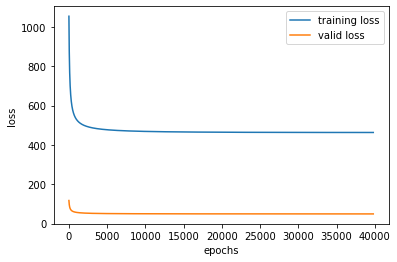

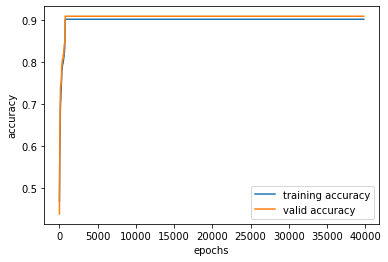

Training Accuracy 0.9032707028531664
Train - No. of correct predictions:  1298.0 / 1437
Train - Confusion Matrix 
 [[1298    0]
 [ 139    0]]

Train - Classification Report 

   Precision  Recall  F1-score
0   0.903271     1.0  0.949177


<ipython-input-1502-cd16766b1883>:4: RuntimeWarning: invalid value encountered in true_divide
  return tp/(tp+fp)


In [1655]:
mlp1=MLPClassifier_Binary(hidden_layer_neurons=4, activation='logistic', regularizer='l2', alpha=0.0001, learning_rate='adaptive',
                  learning_rate_init=0.01, tol=1e-05, early_stopping=True, n_iter_no_change=10, 
                  momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=True)
mlp1.fit(X1_train_standard,y1_train,validation_fraction=0.1,max_iter=100000,verbose=True)

#c
y1_predicted_train = mlp1.predict(X1_train_standard)
train_acc = np.mean(y1_train==y1_predicted_train)
train_cm = confusion_matrix(y1_train,y1_predicted_train)
precision_values = precision(train_cm)
recall_values = recall(train_cm)
f1_values = f1(train_cm)
d = np.zeros((1,3))
for i in range(1):
    d[i][0]=precision_values[i]
    d[i][1]=recall_values[i]
    d[i][2]=f1_values[i]
    
df=pd.DataFrame(d,columns=['Precision','Recall','F1-score'])

print('Training Accuracy', train_acc)
print('Train - No. of correct predictions: ', train_acc*len(y_train),'/',len(y_train))
print('Train - Confusion Matrix \n', train_cm)
print('\nTrain - Classification Report \n')
print(df)


In [1656]:
y1_predicted_test=mlp1.predict(X1_test_standard)
test_acc= np.mean(y1_test==y1_predicted_test)
test_cm=confusion_matrix(y1_test,y1_predicted_test)
precision_values=precision(test_cm)
recall_values=recall(test_cm)
f1_values=f1(test_cm)
d1=np.zeros((1,3))
for i in range(1):
    d1[i][0]=precision_values[i]
    d1[i][1]=recall_values[i]
    d1[i][2]=f1_values[i]
    
df1=pd.DataFrame(d1,columns=['Precision','Recall','F1-score'])

print('Testing Accuracy', test_acc)
print('\nTest - No. of correct predictions: ', test_acc*len(y_test),'/',len(y_test))
print('\nTest - Confusion Matrix \n', test_cm)
print('\n Test - Classification Report \n')
print(df1)

Testing Accuracy 0.8805555555555555

Test - No. of correct predictions:  317.0 / 360

Test - Confusion Matrix 
 [[317   0]
 [ 43   0]]

 Test - Classification Report 

   Precision  Recall  F1-score
0   0.880556     1.0  0.936484


<ipython-input-1502-cd16766b1883>:4: RuntimeWarning: invalid value encountered in true_divide
  return tp/(tp+fp)


In [1396]:
def ForwardPropagation_Regressor(activation,w1,w2,X):
    X_bias=np.insert(X,0,1,axis=1)
        
    a1=X_bias
   
    z2=np.dot(a1,w1)
    a2=activate(activation, z2)
    #print('a2.shape no bias',a2.shape)
    a2=np.insert(a2,0,1,axis=1)
    #print('a2.shape',a2.shape)

    z3=np.dot(a2,w2)
    a3=z3
    
    return a3,a2,a1,z3,z2


In [1517]:
def BackPropagation_Regressor(activation,a3,a2,a1,z3,z2,w1,w2,y_one_hot,n,learning_rate_init,learning_rate,
                        learning_rate_scheduler,iterations,momentum,new_m1,new_m2,beta):
    if activation=='logistic':
        activation_gradient='logistic_gradient'
    elif activation=='relu':
        activation_gradient='relu_gradient'
    elif activation=='tanh':
        activation_gradient='tanh_gradient'
    w2_no_bias=np.delete(w2,0,axis=0)
    if learning_rate=='constant':
        delta3=(a3-y_one_hot)
        #print('delta3.shape',delta3.shape)
        #print('y_one_hot',y_one_hot.shape)
        #print('a2.shape in backprop',a2.shape)
        grad_L_for_w2=np.dot(a2.T,delta3)
        #print('grad_L_for_w2.shape',grad_L_for_w2.shape)
        delta2=delta3.dot(w2_no_bias.T)*activate_gradient(activation_gradient,z2)
        #print('delta2.shape',delta2.shape)
        grad_L_for_w1=np.dot(a1.T,delta2)
        #print('grad_L_for_w1.shape',grad_L_for_w1.shape)
        if momentum==True:
            previous_m1=new_m1
            new_m1=beta*previous_m1-learning_rate_init*grad_L_for_w2
            w2=w2+new_m1
            previous_m2=new_m2
            new_m2=beta*previous_m2-learning_rate_init*grad_L_for_w1
            w1=w1+new_m2
            return w1,w2,learning_rate_init,new_m1,new_m2
        elif momentum==False:
            w2=w2-((learning_rate_init/n)*grad_L_for_w2)
            #print('w2.shape',w2.shape)
            w1=w1-((learning_rate_init/n)*grad_L_for_w1)
            #print('w1.shape',w1.shape)
            return w1,w2,learning_rate_init,new_m1,new_m2
    elif learning_rate=='adaptive':
        delta3=(a3-y_one_hot)
        grad_L_for_w2=np.dot(a2.T,delta3)
        delta2=delta3.dot(w2_no_bias.T)*activate_gradient(activation_gradient,z2)
        grad_L_for_w1=np.dot(a1.T,delta2)
        if learning_rate_scheduler=='timeBasedDecay':
            learning_rate_new=timeBasedDecay(learning_rate_init,iterations,0.2)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
        elif learning_rate_scheduler=='exponentialDecay':
            learning_rate_new=exponentialDecay(learning_rate_init,iterations,0.2)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2
        elif learning_rate_scheduler=='reduceLearningRateonPlateau':
            learning_rate_new=reduceLearningRateonPlateau(learning_rate_init,0.1)
            if momentum==True:
                previous_m1=new_m1
                new_m1=beta*previous_m1-learning_rate_new*grad_L_for_w2
                w2=w2+new_m1
                previous_m2=new_m2
                new_m2=beta*previous_m2-learning_rate_new*grad_L_for_w1
                w1=w1+new_m2
                return w1,w2,learning_rate_new,new_m1,new_m2
            elif momentum==False:
                w2=w2-(learning_rate_new/n)*grad_L_for_w2
                w1=w1-(learning_rate_new/n)*grad_L_for_w1
                return w1,w2,learning_rate_new,new_m1,new_m2


In [1662]:
#12
class MLPRegressor:
    
    def __init__(self, hidden_layer_neurons=2, activation='logistic', regularizer=None, alpha=0.0001, learning_rate='constant',
                  learning_rate_init=0.001, tol=0.0001, early_stopping=False, n_iter_no_change=10, 
                  momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=True,**kwargs):
        self.hidden_layer_neurons=hidden_layer_neurons
        self.activation=activation
        self.regularizer=regularizer
        self.alpha=alpha
        self.learning_rate=learning_rate
        self.learning_rate_init=learning_rate_init
        self.tol=tol
        self.early_stopping=early_stopping
        self.n_iter_no_change=n_iter_no_change
        self.momentum=momentum
        self.beta=beta
        self.learning_rate_scheduler=learning_rate_scheduler
        self.plotLearningCurve=plotLearningCurve
        
        
    def fit(self, X, y, validation_fraction=0.1, max_iter=1000,verbose=False,W1=0,W2=0, **kwargs):
        self.validation_fraction=validation_fraction
        self.verbose=verbose
        self.X=X
        self.y=y
        self.W1=W1
        self.W2=W2
        n=X.shape
        self.max_iter=max_iter
        
        if self.early_stopping==True:
            X_train,X_valid,y_train,y_valid=train_test_split(X, y, test_size=self.validation_fraction)
            n_train=X_train.shape[0]
            n_valid=X_valid.shape[0]
            print('n_train',n_train,'X_train.shape',X_train.shape)
            class_label1=np.unique(y_train)
            y_one_hot_train=one_hot_labels(y_train,class_label1)
            y_one_hot_valid=one_hot_labels(y_valid,class_label1)
            input_neurons=len(X_train[0])
            output_neurons=len(np.unique(y_train))
            train_loss,valid_loss=[],[]
            train_acc,valid_acc=[],[]
            eta=[]
            newJ_train=0
            newJ_valid=0
            new_acc_train=0
            new_acc_valid=0
            new_m1=0
            new_m2=0
            w1=InitializeWeights(input_neurons+1,self.hidden_layer_neurons)
            #w1=np.insert(w1,0,0.0)#W1 with bias
            print('w1.shape',w1.shape)
            w2=InitializeWeights(self.hidden_layer_neurons+1,output_neurons)
            #w2=np.insert(w2,0,0.0)#W2 with bias
            print('w2.shape',w2.shape)
            for i in range(self.max_iter):
                if self.regularizer=='l2':
                    random_index=np.random.randint(n_train)
                    #print('random_index',set(random_index))
                    X_traini=X_train[random_index:random_index+1]
                    #print('X_traini.shape',X_traini.shape)
                    y_one_hot_traini=y_one_hot_train[random_index:random_index+1]
                    #print('y_one_hot_traini.shape',y_one_hot_traini.shape)
                    a3_train,a2_train,a1_train,z3_train,z2_train=ForwardPropagation_Regressor(self.activation,w1,w2,X_train)
                    #print('a3_train',a3_train.shape)#'\n a2_train',a2_train.shape,'\n a1_train.shape',a1_train.shape,'\n z3_train',z3_train,'\n z2_train',z2_train)
                    a3_valid,a2_valid,a1_valid,z3_valid,z2_valid=ForwardPropagation_Regressor(self.activation,w1,w2,X_valid)
                    #print('\n a3_valid',a3_valid,'\n a2_valid',a2_valid.shape,'\n z3_valid',z3_valid,'\n z2_valid',z2_valid)
                    previousJ_train=newJ_train
                    previousJ_valid=newJ_valid
                    previous_acc_train=new_acc_train
                    previous_acc_valid=new_acc_valid
                    #print('a3_train',a3_train.shape)
                    #print('\n \n \n a3_valid',a3_valid.shape)
                    #print('\n \n \n y_one_hot_train',y_one_hot_train.shape)
                    #print('\n \n \n y_one_hot_valid',y_one_hot_valid.shape)
                    
                    newJ_train=MSE(y_one_hot_train,a3_train)
                    newJ_valid=MSE(y_one_hot_valid,a3_valid)
                    y_predicted_train=np.argmax(a3_train,axis=1)
                    y_predicted_valid=np.argmax(a3_valid,axis=1)
                    new_acc_train=np.mean(y_train==y_predicted_train)
                    new_acc_valid=np.mean(y_valid==y_predicted_valid)
                    train_loss.append(newJ_train)
                    valid_loss.append(newJ_valid)
                    train_acc.append(new_acc_train)
                    valid_acc.append(new_acc_valid)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Regressor(self.activation,a3_train,a2_train,a1_train,z3_train,z2_train,w1,w2,
                                                                                      y_one_hot_train,n_train,self.learning_rate_init,self.learning_rate,
                                                                                      self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    #print('w1_updated',w1.shape)
                    #print('w2_updated',w2.shape)
                    #print('a2_train',a2_train.shape)
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],'| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if i>self.n_iter_no_change:
                        if valid_loss[i]<valid_loss[i-self.n_iter_no_change]:
                            self.n_iter_no_change=i
                        elif valid_loss[i]>=valid_loss[i-self.n_iter_no_change]:
                            break
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
                
                if self.regularizer==None:
                    random_index=np.random.randint(n_train)
                    #print('ranodm_index',random_index)
                    X_traini=X_train[random_index:random_index+1]
                    X_validi=X_valid[random_index:random_index+1]
                    y_one_hot_traini=y_one_hot_train[random_index:random_index+1]
                    y_one_hot_validi=y_one_hot_valid[random_index:random_index+1]
                    a3_train,a2_train,a1_train,z3_train,z2_train=ForwardPropagation_Regressor(self.activation,w1,w2,X_train)
                    #print(a3_train)
                    a3_valid,a2_valid,a1_valid,z3_valid,z2_valid=ForwardPropagation_Regressor(self.activation,w1,w2,X_valid)
                    #print('a3_valid',a3_valid)
                    previousJ_train=newJ_train
                    previousJ_valid=newJ_valid
                    previous_acc_train=new_acc_train
                    previous_acc_valid=new_acc_valid
                    newJ_train=MSE(y_one_hot_train,a3_train)
                    newJ_valid=MSE(y_one_hot_valid,a3_valid)
                    y_predicted_train=np.argmax(a3_train,axis=1)
                    y_predicted_valid=np.argmax(a3_valid,axis=1)
                    new_acc_train=np.mean(y_train==y_predicted_train)
                    new_acc_valid=np.mean(y_valid==y_predicted_valid)
                    train_loss.append(newJ_train)
                    valid_loss.append(newJ_valid)
                    train_acc.append(new_acc_train)
                    valid_acc.append(new_acc_valid)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Regressor(self.activation,a3_train,a2_train,a1_train,z3_train,z2_train,w1,w2,
                                                                            y_one_hot_train,n_train,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if i>self.n_iter_no_change:
                        if valid_loss[i]<valid_loss[i-self.n_iter_no_change]:
                            self.n_iter_no_change=i
                        elif valid_loss[i]>=valid_loss[i-self.n_iter_no_change]:
                            break
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
            if self.verbose==True:
                print('\nEarly stopping because the validation accuracy change between two consecutive epochs is less than ',self.tol,' over the last ', self.n_iter_no_change,' epochs')    
            if self.plotLearningCurve==True:
                print("\nnumber of iterations used: ", self.n_iter_no_change)
                plt.plot(train_loss,label="training loss")
                plt.plot(valid_loss,label="valid loss")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("loss")
                plt.show()
                    
                plt.plot(train_acc,label="training accuracy")
                plt.plot(valid_acc,label="valid accuracy")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("accuracy")
                plt.show()
        
        elif self.early_stopping==False:
            class_label=np.unique(y)
            y_one_hot=one_hot_labels(y,class_label)
            input_neurons=len(self.X[0])
            output_neurons=len(np.unique(self.y))
            train_loss=[]
            train_acc=[]
            eta=[]
            w1_array=[]
            w2_array=[]
            w1=InitializeWeights(input_neurons+1,self.hidden_layer_neurons)  #W1 with bias
            w2=InitializeWeights(self.hidden_layer_neurons+1,output_neurons) #W2 with bias
            for i in range(max_iter):
                if regularizer=='l2':
                    random_index=random.randint(n)
                    Xi=X[random_index]
                    y_one_hoti=y_one_hot[random_index]
                    a3,a2,a1,z3,z2=ForwardPropagation_Regressor(self.activation,w1,w2,X)
                    previousJ=newJ
                    previous_acc=new_acc
                    newJ=MSE(y_one_hot,a3,w2,self.alpha)
                    y_predicted=np.argmax(a3,axis=1)
                    new_acc=np.mean(y_one_hot==a3)
                    train_loss.append(newJ)
                    train_acc.append(new_acc)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Regressor(self.activation,a3,a2,a1,z3,z2,w1,w2,
                                                                            y_one_hot,n,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
                
                
                if regularizer==None:
                    random_index=random.randint(n)
                    Xi=X[random_index]
                    y_one_hoti=y_one_hot[random_index]
                    a3,a2,a1,z3,z2=ForwardPropagation_Regressor(self.activation,w1,w2,X)
                    previousJ=newJ
                    previous_acc=new_acc
                    newJ=MSE(y_one_hoti,a3)
                    new_acc=accuracy_score(y_one_hoti,a3)
                    train_loss.append(newJ)
                    train_acc.append(new_acc)
                    w1_updated,w2_updated,learning_rate_new,m1,m2=BackPropagation_Regressor(self.activation,a3,a2,a1,z3,z2,w1,w2,
                                                                            y_one_hot,n,self.learning_rate_init,self.learning_rate,
                                                                            self.learning_rate_scheduler,i,self.momentum,new_m1,new_m2,self.beta)
                    w1=w1_updated
                    w2=w2_updated
                    eta.append(learning_rate_new)
                    new_m1=m1
                    new_m2=m2
                    learning_rate_init=learning_rate_new
                    if self.verbose==True:
                        print('Epoch ',i,'of',max_iter,': Training Loss ',train_loss[i],'| Valid Loss ',valid_loss[i],
                              '| Training accuracy ',train_acc[i],'| Valid accuracy ',valid_acc[i],'| ETA ',eta[i])
                    if np.abs(newJ_train-previousJ_train)<self.tol:
                        break
                self.W1=w1
                self.W2=w2
            if self.plotLearningCurve==True:
                print("number of iterations used: ", self.n_iter_no_change)
                plt.plot(train_loss,label="training loss")
                    #plt.plot(valid_loss,label="valid loss")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("loss")
                plt.show()
                    
                plt.plot(train_acc,label="training accuracy")
                    #plt.plot(valid_acc,label="valid accuracy")
                plt.legend()
                plt.xlabel("epochs")
                plt.ylabel("accuracy")
                plt.show()
                    
    def predict(self,X):
        A3,A2,A1,Z3,Z2=ForwardPropagation_Regressor(self.activation,self.W1,self.W2,X)
        y_predicted=np.argmax(A3,axis=1)
        return y_predicted


In [1520]:
df=pd.read_csv(r'C:\Users\Sanjay Alamuru\Downloads\winequality-red.csv',sep=";")
df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
...,...,...,...,...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5


In [1522]:
df.sample(frac=1)

X2 = np.array(df.drop( "quality", axis = 1))
y2 = np.array(df['quality'])

X2.shape,y2.shape

((1599, 11), (1599,))

In [1483]:
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.20, random_state=2)
X2_train.shape,X2_test.shape,y2_train.shape,y2_test.shape


((1279, 11), (320, 11), (1279,), (320,))

In [1484]:
scaler=StandardScaler()
scaler.fit(X2_train)
X2_train_standard=scaler.transform(X2_train)
X2_test_standard=scaler.transform(X2_test)
X2_train_standard.shape,X2_test_standard.shape

((1279, 11), (320, 11))

In [ ]:
import tabulate
def mydictionary(hidden_layer_neurons, activation, alpha, learning_rate, learning_rate_init, max_iter, tol, n_iter_no_change):
    mydict={'hidden_layer_neurons':[],'activation':[],'alpha':[],'learning_rate':[],'learning_rate_init':[],
            'max_iter':[],'tolerance':[],'n_iter_no_change':[],'accuracy':[]}
    mylist=[]
    for h in hidden_layer_neurons:
        for a in activation:
            for al in alpha:
                for l in learning_rate:
                    for lr in learning_rate_init:
                        for m in max_iter:
                            for t in tol:
                                for n in n_iter_no_change:
                                    mlp_classifier=MLPRegressor(hidden_layer_neurons=h, activation=a, regularizer='l2', alpha=al, learning_rate=l,
                                                                learning_rate_init=lr, tol=t, early_stopping=True, n_iter_no_change=n, 
                                                                momentum=True, beta=0.9, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=False)
                                    mlp_classifier.fit(X2_train_standard,y2_train,validation_fraction=0.1,max_iter=m,verbose=True)
                                    y2_predicted_train=mlp_classifier.predict(X2_train)
                                    accuracy=np.mean(y2_train==y2_predicted_train)
                                    mydict={'hidden_layer_neurons':h,'activation':a,'alpha':al,'learning_rate':l,
                                            'learning_rate_init':lr,'max_iter':m,'tolerance':t,'n_iter_no_change':n,'accuracy':accuracy}
                                    mydict_copy=mydict.copy()
                                    mylist.append(mydict_copy)
    header=mylist[0].keys()
    rows= [x.values() for x in mylist]
    print(tabulate.tabulate(rows,header,tablefmt='grid'))
hidden_layer_neurons=[7]
activation=['logistic']
alpha=[0.0001]
learning_rate=['constant']
learning_rate_init=[0.9]
max_iter=[1000000]
tol=[1e-07]
n_iter_no_change=[10]
mydictionary(hidden_layer_neurons, activation, alpha, learning_rate, learning_rate_init, max_iter, tol, n_iter_no_change)


In [ ]:
mlp1=MLPRegressor(hidden_layer_neurons=4, activation='logistic', regularizer='l2', alpha=0.0001, learning_rate='constant',
                  learning_rate_init=0.9, tol=1e-07, early_stopping=True, n_iter_no_change=10, 
                  momentum=False, beta=0.0, learning_rate_scheduler='timeBasedDecay',plotLearningCurve=True)
mlp1.fit(X2_train_standard,y2_train,validation_fraction=0.1,max_iter=1000,verbose=True)

#c
y2_predicted_train = mlp1.predict(X2_train_standard)
train_acc = np.mean(y2_train==y2_predicted_train)
train_cm = confusion_matrix(y2_train,y2_predicted_train)
precision_values = precision(train_cm)
recall_values = recall(train_cm)
f1_values = f1(train_cm)
d = np.zeros((12,3))
for i in range(12):
    d[i][0]=precision_values[i]
    d[i][1]=recall_values[i]
    d[i][2]=f1_values[i]
    
df=pd.DataFrame(d,columns=['Precision','Recall','F1-score'])

print('Training Accuracy', train_acc)
print('Train - No. of correct predictions: ', train_acc*len(y_train),'/',len(y_train))
print('Train - Confusion Matrix \n', train_cm)
print('\nTrain - Classification Report \n')
print(df)


In [ ]:
y2_predicted_test=mlp1.predict(X2_test_standard)
test_acc= np.mean(y2_test==y2_predicted_test)
test_cm=confusion_matrix(y2_test,y2_predicted_test)
precision_values=precision(test_cm)
recall_values=recall(test_cm)
f1_values=f1(test_cm)
d1=np.zeros((12,3))
for i in range(12):
    d1[i][0]=precision_values[i]
    d1[i][1]=recall_values[i]
    d1[i][2]=f1_values[i]
    
df1=pd.DataFrame(d1,columns=['Precision','Recall','F1-score'])

print('Testing Accuracy', test_acc)
print('\nTest - No. of correct predictions: ', test_acc*len(y_test),'/',len(y_test))
print('\nTest - Confusion Matrix \n', test_cm)
print('\n Test - Classification Report \n')
print(df1)